# Diesel price forecasting

In this notebook I will choose build and evaluate a Machine Learning model to forecast diesel price in the gulf coast area in the United States. My model will be based on the publicly available data.

### GOAL

The main goal is to build reliable model predicting Diesel prices 1 week ahead. This model will be used by Arkansas based company offering For-Hire truck transportation services. The model will help company managers make decisions about diesel storage and ordering strategy.

### The company

The company currently operates 68 Peterbilt 389 trucks with Cummins X15 engines. The company has its own gas pump and underground tanks for diesel storage. They are ordering diesel from external supplier. The trucks make around 450 miles per day and they return to the company headquarters on a daily basis. They drive 6 days a week for 51 weeks a year. The trucks are refueled only at the company headquarters. The trucks average fuel consumption is around 6.5 miles per gallon.

### Model use case in the business

On average 62 out of 68 company trucks are operational per day.
The whole fleet consumes around 4,292 gallons of diesel per day of operation, around 25,753 per week and around 1,313,446 gallons of diesel per year. Each truck consumes around 21,184 gallons of diesel per year, 415 per week and 69 gallons per day of operation.
The company has four 10"x80" underground diesel tanks which are capable of storing 180,000 gallons of diesel. Till now the tankers were being refueled every 4 weeks or at around 50% of tank filling level.
The company would like to utilize the tanks more by adjusting their diesel ordering strategy by forecasting future diesel price change. Thanks to a combination of good forecasting model and experienced management which will take a good use of it, company would better utilize available resources and save money.
For each cent saved on every gallon of diesel purchased, company saves approximately 13,446 USD in a standard year of operation what equals around 211 USD per truck per year.<br>

Note: The numbers above might not add up due to rounding.

### Data

The data was downloaded from the The U.S. Energy Information Administration (EIA).
https://www.eia.gov/dnav/pet/pet_pri_gnd_dcus_nus_w.htm.

Our main performance measurement of the model performance will be mean absolute percentage error(in the further part of the notebook will be referenced as MAPE or mape).  The lower the MAPE values the better the model performance.

In [748]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit, train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.forecasting.model_selection import ForecastingGridSearchCV, ExpandingWindowSplitter, SlidingWindowSplitter
import seaborn as sns

### Data cleaning and transformation

In [749]:
df = pd.read_csv('gulf_coast_diesel_weekly.csv',parse_dates=['Date'])
df.head()

,Date,Weekly Gulf Coast No 2 Diesel Retail Prices (Dollars per Gallon),Unnamed: 2,Unnamed: 3
0,1994-03-21,1.065,NaN,NaN
1,1994-03-28,1.064,NaN,NaN
2,1994-04-04,1.069,NaN,NaN
3,1994-04-11,1.066,NaN,NaN
4,1994-04-18,1.058,NaN,NaN


The dataframe contains 4 columns: Date, weekly diesel price per gallon in usd in our region and 2 empty collumns.

In [750]:
print(df.shape)
print(df.info())
print(df.describe())

(1495, 4)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1495 entries, 0 to 1494
Data columns (total 4 columns):
 #   Column                                                             Non-Null Count  Dtype         
---  ------                                                             --------------  -----         
 0   Date                                                               1494 non-null   datetime64[ns]
 1   Weekly Gulf Coast No 2 Diesel Retail Prices  (Dollars per Gallon)  1494 non-null   float64       
 2   Unnamed: 2                                                         0 non-null      float64       
 3   Unnamed: 3                                                         0 non-null      float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 46.8 KB
None
       Weekly Gulf Coast No 2 Diesel Retail Prices  (Dollars per Gallon)  \
count                                         1494.00000                   
mean                                             

The empty columns and rows do not provide any value, they are visible in the dataset due to converting the file from excel to csv. I will delete them. 

In [751]:
df.drop(columns=['Unnamed: 2','Unnamed: 3'],inplace=True)
df.dropna(inplace=True)


In [752]:
df.rename(columns={'Weekly Gulf Coast No 2 Diesel Retail Prices  (Dollars per Gallon)': 'Diesel price'},inplace=True)

In [753]:
df1 = df

In [754]:
df1.head()


,Date,Diesel price
0,1994-03-21,1.065
1,1994-03-28,1.064
2,1994-04-04,1.069
3,1994-04-11,1.066
4,1994-04-18,1.058


Text(0.5, 1.0, 'Diesel price per gallon in USD in the gulf coast region')

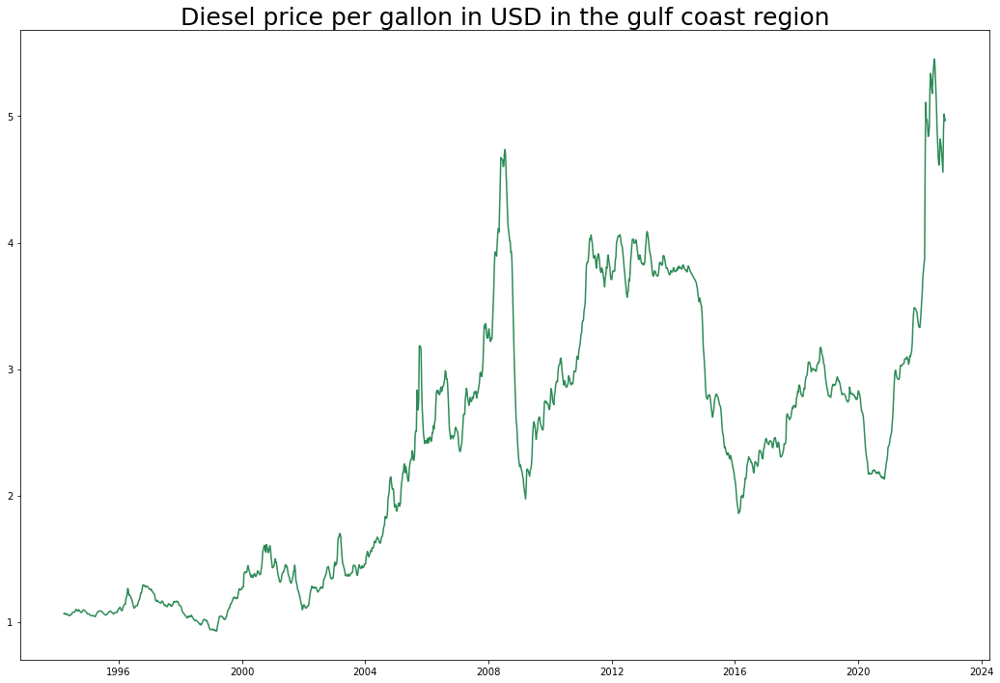

In [755]:
fig,ax = plt.subplots(figsize=(18,12))
ax.plot(df1['Date'],df1['Diesel price'],color='seagreen')
plt.title('Diesel price per gallon in USD in the gulf coast region',fontsize=25)
# plotting diesel price over time

We would like to predict the diesel price 6 weeks in advance. In order to do so I will need to create lagged diesel price values with lag 6 weeks or higher. The 6 weeks lagged diesel price value will be our baseline model. 

In [756]:
df1['baseline'] = df1['Diesel price'].shift(1)
df1['1w_lag'] = df1['baseline']


In [757]:
def lag_generate(num_lags):
    name_lags = []
    col_name = 'w_lag'
    for i in range(2,num_lags + 2):
        name_lags.append(str(i) + col_name)
    return name_lags
#This function creates list of strings for col names for lagged diesel prices    

In [758]:
def col_lagged_creator(df,col,lag_names):
    for i in range(len(lag_names)):
        df[lag_names[i]] = df[col].shift(i + 2)

# this function adds the lagged columns according to our needs
col_lagged_creator(df1,'Diesel price',lag_generate(50))


In [759]:
df1.head()

,Date,Diesel price,baseline,1w_lag,2w_lag,3w_lag,4w_lag,5w_lag,6w_lag,7w_lag,...,42w_lag,43w_lag,44w_lag,45w_lag,46w_lag,47w_lag,48w_lag,49w_lag,50w_lag,51w_lag
0,1994-03-21,1.065,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1994-03-28,1.064,1.065,1.065,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1994-04-04,1.069,1.064,1.064,1.065,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1994-04-11,1.066,1.069,1.069,1.064,1.065,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1994-04-18,1.058,1.066,1.066,1.069,1.064,1.065,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


The dataset looks as above after adding columns with lagged values. As expected some of the cells contain NaN values due to the data limitations in regards to creating lagged values. I will drop all NaN values as the oldest datapoints are not very relevant for todays diesel price.

In [760]:
df1.dropna(inplace=True)
df1.head()

,Date,Diesel price,baseline,1w_lag,2w_lag,3w_lag,4w_lag,5w_lag,6w_lag,7w_lag,...,42w_lag,43w_lag,44w_lag,45w_lag,46w_lag,47w_lag,48w_lag,49w_lag,50w_lag,51w_lag
51,1995-03-13,1.046,1.051,1.051,1.050,1.050,1.050,1.050,1.051,1.056,...,1.050,1.054,1.055,1.060,1.062,1.058,1.066,1.069,1.064,1.065
52,1995-03-20,1.043,1.046,1.046,1.051,1.050,1.050,1.050,1.050,1.051,...,1.050,1.050,1.054,1.055,1.060,1.062,1.058,1.066,1.069,1.064
53,1995-03-27,1.042,1.043,1.043,1.046,1.051,1.050,1.050,1.050,1.050,...,1.056,1.050,1.050,1.054,1.055,1.060,1.062,1.058,1.066,1.069
54,1995-04-03,1.053,1.042,1.042,1.043,1.046,1.051,1.050,1.050,1.050,...,1.058,1.056,1.050,1.050,1.054,1.055,1.060,1.062,1.058,1.066
55,1995-04-10,1.063,1.053,1.053,1.042,1.043,1.046,1.051,1.050,1.050,...,1.061,1.058,1.056,1.050,1.050,1.054,1.055,1.060,1.062,1.058


In [761]:

def train_test_division(df):
    dfx,dfd,dfa,df4,test_xy = np.array_split(df,5,axis=0)
    train_xy = pd.concat([dfx,dfd,dfa,df4],ignore_index=True)
    return train_xy, test_xy
# this function takes df as an argument and returns training and test sets containing lables and target values
# I am not using train_test_split as I want to keep the order of datapoints. The test set is around 0.2 of toal size of dataset.
rng = 42
train_xy,test_xy = train_test_division(df1)
def train_test_split_generator(lag_list):
    X = df1[lag_list]
    y = df1['Diesel price']
    X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.25,random_state=rng)
    return X_train,X_test,y_train,y_test   

The scoring metric for the models will be root mean squared error.

In [762]:
corr_matr = df1.corr()
corr_matr_small = df1.iloc[:,:25]
corr_matr

,Diesel price,baseline,1w_lag,2w_lag,3w_lag,4w_lag,5w_lag,6w_lag,7w_lag,8w_lag,...,42w_lag,43w_lag,44w_lag,45w_lag,46w_lag,47w_lag,48w_lag,49w_lag,50w_lag,51w_lag
Diesel price,1.000000,0.998749,0.998749,0.996299,0.993388,0.990107,0.986628,0.982978,0.979052,0.974757,...,0.822670,0.820066,0.817543,0.814937,0.812234,0.809373,0.806345,0.803187,0.800004,0.796792
baseline,0.998749,1.000000,1.000000,0.998746,0.996289,0.993370,0.990131,0.986627,0.982953,0.979005,...,0.825831,0.823074,0.820527,0.817996,0.815374,0.812629,0.809728,0.806637,0.803470,0.800263
1w_lag,0.998749,1.000000,1.000000,0.998746,0.996289,0.993370,0.990131,0.986627,0.982953,0.979005,...,0.825831,0.823074,0.820527,0.817996,0.815374,0.812629,0.809728,0.806637,0.803470,0.800263
2w_lag,0.996299,0.998746,0.998746,1.000000,0.998742,0.996280,0.993409,0.990144,0.986615,0.982918,...,0.829183,0.826257,0.823558,0.821002,0.818455,0.815791,0.813005,0.810041,0.806941,0.803748
3w_lag,0.993388,0.996289,0.996289,0.998742,1.000000,0.998743,0.996336,0.993439,0.990148,0.986595,...,0.832705,0.829638,0.826771,0.824063,0.821491,0.818901,0.816195,0.813344,0.810371,0.807245
4w_lag,0.990107,0.993370,0.993370,0.996280,0.998743,1.000000,0.998777,0.996350,0.993434,0.990127,...,0.836311,0.833092,0.830080,0.827204,0.824481,0.821869,0.819240,0.816474,0.813616,0.810619
5w_lag,0.986628,0.990131,0.990131,0.993409,0.996336,0.998777,1.000000,0.998776,0.996350,0.993436,...,0.839910,0.836527,0.833351,0.830333,0.827446,0.824692,0.822050,0.819375,0.816604,0.813728
6w_lag,0.982978,0.986627,0.986627,0.990144,0.993439,0.996350,0.998776,1.000000,0.998775,0.996349,...,0.843650,0.840161,0.836823,0.833641,0.830610,0.827690,0.824905,0.822213,0.819533,0.816743
7w_lag,0.979052,0.982953,0.982953,0.986615,0.990148,0.993434,0.996350,0.998775,1.000000,0.998774,...,0.847492,0.843939,0.840498,0.837152,0.833956,0.830891,0.827937,0.825100,0.822403,0.819703
8w_lag,0.974757,0.979005,0.979005,0.982918,0.986595,0.990127,0.993436,0.996349,0.998774,1.000000,...,0.851463,0.847826,0.844322,0.840873,0.837513,0.834280,0.831179,0.828170,0.825326,0.822608


Text(0.5, 1.0, 'Correlation matrix lagged diesel price and current diesel price - gulf coast')

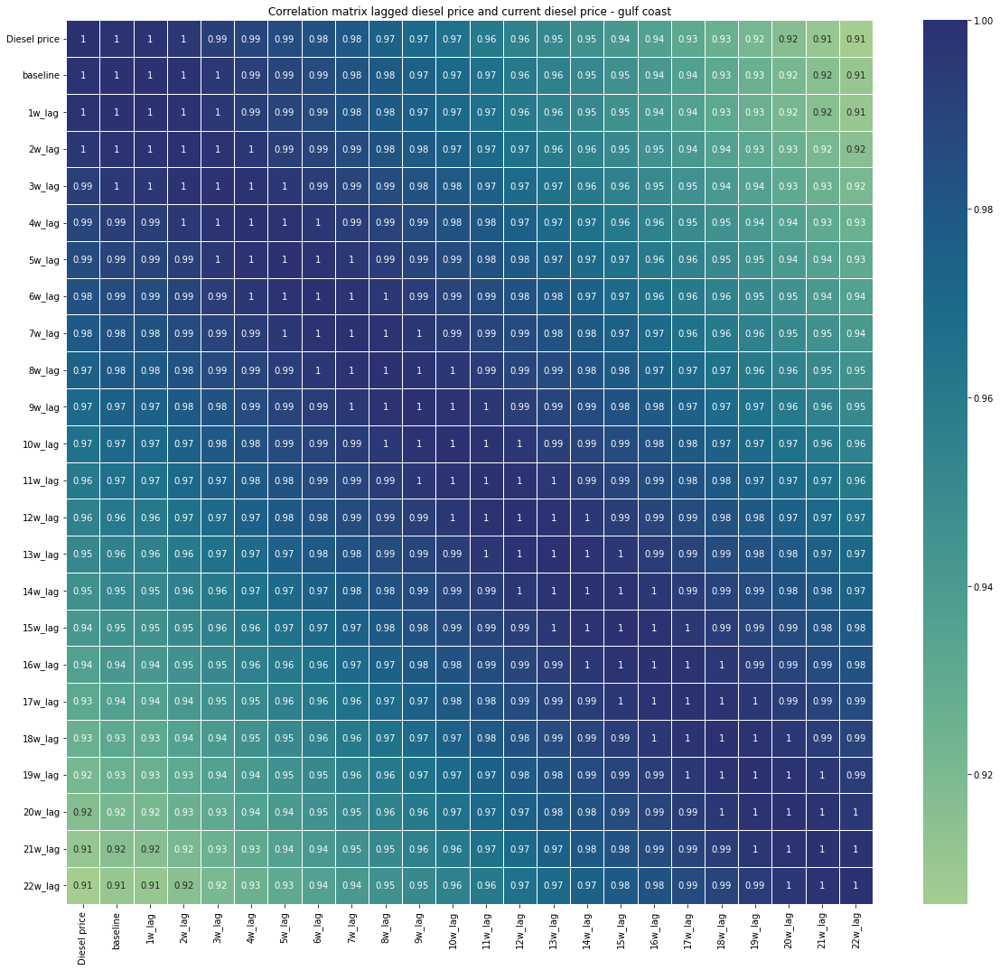

In [763]:
plt.figure(figsize=(20,18))
sns.heatmap(corr_matr_small.corr(),annot=True,linewidth=.9,cmap='crest')
plt.title('Correlation matrix lagged diesel price and current diesel price - gulf coast')


The above correlation matrix vizualizes the correlation between lags, diesel price and baseline model(1w_lag).

### BASELINE

Baseline model assumes that the 1 week lagged diesel price is equal to the target value.

In [764]:
print('Baseline total rmse: ', np.sqrt(mean_squared_error(df1['baseline'],df1['Diesel price'])))
print('Baseline total mape: ', mean_absolute_percentage_error(df1['baseline'],df1['Diesel price']))

Baseline total rmse:  0.05201834795443359
Baseline total mape:  0.011376761733266221


The above numbers represent our baseline rmse and mape for all data.

### MLP Regressor

In [765]:

mlpr1 = MLPRegressor(activation='relu',solver='adam',random_state=rng)
scaler = StandardScaler()

time_split = TimeSeriesSplit(n_splits=5)
def lag_generator(lag_list):
    if len(lag_list) != 1:
        X_train = train_xy[lag_list]
        X_test = test_xy[lag_list]
        return X_train, X_test
    else:
        X_train = train_xy[lag_list[0]]
        X_test = test_xy[lag_list[0]]
        return X_train, X_test
    
# this function generates X values for train and test

parameters = {'hidden_layer_sizes':[(64,64,64),(100,100,100),(50,100,25),(120,120,120),(50,100,50)],'max_iter':[5000,6000]} 
def gsc_tunning(model,df,xtrain,ytrain,params):
    grid = GridSearchCV(estimator=model,verbose=3,cv=time_split,param_grid=params,scoring=['r2','neg_mean_absolute_percentage_error','neg_root_mean_squared_error'],refit='neg_mean_absolute_percentage_error')
    grid.fit(xtrain,ytrain)
    print(grid.best_params_)
    return grid
def mlp_lag_tuned(df,model,params,lag_list,title):
    # lag_generator function needs to be changed in order to get traintestsplit
    X_train, X_test = lag_generator(lag_list)
    df_lags = df[lag_list]
    if len(lag_list) == 1:
        X_train = np.array(X_train).reshape(-1,1)
        X_test = np.array(X_test).reshape(-1,1)
        df_lags = np.array(df_lags).reshape(-1,1)
    
    
#     df_lags = scaler.fit_transform(df_lags)
#     X_train = scaler.fit_transform(X_train)
#     X_test = scaler.fit_transform(X_test)
    # gsc tunning training y value changed from train_xy['Diesel price'] for the train test split purpouse
    grid = gsc_tunning(model,df,X_train,train_xy['Diesel price'],params)
    fitted_test = grid.predict(X_test)
    fitted_all = grid.predict(df_lags)
    df1['MLP_lag_pred'] = fitted_all
    plt.figure(figsize=(18,12))
    plt.plot(df1['Date'],df1['Diesel price'],label='actual',color='seagreen')
    plt.plot(df1['Date'],df1['MLP_lag_pred'],label='predicted',color='firebrick')
    plt.title(title,fontsize=22)
    plt.legend()
    plt.show()
    # test_xy['Diesel price'] changed in the line below to y_test for train test split purpouses
    rmse_test = np.sqrt(mean_squared_error(test_xy['Diesel price'],fitted_test))
    rmse_total = np.sqrt(mean_squared_error(df1['Diesel price'],fitted_all))
    mape_test = mean_absolute_percentage_error(test_xy['Diesel price'],fitted_test)
    mape_total = mean_absolute_percentage_error(df1['Diesel price'],fitted_all)
    print('Test data rmse: ' + str(rmse_test),'Total rmse: ' + str(rmse_total))
    print('Test data mape: ' + str(mape_test), 'Total mape: ' + str(mape_total))
    return grid, mape_test,rmse_test, mape_total, rmse_total
    

In [766]:
summary_data = pd.DataFrame(columns=['Model','mape test','rmse test','mape total','rmse total','lags used'])
def test_mdl(all_lags,mdl,parameters,model_name,smr=summary_data):
    list_options = []
    list_results = []
    for i in range(len(all_lags)):
        
        list_options.append(list(all_lags[:i+1]))
        
    title_list = ['Lag combination ' + str (i) for i in range(len(list_options))]              
    for i in range(len(list_options)):
        print('--------------------------')
        print('Next model: ')
        print('Lags choosen: ',list_options[i])
        grd, mape_test, rmse_test, mape_total, rmse_total = mlp_lag_tuned(df1,mdl,parameters,list_options[i],title_list[i])
        smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
        list_results.append([grd,model_name,mape_test,rmse_test, mape_total, rmse_total,list_options[i]])
    return list_results,smr
    
 #This function creates lists with each consecutive combination of lags and insert is as an label for the model   
    

The above code will be used to fit different ML models on the data and perform hyperparameter tunning.
For every passed combination of lags the model will try to find the best parameters and will print the results on training and test set as well as the plot. The function also returns all the scoring parameters for every lag combination used and model with the best parameters for given lags which will be added to the dataframe with results of all models.

--------------------------
Next model: 
Lags choosen:  ['1w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.081) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.539) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.181) neg_root_mean_squared_error: (test=-0.464) r2: (test=0.001) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.023) neg_root_mean_squared_error: (test=-0.107) r2: (test=0.974) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.988) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.012) ne

[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.987) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.996) total time=   0.1s
[CV 1/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.105) neg_root_mean_squared_error: (test=-0.155) r2: (test=0.207) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.279) r2: (test=0.638) total time=   0.1s
[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.035) neg_root_mean_squared_error: (test=-0.197) r2: (test=0.912) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50)

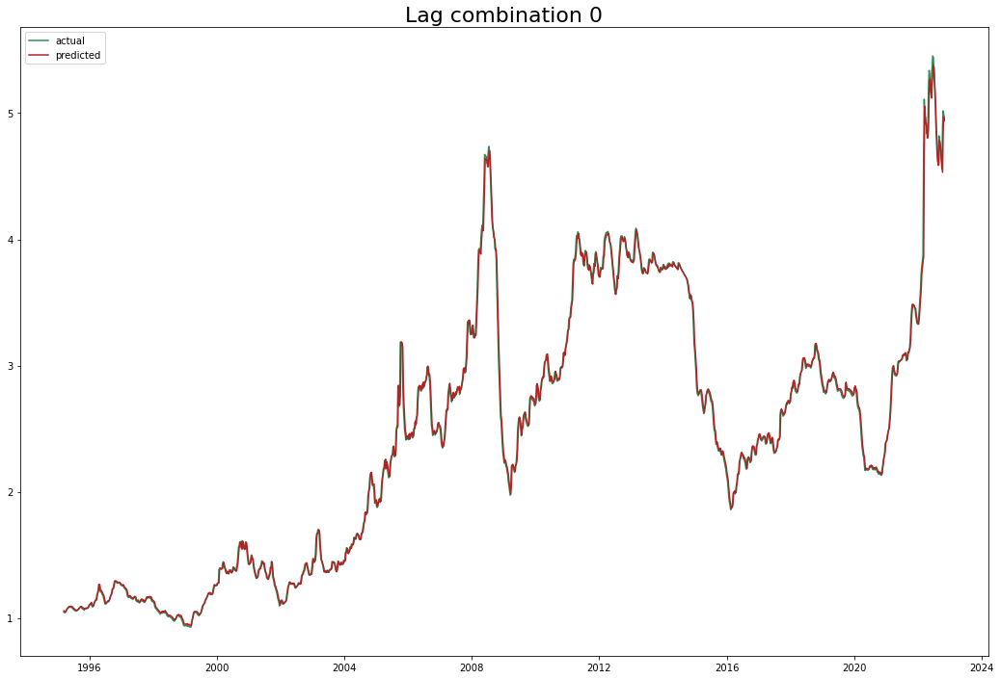

Test data rmse: 0.07763742728748245 Total rmse: 0.05295545527223558
Test data mape: 0.01106724406004817 Total mape: 0.011935624446921358
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.084) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.582) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.122) neg_root_mean_squared_error: (test=-0.318) r2: (test=0.532) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.964) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.976) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.1s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.084) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.582) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.122) neg_root_mean_squared_error: (test=-0.318) r2: (test=0.532) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.104) r2: (test=0.975) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.985) total time=   0.0s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.996) total time=   0.1s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


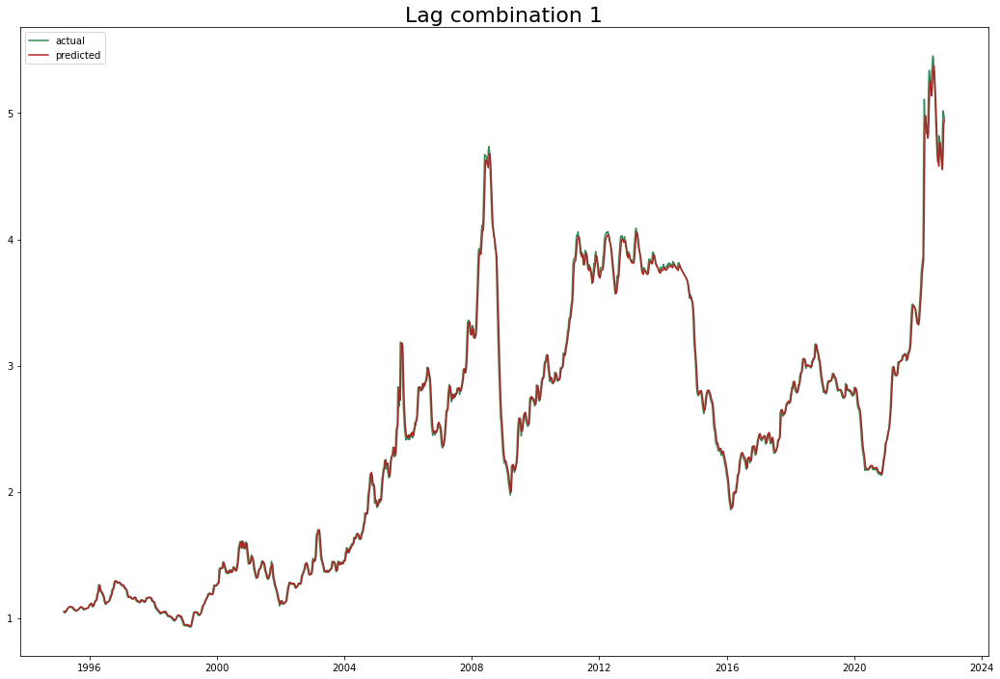

Test data rmse: 0.09881678530681881 Total rmse: 0.06833139979813822
Test data mape: 0.014314664462578511 Total mape: 0.015261047609528261
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.075) neg_root_mean_squared_error: (test=-0.110) r2: (test=0.601) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.069) neg_root_mean_squared_error: (test=-0.223) r2: (test=0.770) total time=   0.1s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.023) neg_root_mean_squared_error: (test=-0.100) r2: (test=0.977) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.057) r2: (test=0.983) total time=   0.0s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.0s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.075) neg_root_mean_squared_error: (test=-0.110) r2: (test=0.601) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.993) total time=   0.1s
[CV 1/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.099) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.468) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.117) neg_root_mean_squared_error: (test=-0.299) r2: (test=0.585) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.029) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.965) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.066) r2: (test=0.977) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50)

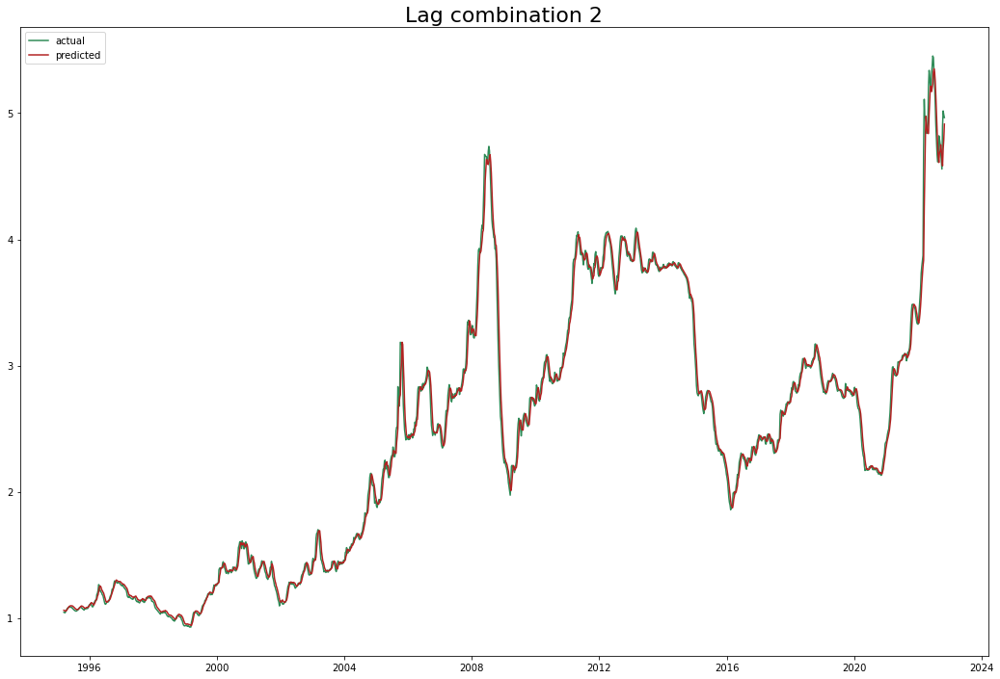

Test data rmse: 0.10862177292897834 Total rmse: 0.07717148896520601
Test data mape: 0.016917850055710303 Total mape: 0.018545740138132663
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.133) neg_root_mean_squared_error: (test=-0.171) r2: (test=0.033) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.140) r2: (test=0.909) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.040) neg_root_mean_squared_error: (test=-0.167) r2: (test=0.937) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.074) r2: (test=0.971) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.990) total time=   0.1s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.133) neg_root_mean_squared_error: (test=-0.171) r2: (test=0.033) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.140) r2: (test=0.909) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squared_error: (test=-0.111) r2: (test=0.972) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.978) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.055) r2: (test=0.994) total time=   0.1s
{'hidden_layer_sizes': (100, 100, 100), 'max_iter': 5000}


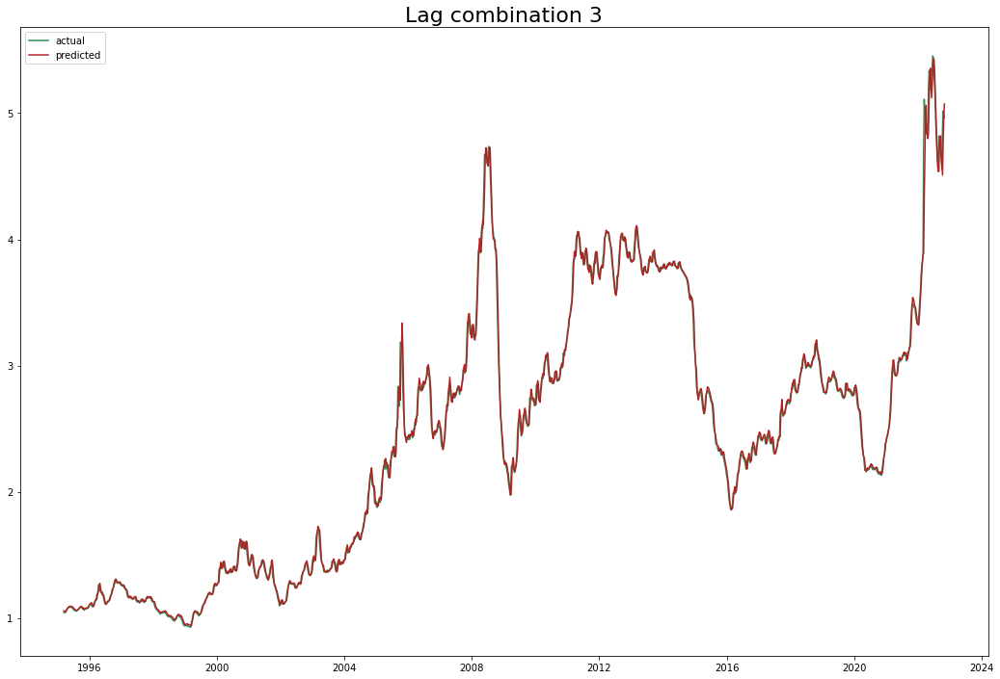

Test data rmse: 0.09275757414136919 Total rmse: 0.0589825622734408
Test data mape: 0.01270801342407288 Total mape: 0.013337734413988507
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.118) neg_root_mean_squared_error: (test=-0.152) r2: (test=0.238) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.048) neg_root_mean_squared_error: (test=-0.144) r2: (test=0.904) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.172) r2: (test=0.933) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.954) total time=   0.0s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.034) r2: (test=0.998) total time=   0.2s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.118) neg_root_mean_squared_error: (test=-0.152) r2: (test=0.238) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.048) neg_root_mean_squared_error: (test=-0.144) r2: (test=0.904) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.160) r2: (test=0.942) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.986) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.040) r2: (test=0.997) total time=   0.2s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


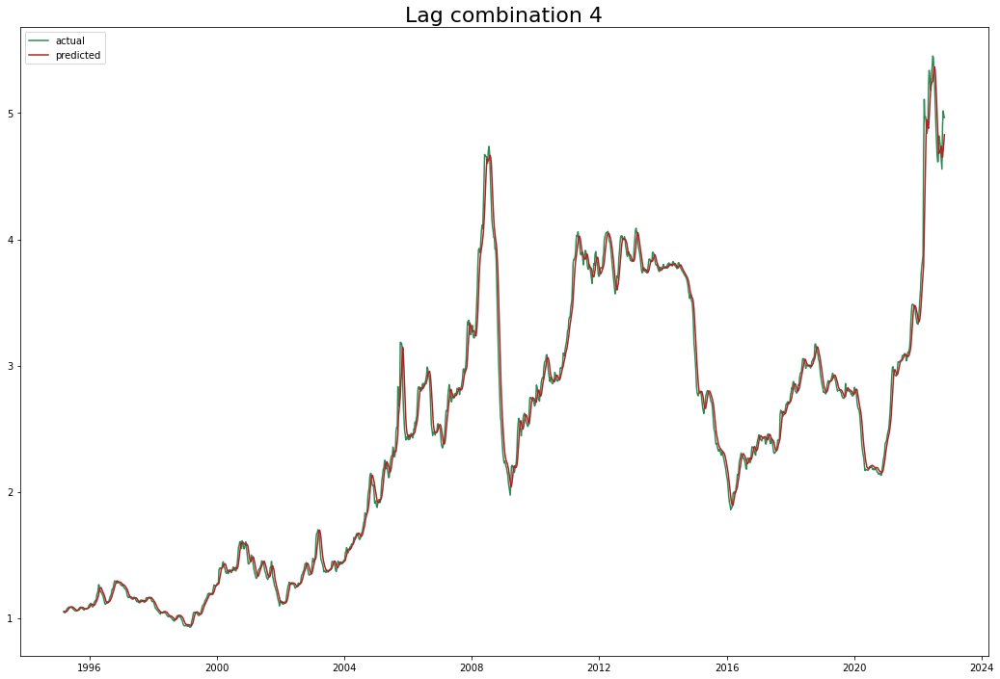

Test data rmse: 0.13322101265514918 Total rmse: 0.09785190215118265
Test data mape: 0.02214553245938234 Total mape: 0.023347966755185176
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.098) neg_root_mean_squared_error: (test=-0.130) r2: (test=0.440) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.185) neg_root_mean_squared_error: (test=-0.438) r2: (test=0.112) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.034) neg_root_mean_squared_error: (test=-0.152) r2: (test=0.948) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.069) r2: (test=0.975) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.2s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.098) neg_root_mean_squared_error: (test=-0.130) r2: (test=0.440) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.185) neg_root_mean_squared_error: (test=-0.438) r2: (test=0.112) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.099) r2: (test=0.948) total time=   0.0s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.040) r2: (test=0.997) total time=   0.3s
{'hidden_layer_sizes': (100, 100, 100), 'max_iter': 5000}


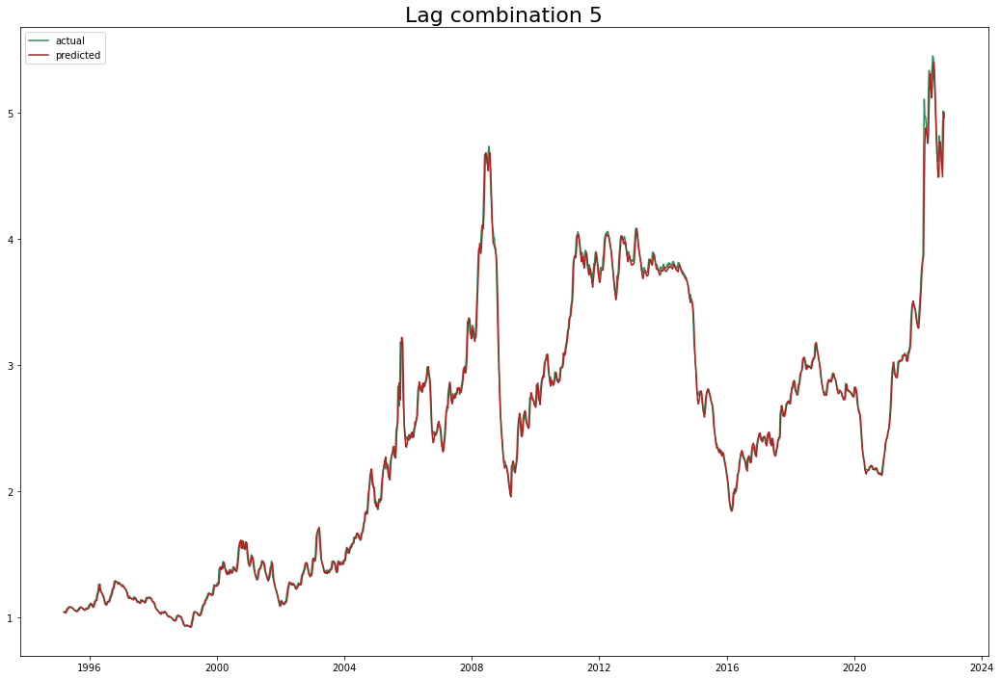

Test data rmse: 0.09125672824468324 Total rmse: 0.05956671787515414
Test data mape: 0.012088087384486978 Total mape: 0.013194253131597826
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.080) r2: (test=0.791) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.229) r2: (test=0.757) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.185) r2: (test=0.923) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.060) r2: (test=0.981) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.996) total time=   0.2s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.080) r2: (test=0.791) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.229) r2: (test=0.757) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.042) neg_root_mean_squared_error: (test=-0.181) r2: (test=0.926) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.979) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   0.2s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


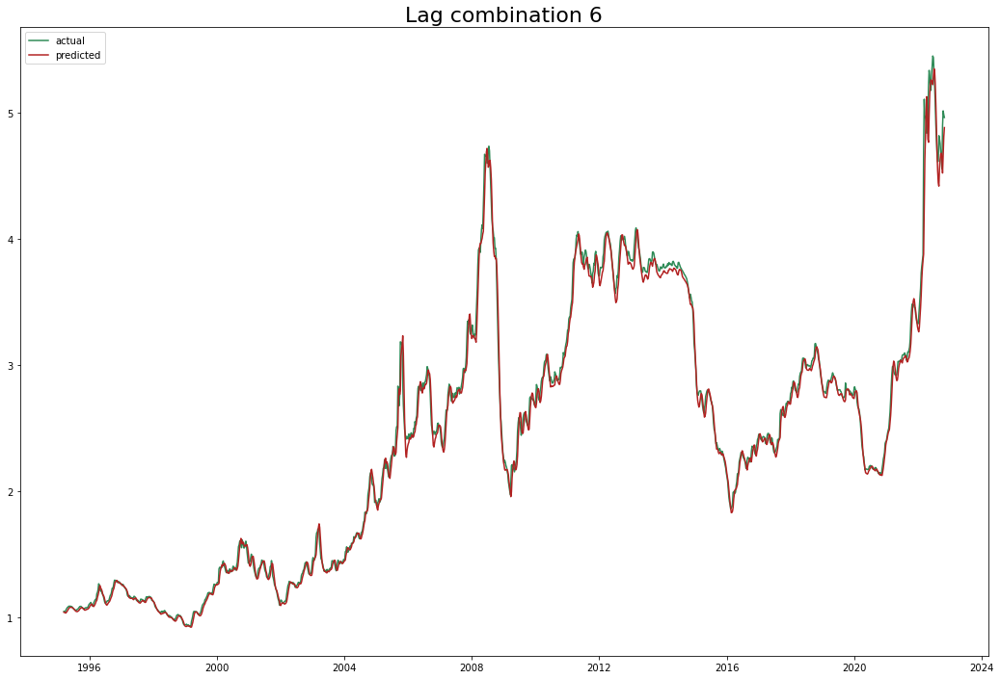

Test data rmse: 0.1089992812462157 Total rmse: 0.07385258256437491
Test data mape: 0.01693333690183684 Total mape: 0.01771137768039279
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.080) r2: (test=0.791) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.069) neg_root_mean_squared_error: (test=-0.182) r2: (test=0.847) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.040) neg_root_mean_squared_error: (test=-0.175) r2: (test=0.931) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.978) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.060) r2: (test=0.992) total time=   0.2s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.080) r2: (test=0.791) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.069) neg_root_mean_squared_error: (test=-0.182) r2: (test=0.847) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.038) neg_root_mean_squared_error: (test=-0.160) r2: (test=0.942) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.984) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.996) total time=   0.3s
{'hidden_layer_sizes': (64, 64, 64), 'max_iter': 5000}


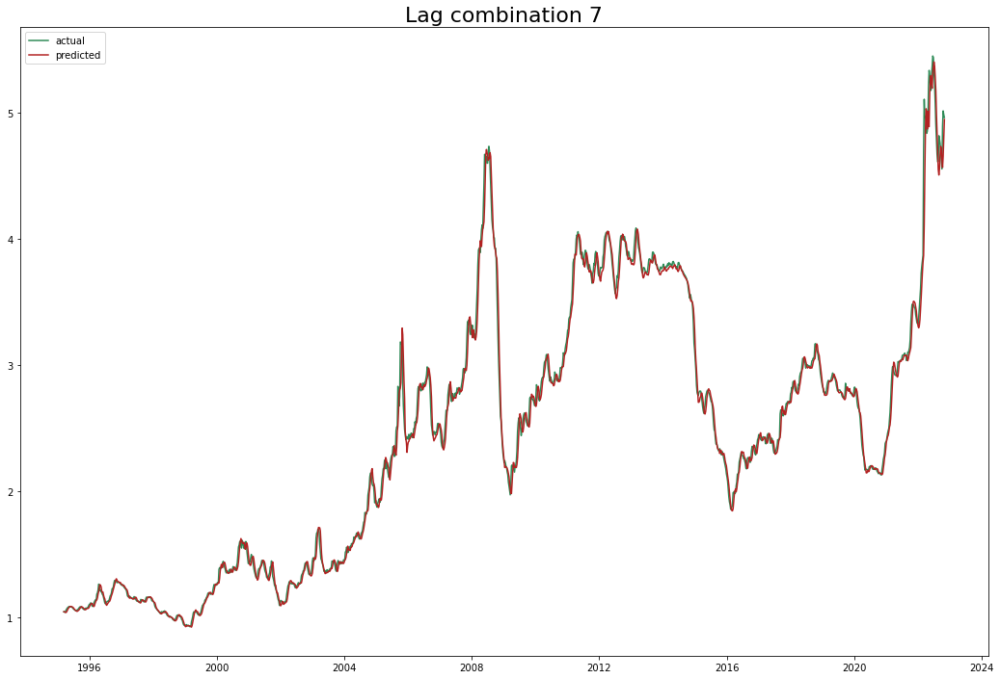

Test data rmse: 0.11489882487098466 Total rmse: 0.07932616371075675
Test data mape: 0.017616184198552536 Total mape: 0.018469080778310273
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.130) neg_root_mean_squared_error: (test=-0.174) r2: (test=0.005) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.130) r2: (test=0.922) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.045) neg_root_mean_squared_error: (test=-0.192) r2: (test=0.917) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.060) r2: (test=0.981) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.996) total time=   0.1s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.130) neg_root_mean_squared_error: (test=-0.174) r2: (test=0.005) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.130) r2: (test=0.922) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.054) neg_root_mean_squared_error: (test=-0.231) r2: (test=0.880) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.064) r2: (test=0.978) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.2s
{'hidden_layer_sizes': (50, 100, 25), 'max_iter': 5000}


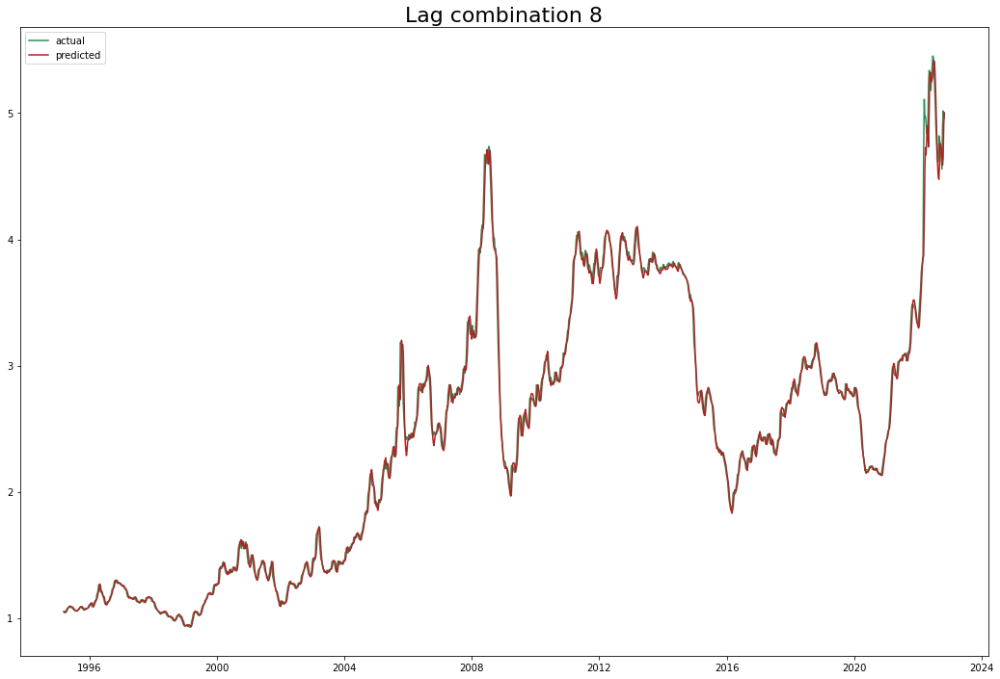

Test data rmse: 0.11099727668964038 Total rmse: 0.0716026345958756
Test data mape: 0.015398925892062302 Total mape: 0.015809031980545233
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.076) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.564) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.066) neg_root_mean_squared_error: (test=-0.178) r2: (test=0.853) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.240) r2: (test=0.870) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.979) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.2s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.076) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.564) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.066) neg_root_mean_squared_error: (test=-0.178) r2: (test=0.853) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.137) r2: (test=0.958) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.056) r2: (test=0.983) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.057) r2: (test=0.993) total time=   0.2s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


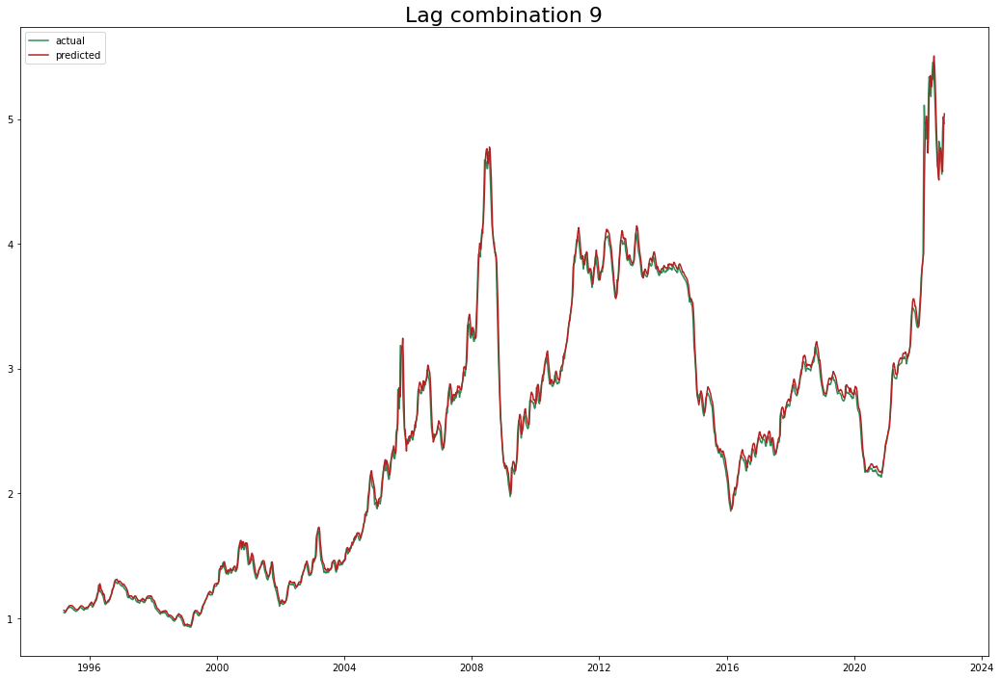

Test data rmse: 0.09331035861557548 Total rmse: 0.06405428174839999
Test data mape: 0.016797817862833905 Total mape: 0.01687071256807792
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.089) neg_root_mean_squared_error: (test=-0.129) r2: (test=0.454) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.146) r2: (test=0.901) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.251) r2: (test=0.858) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.072) r2: (test=0.972) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.051) r2: (test=0.994) total time=   0.2s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.089) neg_root_mean_squared_error: (test=-0.129) r2: (test=0.454) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.146) r2: (test=0.901) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.068) neg_root_mean_squared_error: (test=-0.289) r2: (test=0.812) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.055) r2: (test=0.984) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.994) total time=   0.2s
{'hidden_layer_sizes': (100, 100, 100), 'max_iter': 5000}


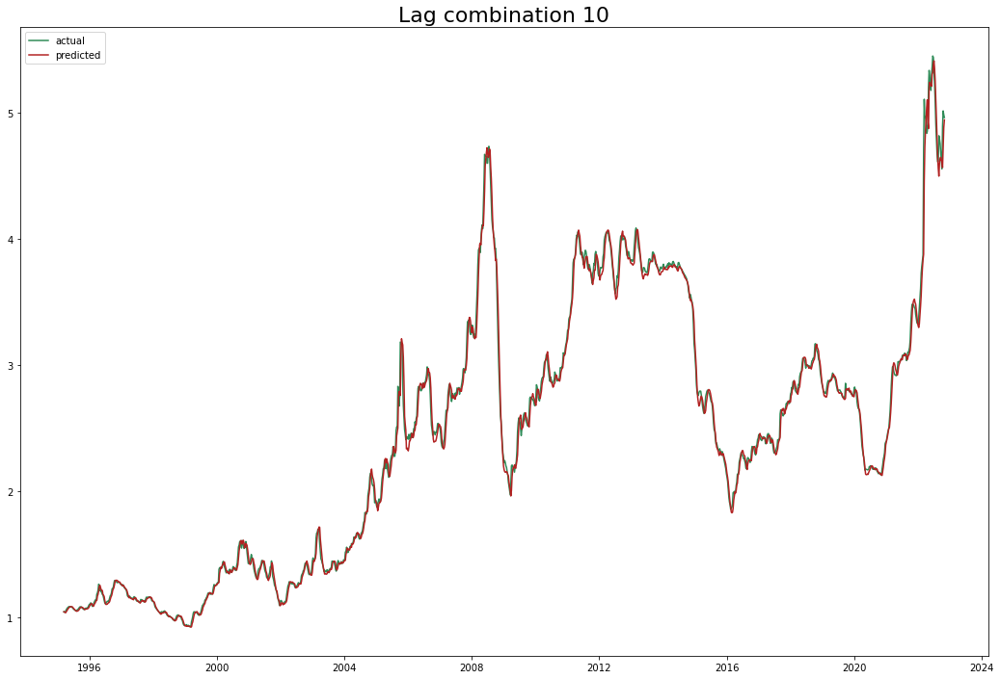

Test data rmse: 0.09302043354522425 Total rmse: 0.06504801564511647
Test data mape: 0.014388138572240595 Total mape: 0.015331443838828831
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.072) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.566) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.098) neg_root_mean_squared_error: (test=-0.265) r2: (test=0.674) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.040) neg_root_mean_squared_error: (test=-0.166) r2: (test=0.938) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.071) r2: (test=0.973) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.994) total time=   0.1s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.072) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.566) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.098) neg_root_mean_squared_error: (test=-0.265) r2: (test=0.674) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.035) neg_root_mean_squared_error: (test=-0.147) r2: (test=0.951) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.078) r2: (test=0.968) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.023) neg_root_mean_squared_error: (test=-0.078) r2: (test=0.987) total time=   0.2s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


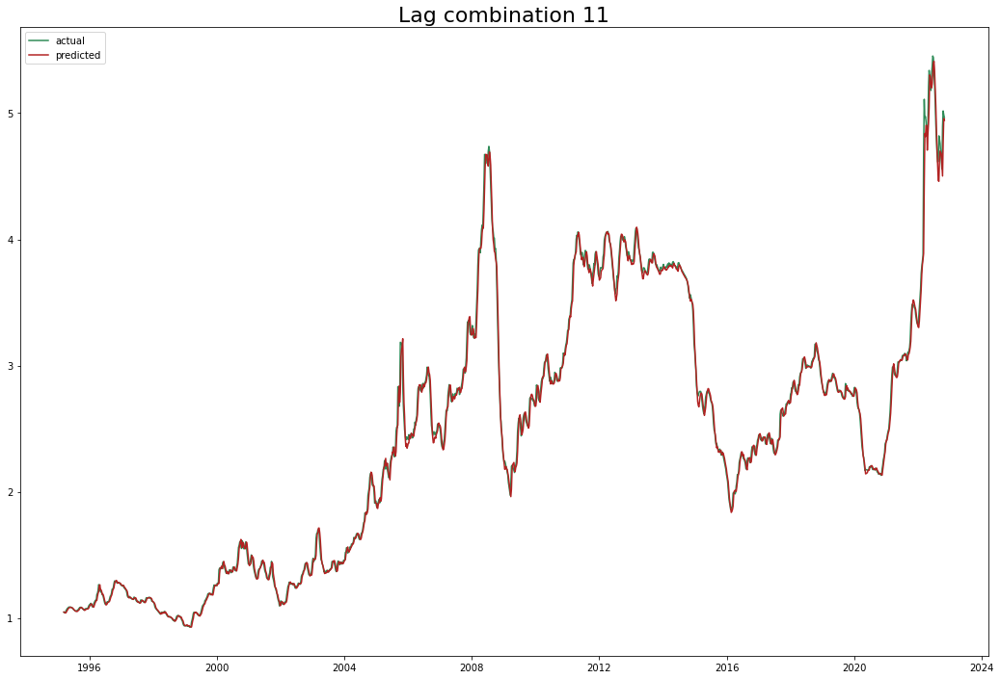

Test data rmse: 0.08935416928775038 Total rmse: 0.05875413399118252
Test data mape: 0.0122135517513526 Total mape: 0.013015766333769848
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.527) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.172) r2: (test=0.862) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.086) neg_root_mean_squared_error: (test=-0.362) r2: (test=0.704) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.069) r2: (test=0.975) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.023) neg_root_mean_squared_error: (test=-0.075) r2: (test=0.988) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.527) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.172) r2: (test=0.862) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.973) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.070) r2: (test=0.974) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.051) r2: (test=0.995) total time=   0.3s
{'hidden_layer_sizes': (50, 100, 50), 'max_iter': 5000}


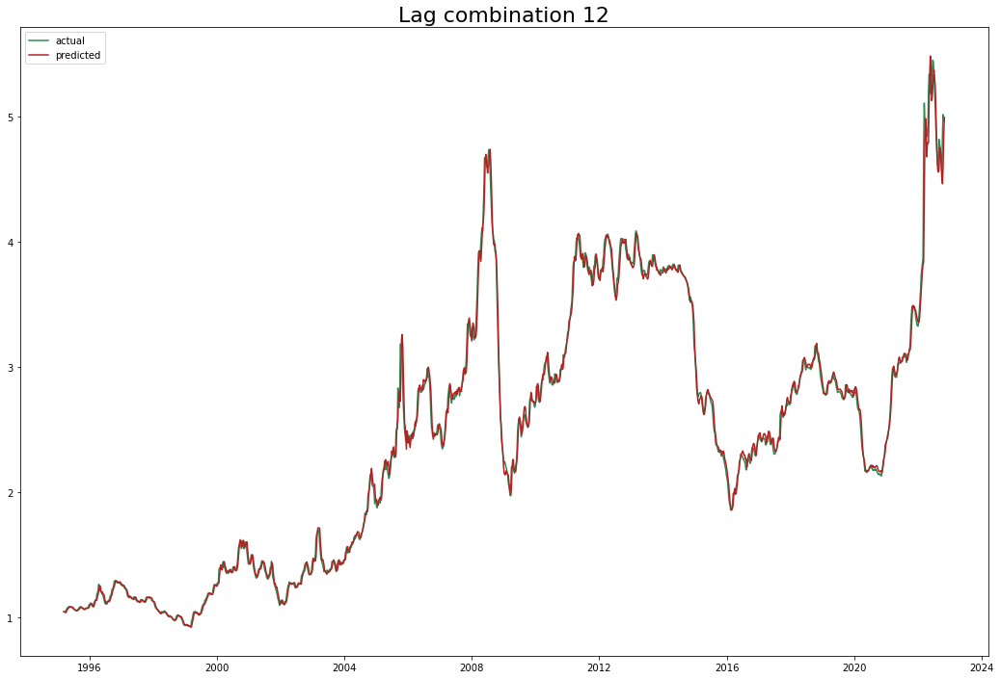

Test data rmse: 0.10020899506683685 Total rmse: 0.06452962146693193
Test data mape: 0.014735029533345193 Total mape: 0.014791363665449492
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.078) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.472) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.178) r2: (test=0.854) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.275) r2: (test=0.829) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.975) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.078) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.472) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.178) r2: (test=0.854) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.243) r2: (test=0.867) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.977) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.055) r2: (test=0.994) total time=   0.4s
{'hidden_layer_sizes': (50, 100, 25), 'max_iter': 5000}


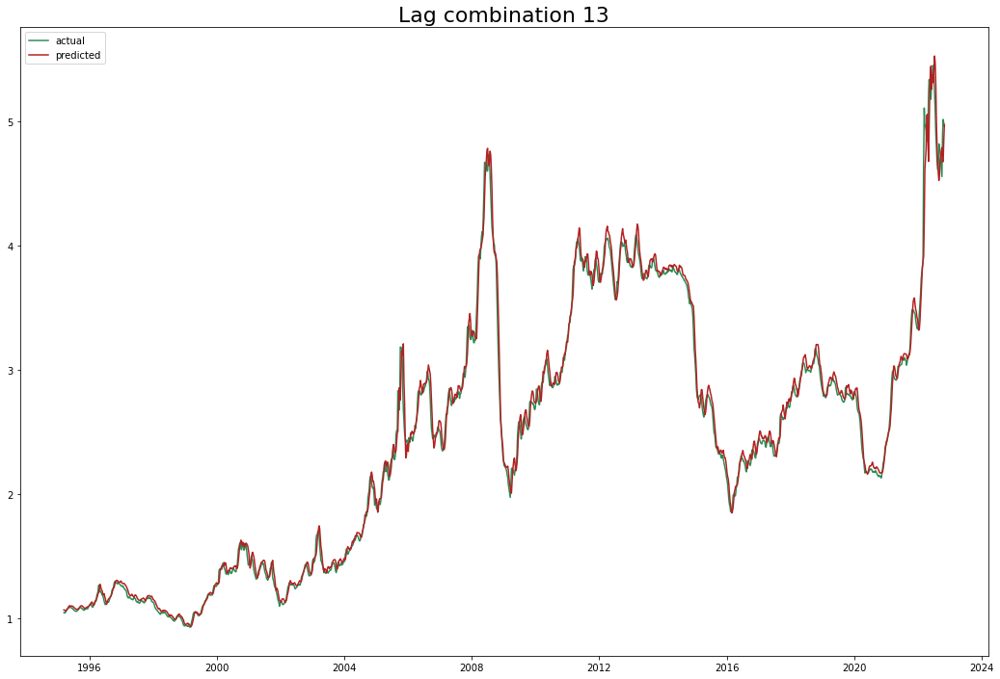

Test data rmse: 0.12016922237106002 Total rmse: 0.08312028491005972
Test data mape: 0.02084894751333373 Total mape: 0.021364046363573575
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.126) neg_root_mean_squared_error: (test=-0.172) r2: (test=0.029) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.096) neg_root_mean_squared_error: (test=-0.254) r2: (test=0.701) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.272) r2: (test=0.833) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.086) r2: (test=0.961) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.994) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.126) neg_root_mean_squared_error: (test=-0.172) r2: (test=0.029) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.096) neg_root_mean_squared_error: (test=-0.254) r2: (test=0.701) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.155) r2: (test=0.946) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.977) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.2s
{'hidden_layer_sizes': (100, 100, 100), 'max_iter': 5000}


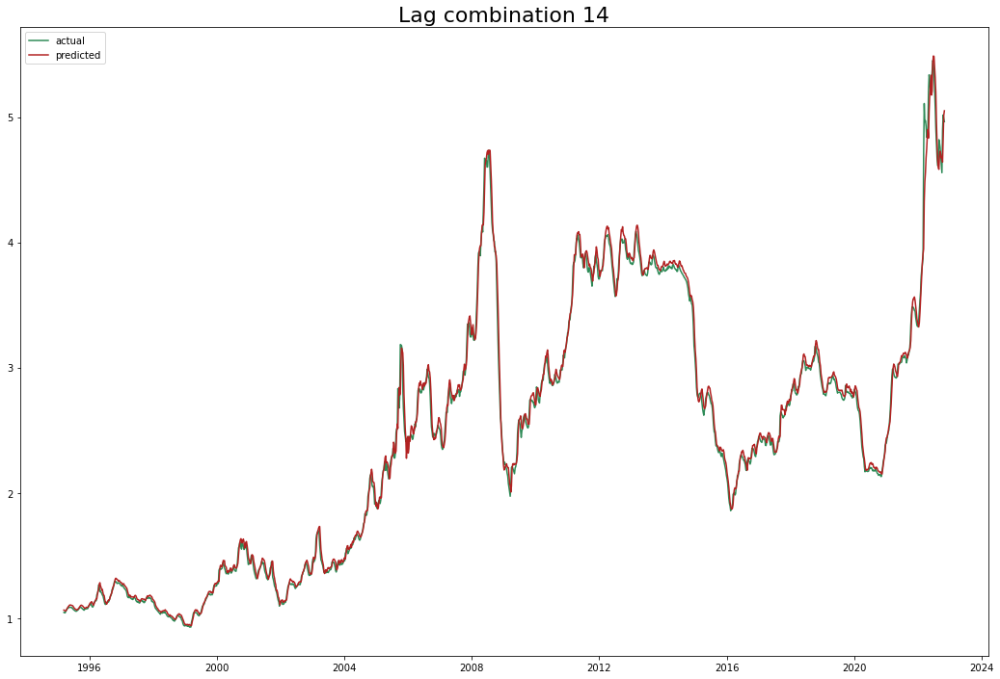

Test data rmse: 0.10144154132574223 Total rmse: 0.06768947095471824
Test data mape: 0.01680810319741179 Total mape: 0.017422544737405784
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.088) r2: (test=0.742) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.100) neg_root_mean_squared_error: (test=-0.293) r2: (test=0.603) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.252) r2: (test=0.856) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.071) r2: (test=0.973) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.088) r2: (test=0.742) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.100) neg_root_mean_squared_error: (test=-0.293) r2: (test=0.603) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.047) neg_root_mean_squared_error: (test=-0.215) r2: (test=0.896) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.073) r2: (test=0.971) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.996) total time=   0.5s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


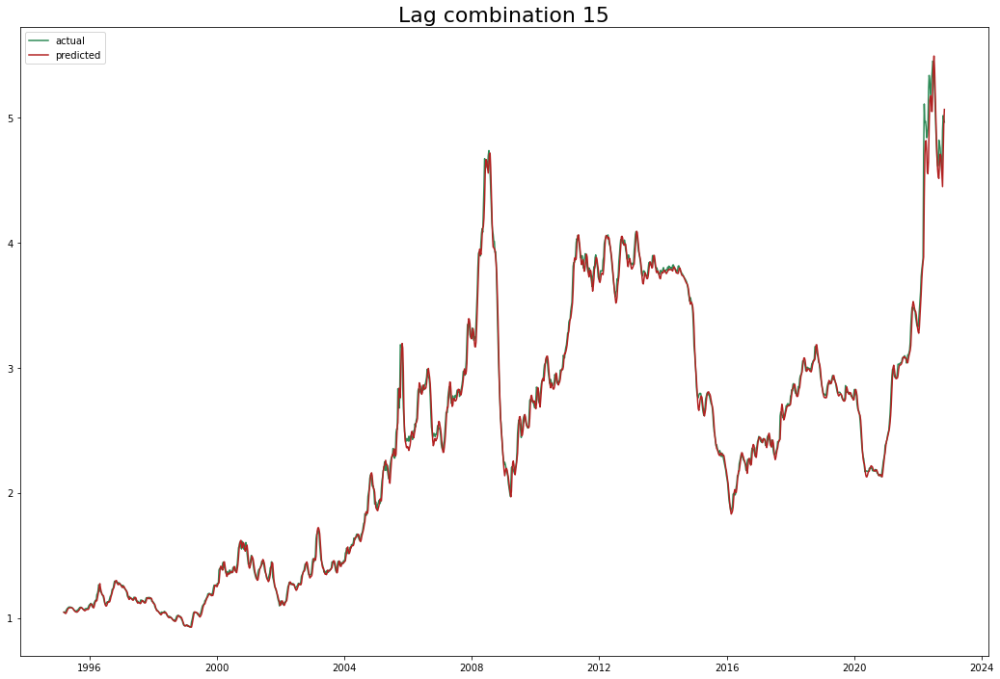

Test data rmse: 0.10717535220676302 Total rmse: 0.06625195743757668
Test data mape: 0.01450733322390079 Total mape: 0.014507896183626178
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.045) neg_root_mean_squared_error: (test=-0.070) r2: (test=0.840) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.170) r2: (test=0.866) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.045) neg_root_mean_squared_error: (test=-0.196) r2: (test=0.914) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.060) r2: (test=0.981) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.045) neg_root_mean_squared_error: (test=-0.070) r2: (test=0.840) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.170) r2: (test=0.866) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.181) r2: (test=0.926) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.078) r2: (test=0.968) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.073) r2: (test=0.989) total time=   0.2s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


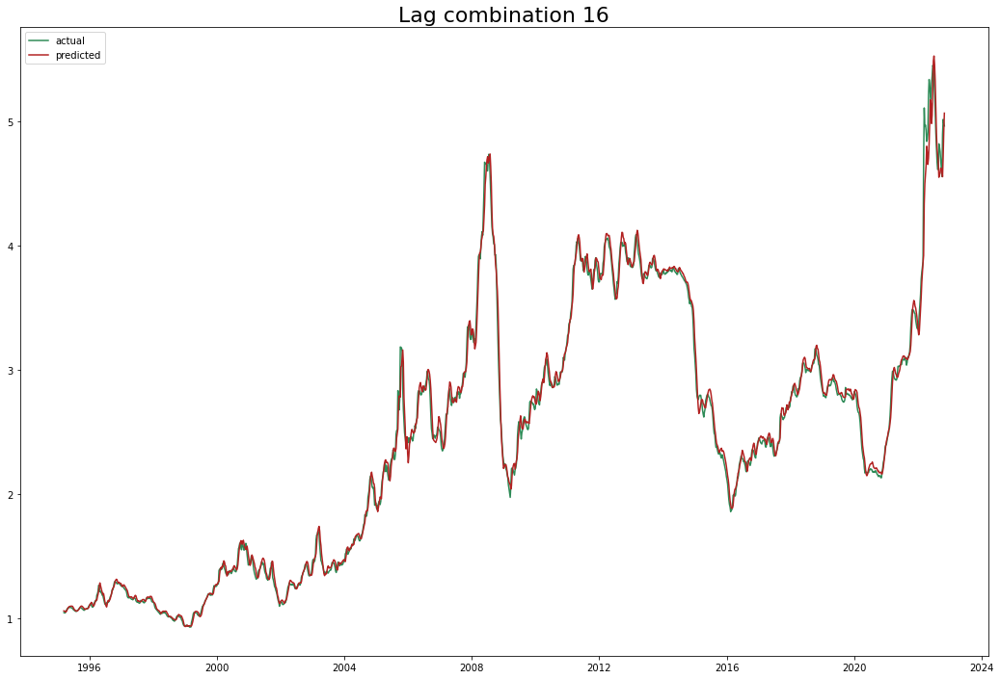

Test data rmse: 0.11681243591844197 Total rmse: 0.07437784771783286
Test data mape: 0.018968170528467634 Total mape: 0.017937305045591677
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.124) neg_root_mean_squared_error: (test=-0.179) r2: (test=-0.054) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.155) r2: (test=0.888) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.039) neg_root_mean_squared_error: (test=-0.167) r2: (test=0.937) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.070) r2: (test=0.974) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.074) r2: (test=0.988) total time=   0.2s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.124) neg_root_mean_squared_error: (test=-0.179) r2: (test=-0.054) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.155) r2: (test=0.888) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.212) r2: (test=0.899) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.079) r2: (test=0.967) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.057) r2: (test=0.993) total time=   0.3s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


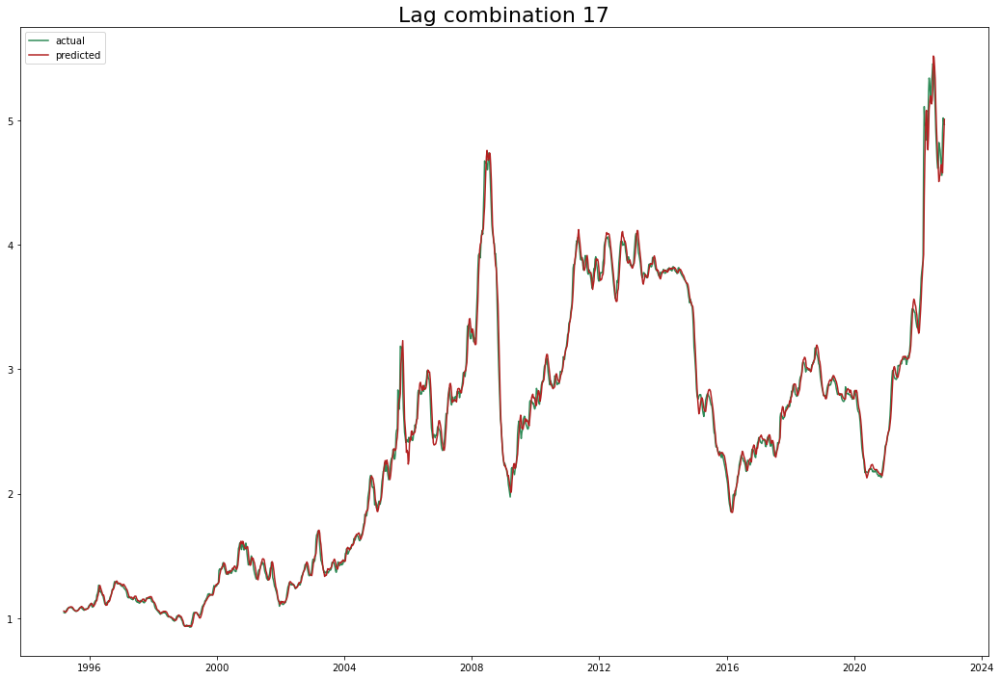

Test data rmse: 0.1017233711263828 Total rmse: 0.07086933358162295
Test data mape: 0.017035400464159665 Total mape: 0.017323798950711858
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.095) r2: (test=0.702) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.169) r2: (test=0.868) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.101) neg_root_mean_squared_error: (test=-0.423) r2: (test=0.596) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.982) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.056) r2: (test=0.993) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.095) r2: (test=0.702) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.169) r2: (test=0.868) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.046) neg_root_mean_squared_error: (test=-0.197) r2: (test=0.913) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.070) r2: (test=0.974) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.051) r2: (test=0.995) total time=   0.2s
{'hidden_layer_sizes': (50, 100, 50), 'max_iter': 5000}


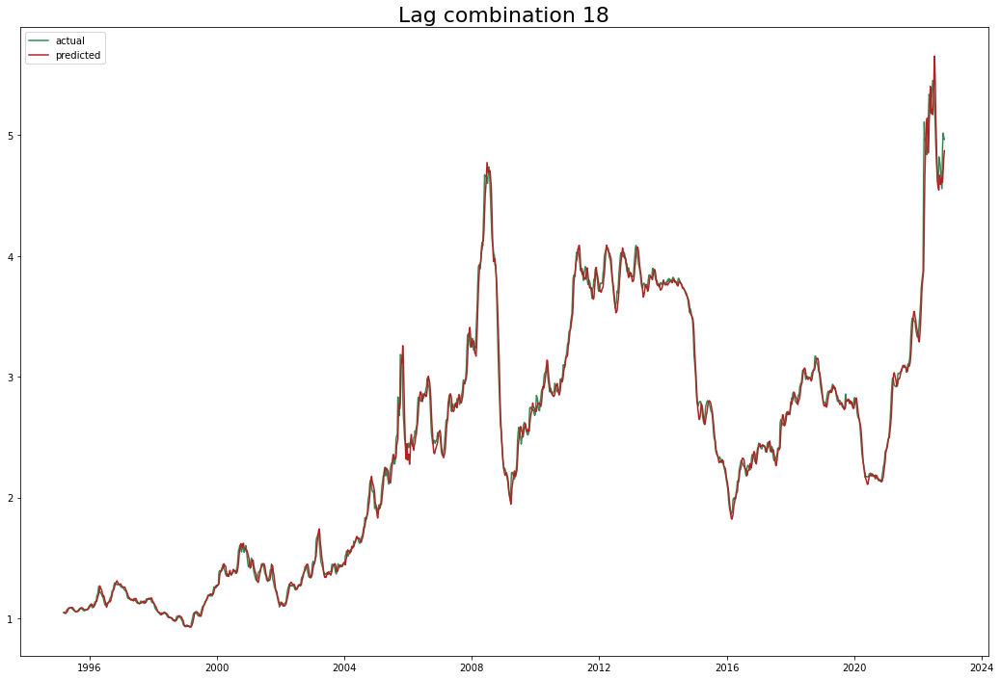

Test data rmse: 0.11073272434648268 Total rmse: 0.07486511676522685
Test data mape: 0.017342759042041668 Total mape: 0.017724684664827746
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.129) neg_root_mean_squared_error: (test=-0.189) r2: (test=-0.173) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.215) r2: (test=0.785) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.101) neg_root_mean_squared_error: (test=-0.413) r2: (test=0.615) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.979) total time=   0.4s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.992) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.129) neg_root_mean_squared_error: (test=-0.189) r2: (test=-0.173) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.215) r2: (test=0.785) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.049) neg_root_mean_squared_error: (test=-0.209) r2: (test=0.901) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.069) r2: (test=0.974) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.992) total time=   0.3s
{'hidden_layer_sizes': (100, 100, 100), 'max_iter': 5000}


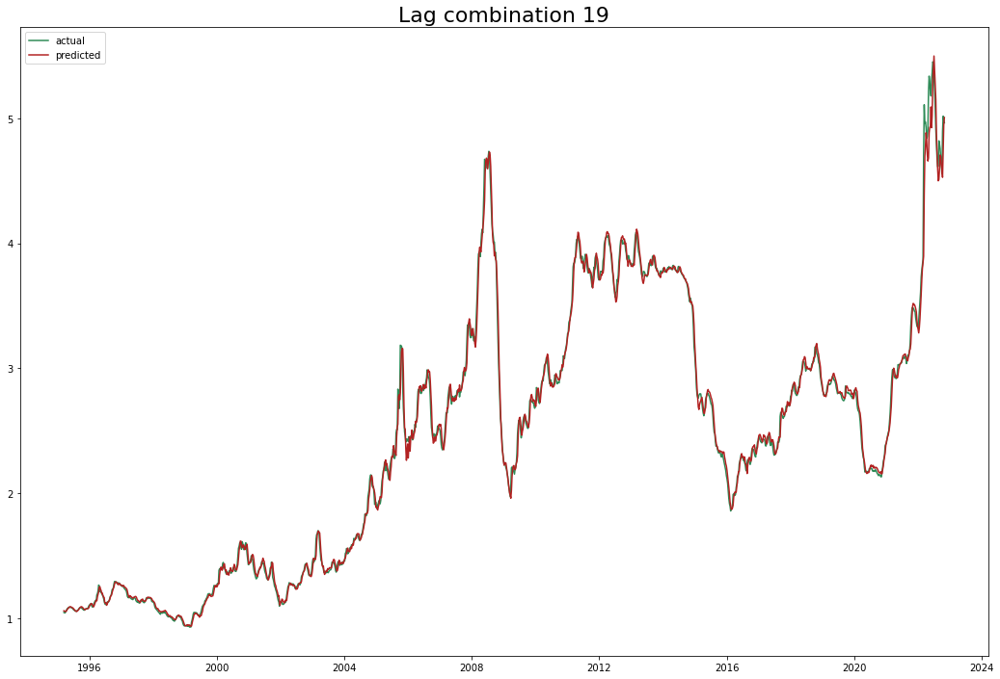

Test data rmse: 0.10873369962391527 Total rmse: 0.0666359774599352
Test data mape: 0.015691312488458526 Total mape: 0.014890077094622164
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.072) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.607) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.193) r2: (test=0.828) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.269) r2: (test=0.837) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.078) r2: (test=0.967) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.060) r2: (test=0.992) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.072) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.607) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.193) r2: (test=0.828) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.045) neg_root_mean_squared_error: (test=-0.197) r2: (test=0.912) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.073) r2: (test=0.971) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.023) neg_root_mean_squared_error: (test=-0.073) r2: (test=0.989) total time=   0.3s
{'hidden_layer_sizes': (100, 100, 100), 'max_iter': 5000}


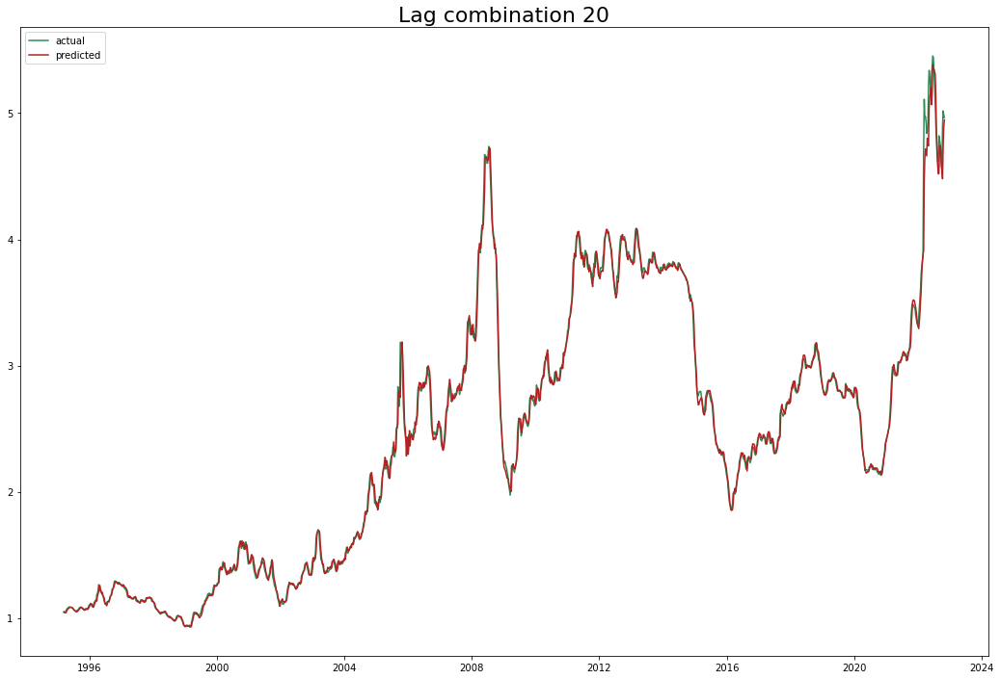

Test data rmse: 0.0960450193618018 Total rmse: 0.058989725365437264
Test data mape: 0.013058801338734076 Total mape: 0.012937872160854836
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.128) r2: (test=0.463) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.178) r2: (test=0.854) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.044) neg_root_mean_squared_error: (test=-0.196) r2: (test=0.913) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.096) r2: (test=0.951) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.993) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.128) r2: (test=0.463) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.178) r2: (test=0.854) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.045) neg_root_mean_squared_error: (test=-0.182) r2: (test=0.925) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.071) r2: (test=0.973) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.2s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


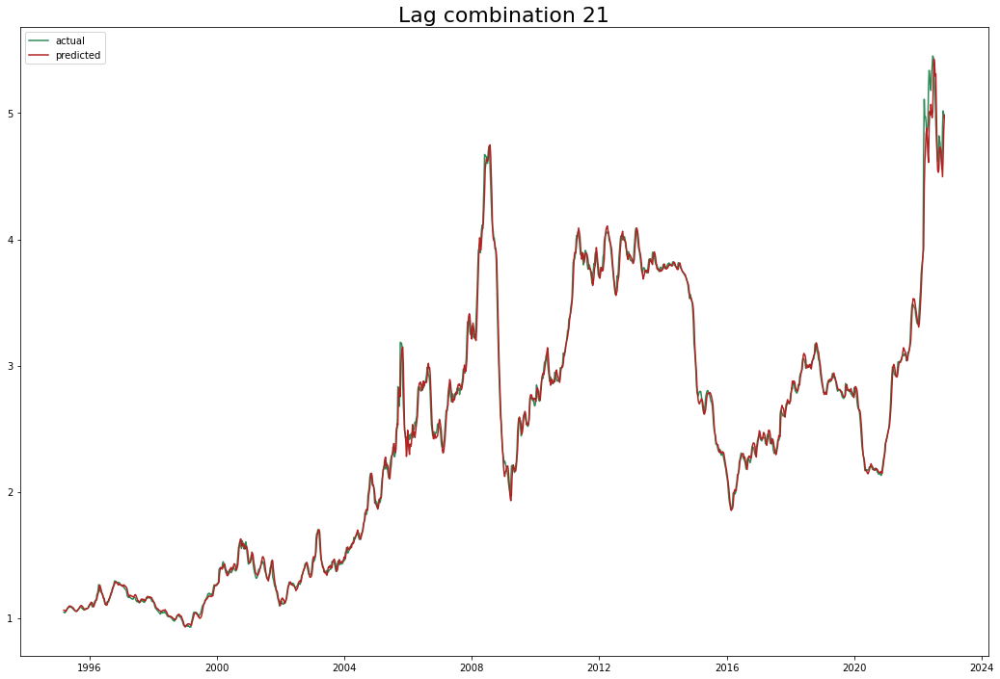

Test data rmse: 0.11383731959733169 Total rmse: 0.06934410405463501
Test data mape: 0.015479996878279674 Total mape: 0.015427697913756302
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.110) neg_root_mean_squared_error: (test=-0.160) r2: (test=0.157) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.183) r2: (test=0.845) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.042) neg_root_mean_squared_error: (test=-0.181) r2: (test=0.926) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.965) total time=   0.4s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.110) neg_root_mean_squared_error: (test=-0.160) r2: (test=0.157) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.183) r2: (test=0.845) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.214) r2: (test=0.897) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.076) r2: (test=0.969) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   0.4s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


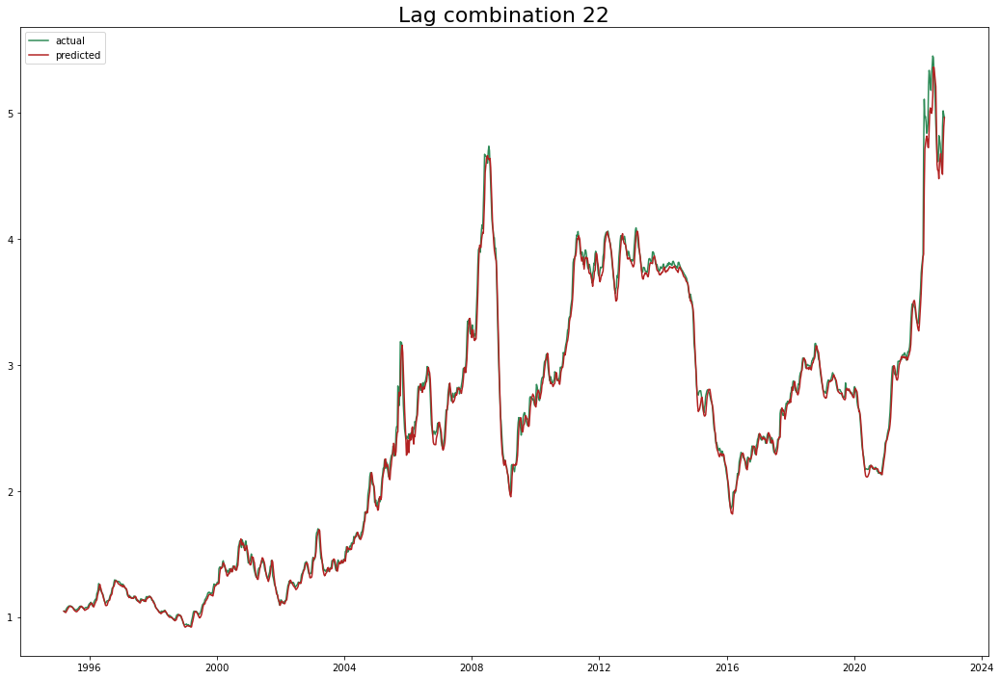

Test data rmse: 0.1096888335966085 Total rmse: 0.07069005548025185
Test data mape: 0.016347969468165767 Total mape: 0.016467453243336663
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.066) neg_root_mean_squared_error: (test=-0.104) r2: (test=0.644) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.086) neg_root_mean_squared_error: (test=-0.250) r2: (test=0.711) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.160) r2: (test=0.943) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.077) r2: (test=0.968) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.052) r2: (test=0.994) total time=   0.2s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.066) neg_root_mean_squared_error: (test=-0.104) r2: (test=0.644) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.086) neg_root_mean_squared_error: (test=-0.250) r2: (test=0.711) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.073) neg_root_mean_squared_error: (test=-0.317) r2: (test=0.773) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.095) r2: (test=0.952) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.990) total time=   0.3s
{'hidden_layer_sizes': (100, 100, 100), 'max_iter': 5000}


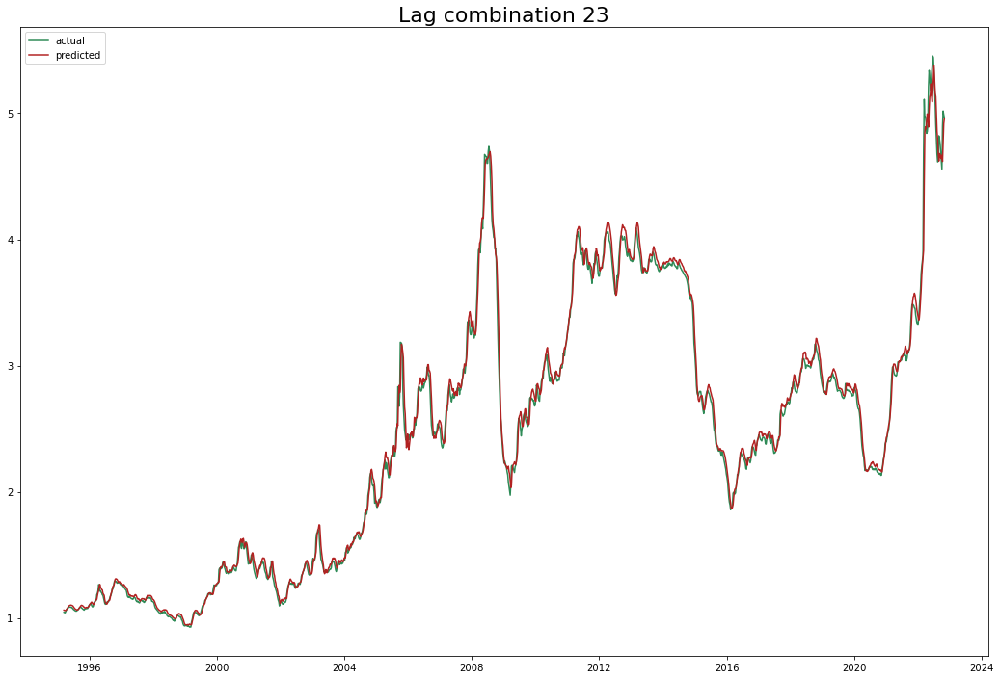

Test data rmse: 0.09664937856006962 Total rmse: 0.06974683977205075
Test data mape: 0.017772323070974066 Total mape: 0.018401280207606494
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.546) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.226) r2: (test=0.762) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.042) neg_root_mean_squared_error: (test=-0.179) r2: (test=0.928) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.083) r2: (test=0.963) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.074) r2: (test=0.988) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.546) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.226) r2: (test=0.762) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.067) neg_root_mean_squared_error: (test=-0.293) r2: (test=0.807) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.078) r2: (test=0.968) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.052) r2: (test=0.994) total time=   0.3s
{'hidden_layer_sizes': (50, 100, 25), 'max_iter': 5000}


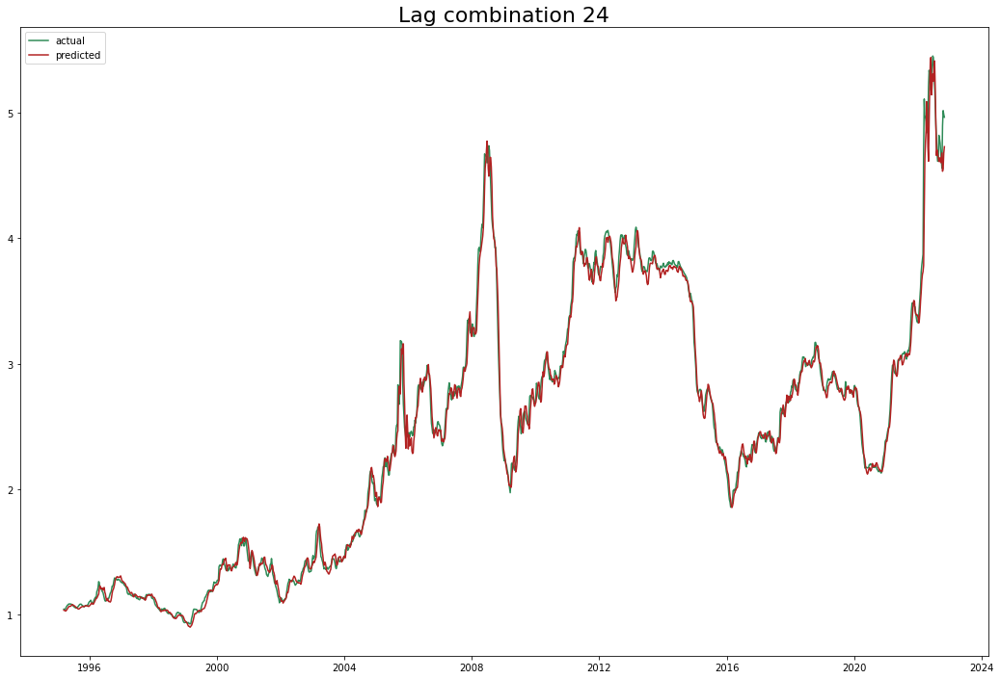

Test data rmse: 0.1193661588233445 Total rmse: 0.08169654029710945
Test data mape: 0.018586693429868198 Total mape: 0.021010588875940785
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.072) neg_root_mean_squared_error: (test=-0.111) r2: (test=0.592) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.107) neg_root_mean_squared_error: (test=-0.292) r2: (test=0.605) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.046) neg_root_mean_squared_error: (test=-0.196) r2: (test=0.913) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.085) r2: (test=0.962) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.080) r2: (test=0.987) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.072) neg_root_mean_squared_error: (test=-0.111) r2: (test=0.592) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.107) neg_root_mean_squared_error: (test=-0.292) r2: (test=0.605) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.134) neg_root_mean_squared_error: (test=-0.546) r2: (test=0.327) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.928) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.992) total time=   0.3s
{'hidden_layer_sizes': (100, 100, 100), 'max_iter': 5000}


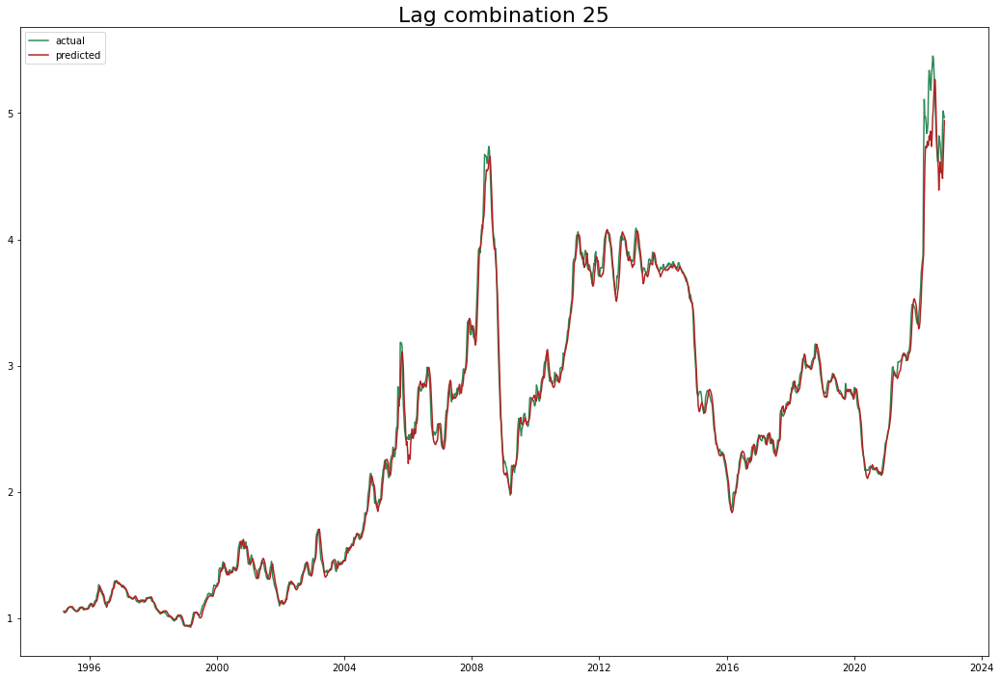

Test data rmse: 0.13435935784593778 Total rmse: 0.08187626669831086
Test data mape: 0.019311251954083224 Total mape: 0.018609967712518397
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.066) neg_root_mean_squared_error: (test=-0.101) r2: (test=0.665) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.097) neg_root_mean_squared_error: (test=-0.269) r2: (test=0.664) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.244) r2: (test=0.866) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.965) total time=   0.4s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.993) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.066) neg_root_mean_squared_error: (test=-0.101) r2: (test=0.665) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.097) neg_root_mean_squared_error: (test=-0.269) r2: (test=0.664) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.073) neg_root_mean_squared_error: (test=-0.323) r2: (test=0.765) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.979) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.052) r2: (test=0.994) total time=   0.4s
{'hidden_layer_sizes': (64, 64, 64), 'max_iter': 5000}


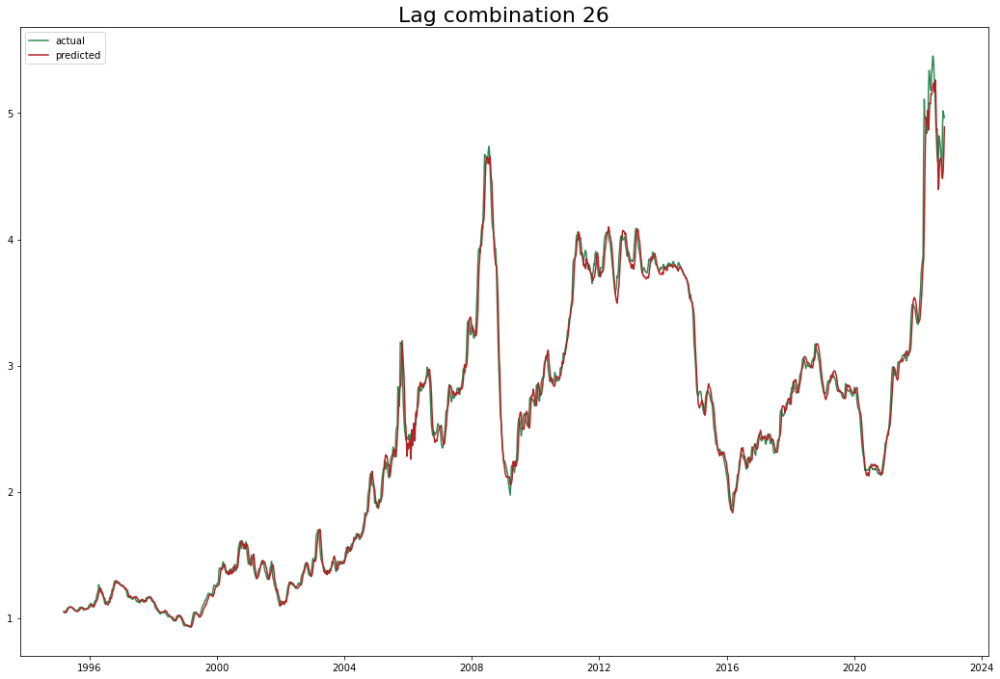

Test data rmse: 0.12584629159319072 Total rmse: 0.08550144684538873
Test data mape: 0.021027564438555142 Total mape: 0.02094406411288561
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.085) neg_root_mean_squared_error: (test=-0.132) r2: (test=0.426) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.084) neg_root_mean_squared_error: (test=-0.231) r2: (test=0.752) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.086) neg_root_mean_squared_error: (test=-0.359) r2: (test=0.709) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.112) r2: (test=0.934) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.991) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.085) neg_root_mean_squared_error: (test=-0.132) r2: (test=0.426) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.084) neg_root_mean_squared_error: (test=-0.231) r2: (test=0.752) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.135) neg_root_mean_squared_error: (test=-0.548) r2: (test=0.323) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.082) r2: (test=0.964) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.056) r2: (test=0.993) total time=   0.2s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


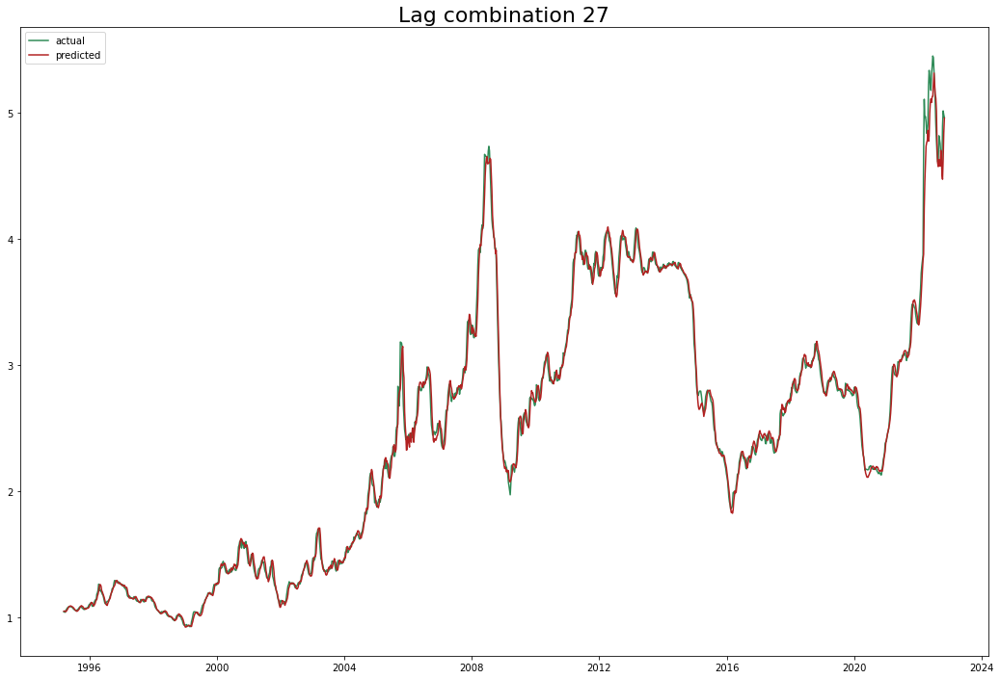

Test data rmse: 0.11656732267487842 Total rmse: 0.07337019549302122
Test data mape: 0.017391050677763767 Total mape: 0.016981934784453544
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.101) r2: (test=0.666) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.054) neg_root_mean_squared_error: (test=-0.152) r2: (test=0.892) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.099) neg_root_mean_squared_error: (test=-0.424) r2: (test=0.595) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.023) neg_root_mean_squared_error: (test=-0.106) r2: (test=0.940) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.023) neg_root_mean_squared_error: (test=-0.080) r2: (test=0.987) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.101) r2: (test=0.666) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.054) neg_root_mean_squared_error: (test=-0.152) r2: (test=0.892) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.081) neg_root_mean_squared_error: (test=-0.342) r2: (test=0.736) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.025) neg_root_mean_squared_error: (test=-0.111) r2: (test=0.934) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.051) r2: (test=0.994) total time=   0.4s
{'hidden_layer_sizes': (64, 64, 64), 'max_iter': 5000}


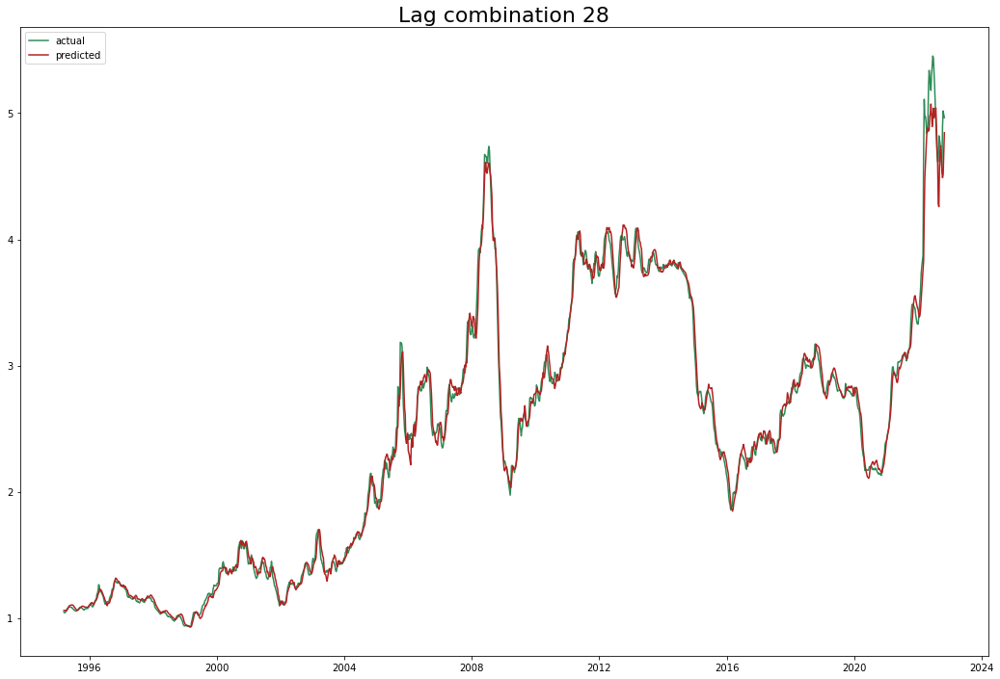

Test data rmse: 0.13908037804921475 Total rmse: 0.08693879081228757
Test data mape: 0.022903889472499668 Total mape: 0.021705600017720976
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.077) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.547) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.176) r2: (test=0.857) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.044) neg_root_mean_squared_error: (test=-0.190) r2: (test=0.919) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.028) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.921) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.057) r2: (test=0.993) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.077) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.547) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.176) r2: (test=0.857) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.205) r2: (test=0.905) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.965) total time=   0.4s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.992) total time=   0.4s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


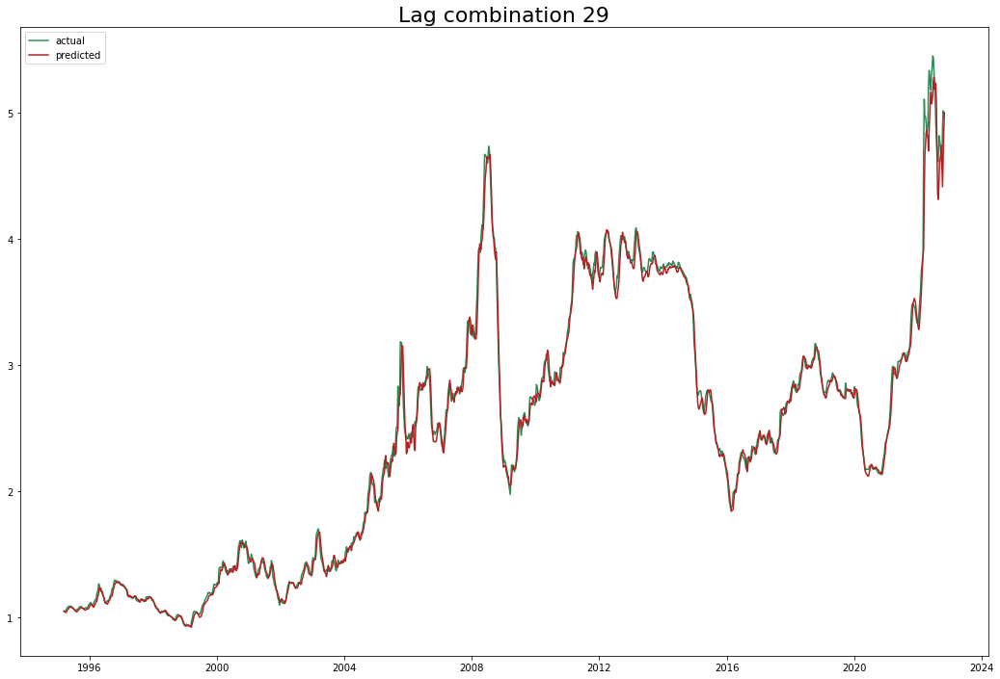

Test data rmse: 0.11596225408671595 Total rmse: 0.07388312119433868
Test data mape: 0.01712660413790469 Total mape: 0.017431342270507313
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.099) r2: (test=0.677) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.156) r2: (test=0.887) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.049) neg_root_mean_squared_error: (test=-0.203) r2: (test=0.907) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.965) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.028) neg_root_mean_squared_error: (test=-0.095) r2: (test=0.981) total time=   0.2s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.099) r2: (test=0.677) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.156) r2: (test=0.887) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.310) r2: (test=0.784) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.080) r2: (test=0.966) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.993) total time=   0.4s
{'hidden_layer_sizes': (64, 64, 64), 'max_iter': 5000}


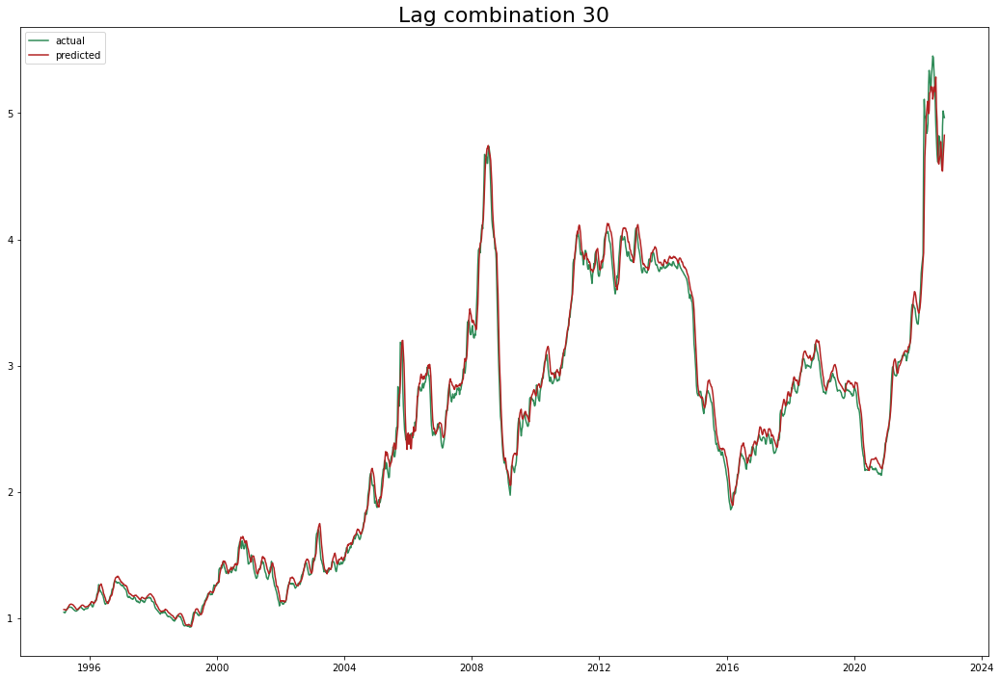

Test data rmse: 0.12187462511751075 Total rmse: 0.08799070389627571
Test data mape: 0.02580300100837909 Total mape: 0.024946069470055506
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.099) r2: (test=0.676) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.115) neg_root_mean_squared_error: (test=-0.306) r2: (test=0.565) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.207) r2: (test=0.903) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.083) r2: (test=0.963) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.057) r2: (test=0.993) total time=   0.1s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.099) r2: (test=0.676) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.115) neg_root_mean_squared_error: (test=-0.306) r2: (test=0.565) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.084) neg_root_mean_squared_error: (test=-0.357) r2: (test=0.713) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.953) total time=   0.4s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.075) r2: (test=0.988) total time=   0.4s
{'hidden_layer_sizes': (100, 100, 100), 'max_iter': 5000}


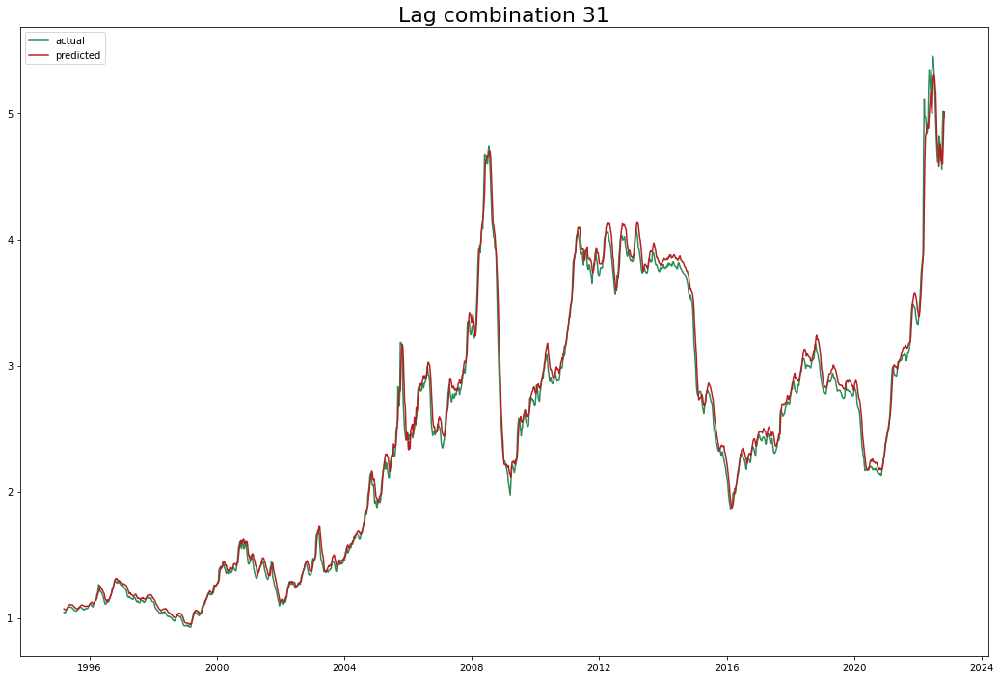

Test data rmse: 0.11621845916951269 Total rmse: 0.08329010818962691
Test data mape: 0.02480480223759609 Total mape: 0.023638747076614876
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.078) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.564) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.168) r2: (test=0.869) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.150) neg_root_mean_squared_error: (test=-0.637) r2: (test=0.085) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.965) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.993) total time=   0.2s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.078) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.564) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.168) r2: (test=0.869) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.203) r2: (test=0.907) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.084) r2: (test=0.963) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.993) total time=   0.2s
{'hidden_layer_sizes': (50, 100, 50), 'max_iter': 5000}


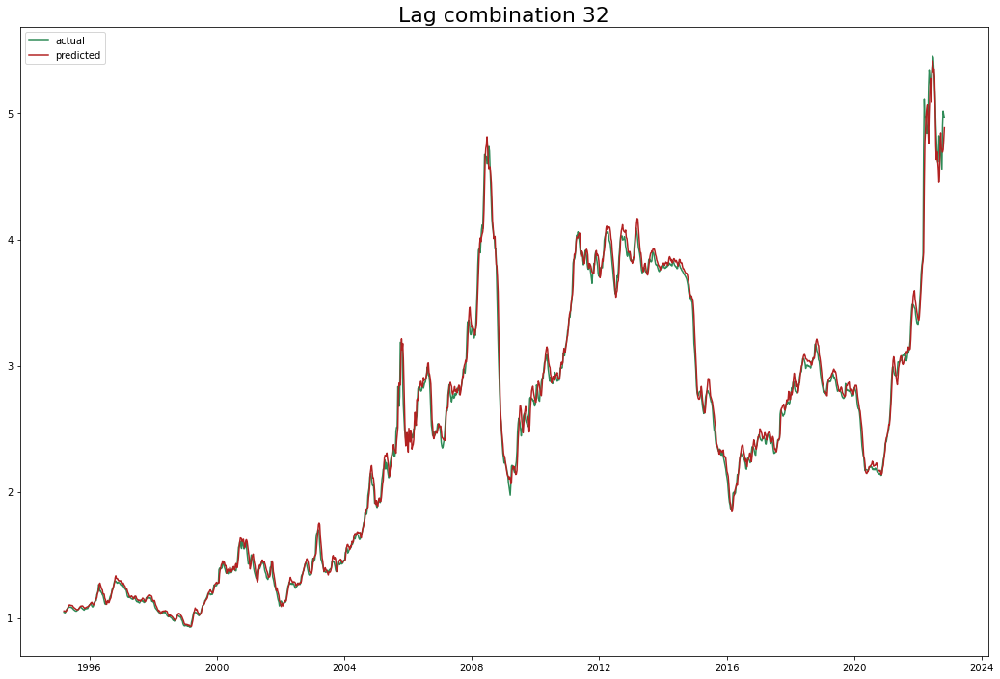

Test data rmse: 0.10109902842406467 Total rmse: 0.07179907598354764
Test data mape: 0.017969042102592096 Total mape: 0.018761699984283238
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.112) r2: (test=0.583) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.098) neg_root_mean_squared_error: (test=-0.272) r2: (test=0.657) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.068) neg_root_mean_squared_error: (test=-0.280) r2: (test=0.824) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.098) r2: (test=0.948) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.055) r2: (test=0.994) total time=   0.2s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.112) r2: (test=0.583) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.098) neg_root_mean_squared_error: (test=-0.272) r2: (test=0.657) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.244) r2: (test=0.866) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.097) r2: (test=0.950) total time=   0.4s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.060) r2: (test=0.992) total time=   0.3s
{'hidden_layer_sizes': (100, 100, 100), 'max_iter': 5000}


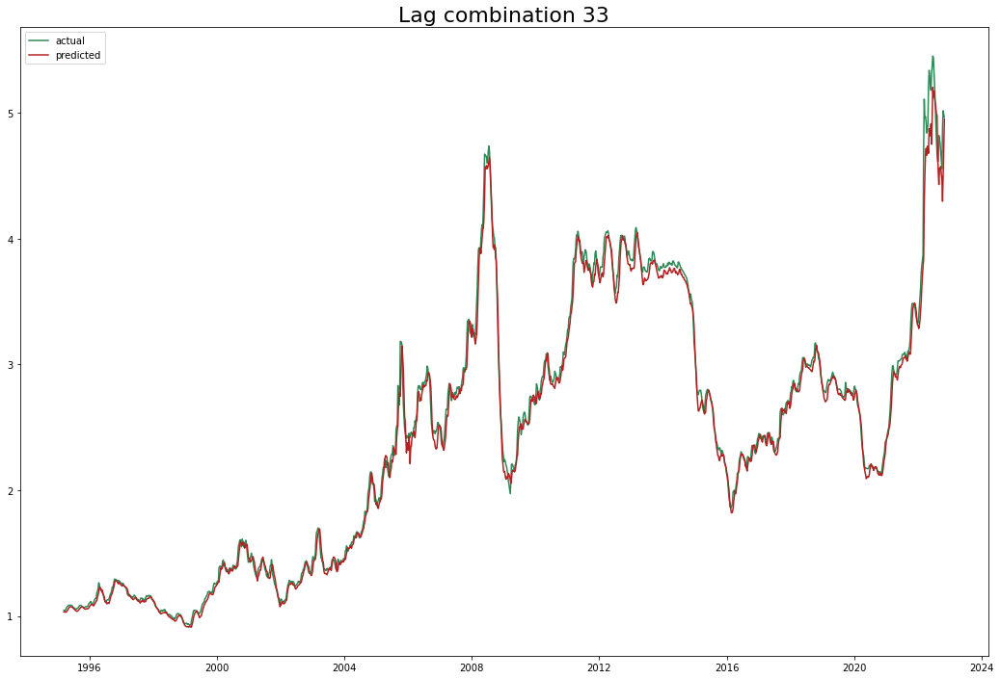

Test data rmse: 0.13911380612026147 Total rmse: 0.08529935385903081
Test data mape: 0.020994953242244235 Total mape: 0.02037941854580028
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.081) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.498) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.224) r2: (test=0.766) total tim

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.225) r2: (test=0.886) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.089) r2: (test=0.958) total time=   0.1s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.994) total time=   0.2s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.081) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.498) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.224) r2: (test=0.766) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.191) r2: (test=0.918) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.088) r2: (test=0.958) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.070) r2: (test=0.990) total time=   0.4s
{'hidden_layer_sizes': (64, 64, 64), 'max_iter': 5000}


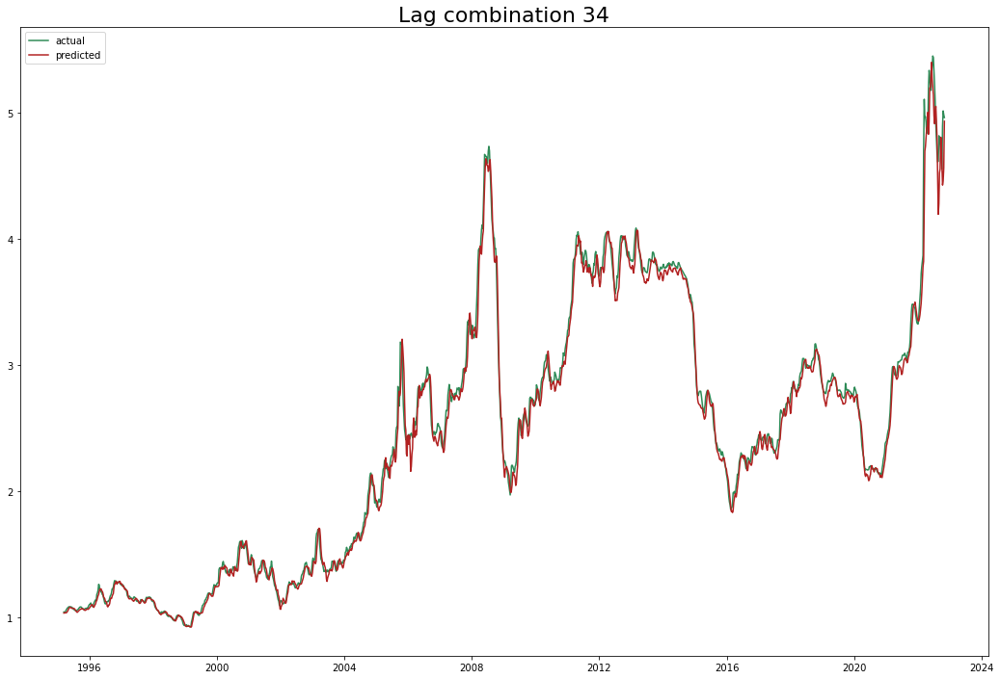

Test data rmse: 0.1310014543204432 Total rmse: 0.08829723473170341
Test data mape: 0.02236103464212851 Total mape: 0.02200129349238439
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.105) r2: (test=0.637) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.068) neg_root_mean_squared_error: (test=-0.201) r2: (test=0.813) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.200) r2: (test=0.909) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.932) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.106) r2: (test=0.976) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.105) r2: (test=0.637) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.072) r2: (test=0.989) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.090) neg_root_mean_squared_error: (test=-0.139) r2: (test=0.359) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.102) neg_root_mean_squared_error: (test=-0.284) r2: (test=0.627) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.224) r2: (test=0.886) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.075) r2: (test=0.970) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50)

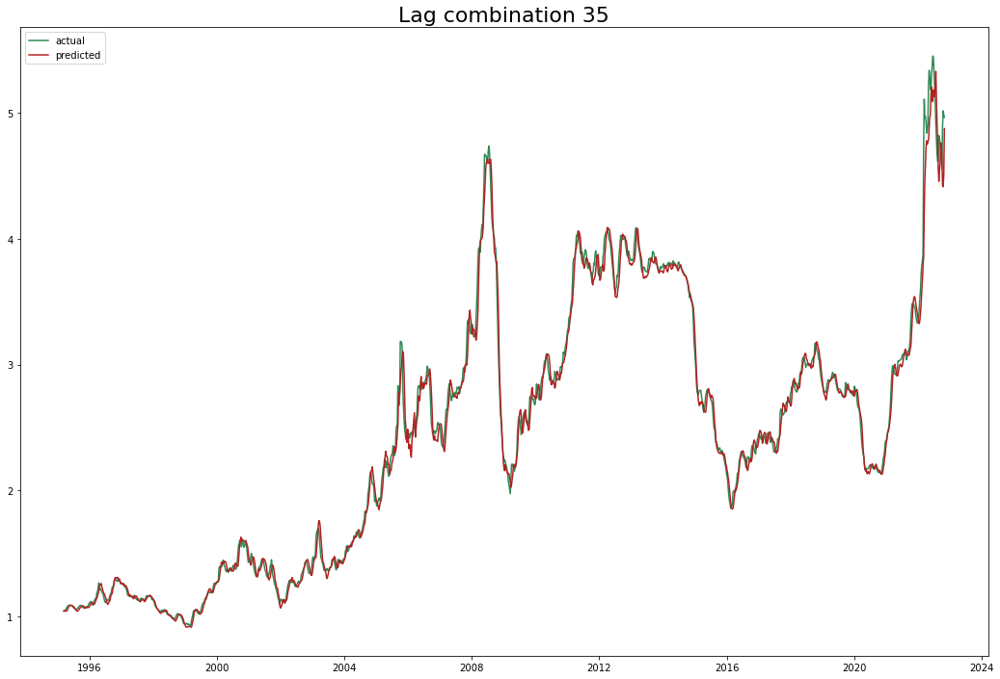

Test data rmse: 0.13603115464797477 Total rmse: 0.0890954188619435
Test data mape: 0.02140082349041421 Total mape: 0.021545195843100745
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.087) r2: (test=0.753) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.091) neg_root_mean_squared_error: (test=-0.249) r2: (

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.083) neg_root_mean_squared_error: (test=-0.329) r2: (test=0.756) total time=   0.0s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.094) r2: (test=0.953) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.991) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.087) r2: (test=0.753) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.091) neg_root_mean_squared_error: (test=-0.249) r2: (test=0.713) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.073) neg_root_mean_squared_error: (test=-0.278) r2: (test=0.826) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.091) r2: (test=0.956) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.023) neg_root_mean_squared_error: (test=-0.076) r2: (test=0.988) total time=   0.3s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


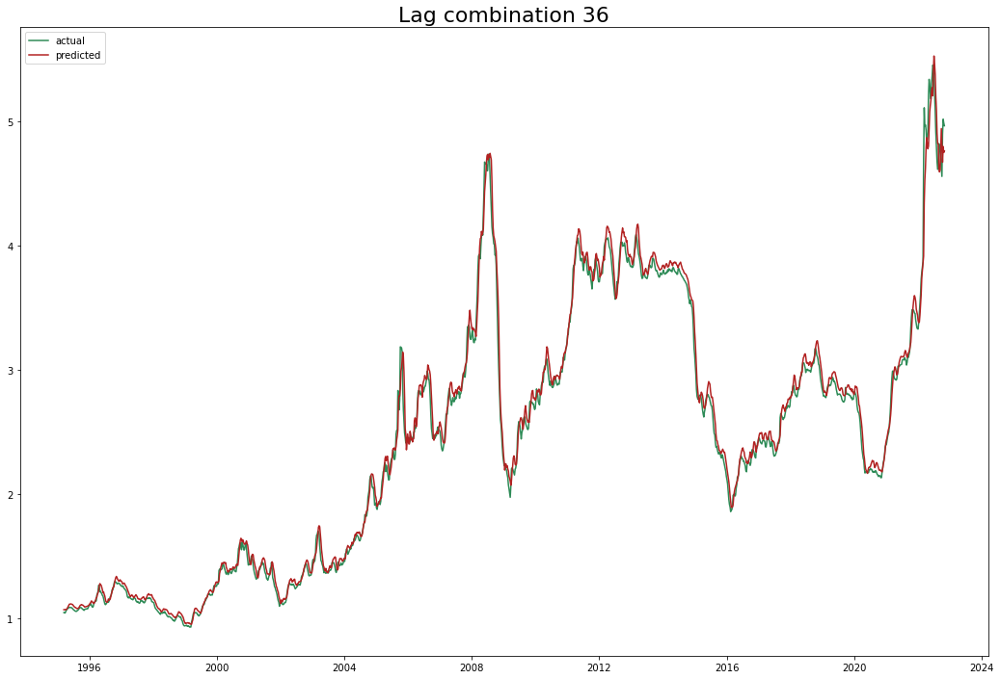

Test data rmse: 0.12040580279800232 Total rmse: 0.08646578080944776
Test data mape: 0.02413286474488643 Total mape: 0.02449624155513
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.099) neg_root_mean_squared_error: (test=-0.154) r2: (test=0.216) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.171) r2: (test=0.864) total time=   0.1s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.067) neg_root_mean_squared_error: (test=-0.266) r2: (test=0.841) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.094) r2: (test=0.953) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.072) r2: (test=0.989) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.099) neg_root_mean_squared_error: (test=-0.154) r2: (test=0.216) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.993) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.066) neg_root_mean_squared_error: (test=-0.103) r2: (test=0.651) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.081) neg_root_mean_squared_error: (test=-0.228) r2: (test=0.759) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.075) neg_root_mean_squared_error: (test=-0.278) r2: (test=0.826) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.096) r2: (test=0.951) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50)

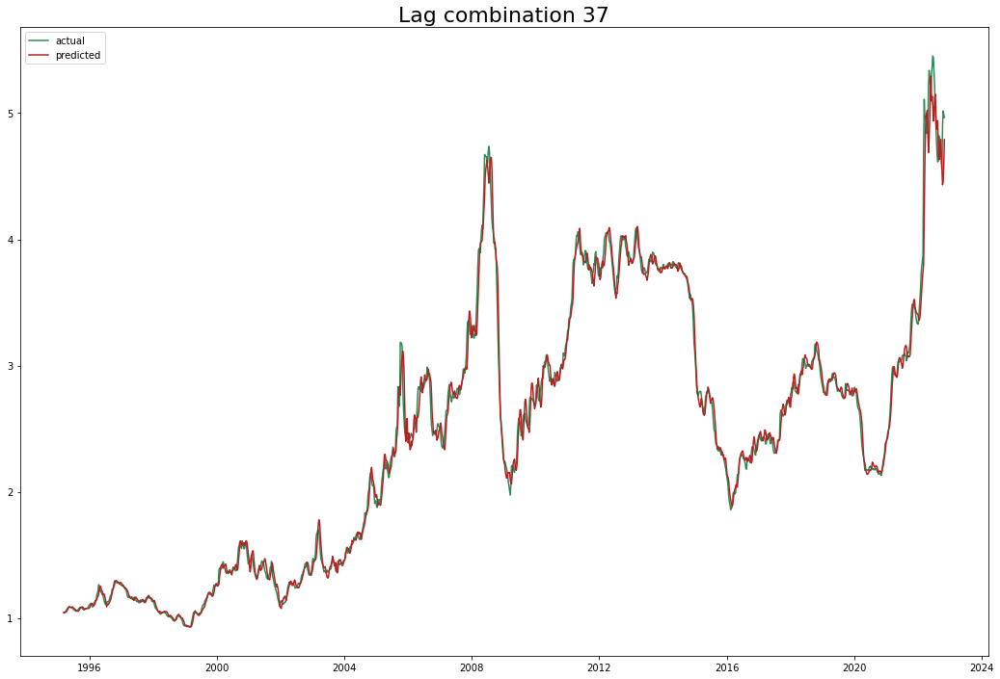

Test data rmse: 0.13324843146174603 Total rmse: 0.08857833651639582
Test data mape: 0.020573339593504922 Total mape: 0.020602854228171447
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.091) neg_root_mean_squared_error: (test=-0.142) r2: (test=0.339) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_er

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.054) neg_root_mean_squared_error: (test=-0.206) r2: (test=0.904) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.955) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.103) r2: (test=0.977) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.091) neg_root_mean_squared_error: (test=-0.142) r2: (test=0.339) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.227) r2: (test=0.761) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.238) r2: (test=0.872) total time=   0.3s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.082) r2: (test=0.964) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.993) total time=   0.3s
{'hidden_layer_sizes': (50, 100, 50), 'max_iter': 5000}


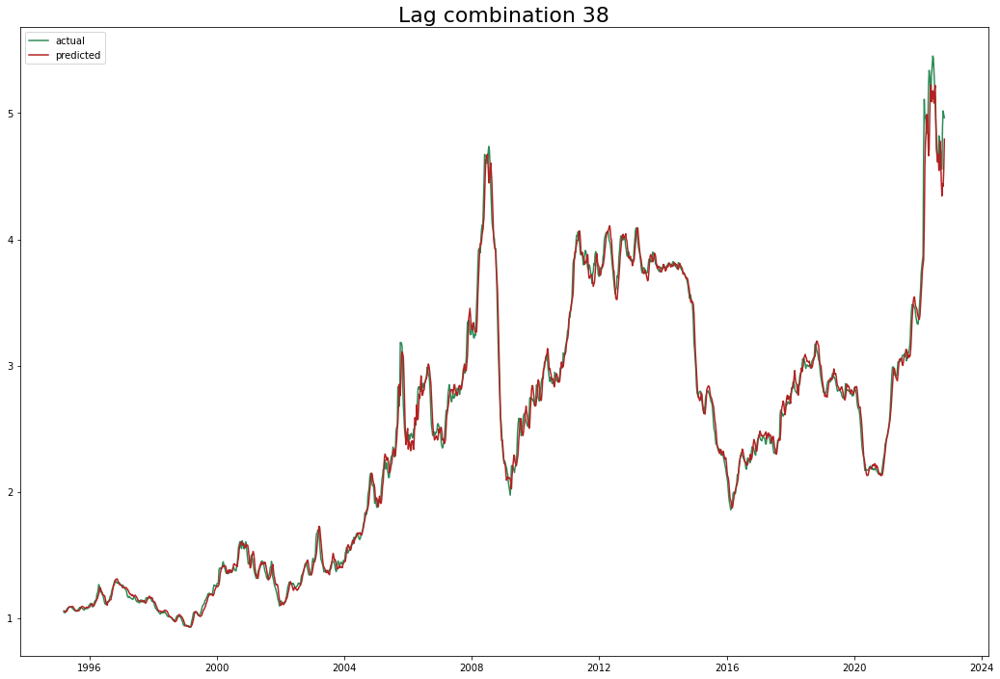

Test data rmse: 0.13428858618510642 Total rmse: 0.08633798373159694
Test data mape: 0.021183426025190952 Total mape: 0.020964405823076522
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.084) neg_root_mean_squared_error: (test=-0.133) r2: (test=0.419) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.092) neg_root_mean

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.230) r2: (test=0.880) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.954) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.990) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.084) neg_root_mean_squared_error: (test=-0.133) r2: (test=0.419) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.092) neg_root_mean_squared_error: (test=-0.257) r2: (test=0.693) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.087) neg_root_mean_squared_error: (test=-0.306) r2: (test=0.788) total time=   0.3s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.954) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.071) r2: (test=0.989) total time=   0.4s
{'hidden_layer_sizes': (64, 64, 64), 'max_iter': 5000}


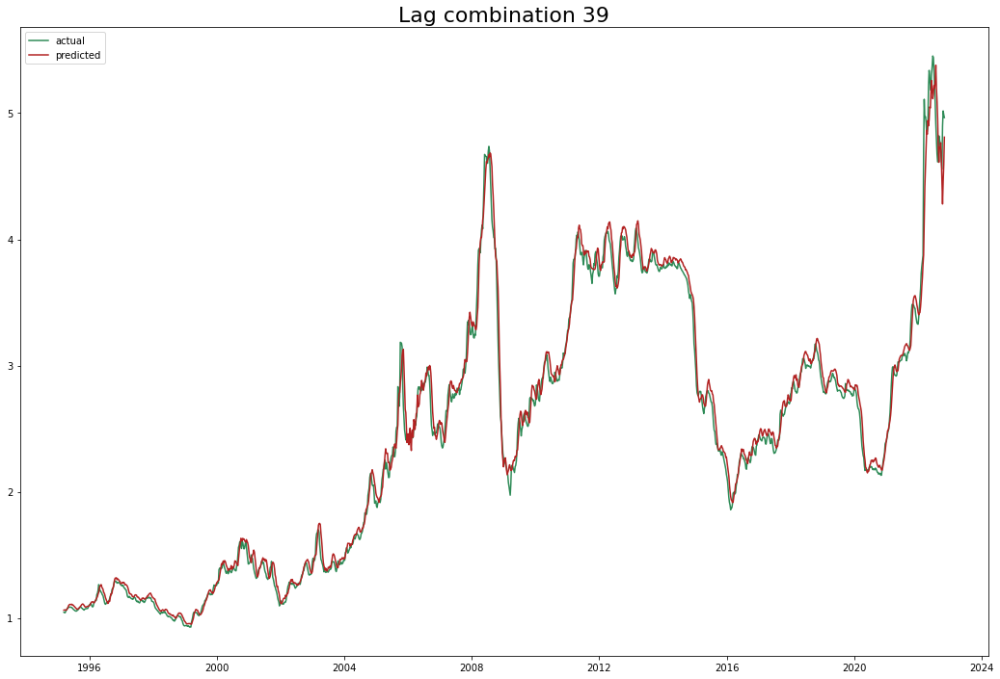

Test data rmse: 0.14253286690838074 Total rmse: 0.09897104792060017
Test data mape: 0.026544855130864218 Total mape: 0.02664566716129212
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.097) r2: (test=0.689) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.060) neg

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.087) neg_root_mean_squared_error: (test=-0.332) r2: (test=0.751) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.925) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.084) r2: (test=0.985) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.097) r2: (test=0.689) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.182) r2: (test=0.847) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.068) neg_root_mean_squared_error: (test=-0.247) r2: (test=0.862) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.079) r2: (test=0.966) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.3s
{'hidden_layer_sizes': (100, 100, 100), 'max_iter': 5000}


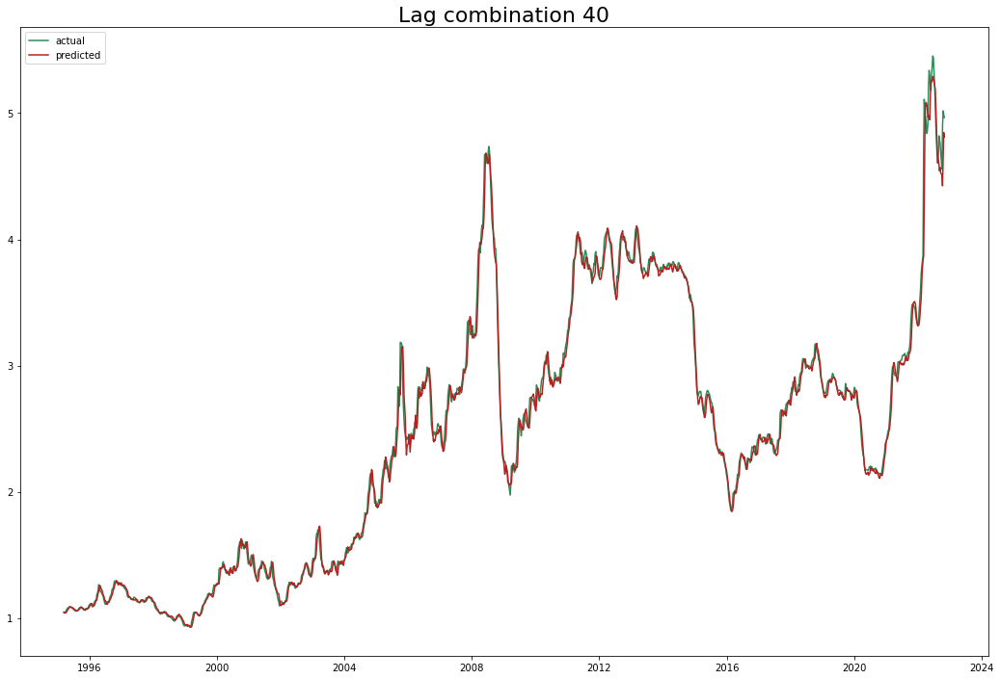

Test data rmse: 0.10750691759890293 Total rmse: 0.07145313531797058
Test data mape: 0.017218886774282297 Total mape: 0.017049250871191305
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.069) neg_root_mean_squared_error: (test=-0.110) r2: (test=0.604) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.084) neg_root_mean_squared_error: (test=-0.347) r2: (test=0.728) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.132) r2: (test=0.907) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.082) r2: (test=0.986) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.069) neg_root_mean_squared_error: (test=-0.110) r2: (test=0.604) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.099) neg_root_mean_squared_error: (test=-0.276) r2: (test=0.646) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.226) r2: (test=0.885) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.087) r2: (test=0.960) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.056) r2: (test=0.993) total time=   0.4s
{'hidden_layer_sizes': (100, 100, 100), 'max_iter': 5000}


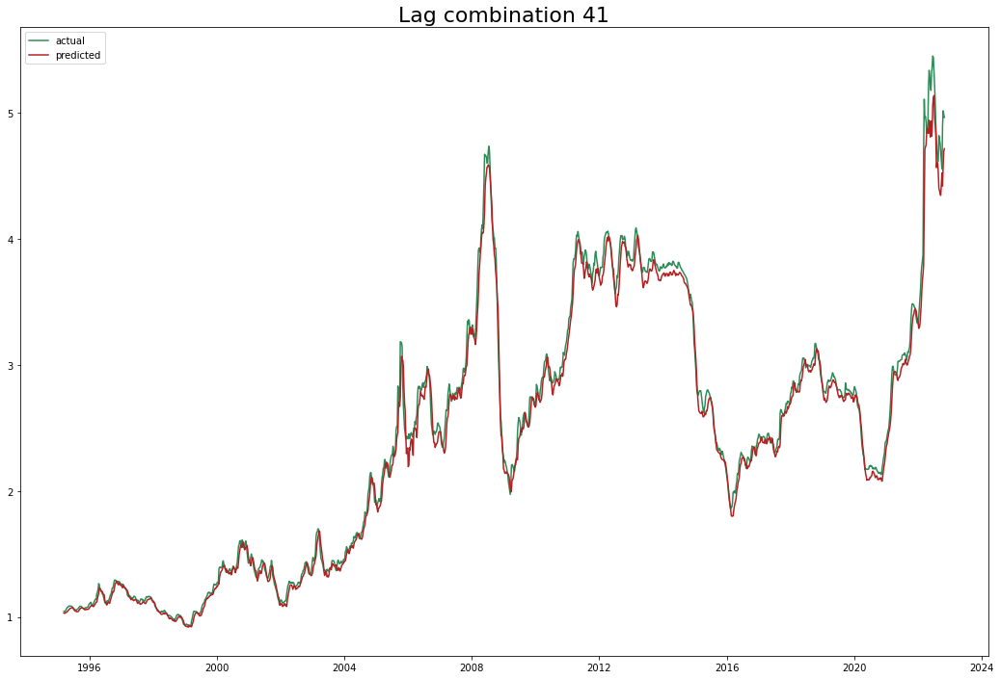

Test data rmse: 0.14453882663088832 Total rmse: 0.0950926906279761
Test data mape: 0.02614194770450304 Total mape: 0.02430047468730983
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.078) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.529) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_erro

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.071) neg_root_mean_squared_error: (test=-0.278) r2: (test=0.826) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.102) r2: (test=0.944) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.993) total time=   0.5s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.078) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.529) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.048) neg_root_mean_squared_error: (test=-0.138) r2: (test=0.912) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.213) r2: (test=0.897) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.089) r2: (test=0.958) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.080) r2: (test=0.986) total time=   0.4s
{'hidden_layer_sizes': (64, 64, 64), 'max_iter': 5000}


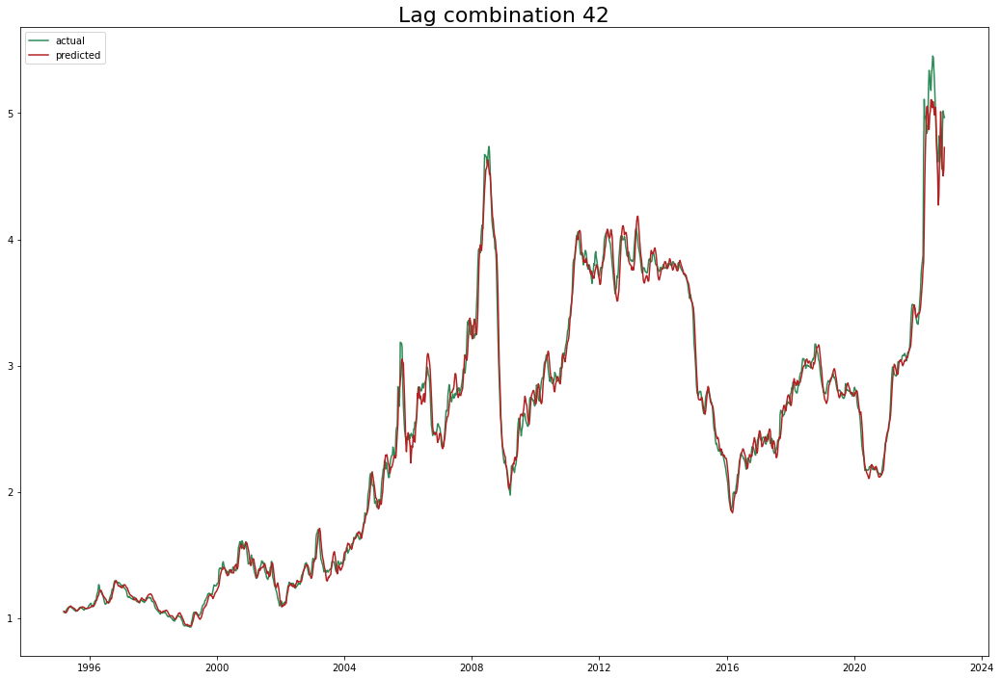

Test data rmse: 0.137785219623518 Total rmse: 0.09111337486013929
Test data mape: 0.02278693083256577 Total mape: 0.023379350768767872
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.085) neg_root_mean_squared_error: (test=-0.133) r2: (test=0.415) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_perc

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.248) r2: (test=0.861) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.955) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.110) r2: (test=0.974) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.085) neg_root_mean_squared_error: (test=-0.133) r2: (test=0.415) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.098) neg_root_mean_squared_error: (test=-0.275) r2: (test=0.649) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.066) neg_root_mean_squared_error: (test=-0.254) r2: (test=0.854) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.954) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.968) total time=   0.4s
{'hidden_layer_sizes': (100, 100, 100), 'max_iter': 5000}


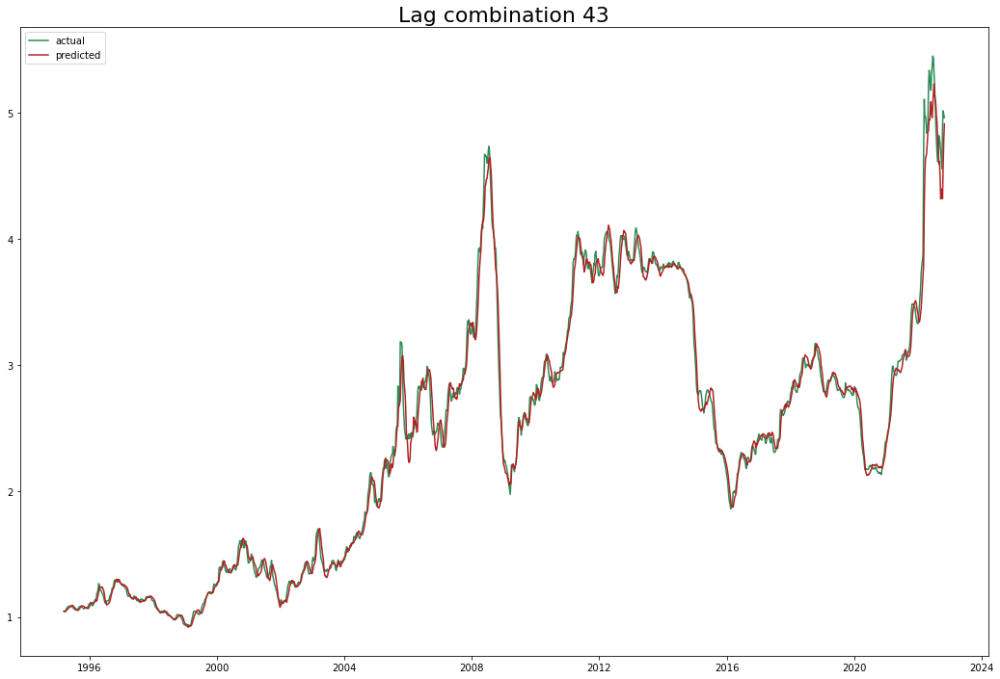

Test data rmse: 0.13632793186774253 Total rmse: 0.09103141609906412
Test data mape: 0.02335455984280249 Total mape: 0.022011001009164477
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.560) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.244) r2: (test=0.866) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.100) r2: (test=0.946) total time=   0.4s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.991) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.560) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.083) neg_root_mean_squared_error: (test=-0.234) r2: (test=0.745) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.073) neg_root_mean_squared_error: (test=-0.295) r2: (test=0.804) total time=   0.3s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.098) r2: (test=0.949) total time=   0.4s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.990) total time=   0.5s
{'hidden_layer_sizes': (64, 64, 64), 'max_iter': 5000}


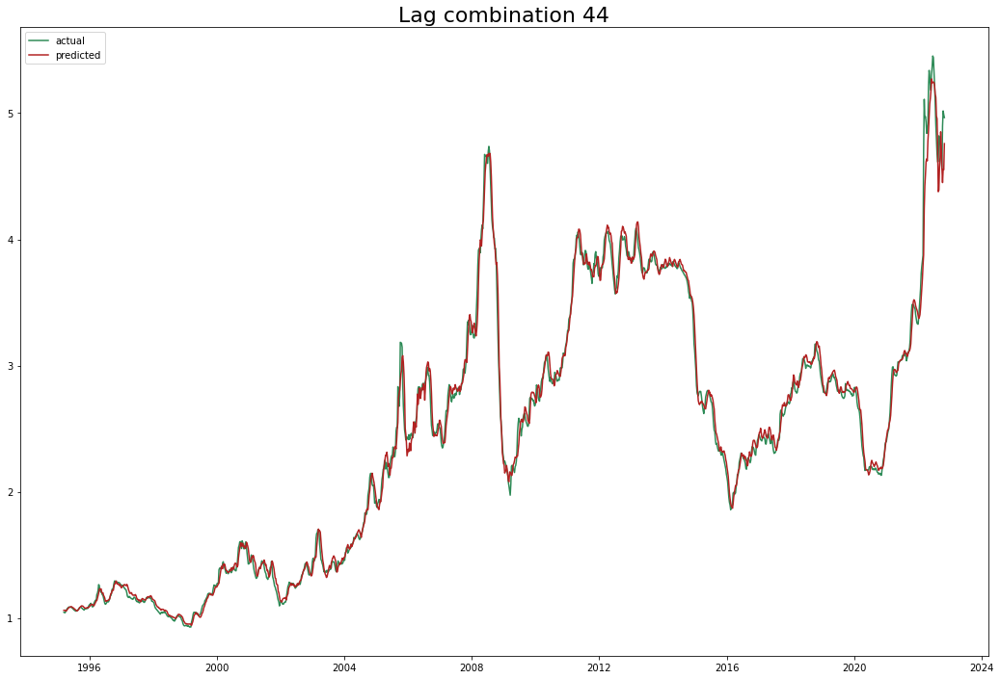

Test data rmse: 0.12840178762208013 Total rmse: 0.08395604985828743
Test data mape: 0.021841988660168846 Total mape: 0.021491014526597275
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.087) neg_root_mean_squared_error: (test=-0.139) r2: (test=0.366) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=500

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.207) r2: (test=0.904) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.023) neg_root_mean_squared_error: (test=-0.103) r2: (test=0.944) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.086) r2: (test=0.984) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.087) neg_root_mean_squared_error: (test=-0.139) r2: (test=0.366) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.082) neg_root_mean_squared_error: (test=-0.236) r2: (test=0.741) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.238) r2: (test=0.872) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.025) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.931) total time=   0.4s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.039) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.966) total time=   0.4s
{'hidden_layer_sizes': (64, 64, 64), 'max_iter': 5000}


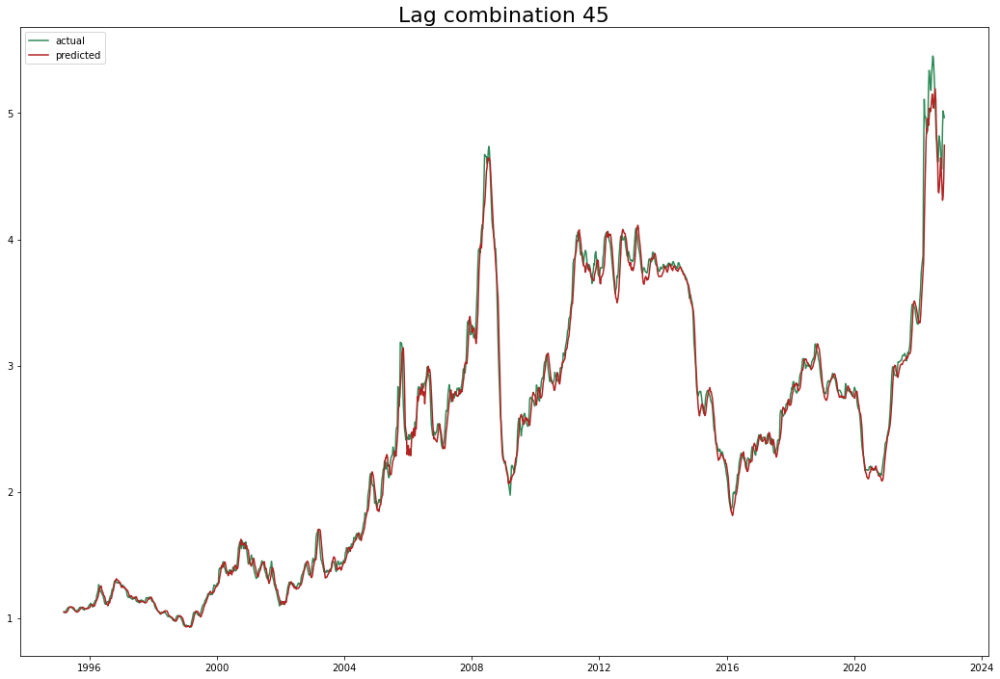

Test data rmse: 0.14547815151818844 Total rmse: 0.09471538357637846
Test data mape: 0.02370655261167058 Total mape: 0.02291140099359728
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.103) r2: (test=0.653) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.067) neg_root_mean_squared_error: (test=-0.196) r2: (test=0.822) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.194) r2: (test=0.915) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.096) r2: (test=0.951) total time=   0.4s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squared_error: (test=-0.086) r2: (test=0.984) total time=   0.4s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.103) r2: (test=0.653) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.064) r2: (test=0.991) total time=   0.5s
[CV 1/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.103) neg_root_mean_squared_error: (test=-0.153) r2: (test=0.232) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.214) r2: (test=0.788) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.108) neg_root_mean_squared_error: (test=-0.415) r2: (test=0.611) total time=   0.3s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.028) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.923) total time=   0.4s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50)

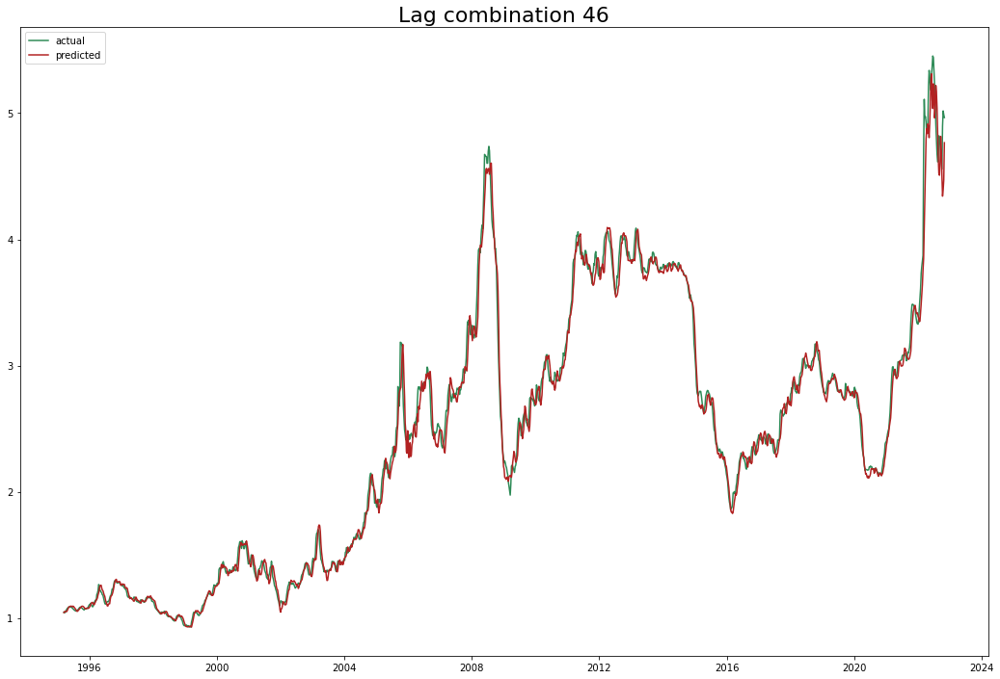

Test data rmse: 0.14573756170305896 Total rmse: 0.09587126082177429
Test data mape: 0.022739459711153383 Total mape: 0.02275480977745246
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.088) neg_root_mean_squared_error: (test=-0.139) r2: (test=0.365) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.092) neg_root_mean_squared_error: (test=-0.254) r2: (test=0.700) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.263) r2: (test=0.845) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.925) total time=   0.4s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.056) r2: (test=0.993) total time=   0.5s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.088) neg_root_mean_squared_error: (test=-0.139) r2: (test=0.365) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.025) neg_root_mean_squared_error: (test=-0.086) r2: (test=0.984) total time=   0.5s
[CV 1/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.091) neg_root_mean_squared_error: (test=-0.137) r2: (test=0.377) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.086) neg_root_mean_squared_error: (test=-0.245) r2: (test=0.722) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.112) neg_root_mean_squared_error: (test=-0.432) r2: (test=0.580) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.044) neg_root_mean_squared_error: (test=-0.183) r2: (test=0.822) total time=   0.5s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50)

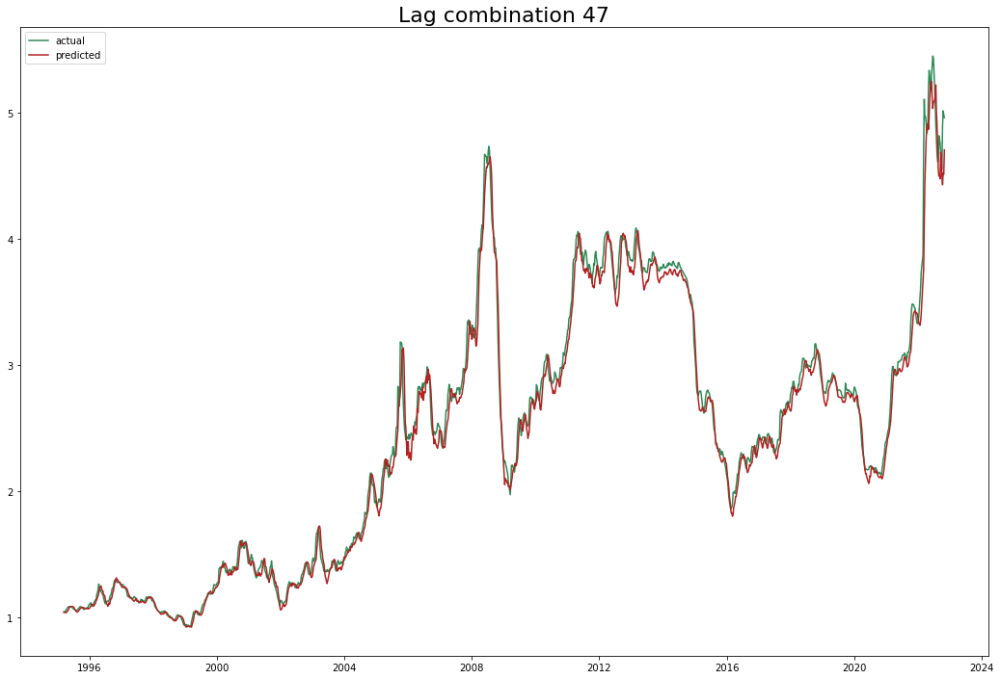

Test data rmse: 0.1461832141942845 Total rmse: 0.10069567475878952
Test data mape: 0.026265163378032197 Total mape: 0.025470006674418906
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.199) neg_root_mean_squared_error: (test=-0.299) r2: (test=-1.944) total time=   0.0s
[CV 2/5] END hidden_layer

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.094) neg_root_mean_squared_error: (test=-0.359) r2: (test=0.710) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.097) r2: (test=0.950) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.992) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.199) neg_root_mean_squared_error: (test=-0.299) r2: (test=-1.944) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.084) neg_root_mean_squared_error: (test=-0.235) r2: (test=0.745) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.069) neg_root_mean_squared_error: (test=-0.269) r2: (test=0.837) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.083) r2: (test=0.963) total time=   0.4s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.066) r2: (test=0.991) total time=   0.4s
{'hidden_layer_sizes': (120, 120, 120), 'max_iter': 5000}


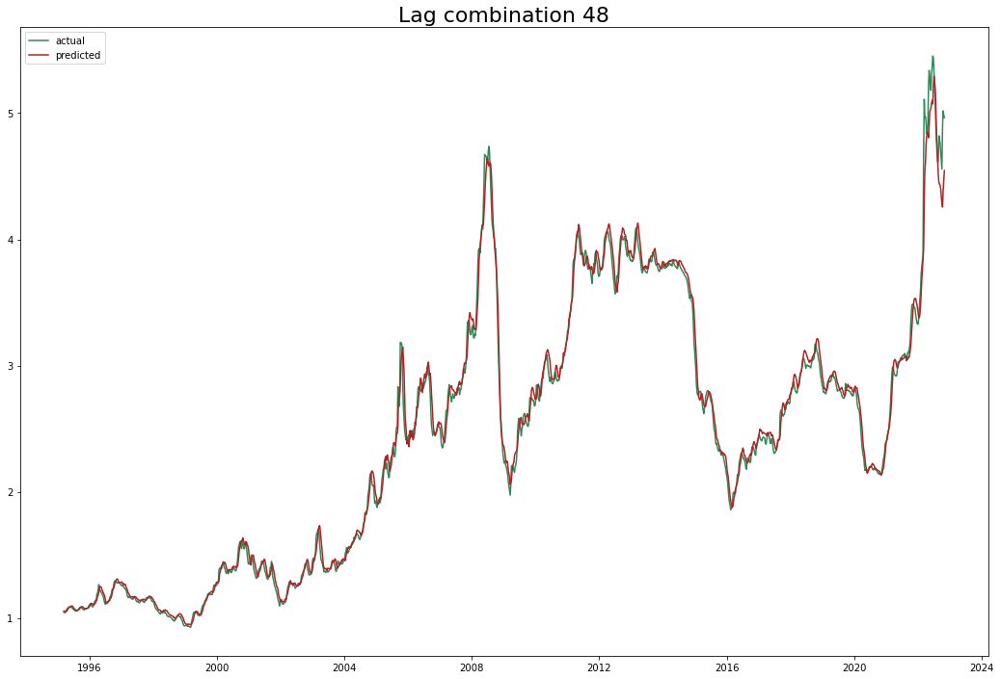

Test data rmse: 0.13709037609194807 Total rmse: 0.08578848301711231
Test data mape: 0.022612142963070566 Total mape: 0.021158658188006666
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.099) neg_root_mean_squared_error: (test=-0.147) r2: (test=0.286) total time=   0.0s
[CV 2/5] END h

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.115) neg_root_mean_squared_error: (test=-0.425) r2: (test=0.594) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.105) r2: (test=0.941) total time=   0.2s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.025) neg_root_mean_squared_error: (test=-0.085) r2: (test=0.985) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.099) neg_root_mean_squared_error: (test=-0.147) r2: (test=0.286) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.070) neg_root_mean_squared_error: (test=-0.205) r2: (test=0.805) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.072) neg_root_mean_squared_error: (test=-0.248) r2: (test=0.862) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.087) r2: (test=0.960) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.066) r2: (test=0.991) total time=   0.4s
{'hidden_layer_sizes': (50, 100, 50), 'max_iter': 5000}


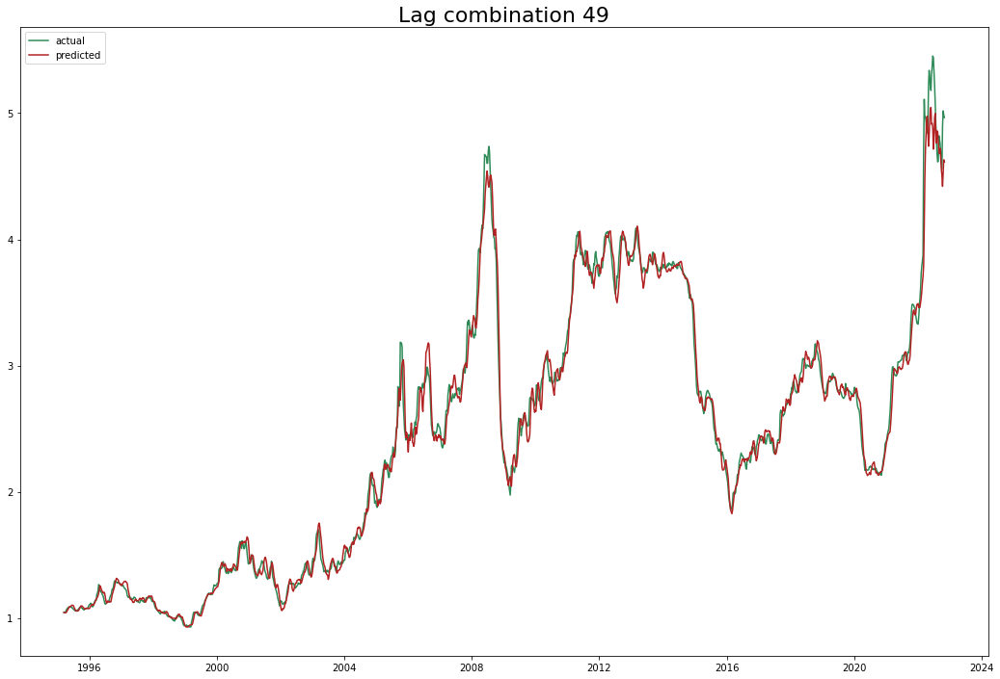

Test data rmse: 0.1534618922316592 Total rmse: 0.10088502570664064
Test data mape: 0.024933250729918574 Total mape: 0.024581354446278326
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag', '51w_lag']
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.094) r2: (test=0.706) total time=   0.0s
[CV 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.213) r2: (test=0.898) total time=   0.1s
[CV 4/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.965) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(64, 64, 64), max_iter=5000; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.077) r2: (test=0.987) total time=   0.3s
[CV 1/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.094) r2: (test=0.706) total time=   0.0s
[CV 2/5] END hidden_layer_sizes=(64, 64, 64), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.147) r2: (test=0.899) total time=   0.0s
[CV 3/5] END hidden_layer_sizes=(64, 64, 64), max_

[CV 3/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.226) r2: (test=0.885) total time=   0.2s
[CV 4/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.023) neg_root_mean_squared_error: (test=-0.105) r2: (test=0.941) total time=   0.3s
[CV 5/5] END hidden_layer_sizes=(50, 100, 50), max_iter=6000; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.992) total time=   0.4s
{'hidden_layer_sizes': (64, 64, 64), 'max_iter': 5000}


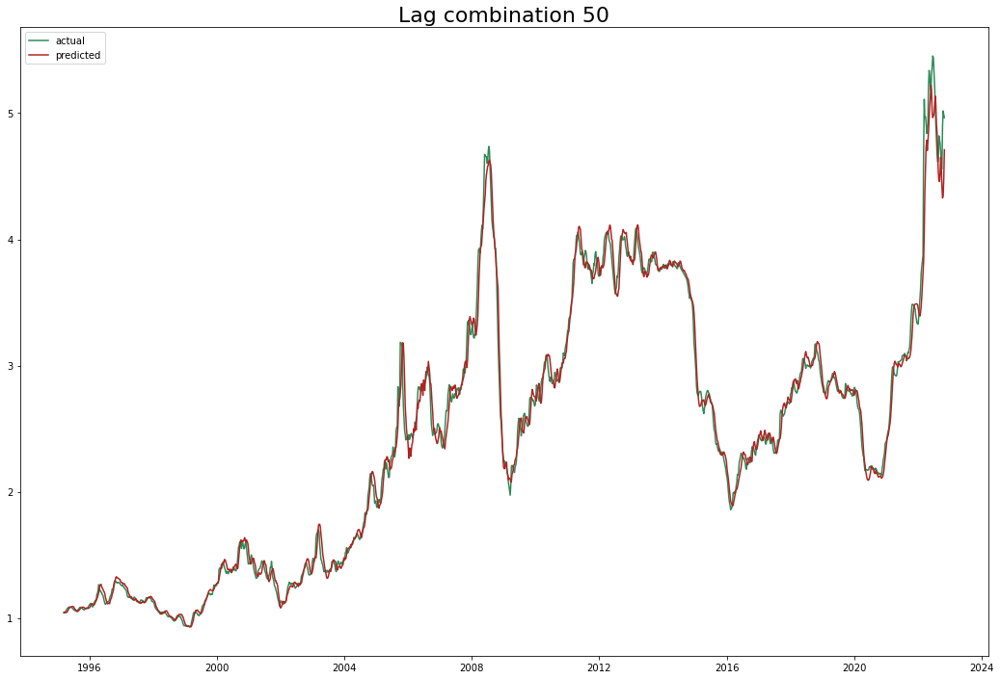

Test data rmse: 0.15132128808483955 Total rmse: 0.0997327191467717
Test data mape: 0.025322595037392724 Total mape: 0.02453810798366045


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


In [767]:

mlp_grid_list,summary_data = test_mdl(df1.columns[3:],mlpr1,parameters,'MLPRegressor')

I have tried a few different approaches towards MLPRegressor and found out that standardized input values result in worse model performance if proper splitting method for TimeSeriesSplit is applied. <br>

### Support Vector Regression

In [768]:
from sklearn.svm import SVR

In [769]:
svr = SVR()

params_svr = {'kernel':['rbf','linear'],'gamma':['scale','auto',0.1],'C':[0.5,1,2,100]}

--------------------------
Next model: 
Lags choosen:  ['1w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.121) neg_root_mean_squared_error: (test=-0.207) r2: (test=-0.412) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.224) neg_root_mean_squared_error: (test=-0.723) r2: (test=-1.422) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.112) neg_root_mean_squared_error: (test=-0.900) r2: (test=-0.828) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.987) total time=   0.0s
[CV 5/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.039) r2: (test=0.997) total time=   0.0s

[CV 1/5] END C=1, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.094) neg_root_mean_squared_error: (test=-0.148) r2: (test=0.276) total time=   0.0s
[CV 2/5] END C=1, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.093) neg_root_mean_squared_error: (test=-0.290) r2: (test=0.609) total time=   0.0s
[CV 3/5] END C=1, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.389) r2: (test=0.659) total time=   0.0s
[CV 4/5] END C=1, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.985) total time=   0.0s
[CV 5/5] END C=1, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.995) total time=   0.0s
[CV 1/5] END C=1, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.089) neg_root_mean_squared_error: (test=-0.140) r2: (test=0.3

[CV 4/5] END C=100, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.988) total time=   0.0s
[CV 5/5] END C=100, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.996) total time=   0.0s
[CV 1/5] END C=100, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.082) neg_root_mean_squared_error: (test=-0.129) r2: (test=0.449) total time=   0.0s
[CV 2/5] END C=100, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.153) r2: (test=0.892) total time=   0.0s
[CV 3/5] END C=100, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.076) r2: (test=0.987) total time=   0.0s
[CV 4/5] END C=100, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: 

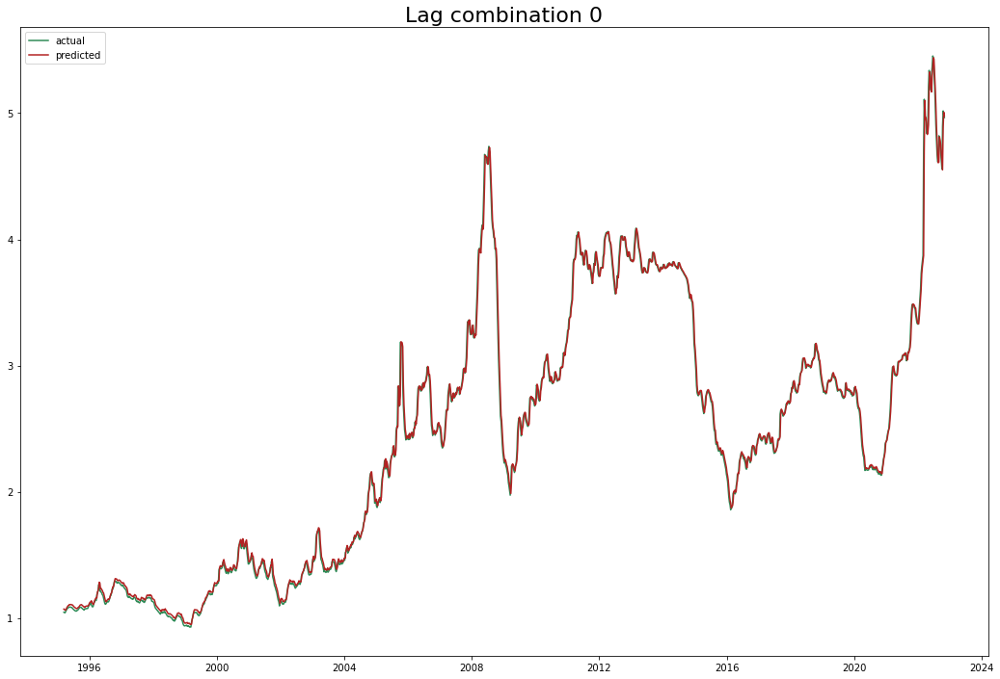

Test data rmse: 0.07550622517950187 Total rmse: 0.053089301292964436
Test data mape: 0.0109392208366959 Total mape: 0.0141579091052493
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.120) neg_root_mean_squared_error: (test=-0.205) r2: (test=-0.390) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.220) neg_root_mean_squared_error: (test=-0.721) r2: (test=-1.408) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.113) neg_root_mean_squared_error: (test=-0.907) r2: (test=-0.857) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.988) total time=   0.0s
[CV 5/5] END C=0.5, gamma=sc

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.995) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.085) neg_root_mean_squared_error: (test=-0.133) r2: (test=0.417) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.169) r2: (test=0.868) total time=   0.0s
[CV 3/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.981) total time=   0.0s
[CV 4/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.039) r2: (test=0.992) total time=   0.0s
[CV 5/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (te

[CV 4/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.991) total time=   0.0s
[CV 5/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.035) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=2, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.498) total time=   0.0s
[CV 2/5] END C=2, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.129) r2: (test=0.923) total time=   0.0s
[CV 3/5] END C=2, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.077) r2: (test=0.986) total time=   0.0s
[CV 4/5] END C=2, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.036) r2: 

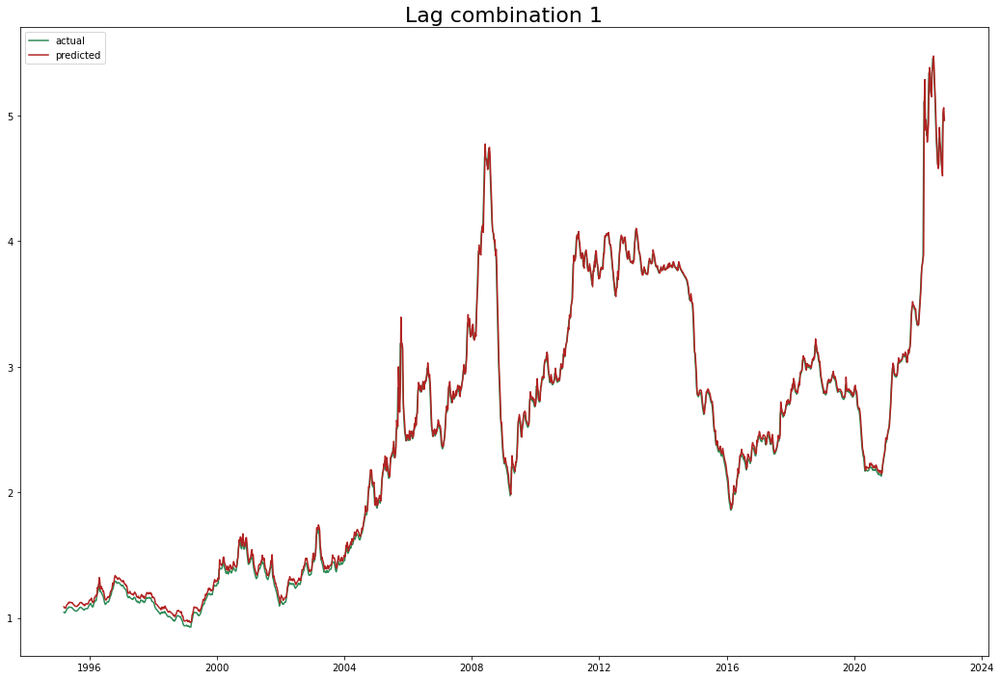

Test data rmse: 0.06939844781711768 Total rmse: 0.050947923307144
Test data mape: 0.010575080595381385 Total mape: 0.0178063395531945
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.121) neg_root_mean_squared_error: (test=-0.206) r2: (test=-0.399) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.219) neg_root_mean_squared_error: (test=-0.718) r2: (test=-1.390) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.119) neg_root_mean_squared_error: (test=-0.909) r2: (test=-0.864) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.988) total time=   0.0s
[CV 5/5] END C=0.5,

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.082) neg_root_mean_squared_error: (test=-0.130) r2: (test=0.445) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.156) r2: (test=0.887) total time=   0.0s
[CV 3/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.025) neg_root_mean_squared_error: (test=-0.103) r2: (test=0.976) total time=   0.0s
[CV 4/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.032) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=1, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.121) neg_root_mean_squared_error: (te

[CV 1/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.083) neg_root_mean_squared_error: (test=-0.132) r2: (test=0.422) total time=   0.0s
[CV 2/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.101) neg_root_mean_squared_error: (test=-0.367) r2: (test=0.377) total time=   0.0s
[CV 3/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.082) neg_root_mean_squared_error: (test=-0.625) r2: (test=0.118) total time=   0.0s
[CV 4/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.996) total time=   0.0s
[CV 1/5] END C=2, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.075) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.5

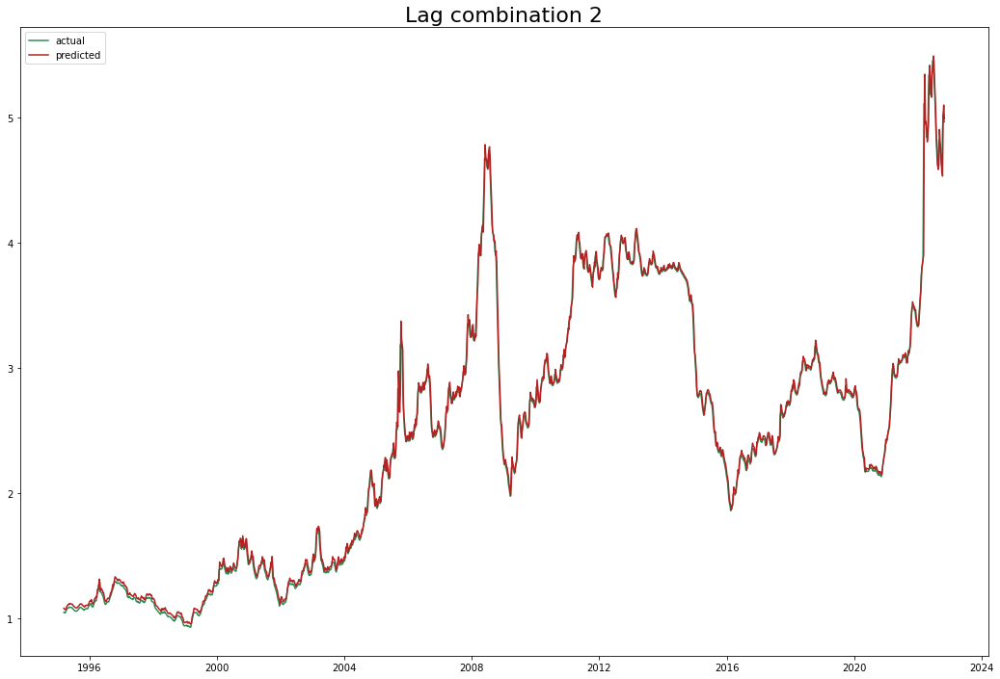

Test data rmse: 0.07045401214953612 Total rmse: 0.04958006124825844
Test data mape: 0.010766443646229322 Total mape: 0.015432045337335437
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.122) neg_root_mean_squared_error: (test=-0.207) r2: (test=-0.417) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.217) neg_root_mean_squared_error: (test=-0.715) r2: (test=-1.367) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.135) neg_root_mean_squared_error: (test=-0.926) r2: (test=-0.932) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.987) total time=   0.0s
[CV 5

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.056) r2: (test=0.983) total time=   0.0s
[CV 5/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.073) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.554) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.128) r2: (test=0.924) total time=   0.0s
[CV 3/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.025) neg_root_mean_squared_error: (test=-0.106) r2: (test=0.975) total time=   0.0s
[CV 4/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=

[CV 3/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.091) r2: (test=0.981) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.038) r2: (test=0.992) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.033) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.078) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.487) total time=   0.0s
[CV 2/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.108) neg_root_mean_squared_error: (test=-0.403) r2: (test=0.248) total time=   0.0s
[CV 3/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.088) neg_root_mean_squared_error: (test=-0.694) r2: 

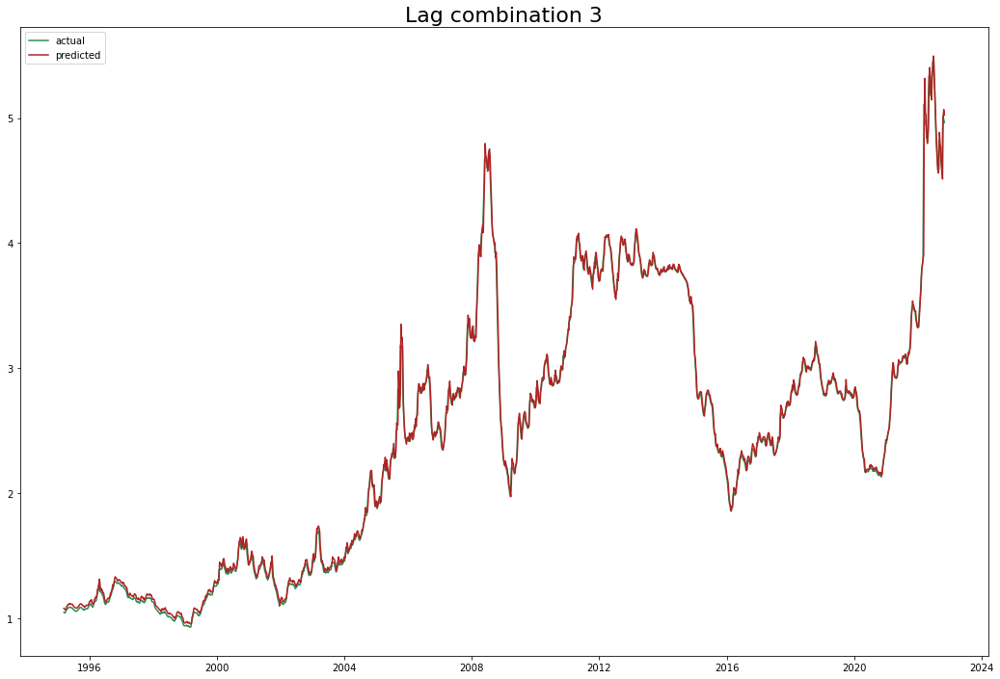

Test data rmse: 0.07043106532925197 Total rmse: 0.04870088887262217
Test data mape: 0.010057700585565677 Total mape: 0.01479465829789876
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.122) neg_root_mean_squared_error: (test=-0.207) r2: (test=-0.412) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.217) neg_root_mean_squared_error: (test=-0.714) r2: (test=-1.364) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.144) neg_root_mean_squared_error: (test=-0.942) r2: (test=-1.003) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.052) r2: (test=0.986) total time=   0

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.976) total time=   0.0s
[CV 5/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.071) neg_root_mean_squared_error: (test=-0.112) r2: (test=0.585) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.926) total time=   0.0s
[CV 3/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squared_error: (test=-0.108) r2: (test=0.973) total time=   0.0s
[CV 4/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=

[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.071) neg_root_mean_squared_error: (test=-0.112) r2: (test=0.585) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.103) r2: (test=0.951) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.025) neg_root_mean_squared_error: (test=-0.101) r2: (test=0.977) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.

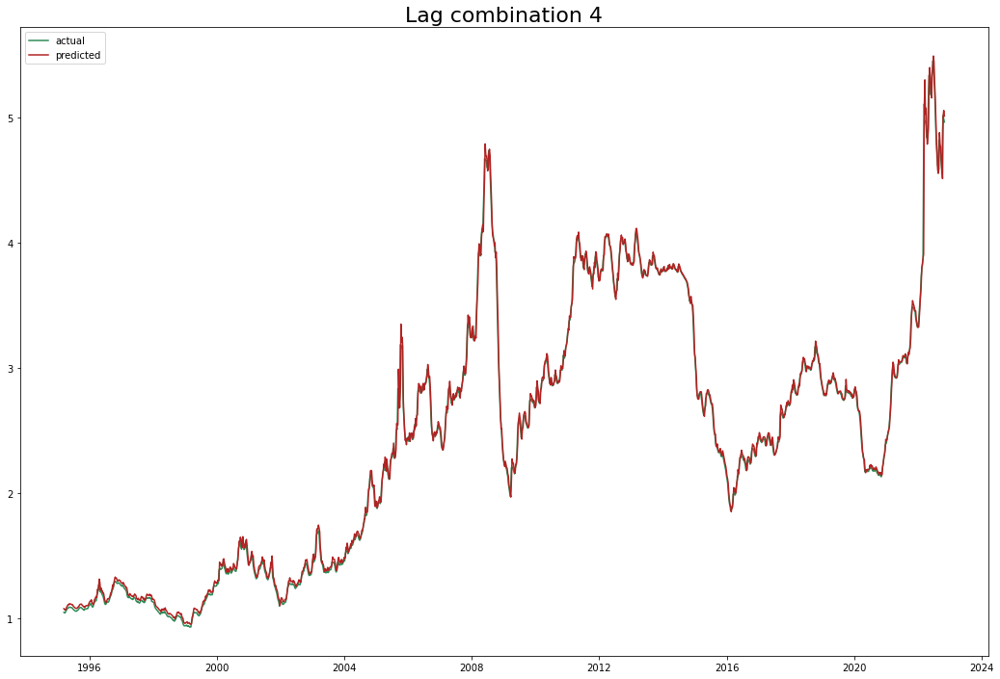

Test data rmse: 0.07012356275622866 Total rmse: 0.048235916863512696
Test data mape: 0.009949648401906395 Total mape: 0.014227203102409627
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.122) neg_root_mean_squared_error: (test=-0.205) r2: (test=-0.392) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.218) neg_root_mean_squared_error: (test=-0.714) r2: (test=-1.362) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.152) neg_root_mean_squared_error: (test=-0.949) r2: (test=-1.029) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.984) tot

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.064) r2: (test=0.978) total time=   0.0s
[CV 5/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.068) neg_root_mean_squared_error: (test=-0.108) r2: (test=0.614) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.926) total time=   0.0s
[CV 3/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squared_error: (test=-0.108) r2: (test=0.974) total time=   0.0s
[CV 4/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=

[CV 5/5] END C=100, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.996) total time=   0.0s
[CV 1/5] END C=100, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.068) neg_root_mean_squared_error: (test=-0.108) r2: (test=0.614) total time=   0.0s
[CV 2/5] END C=100, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.100) r2: (test=0.954) total time=   0.0s
[CV 3/5] END C=100, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.071) r2: (test=0.989) total time=   0.0s
[CV 4/5] END C=100, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END C=100, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_square

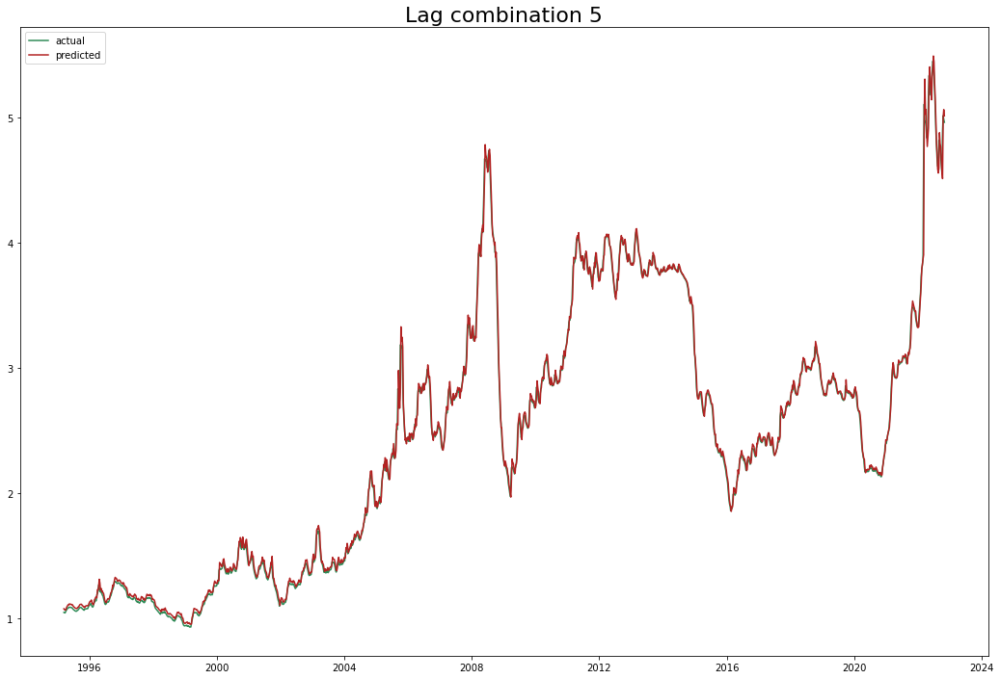

Test data rmse: 0.07040849586202204 Total rmse: 0.048165746422297505
Test data mape: 0.009898268344870346 Total mape: 0.014004170002490655
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.122) neg_root_mean_squared_error: (test=-0.205) r2: (test=-0.387) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.219) neg_root_mean_squared_error: (test=-0.715) r2: (test=-1.372) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.152) neg_root_mean_squared_error: (test=-0.956) r2: (test=-1.063) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.057) r2: (test=

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.081) neg_root_mean_squared_error: (test=-0.131) r2: (test=0.434) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.135) neg_root_mean_squared_error: (test=-0.489) r2: (test=-0.107) total time=   0.0s
[CV 3/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.120) neg_root_mean_squared_error: (test=-0.872) r2: (test=-0.713) total time=   0.0s
[CV 4/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.975) total time=   0.0s
[CV 5/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.995) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.066) neg_root_mean_squared_error: (test=-0.105)

[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.031) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.071) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.564) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.137) neg_root_mean_squared_error: (test=-0.518) r2: (test=-0.246) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.120) neg_root_mean_squared_error: (test=-0.908) r2: (test=-0.859) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.051) r2: (test=0.986) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.045) r2: 

[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.031) r2: (test=0.998) total time=   0.0s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


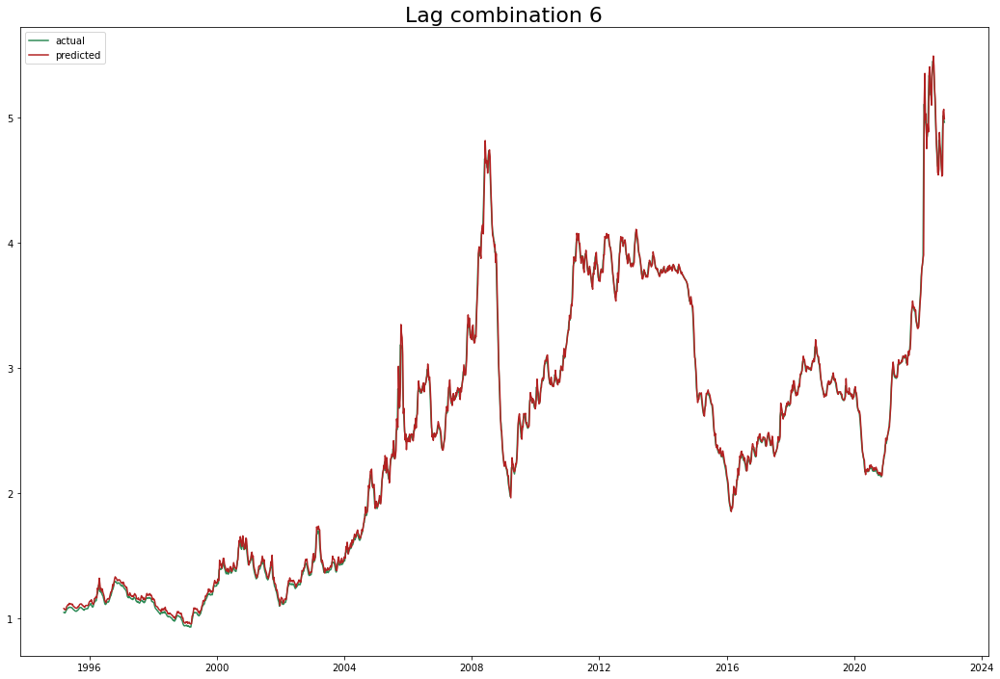

Test data rmse: 0.07031292855026014 Total rmse: 0.04837506589279437
Test data mape: 0.00942144934956467 Total mape: 0.014436908878841906
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.122) neg_root_mean_squared_error: (test=-0.205) r2: (test=-0.385) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.219) neg_root_mean_squared_error: (test=-0.715) r2: (test=-1.371) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.965) r2: (test=-1.101) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.058) r2

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.129) r2: (test=0.452) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.139) neg_root_mean_squared_error: (test=-0.503) r2: (test=-0.172) total time=   0.0s
[CV 3/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.125) neg_root_mean_squared_error: (test=-0.903) r2: (test=-0.839) total time=   0.0s
[CV 4/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.069) r2: (test=0.975) total time=   0.0s
[CV 5/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.101)

[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.031) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.069) neg_root_mean_squared_error: (test=-0.112) r2: (test=0.586) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.131) neg_root_mean_squared_error: (test=-0.500) r2: (test=-0.160) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.125) neg_root_mean_squared_error: (test=-0.927) r2: (test=-0.940) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.985) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.045) r2: 

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.030) r2: (test=0.998) total time=   0.1s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


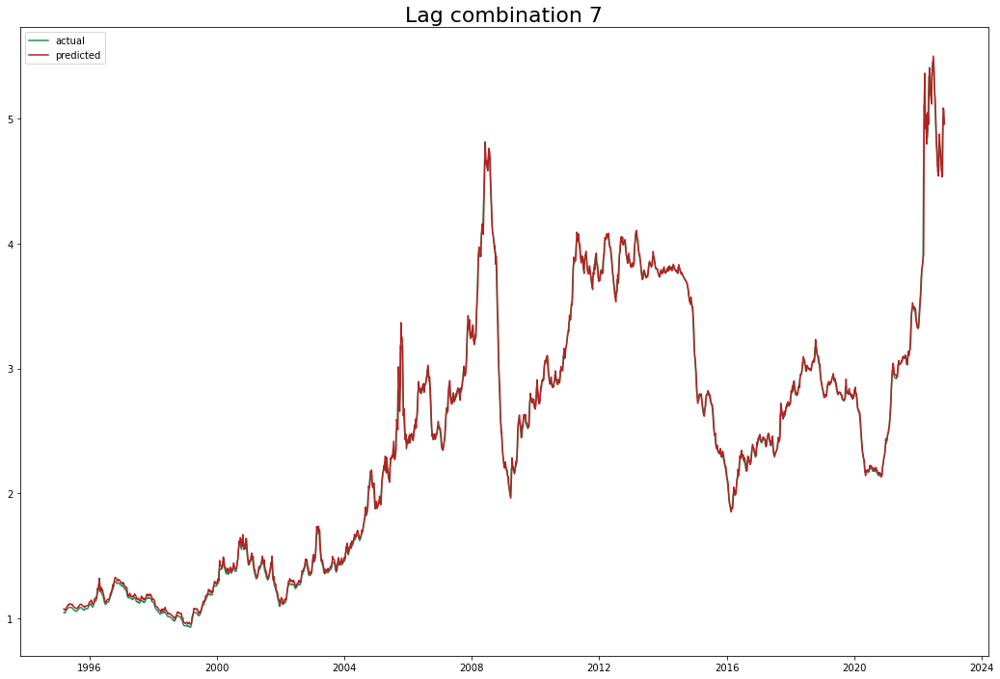

Test data rmse: 0.06946753855932383 Total rmse: 0.04802318242815363
Test data mape: 0.009510966797623007 Total mape: 0.014108308086879701
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.122) neg_root_mean_squared_error: (test=-0.205) r2: (test=-0.382) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.217) neg_root_mean_squared_error: (test=-0.713) r2: (test=-1.360) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.149) neg_root_mean_squared_error: (test=-0.968) r2: (test=-1.112) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.031) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.077) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.489) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.141) neg_root_mean_squared_error: (test=-0.513) r2: (test=-0.220) total time=   0.0s
[CV 3/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.129) neg_root_mean_squared_error: (test=-0.925) r2: (test=-0.929) total time=   0.0s
[CV 4/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.072) r2: (test=0.973) total time=   0.0s
[CV 5/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.051

[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.031) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.067) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.607) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.134) neg_root_mean_squared_error: (test=-0.508) r2: (test=-0.197) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.130) neg_root_mean_squared_error: (test=-0.952) r2: (test=-1.046) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.984) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.046) r2: 

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.029) r2: (test=0.998) total time=   0.1s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


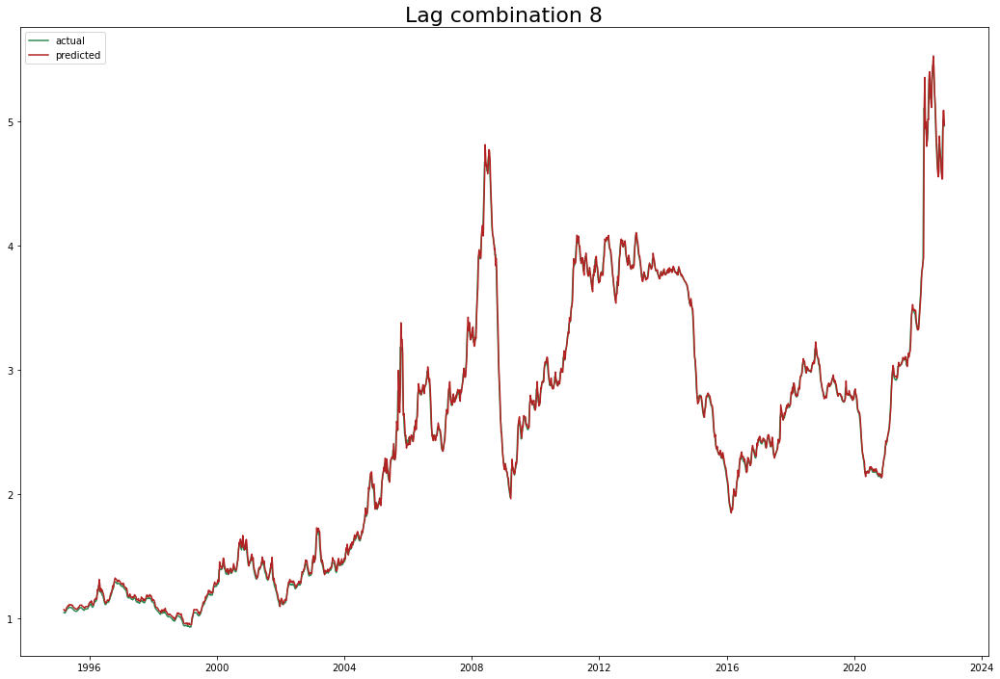

Test data rmse: 0.06869830682742757 Total rmse: 0.04695947847872838
Test data mape: 0.009221259334432678 Total mape: 0.012865136535573418
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.122) neg_root_mean_squared_error: (test=-0.205) r2: (test=-0.383) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.216) neg_root_mean_squared_error: (test=-0.712) r2: (test=-1.347) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.150) neg_root_mean_squared_error: (test=-0.972) r2: (test=-1.132) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_e

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.076) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.501) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.145) neg_root_mean_squared_error: (test=-0.528) r2: (test=-0.294) total time=   0.0s
[CV 3/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.134) neg_root_mean_squared_error: (test=-0.945) r2: (test=-1.014) total time=   0.0s
[CV 4/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.075) r2: (test=0.970) total time=   0.0s
[CV 5/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.994) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.095)

[CV 4/5] END C=2, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.039) r2: (test=0.992) total time=   0.0s
[CV 5/5] END C=2, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.031) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=100, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.122) neg_root_mean_squared_error: (test=-0.205) r2: (test=-0.383) total time=   0.0s
[CV 2/5] END C=100, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.216) neg_root_mean_squared_error: (test=-0.712) r2: (test=-1.347) total time=   0.0s
[CV 3/5] END C=100, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.949) r2: (test=-1.029) total time=   0.0s
[CV 4/5] END C=100, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test

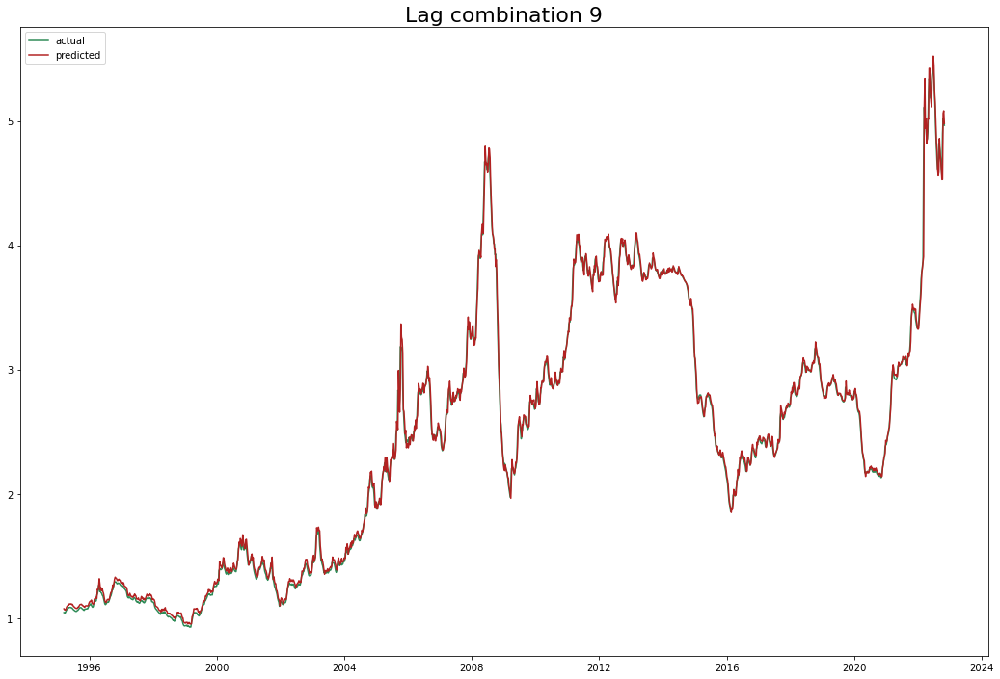

Test data rmse: 0.06926398861638067 Total rmse: 0.0483241398222401
Test data mape: 0.009645813676815251 Total mape: 0.014477392151410686
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.123) neg_root_mean_squared_error: (test=-0.205) r2: (test=-0.387) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.215) neg_root_mean_squared_error: (test=-0.711) r2: (test=-1.346) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.152) neg_root_mean_squared_error: (test=-0.979) r2: (test=-1.161) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.076) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.509) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.537) r2: (test=-0.336) total time=   0.0s
[CV 3/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.138) neg_root_mean_squared_error: (test=-0.958) r2: (test=-1.069) total time=   0.0s
[CV 4/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.084) r2: (test=0.963) total time=   0.0s
[CV 5/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.994) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.093)

[CV 3/5] END C=2, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.981) total time=   0.0s
[CV 4/5] END C=2, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.039) r2: (test=0.992) total time=   0.0s
[CV 5/5] END C=2, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.030) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=100, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.123) neg_root_mean_squared_error: (test=-0.205) r2: (test=-0.387) total time=   0.0s
[CV 2/5] END C=100, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.215) neg_root_mean_squared_error: (test=-0.711) r2: (test=-1.346) total time=   0.0s
[CV 3/5] END C=100, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.155) neg_root_mean_squared_error: (test=-

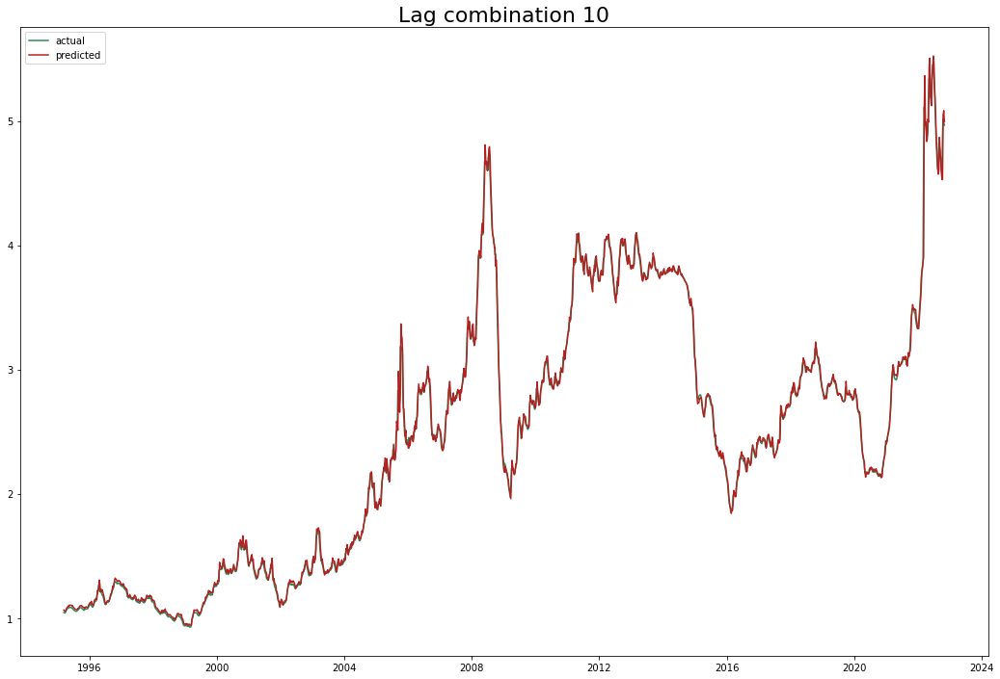

Test data rmse: 0.07056948094672072 Total rmse: 0.04751341221870846
Test data mape: 0.009522132393866444 Total mape: 0.012270929973154295
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.123) neg_root_mean_squared_error: (test=-0.205) r2: (test=-0.390) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.216) neg_root_mean_squared_error: (test=-0.713) r2: (test=-1.357) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.155) neg_root_mean_squared_error: (test=-0.983) r2: (test=-1.180) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.023) n

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.032) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.075) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.518) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.550) r2: (test=-0.404) total time=   0.0s
[CV 3/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.141) neg_root_mean_squared_error: (test=-0.970) r2: (test=-1.121) total time=   0.0s
[CV 4/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.932) total time=   0.0s
[CV 5/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.054

[CV 1/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.106) r2: (test=0.630) total time=   0.0s
[CV 2/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.142) neg_root_mean_squared_error: (test=-0.534) r2: (test=-0.321) total time=   0.0s
[CV 3/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.140) neg_root_mean_squared_error: (test=-0.976) r2: (test=-1.148) total time=   0.0s
[CV 4/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.086) r2: (test=0.960) total time=   0.0s
[CV 5/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.0s
[CV 1/5] END C=2, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.092) r2: (test=0

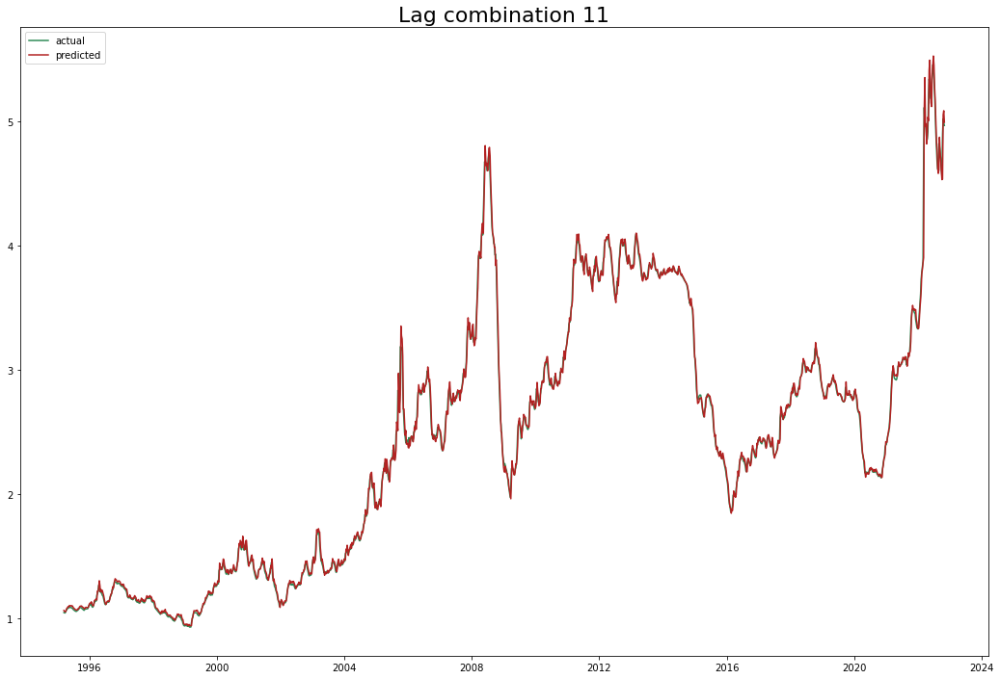

Test data rmse: 0.07020052561555597 Total rmse: 0.047134758792057196
Test data mape: 0.00947916299009423 Total mape: 0.011645863681163852
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.123) neg_root_mean_squared_error: (test=-0.206) r2: (test=-0.397) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.217) neg_root_mean_squared_error: (test=-0.715) r2: (test=-1.373) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.158) neg_root_mean_squared_error: (test=-0.986) r2: (test=-1.194) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (tes

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.032) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.531) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.155) neg_root_mean_squared_error: (test=-0.564) r2: (test=-0.476) total time=   0.0s
[CV 3/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.145) neg_root_mean_squared_error: (test=-0.980) r2: (test=-1.167) total time=   0.0s
[CV 4/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.919) total time=   0.0s
[CV 5/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.055

[CV 1/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.105) r2: (test=0.636) total time=   0.0s
[CV 2/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.144) neg_root_mean_squared_error: (test=-0.543) r2: (test=-0.365) total time=   0.0s
[CV 3/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.142) neg_root_mean_squared_error: (test=-0.977) r2: (test=-1.152) total time=   0.0s
[CV 4/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.132) r2: (test=0.907) total time=   0.0s
[CV 5/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.051) r2: (test=0.994) total time=   0.0s
[CV 1/5] END C=2, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.090) r2: (test=0

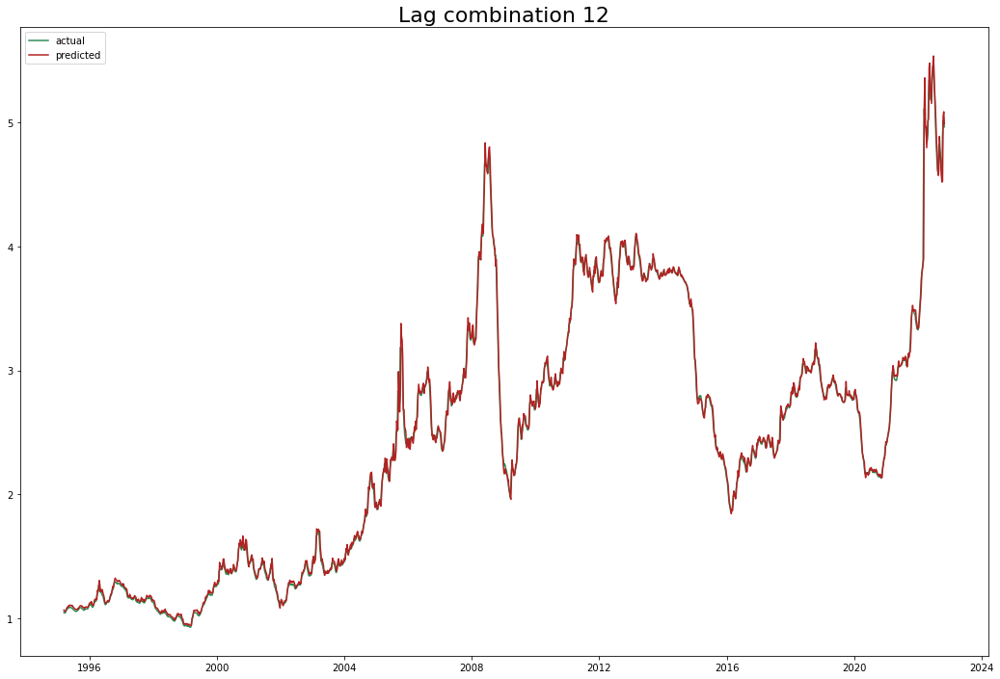

Test data rmse: 0.07016952149719051 Total rmse: 0.04765218763379308
Test data mape: 0.0096409302863503 Total mape: 0.012469136658304084
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.124) neg_root_mean_squared_error: (test=-0.206) r2: (test=-0.403) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.218) neg_root_mean_squared_error: (test=-0.718) r2: (test=-1.388) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.160) neg_root_mean_squared_error: (test=-0.989) r2: (test=-1.205) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_er

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.111) r2: (test=0.972) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.032) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.531) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.159) neg_root_mean_squared_error: (test=-0.576) r2: (test=-0.537) total time=   0.0s
[CV 3/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test

[CV 5/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.030) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.104) r2: (test=0.640) total time=   0.0s
[CV 2/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.553) r2: (test=-0.417) total time=   0.0s
[CV 3/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.143) neg_root_mean_squared_error: (test=-0.979) r2: (test=-1.161) total time=   0.0s
[CV 4/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.172) r2: (test=0.843) total time=   0.0s
[CV 5/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.054) r2: (test=

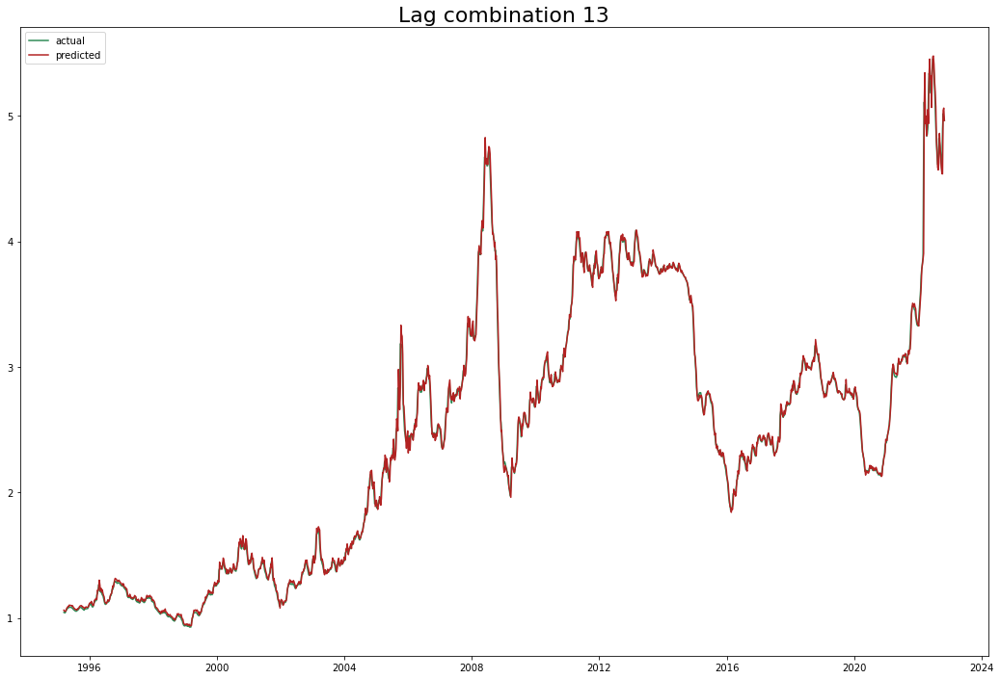

Test data rmse: 0.07125853782276721 Total rmse: 0.04765013024306383
Test data mape: 0.009675933236880868 Total mape: 0.01191663032813183
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.124) neg_root_mean_squared_error: (test=-0.207) r2: (test=-0.409) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.219) neg_root_mean_squared_error: (test=-0.720) r2: (test=-1.403) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.162) neg_root_mean_squared_error: (test=-0.991) r2: (test=-1.216) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_p

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.928) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.971) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.032) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.532) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.162) neg_root_mean_squared_error: (t

[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.055) r2: (test=0.994) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.054) neg_root_mean_squared_error: (test=-0.087) r2: (test=0.750) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.111) r2: (test=0.943) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.023) neg_root_mean_squared_error: (test=-0.094) r2: (test=0.980) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.038) r2: (test=0.992) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.

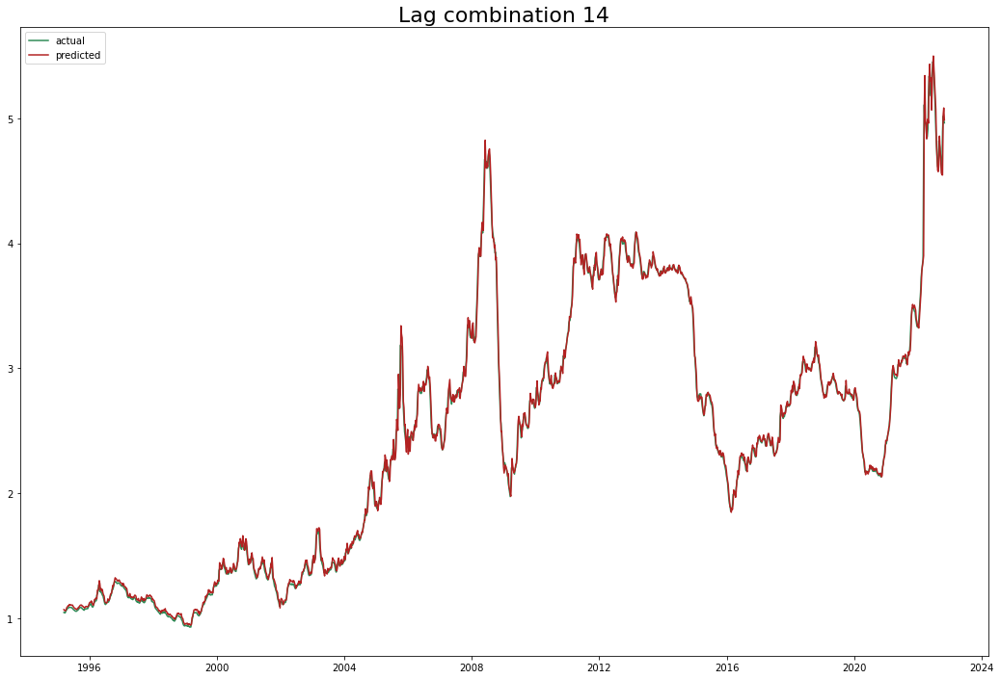

Test data rmse: 0.07159184954484993 Total rmse: 0.048654549560185875
Test data mape: 0.010046876699285178 Total mape: 0.013172299513969771
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.125) neg_root_mean_squared_error: (test=-0.207) r2: (test=-0.418) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.221) neg_root_mean_squared_error: (test=-0.722) r2: (test=-1.417) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.996) r2: (test=-1.237) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rbf; neg_me

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.928) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.029) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.967) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.031) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.533) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (t

[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.053) neg_root_mean_squared_error: (test=-0.086) r2: (test=0.757) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.035) neg_root_mean_squared_error: (test=-0.110) r2: (test=0.944) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.110) r2: (test=0.973) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.039) r2: (test=0.992) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.030) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=2, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.1

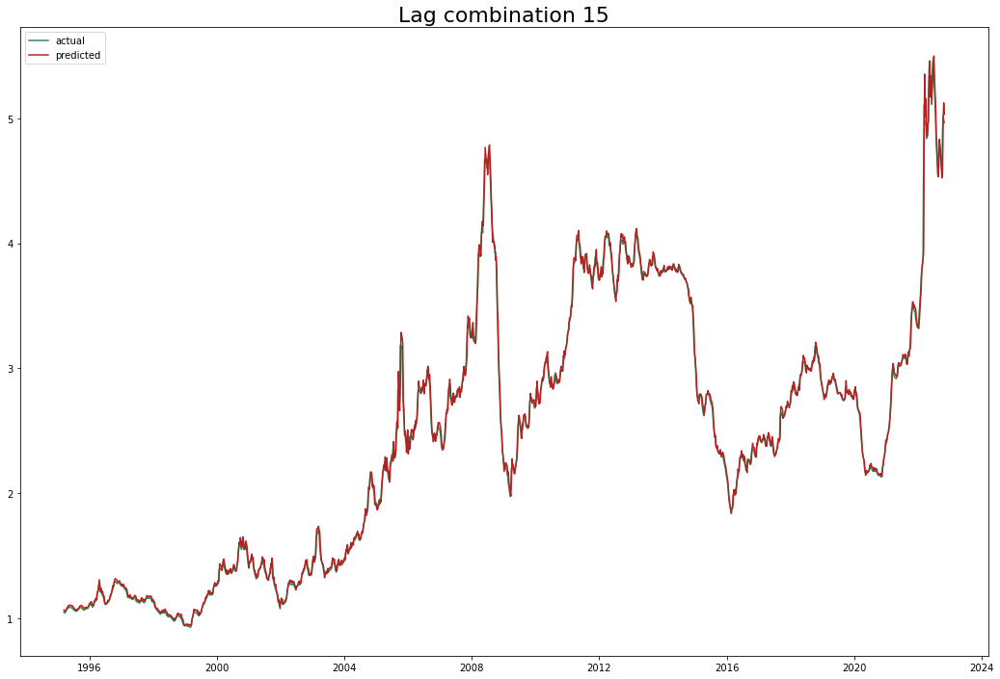

Test data rmse: 0.07299629720465874 Total rmse: 0.049306609787130265
Test data mape: 0.0105079870811395 Total mape: 0.012766992758514275
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.125) neg_root_mean_squared_error: (test=-0.208) r2: (test=-0.425) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.222) neg_root_mean_squared_error: (test=-0.724) r2: (test=-1.429) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.166) neg_root_mean_squared_error: (test=-0.998) r2: (test=-1.246) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale, kernel=rb

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.053) neg_root_mean_squared_error: (test=-0.085) r2: (test=0.763) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.926) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.965) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.032) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error

[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.205) r2: (test=0.777) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.993) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.053) neg_root_mean_squared_error: (test=-0.085) r2: (test=0.763) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.035) neg_root_mean_squared_error: (test=-0.110) r2: (test=0.944) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.112) r2: (test=0.972) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.039

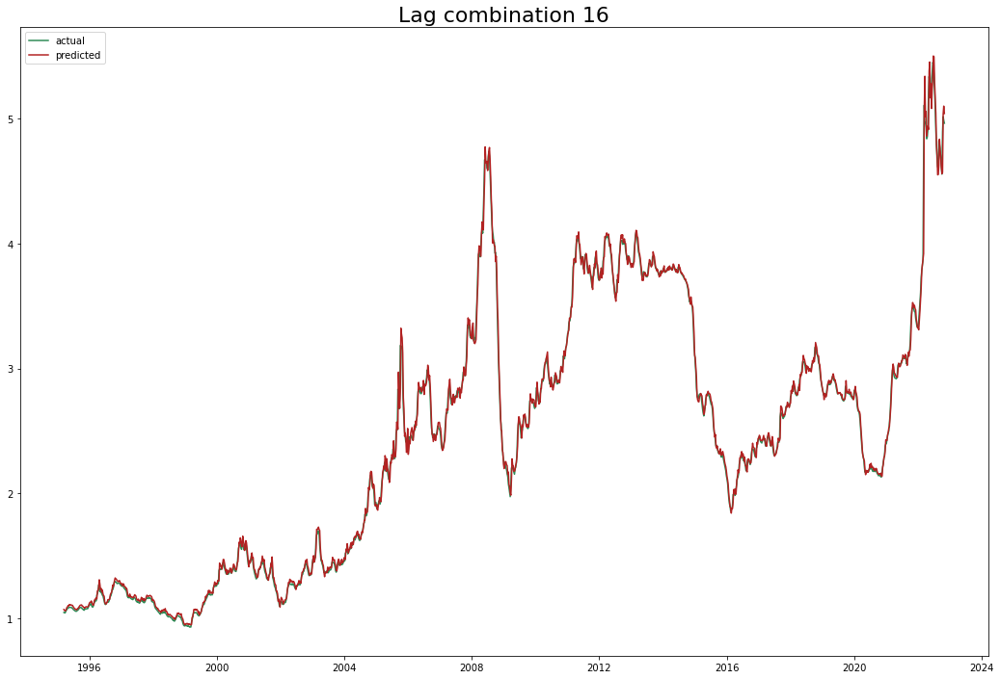

Test data rmse: 0.071943005211529 Total rmse: 0.048844123584760535
Test data mape: 0.010322475355487908 Total mape: 0.013260998818265134
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.125) neg_root_mean_squared_error: (test=-0.208) r2: (test=-0.428) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.223) neg_root_mean_squared_error: (test=-0.725) r2: (test=-1.434) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.167) neg_root_mean_squared_error: (test=-1.001) r2: (test=-1.260) total time=   0.0s
[CV 4/5] END C=0.5, gamma=scale

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.927) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.964) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.032) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.529) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (t

[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.096) r2: (test=0.693) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.128) neg_root_mean_squared_error: (test=-0.484) r2: (test=-0.084) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.141) neg_root_mean_squared_error: (test=-0.965) r2: (test=-1.101) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.044) neg_root_mean_squared_error: (test=-0.211) r2: (test=0.763) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.993) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.053) neg_root_mean_squared_error: (test=-0.085) r2: (

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.040) r2: (test=0.992) total time=   0.5s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.031) r2: (test=0.998) total time=   0.6s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


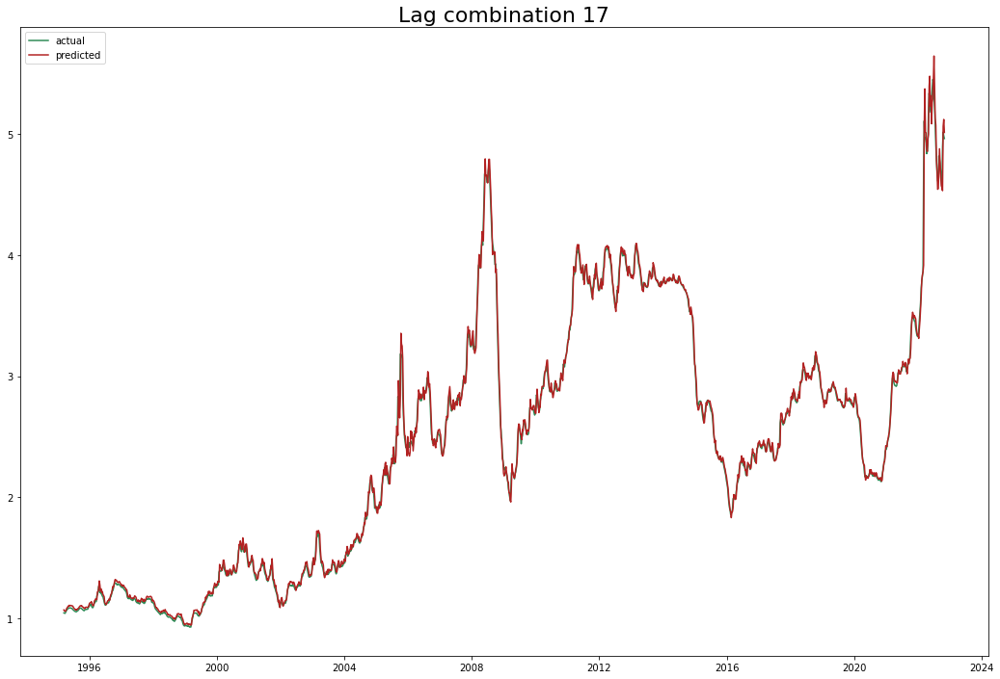

Test data rmse: 0.07453853840430172 Total rmse: 0.05007405445120416
Test data mape: 0.010604968736523937 Total mape: 0.013610317654351394
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.126) neg_root_mean_squared_error: (test=-0.209) r2: (test=-0.434) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.223) neg_root_mean_squared_error: (test=-0.724) r2: (test=-1.434) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.170) neg_root_mean_squared_error: (test=-1.009) r2: (test=-1.296) total time=   0.0s
[CV 4/5] END C=0.5,

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.928) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.964) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.031) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.075) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.525) total time=   0.0s
[CV 2/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.177) neg_root_mean_squared_error: (t

[CV 2/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.035) neg_root_mean_squared_error: (test=-0.110) r2: (test=0.944) total time=   0.5s
[CV 3/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.971) total time=   0.0s
[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.039) r2: (test=0.992) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.029) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.098) r2: (test=0.685) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.128) neg_root_mean_squared_error: (test=-0

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.991) total time=   0.4s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.029) r2: (test=0.998) total time=   0.5s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


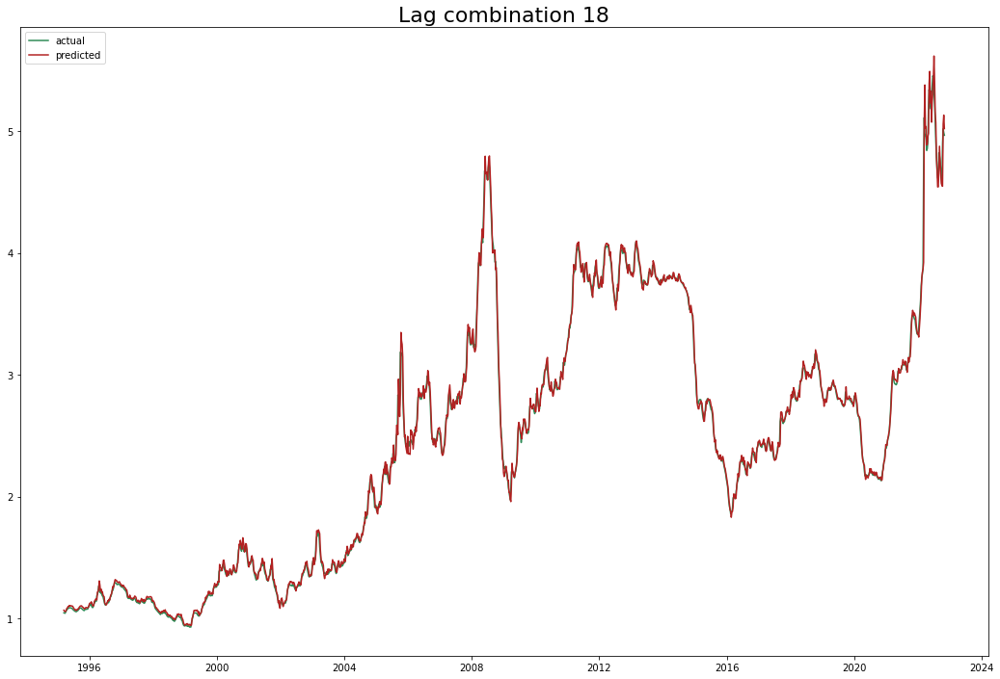

Test data rmse: 0.07494231584475033 Total rmse: 0.04995296520700339
Test data mape: 0.010623367118690205 Total mape: 0.012968966976870536
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.126) neg_root_mean_squared_error: (test=-0.209) r2: (test=-0.438) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.223) neg_root_mean_squared_error: (test=-0.725) r2: (test=-1.435) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.172) neg_root_mean_squared_error: (test=-1.012) r2: (test=-1.311) total time=   0.0s
[CV 4/5]

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.053) neg_root_mean_squared_error: (test=-0.084) r2: (test=0.769) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.927) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.129) r2: (test=0.962) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.031) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.075) neg_root_mean_squared_error

[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.030) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.098) r2: (test=0.683) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.129) neg_root_mean_squared_error: (test=-0.484) r2: (test=-0.084) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.144) neg_root_mean_squared_error: (test=-0.966) r2: (test=-1.105) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.048) neg_root_mean_squared_error: (test=-0.228) r2: (test=0.722) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.064) r2: 

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.991) total time=   0.4s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.030) r2: (test=0.998) total time=   0.8s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


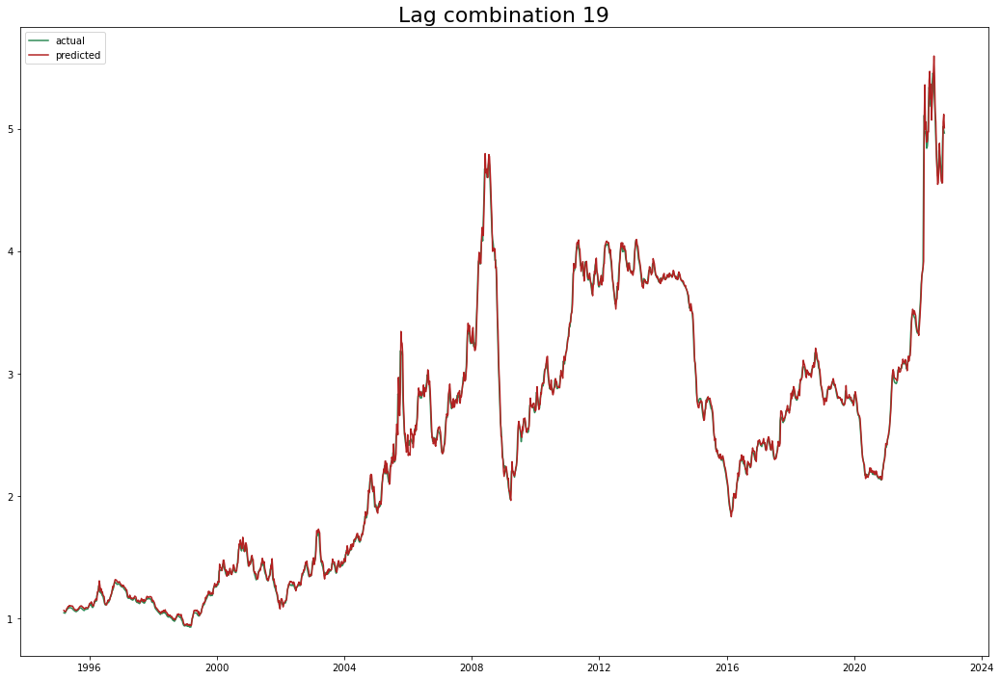

Test data rmse: 0.07457066989708774 Total rmse: 0.049811011551860816
Test data mape: 0.010708047595186114 Total mape: 0.0128106510771708
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.126) neg_root_mean_squared_error: (test=-0.209) r2: (test=-0.439) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.223) neg_root_mean_squared_error: (test=-0.725) r2: (test=-1.438) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-1.015) r2: (test=-1.323) total time=   0.0

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.083) r2: (test=0.773) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.926) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.150) r2: (test=0.949) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.033) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.076) neg_root_mean_squared_error

[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.991) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.032) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.099) r2: (test=0.679) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.130) neg_root_mean_squared_error: (test=-0.486) r2: (test=-0.097) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.145) neg_root_mean_squared_error: (test=-0.969) r2: (test=-1.116) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.047) neg_root_mean_squared_error: (test=-0.223) 

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.6s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.034) r2: (test=0.998) total time=   0.9s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


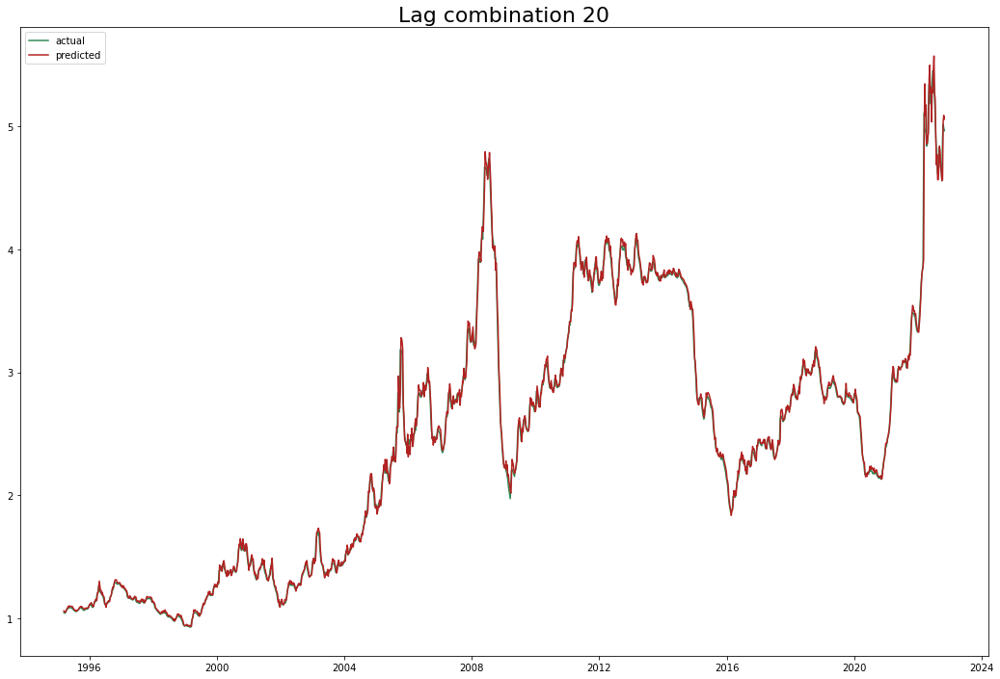

Test data rmse: 0.075328372760478 Total rmse: 0.05035069827181804
Test data mape: 0.011231733128785261 Total mape: 0.012585119967421428
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.126) neg_root_mean_squared_error: (test=-0.209) r2: (test=-0.438) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.224) neg_root_mean_squared_error: (test=-0.726) r2: (test=-1.444) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.174) neg_root_mean_squared_error: (test=-1.018) r2: (test=-1.338) total t

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.082) r2: (test=0.776) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.925) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.038) neg_root_mean_squared_error: (test=-0.154) r2: (test=0.947) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.033) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.077) neg_root_mean_squared_error

[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.991) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.032) r2: (test=0.998) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.100) r2: (test=0.673) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.131) neg_root_mean_squared_error: (test=-0.490) r2: (test=-0.113) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.145) neg_root_mean_squared_error: (test=-0.968) r2: (test=-1.113) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.045) neg_root_mean_squared_error: (test=-0.220) 

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.4s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.034) r2: (test=0.998) total time=   0.7s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


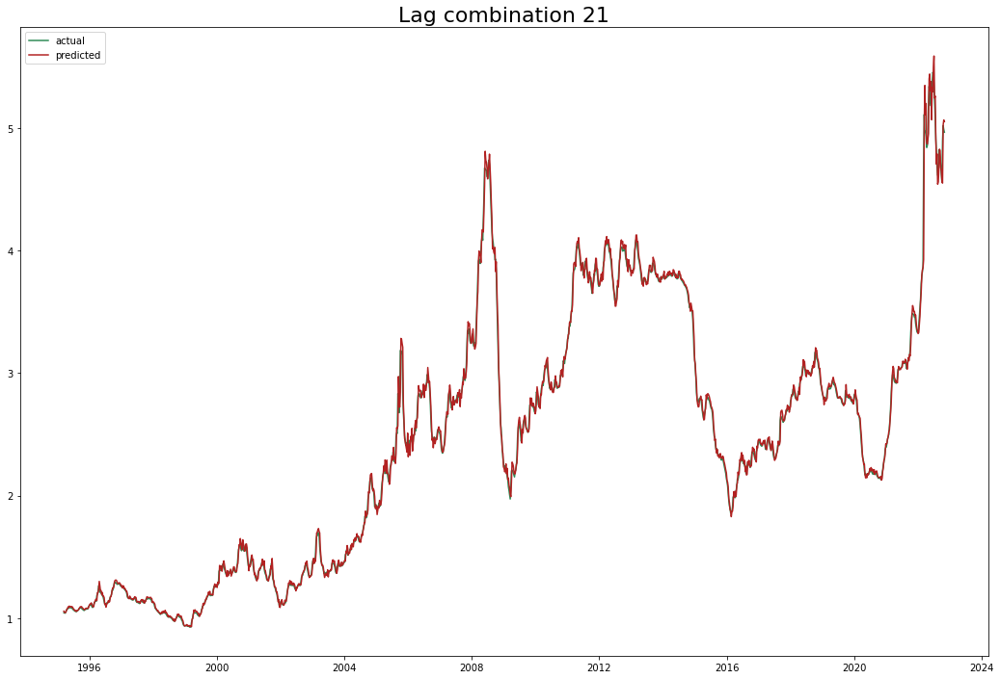

Test data rmse: 0.07548805857830539 Total rmse: 0.050121914022909914
Test data mape: 0.010879726004645861 Total mape: 0.012127518183717026
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.126) neg_root_mean_squared_error: (test=-0.209) r2: (test=-0.436) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.225) neg_root_mean_squared_error: (test=-0.728) r2: (test=-1.455) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.177) neg_root_mean_squared_error: (test=-1.023) r2: (test=-

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.082) r2: (test=0.780) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.042) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.925) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.149) r2: (test=0.950) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.036) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.078) neg_root_mean_squared_error

[CV 3/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.035) neg_root_mean_squared_error: (test=-0.142) r2: (test=0.955) total time=   0.0s
[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.101) r2: (test=0.662) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.132) neg_root_mean_squared_error: (test=-0.491) r2: (test=-0.117) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.142) neg_root_mean_squared_error: (test=-0.96

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   1.0s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.035) r2: (test=0.997) total time=   0.7s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


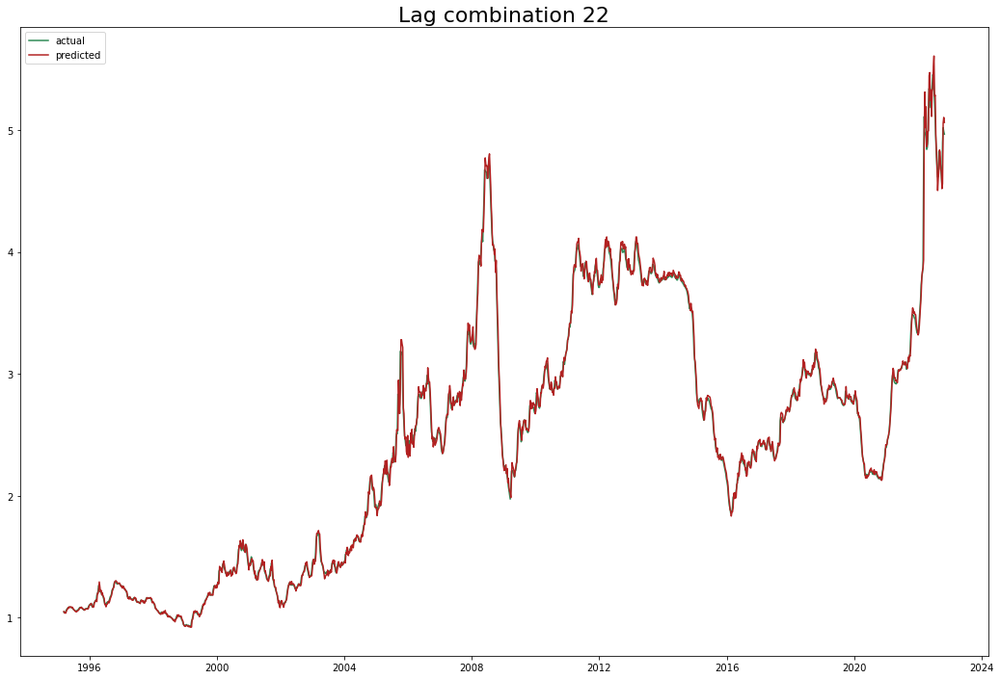

Test data rmse: 0.07351115193533878 Total rmse: 0.04950805292901856
Test data mape: 0.010752455394109755 Total mape: 0.01175974302131918
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.126) neg_root_mean_squared_error: (test=-0.208) r2: (test=-0.432) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.226) neg_root_mean_squared_error: (test=-0.729) r2: (test=-1.464) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.178) neg_root_mean_squared_error: (test=-1.024) r2

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.782) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.925) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.148) r2: (test=0.950) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.038) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error

[CV 5/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.075) r2: (test=0.988) total time=   0.0s
[CV 1/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.782) total time=   0.0s
[CV 2/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.112) r2: (test=0.942) total time=   0.0s
[CV 3/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.034) neg_root_mean_squared_error: (test=-0.138) r2: (test=0.957) total time=   0.0s
[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (te

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.8s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.035) r2: (test=0.997) total time=   0.9s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


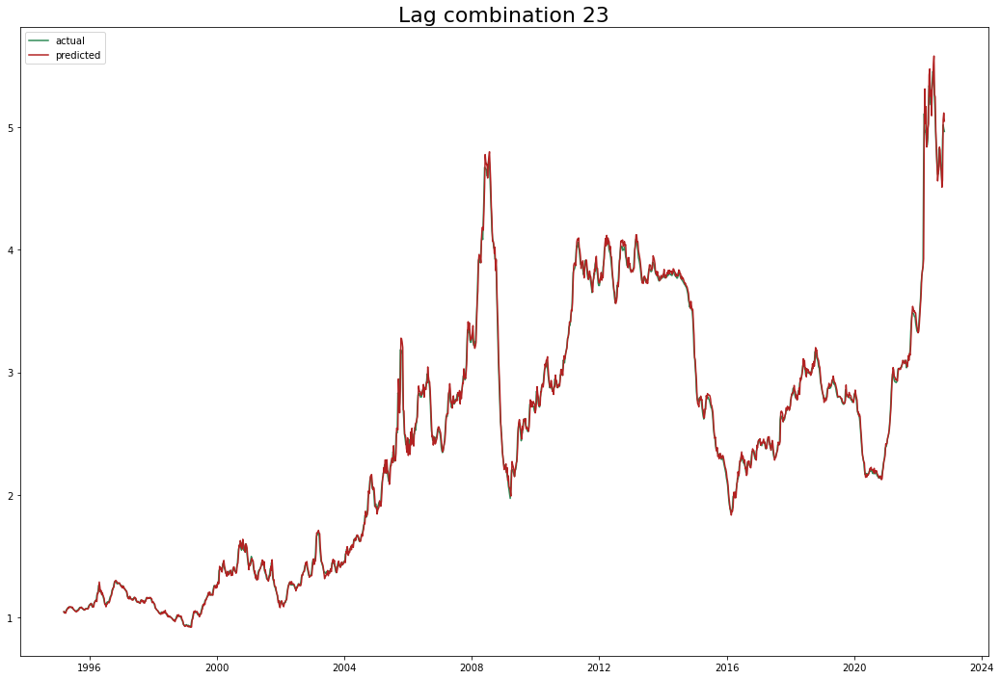

Test data rmse: 0.07208882101681077 Total rmse: 0.04897942730388483
Test data mape: 0.010649794072573255 Total mape: 0.011708368219330635
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.126) neg_root_mean_squared_error: (test=-0.208) r2: (test=-0.426) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.227) neg_root_mean_squared_error: (test=-0.730) r2: (test=-1.472) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.177) neg_root_mean_squared_error: (tes

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.087) r2: (test=0.984) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.784) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.929) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.149) r2: (test=0.950) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_erro

[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.025) neg_root_mean_squared_error: (test=-0.077) r2: (test=0.987) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.784) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.939) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.136) r2: (test=0.958) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.

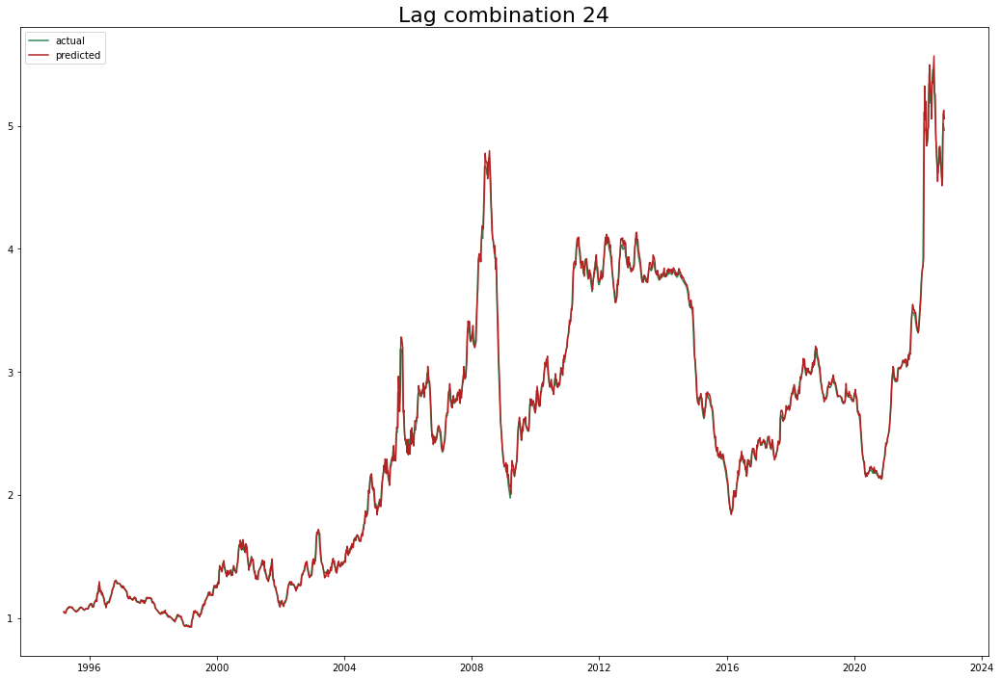

Test data rmse: 0.07329612106598901 Total rmse: 0.04967564569161934
Test data mape: 0.01085616105569627 Total mape: 0.011907101063924347
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.126) neg_root_mean_squared_error: (test=-0.207) r2: (test=-0.420) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.227) neg_root_mean_squared_error: (test=-0.731) r2: (test=-1.478) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.177) neg_root_mean_squared_e

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.080) r2: (test=0.787) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.040) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.930) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.151) r2: (test=0.948) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.038) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error

[CV 5/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.025) neg_root_mean_squared_error: (test=-0.078) r2: (test=0.987) total time=   0.0s
[CV 1/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.080) r2: (test=0.787) total time=   0.0s
[CV 2/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.038) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.938) total time=   0.0s
[CV 3/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.034) neg_root_mean_squared_error: (test=-0.138) r2: (test=0.957) total time=   0.0s
[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (te

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.8s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.036) r2: (test=0.997) total time=   0.8s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


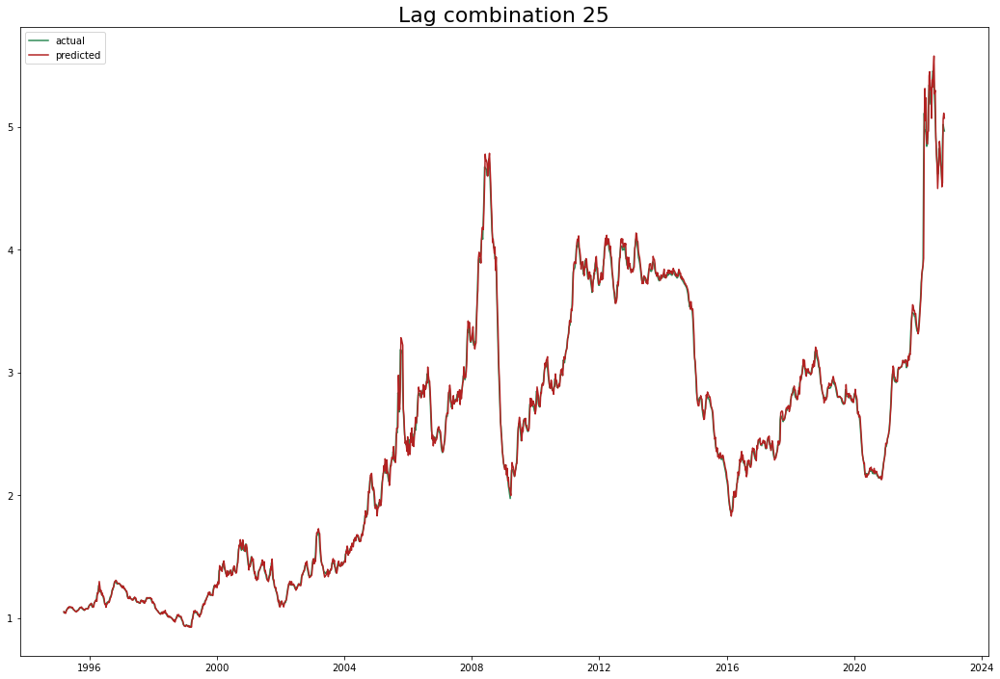

Test data rmse: 0.07445409768876499 Total rmse: 0.04963297333223873
Test data mape: 0.010754356863134303 Total mape: 0.011717320537992964
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.126) neg_root_mean_squared_error: (test=-0.208) r2: (test=-0.420) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.227) neg_root_mean_squared_error: (test=-0.732) r2: (test=-1.483) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.177) neg_root_me

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.785) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.040) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.932) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.151) r2: (test=0.949) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.038) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error

[CV 5/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squared_error: (test=-0.080) r2: (test=0.987) total time=   0.0s
[CV 1/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.785) total time=   0.0s
[CV 2/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.038) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.938) total time=   0.0s
[CV 3/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.034) neg_root_mean_squared_error: (test=-0.137) r2: (test=0.958) total time=   0.0s
[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (te

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.988) total time=   1.2s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.038) r2: (test=0.997) total time=   0.9s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


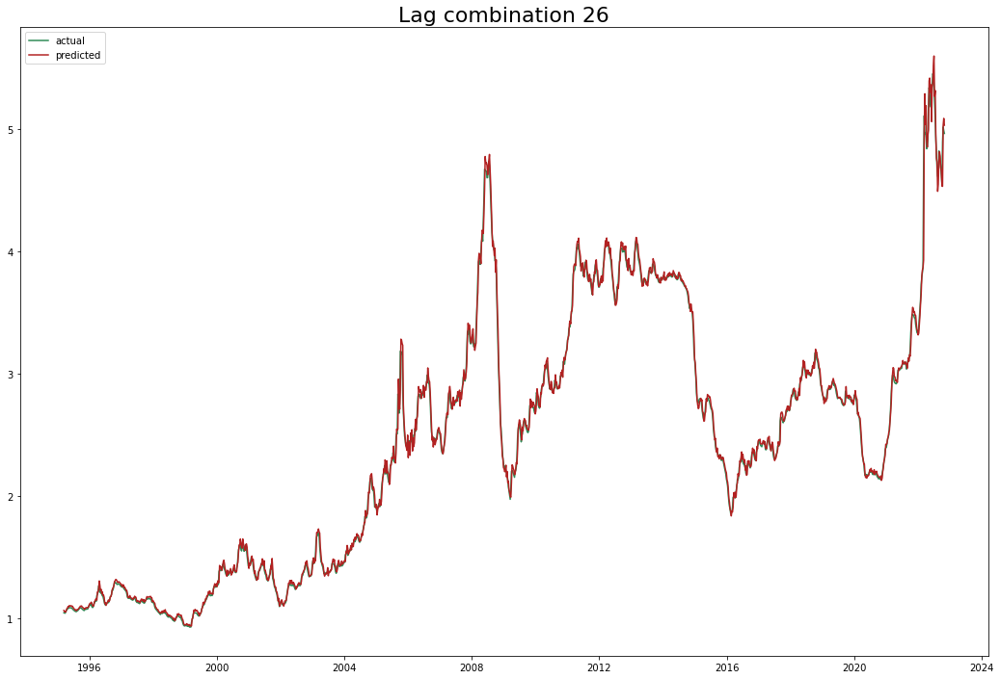

Test data rmse: 0.07371339894252393 Total rmse: 0.04987630453803059
Test data mape: 0.010765993623064261 Total mape: 0.01291829764046258
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.127) neg_root_mean_squared_error: (test=-0.208) r2: (test=-0.422) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.228) neg_root_mean_squared_error: (test=-0.733) r2: (test=-1.488) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.177) n

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.154) neg_root_mean_squared_error: (test=-0.971) r2: (test=-1.128) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.176) r2: (test=0.836) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.098) r2: (test=0.979) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.783) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.039) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.933) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (t

[CV 2/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.228) neg_root_mean_squared_error: (test=-0.733) r2: (test=-1.488) total time=   0.0s
[CV 3/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.185) neg_root_mean_squared_error: (test=-1.044) r2: (test=-1.460) total time=   0.0s
[CV 4/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.253) r2: (test=0.658) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.084) r2: (test=0.985) total time=   0.0s
[CV 1/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.783) total time=   0.0s
[CV 2/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.038) neg_root_mean_squared_error: (test=-0.1

[CV 5/5] END C=100, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.035) r2: (test=0.997) total time=   1.3s
[CV 1/5] END C=100, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.069) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.579) total time=   0.0s
[CV 2/5] END C=100, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.176) neg_root_mean_squared_error: (test=-0.649) r2: (test=-0.951) total time=   0.0s
[CV 3/5] END C=100, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.204) neg_root_mean_squared_error: (test=-1.151) r2: (test=-1.986) total time=   0.0s
[CV 4/5] END C=100, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.047) neg_root_mean_squared_error: (test=-0.224) r2: (test=0.732) total time=   0.0s
[CV 5/5] END C=100, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.034) neg_root_mean_squared_error: (test=-0.108

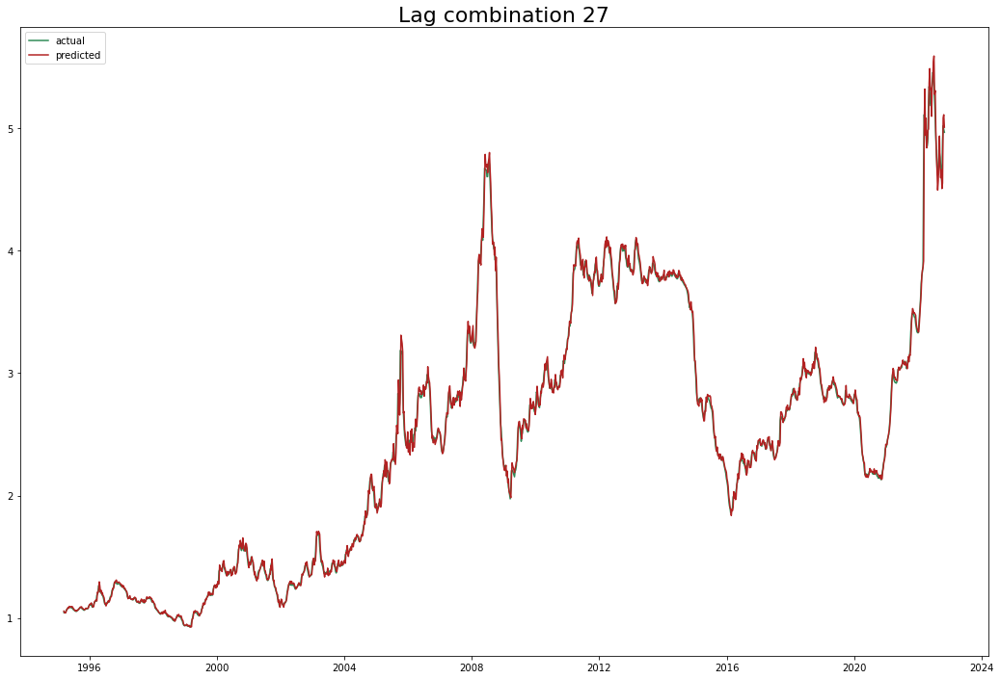

Test data rmse: 0.0730488693259152 Total rmse: 0.04907543417622627
Test data mape: 0.010629822422410139 Total mape: 0.011772668900545525
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.127) neg_root_mean_squared_error: (test=-0.208) r2: (test=-0.426) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.228) neg_root_mean_squared_error: (test=-0.733) r2: (test=-1.494) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (tes

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.101) r2: (test=0.978) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.786) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.040) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.931) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.147) r2: (test=0.951) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_erro

[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.140) neg_root_mean_squared_error: (test=-0.942) r2: (test=-1.003) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.213) r2: (test=0.758) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.029) neg_root_mean_squared_error: (test=-0.089) r2: (test=0.983) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.786) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.038) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.938) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.034) neg_root_mean_squared_error: (test=-0.135) 

{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


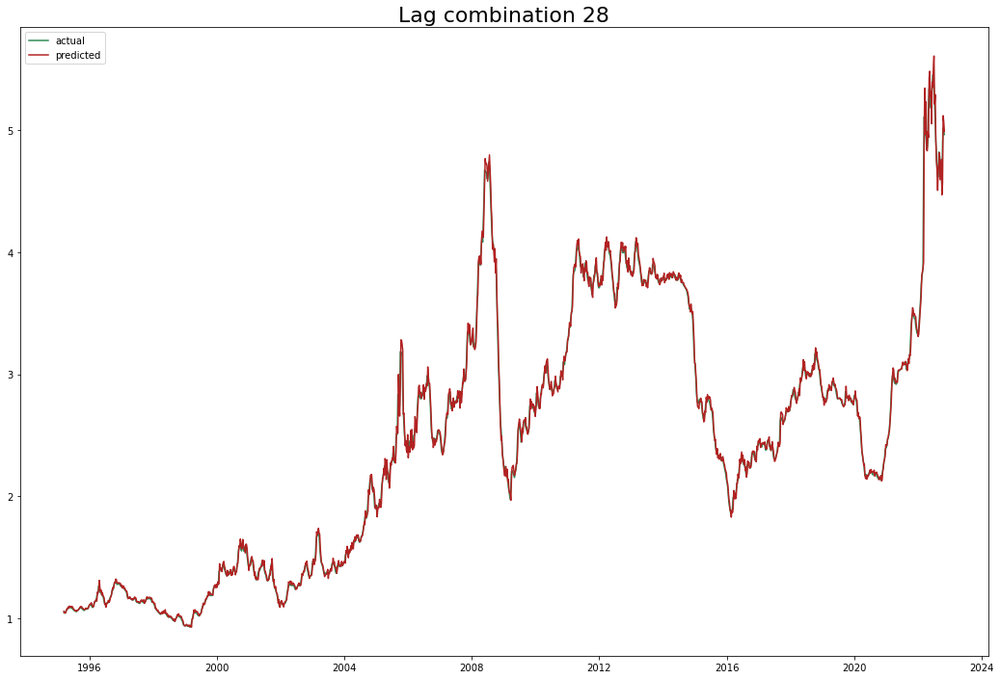

Test data rmse: 0.0763470661710297 Total rmse: 0.050799850346915885
Test data mape: 0.010918455933195058 Total mape: 0.0123521915293855
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.127) neg_root_mean_squared_error: (test=-0.208) r2: (test=-0.427) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.228) neg_root_mean_squared_error: (test=-0.734) r2: (test=-1.498) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_e

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.783) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.039) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.934) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.144) r2: (test=0.953) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.039) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error

[CV 5/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.028) neg_root_mean_squared_error: (test=-0.088) r2: (test=0.984) total time=   0.0s
[CV 1/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.783) total time=   0.0s
[CV 2/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.940) total time=   0.0s
[CV 3/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.034) neg_root_mean_squared_error: (test=-0.134) r2: (test=0.960) total time=   0.0s
[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (te

[CV 3/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.971) total time=   0.1s
[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   0.7s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.997) total time=   1.2s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


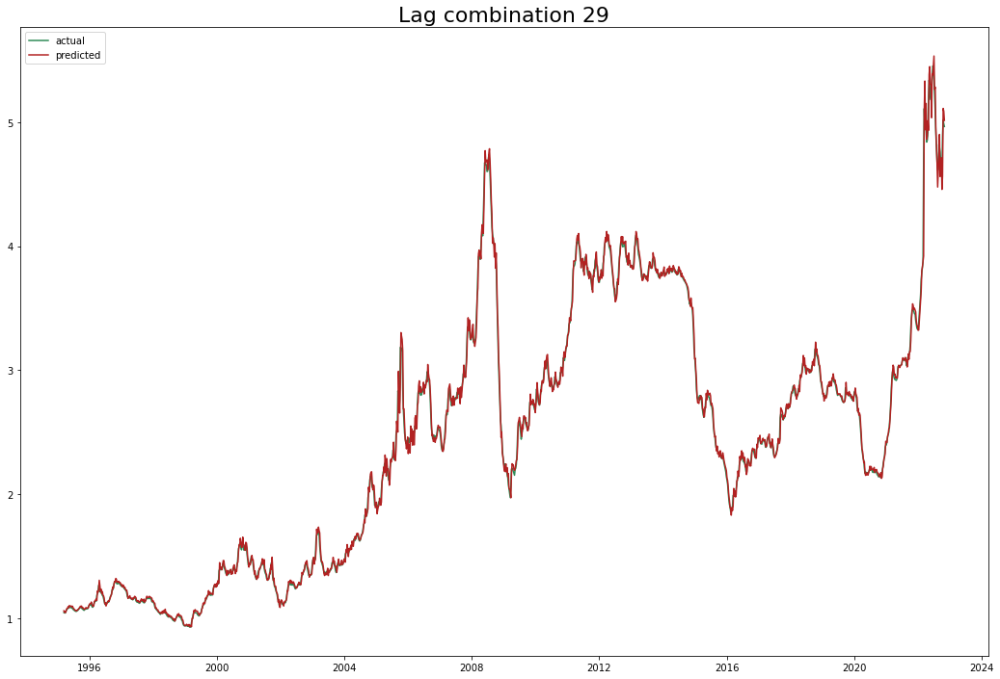

Test data rmse: 0.07423469750314275 Total rmse: 0.04971887782185733
Test data mape: 0.010721076361587301 Total mape: 0.012308170739694625
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.128) neg_root_mean_squared_error: (test=-0.208) r2: (test=-0.430) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.228) neg_root_mean_squared_error: (test=-0.734) r2: (test=-1.501) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)



[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.786) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.039) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.935) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.145) r2: (test=0.952) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.040) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_erro

[CV 5/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.029) neg_root_mean_squared_error: (test=-0.090) r2: (test=0.983) total time=   0.0s
[CV 1/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.786) total time=   0.0s
[CV 2/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.110) r2: (test=0.944) total time=   0.0s
[CV 3/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.034) neg_root_mean_squared_error: (test=-0.135) r2: (test=0.959) total time=   0.0s
[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (te

[CV 3/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.969) total time=   0.1s
[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   1.0s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.997) total time=   1.2s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


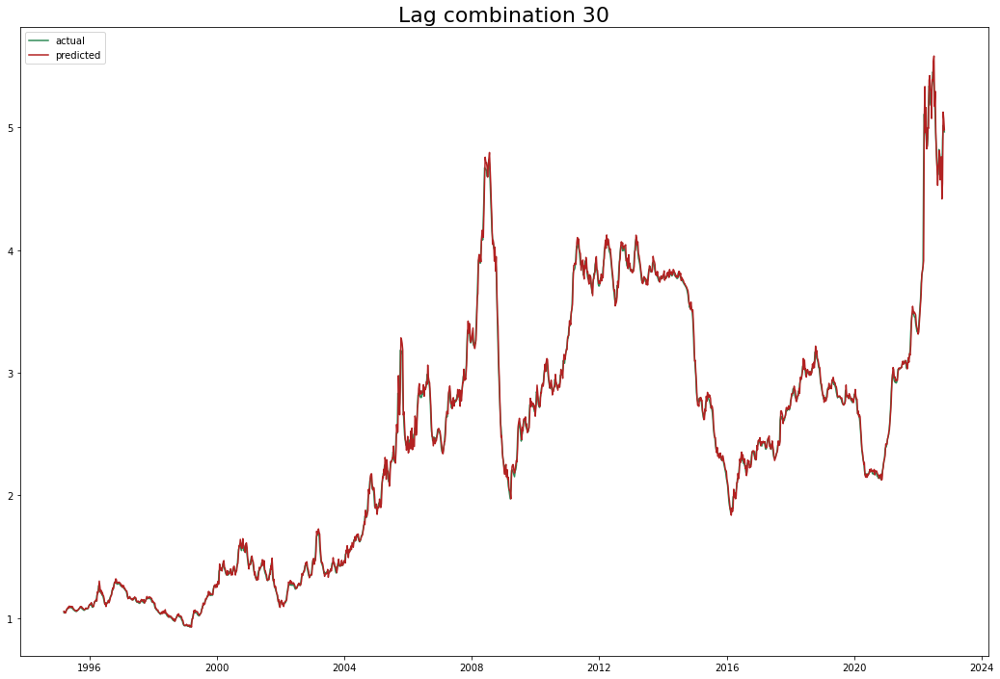

Test data rmse: 0.0745791105076179 Total rmse: 0.05007210461499041
Test data mape: 0.010823254272262987 Total mape: 0.01219374552451107
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.128) neg_root_mean_squared_error: (test=-0.208) r2: (test=-0.432) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.229) neg_root_mean_squared_error: (test=-0.735) r2: (test=-1.503) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.785) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.038) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.938) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.145) r2: (test=0.953) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.040) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error

[CV 5/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.029) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.982) total time=   0.0s
[CV 1/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.785) total time=   0.0s
[CV 2/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.107) r2: (test=0.947) total time=   0.0s
[CV 3/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.034) neg_root_mean_squared_error: (test=-0.137) r2: (test=0.958) total time=   0.0s
[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (te

[CV 3/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.035) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.964) total time=   0.1s
[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   0.6s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.035) r2: (test=0.997) total time=   1.2s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


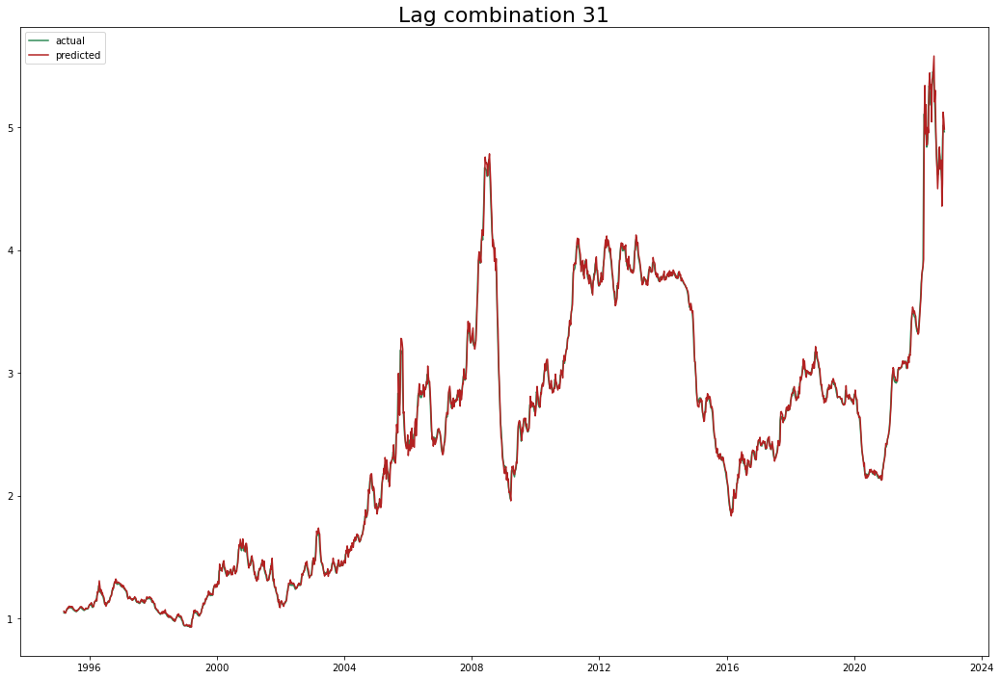

Test data rmse: 0.07536869754503006 Total rmse: 0.04996423052695069
Test data mape: 0.010677004519585389 Total mape: 0.012011566076776767
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.128) neg_root_mean_squared_error: (test=-0.208) r2: (test=-0.433) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.228) neg_root_mean_squared_error: (test=-0.734) r2: (test=-1.500) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scale, kernel=

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.082) r2: (test=0.779) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.040) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.929) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.145) r2: (test=0.953) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.038) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error

[CV 4/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.039) neg_root_mean_squared_error: (test=-0.204) r2: (test=0.778) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.982) total time=   0.0s
[CV 1/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.082) r2: (test=0.779) total time=   0.0s
[CV 2/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.039) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.933) total time=   0.0s
[CV 3/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.034) neg_root_mean_squared_error: (test=-0.136) r2: (test=0.958) total time=   0.0s
[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=

[CV 3/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.111) r2: (test=0.972) total time=   0.1s
[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.990) total time=   2.7s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.035) r2: (test=0.997) total time=   1.6s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


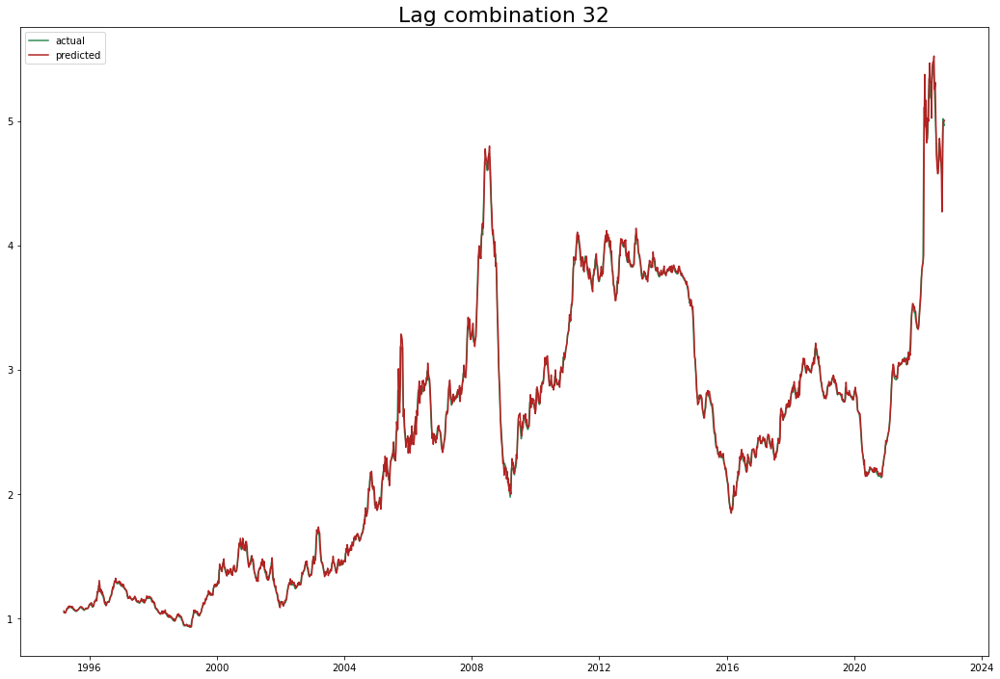

Test data rmse: 0.0752944653807526 Total rmse: 0.05032991674662514
Test data mape: 0.011032033285369863 Total mape: 0.012357495977426162
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.128) neg_root_mean_squared_error: (test=-0.208) r2: (test=-0.432) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.228) neg_root_mean_squared_error: (test=-0.734) r2: (test=-1.496) total time=   0.0s
[CV 3/5] END C=0.5, gamma=scal

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.034) neg_root_mean_squared_error: (test=-0.111) r2: (test=0.974) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.053) neg_root_mean_squared_error: (test=-0.084) r2: (test=0.769) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.927) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.145) r2: (test=0.952) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_erro

[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.038) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.068) neg_root_mean_squared_error: (test=-0.106) r2: (test=0.630) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.128) neg_root_mean_squared_error: (test=-0.472) r2: (test=-0.033) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.161) neg_root_mean_squared_error: (test=-0.967) r2: (test=-1.107) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.156) 

[CV 3/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.028) neg_root_mean_squared_error: (test=-0.106) r2: (test=0.974) total time=   0.1s
[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.991) total time=   1.6s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.036) r2: (test=0.997) total time=   1.8s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


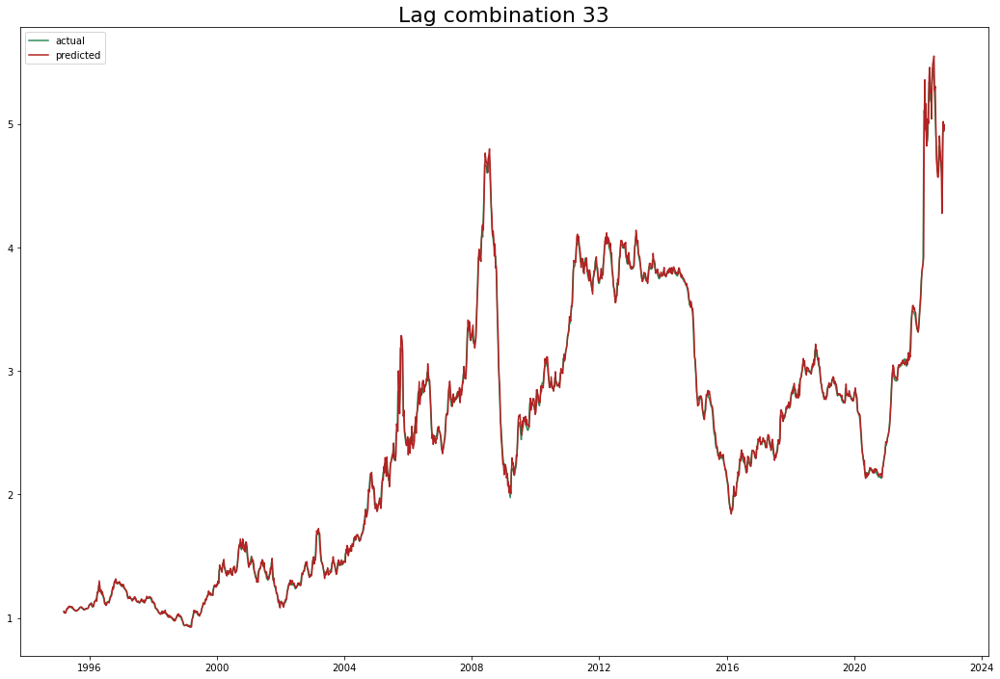

Test data rmse: 0.07546993210802724 Total rmse: 0.05029138703464689
Test data mape: 0.011196673387157383 Total mape: 0.012220757799449668
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.128) neg_root_mean_squared_error: (test=-0.209) r2: (test=-0.435) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.227) neg_root_mean_squared_error: (test=-0.732) r2: (test=-1.483) total time=   0.0s
[CV 3/5] END C=0.5

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.086) r2: (test=0.754) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.927) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.145) r2: (test=0.953) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.082) neg_root_mean_squared_error

[CV 2/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.040) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.931) total time=   0.0s
[CV 3/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.035) neg_root_mean_squared_error: (test=-0.138) r2: (test=0.957) total time=   0.0s
[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.038) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.069) neg_root_mean_squared_error: (test=-0.108) r2: (test=0.618) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.126) neg_root_mean_squared_error: (test=-0

[CV 3/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.970) total time=   0.1s
[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   1.6s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.034) r2: (test=0.998) total time=   2.2s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


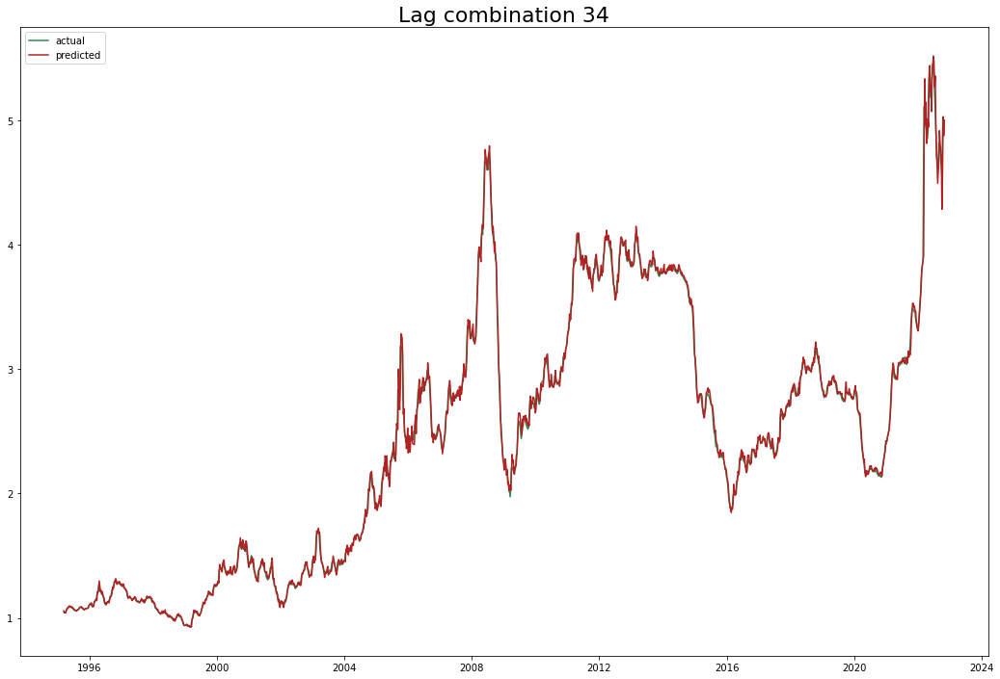

Test data rmse: 0.07607704180441463 Total rmse: 0.05049852413523927
Test data mape: 0.01137021353669957 Total mape: 0.012292665458971369
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.128) neg_root_mean_squared_error: (test=-0.209) r2: (test=-0.438) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.226) neg_root_mean_squared_error: (test=-0.730) r2: (test=-1.471) total time=   0.0s
[CV 3/5]

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.091) r2: (test=0.725) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.927) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.035) neg_root_mean_squared_error: (test=-0.141) r2: (test=0.955) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.083) neg_root_mean_squared_error

[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.071) neg_root_mean_squared_error: (test=-0.110) r2: (test=0.598) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.125) neg_root_mean_squared_error: (test=-0.459) r2: (test=0.024) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.983) r2: (test=-1.180) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.146) r2: (test=0.886) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.096) r2: (test=0.981) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.091) r2: (t

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.991) total time=   1.4s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.036) r2: (test=0.997) total time=   1.2s
{'C': 1, 'gamma': 'scale', 'kernel': 'linear'}


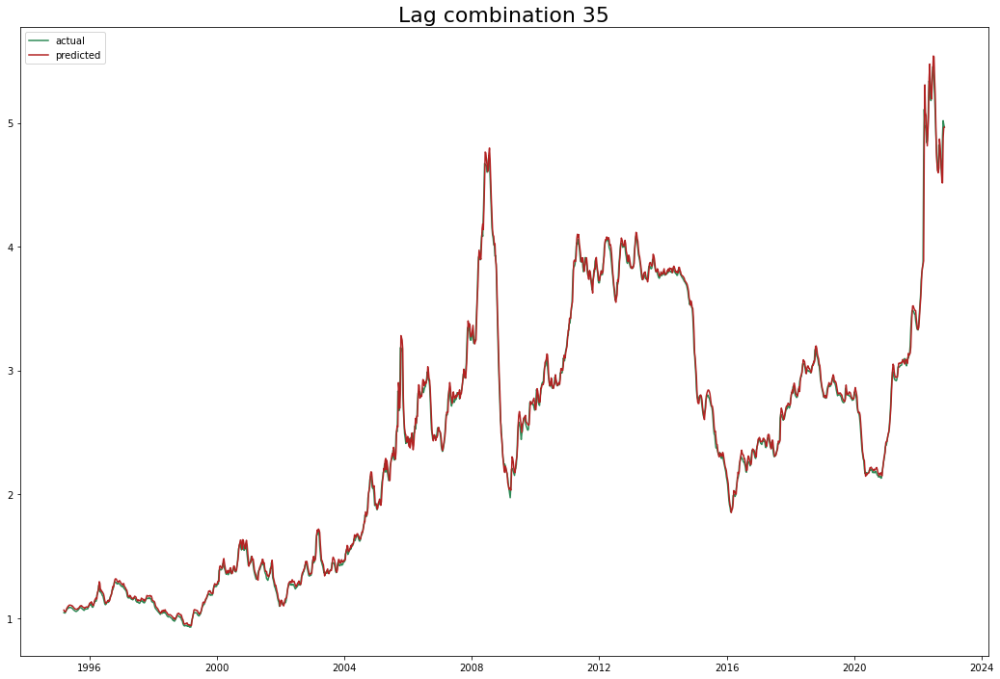

Test data rmse: 0.07518967895329756 Total rmse: 0.050829156157409905
Test data mape: 0.011670660138035121 Total mape: 0.013809854045846944
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.129) neg_root_mean_squared_error: (test=-0.209) r2: (test=-0.441) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.226) neg_root_mean_squared_error: (test=-0.729) r2: (test=-1.462) total time=   

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.035) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.972) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.095) r2: (test=0.700) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.042) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.927) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.038) neg_root_mean_squared_error: (test=-0.146) r2: (test=0.952) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_erro

[CV 3/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.221) neg_root_mean_squared_error: (test=-1.088) r2: (test=-1.668) total time=   0.0s
[CV 4/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.179) r2: (test=0.828) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.029) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.982) total time=   0.0s
[CV 1/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.095) r2: (test=0.700) total time=   0.0s
[CV 2/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.042) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.927) total time=   0.0s
[CV 3/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.991) total time=   2.3s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.034) r2: (test=0.998) total time=   2.8s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


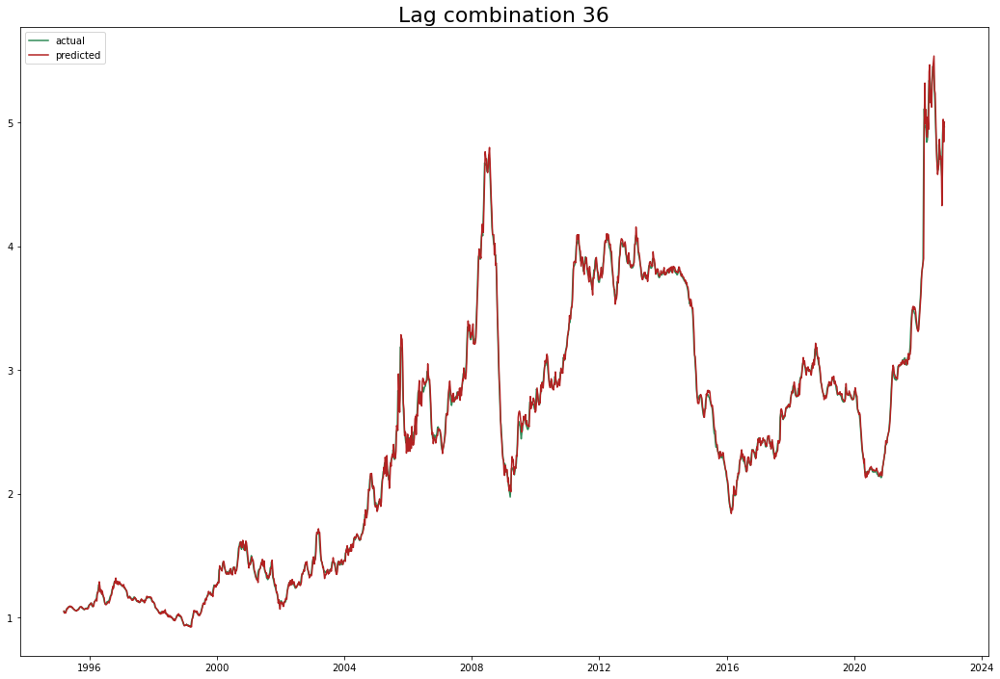

Test data rmse: 0.07351739239908159 Total rmse: 0.04973460807269019
Test data mape: 0.011062526839120417 Total mape: 0.012193480234012915
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.129) neg_root_mean_squared_error: (test=-0.209) r2: (test=-0.447) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.225) neg_root_mean_squared_error: (test=-0.727) r2: (test=-1.453) tota

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.096) r2: (test=0.699) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.128) r2: (test=0.924) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.141) r2: (test=0.955) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.085) neg_root_mean_squared_error

[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.155) r2: (test=0.871) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.029) neg_root_mean_squared_error: (test=-0.094) r2: (test=0.981) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.096) r2: (test=0.699) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.925) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.146) r2: (test=0.952) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.043

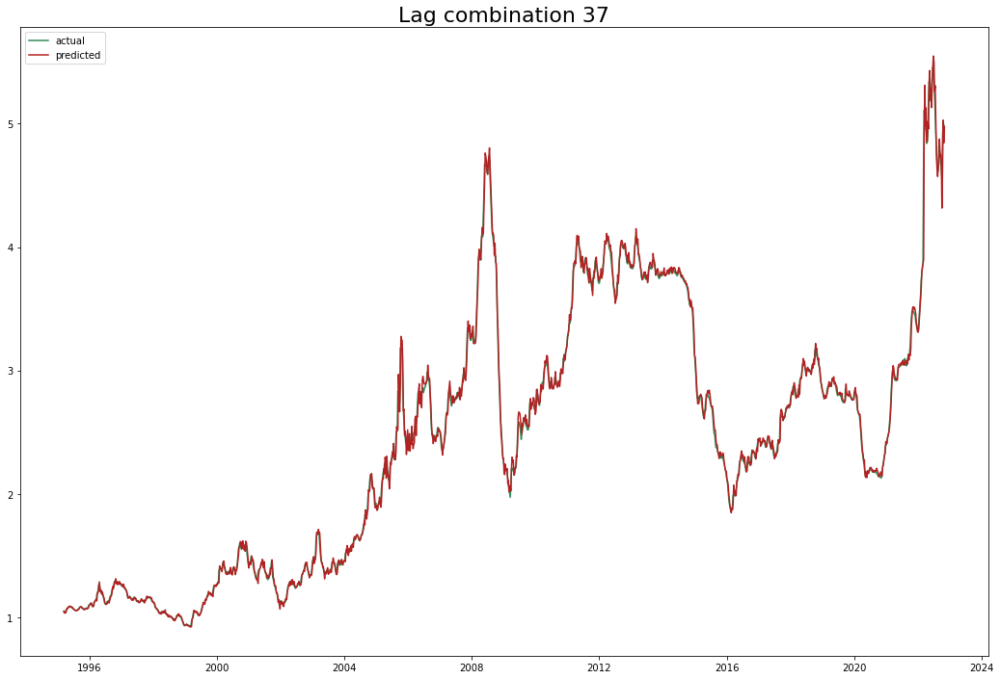

Test data rmse: 0.0739790176629689 Total rmse: 0.05008177312072766
Test data mape: 0.01109026740079223 Total mape: 0.012276147579378551
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.129) neg_root_mean_squared_error: (test=-0.210) r2: (test=-0.454) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.225) neg_root_mean_squared_error: (test=-0.727) r2: (test=-1.

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.970) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.095) r2: (test=0.701) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.925) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.038) neg_root_mean_squared_error: (test=-0.143) r2: (test=0.954) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_erro

[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.564) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.129) neg_root_mean_squared_error: (test=-0.463) r2: (test=0.006) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.177) neg_root_mean_squared_error: (test=-0.981) r2: (test=-1.172) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.170) r2: (test=0.846) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.029) neg_root_mean_squared_error: (test=-0.095) r2: (test=0.981) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.095) r2: (t

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.991) total time=   2.4s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.034) r2: (test=0.998) total time=   3.7s
{'C': 0.5, 'gamma': 'scale', 'kernel': 'linear'}


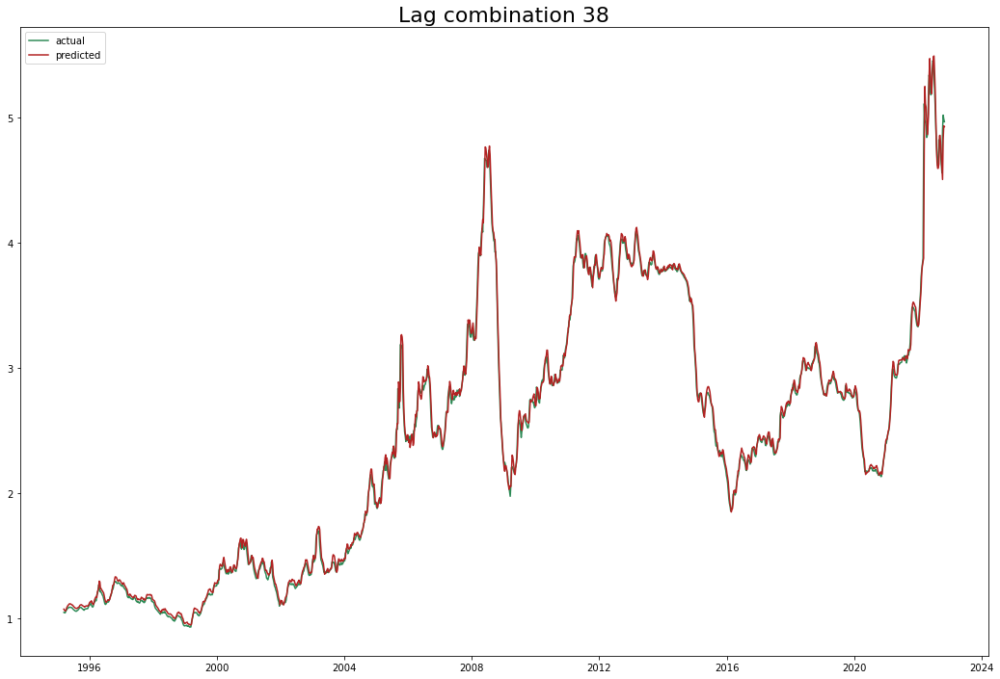

Test data rmse: 0.07827145973261891 Total rmse: 0.05312562766254897
Test data mape: 0.012402883338803235 Total mape: 0.015452576524081236
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.130) neg_root_mean_squared_error: (test=-0.210) r2: (test=-0.457) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.225) neg_root_mean_squared_error: (test=-0.727) 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.969) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.096) r2: (test=0.696) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.927) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.152) r2: (test=0.948) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_erro

[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.038) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.564) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.132) neg_root_mean_squared_error: (test=-0.471) r2: (test=-0.029) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.177) neg_root_mean_squared_error: (test=-0.979) r2: (test=-1.161) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.040) neg_root_mean_squared_error: (test=-0.189) r2: (test=0.810) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.098) r2: 

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.991) total time=   3.3s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.034) r2: (test=0.998) total time=   2.9s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


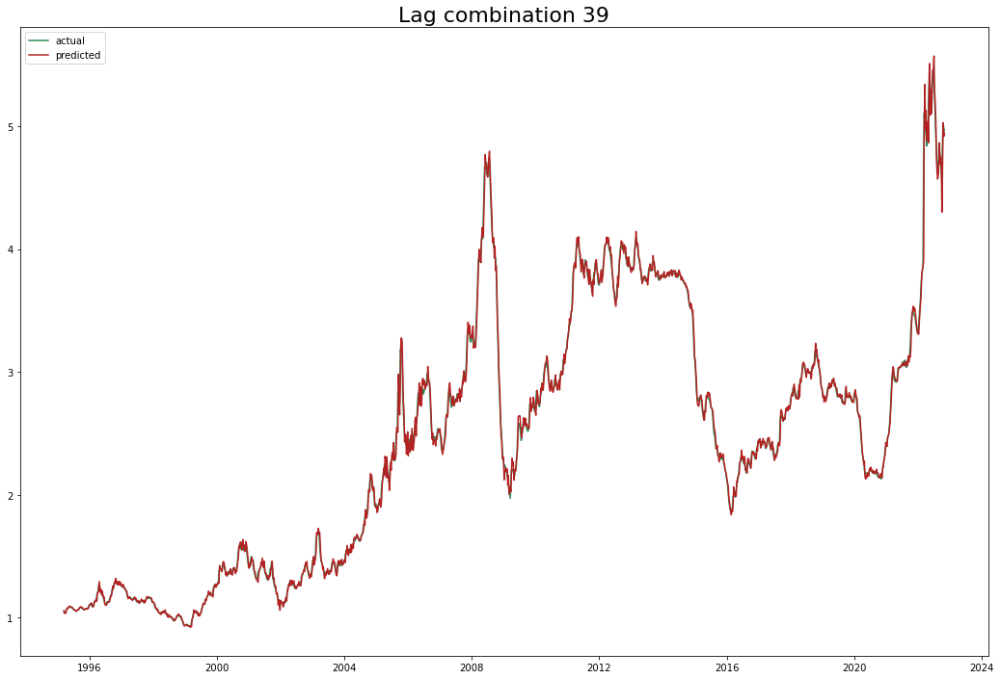

Test data rmse: 0.07612828960270471 Total rmse: 0.05102285055939142
Test data mape: 0.01127936068668334 Total mape: 0.012630609642968563
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.130) neg_root_mean_squared_error: (test=-0.210) r2: (test=-0.461) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.226) neg_root_mean_squared_error: (tes

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.968) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.096) r2: (test=0.696) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.042) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.928) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.046) neg_root_mean_squared_error: (test=-0.159) r2: (test=0.943) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_erro

[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.562) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.137) neg_root_mean_squared_error: (test=-0.487) r2: (test=-0.101) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.177) neg_root_mean_squared_error: (test=-0.976) r2: (test=-1.147) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.044) neg_root_mean_squared_error: (test=-0.205) r2: (test=0.776) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.100) r2: (test=0.979) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.096) r2: (

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.991) total time=   2.5s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.034) r2: (test=0.998) total time=   3.7s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


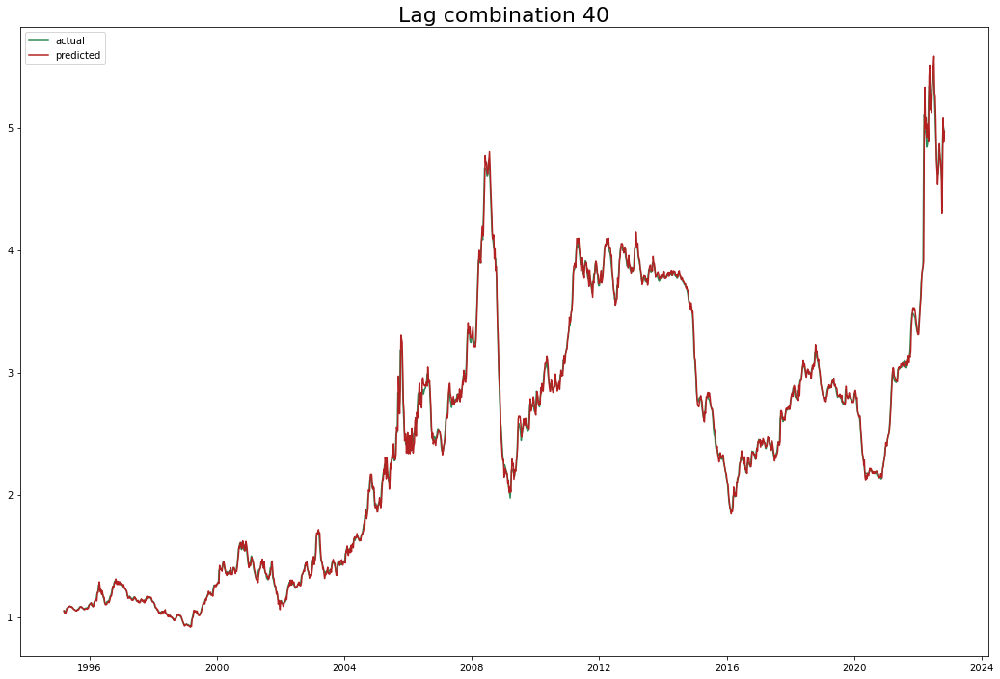

Test data rmse: 0.0759181753312705 Total rmse: 0.051034113993867175
Test data mape: 0.011307975465157005 Total mape: 0.012581692902046167
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.130) neg_root_mean_squared_error: (test=-0.211) r2: (test=-0.465) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.226) neg_root_mean_squared

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.038) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.967) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.097) r2: (test=0.692) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.042) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.929) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.171) r2: (test=0.934) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_erro

[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.559) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.138) neg_root_mean_squared_error: (test=-0.491) r2: (test=-0.119) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.177) neg_root_mean_squared_error: (test=-0.973) r2: (test=-1.134) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.047) neg_root_mean_squared_error: (test=-0.223) r2: (test=0.734) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.101) r2: (test=0.978) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.097) r2: (

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.990) total time=   4.3s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.036) r2: (test=0.997) total time=   4.2s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


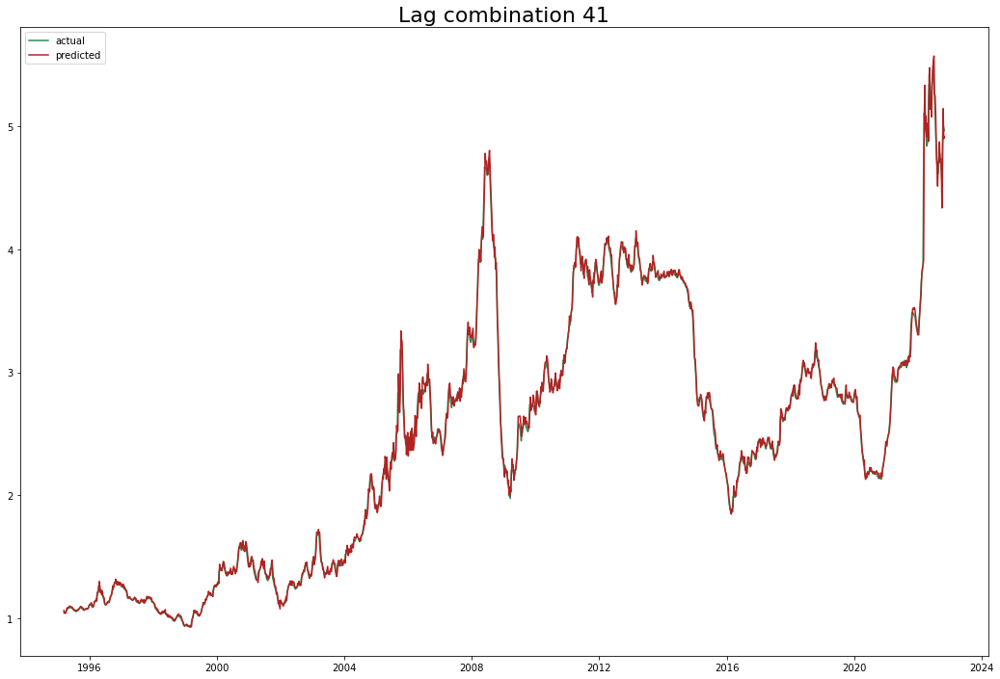

Test data rmse: 0.07548027293086092 Total rmse: 0.05120286183396535
Test data mape: 0.011586451183126905 Total mape: 0.013000959595190313
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.131) neg_root_mean_squared_error: (test=-0.211) r2: (test=-0.468) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.226) neg_root_m

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.097) r2: (test=0.689) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.042) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.926) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.175) r2: (test=0.931) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=0.5, gamma=0.1, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.088) neg_root_mean_squared_error

[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.564) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.138) neg_root_mean_squared_error: (test=-0.495) r2: (test=-0.137) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.175) neg_root_mean_squared_error: (test=-0.967) r2: (test=-1.109) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.240) r2: (test=0.692) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.106) r2: (test=0.976) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.097) r2: (

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   2.4s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.036) r2: (test=0.997) total time=   3.3s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


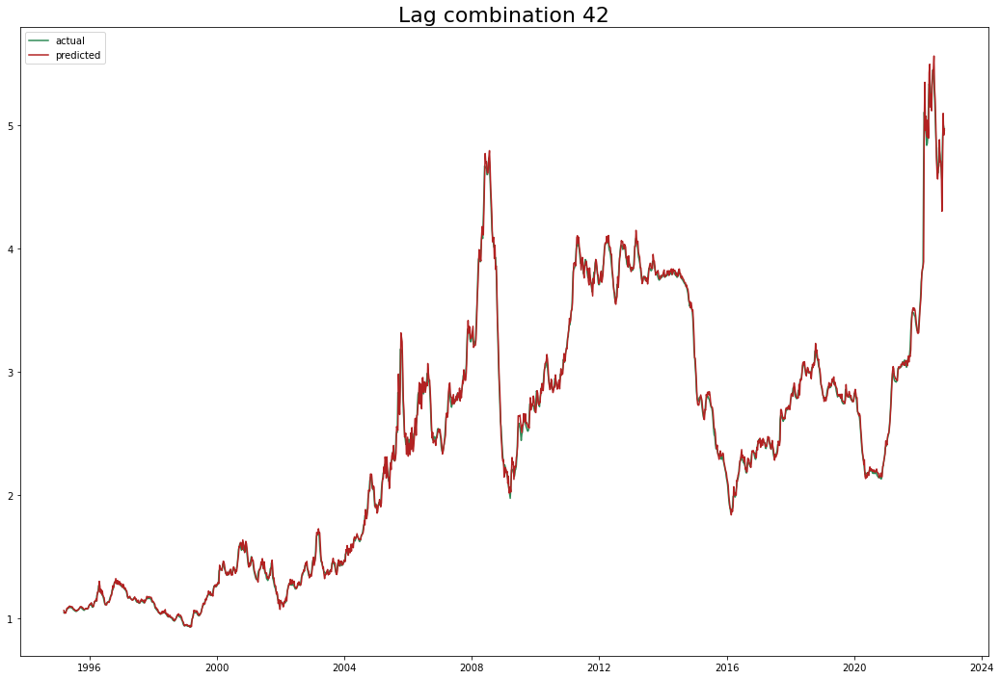

Test data rmse: 0.07519688390383093 Total rmse: 0.05100067669000245
Test data mape: 0.011493526311901025 Total mape: 0.012966343530723195
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.131) neg_root_mean_squared_error: (test=-0.211) r2: (test=-0.472) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.226)

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.135) r2: (test=0.961) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.096) r2: (test=0.693) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.044) neg_root_mean_squared_error: (test=-0.132) r2: (test=0.919) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.173) r2: (test=0.933) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.988) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_erro

[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.075) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.554) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.140) neg_root_mean_squared_error: (test=-0.501) r2: (test=-0.166) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.960) r2: (test=-1.080) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.053) neg_root_mean_squared_error: (test=-0.252) r2: (test=0.662) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.035) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.975) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.096) r2: (

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   1.7s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.038) r2: (test=0.997) total time=   4.2s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


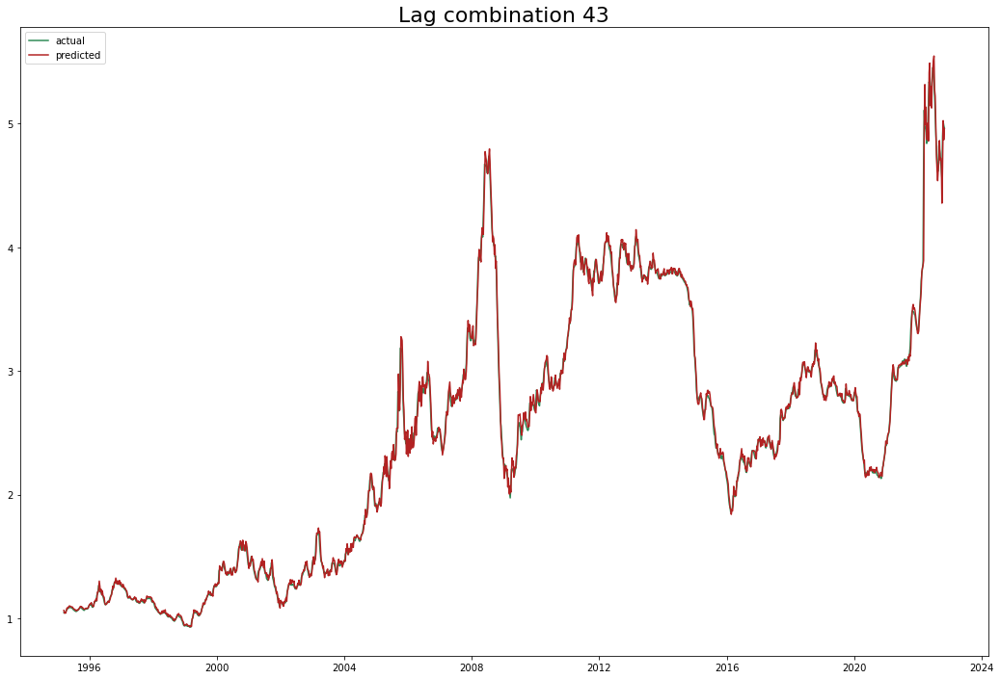

Test data rmse: 0.07455056743448162 Total rmse: 0.05093731269691159
Test data mape: 0.011383091424920838 Total mape: 0.013148851793214466
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.131) neg_root_mean_squared_error: (test=-0.212) r2: (test=-0.475) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (t

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.086) neg_root_mean_squared_error: (test=-0.134) r2: (test=0.409) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.155) neg_root_mean_squared_error: (test=-0.526) r2: (test=-0.281) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.184) neg_root_mean_squared_error: (test=-0.983) r2: (test=-1.177) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.288) r2: (test=0.558) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.042) neg_root_mean_squared_error: (test=-0.139) r2: (test=0.959) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-

[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.038) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.075) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.556) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.144) neg_root_mean_squared_error: (test=-0.511) r2: (test=-0.209) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.170) neg_root_mean_squared_error: (test=-0.953) r2: (test=-1.048) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.267) 

[CV 3/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.146) r2: (test=0.952) total time=   0.1s
[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   3.8s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.035) r2: (test=0.997) total time=   3.0s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


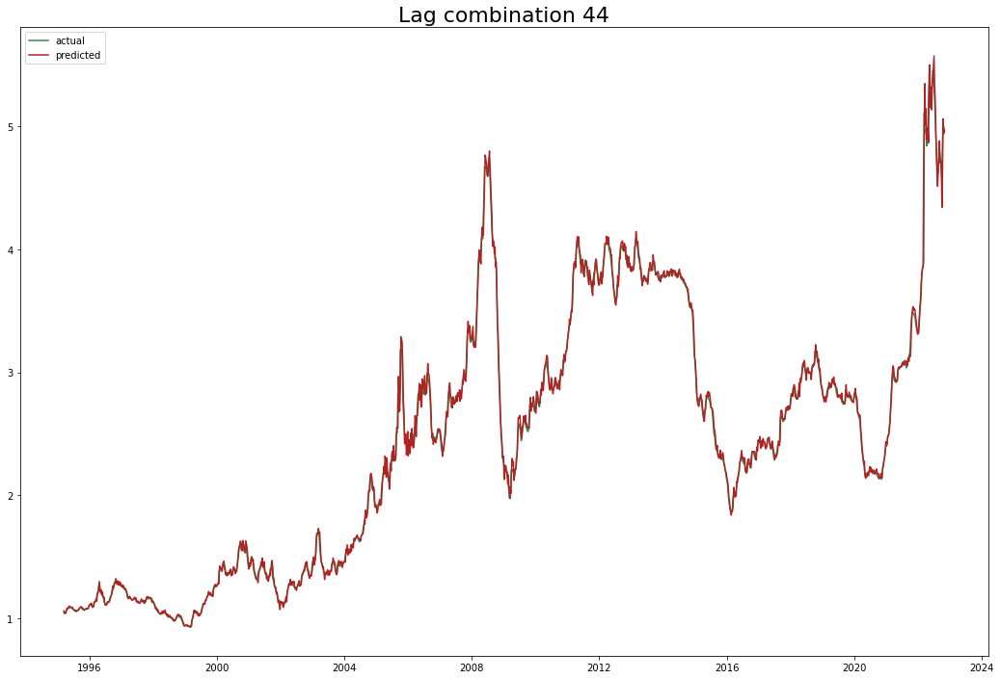

Test data rmse: 0.07582748484247784 Total rmse: 0.05119101669570475
Test data mape: 0.011609726304757848 Total mape: 0.013013464946677775
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.131) neg_root_mean_squared_error: (test=-0.212) r2: (test=-0.478) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentag

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.141) r2: (test=0.958) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.099) r2: (test=0.678) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.048) neg_root_mean_squared_error: (test=-0.144) r2: (test=0.904) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.053) neg_root_mean_squared_error: (test=-0.177) r2: (test=0.929) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_erro

[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.075) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.549) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.149) neg_root_mean_squared_error: (test=-0.522) r2: (test=-0.263) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.168) neg_root_mean_squared_error: (test=-0.950) r2: (test=-1.035) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.284) r2: (test=0.571) total time=   0.0s
[CV 5/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.972) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.099) r2: (

[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   1.2s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.035) r2: (test=0.997) total time=   2.3s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


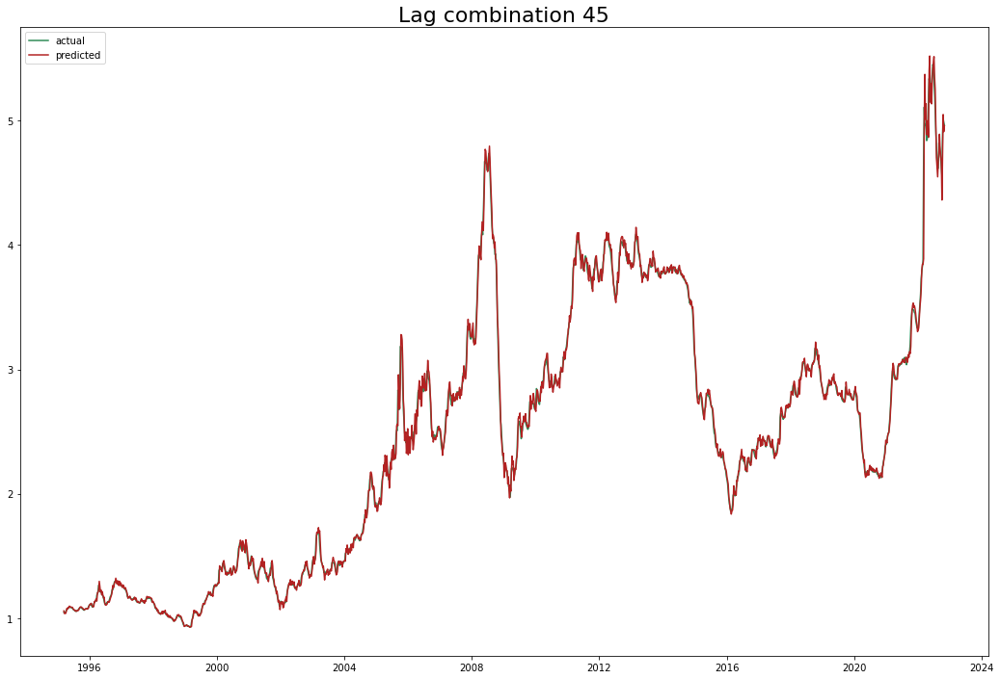

Test data rmse: 0.0757754359164623 Total rmse: 0.050975454919155776
Test data mape: 0.0114570690039132 Total mape: 0.012740794617324806
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.132) neg_root_mean_squared_error: (test=-0.212) r2: (test=-0.481) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.088) neg_root_mean_squared_error: (test=-0.135) r2: (test=0.395) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.158) neg_root_mean_squared_error: (test=-0.530) r2: (test=-0.303) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.182) neg_root_mean_squared_error: (test=-0.975) r2: (test=-1.145) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.066) neg_root_mean_squared_error: (test=-0.316) r2: (test=0.467) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.044) neg_root_mean_squared_error: (test=-0.143) r2: (test=0.957) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-

[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.077) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.530) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.527) r2: (test=-0.287) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.166) neg_root_mean_squared_error: (test=-0.947) r2: (test=-1.022) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.297) 

[CV 3/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.155) r2: (test=0.946) total time=   0.1s
[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   1.9s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.034) r2: (test=0.998) total time=   3.4s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


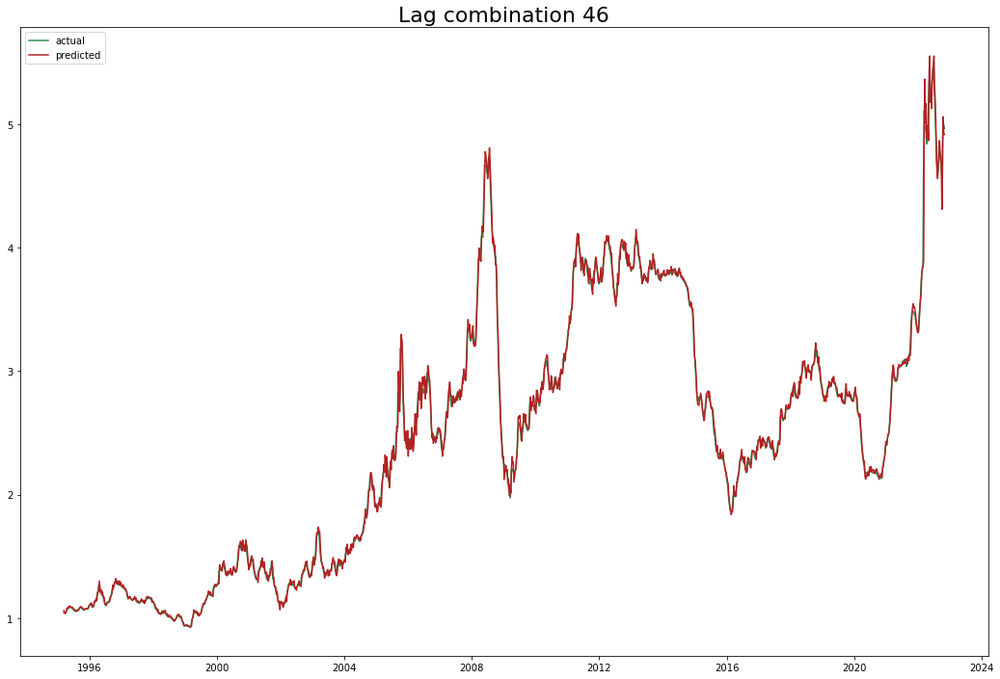

Test data rmse: 0.07696320937956046 Total rmse: 0.05190035538501973
Test data mape: 0.011753846061815457 Total mape: 0.013194885245510251
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.132) neg_root_mean_squared_error: (test=-0.212) r2: (test=-0.484) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel=rbf; neg_m

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.180) neg_root_mean_squared_error: (test=-0.971) r2: (test=-1.125) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.069) neg_root_mean_squared_error: (test=-0.331) r2: (test=0.417) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.045) neg_root_mean_squared_error: (test=-0.145) r2: (test=0.956) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.101) r2: (test=0.664) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.049) neg_root_mean_squared_error: (test=-0.145) r2: (test=0.903) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.049) neg_root_mean_squared_error: (t

[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.077) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.524) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.153) neg_root_mean_squared_error: (test=-0.532) r2: (test=-0.312) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.166) neg_root_mean_squared_error: (test=-0.944) r2: (test=-1.010) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.312) 

[CV 3/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.044) neg_root_mean_squared_error: (test=-0.162) r2: (test=0.941) total time=   0.3s
[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   1.9s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.035) r2: (test=0.997) total time=   3.1s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


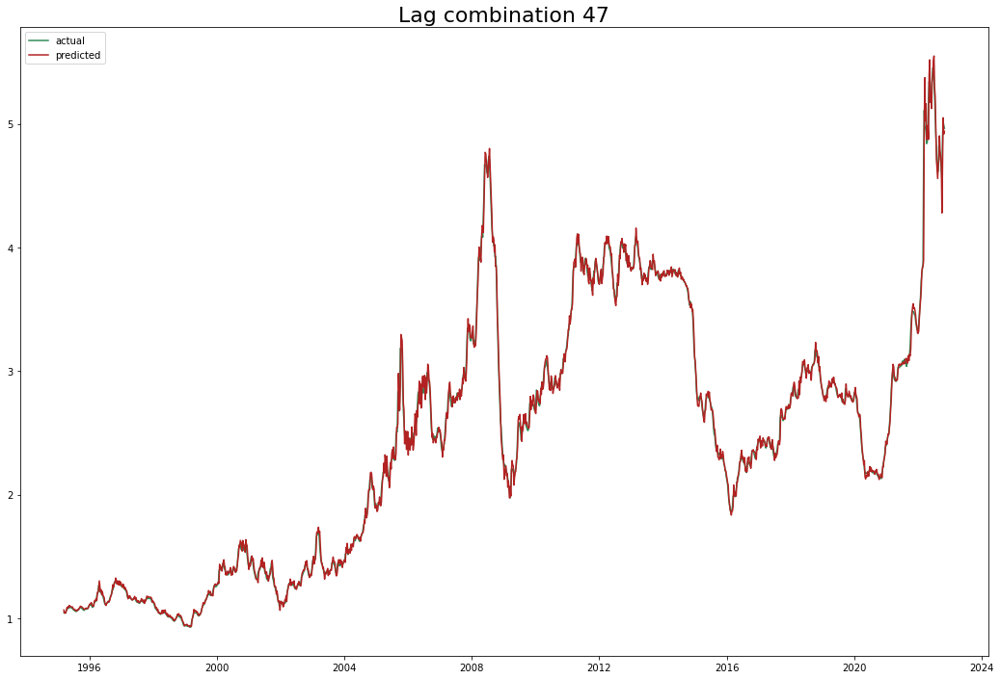

Test data rmse: 0.07637921029458507 Total rmse: 0.05171354069314796
Test data mape: 0.011567468065897939 Total mape: 0.013397777468688256
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.132) neg_root_mean_squared_error: (test=-0.212) r2: (test=-0.486) total time=   0.0s
[CV 2/5] END C=0.5, gamma=scale, kernel

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.159) neg_root_mean_squared_error: (test=-0.529) r2: (test=-0.296) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.179) neg_root_mean_squared_error: (test=-0.967) r2: (test=-1.109) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.072) neg_root_mean_squared_error: (test=-0.347) r2: (test=0.358) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.045) neg_root_mean_squared_error: (test=-0.145) r2: (test=0.955) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.103) r2: (test=0.653) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.049) neg_root_mean_squared_error: (tes

[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.078) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.516) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.156) neg_root_mean_squared_error: (test=-0.538) r2: (test=-0.343) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.940) r2: (test=-0.993) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.070) neg_root_mean_squared_error: (test=-0.335) 

[CV 3/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.042) neg_root_mean_squared_error: (test=-0.152) r2: (test=0.948) total time=   0.1s
[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   3.3s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.033) r2: (test=0.998) total time=   2.1s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


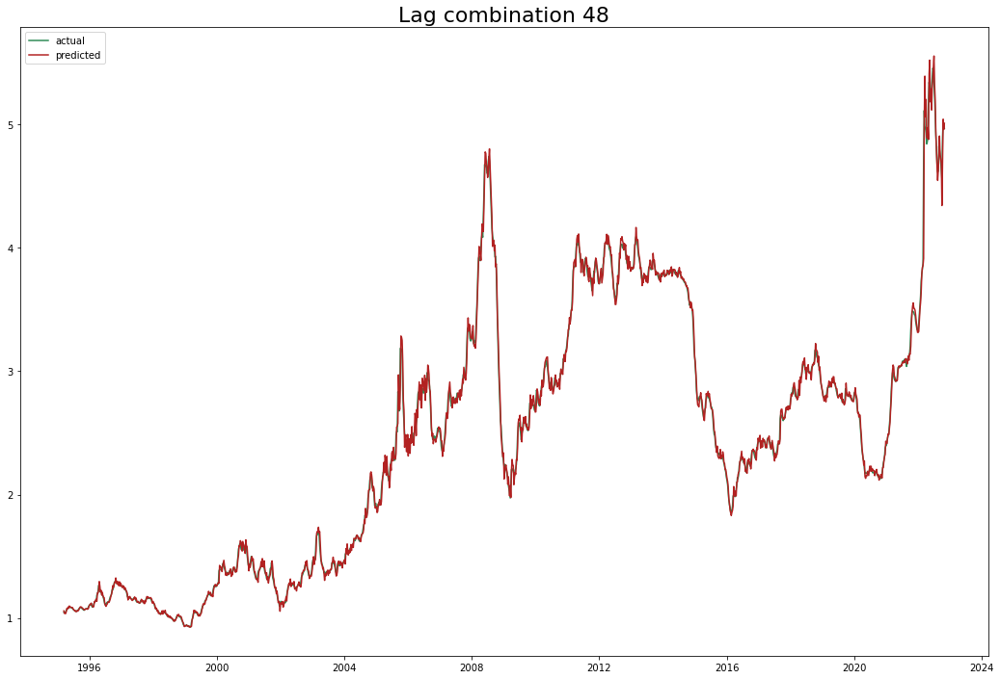

Test data rmse: 0.07551071874505776 Total rmse: 0.051344267738587086
Test data mape: 0.011437690775001898 Total mape: 0.012911702315183045
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.132) neg_root_mean_squared_error: (test=-0.212) r2: (test=-0.488) total time=   0.0s
[CV 2/5] END C=0.5, gamma=s

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.179) neg_root_mean_squared_error: (test=-0.966) r2: (test=-1.106) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.075) neg_root_mean_squared_error: (test=-0.362) r2: (test=0.299) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.045) neg_root_mean_squared_error: (test=-0.146) r2: (test=0.955) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.103) r2: (test=0.652) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.147) r2: (test=0.900) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.047) neg_root_mean_squared_error: (t

[CV 2/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.147) r2: (test=0.900) total time=   0.0s
[CV 3/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.150) r2: (test=0.949) total time=   0.0s
[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.078) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.506) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.153) neg_root_mean_squared_error: (test=-0

[CV 3/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.040) neg_root_mean_squared_error: (test=-0.148) r2: (test=0.951) total time=   0.2s
[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   2.6s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.034) r2: (test=0.998) total time=   2.3s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


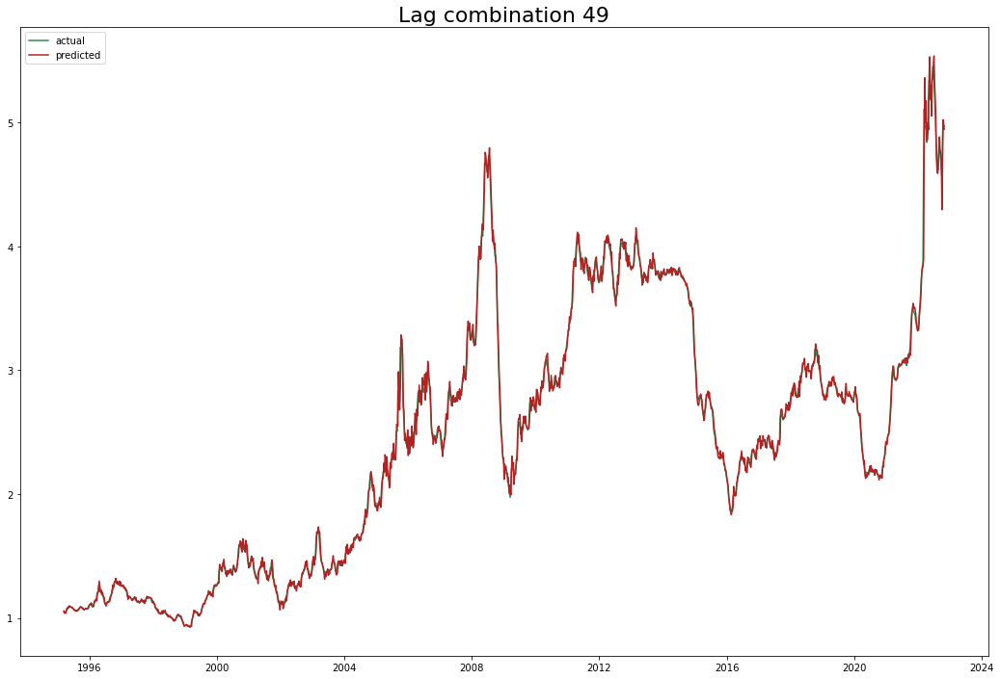

Test data rmse: 0.07646952197899684 Total rmse: 0.05135497481883944
Test data mape: 0.011531554778669066 Total mape: 0.01279500603115858
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag', '51w_lag']
Fitting 5 folds for each of 24 candidates, totalling 120 fits
[CV 1/5] END C=0.5, gamma=scale, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.133) neg_root_mean_squared_error: (test=-0.213) r2: (test=-0.491) total time=   0.0s
[CV 2/5] END C=0.5

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END C=0.5, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.046) neg_root_mean_squared_error: (test=-0.148) r2: (test=0.953) total time=   0.0s
[CV 1/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.067) neg_root_mean_squared_error: (test=-0.106) r2: (test=0.630) total time=   0.0s
[CV 2/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.148) r2: (test=0.898) total time=   0.0s
[CV 3/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.048) neg_root_mean_squared_error: (test=-0.168) r2: (test=0.936) total time=   0.0s
[CV 4/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=0.5, gamma=auto, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_erro

[CV 4/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.989) total time=   0.0s
[CV 5/5] END C=2, gamma=scale, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.997) total time=   0.0s
[CV 1/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.493) total time=   0.0s
[CV 2/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.150) neg_root_mean_squared_error: (test=-0.516) r2: (test=-0.235) total time=   0.0s
[CV 3/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.940) r2: (test=-0.992) total time=   0.0s
[CV 4/5] END C=2, gamma=auto, kernel=rbf; neg_mean_absolute_percentage_error: (test=-0.077) neg_root_mean_squared_error: (test=-0.375) 

[CV 3/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.151) r2: (test=0.949) total time=   0.1s
[CV 4/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.989) total time=   2.0s
[CV 5/5] END C=100, gamma=0.1, kernel=linear; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.036) r2: (test=0.997) total time=   2.3s
{'C': 100, 'gamma': 'scale', 'kernel': 'linear'}


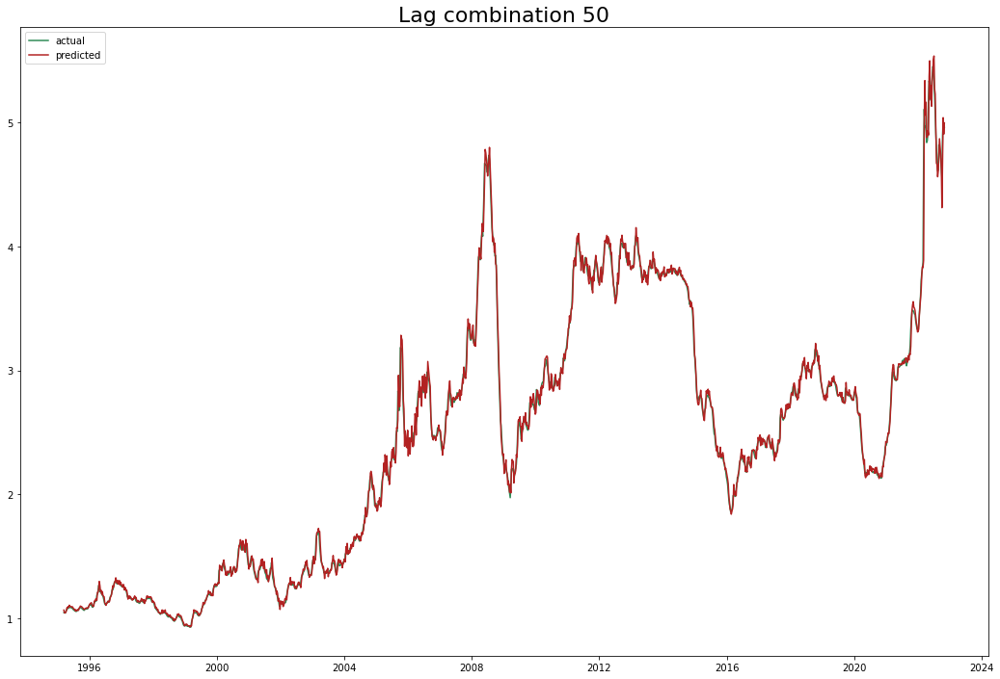

Test data rmse: 0.07527067585050427 Total rmse: 0.05152889315915513
Test data mape: 0.011712207939405857 Total mape: 0.013535067713661818


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


In [770]:
svr_grid_list, summary_data = test_mdl(df1.columns[3:-1],svr,params_svr,'SVR')

We can see the results of fitting the model above. I have tested differnt parameters on different lag numbers. Fitting models using only last 300-400 values resulted in huge mape values.

### ARIMA

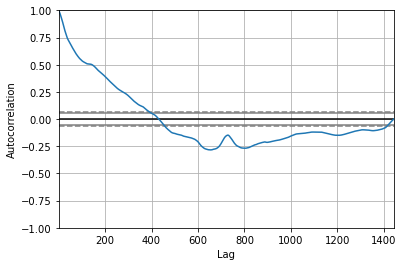

-1.3392612725298667 0.6110244087291025


In [771]:
from statsmodels.tsa.arima.model import ARIMA
from pandas.plotting import autocorrelation_plot
from statsmodels.tsa.stattools import adfuller, acf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

df2 = df
# For ARIMA i will use only the most recent data
autocorrelation_plot(df2['Diesel price'])
plt.show()
res = adfuller(df2['Diesel price'])
print(res[0],res[1])

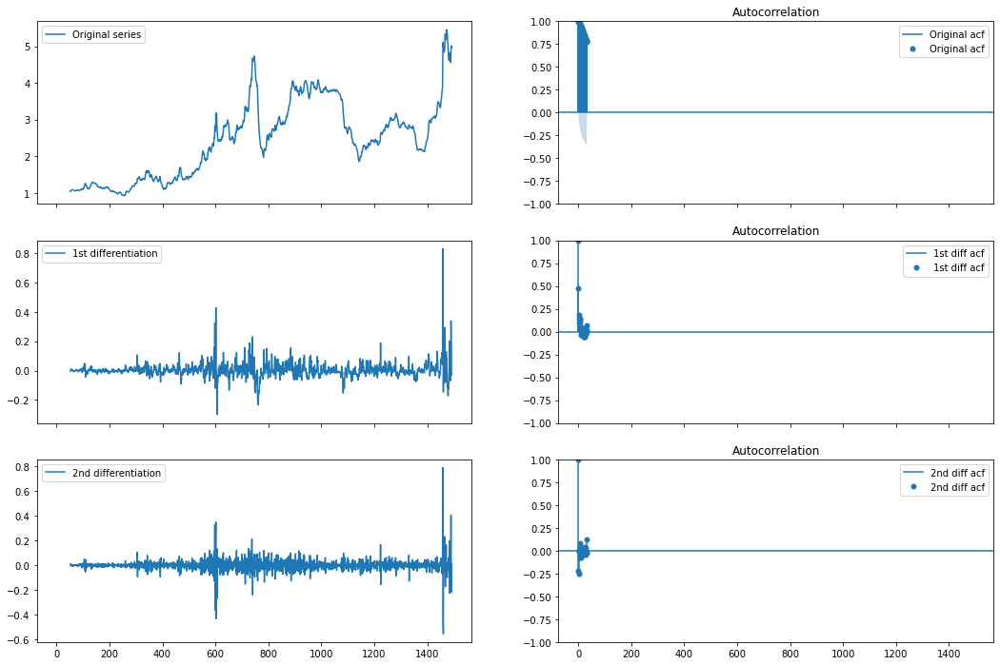

In [772]:
fig, ax = plt.subplots(3, 2, sharex=True,figsize=(18,12))
ax=ax.flatten()
ax[0].plot(df2['Diesel price'], label='Original series')
ax[0].legend()
plot_acf(df2['Diesel price'], label='Original acf',ax=ax[1])
ax[1].legend()
ax[2].plot(df2['Diesel price'].diff(),label='1st differentiation')
ax[2].legend()
plot_acf(df2['Diesel price'].diff().dropna(), label='1st diff acf',ax=ax[3])
ax[3].legend()
ax[4].plot(df2['Diesel price'].diff().diff(), label='2nd differentiation')
ax[4].legend()
plot_acf(df2['Diesel price'].diff().diff().dropna(), label='2nd diff acf',ax=ax[5])
ax[5].legend()

plt.show()


I performed differentiation of the data prior to fitting arima model. As we can see one step differentiation will be enough to obtain kind of stationary time series.

C:\Users\Tymoteusz\anaconda3\lib\site-packages\statsmodels\graphics\tsaplots.py:348: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


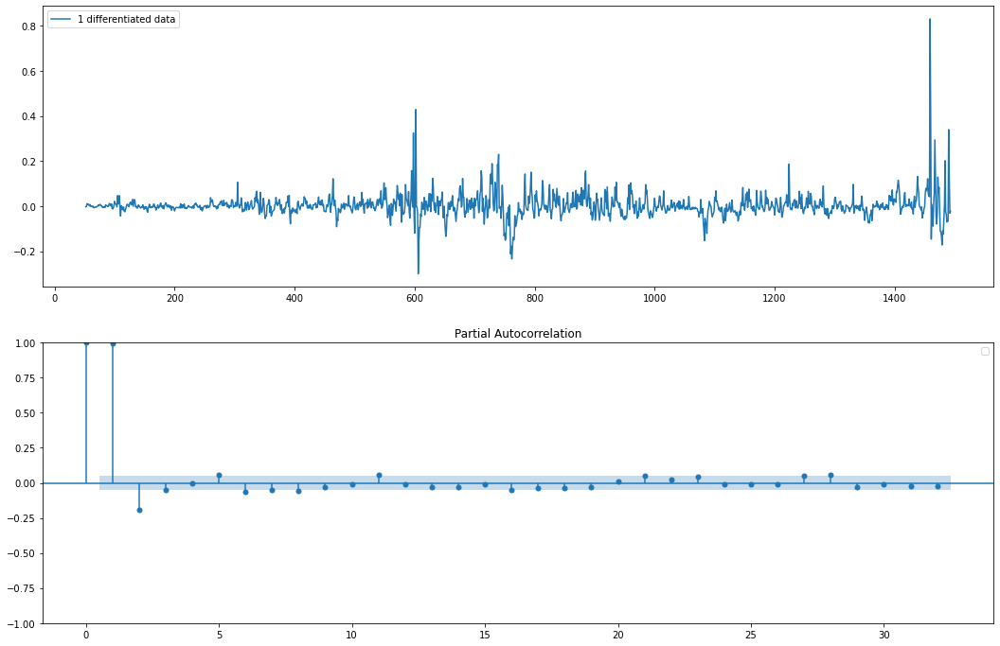

In [773]:
fig,ax = plt.subplots(2,1,figsize=(18,12))
ax = ax.flatten()
ax[0].plot(df2['Diesel price'].diff(),label='1 differentiated data')
ax[0].legend()
plot_pacf(df2['Diesel price'],ax=ax[1])
ax[1].legend()
plt.show()

C:\Users\Tymoteusz\anaconda3\lib\site-packages\statsmodels\graphics\tsaplots.py:348: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  warnings.warn(
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


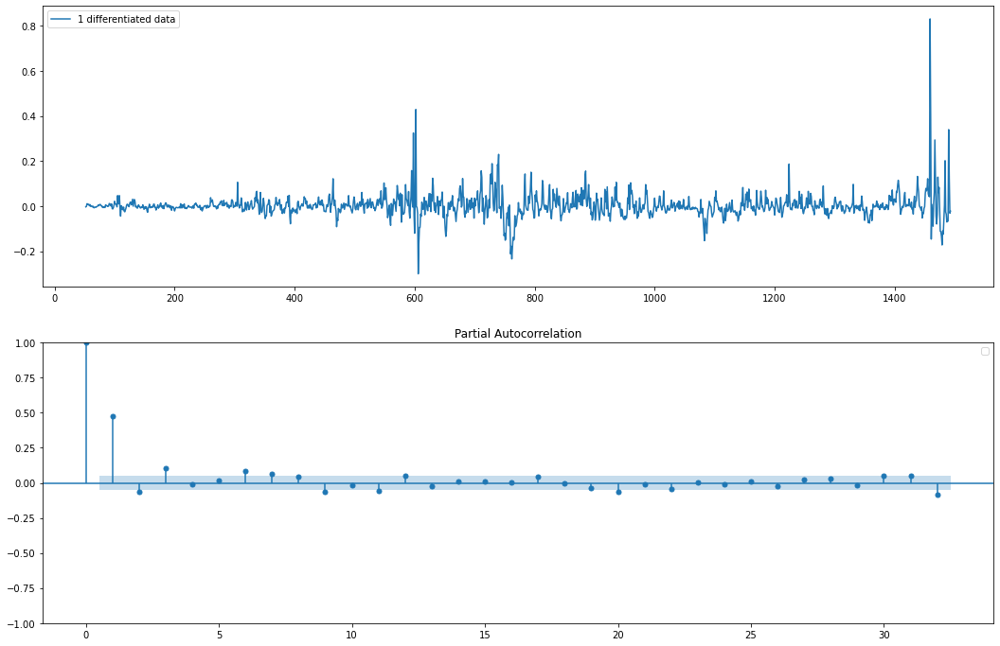

In [774]:
fig,ax = plt.subplots(2,1,figsize=(18,12))
ax = ax.flatten()
ax[0].plot(df2['Diesel price'].diff(),label='1 differentiated data')
ax[0].legend()
plot_pacf(df2['Diesel price'].diff().dropna(),ax=ax[1])
ax[1].legend()
plt.show()
# below data after 1st differentiation, looks good enough

In [775]:
arima_m = ARIMA(df2['Diesel price'],order=(1,1,2))
mdl3 = arima_m.fit()
print(mdl3.summary())
# lets check first arima model

C:\Users\Tymoteusz\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: An unsupported index was provided and will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)


                               SARIMAX Results                                
Dep. Variable:           Diesel price   No. Observations:                 1443
Model:                 ARIMA(1, 1, 2)   Log Likelihood                2417.497
Date:                Sat, 12 Nov 2022   AIC                          -4826.993
Time:                        21:02:35   BIC                          -4805.898
Sample:                             0   HQIC                         -4819.119
                               - 1443                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8330      0.037     22.425      0.000       0.760       0.906
ma.L1         -0.3241      0.043     -7.463      0.000      -0.409      -0.239
ma.L2         -0.2872      0.024    -12.066      0.0

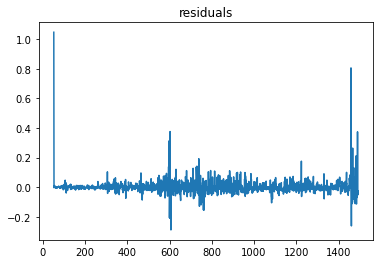

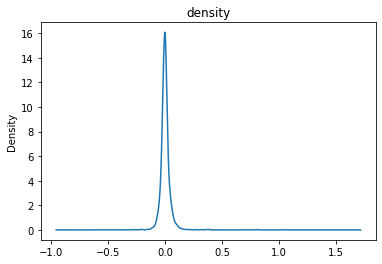

In [776]:
residuals = mdl3.resid
residuals.plot(title='residuals')
plt.show()
residuals.plot(kind='kde',title='density')
plt.show()
# The below code prints residuals from the model and their density

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\3963377367.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2_dec.drop(columns=['Date'],inplace=True)


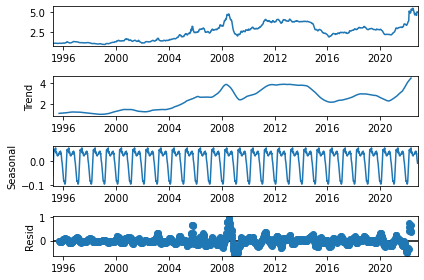

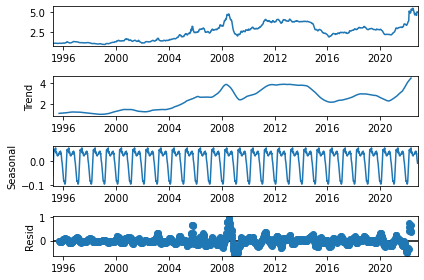

In [777]:
from statsmodels.tsa.seasonal import seasonal_decompose
df2_dec = df2[['Diesel price','Date']]
df2_dec.index = df2_dec['Date']
df2_dec.drop(columns=['Date'],inplace=True)
decomp_data = seasonal_decompose(df2_dec,model='additive')
decomp_data.plot()
#above code plots seasionality within the data

In [778]:
data1 = df2['Diesel price'].values
train,test = data1[0:int(len(data1) * 0.7)],data1[int(len(data1) * 0.7):len(data1)]
history = [i for i in train]
pred_arima = []
pred_auto_arima = []
# creating history set and sets for storin arima predictions

In [779]:
import pmdarima as pm

Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=3026.593, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=0.10 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=1675.031, Time=0.23 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=4698.009, Time=0.01 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-3621.895, Time=0.42 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=-3671.355, Time=0.61 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=0.13 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=-3669.877, Time=0.47 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=-3678.820, Time=0.37 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-3646.035, Time=0.91 sec
 ARIMA(3,0,2)(0,0,0)[0] intercept   : AIC=-3677.323, Time=0.91 sec
 ARIMA(2,0,3)(0,0,0)[0] intercept   : AIC=-3678.082, Time=1.31 sec
 ARIMA(1,0,3)(0,0,0)[0] intercept   : AIC=-3663.716, Time=0.58 sec
 ARIMA(3,0,3)(0,0,0)[0] intercept   : AIC=-3675.928, Time=1.92 sec
 ARIMA(2,0,2)(0,0,0)[0]           

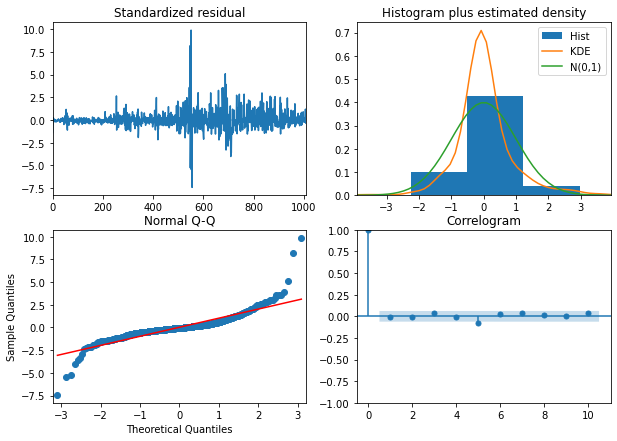

In [780]:
auto_model = pm.auto_arima(history,start_p=0,start_q=0,test='adf',max_p=5,max_q=5,d=None,stepwise=True,m=1,trace=True,error_action='ignore',suppress_warnings=True)
auto_model.plot_diagnostics(figsize=(10,7))
plt.show()

In [781]:
def auto_arima_manual_arima():
    for g in range(len(test)):
        mdl_arima = ARIMA(history, order=(1,1,2))
        mdl_fit = mdl_arima.fit()
        auto_model = pm.auto_arima(history,start_p=0,start_q=0,test='adf',max_p=4,max_q=4,d=None,stepwise=True,trace=True,error_action='ignore',suppress_warnings=True)
        prediction1 = mdl_fit.forecast()
        prediction2 = auto_model.predict()
        y1 = prediction1[0]
        y2 = prediction2[0]
        obs = test[g]
        history.append(obs)
        pred_arima.append(y1)
        pred_auto_arima.append(y2)

    mape1 = mean_absolute_percentage_error(test,pred_arima)
    rmse1 = np.sqrt(mean_squared_error(test,pred_arima))
    mape2 = mean_absolute_percentage_error(test,pred_auto_arima)
    rmse2 = np.sqrt(mean_squared_error(test,pred_auto_arima))
    print('Arima manual',mape1,rmse1)
    print('Auto arima',mape2,rmse2)
    return mape1,mape2,rmse1,rmse2
mape1, mape2, rmse1, rmse2 = auto_arima_manual_arima()
summary_data = summary_data.append({'Model': 'autoARIMA','mape test': mape2, 'rmse test': rmse2, 'mape total': 'NaN', 'rmse total': 'NaN','lags_used': 'NaN'},ignore_index=True)
summary_data = summary_data.append({'Model': 'ARIMA 1 1 2','mape test': mape1, 'rmse test': rmse1, 'mape total': 'NaN', 'rmse total': 'NaN','lags_used': 'NaN'},ignore_index=True)
# The above code finds the best p,d,q parameters for arima and prints the results. 
# I have also included model with manually inserted p,d,q values for comparison


Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=3026.593, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=0.10 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=1675.031, Time=0.24 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=4698.009, Time=0.01 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-3621.895, Time=0.43 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=-3671.355, Time=0.56 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=0.14 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=-3669.877, Time=0.45 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=-3678.820, Time=0.35 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-3646.035, Time=0.90 sec
 ARIMA(3,0,2)(0,0,0)[0] intercept   : AIC=-3677.323, Time=0.86 sec
 ARIMA(2,0,3)(0,0,0)[0] intercept   : AIC=-3678.082, Time=1.19 sec
 ARIMA(1,0,3)(0,0,0)[0] intercept   : AIC=-3663.716, Time=0.52 sec
 ARIMA(3,0,3)(0,0,0)[0] intercept   : AIC=-3675.928, Time=1.69 sec
 ARIMA(2,0,2)(0,0,0)[0]           

 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=0.33 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=-3702.337, Time=0.75 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=-3711.276, Time=0.34 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-3678.352, Time=0.63 sec
 ARIMA(3,0,2)(0,0,0)[0] intercept   : AIC=-3710.686, Time=1.27 sec
 ARIMA(2,0,3)(0,0,0)[0] intercept   : AIC=-3710.576, Time=1.34 sec
 ARIMA(1,0,3)(0,0,0)[0] intercept   : AIC=-3696.171, Time=0.69 sec
 ARIMA(3,0,3)(0,0,0)[0] intercept   : AIC=-3708.435, Time=1.12 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-3654.277, Time=0.53 sec

Best model:  ARIMA(2,0,2)(0,0,0)[0] intercept
Total fit time: 8.107 seconds
Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=3058.179, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=0.10 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=1695.518, Time=0.23 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=4745.474, Time=0.01 sec
 ARIMA(1,0,1)(0,0,0)[0] 

 ARIMA(3,0,3)(0,0,0)[0] intercept   : AIC=-3740.102, Time=1.48 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-3688.464, Time=0.68 sec

Best model:  ARIMA(2,0,2)(0,0,0)[0] intercept
Total fit time: 7.976 seconds
Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=3083.949, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=0.09 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=1711.464, Time=0.22 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=4786.132, Time=0.01 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-3689.608, Time=0.56 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=-3740.002, Time=0.27 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=0.30 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=-3738.657, Time=0.85 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=-3747.541, Time=0.37 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-3714.356, Time=0.69 sec
 ARIMA(3,0,2)(0,0,0)[0] intercept   : AIC=-3746.902, Time=1.21 sec
 ARIMA(2,0,3)(0,0,0)[0] 

 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-3713.176, Time=0.29 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=-3764.310, Time=0.74 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=0.14 sec
 ARIMA(3,0,1)(0,0,0)[0] intercept   : AIC=-3762.872, Time=0.69 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=-3771.933, Time=0.94 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=-3738.224, Time=0.59 sec
 ARIMA(3,0,2)(0,0,0)[0] intercept   : AIC=-3770.909, Time=1.16 sec
 ARIMA(2,0,3)(0,0,0)[0] intercept   : AIC=-3771.157, Time=0.57 sec
 ARIMA(1,0,3)(0,0,0)[0] intercept   : AIC=-3756.584, Time=0.67 sec
 ARIMA(3,0,3)(0,0,0)[0] intercept   : AIC=-3769.231, Time=1.34 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=-3716.624, Time=0.79 sec

Best model:  ARIMA(2,0,2)(0,0,0)[0] intercept
Total fit time: 8.268 seconds
Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=3109.781, Time=0.02 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=0.09 sec
 ARIMA(0,0,1)(0,0,0)[0

 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-3792.088, Time=0.56 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-3789.615, Time=0.52 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-3795.044, Time=0.09 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-3793.427, Time=0.15 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-3793.641, Time=0.05 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-3736.369, Time=0.19 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-3792.016, Time=0.37 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.950 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3470.641, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-3797.698, Time=0.17 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-3739.493, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3471.242, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-3796.056, Time=0.34 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-3796.302, Time=0.47 sec
 ARIMA(2,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-3831.651, Time=0.20 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-3831.896, Time=0.41 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-3829.445, Time=0.58 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-3834.945, Time=0.18 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-3833.318, Time=0.09 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-3833.524, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-3775.384, Time=0.10 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-3831.947, Time=0.36 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.697 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3505.587, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-3836.271, Time=0.17 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-3777.450, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3506.386, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-3834.606, Time=0.20 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-3869.502, Time=0.24 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-3869.745, Time=0.53 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-3867.248, Time=0.67 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-3872.696, Time=0.19 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-3871.090, Time=0.09 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-3871.299, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-3812.090, Time=0.16 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-3869.585, Time=0.34 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.904 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3541.469, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-3875.534, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-3815.191, Time=0.26 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3542.124, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-3873.919, Time=0.21 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-3907.500, Time=0.20 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-3907.695, Time=0.11 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-3906.041, Time=1.01 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-3910.843, Time=0.11 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-3909.225, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-3909.425, Time=0.05 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-3848.745, Time=0.09 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-3907.745, Time=0.48 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.106 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3571.223, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-3911.392, Time=0.19 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-3849.171, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3572.369, Time=0.05 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-3909.832, Time=0.19 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-3945.459, Time=0.23 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-3945.692, Time=0.13 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-3943.983, Time=1.14 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-3948.806, Time=0.16 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-3947.242, Time=0.13 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-3947.480, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-3886.390, Time=0.18 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-3944.926, Time=0.25 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.032 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3608.332, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-3951.460, Time=0.18 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-3889.261, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3609.616, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-3949.876, Time=0.21 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-3985.381, Time=0.23 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-3985.608, Time=0.24 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-3983.102, Time=0.55 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-3988.795, Time=0.11 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-3987.217, Time=0.28 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-3987.448, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-3925.932, Time=0.11 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-3985.768, Time=0.47 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.992 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3644.566, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-3991.218, Time=0.21 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-3928.315, Time=0.30 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3646.022, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-3989.635, Time=0.31 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4023.518, Time=0.28 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4023.782, Time=0.19 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4021.968, Time=0.95 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4026.941, Time=0.10 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4025.424, Time=0.15 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4025.689, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-3962.149, Time=0.19 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4023.053, Time=0.27 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.925 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3677.115, Time=0.11 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4029.693, Time=0.26 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-3964.850, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3678.805, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4028.180, Time=0.27 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4058.519, Time=0.22 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4058.781, Time=0.10 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4056.144, Time=0.46 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4061.880, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4060.368, Time=0.14 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4060.634, Time=0.05 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-3996.984, Time=0.23 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4057.987, Time=0.26 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.150 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3708.642, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4063.162, Time=0.20 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-3997.681, Time=0.23 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3710.108, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4061.699, Time=0.22 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4093.973, Time=0.33 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4094.366, Time=0.52 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4091.464, Time=0.53 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4097.179, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4095.774, Time=0.26 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4096.100, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4031.595, Time=0.12 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4093.254, Time=0.28 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.976 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3743.839, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4100.076, Time=0.16 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4034.638, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3745.157, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4098.662, Time=0.30 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4130.871, Time=0.23 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4131.246, Time=0.48 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4128.405, Time=0.96 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4134.101, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4132.665, Time=0.13 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4132.974, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4068.825, Time=0.19 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4130.189, Time=0.24 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.066 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3779.126, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4136.835, Time=0.25 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4071.862, Time=0.26 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3780.466, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4135.361, Time=0.20 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4169.669, Time=0.21 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4169.913, Time=0.12 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4168.406, Time=0.92 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4172.986, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4171.443, Time=0.19 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4171.692, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4107.822, Time=0.18 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4170.163, Time=0.47 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.171 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3815.060, Time=0.20 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4175.795, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4110.757, Time=0.27 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3816.317, Time=0.13 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4174.245, Time=0.34 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4206.168, Time=0.23 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4206.510, Time=0.44 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4204.634, Time=1.01 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4209.355, Time=0.13 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4207.895, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4208.182, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4142.986, Time=0.18 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4206.341, Time=0.44 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.200 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3850.245, Time=0.11 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4212.085, Time=0.21 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4145.902, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3851.376, Time=0.14 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4210.618, Time=0.22 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4247.592, Time=0.24 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4247.862, Time=0.14 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4246.069, Time=1.25 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4250.817, Time=0.12 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4249.342, Time=0.15 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4249.617, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4184.055, Time=0.14 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4247.800, Time=0.40 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.317 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3889.041, Time=0.21 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4253.739, Time=0.27 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4187.167, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3890.208, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4252.252, Time=0.23 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4287.236, Time=0.34 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4287.471, Time=0.13 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4285.834, Time=0.98 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4290.540, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4289.001, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4289.241, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4223.673, Time=0.14 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4287.581, Time=0.47 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.144 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3925.519, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4293.332, Time=0.16 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4226.503, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3926.733, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4291.788, Time=0.23 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4325.965, Time=0.33 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4326.156, Time=0.21 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4323.757, Time=0.58 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4329.375, Time=0.10 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4327.752, Time=0.25 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4327.947, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4262.684, Time=0.18 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4326.516, Time=0.42 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.871 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3961.842, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4332.240, Time=0.26 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4265.673, Time=0.30 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3963.124, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4330.609, Time=0.29 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4341.541, Time=0.21 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4341.829, Time=0.58 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4339.191, Time=0.79 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4344.728, Time=0.10 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4343.187, Time=0.17 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4343.429, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4279.404, Time=0.12 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4340.824, Time=0.28 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.124 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-3981.563, Time=0.23 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4347.355, Time=0.48 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4282.568, Time=0.33 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-3982.467, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4345.688, Time=0.34 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4382.178, Time=0.47 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4382.350, Time=0.14 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4380.800, Time=1.00 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4385.457, Time=0.12 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4383.805, Time=0.12 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4383.983, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4319.289, Time=0.12 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4382.405, Time=0.51 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.705 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4019.599, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4388.161, Time=0.18 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4322.430, Time=0.25 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4020.434, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4386.489, Time=0.23 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4419.775, Time=0.23 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4420.015, Time=0.44 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4417.501, Time=0.63 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4422.934, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4421.339, Time=0.16 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4421.545, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4356.046, Time=0.14 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4419.796, Time=0.47 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.142 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4055.818, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4425.408, Time=0.30 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4358.841, Time=0.27 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4056.472, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4423.806, Time=0.24 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4457.921, Time=0.25 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4458.185, Time=0.43 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4455.548, Time=1.19 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4461.062, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4459.523, Time=0.19 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4459.751, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4393.110, Time=0.13 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4457.753, Time=0.43 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.650 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4092.163, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4463.371, Time=0.16 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4395.889, Time=0.29 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4092.808, Time=0.05 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4461.803, Time=0.61 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4493.807, Time=0.25 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4494.098, Time=0.47 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4491.395, Time=0.75 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4496.758, Time=0.12 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4495.256, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4495.507, Time=0.08 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4428.273, Time=0.13 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4493.427, Time=0.60 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.630 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4126.452, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4499.644, Time=0.22 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4431.924, Time=0.35 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4126.731, Time=0.11 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4498.099, Time=0.25 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4533.491, Time=0.25 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4533.774, Time=0.94 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4531.082, Time=0.54 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4536.511, Time=0.13 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4535.003, Time=0.14 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4535.249, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4467.771, Time=0.11 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4533.170, Time=0.55 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.578 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4164.549, Time=0.20 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4539.688, Time=0.29 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4471.359, Time=0.46 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4164.926, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4538.162, Time=0.62 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4574.785, Time=0.24 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4575.071, Time=0.45 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4572.372, Time=0.85 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4577.766, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4576.263, Time=0.12 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4576.511, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4508.582, Time=0.12 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4574.422, Time=0.54 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.159 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4203.072, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4580.471, Time=0.24 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4511.621, Time=0.26 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4203.312, Time=0.16 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4578.962, Time=0.24 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4609.576, Time=0.29 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4609.833, Time=0.49 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4607.236, Time=0.71 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4612.623, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4611.068, Time=0.16 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4611.292, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4543.796, Time=0.13 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4609.355, Time=0.46 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.208 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4235.326, Time=0.22 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4614.648, Time=0.31 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4545.894, Time=0.42 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4235.728, Time=0.09 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4613.113, Time=0.37 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4649.339, Time=0.35 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4649.641, Time=0.59 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4646.908, Time=0.74 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4652.437, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4650.949, Time=0.11 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4651.207, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4582.034, Time=0.11 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4649.143, Time=0.51 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.414 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4270.874, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4655.507, Time=0.18 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4585.454, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4271.607, Time=0.09 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4654.003, Time=0.59 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4690.323, Time=0.40 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4690.612, Time=0.53 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4687.918, Time=0.83 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4693.402, Time=0.09 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4691.896, Time=0.11 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4692.145, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4622.546, Time=0.11 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4690.125, Time=0.74 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.993 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4309.037, Time=0.19 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4696.539, Time=0.28 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4626.006, Time=0.36 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4309.622, Time=0.11 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4695.019, Time=0.53 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4731.661, Time=0.35 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4731.947, Time=0.47 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4729.267, Time=1.09 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4734.753, Time=0.10 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4733.241, Time=0.09 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4733.487, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4663.527, Time=0.11 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4731.500, Time=0.60 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.715 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4347.107, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4737.543, Time=0.19 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4666.518, Time=0.26 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4347.748, Time=0.09 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4736.018, Time=0.23 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4773.594, Time=0.25 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4773.834, Time=0.14 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4771.186, Time=0.85 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4776.712, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4775.208, Time=0.16 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4775.457, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4704.725, Time=0.14 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4772.781, Time=0.35 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.884 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4385.986, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4779.530, Time=0.24 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4707.794, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4386.747, Time=0.18 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4778.016, Time=0.25 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4805.371, Time=0.25 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4805.685, Time=0.42 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4802.898, Time=0.60 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4808.444, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4806.987, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4807.256, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4737.092, Time=0.12 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4805.127, Time=0.55 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.002 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4419.952, Time=0.22 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4811.492, Time=0.28 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4740.568, Time=0.32 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4420.658, Time=0.18 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4810.011, Time=0.35 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4847.293, Time=0.21 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4847.621, Time=0.72 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4844.803, Time=0.51 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4850.368, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4848.926, Time=0.12 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4849.207, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4778.631, Time=0.14 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4847.090, Time=0.66 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.291 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4459.495, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4853.375, Time=0.25 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4781.937, Time=0.26 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4460.262, Time=0.14 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4851.923, Time=0.19 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4885.737, Time=0.24 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4886.002, Time=0.11 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4883.937, Time=0.96 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4888.868, Time=0.10 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4887.415, Time=0.09 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4887.688, Time=0.05 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4816.595, Time=0.24 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4885.591, Time=0.46 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.873 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4494.587, Time=0.11 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4891.970, Time=0.20 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4819.856, Time=0.34 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4495.504, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4890.501, Time=0.20 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4923.465, Time=0.24 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4923.835, Time=0.54 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4920.878, Time=0.93 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4926.654, Time=0.05 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4925.285, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4925.598, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4851.050, Time=0.10 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4922.688, Time=0.24 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.015 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4522.547, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4929.609, Time=0.17 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4854.129, Time=0.36 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4523.926, Time=0.15 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4928.231, Time=0.50 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4963.404, Time=0.34 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4963.724, Time=0.19 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4960.798, Time=0.56 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4966.597, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4965.245, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4965.568, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4890.393, Time=0.18 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4962.631, Time=0.24 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.416 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4559.195, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4969.191, Time=0.16 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4893.079, Time=0.29 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4560.649, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4967.831, Time=0.24 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5005.320, Time=0.28 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-5005.719, Time=0.97 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-5002.683, Time=0.80 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-5008.490, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-5007.163, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-5007.498, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4931.686, Time=0.19 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-5004.518, Time=0.23 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.577 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4599.040, Time=0.11 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-5011.433, Time=0.17 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4934.724, Time=0.30 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4600.516, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5010.098, Time=0.34 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5047.628, Time=0.25 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-5047.964, Time=0.21 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-5044.979, Time=0.82 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-5050.797, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-5049.480, Time=0.16 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-5049.820, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4973.500, Time=0.16 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-5046.823, Time=0.24 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.630 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4638.773, Time=0.20 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-5053.716, Time=0.26 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4976.486, Time=0.27 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4640.275, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5052.394, Time=0.23 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5085.582, Time=0.27 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-5085.941, Time=0.13 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-5082.887, Time=0.74 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-5088.608, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-5087.336, Time=0.13 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-5087.700, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-5010.095, Time=0.27 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-5084.630, Time=0.26 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.707 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4672.563, Time=0.11 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-5091.224, Time=0.23 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-5013.156, Time=0.26 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4673.820, Time=0.17 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5089.948, Time=0.22 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5121.628, Time=0.29 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-5122.120, Time=0.41 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-5118.829, Time=0.57 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-5124.414, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-5123.242, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-5123.658, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-5043.522, Time=0.11 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-5120.991, Time=0.51 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.904 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4695.169, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-5124.443, Time=0.19 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-5042.699, Time=0.39 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4695.873, Time=0.10 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5123.280, Time=0.20 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5158.933, Time=0.23 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-5159.370, Time=0.86 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-5156.202, Time=0.79 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-5161.747, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-5160.520, Time=0.10 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-5160.895, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-5077.813, Time=0.12 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-5157.766, Time=0.28 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.275 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4727.900, Time=0.15 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-5164.903, Time=0.27 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-5081.335, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4728.483, Time=0.10 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5163.657, Time=0.31 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5198.842, Time=0.20 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-5199.249, Time=0.51 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-5196.815, Time=0.87 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-5201.644, Time=0.10 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-5200.366, Time=0.24 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-5200.718, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-5117.564, Time=0.19 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-5197.674, Time=0.31 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.152 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4764.644, Time=0.22 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-5204.242, Time=0.16 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-5120.627, Time=0.27 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4764.992, Time=0.08 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5202.942, Time=0.27 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5238.595, Time=0.22 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-5239.019, Time=0.36 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-5235.886, Time=0.54 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-5241.345, Time=0.09 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-5240.102, Time=0.09 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-5240.468, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-5156.784, Time=0.18 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-5237.365, Time=0.26 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.445 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4802.569, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-5243.892, Time=0.15 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-5160.064, Time=0.24 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4802.875, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5242.572, Time=0.26 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5269.520, Time=0.32 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-5269.893, Time=0.75 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-5267.541, Time=1.20 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-5272.129, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-5270.823, Time=0.15 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-5271.151, Time=0.07 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-5185.144, Time=0.17 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-5268.161, Time=0.27 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 3.605 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4825.076, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-5275.622, Time=0.25 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-5189.296, Time=0.28 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4824.733, Time=0.09 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5274.273, Time=0.31 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5310.210, Time=0.35 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-5310.591, Time=0.39 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-5307.545, Time=0.58 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-5312.886, Time=0.05 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-5311.607, Time=0.14 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-5311.943, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-5224.817, Time=0.16 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-5308.910, Time=0.25 sec

Best model:  ARIMA(1,1,0)(0,0,0)[0]          
Total fit time: 2.744 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4860.579, Time=0.17 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-5313.899, Time=0.16 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-5226.482, Time=0.40 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4860.427, Time=0.06 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-5312.575, Time=0.59 sec
 ARIMA(1,

 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4916.783, Time=0.24 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-4917.569, Time=0.72 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4913.630, Time=0.50 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-4917.818, Time=0.07 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4917.070, Time=0.11 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-4917.744, Time=0.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-4838.148, Time=0.12 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4925.618, Time=0.49 sec
 ARIMA(3,1,1)(0,0,0)[0]             : AIC=-4927.137, Time=0.68 sec
 ARIMA(3,1,0)(0,0,0)[0]             : AIC=-4927.519, Time=0.16 sec
 ARIMA(4,1,0)(0,0,0)[0]             : AIC=-4926.671, Time=0.21 sec
 ARIMA(4,1,1)(0,0,0)[0]             : AIC=-4926.491, Time=0.91 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=-4927.033, Time=0.42 sec

Best model:  ARIMA(3,1,0)(0,0,0)[0]          
Total fit time: 5.451 seconds
Performing stepwise search to minimize aic
 ARIMA(0,

 ARIMA(3,1,1)(0,0,0)[0]             : AIC=-4891.445, Time=0.50 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4876.329, Time=0.46 sec
 ARIMA(4,1,1)(0,0,0)[0]             : AIC=-4889.453, Time=0.84 sec

Best model:  ARIMA(3,1,0)(0,0,0)[0]          
Total fit time: 7.937 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4488.929, Time=0.12 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4868.007, Time=0.16 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4846.853, Time=0.27 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4486.609, Time=0.09 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4868.567, Time=0.34 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=-4895.327, Time=0.38 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=-4893.840, Time=0.36 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=-4893.822, Time=1.31 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4879.201, Time=1.01 sec
 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=-4891.707, Time=0.93 sec
 ARIMA(3,

 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4841.748, Time=0.15 sec
 ARIMA(4,1,0)(0,0,0)[0]             : AIC=-4861.116, Time=0.24 sec
 ARIMA(3,1,1)(0,0,0)[0]             : AIC=-4861.168, Time=0.47 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4852.365, Time=0.37 sec
 ARIMA(4,1,1)(0,0,0)[0]             : AIC=-4859.243, Time=0.63 sec

Best model:  ARIMA(3,1,0)(0,0,0)[0]          
Total fit time: 6.905 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4465.613, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4843.473, Time=0.19 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4827.588, Time=0.44 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4462.418, Time=0.09 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4846.183, Time=0.27 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=-4867.048, Time=0.28 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=-4865.178, Time=0.36 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=-4865.238, Time=1.25 sec
 ARIMA(2,

C:\Users\Tymoteusz\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4465.904, Time=0.13 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4851.536, Time=0.29 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4832.704, Time=0.61 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4463.439, Time=0.20 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4854.359, Time=0.28 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=-4872.232, Time=0.30 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=-4870.594, Time=0.37 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=-4870.586, Time=0.44 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4864.440, Time=1.04 sec
 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=-4868.785, Time=0.47 sec
 ARIMA(3,1,0)(0,0,0)[0]             : AIC=-4873.001, Time=0.22 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4854.732, Time=0.10 sec
 ARIMA(4,1,0)(0,0,0)[0]             : AIC=-4871.318, Time=0.22 sec
 ARIMA(3,1,1)(0,0,0)[0]             : AIC=-4871.277, Time=0.27 sec
 ARIMA(2,1,1)(0,0,0

 ARIMA(4,1,1)(0,0,0)[0]             : AIC=-4865.169, Time=0.30 sec

Best model:  ARIMA(3,1,0)(0,0,0)[0]          
Total fit time: 6.009 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4454.457, Time=0.18 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4844.849, Time=0.24 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4822.345, Time=0.37 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4452.710, Time=0.18 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4846.891, Time=0.24 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=-4864.194, Time=0.49 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=-4862.568, Time=0.36 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=-4862.371, Time=0.40 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4855.685, Time=1.01 sec
 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=-4860.624, Time=0.44 sec
 ARIMA(3,1,0)(0,0,0)[0]             : AIC=-4865.081, Time=0.31 sec
 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-4847.499, Time=0.11 sec
 ARIMA(4,

 ARIMA(3,1,1)(0,0,0)[0]             : AIC=-4814.044, Time=0.48 sec
 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-4807.969, Time=0.55 sec
 ARIMA(4,1,1)(0,0,0)[0]             : AIC=-4812.048, Time=0.69 sec

Best model:  ARIMA(3,1,0)(0,0,0)[0]          
Total fit time: 7.068 seconds
Performing stepwise search to minimize aic
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-4428.442, Time=0.14 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-4799.952, Time=0.17 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-4782.005, Time=0.38 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-4426.458, Time=0.18 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-4803.279, Time=0.36 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=-4818.313, Time=0.39 sec
 ARIMA(4,1,0)(0,0,0)[0] intercept   : AIC=-4816.578, Time=0.33 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=-4816.600, Time=1.45 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-4810.418, Time=1.05 sec
 ARIMA(4,1,1)(0,0,0)[0] intercept   : AIC=-4814.534, Time=0.55 sec
 ARIMA(3,

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\1368727760.py:23: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  summary_data = summary_data.append({'Model': 'autoARIMA','mape test': mape2, 'rmse test': rmse2, 'mape total': 'NaN', 'rmse total': 'NaN','lags_used': 'NaN'},ignore_index=True)
C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\1368727760.py:24: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  summary_data = summary_data.append({'Model': 'ARIMA 1 1 2','mape test': mape1, 'rmse test': rmse1, 'mape total': 'NaN', 'rmse total': 'NaN','lags_used': 'NaN'},ignore_index=True)


In [782]:
print(auto_model.summary())

                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                 1010
Model:               SARIMAX(2, 0, 2)   Log Likelihood                1845.410
Date:                Sat, 12 Nov 2022   AIC                          -3678.820
Time:                        21:29:42   BIC                          -3649.314
Sample:                             0   HQIC                         -3667.611
                               - 1010                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.0032      0.002      1.650      0.099      -0.001       0.007
ar.L1          1.7508      0.044     39.597      0.000       1.664       1.837
ar.L2         -0.7522      0.044    -17.022      0.0

### RandomForestRegressor

--------------------------
Next model: 
Lags choosen:  ['1w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.108) r2: (test=0.617) total time=   0.2s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.145) neg_root_mean_squared_error: (test=-0.520) r2: (test=-0.255) total time=   0.2s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.477) r2: (test=0.487) total time=   0.3s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.076) r2: (test=0.969) total time=   0.4s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.992) total time=   0.4s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test

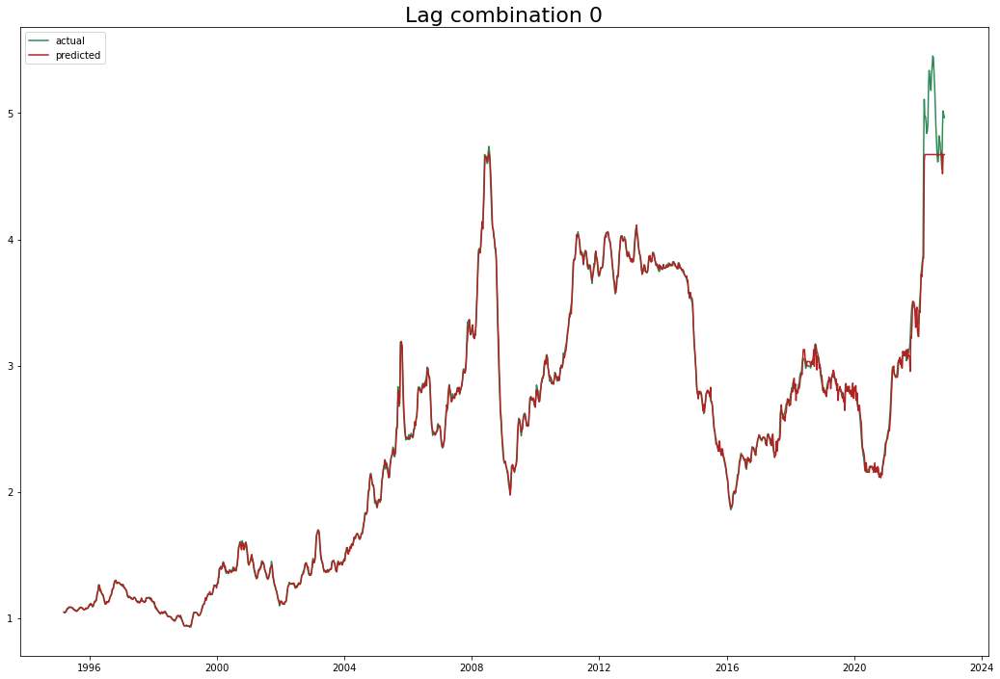

Test data rmse: 0.1588897015869316 Total rmse: 0.07402180019935344
Test data mape: 0.02037741232684494 Total mape: 0.009420153746957507
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.611) total time=   0.2s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.536) r2: (test=-0.330) total time=   0.3s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.073) neg_root_mean_squared_error: (test=-0.482) r2: (test=0.476) total time=   0.4s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.979) total time=   0.4s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.996) total time=   0.5s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.611) total time=   0.7s
[CV 2/5] END n_estimators=1000; neg_me

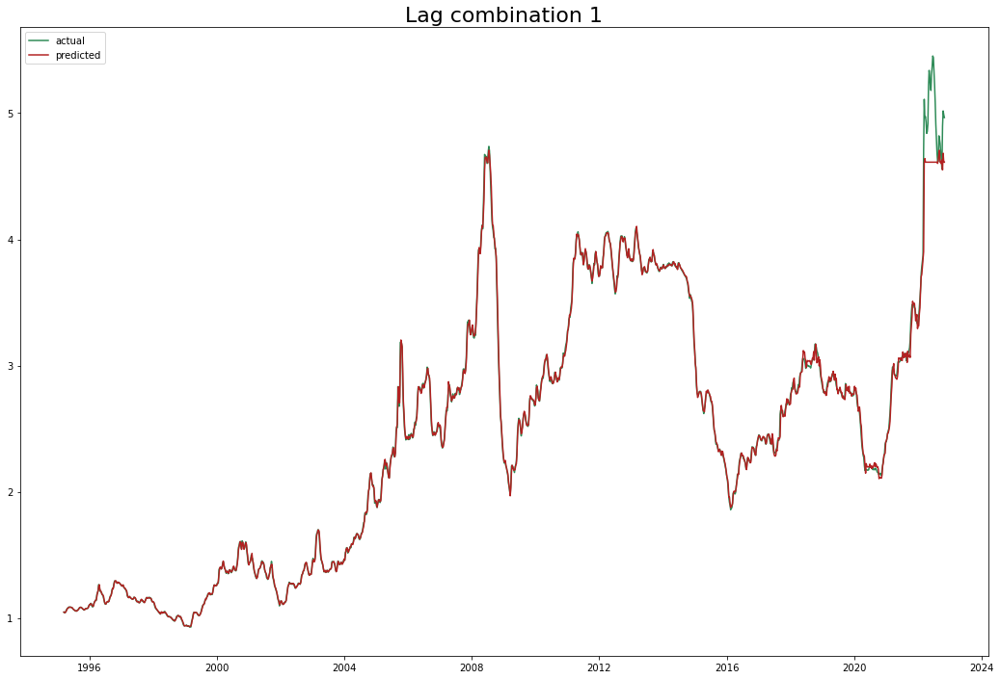

Test data rmse: 0.16767691621170108 Total rmse: 0.07659008247182024
Test data mape: 0.018479353698079095 Total mape: 0.007442849614588104
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.054) neg_root_mean_squared_error: (test=-0.111) r2: (test=0.591) total time=   0.2s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.152) neg_root_mean_squared_error: (test=-0.539) r2: (test=-0.349) total time=   0.3s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.074) neg_root_mean_squared_error: (test=-0.501) r2: (test=0.433) total time=   0.4s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.982) total time=   0.5s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.996) total time=   0.6s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.054) neg_root_mean_squared_error: (test=-0.111) r2: (test=0.592) total time=   0.7s
[CV 2/5] END n_estimators=1000; neg_me

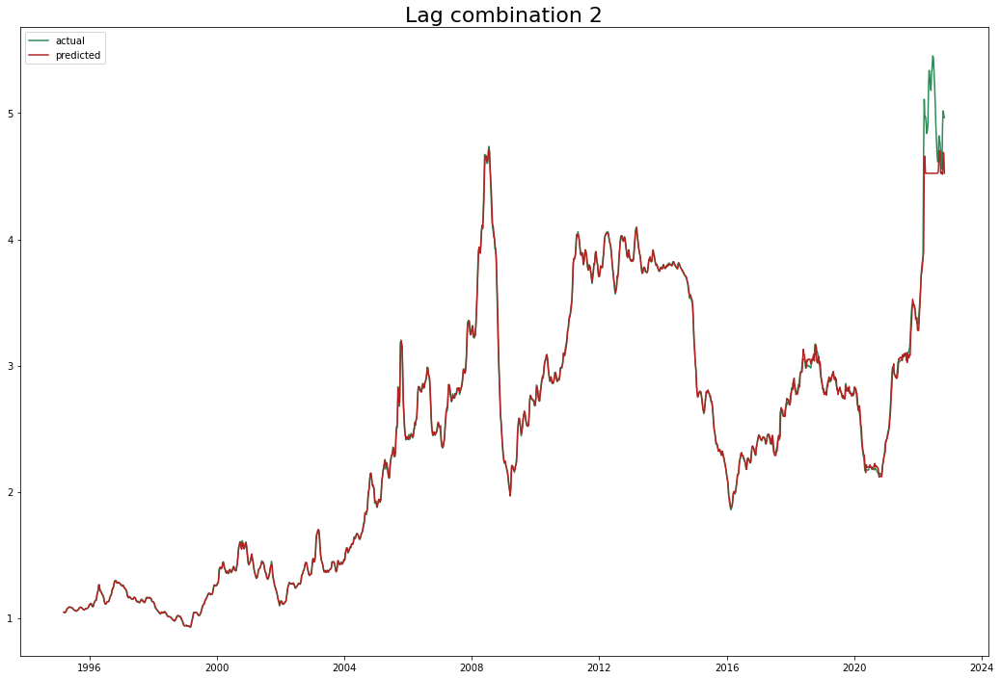

Test data rmse: 0.18735747389075194 Total rmse: 0.08514509709011257
Test data mape: 0.019764940004533677 Total mape: 0.007619536411273773
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.573) total time=   0.3s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.152) neg_root_mean_squared_error: (test=-0.539) r2: (test=-0.346) total time=   0.4s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.077) neg_root_mean_squared_error: (test=-0.518) r2: (test=0.394) total time=   0.5s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.057) r2: (test=0.982) total time=   0.6s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.996) total time=   0.8s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.576) total time=   0.7s
[CV 2/5] END n_estimators=1000; neg_me

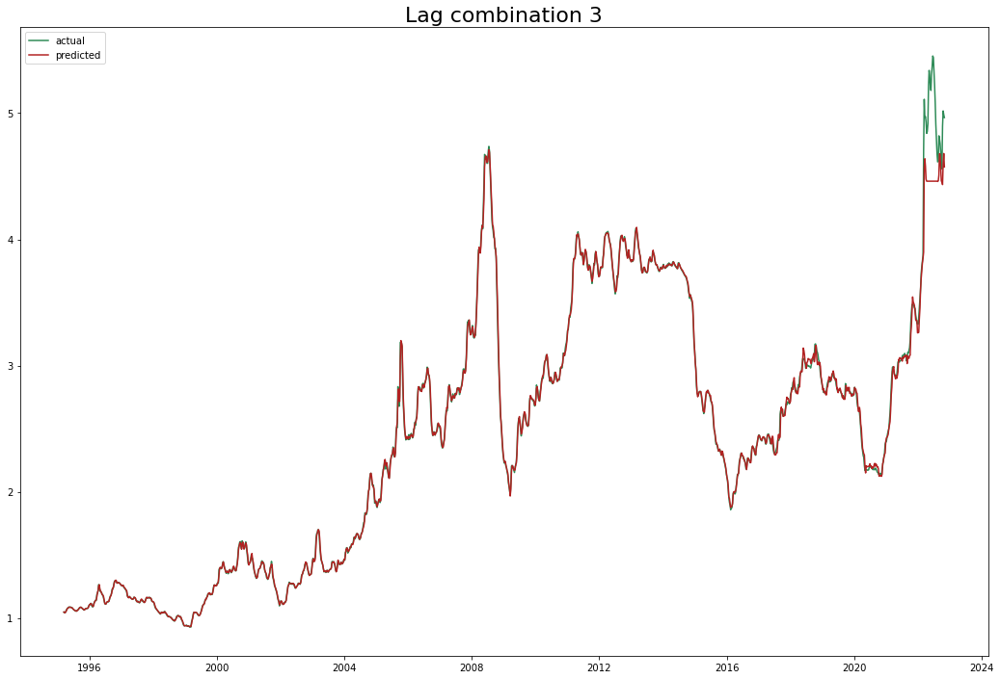

Test data rmse: 0.20269979464142912 Total rmse: 0.09182075391910473
Test data mape: 0.021235545437876865 Total mape: 0.007864779680940372
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.575) total time=   0.2s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.150) neg_root_mean_squared_error: (test=-0.535) r2: (test=-0.328) total time=   0.3s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.534) r2: (test=0.357) total time=   0.5s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.055) r2: (test=0.984) total time=   0.6s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.996) total time=   0.8s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.575) total time=   0.7s
[CV 2/5] END n_estimators=1000; neg_me

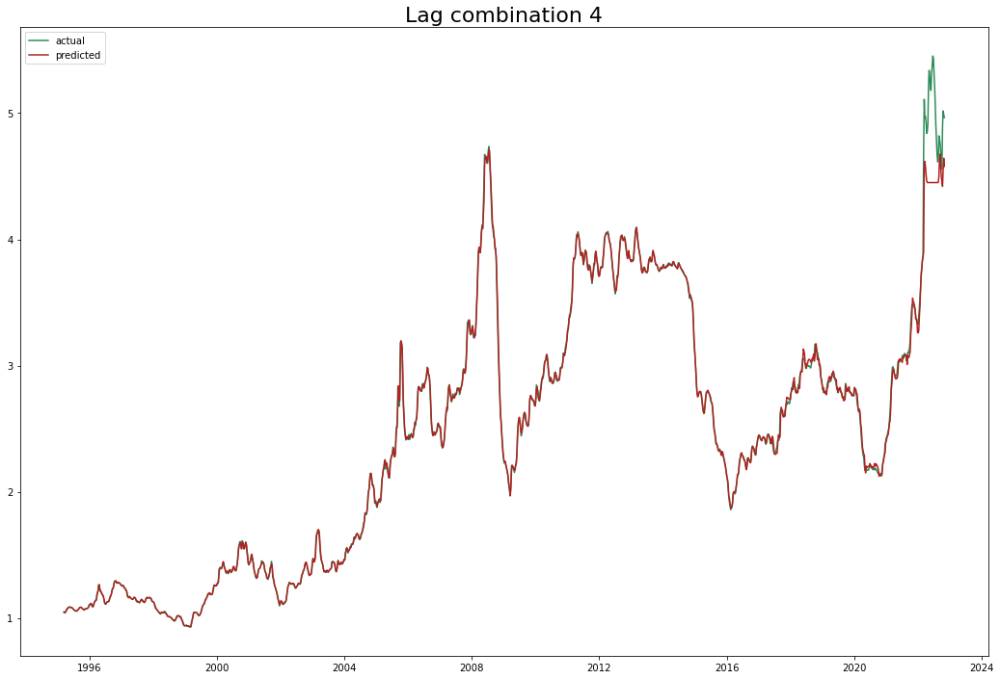

Test data rmse: 0.2054049255784141 Total rmse: 0.09306156675260098
Test data mape: 0.021090789432723526 Total mape: 0.007817681707061444
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.578) total time=   0.3s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.536) r2: (test=-0.333) total time=   0.4s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.535) r2: (test=0.355) total time=   0.6s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.056) r2: (test=0.984) total time=   0.8s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.996) total time=   1.0s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.054) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.578) total time=   0.8s
[CV 2/5] END n_estimators=1000; neg_me

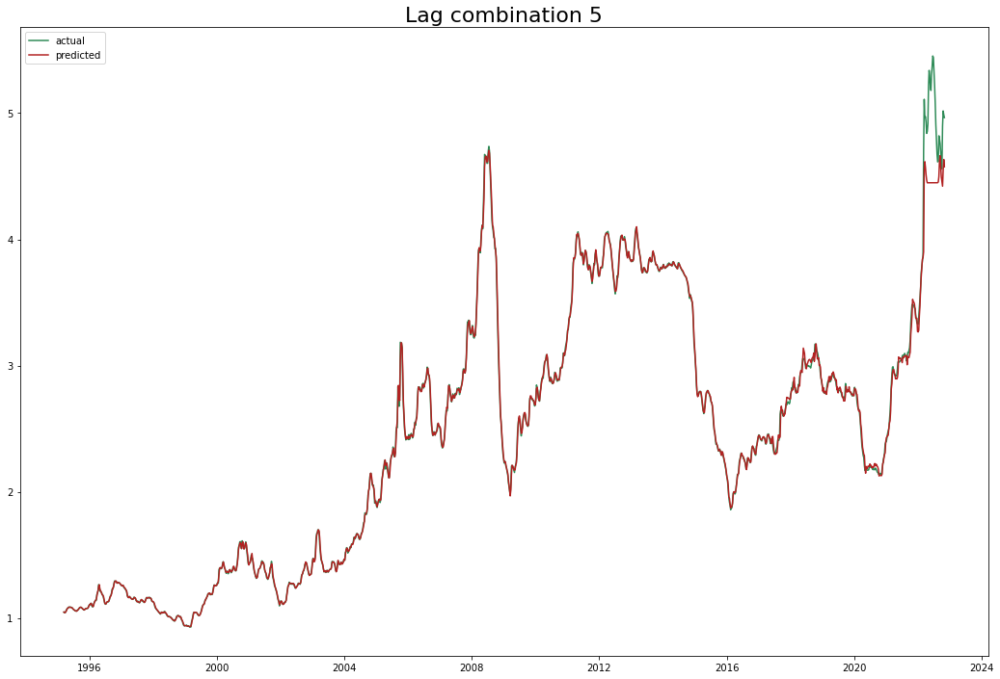

Test data rmse: 0.2058873679895689 Total rmse: 0.09320497090726629
Test data mape: 0.02110957469245795 Total mape: 0.0077777694245590645
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.573) total time=   0.3s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.152) neg_root_mean_squared_error: (test=-0.539) r2: (test=-0.347) total time=   0.5s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.538) r2: (test=0.348) total time=   0.7s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.057) r2: (test=0.983) total time=   0.8s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.996) total time=   1.1s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.573) total time=   0.8s
[CV 2/5] END n_estimators=1000; neg_me

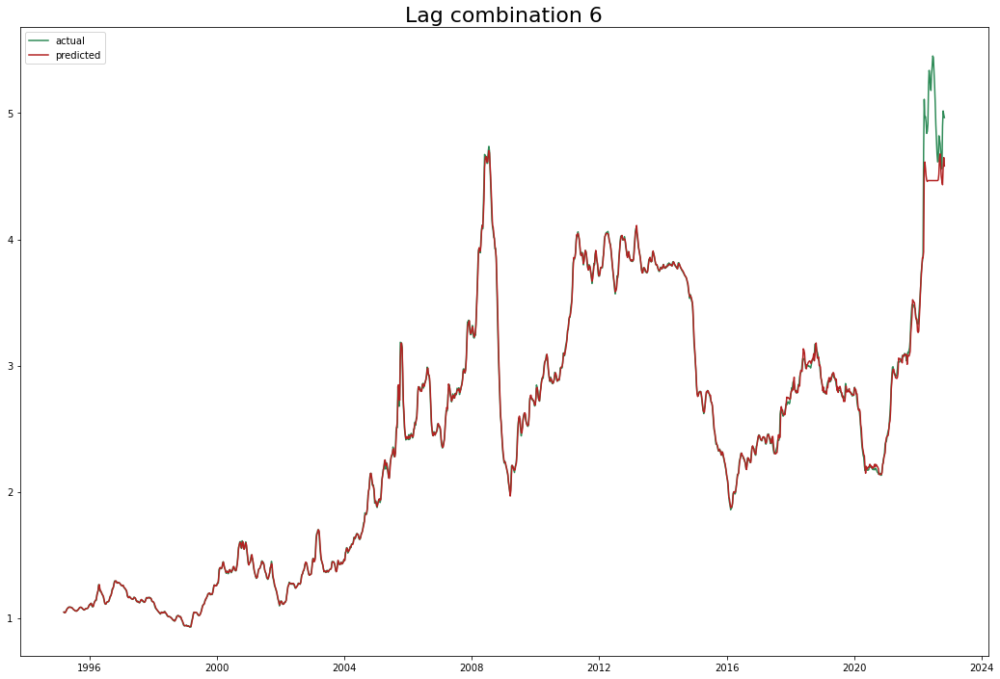

Test data rmse: 0.20174230399852827 Total rmse: 0.09140751598324287
Test data mape: 0.020332547405909413 Total mape: 0.007588868272181362
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.569) total time=   0.3s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.153) neg_root_mean_squared_error: (test=-0.542) r2: (test=-0.362) total time=   0.5s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.536) r2: (test=0.352) total time=   0.7s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.060) r2: (test=0.981) total time=   0.9s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.996) total time=   1.2s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.567) total time=   0.9s
[CV 2/5] END n_estimators=1000; neg_me

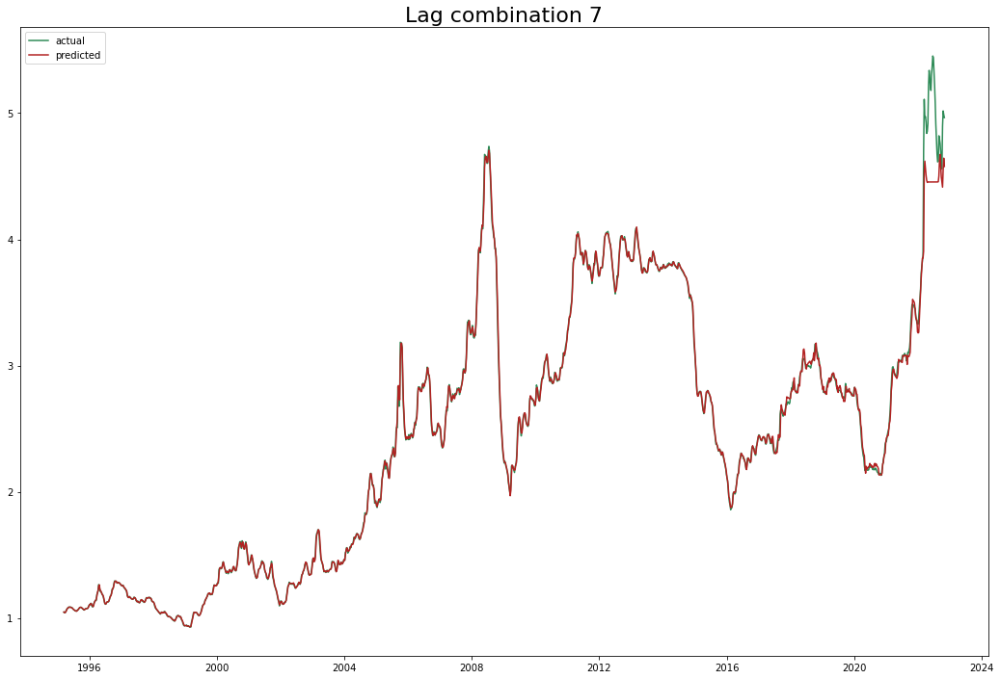

Test data rmse: 0.20461230921562926 Total rmse: 0.09267706589770672
Test data mape: 0.02061439014120843 Total mape: 0.00768559189158576
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.556) total time=   0.3s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.154) neg_root_mean_squared_error: (test=-0.546) r2: (test=-0.384) total time=   0.5s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.540) r2: (test=0.344) total time=   0.8s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.979) total time=   1.0s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.995) total time=   1.3s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.555) total time=   0.9s
[CV 2/5] END n_estimators=1000; neg_me

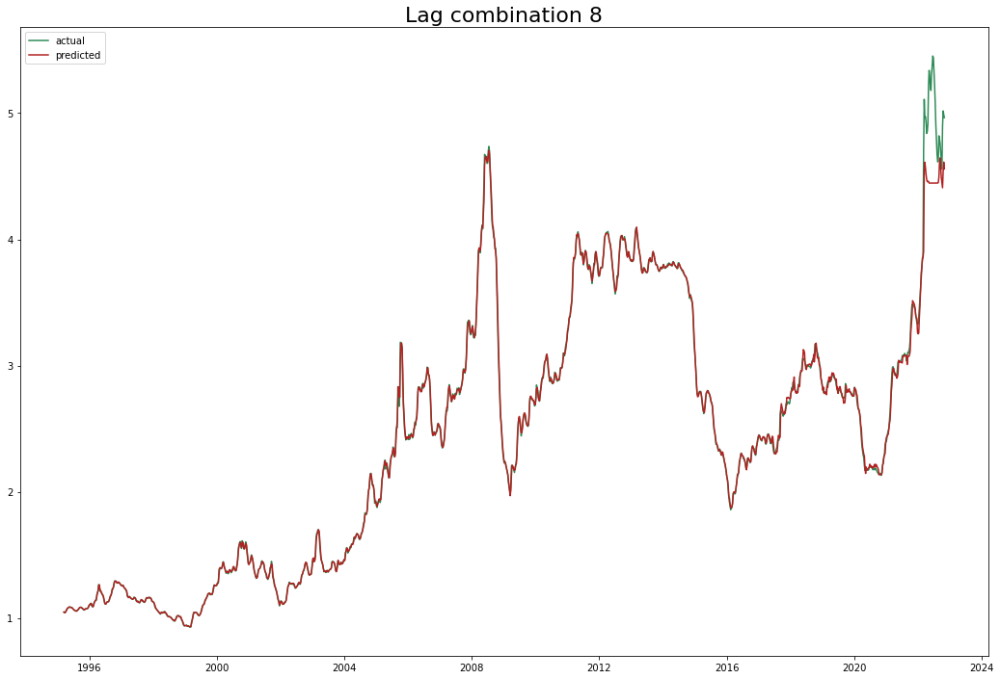

Test data rmse: 0.20642377109899537 Total rmse: 0.0934445077198981
Test data mape: 0.020493591754669603 Total mape: 0.007615449476267191
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.549) total time=   0.3s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.156) neg_root_mean_squared_error: (test=-0.550) r2: (test=-0.401) total time=   0.5s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.076) neg_root_mean_squared_error: (test=-0.532) r2: (test=0.362) total time=   0.8s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.979) total time=   1.1s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.996) total time=   1.4s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.552) total time=   0.9s
[CV 2/5] END n_estimators=1000; neg_me

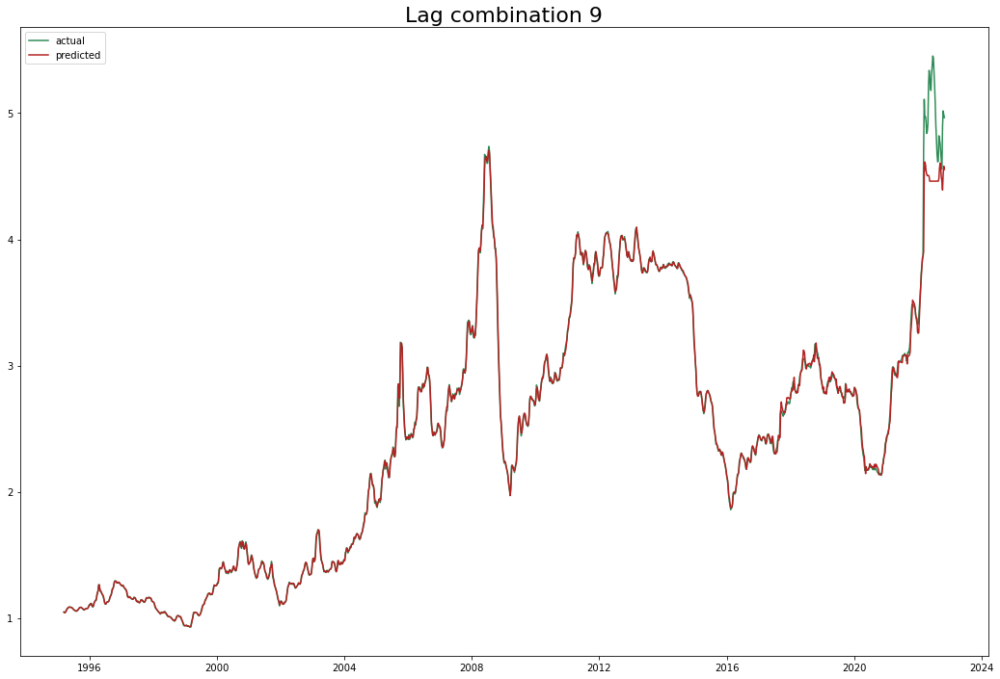

Test data rmse: 0.20251456777723634 Total rmse: 0.09174414536716738
Test data mape: 0.0203667669474814 Total mape: 0.00759408984636415
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.547) total time=   0.3s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.156) neg_root_mean_squared_error: (test=-0.550) r2: (test=-0.403) total time=   0.6s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.548) r2: (test=0.324) total time=   0.9s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.979) total time=   1.1s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   1.5s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.548) total time=   1.0s
[CV 2/5] END n_estimators=1000; neg_me

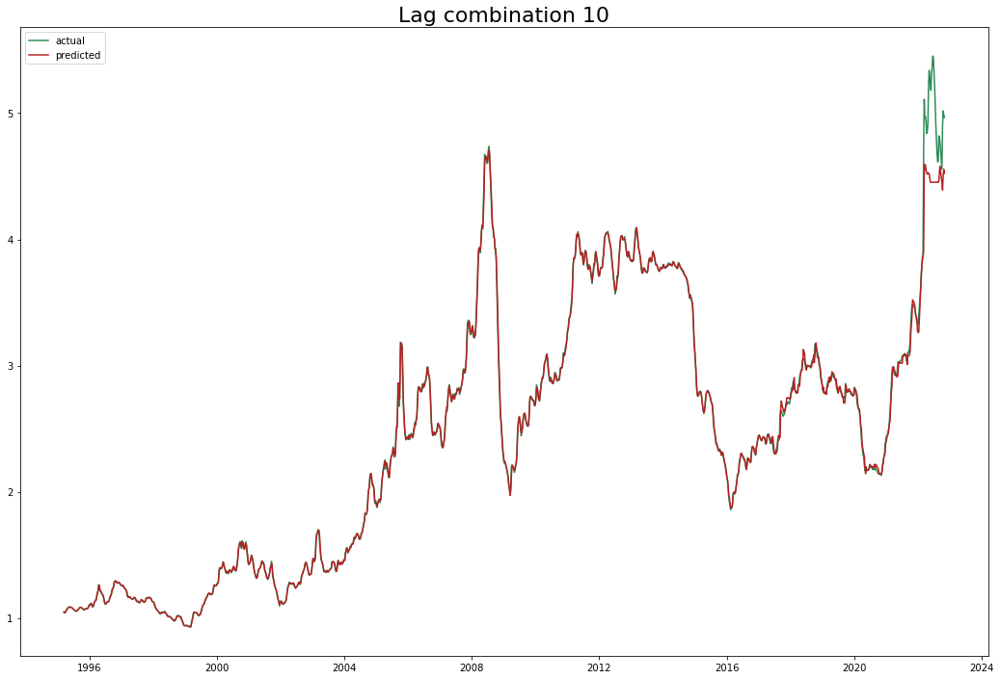

Test data rmse: 0.2035505676121228 Total rmse: 0.0921722317091067
Test data mape: 0.020614031000966572 Total mape: 0.007640791058006567
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.546) total time=   0.4s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.156) neg_root_mean_squared_error: (test=-0.550) r2: (test=-0.403) total time=   0.6s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.084) neg_root_mean_squared_error: (test=-0.568) r2: (test=0.273) total time=   1.0s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.055) r2: (test=0.984) total time=   1.2s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   1.6s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.546) total time=   1.0s
[CV 2/5] END n_estimators=1000; neg_me

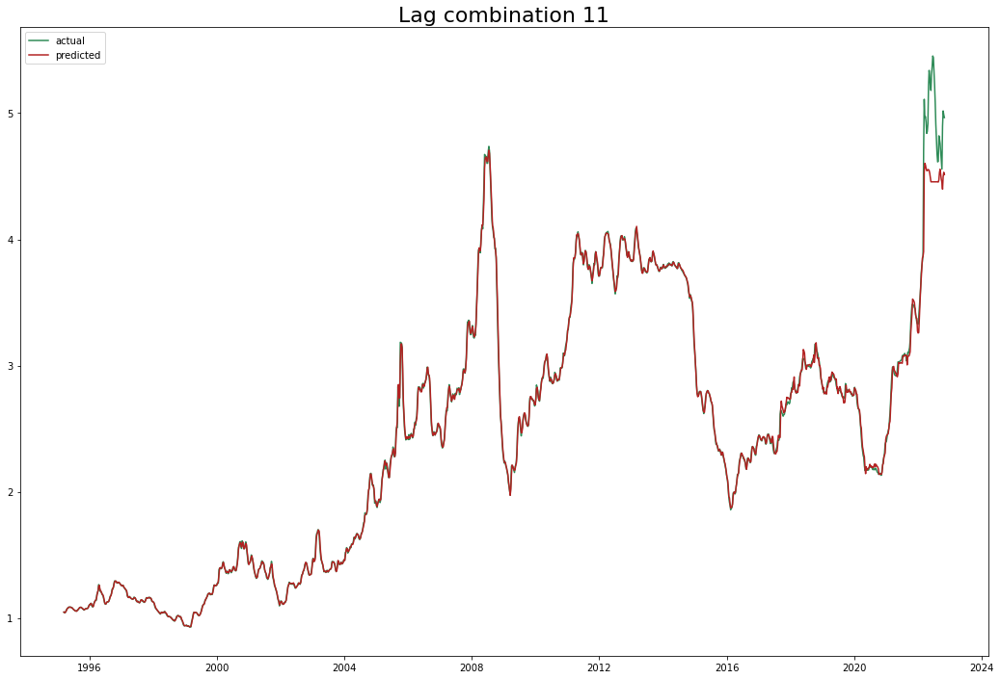

Test data rmse: 0.2012186250165568 Total rmse: 0.09113734684340549
Test data mape: 0.020517565569286054 Total mape: 0.007598808568350056
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.543) total time=   0.4s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.160) neg_root_mean_squared_error: (test=-0.559) r2: (test=-0.450) total time=   0.6s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.084) neg_root_mean_squared_error: (test=-0.565) r2: (test=0.280) total time=   1.0s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.052) r2: (test=0.986) total time=   1.3s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   1.6s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.544) total time=   1.0s
[CV 2/5] END n_estimators=1000; neg_me

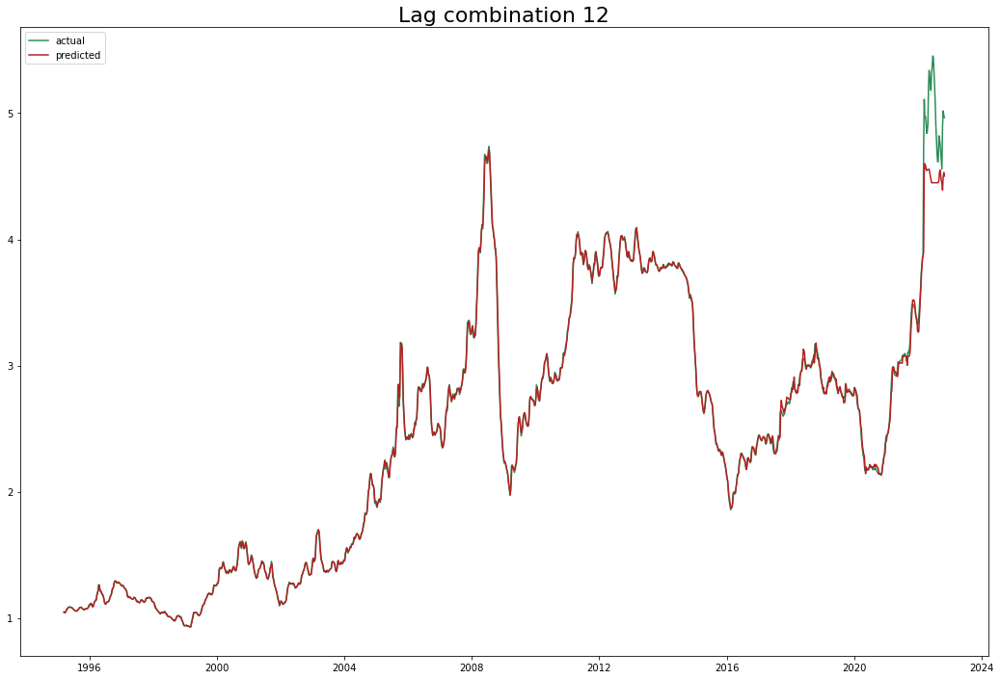

Test data rmse: 0.20193279367426142 Total rmse: 0.09146607356248501
Test data mape: 0.020676973377286263 Total mape: 0.007628873679686627
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.539) total time=   0.4s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.570) r2: (test=-0.506) total time=   0.8s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.537) r2: (test=0.349) total time=   1.1s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.988) total time=   1.3s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   1.7s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.543) total time=   1.0s
[CV 2/5] END n_estimators=1000; neg_me

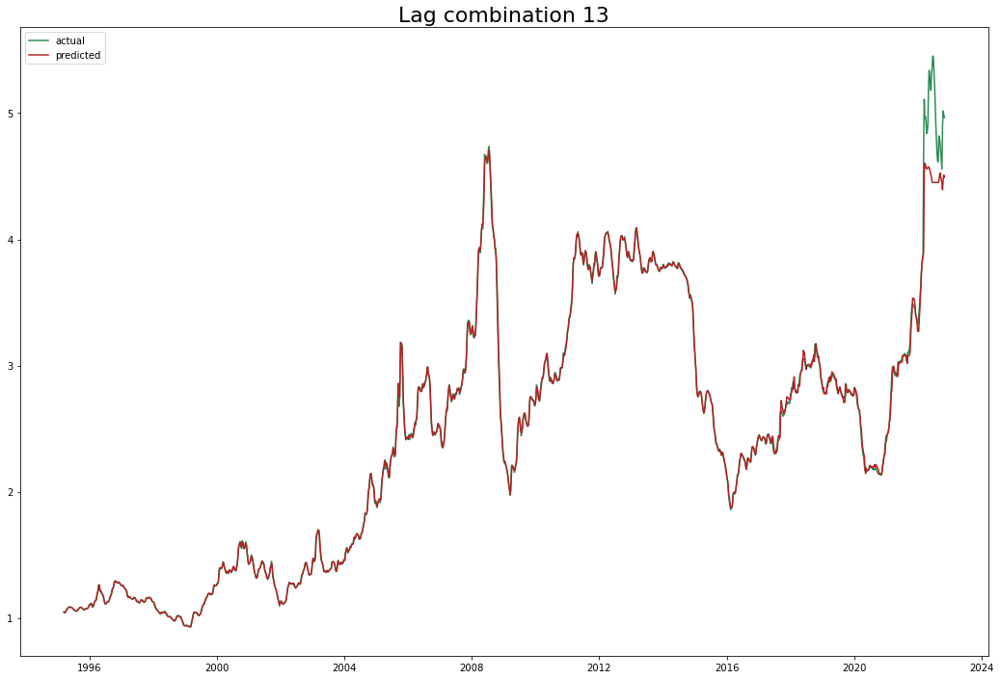

Test data rmse: 0.19995577203540746 Total rmse: 0.09058914164114572
Test data mape: 0.020309806840642115 Total mape: 0.0075599733362004895
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.536) total time=   0.4s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.163) neg_root_mean_squared_error: (test=-0.568) r2: (test=-0.498) total time=   0.6s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.078) neg_root_mean_squared_error: (test=-0.529) r2: (test=0.370) total time=   1.0s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.987) total time=   1.6s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   1.8s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.537) total time=   1.1s
[CV 2/5] END n_estimators=1000; neg_me

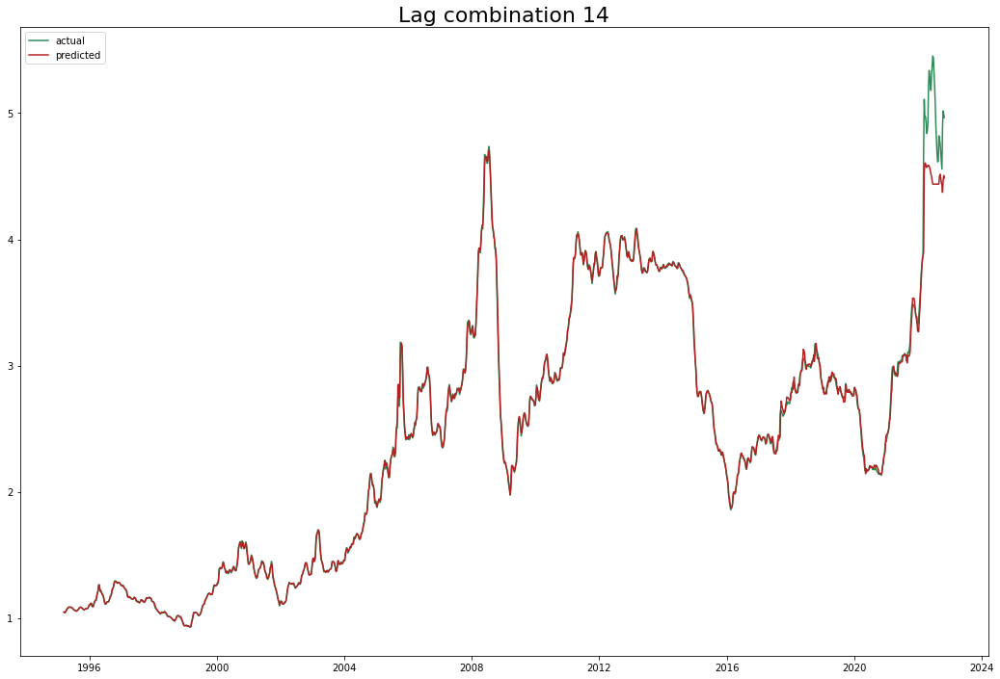

Test data rmse: 0.20048576756967948 Total rmse: 0.09079175577692336
Test data mape: 0.020441975165558107 Total mape: 0.007596634916549934
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.529) total time=   0.4s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.571) r2: (test=-0.512) total time=   0.7s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.539) r2: (test=0.346) total time=   1.1s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.051) r2: (test=0.986) total time=   1.5s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   1.9s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.529) total time=   1.1s
[CV 2/5] END n_estimators=1000; neg_me

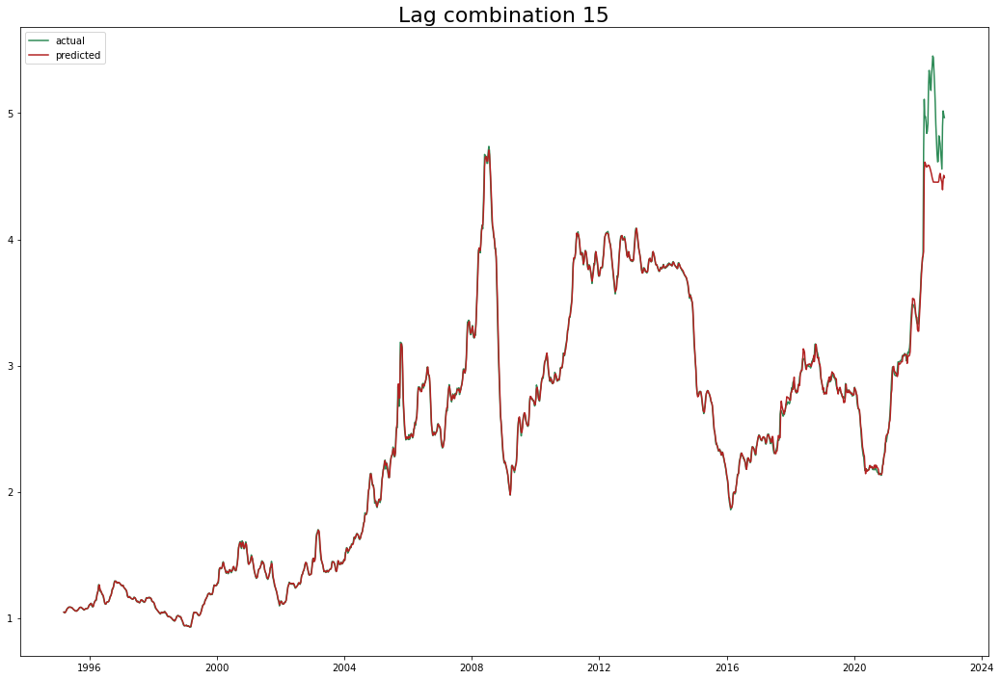

Test data rmse: 0.19669577312317227 Total rmse: 0.08915331257834404
Test data mape: 0.02016185168009056 Total mape: 0.007535326076785988
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.523) total time=   0.4s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.570) r2: (test=-0.508) total time=   0.8s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.530) r2: (test=0.366) total time=   1.2s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.987) total time=   1.6s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   2.0s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.527) total time=   1.1s
[CV 2/5] END n_estimators=1000; neg_me

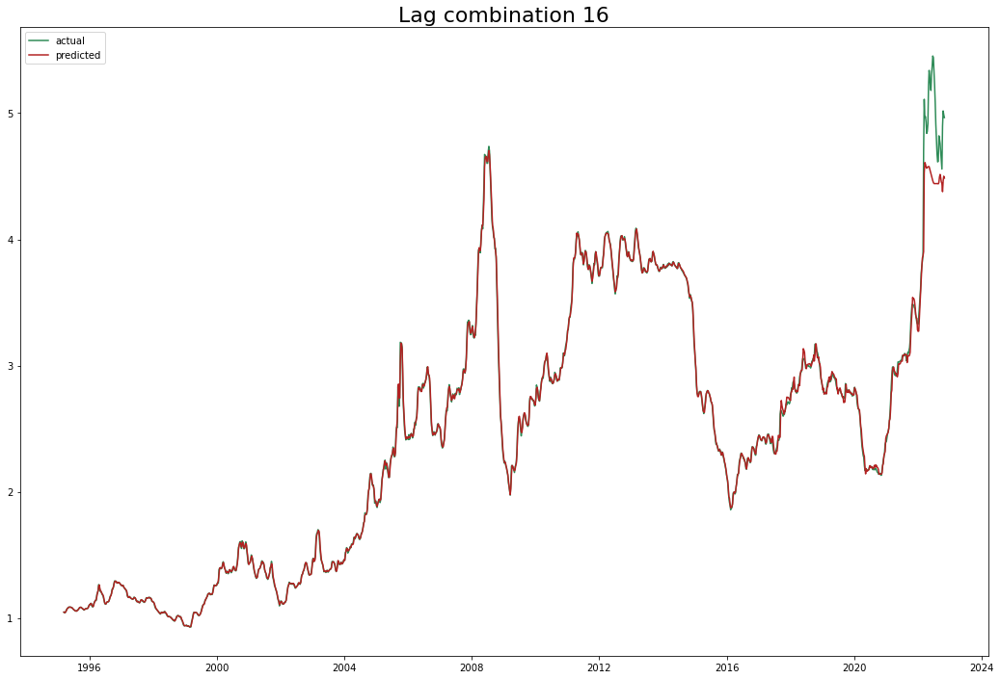

Test data rmse: 0.19954667796405662 Total rmse: 0.09039357619445472
Test data mape: 0.020338943703777097 Total mape: 0.0075609751262034975
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.524) total time=   0.4s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.166) neg_root_mean_squared_error: (test=-0.574) r2: (test=-0.527) total time=   0.8s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.534) r2: (test=0.357) total time=   1.3s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.988) total time=   1.6s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   2.1s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.523) total time=   1.2s
[CV 2/5] END n_estimators=1000; neg_me

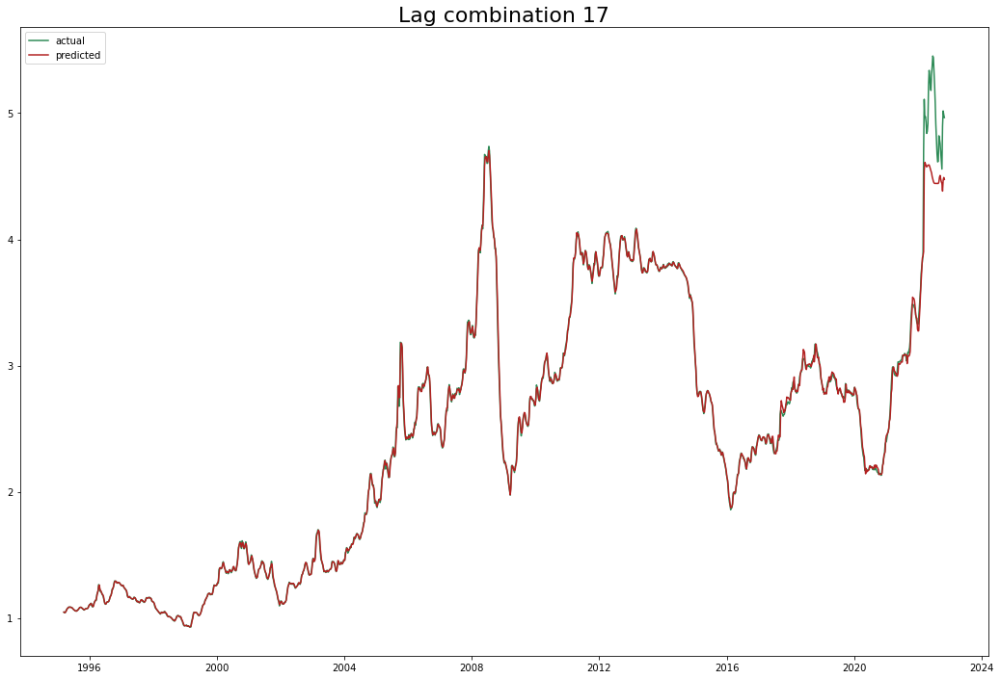

Test data rmse: 0.19715804031241263 Total rmse: 0.08933586149270233
Test data mape: 0.020259932518208474 Total mape: 0.007525972039096106
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.527) total time=   0.4s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.569) r2: (test=-0.500) total time=   0.8s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.082) neg_root_mean_squared_error: (test=-0.542) r2: (test=0.337) total time=   1.3s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.988) total time=   1.7s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   2.2s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.515) total time=   1.2s
[CV 2/5] END n_estimators=1000; neg_me

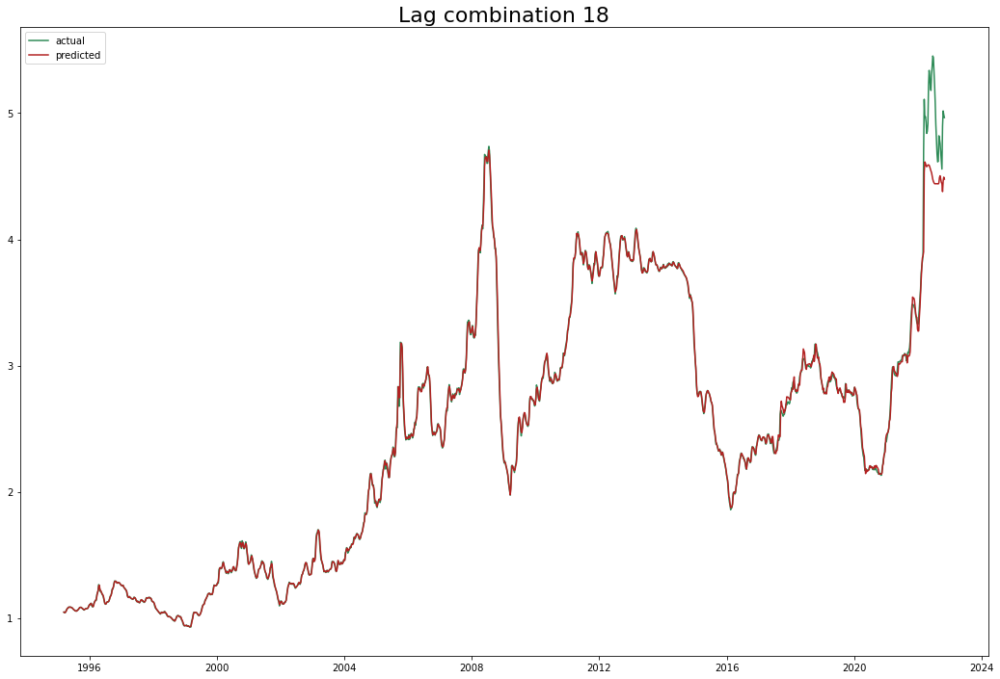

Test data rmse: 0.19744665156639807 Total rmse: 0.08946966960606328
Test data mape: 0.020265660516557725 Total mape: 0.007517208639273703
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.522) total time=   0.4s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.568) r2: (test=-0.498) total time=   0.8s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.087) neg_root_mean_squared_error: (test=-0.583) r2: (test=0.234) total time=   1.3s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.988) total time=   1.8s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   2.3s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.519) total time=   1.2s
[CV 2/5] END n_estimators=1000; neg_me

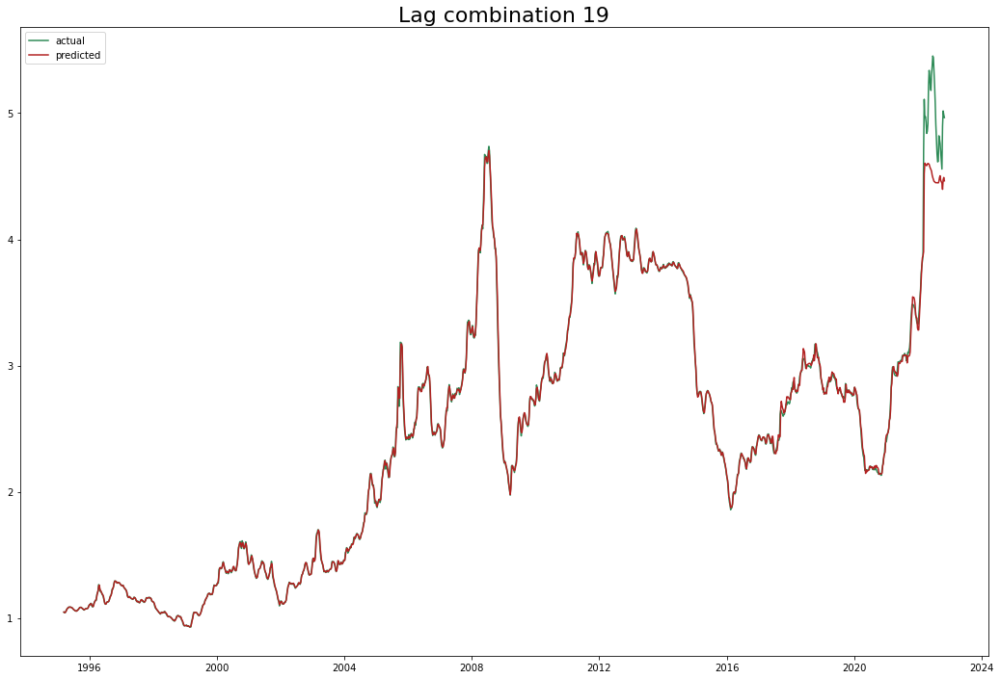

Test data rmse: 0.19529197127175382 Total rmse: 0.08854266530532187
Test data mape: 0.01996072960536583 Total mape: 0.007464954468516037
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.523) total time=   0.5s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.163) neg_root_mean_squared_error: (test=-0.567) r2: (test=-0.490) total time=   0.9s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.101) neg_root_mean_squared_error: (test=-0.634) r2: (test=0.094) total time=   1.4s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.988) total time=   1.8s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   2.4s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.521) total time=   1.3s
[CV 2/5] END n_estimators=1000; neg_me

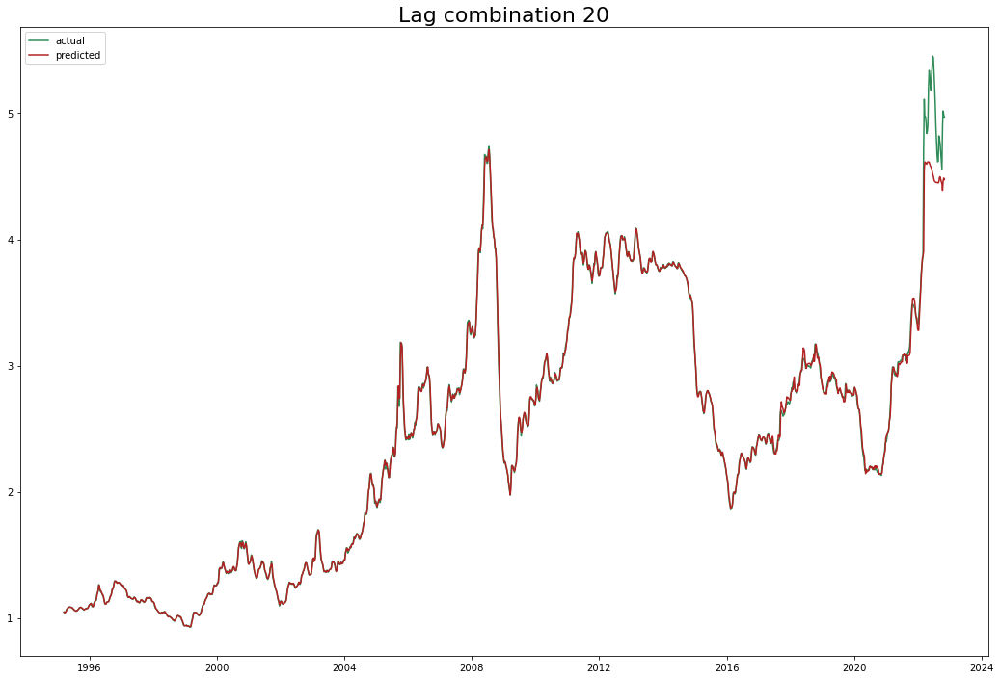

Test data rmse: 0.19158521821485414 Total rmse: 0.08689378827339492
Test data mape: 0.019702863099607767 Total mape: 0.007416442574781296
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.524) total time=   0.4s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.569) r2: (test=-0.502) total time=   0.8s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.104) neg_root_mean_squared_error: (test=-0.638) r2: (test=0.081) total time=   1.4s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.987) total time=   1.8s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   2.4s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.520) total time=   1.2s
[CV 2/5] END n_estimators=1000; neg_me

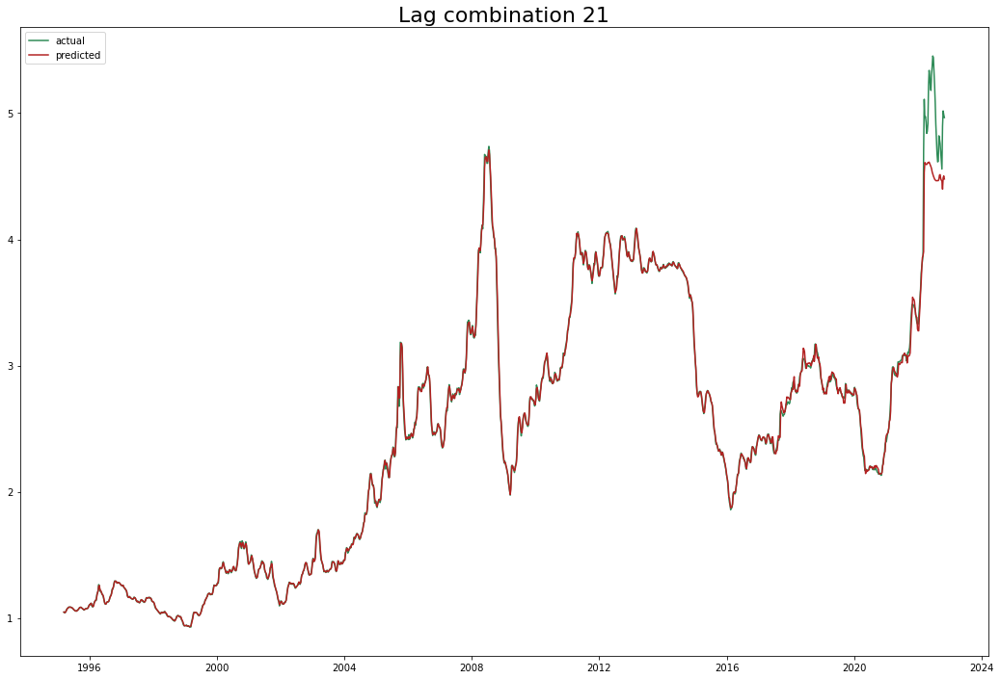

Test data rmse: 0.19013600537794229 Total rmse: 0.08624460836272017
Test data mape: 0.019681209524871308 Total mape: 0.007419839455070824
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.525) total time=   0.4s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.572) r2: (test=-0.516) total time=   0.9s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.107) neg_root_mean_squared_error: (test=-0.653) r2: (test=0.040) total time=   1.4s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.985) total time=   1.9s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   2.5s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.517) total time=   1.3s
[CV 2/5] END n_estimators=1000; neg_me

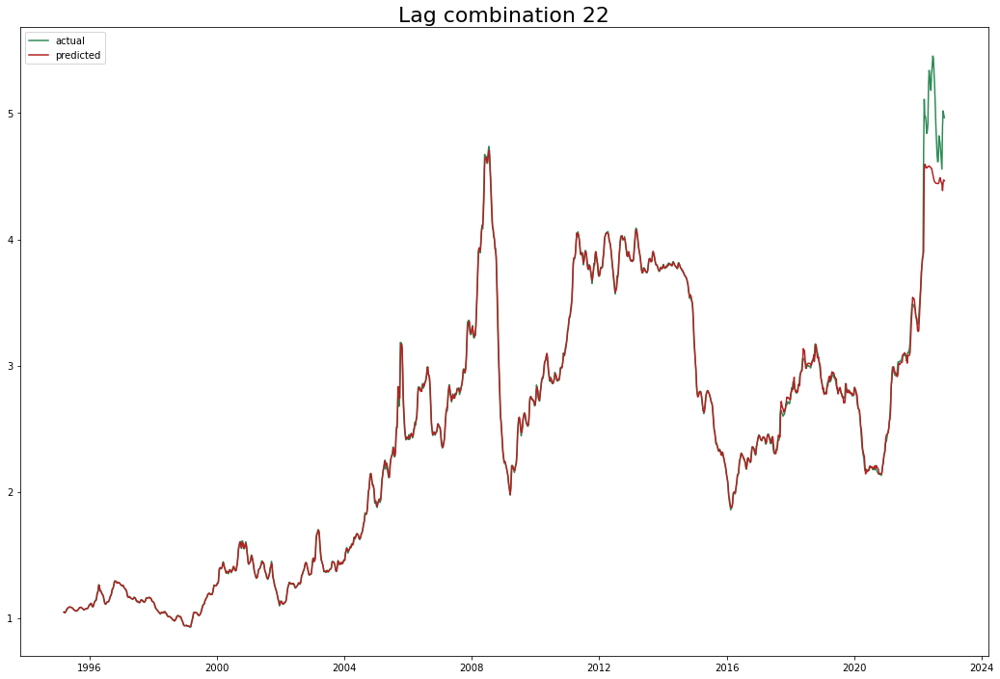

Test data rmse: 0.19506118989697885 Total rmse: 0.08841668127696682
Test data mape: 0.0201761490334161 Total mape: 0.007494737449242955
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.530) total time=   0.5s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.166) neg_root_mean_squared_error: (test=-0.573) r2: (test=-0.521) total time=   0.9s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.109) neg_root_mean_squared_error: (test=-0.652) r2: (test=0.042) total time=   1.5s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.988) total time=   1.9s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.995) total time=   2.6s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.529) total time=   1.3s
[CV 2/5] END n_estimators=1000; neg_me

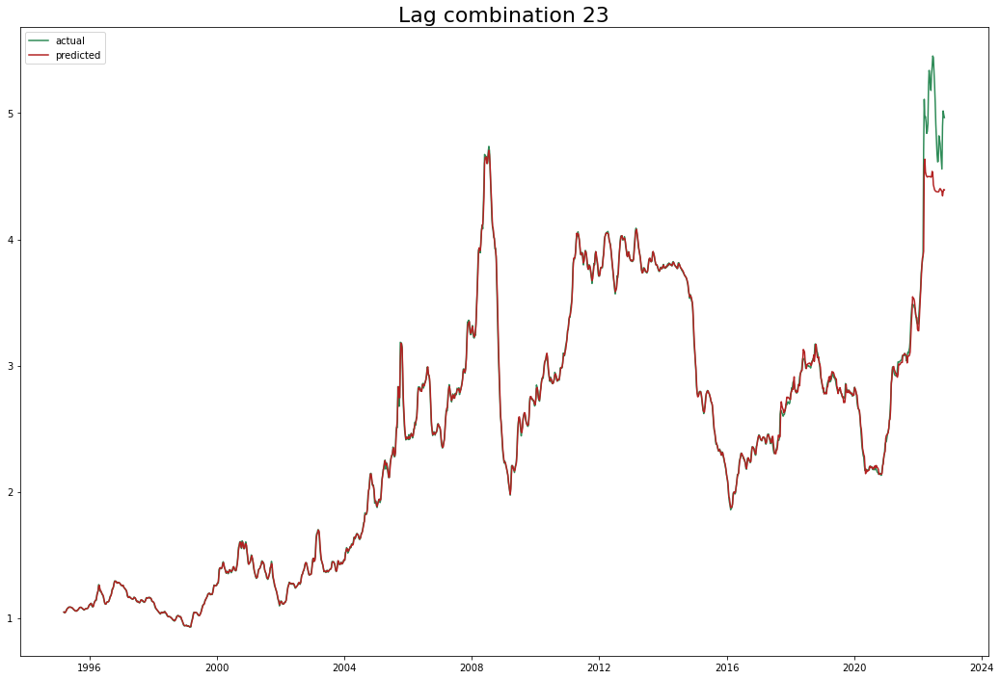

Test data rmse: 0.2118525387380867 Total rmse: 0.09579135654935578
Test data mape: 0.021522662027865923 Total mape: 0.007763948288044056
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.531) total time=   0.5s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.570) r2: (test=-0.508) total time=   0.9s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.102) neg_root_mean_squared_error: (test=-0.634) r2: (test=0.093) total time=   1.5s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.988) total time=   2.0s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   2.7s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.530) total time=   1.3s
[CV 2/5] END n_estimators=1000; neg_me

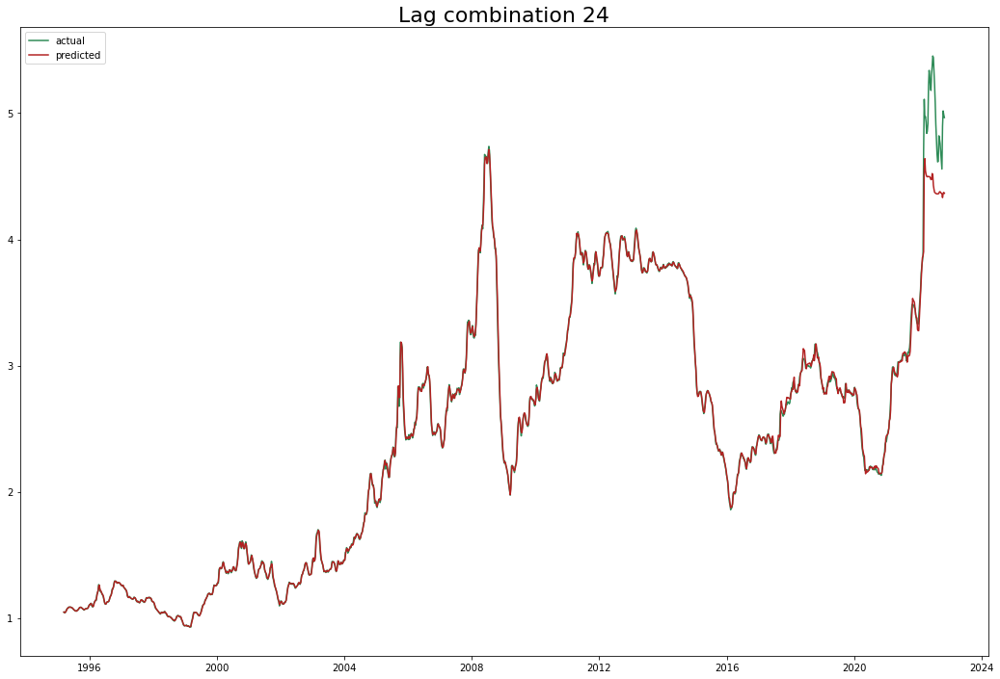

Test data rmse: 0.2156518940488544 Total rmse: 0.09746929298766639
Test data mape: 0.021738492330880894 Total mape: 0.007806631250507012
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.534) total time=   0.5s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.570) r2: (test=-0.507) total time=   1.0s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.099) neg_root_mean_squared_error: (test=-0.625) r2: (test=0.121) total time=   1.6s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.987) total time=   2.1s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   2.9s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.526) total time=   1.6s
[CV 2/5] END n_estimators=1000; neg_me

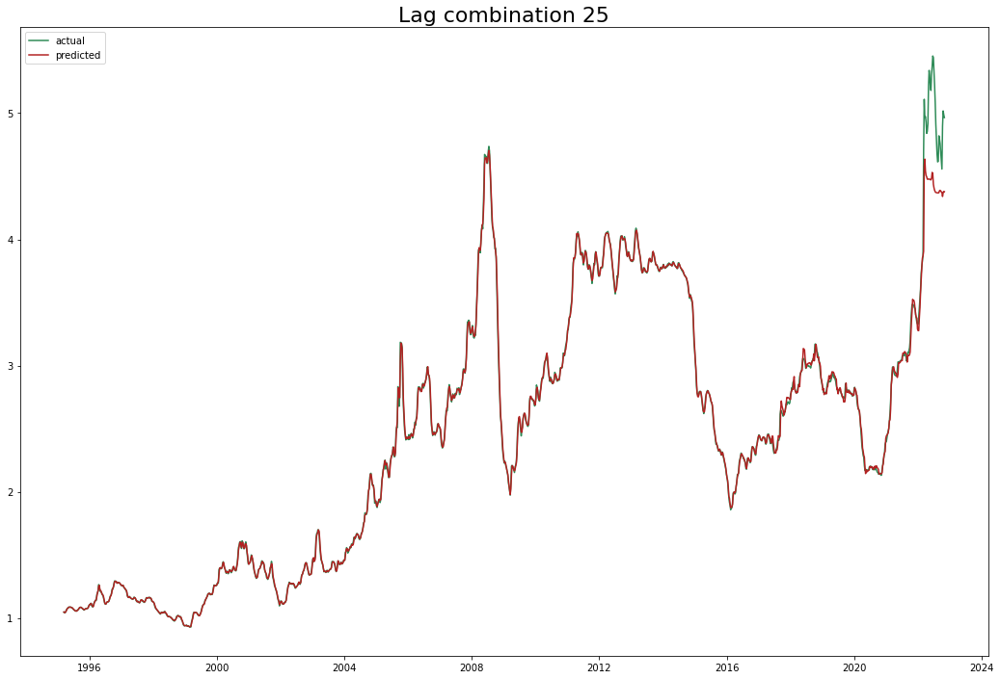

Test data rmse: 0.21487899020452403 Total rmse: 0.09717456868393441
Test data mape: 0.02169289915618014 Total mape: 0.007824924109361163
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.528) total time=   0.6s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.166) neg_root_mean_squared_error: (test=-0.574) r2: (test=-0.530) total time=   1.3s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.105) neg_root_mean_squared_error: (test=-0.645) r2: (test=0.061) total time=   1.9s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.988) total time=   2.5s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   3.3s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.525) total time=   1.7s
[CV 2/5] END n_estimators=1000; neg_me

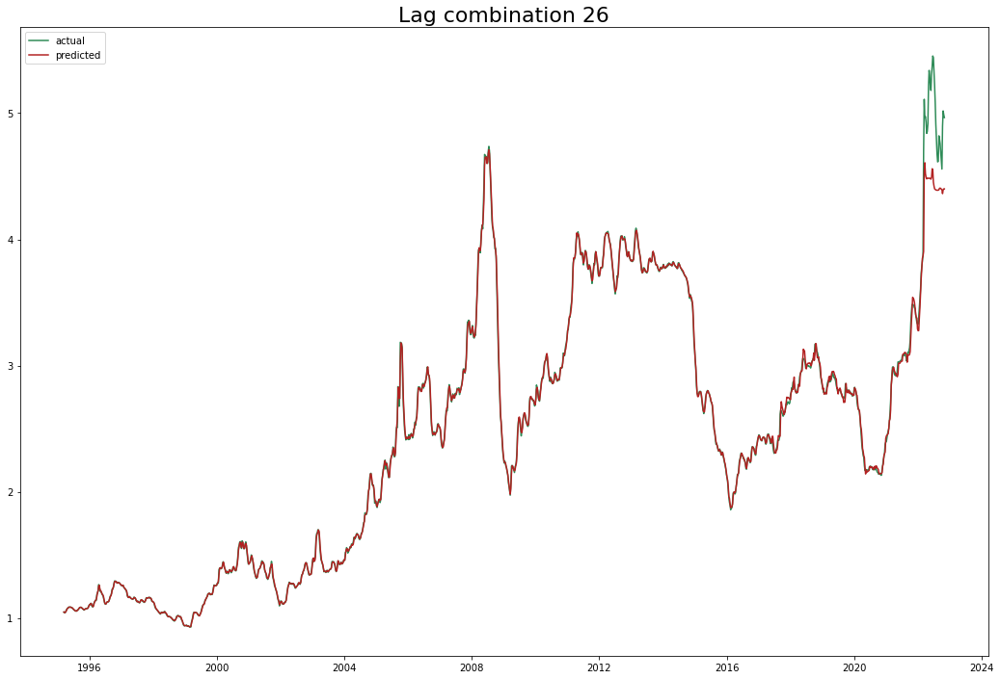

Test data rmse: 0.2113520973247871 Total rmse: 0.09558677212971094
Test data mape: 0.021352058264865432 Total mape: 0.007736314809395066
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.533) total time=   0.6s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.571) r2: (test=-0.512) total time=   1.2s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.104) neg_root_mean_squared_error: (test=-0.637) r2: (test=0.086) total time=   1.9s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.987) total time=   2.6s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   3.3s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.538) total time=   1.7s
[CV 2/5] END n_estimators=1000; neg_me

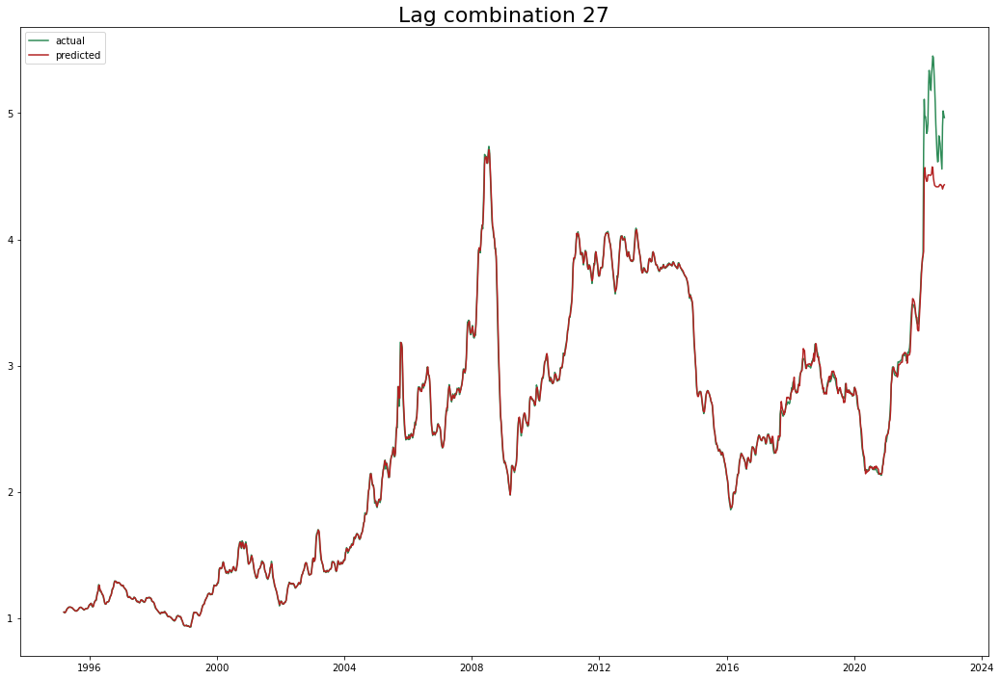

Test data rmse: 0.20522196130563525 Total rmse: 0.09291356643285344
Test data mape: 0.020992507558412504 Total mape: 0.007665040857249309
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.528) total time=   0.7s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.572) r2: (test=-0.515) total time=   1.3s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.102) neg_root_mean_squared_error: (test=-0.629) r2: (test=0.109) total time=   2.1s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.051) r2: (test=0.986) total time=   2.7s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   3.5s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.534) total time=   1.8s
[CV 2/5] END n_estimators=1000; neg_me

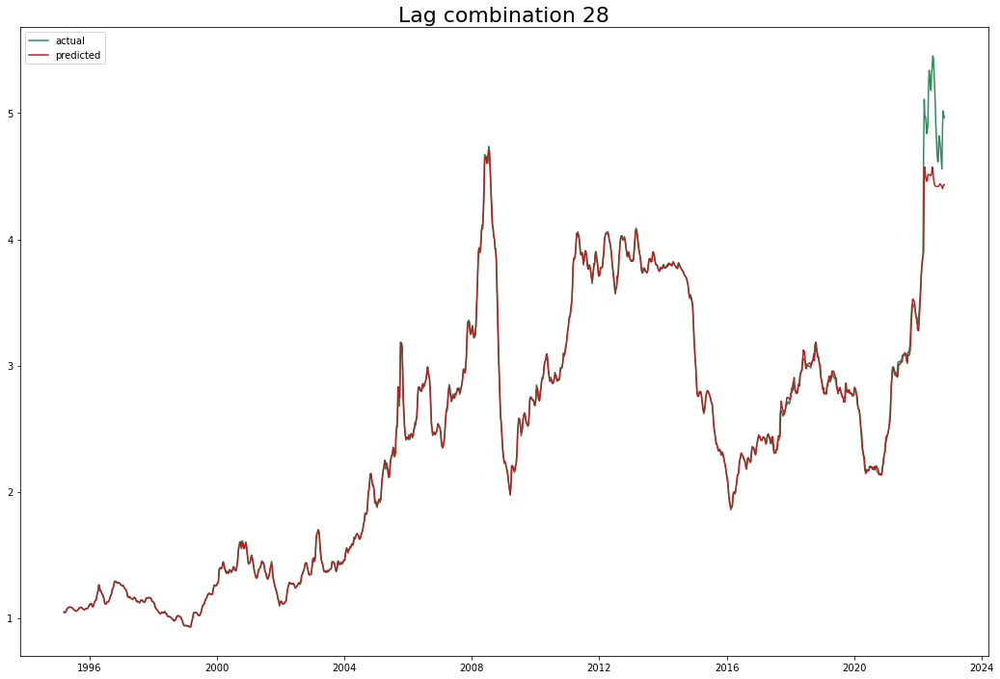

Test data rmse: 0.20478689231655905 Total rmse: 0.09272782860654397
Test data mape: 0.020981542423812283 Total mape: 0.007643268293395431
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.526) total time=   0.7s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.571) r2: (test=-0.511) total time=   1.3s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.102) neg_root_mean_squared_error: (test=-0.632) r2: (test=0.099) total time=   2.1s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.052) r2: (test=0.986) total time=   2.8s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   3.4s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.522) total time=   1.7s
[CV 2/5] END n_estimators=1000; neg_me

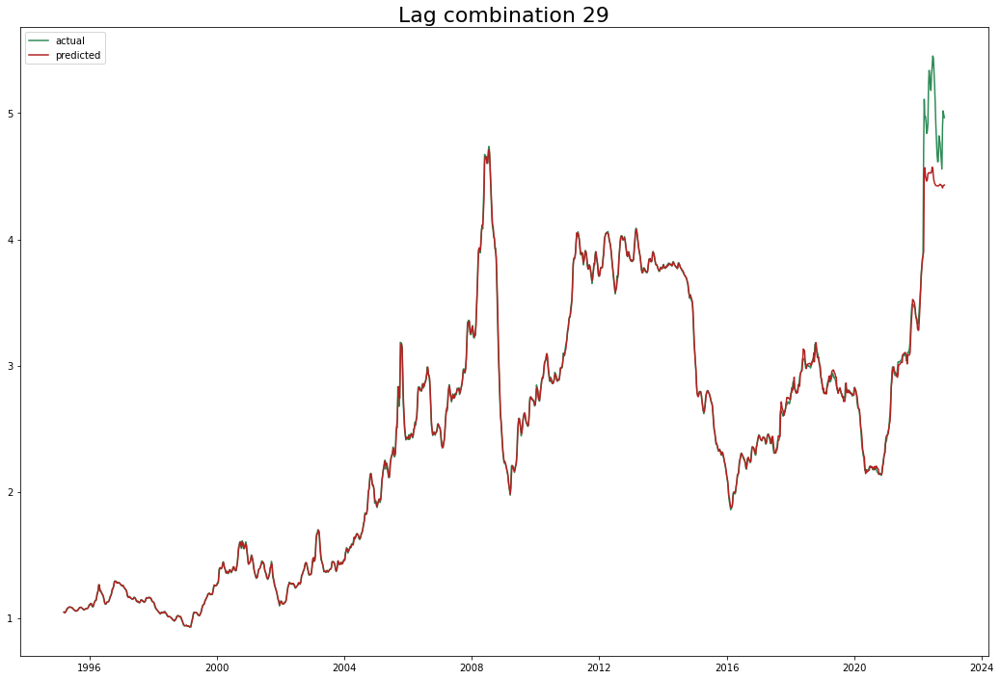

Test data rmse: 0.20279672081401362 Total rmse: 0.09184716851184642
Test data mape: 0.02097061363014585 Total mape: 0.007668618824780925
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.519) total time=   0.7s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.568) r2: (test=-0.498) total time=   1.4s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.104) neg_root_mean_squared_error: (test=-0.637) r2: (test=0.086) total time=   2.2s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.052) r2: (test=0.986) total time=   2.9s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   3.9s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.522) total time=   2.0s
[CV 2/5] END n_estimators=1000; neg_me

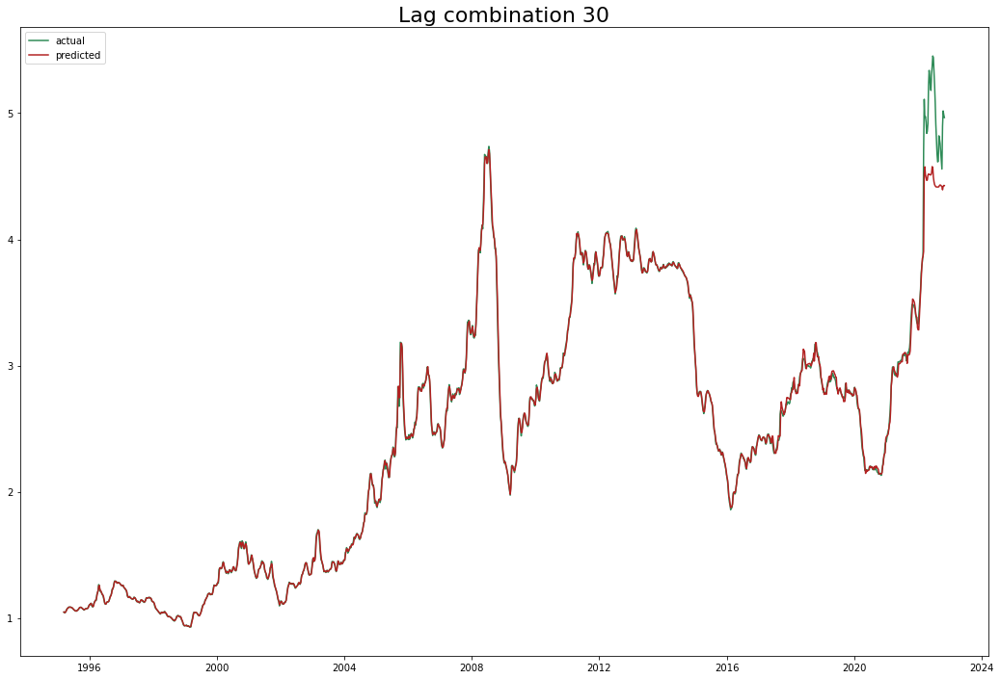

Test data rmse: 0.2044976627445808 Total rmse: 0.09257612199082041
Test data mape: 0.020952206663146105 Total mape: 0.0076290751487183015
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.523) total time=   0.8s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.567) r2: (test=-0.493) total time=   1.4s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.103) neg_root_mean_squared_error: (test=-0.639) r2: (test=0.080) total time=   2.3s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.985) total time=   3.0s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   4.0s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.520) total time=   2.0s
[CV 2/5] END n_estimators=1000; neg_me

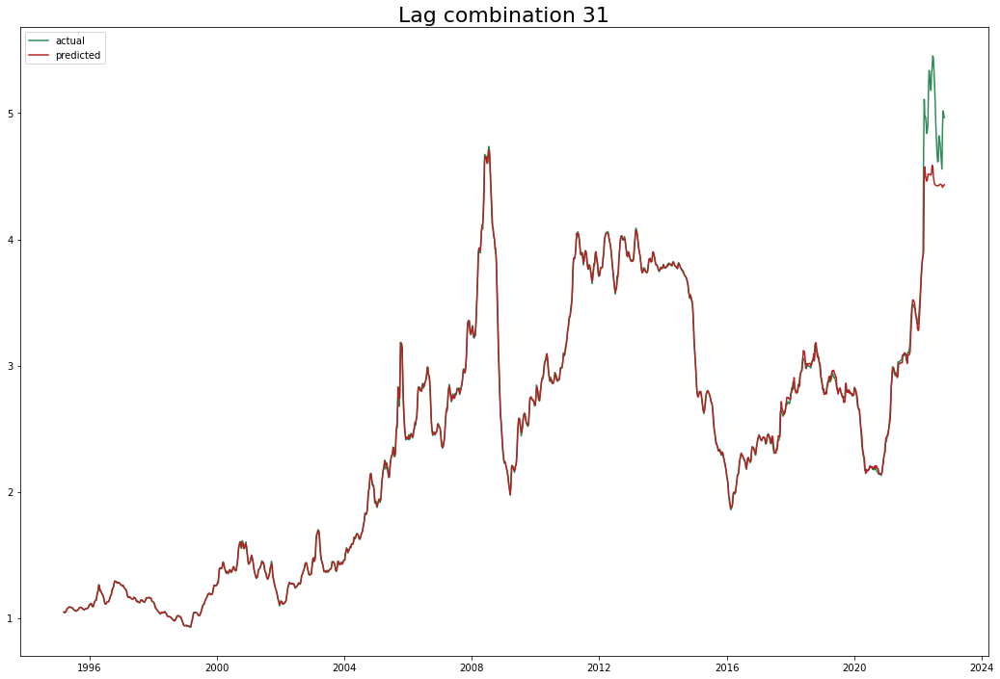

Test data rmse: 0.2032186906855413 Total rmse: 0.09202047920452867
Test data mape: 0.02089010301458593 Total mape: 0.007610441157487338
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.512) total time=   0.8s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.568) r2: (test=-0.497) total time=   1.4s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.102) neg_root_mean_squared_error: (test=-0.635) r2: (test=0.090) total time=   2.3s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.057) r2: (test=0.983) total time=   3.0s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   4.1s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.521) total time=   2.1s
[CV 2/5] END n_estimators=1000; neg_me

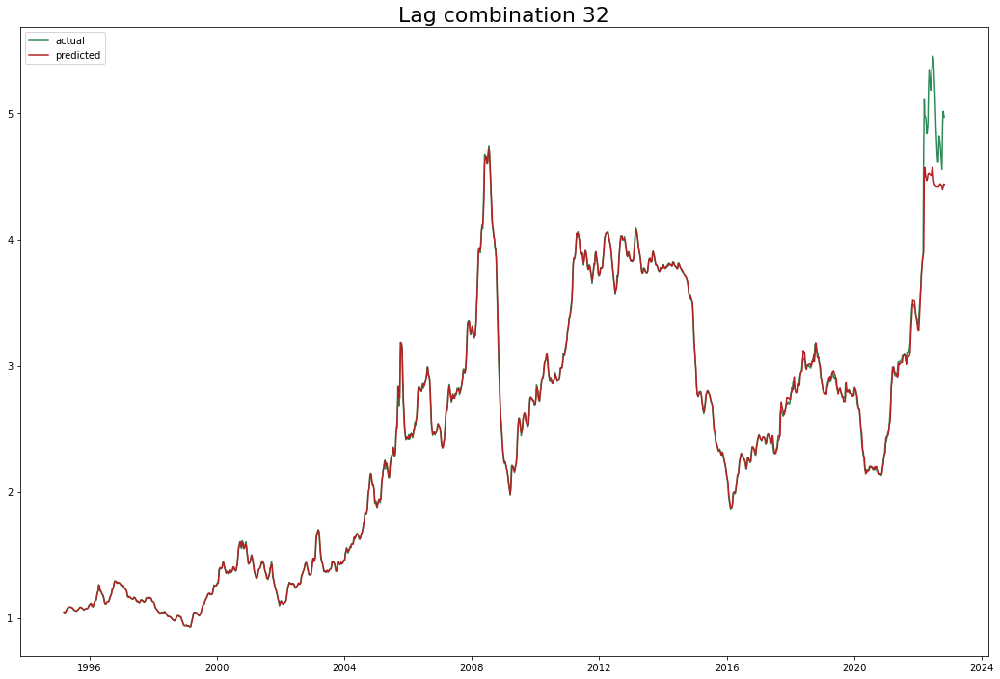

Test data rmse: 0.2044393097365058 Total rmse: 0.09256571594370004
Test data mape: 0.020943005811462037 Total mape: 0.007607323645329208
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.522) total time=   0.8s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.570) r2: (test=-0.508) total time=   1.5s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.103) neg_root_mean_squared_error: (test=-0.637) r2: (test=0.085) total time=   2.4s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.980) total time=   3.2s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   4.2s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.520) total time=   2.1s
[CV 2/5] END n_estimators=1000; neg_me

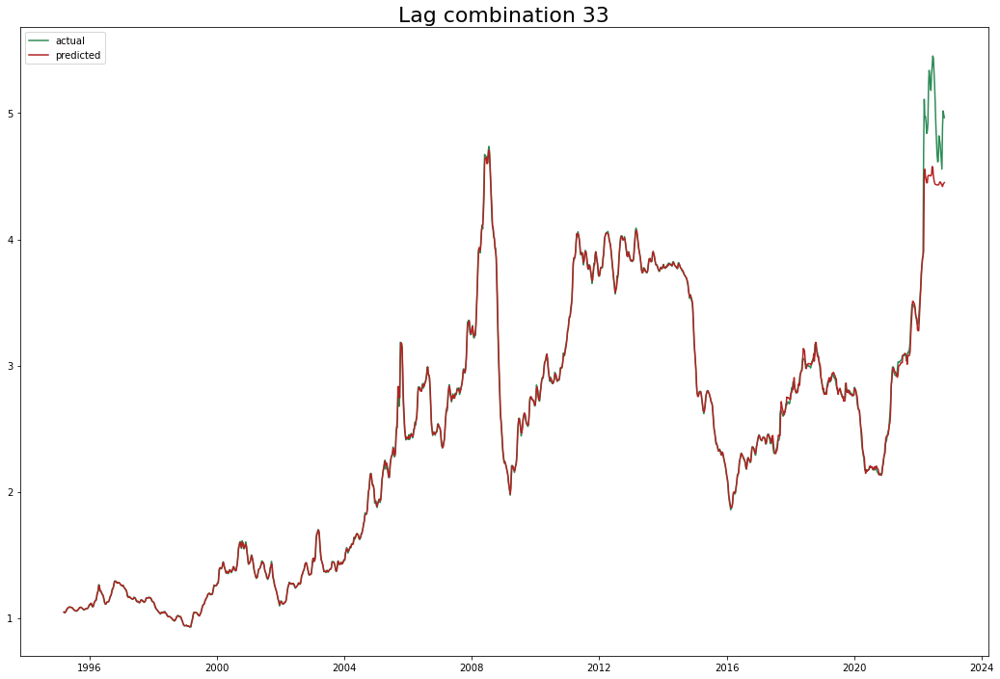

Test data rmse: 0.203437303946293 Total rmse: 0.09210234904772195
Test data mape: 0.020743934201688023 Total mape: 0.007573818842337455
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.515) total time=   0.8s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.569) r2: (test=-0.503) total time=   1.6s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.103) neg_root_mean_squared_error: (test=-0.639) r2: (test=0.079) total time=   2.5s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.980) total time=   3.2s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   4.3s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.520) total time=   2.1s
[CV 2/5] END n_estimators=1000; neg_me

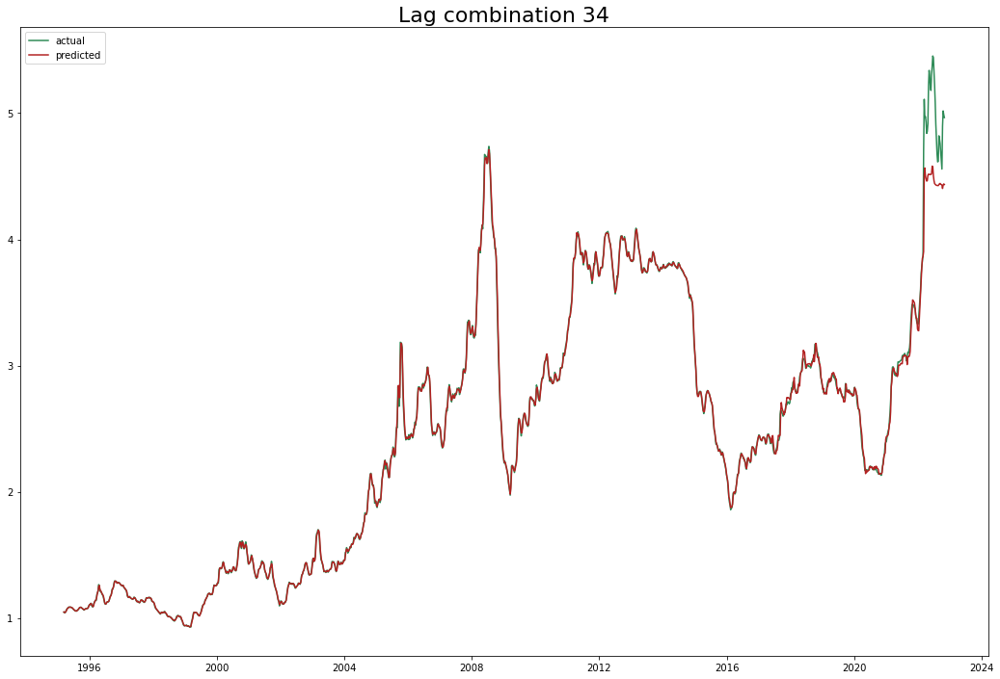

Test data rmse: 0.2030627455318265 Total rmse: 0.09195189526226288
Test data mape: 0.02073355003710568 Total mape: 0.007566970347280351
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.520) total time=   0.8s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.569) r2: (test=-0.503) total time=   1.5s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.110) neg_root_mean_squared_error: (test=-0.665) r2: (test=0.004) total time=   2.5s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.980) total time=   3.3s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   4.4s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.514) total time=   2.2s
[CV 2/5] END n_estimators=1000; neg_me

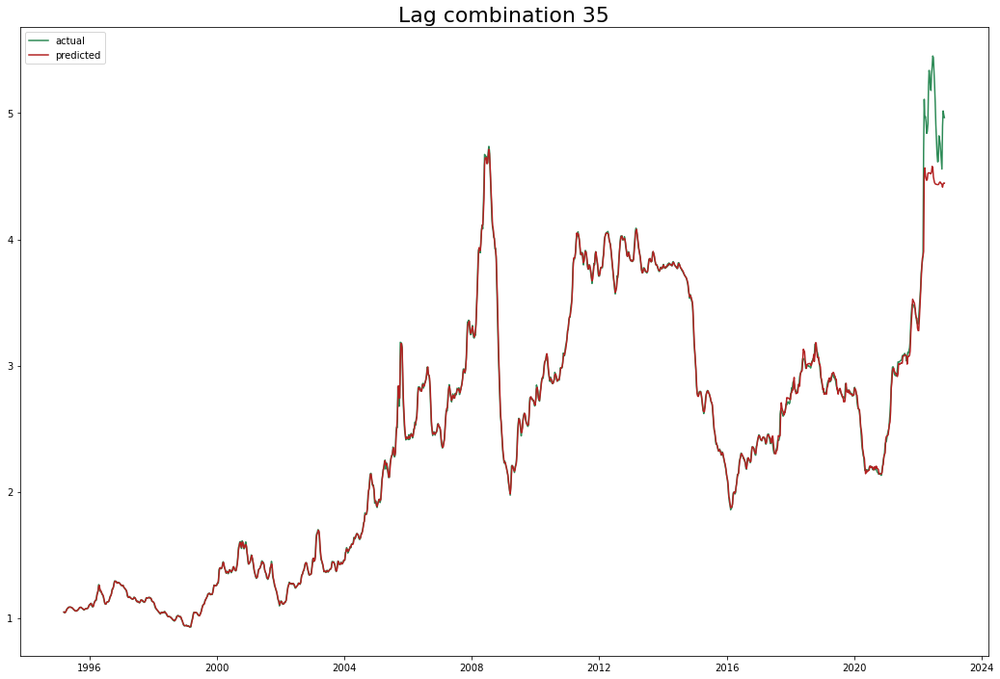

Test data rmse: 0.2012626392946643 Total rmse: 0.09114939877163387
Test data mape: 0.02051233476529458 Total mape: 0.007509697548382645
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.510) total time=   0.8s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.568) r2: (test=-0.495) total time=   1.6s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.113) neg_root_mean_squared_error: (test=-0.670) r2: (test=-0.013) total time=   2.5s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.070) r2: (test=0.974) total time=   3.4s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   4.5s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.518) total time=   2.3s
[CV 2/5] END n_estimators=1000; neg_m

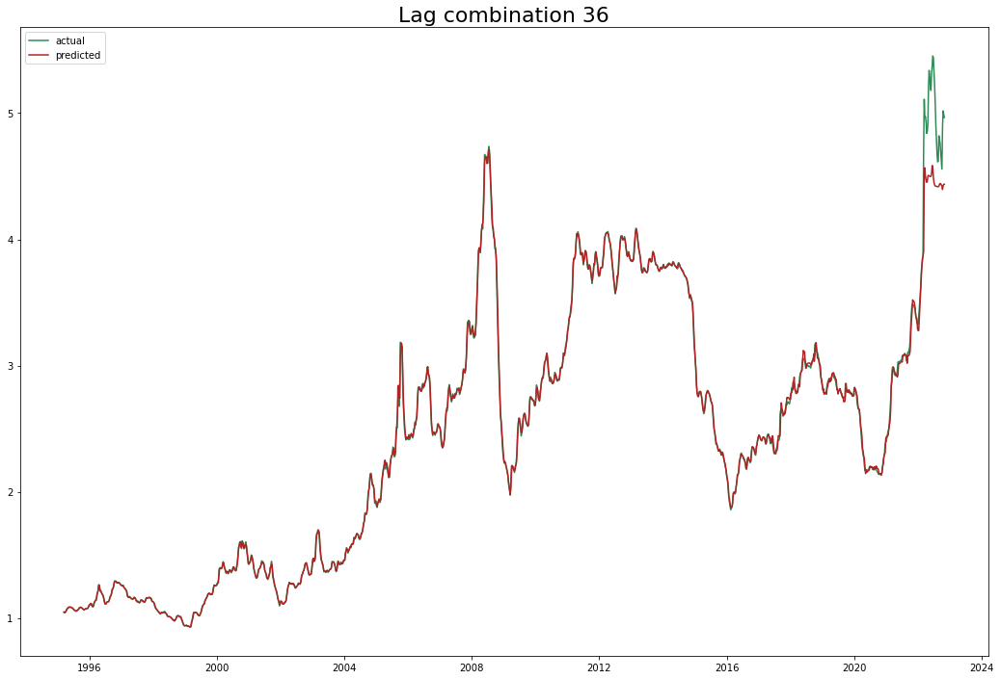

Test data rmse: 0.2052043331526376 Total rmse: 0.0928998984868129
Test data mape: 0.020756753527683105 Total mape: 0.007586856787981292
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.519) total time=   0.9s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.163) neg_root_mean_squared_error: (test=-0.566) r2: (test=-0.487) total time=   1.6s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.129) neg_root_mean_squared_error: (test=-0.730) r2: (test=-0.202) total time=   2.6s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.981) total time=   3.5s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   4.7s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.514) total time=   2.3s
[CV 2/5] END n_estimators=1000; neg_m

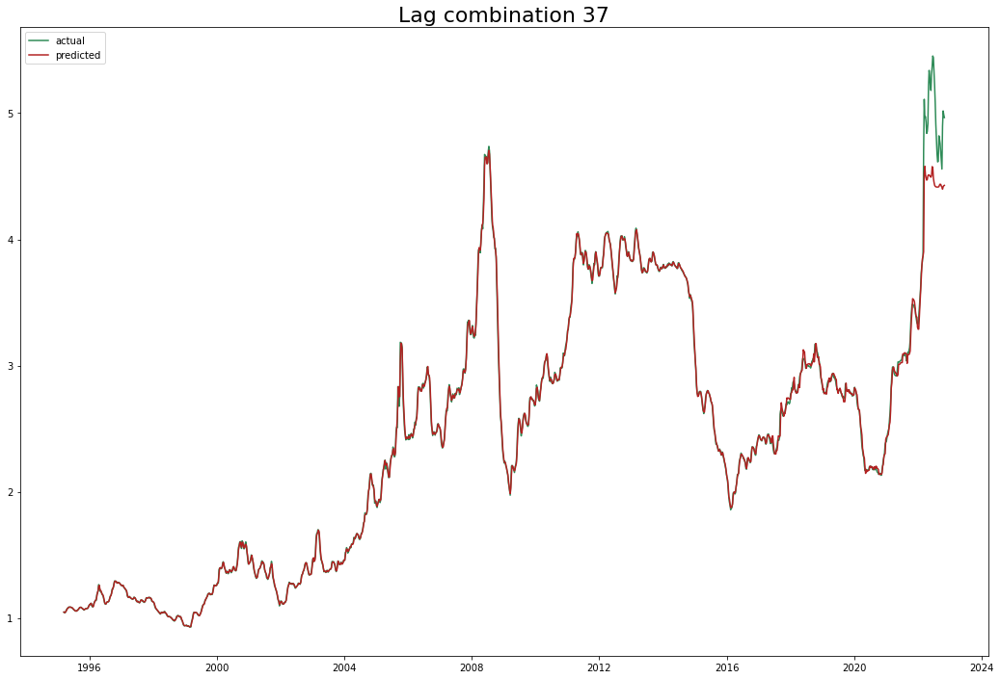

Test data rmse: 0.2053766671851718 Total rmse: 0.09298997247279991
Test data mape: 0.020783679281426146 Total mape: 0.007593095720091291
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.515) total time=   0.8s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.568) r2: (test=-0.494) total time=   1.6s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.134) neg_root_mean_squared_error: (test=-0.746) r2: (test=-0.255) total time=   2.7s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.980) total time=   3.7s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.995) total time=   4.8s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.516) total time=   2.3s
[CV 2/5] END n_estimators=1000; neg_m

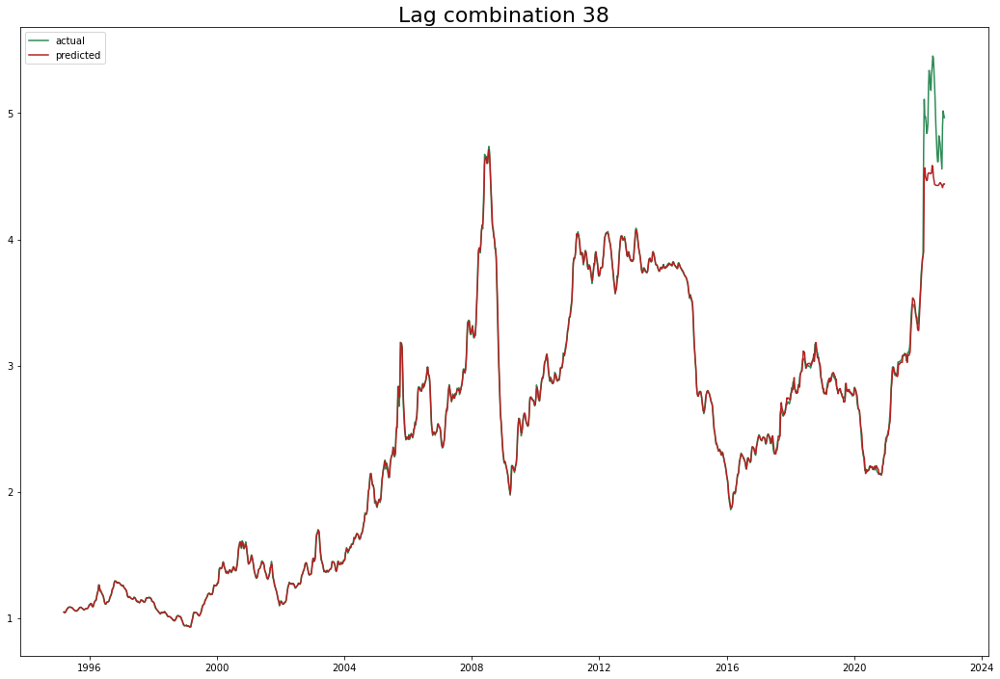

Test data rmse: 0.20219934348819937 Total rmse: 0.09161287132631178
Test data mape: 0.020627786763847442 Total mape: 0.007561194653460379
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.512) total time=   0.9s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.568) r2: (test=-0.496) total time=   1.7s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.131) neg_root_mean_squared_error: (test=-0.739) r2: (test=-0.231) total time=   2.8s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.980) total time=   3.7s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   4.9s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.513) total time=   2.4s
[CV 2/5] END n_estimators=1000; neg_m

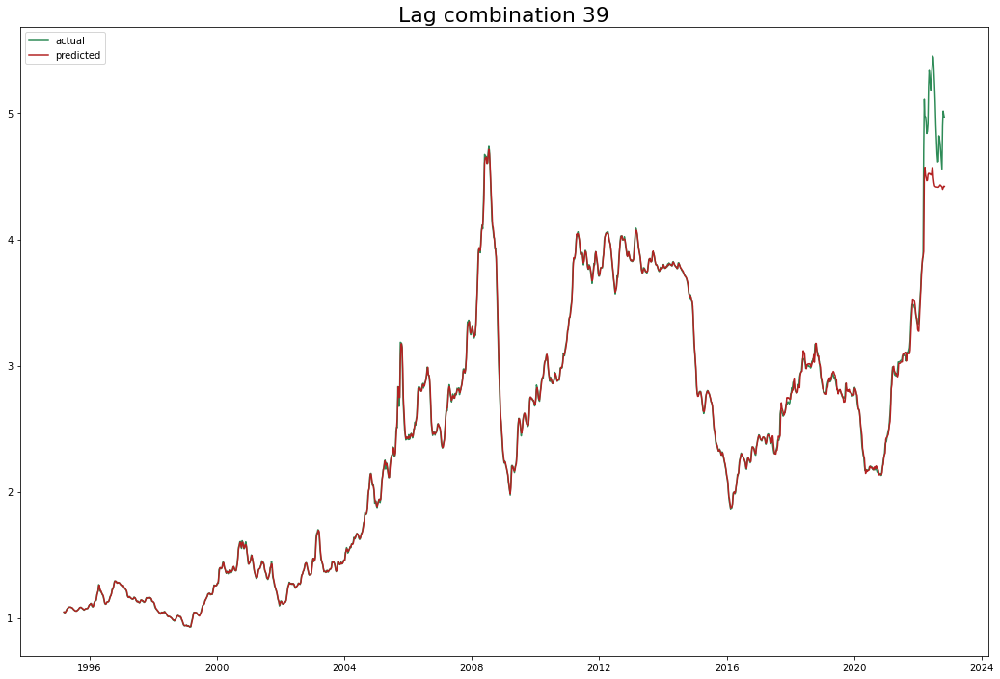

Test data rmse: 0.2051283445041973 Total rmse: 0.09287889165053925
Test data mape: 0.020811159577579095 Total mape: 0.007598139010223543
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.520) total time=   1.0s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.163) neg_root_mean_squared_error: (test=-0.568) r2: (test=-0.494) total time=   2.3s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.131) neg_root_mean_squared_error: (test=-0.741) r2: (test=-0.237) total time=   2.9s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.978) total time=   3.8s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   4.9s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.518) total time=   2.3s
[CV 2/5] END n_estimators=1000; neg_m

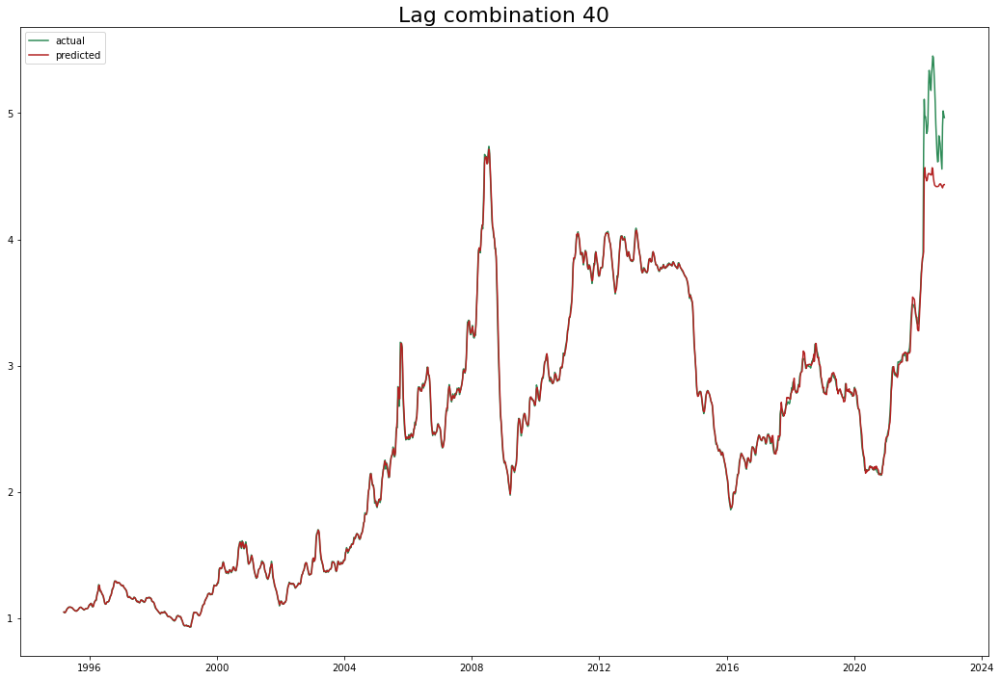

Test data rmse: 0.20445085103133132 Total rmse: 0.0926122696500581
Test data mape: 0.02078616141191851 Total mape: 0.007598325627352153
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.516) total time=   0.9s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.570) r2: (test=-0.506) total time=   1.7s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.132) neg_root_mean_squared_error: (test=-0.740) r2: (test=-0.234) total time=   2.8s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.069) r2: (test=0.974) total time=   3.7s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   4.9s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.516) total time=   2.3s
[CV 2/5] END n_estimators=1000; neg_m

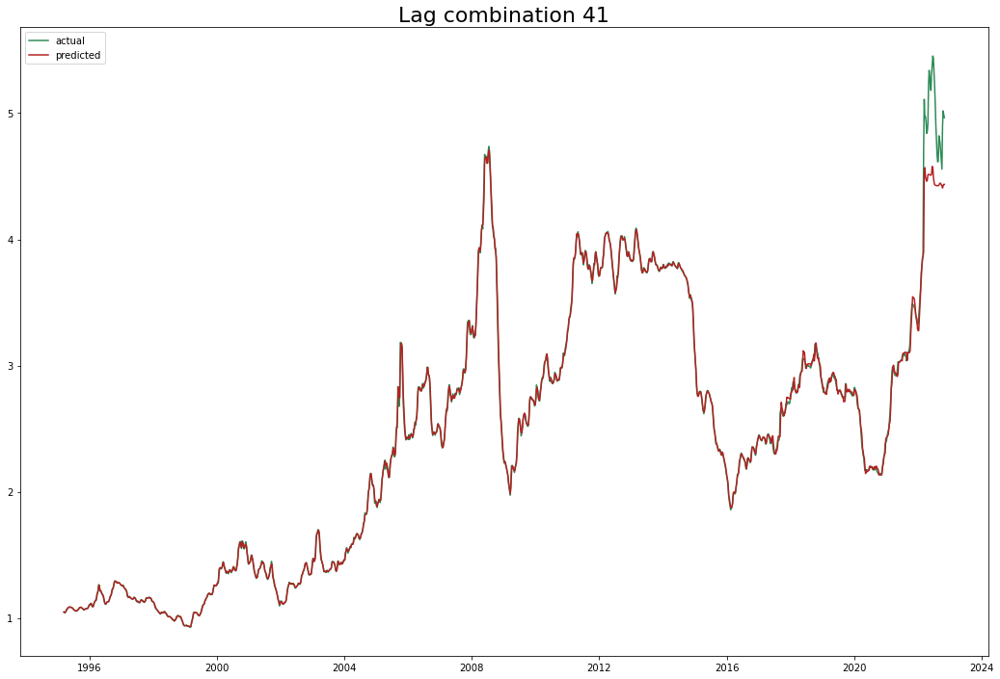

Test data rmse: 0.20391212242027348 Total rmse: 0.09236036858776579
Test data mape: 0.02064639343197978 Total mape: 0.007555253461186622
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.509) total time=   0.9s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.570) r2: (test=-0.505) total time=   1.7s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.133) neg_root_mean_squared_error: (test=-0.745) r2: (test=-0.252) total time=   2.8s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.976) total time=   3.7s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   5.1s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.514) total time=   2.4s
[CV 2/5] END n_estimators=1000; neg_m

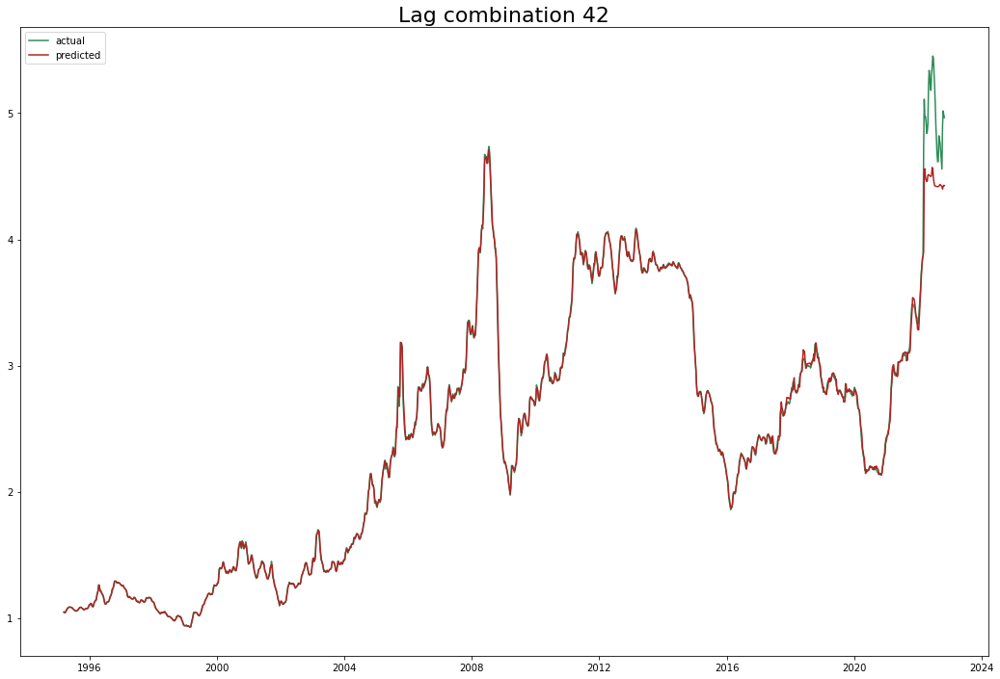

Test data rmse: 0.20599756047381473 Total rmse: 0.09326044254940394
Test data mape: 0.020889280280985162 Total mape: 0.007603390189643615
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.509) total time=   0.9s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.570) r2: (test=-0.506) total time=   1.8s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.133) neg_root_mean_squared_error: (test=-0.743) r2: (test=-0.246) total time=   2.8s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.979) total time=   3.8s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   5.1s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.507) total time=   2.3s
[CV 2/5] END n_estimators=1000; neg_m

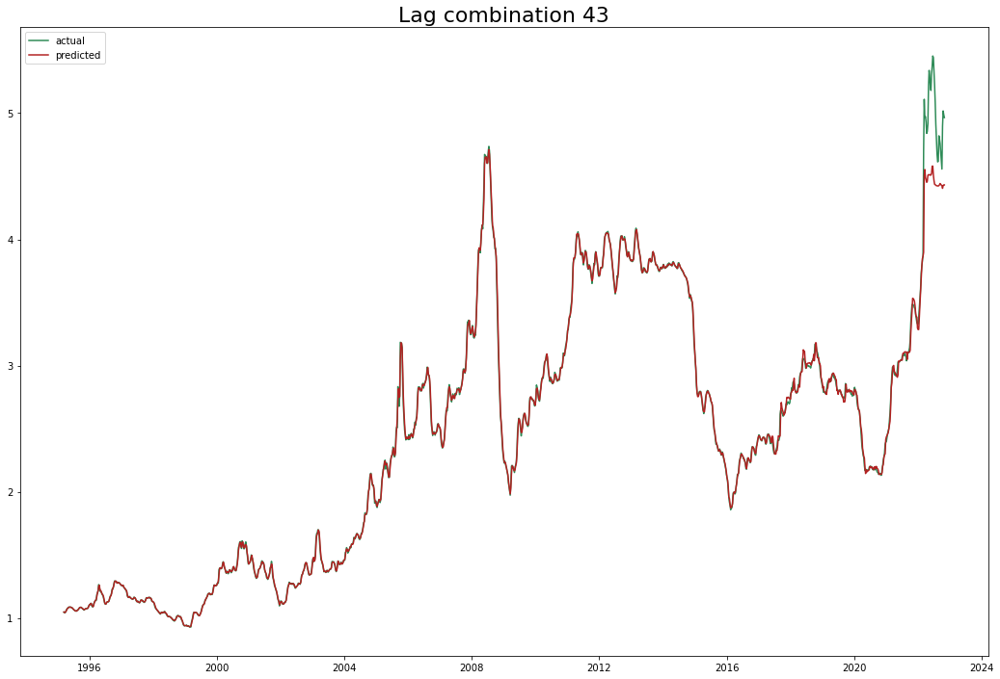

Test data rmse: 0.20401098941600204 Total rmse: 0.09234930842666508
Test data mape: 0.020735780452804116 Total mape: 0.00758078756596587
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.507) total time=   0.9s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.570) r2: (test=-0.509) total time=   1.9s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.132) neg_root_mean_squared_error: (test=-0.740) r2: (test=-0.236) total time=   3.0s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.066) r2: (test=0.976) total time=   4.0s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   5.4s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.516) total time=   2.4s
[CV 2/5] END n_estimators=1000; neg_m

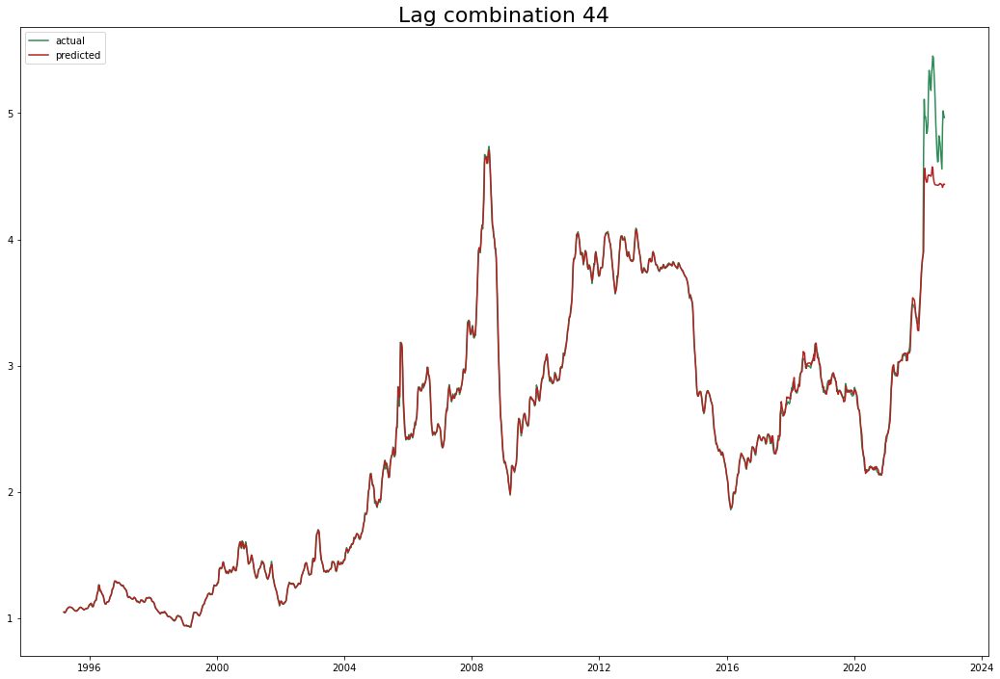

Test data rmse: 0.20471210047648994 Total rmse: 0.09269357057945557
Test data mape: 0.020717722996880725 Total mape: 0.007572392958073364
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.521) total time=   1.0s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.569) r2: (test=-0.503) total time=   1.9s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.134) neg_root_mean_squared_error: (test=-0.740) r2: (test=-0.235) total time=   3.1s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.066) r2: (test=0.977) total time=   4.1s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   5.4s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.508) total time=   2.5s
[CV 2/5] END n_estimators=1000; neg_m

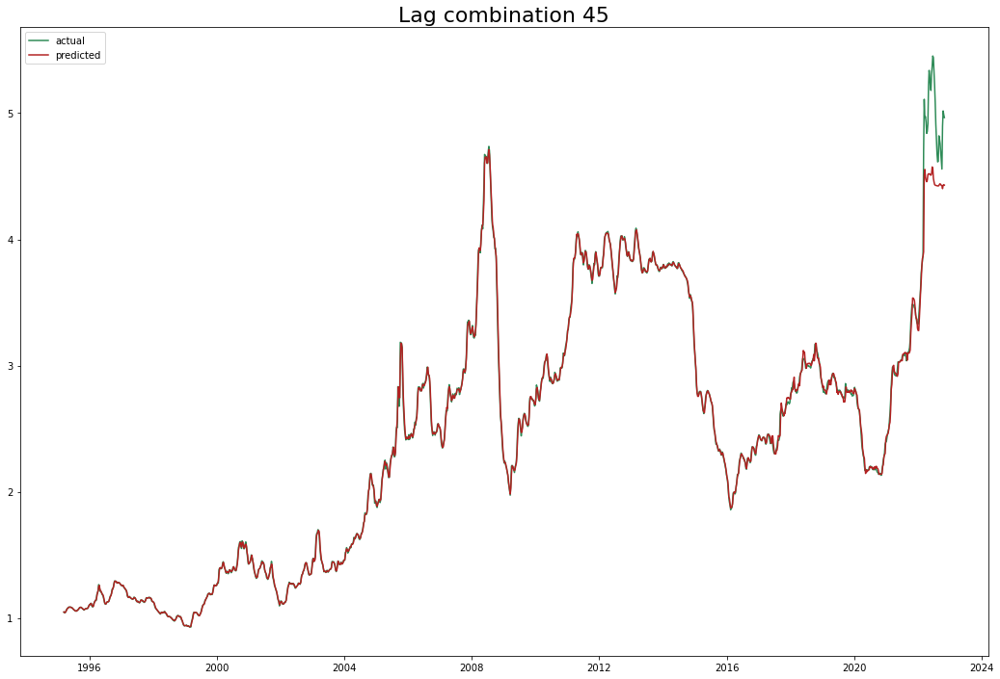

Test data rmse: 0.2044771551863946 Total rmse: 0.09258751314808993
Test data mape: 0.020727831991070682 Total mape: 0.007568331664921075
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.508) total time=   1.0s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.570) r2: (test=-0.509) total time=   1.9s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.135) neg_root_mean_squared_error: (test=-0.741) r2: (test=-0.237) total time=   3.1s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.976) total time=   4.2s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   5.6s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.509) total time=   2.5s
[CV 2/5] END n_estimators=1000; neg_m

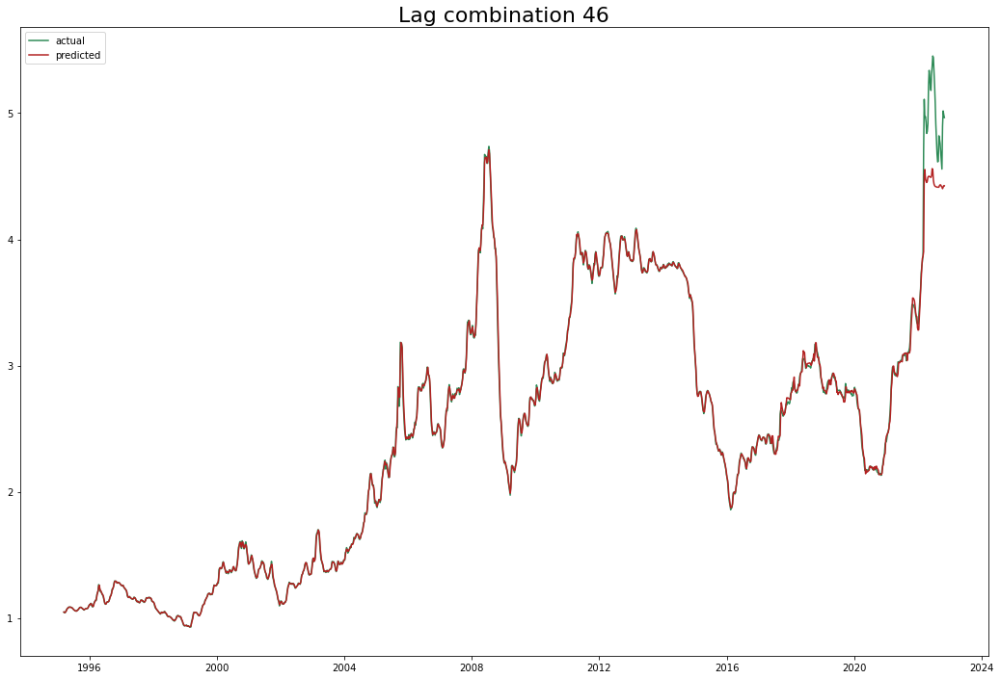

Test data rmse: 0.20815706224017644 Total rmse: 0.0942293433624573
Test data mape: 0.021092088467494528 Total mape: 0.007674090346948251
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.507) total time=   1.0s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.166) neg_root_mean_squared_error: (test=-0.572) r2: (test=-0.517) total time=   1.9s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.133) neg_root_mean_squared_error: (test=-0.736) r2: (test=-0.222) total time=   3.1s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.069) r2: (test=0.974) total time=   4.2s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   5.7s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.514) total time=   2.5s
[CV 2/5] END n_estimators=1000; neg_m

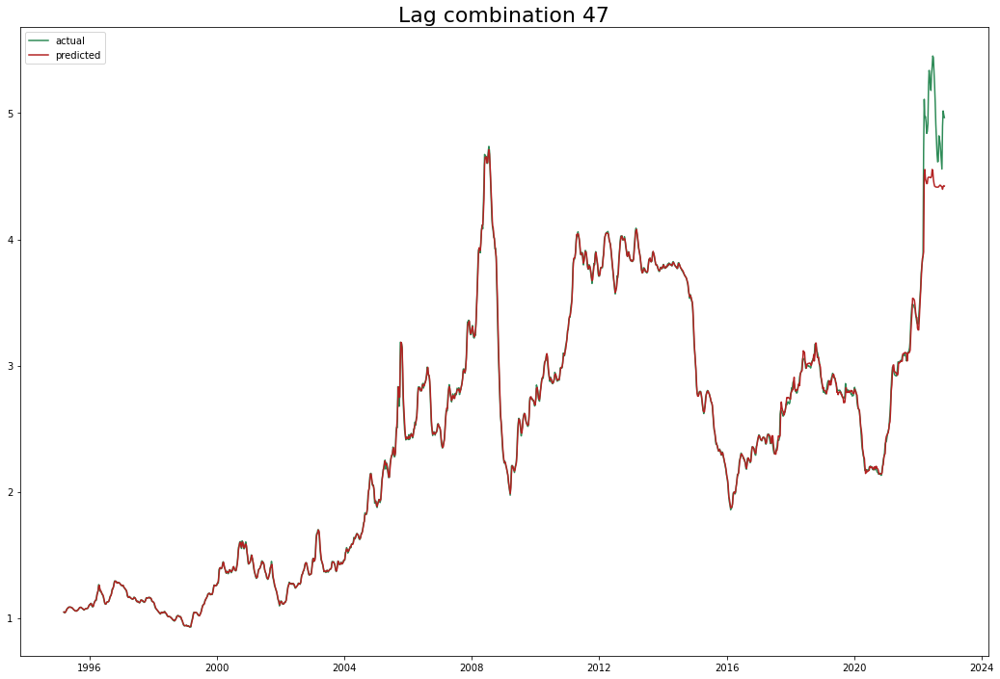

Test data rmse: 0.2089591405888373 Total rmse: 0.09456805640551193
Test data mape: 0.02124269547117063 Total mape: 0.007664876726530023
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.508) total time=   1.0s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.569) r2: (test=-0.500) total time=   2.0s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.133) neg_root_mean_squared_error: (test=-0.731) r2: (test=-0.205) total time=   3.2s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.976) total time=   4.3s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   5.8s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.506) total time=   2.6s
[CV 2/5] END n_estimators=1000; neg_m

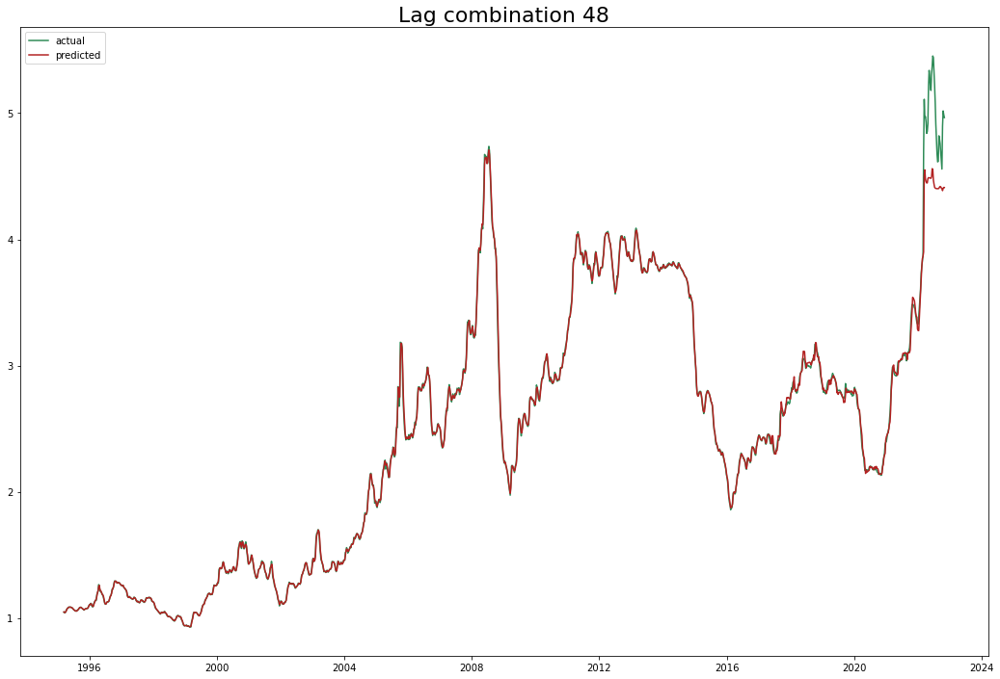

Test data rmse: 0.21066209421971988 Total rmse: 0.09534978475651812
Test data mape: 0.021416771504884562 Total mape: 0.0077018928597879345
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.518) total time=   1.0s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.571) r2: (test=-0.511) total time=   2.0s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.135) neg_root_mean_squared_error: (test=-0.740) r2: (test=-0.234) total time=   3.3s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.976) total time=   4.3s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   5.9s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.512) total time=   2.7s
[CV 2/5] END n_estimators=1000; neg_m

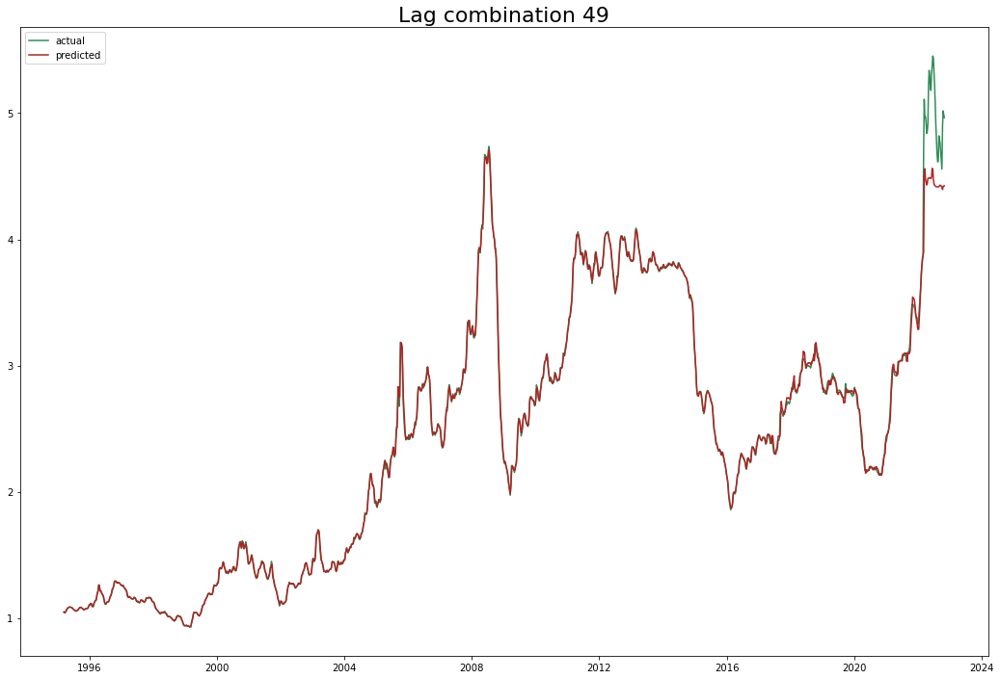

Test data rmse: 0.20912303369819 Total rmse: 0.09464055117771694
Test data mape: 0.021394606265878413 Total mape: 0.007703124754695246
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag', '51w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.512) total time=   1.0s
[CV 2/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.570) r2: (test=-0.504) total time=   2.0s
[CV 3/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.133) neg_root_mean_squared_error: (test=-0.732) r2: (test=-0.207) total time=   3.3s
[CV 4/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.071) r2: (test=0.973) total time=   4.5s
[CV 5/5] END n_estimators=400; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.996) total time=   6.0s
[CV 1/5] END n_estimators=1000; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.512) total time=   2.7s
[CV 2/5] END n_estimators=1000; neg_m

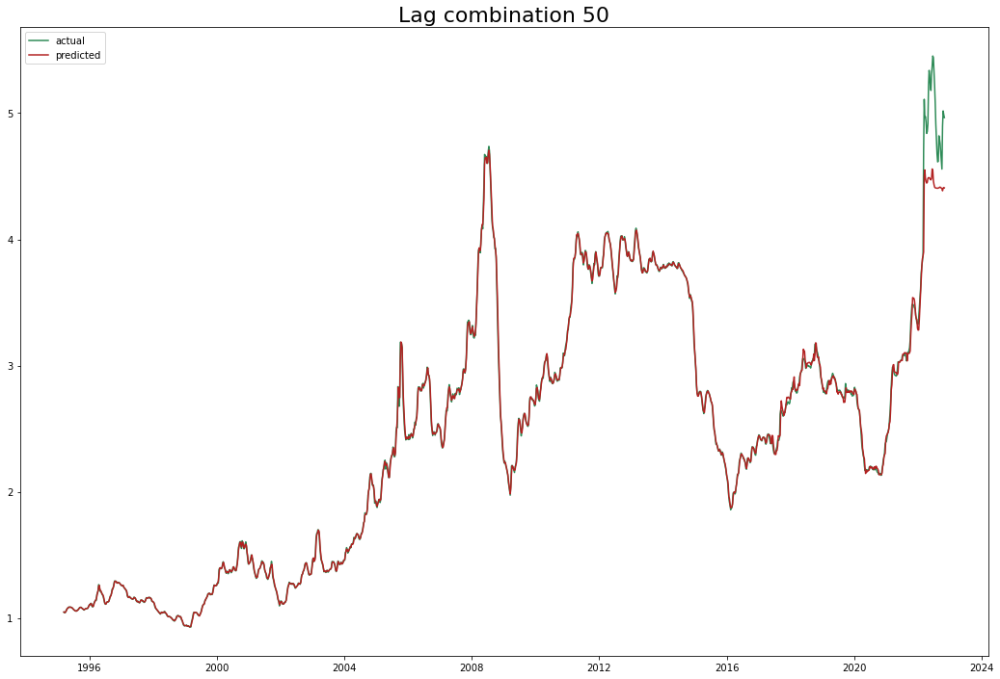

Test data rmse: 0.2113809258245192 Total rmse: 0.09562769572946747
Test data mape: 0.021412301104586598 Total mape: 0.007716696026898154


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


In [783]:
from sklearn.ensemble import RandomForestRegressor

random_forest = RandomForestRegressor()
forest_params = {'n_estimators':[400,1000]}

forest_grid_list, summary_data = test_mdl(df1.columns[3:-1],random_forest,forest_params,'RandomForestRegressor')


### DecisionTreeRegressor

--------------------------
Next model: 
Lags choosen:  ['1w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.107) r2: (test=0.623) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.144) neg_root_mean_squared_error: (test=-0.515) r2: (test=-0.229) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.083) neg_root_mean_squared_error: (test=-0.486) r2: (test=0.468) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.140) r2: (test=0.895) total time=   0.0s
[CV 5/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.986) total time=   0.0s
[CV 1/5] END max_features=sqrt; neg_mean_absolute_percentage_error: 

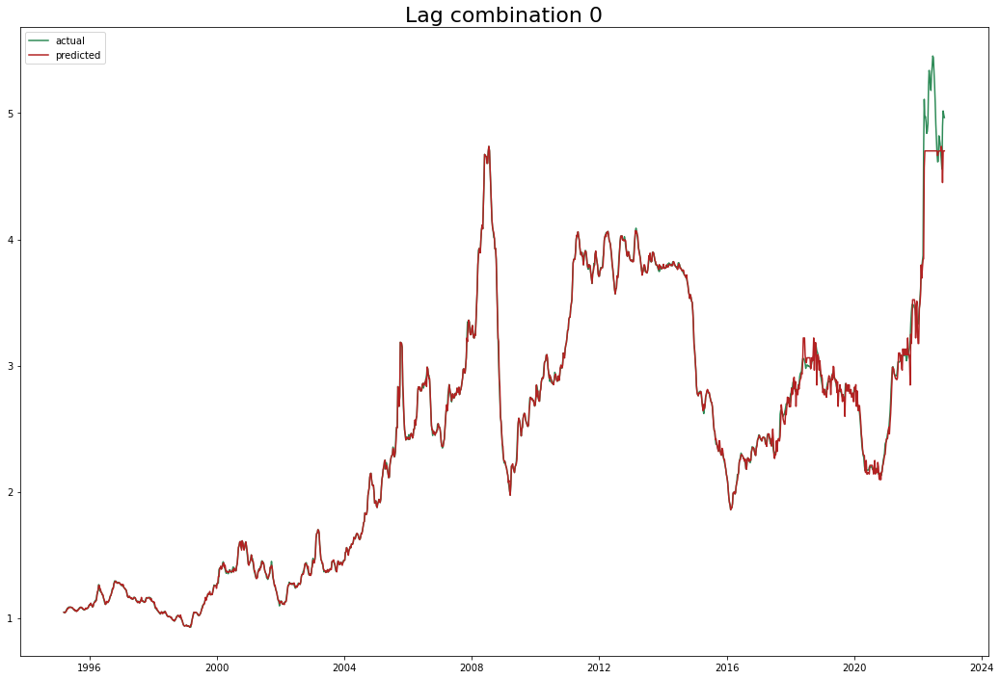

Test data rmse: 0.1591878422535305 Total rmse: 0.07232475960957879
Test data mape: 0.022867335808264513 Total mape: 0.006939382560678063
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.106) r2: (test=0.627) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.532) r2: (test=-0.314) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.088) neg_root_mean_squared_error: (test=-0.489) r2: (test=0.460) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.044) neg_root_mean_squared_error: (test=-0.209) r2: (test=0.767) total time=   0.0s
[CV 5/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.019) 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


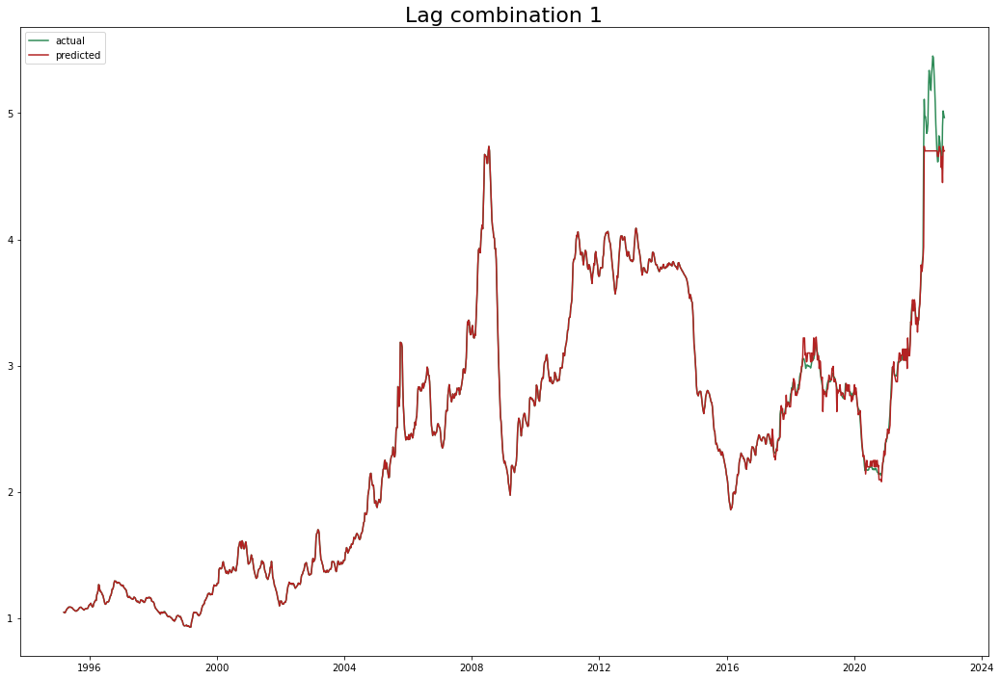

Test data rmse: 0.15029315104155622 Total rmse: 0.0671481099984853
Test data mape: 0.020724267725602274 Total mape: 0.004155728249694556
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.110) r2: (test=0.598) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.156) neg_root_mean_squared_error: (test=-0.546) r2: (test=-0.383) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.087) neg_root_mean_squared_error: (test=-0.489) r2: (test=0.460) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.034) neg_root_mean_squared_error: (test=-0.146) r2: (test=0.886) total time=   0.0s
[CV 5/5] END max_features=auto; neg_mean_absolute_percentage_error: (tes

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


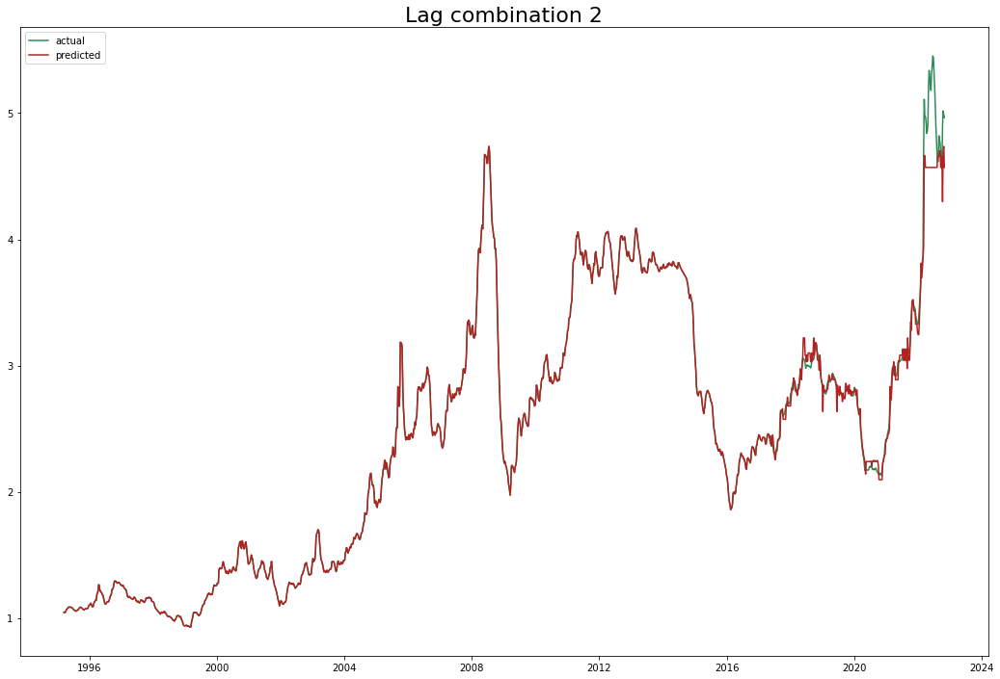

Test data rmse: 0.18192102796726564 Total rmse: 0.08127294174749095
Test data mape: 0.024133543845032975 Total mape: 0.004816674031441093
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.561) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.532) r2: (test=-0.314) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.090) neg_root_mean_squared_error: (test=-0.504) r2: (test=0.428) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.144) r2: (test=0.889) total time=   0.0s
[CV 5/5] END max_features=auto; neg_mean_absolute_percentage_

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


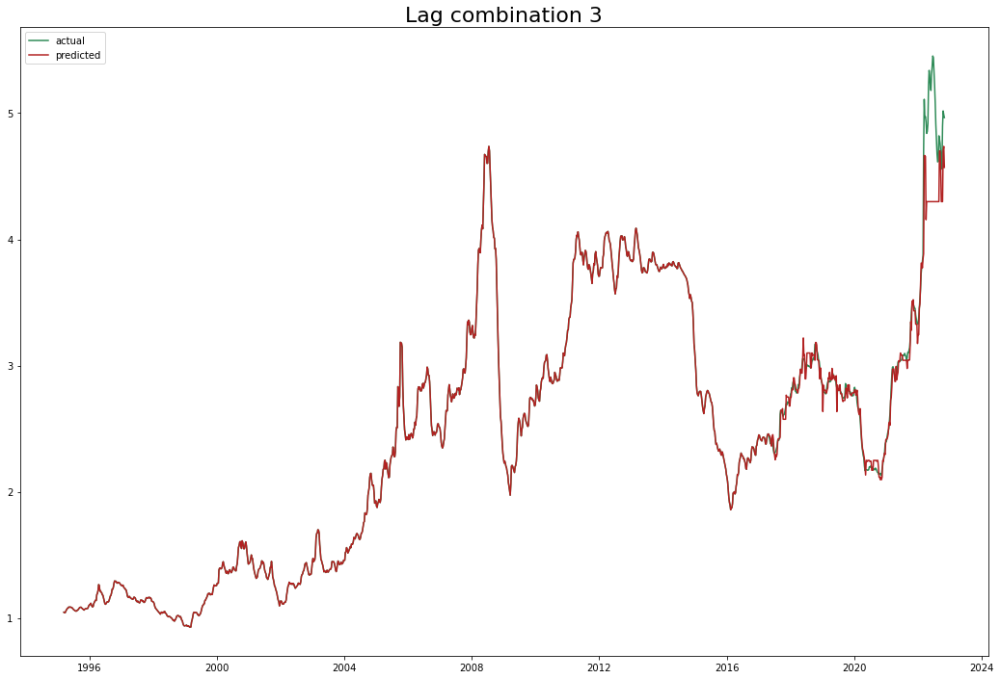

Test data rmse: 0.24545629278278167 Total rmse: 0.10965722438903355
Test data mape: 0.028017213761116672 Total mape: 0.0055917931830918935
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.559) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.532) r2: (test=-0.313) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.090) neg_root_mean_squared_error: (test=-0.502) r2: (test=0.431) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.132) r2: (test=0.907) total time=   0.0s
[CV 5/5] END max_features=auto; neg_mean_absolute_

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


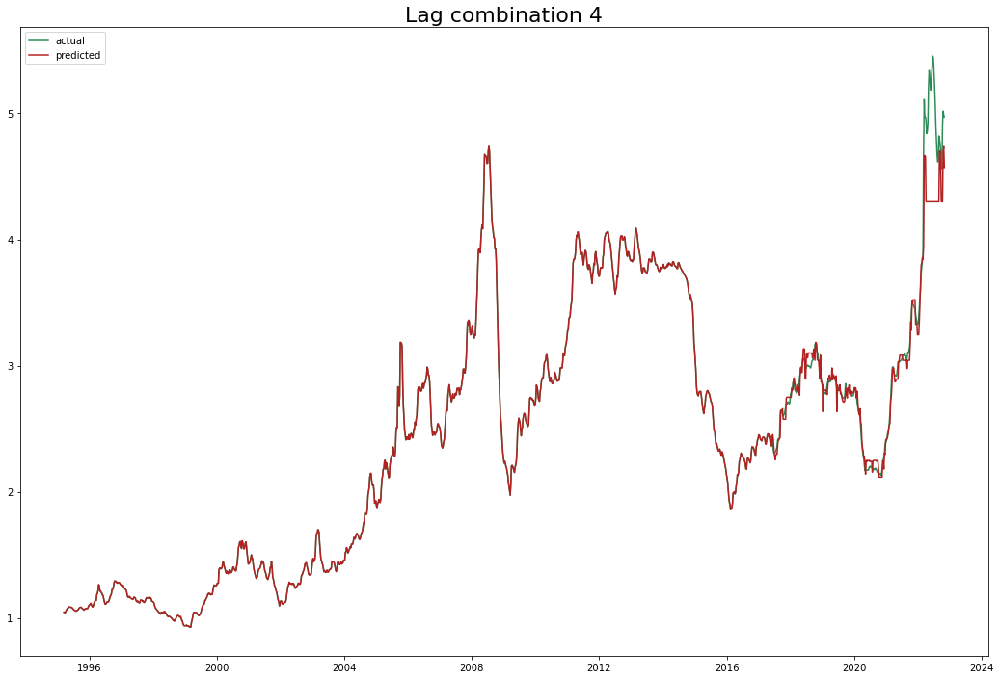

Test data rmse: 0.24409274336020537 Total rmse: 0.109048060764415
Test data mape: 0.029017823264569673 Total mape: 0.005791499029934904
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.583) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.152) neg_root_mean_squared_error: (test=-0.532) r2: (test=-0.314) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.091) neg_root_mean_squared_error: (test=-0.491) r2: (test=0.457) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.132) r2: (test=0.908) total time=   0.0s
[CV 5/5] END max_features=auto; neg_mean_ab

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


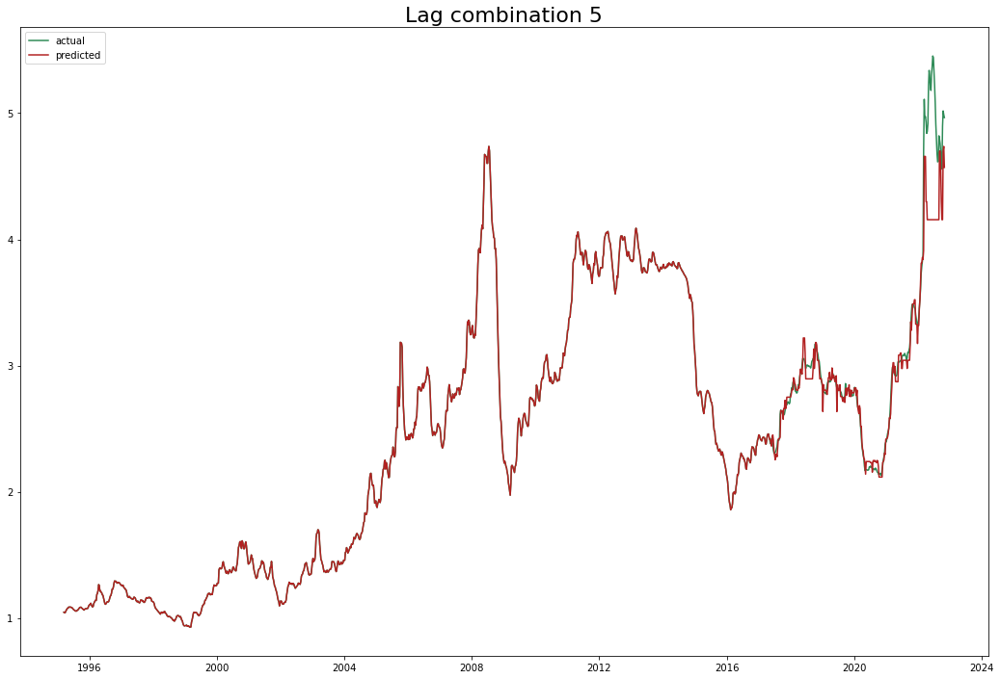

Test data rmse: 0.2793070107426594 Total rmse: 0.12477998100273806
Test data mape: 0.03137420034120049 Total mape: 0.006261794662692819
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.112) r2: (test=0.585) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.152) neg_root_mean_squared_error: (test=-0.532) r2: (test=-0.314) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.095) neg_root_mean_squared_error: (test=-0.506) r2: (test=0.423) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.136) r2: (test=0.901) total time=   0.0s
[CV 5/5] END max_features=auto; n

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


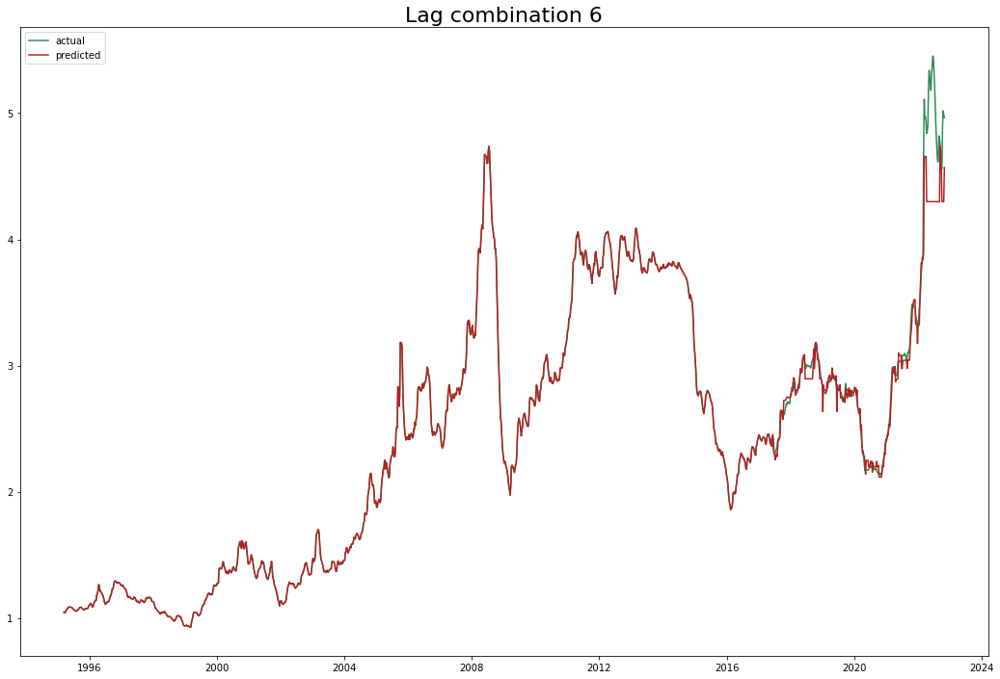

Test data rmse: 0.2490030817524598 Total rmse: 0.11124174695107164
Test data mape: 0.02885472723975229 Total mape: 0.005758947640366362
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.582) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.567) r2: (test=-0.490) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.089) neg_root_mean_squared_error: (test=-0.500) r2: (test=0.436) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.139) r2: (test=0.897) total time=   0.0s
[CV 5/5] END max_featur

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


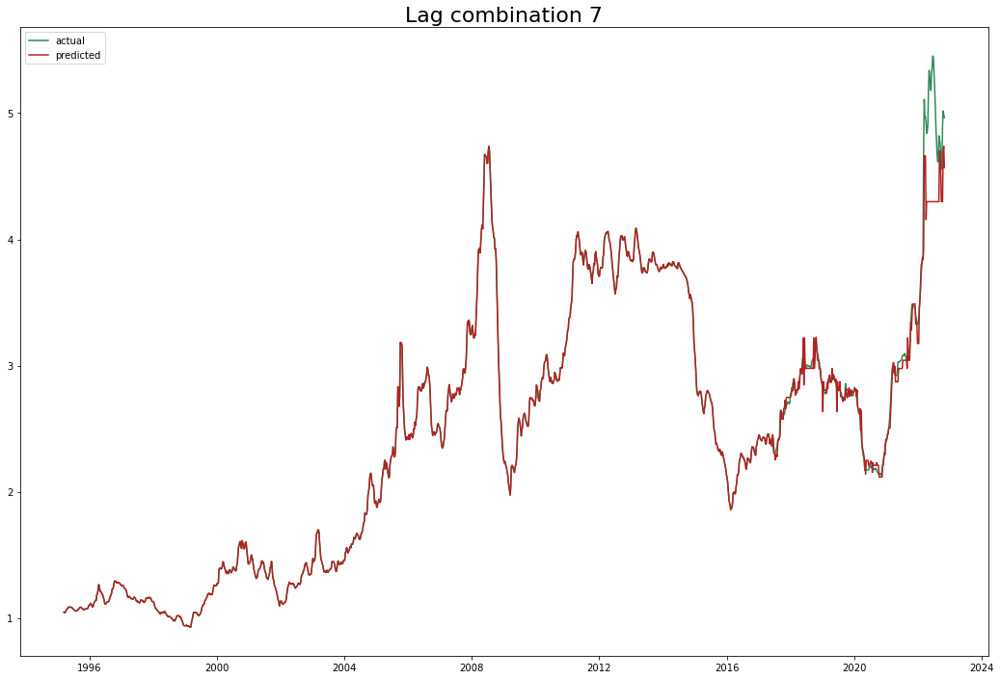

Test data rmse: 0.24622741718221022 Total rmse: 0.11000172303822821
Test data mape: 0.028350988251948834 Total mape: 0.005658409297686253
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.533) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.166) neg_root_mean_squared_error: (test=-0.567) r2: (test=-0.491) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.088) neg_root_mean_squared_error: (test=-0.488) r2: (test=0.464) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.131) r2: (test=0.908) total time=   0.0s
[CV 5/5] EN

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


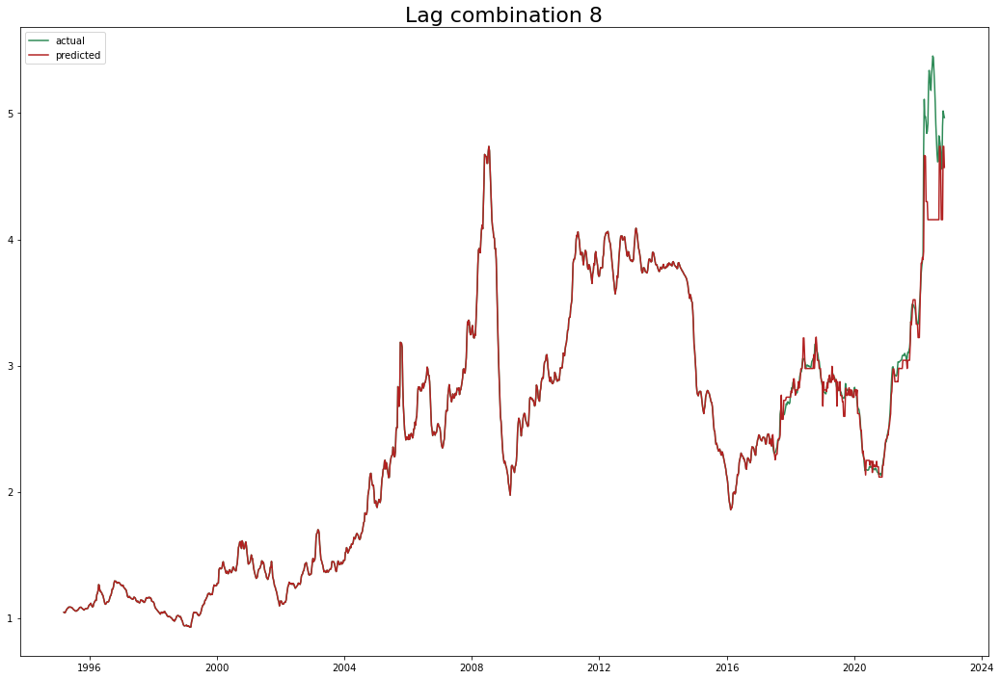

Test data rmse: 0.2782626843969163 Total rmse: 0.12431342980076143
Test data mape: 0.030514590381239146 Total mape: 0.0060902300968793295
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.531) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.166) neg_root_mean_squared_error: (test=-0.567) r2: (test=-0.490) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.073) neg_root_mean_squared_error: (test=-0.468) r2: (test=0.507) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.138) r2: (test=0.898) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


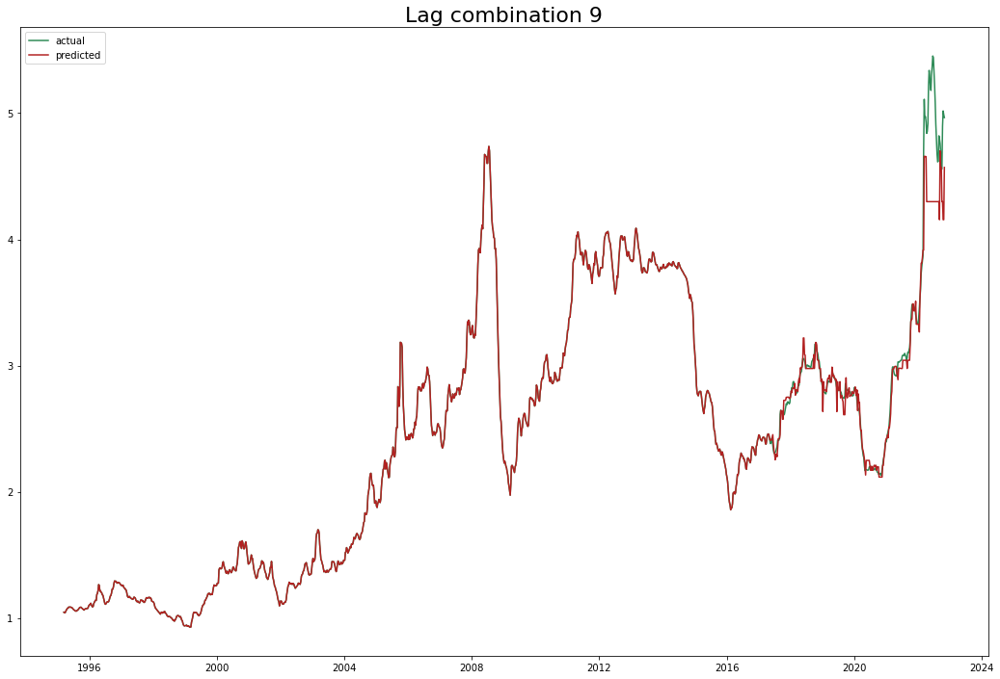

Test data rmse: 0.252763991534923 Total rmse: 0.112921927659608
Test data mape: 0.02854057439450872 Total mape: 0.005696247696201325
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.533) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.166) neg_root_mean_squared_error: (test=-0.567) r2: (test=-0.491) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.084) neg_root_mean_squared_error: (test=-0.484) r2: (test=0.472) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.139) r2: (test=0.896) total time=  

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


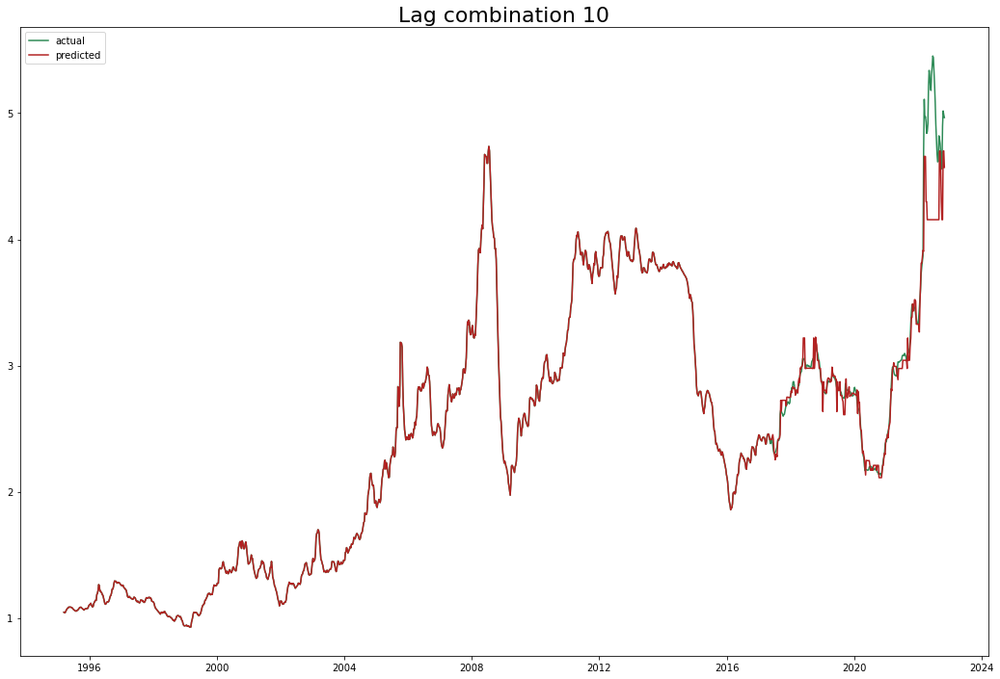

Test data rmse: 0.2794865704386449 Total rmse: 0.12486019902302459
Test data mape: 0.031008323028282794 Total mape: 0.006188771332048126
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.530) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.567) r2: (test=-0.490) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.082) neg_root_mean_squared_error: (test=-0.474) r2: (test=0.493) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.132) r2: (test=0.907

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


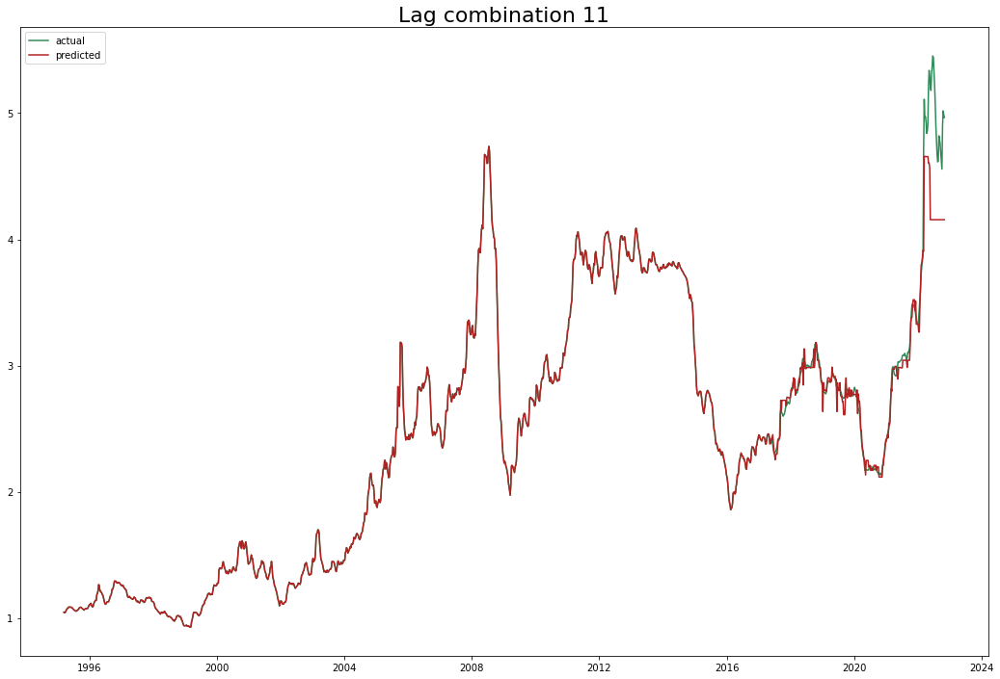

Test data rmse: 0.2723893251293899 Total rmse: 0.12168951550704028
Test data mape: 0.030286326213189392 Total mape: 0.006044672175605367
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.529) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.153) neg_root_mean_squared_error: (test=-0.532) r2: (test=-0.315) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.081) neg_root_mean_squared_error: (test=-0.475) r2: (test=0.492) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.135) r2: 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


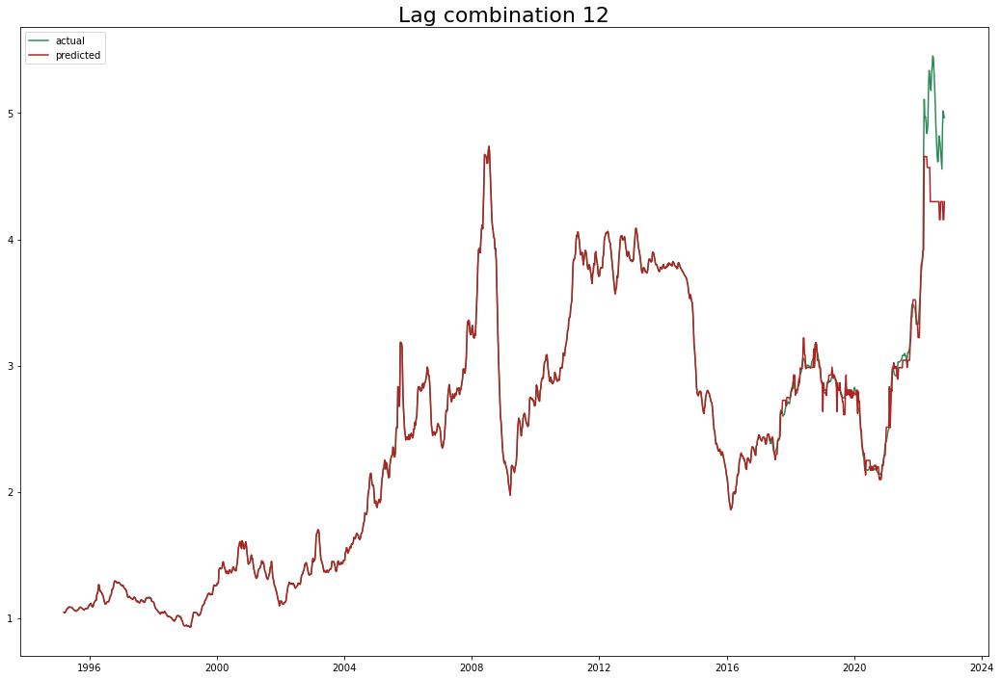

Test data rmse: 0.24567817137240514 Total rmse: 0.10975634831050088
Test data mape: 0.029855927653768915 Total mape: 0.005958771423621239
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.529) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.175) neg_root_mean_squared_error: (test=-0.595) r2: (test=-0.640) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.106) neg_root_mean_squared_error: (test=-0.507) r2: (test=0.421) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


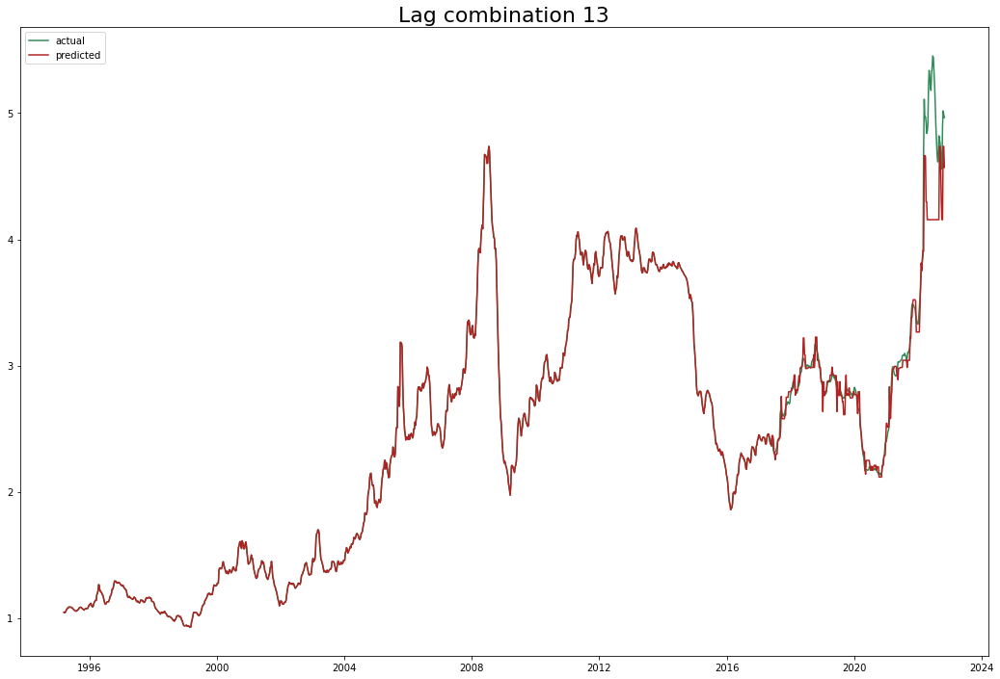

Test data rmse: 0.28006163756097224 Total rmse: 0.12511710938273418
Test data mape: 0.03212061049381806 Total mape: 0.006410766335564518
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.528) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.176) neg_root_mean_squared_error: (test=-0.595) r2: (test=-0.642) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.106) neg_root_mean_squared_error: (test=-0.507) r2: (test=0.421) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_err

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


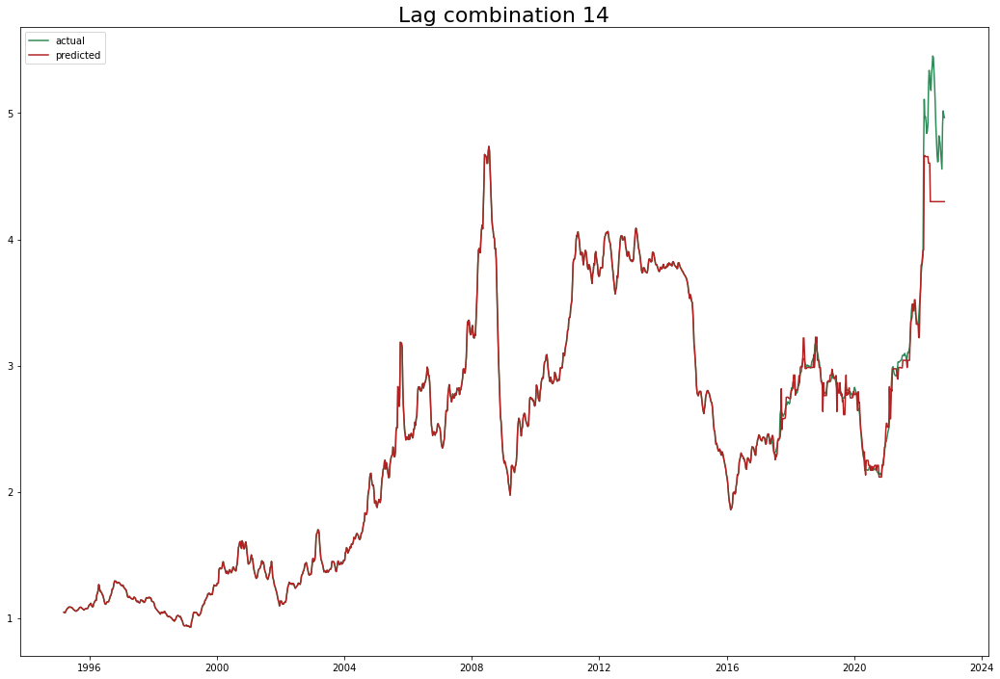

Test data rmse: 0.23843293373376265 Total rmse: 0.10651954944710576
Test data mape: 0.028971362455937726 Total mape: 0.005782226186632062
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.532) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.176) neg_root_mean_squared_error: (test=-0.594) r2: (test=-0.639) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.107) neg_root_mean_squared_error: (test=-0.507) r2: (test=0.419) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


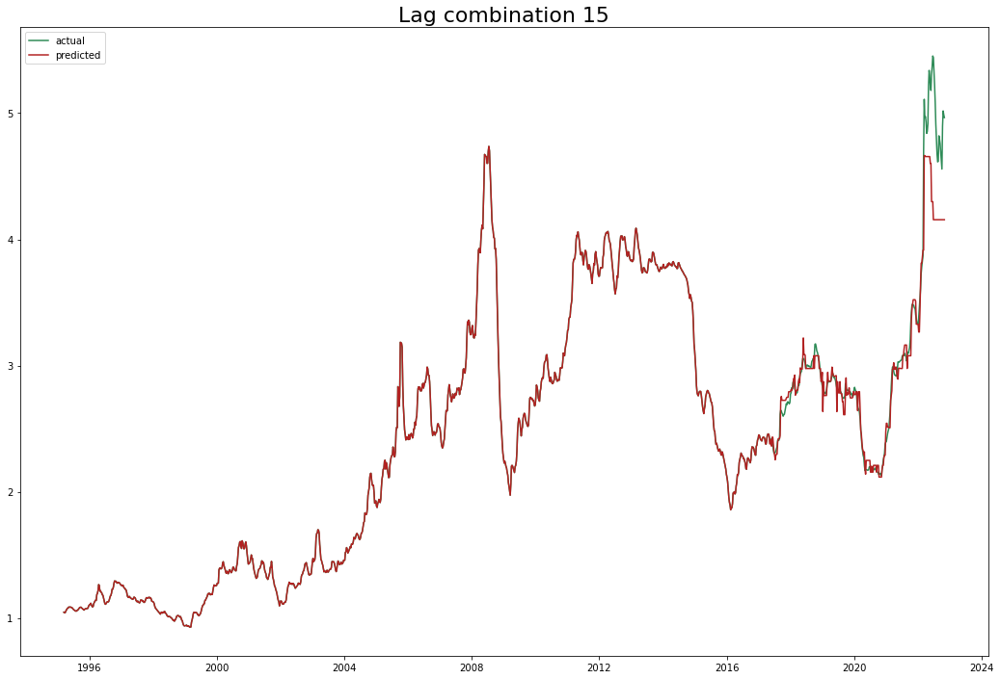

Test data rmse: 0.25617448074180493 Total rmse: 0.11444555851052443
Test data mape: 0.03157129648286517 Total mape: 0.0063011319383681
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.530) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.176) neg_root_mean_squared_error: (test=-0.595) r2: (test=-0.643) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.108) neg_root_mean_squared_error: (test=-0.515) r2: (test=0.401) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_r

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


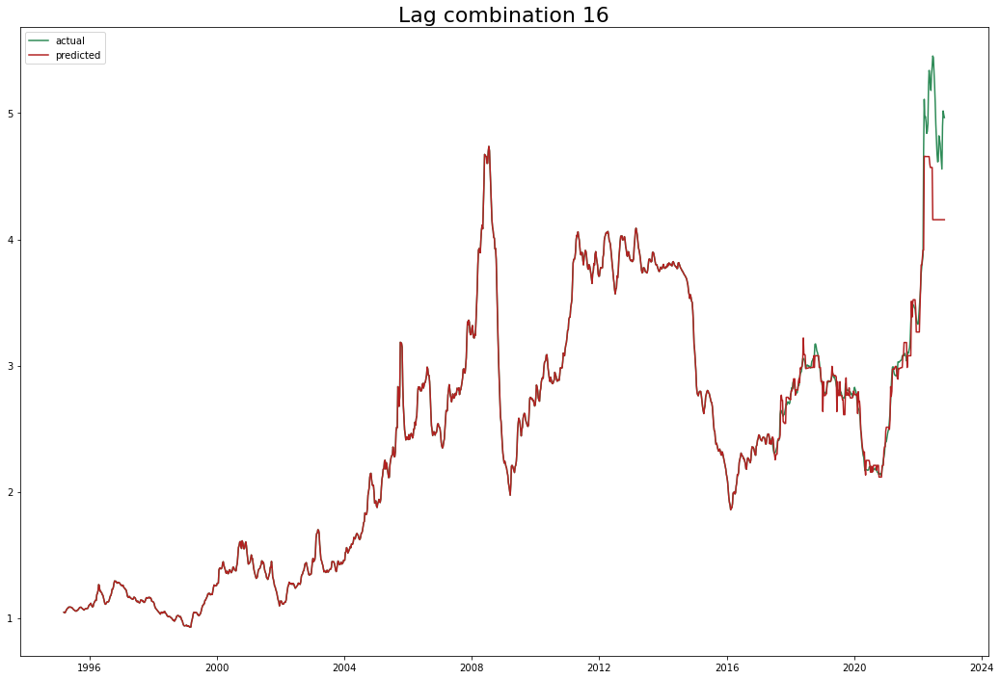

Test data rmse: 0.2525578591575052 Total rmse: 0.11282983833442474
Test data mape: 0.031024587437130522 Total mape: 0.00619201745106971
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.533) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.578) r2: (test=-0.549) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.107) neg_root_mean_squared_error: (test=-0.515) r2: (test=0.403) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


{'max_features': 'auto'}


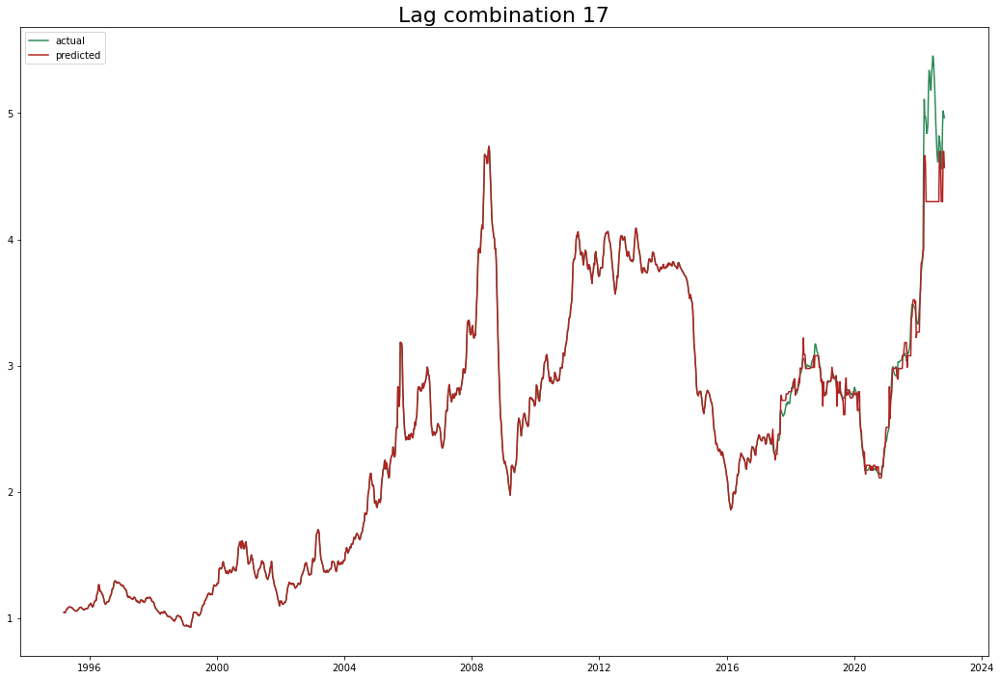

Test data rmse: 0.2465748069383136 Total rmse: 0.11015691888186947
Test data mape: 0.030055542572683655 Total mape: 0.005998611407437901
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.529) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.178) neg_root_mean_squared_error: (test=-0.595) r2: (test=-0.644) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.109) neg_root_mean_squared_error: (test=-0.509) r2: (test=0.415) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_percentage_er

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


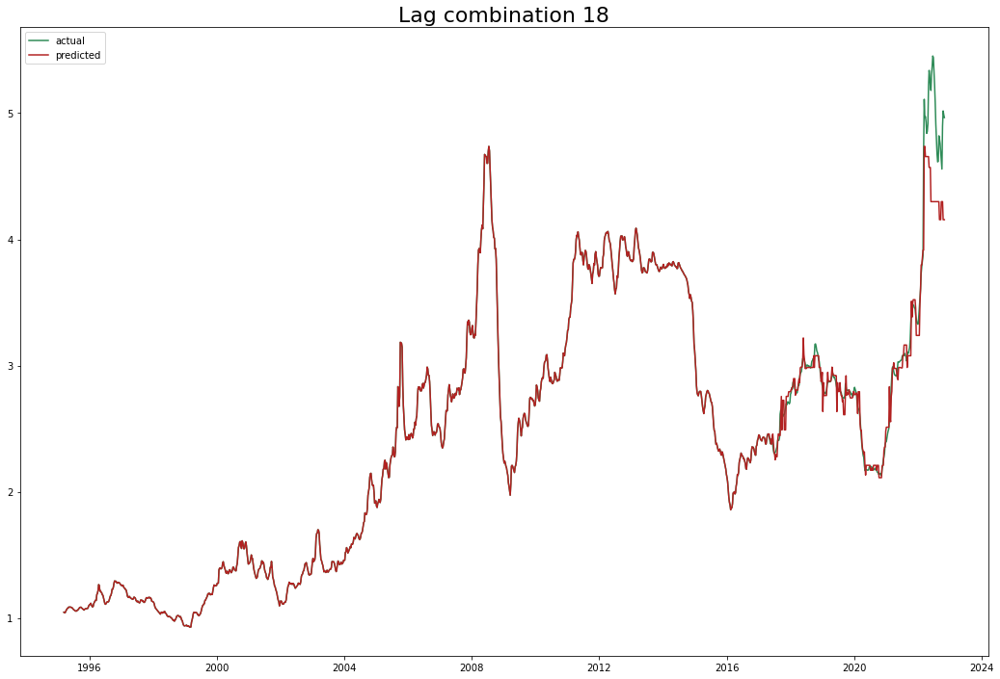

Test data rmse: 0.24435103960399993 Total rmse: 0.1091634542173329
Test data mape: 0.030969001901471855 Total mape: 0.006180923456426815
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.528) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.176) neg_root_mean_squared_error: (test=-0.578) r2: (test=-0.550) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.109) neg_root_mean_squared_error: (test=-0.509) r2: (test=0.415) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean_absolute_pe

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


{'max_features': None}


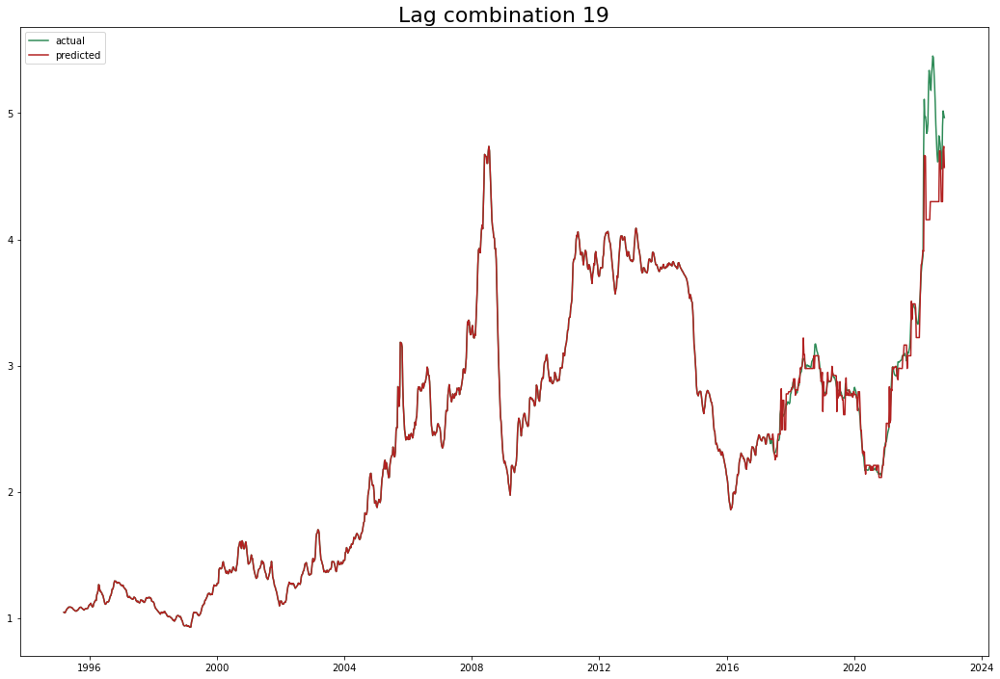

Test data rmse: 0.25901019526265756 Total rmse: 0.11571240964720139
Test data mape: 0.03192306820099579 Total mape: 0.006371340015167559
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.537) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.177) neg_root_mean_squared_error: (test=-0.595) r2: (test=-0.639) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.137) neg_root_mean_squared_error: (test=-0.713) r2: (test=-0.147) total time=   0.0s
[CV 4/5] END max_features=auto; neg_mean

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.069) r2: (test=0.990) total time=   0.0s
{'max_features': 'auto'}


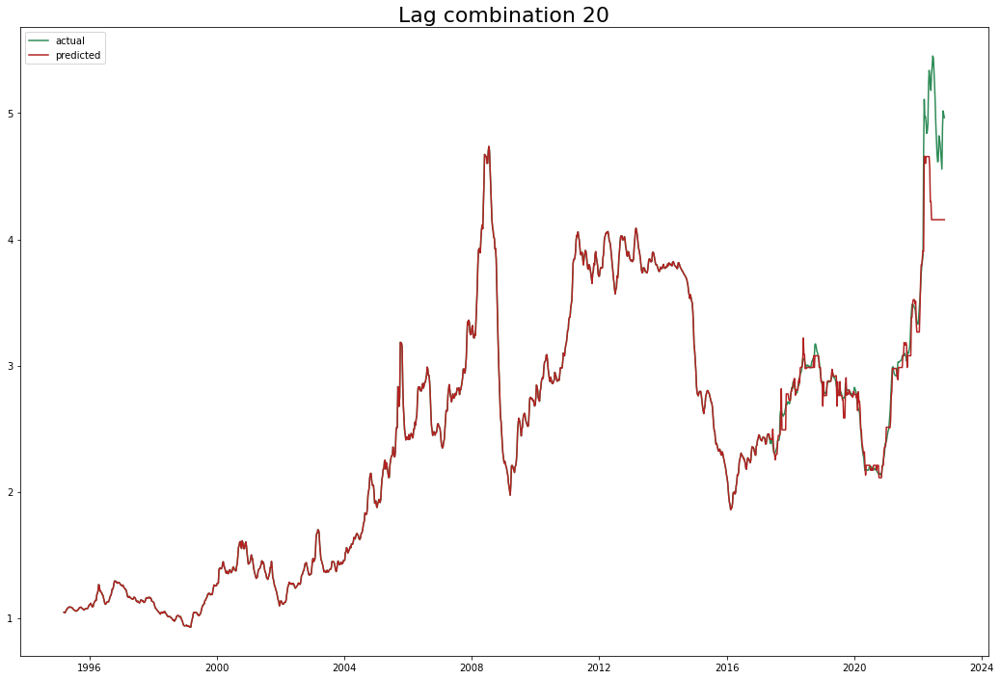

Test data rmse: 0.2697768560928334 Total rmse: 0.12052239894994066
Test data mape: 0.031966520885477405 Total mape: 0.006380012484419606
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.532) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.179) neg_root_mean_squared_error: (test=-0.596) r2: (test=-0.645) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.135) neg_root_mean_squared_error: (test=-0.711) r2: (test=-0.139) total time=   0.0s
[CV 4/5] END max_features=aut

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


{'max_features': None}


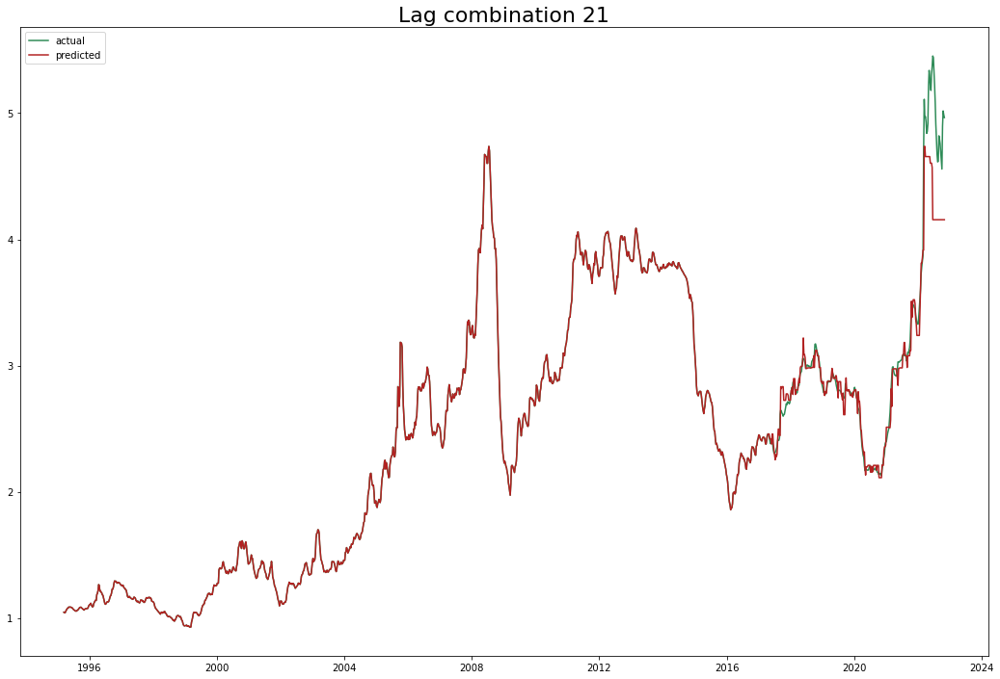

Test data rmse: 0.2512355026220972 Total rmse: 0.11223907756931424
Test data mape: 0.03080520686411197 Total mape: 0.006148232554999479
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.528) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.179) neg_root_mean_squared_error: (test=-0.596) r2: (test=-0.645) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.137) neg_root_mean_squared_error: (test=-0.713) r2: (test=-0.147) total time=   0.0s
[CV 4/5] END max_fe

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.075) r2: (test=0.988) total time=   0.0s
{'max_features': None}


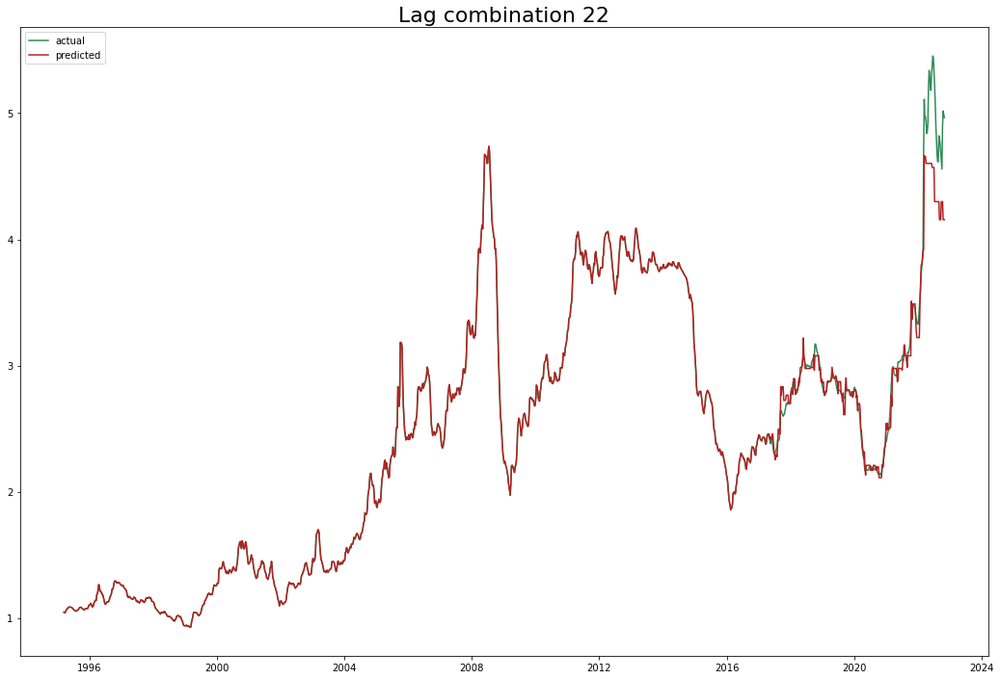

Test data rmse: 0.22252431983193804 Total rmse: 0.09941240045298856
Test data mape: 0.029384680232791324 Total mape: 0.005864717884299307
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.607) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.181) neg_root_mean_squared_error: (test=-0.596) r2: (test=-0.648) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.141) neg_root_mean_squared_error: (test=-0.716) r2: (test=-0.155) total time=   0.0s
[CV 4/

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.083) r2: (test=0.986) total time=   0.0s
{'max_features': 'auto'}


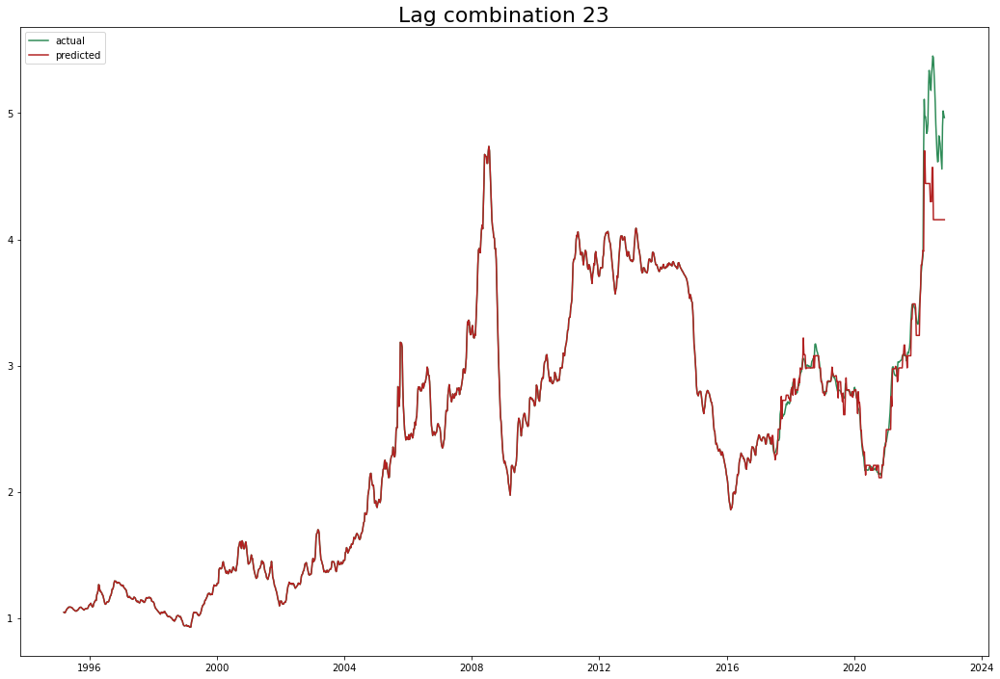

Test data rmse: 0.2656650656057988 Total rmse: 0.11868546282185993
Test data mape: 0.031655769330450716 Total mape: 0.0063179913840400595
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.579) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.181) neg_root_mean_squared_error: (test=-0.596) r2: (test=-0.648) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.148) neg_root_mean_squared_error: (test=-0.776) r2: (test=-0.359) total time=   

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.070) r2: (test=0.990) total time=   0.0s
{'max_features': None}


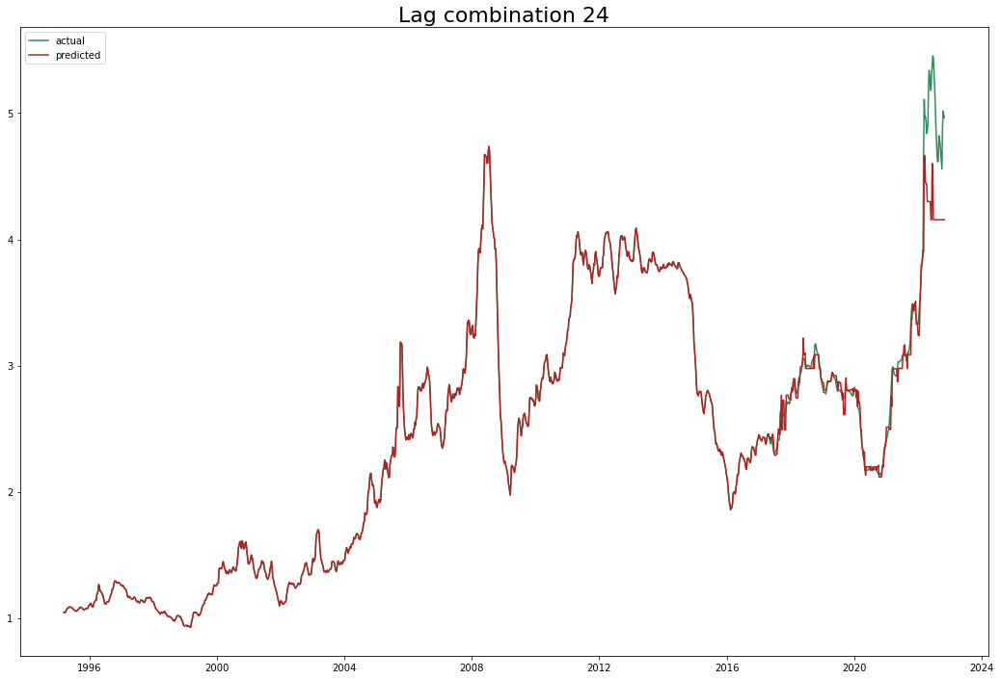

Test data rmse: 0.2766782941833751 Total rmse: 0.12360560588964327
Test data mape: 0.03252100069956551 Total mape: 0.006490677894299978
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.054) neg_root_mean_squared_error: (test=-0.108) r2: (test=0.614) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.182) neg_root_mean_squared_error: (test=-0.596) r2: (test=-0.645) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.128) neg_root_mean_squared_error: (test=-0.705) r2: (test=-0.120) total

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.070) r2: (test=0.990) total time=   0.0s
{'max_features': 'auto'}


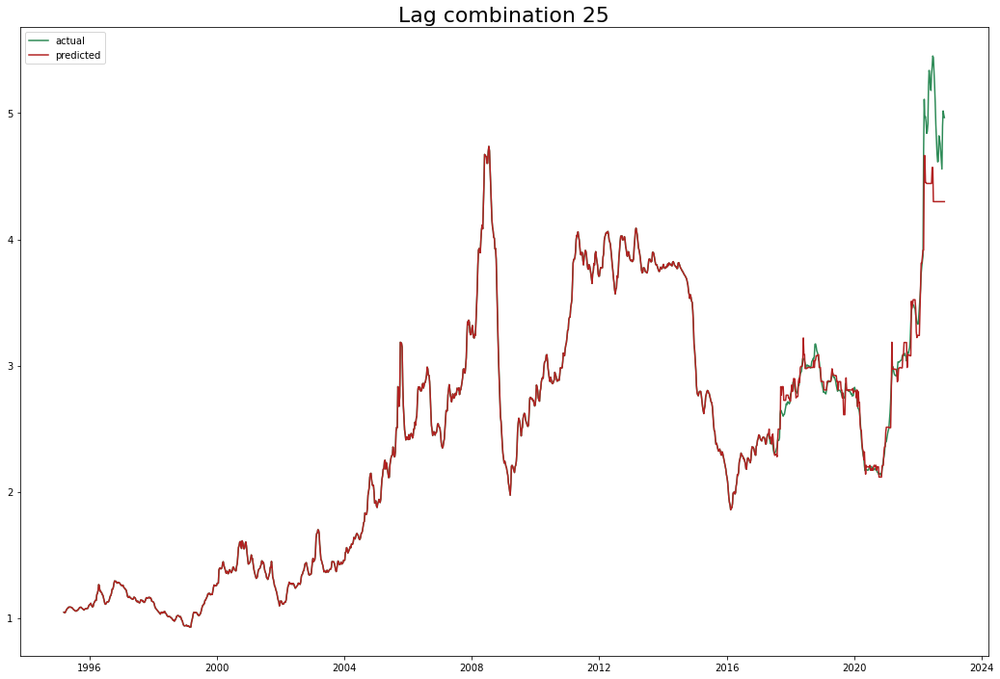

Test data rmse: 0.23759484948121243 Total rmse: 0.10614513658566754
Test data mape: 0.030824010720392037 Total mape: 0.006151985507604232
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.054) neg_root_mean_squared_error: (test=-0.108) r2: (test=0.617) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.181) neg_root_mean_squared_error: (test=-0.596) r2: (test=-0.645) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.148) neg_root_mean_squared_error: (test=-0.777) r2: (test=

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.071) r2: (test=0.989) total time=   0.0s
{'max_features': None}


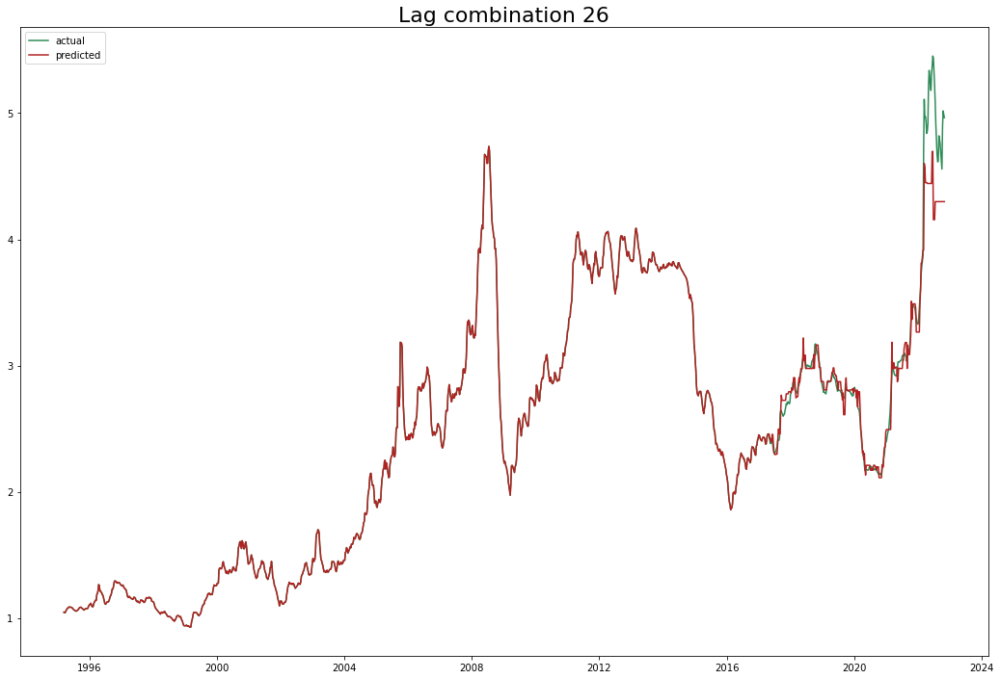

Test data rmse: 0.241137552953588 Total rmse: 0.1077278339580176
Test data mape: 0.0305099855103313 Total mape: 0.006089311037405001
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.611) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.577) r2: (test=-0.545) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.139) neg_root_mean_squared_error: (test=-0.718) r2: 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


{'max_features': 'auto'}


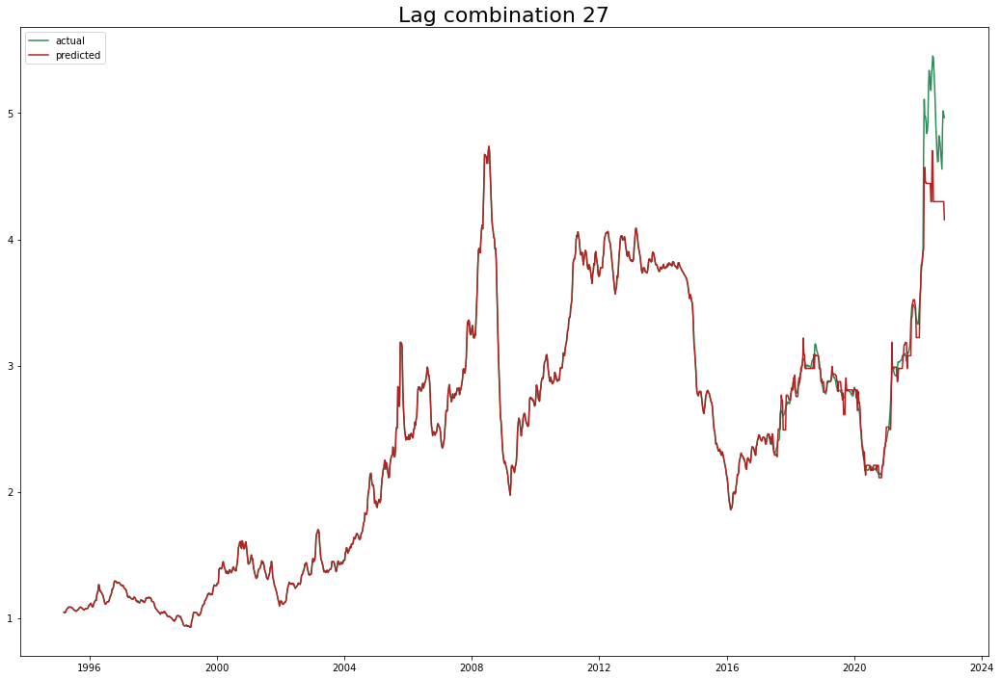

Test data rmse: 0.24046850971939476 Total rmse: 0.10742893991368027
Test data mape: 0.030889005660576396 Total mape: 0.00616495747071795
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.570) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.171) neg_root_mean_squared_error: (test=-0.577) r2: (test=-0.543) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.140) neg_root_mean_squared_error: (te

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.077) r2: (test=0.987) total time=   0.0s
{'max_features': 'auto'}


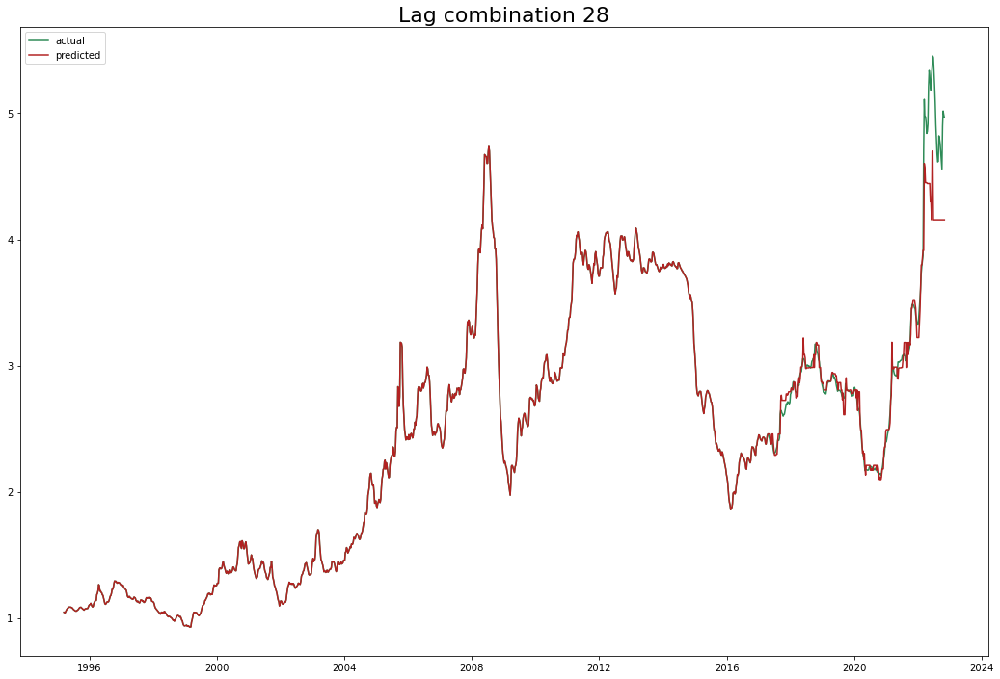

Test data rmse: 0.2658069670832577 Total rmse: 0.11874885709046243
Test data mape: 0.0321437187308676 Total mape: 0.006415378374559853
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.514) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.171) neg_root_mean_squared_error: (test=-0.577) r2: (test=-0.545) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.143) neg_root_mean_squared_e

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.141) r2: (test=0.894) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.990) total time=   0.0s
{'max_features': None}


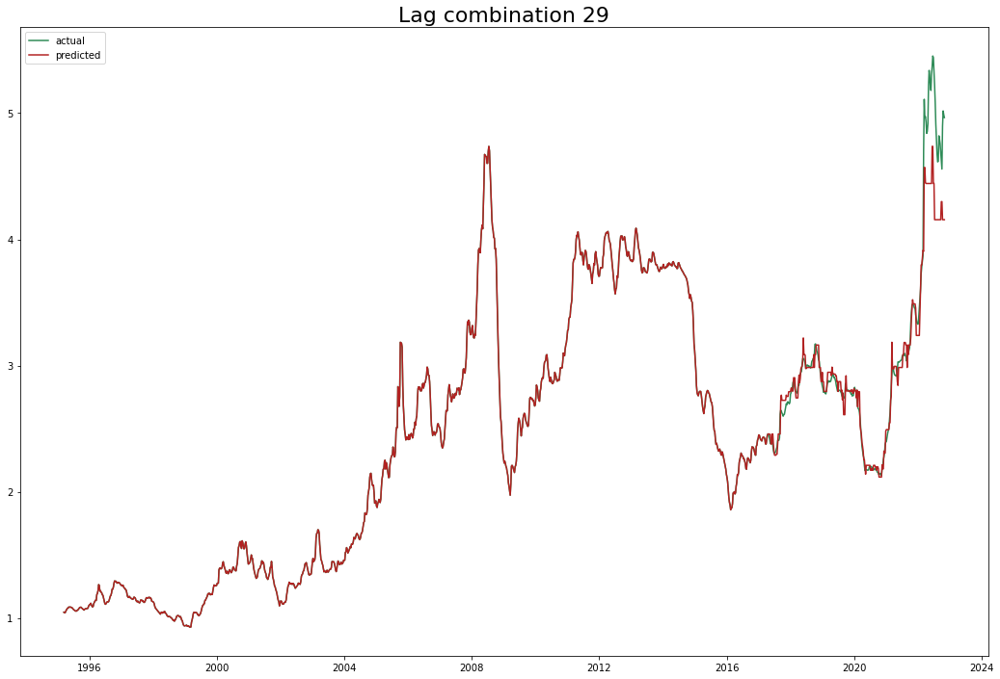

Test data rmse: 0.2491115881153131 Total rmse: 0.11129022200316398
Test data mape: 0.031690792067508994 Total mape: 0.006324981368983083
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.501) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.181) neg_root_mean_squared_error: (test=-0.596) r2: (test=-0.648) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.145) neg_root_m

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.138) r2: (test=0.898) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.074) r2: (test=0.988) total time=   0.0s
{'max_features': None}


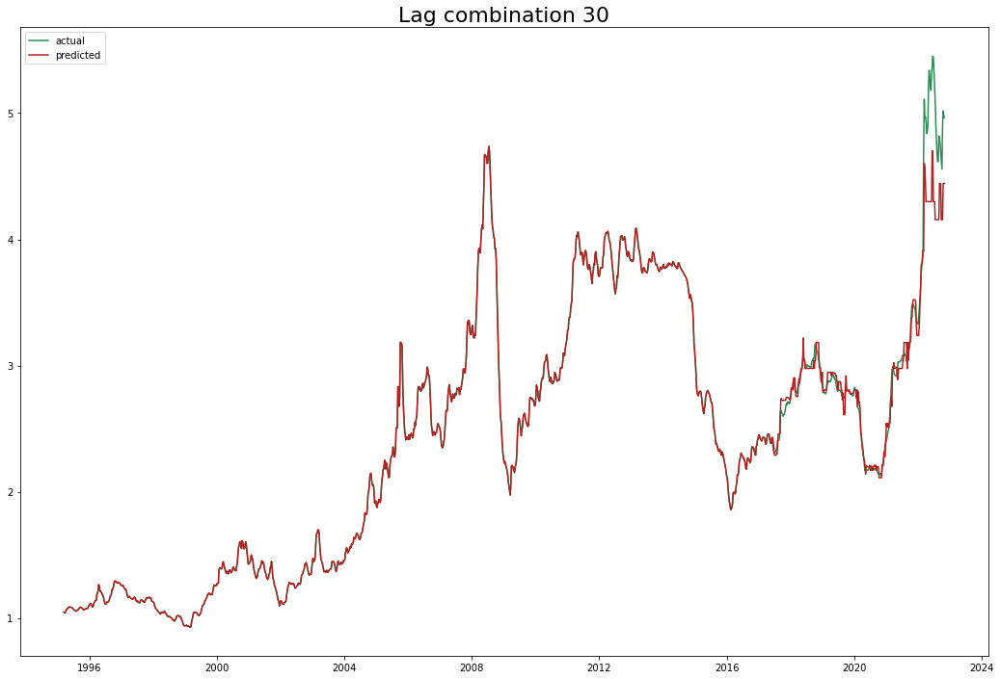

Test data rmse: 0.25375599336107646 Total rmse: 0.11336510296227216
Test data mape: 0.03138265754552744 Total mape: 0.006263482587049135
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.070) neg_root_mean_squared_error: (test=-0.132) r2: (test=0.429) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.181) neg_root_mean_squared_error: (test=-0.596) r2: (test=-0.645) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.145)

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.991) total time=   0.0s
{'max_features': None}


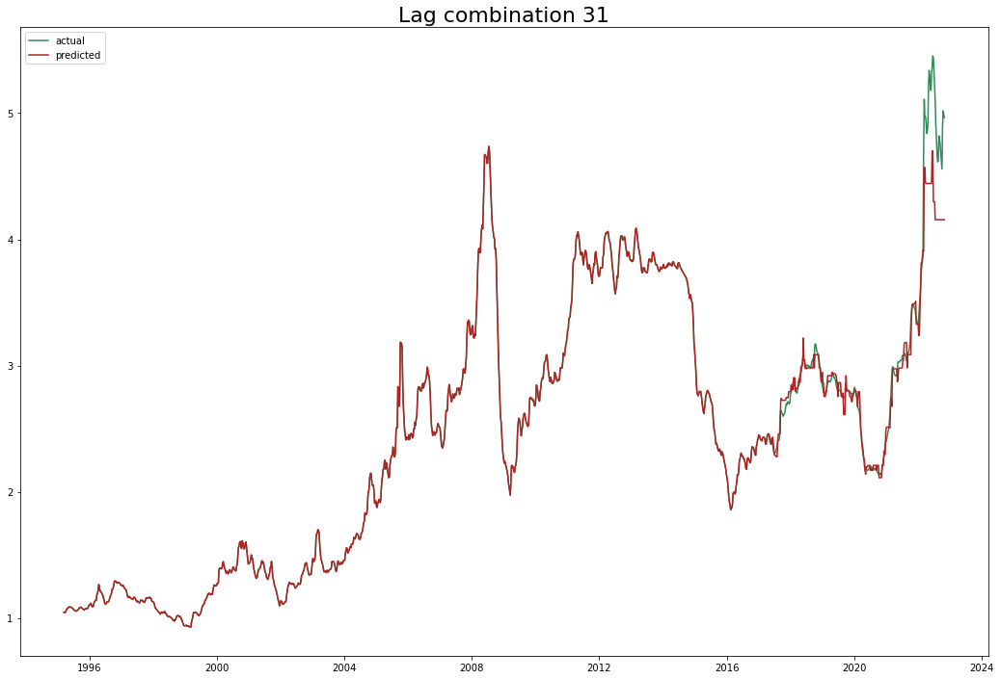

Test data rmse: 0.25310971490201206 Total rmse: 0.11307637904649895
Test data mape: 0.031549772203442746 Total mape: 0.00629683603228795
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.533) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.577) r2: (test=-0.546) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentage_error: (t

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.159) r2: (test=0.865) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.075) r2: (test=0.988) total time=   0.0s
{'max_features': None}


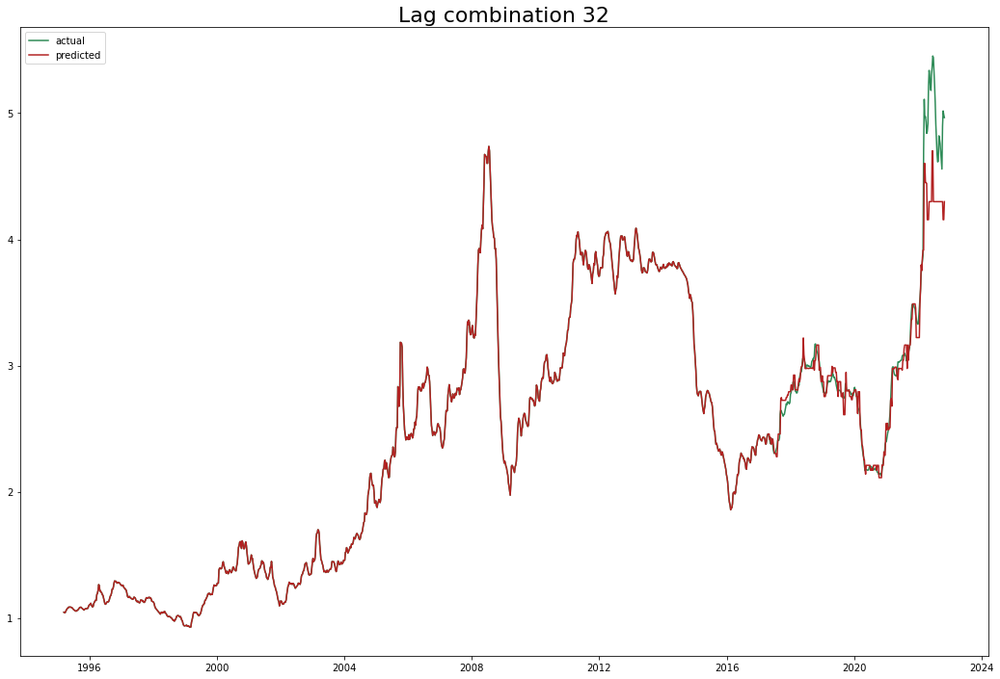

Test data rmse: 0.25527337606530326 Total rmse: 0.11404299137081542
Test data mape: 0.03215259421878795 Total mape: 0.006417149781712357
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.575) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.181) neg_root_mean_squared_error: (test=-0.596) r2: (test=-0.648) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute_percentag

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.047) neg_root_mean_squared_error: (test=-0.210) r2: (test=0.765) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.079) r2: (test=0.987) total time=   0.0s
{'max_features': 'auto'}


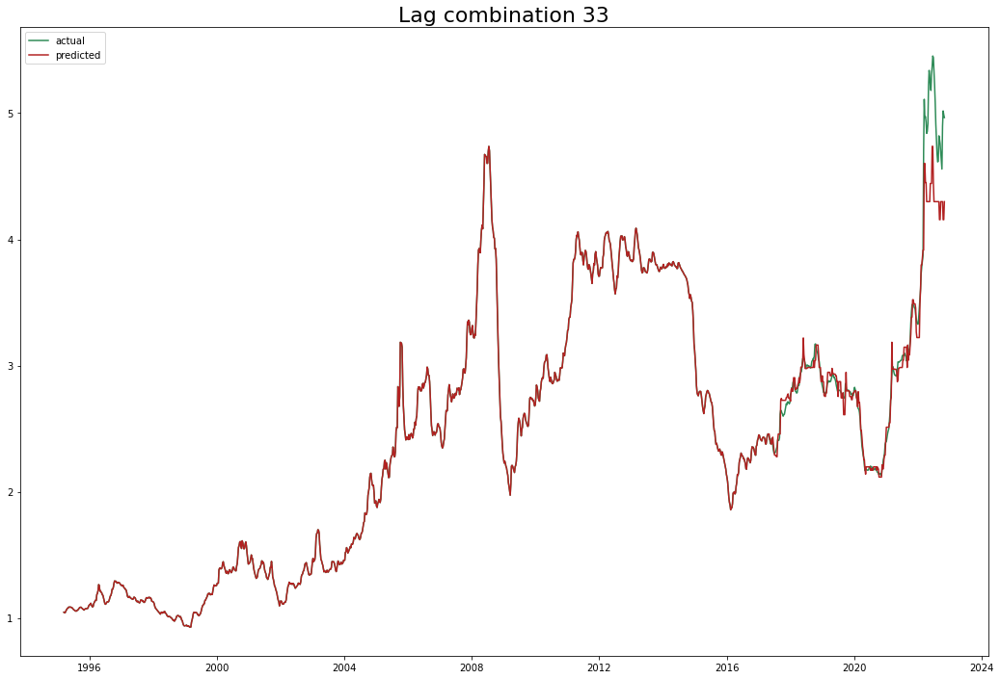

Test data rmse: 0.2446729747710877 Total rmse: 0.1093072782621591
Test data mape: 0.030331463565168013 Total mape: 0.006053680877871372
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.112) r2: (test=0.588) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.177) neg_root_mean_squared_error: (test=-0.595) r2: (test=-0.639) total time=   0.0s
[CV 3/5] END max_features=auto; neg_mean_absolute

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.154) neg_root_mean_squared_error: (test=-0.789) r2: (test=-0.404) total time=   0.0s
[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.050) neg_root_mean_squared_error: (test=-0.217) r2: (test=0.749) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.072) r2: (test=0.989) total time=   0.0s
{'max_features': 'auto'}


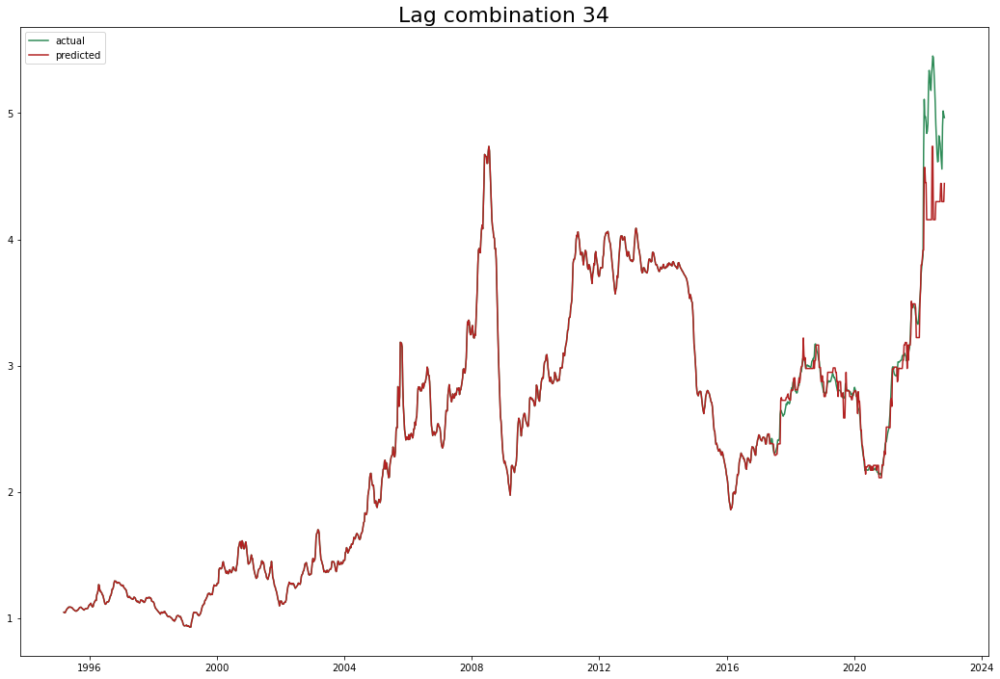

Test data rmse: 0.2695693453351929 Total rmse: 0.12042969383549541
Test data mape: 0.03238520311193023 Total mape: 0.006463574841466324
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.529) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.172) neg_root_mean_squared_error: (test=-0.577) r2: (test=-0.546) total time=   0.0s
[CV 3/5] END max_features=auto; neg_me

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.048) neg_root_mean_squared_error: (test=-0.213) r2: (test=0.758) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.078) r2: (test=0.987) total time=   0.0s
{'max_features': 'auto'}


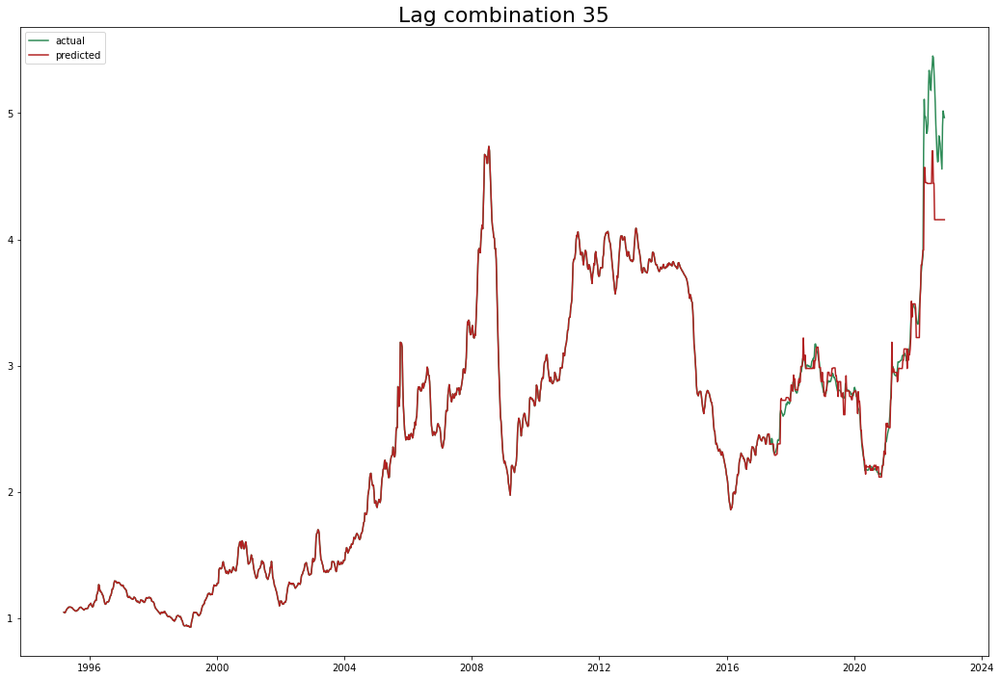

Test data rmse: 0.2509326492197548 Total rmse: 0.11210377827378128
Test data mape: 0.03165951220441343 Total mape: 0.006318738402544053
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.501) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.172) neg_root_mean_squared_error: (test=-0.577) r2: (test=-0.545) total time=   0.0s
[CV 3/5] END max_features=a

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.167) neg_root_mean_squared_error: (test=-0.832) r2: (test=-0.561) total time=   0.0s
[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.045) neg_root_mean_squared_error: (test=-0.209) r2: (test=0.767) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.082) r2: (test=0.986) total time=   0.0s
{'max_features': 'auto'}


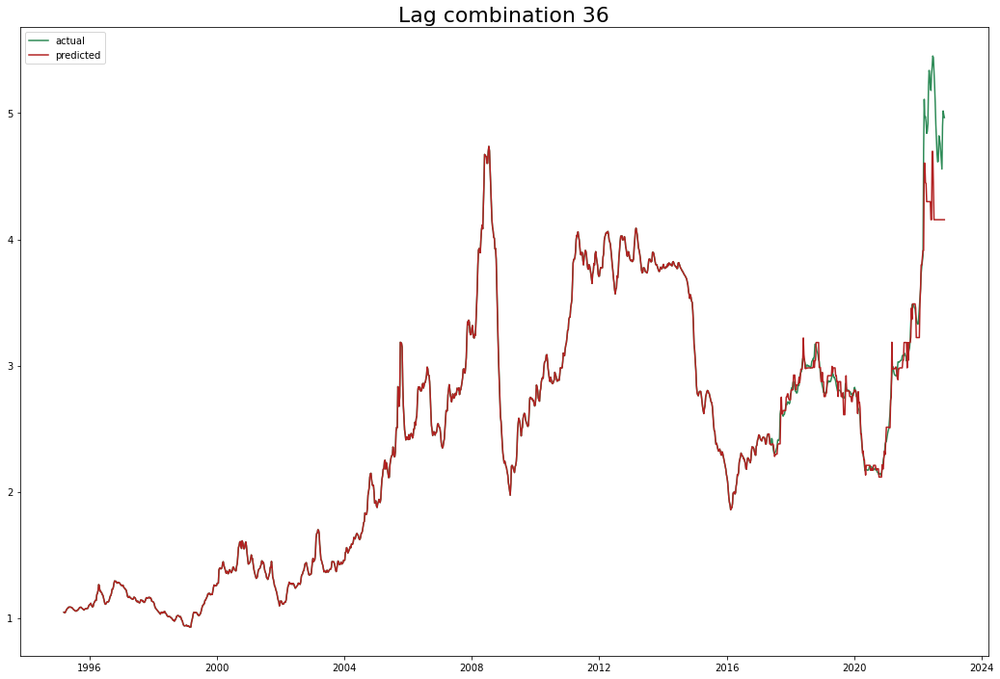

Test data rmse: 0.2714710824583553 Total rmse: 0.12127929199441541
Test data mape: 0.0325107971496745 Total mape: 0.006488641426962064
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.506) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.180) neg_root_mean_squared_error: (test=-0.595) r2: (test=-0.644) total time=   0.0s
[CV 3/5] END max_

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.044) neg_root_mean_squared_error: (test=-0.206) r2: (test=0.775) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.991) total time=   0.0s
{'max_features': None}


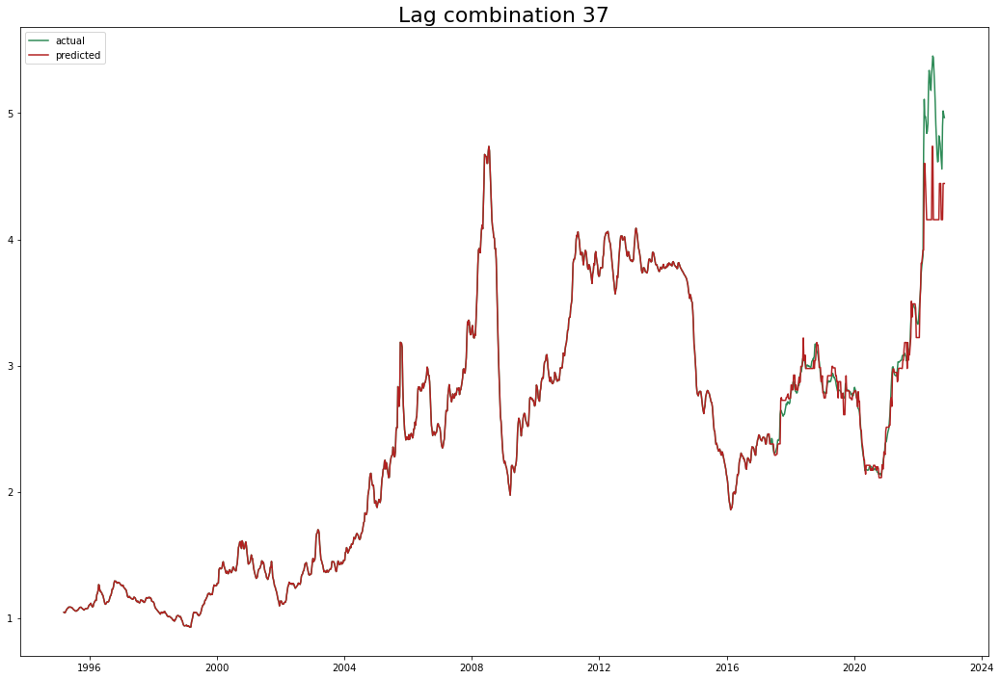

Test data rmse: 0.274802157368614 Total rmse: 0.12276744462945163
Test data mape: 0.03293797638666589 Total mape: 0.006573899653055978
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.112) r2: (test=0.583) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.577) r2: (test=-0.545) total time=   0.0s
[CV 3/

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.128) r2: (test=0.913) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.079) r2: (test=0.987) total time=   0.0s
{'max_features': 'auto'}


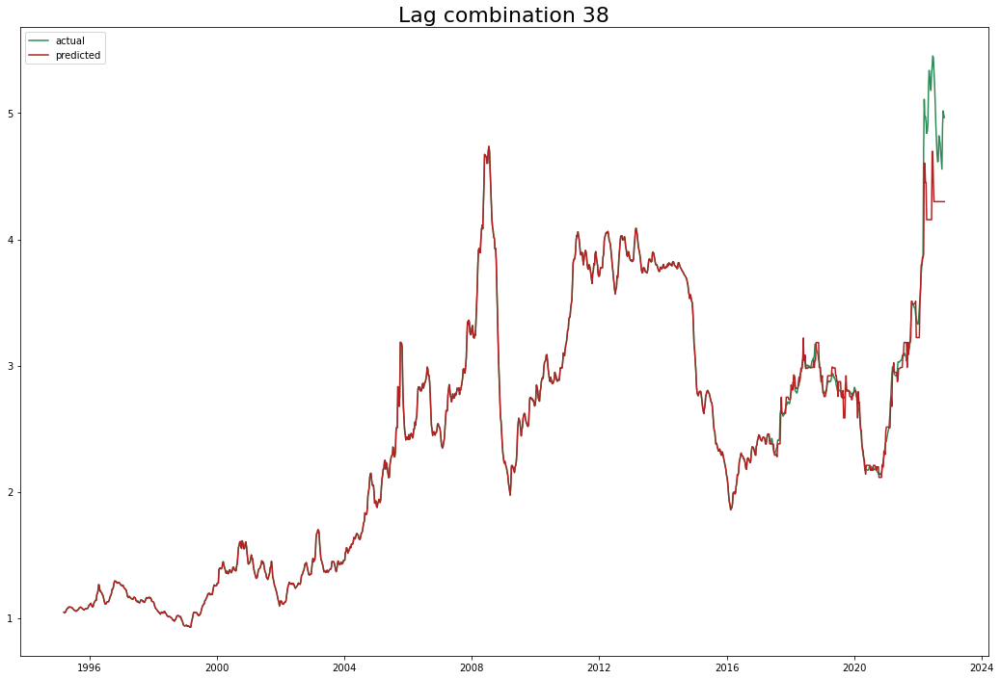

Test data rmse: 0.2620486198526271 Total rmse: 0.11706982119804847
Test data mape: 0.031166380080609284 Total mape: 0.006220317022325346
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.068) neg_root_mean_squared_error: (test=-0.129) r2: (test=0.448) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.174) neg_root_mean_squared_error: (test=-0.577) r2: (test=-0.546) total time= 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.182) neg_root_mean_squared_error: (test=-0.596) r2: (test=-0.649) total time=   0.0s
[CV 3/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.164) neg_root_mean_squared_error: (test=-0.838) r2: (test=-0.585) total time=   0.0s
[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.147) r2: (test=0.884) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.076) r2: (test=0.988) total time=   0.0s
{'max_features': 'auto'}


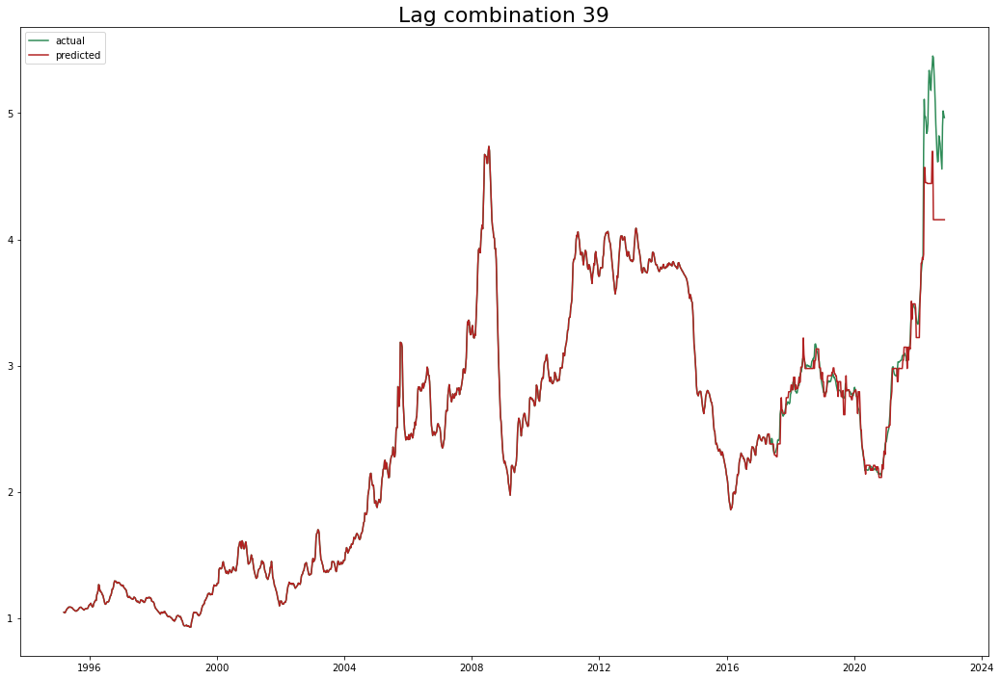

Test data rmse: 0.25929513161218015 Total rmse: 0.11583970452671724
Test data mape: 0.03143882429673036 Total mape: 0.0062746925831312144
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.545) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.174) neg_root_mean_squared_error: (test=-0.578) r2: (test=-0.548) 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.162) neg_root_mean_squared_error: (test=-0.830) r2: (test=-0.554) total time=   0.0s
[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.132) r2: (test=0.907) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.990) total time=   0.0s
{'max_features': 'auto'}


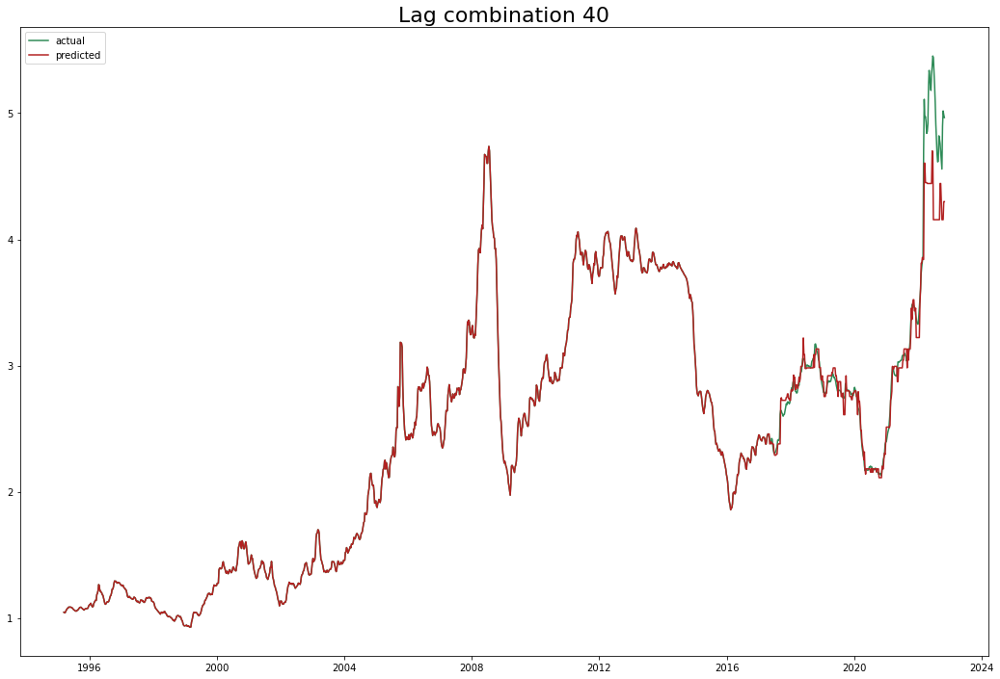

Test data rmse: 0.25236111416865414 Total rmse: 0.11274194281076443
Test data mape: 0.03088926291836401 Total mape: 0.006165008815307578
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.577) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.176) neg_root_mean_squared_error: (test=-0.595) r2: (tes

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.181) neg_root_mean_squared_error: (test=-0.596) r2: (test=-0.648) total time=   0.0s
[CV 3/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.160) neg_root_mean_squared_error: (test=-0.825) r2: (test=-0.534) total time=   0.0s
[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.041) neg_root_mean_squared_error: (test=-0.181) r2: (test=0.825) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.070) r2: (test=0.990) total time=   0.0s
{'max_features': None}


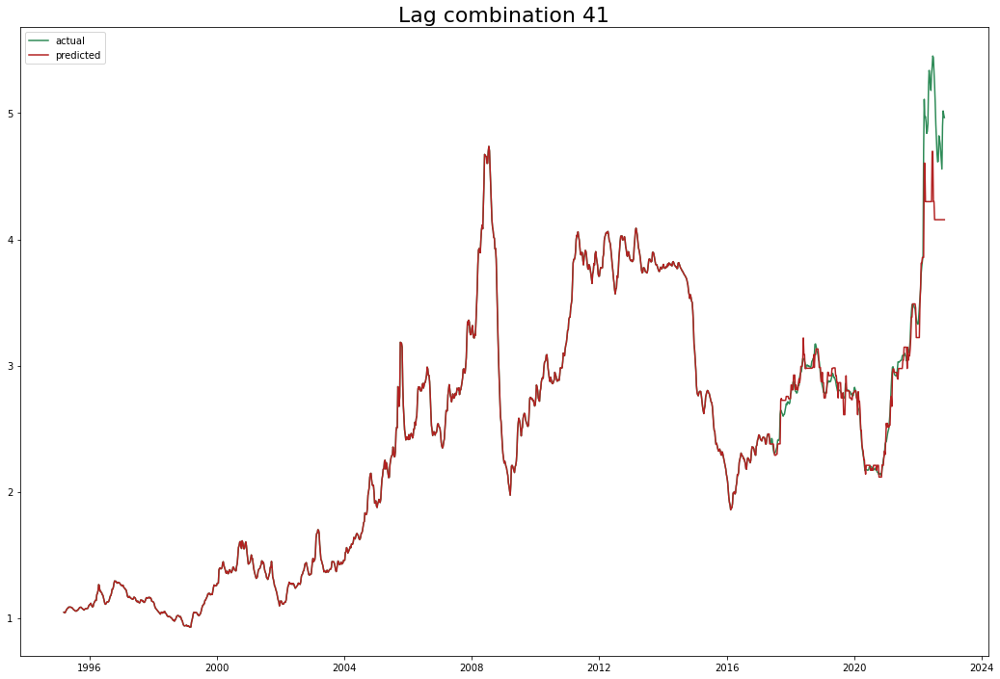

Test data rmse: 0.2703533824254635 Total rmse: 0.1207799612096271
Test data mape: 0.03291734831968126 Total mape: 0.006569782616817882
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.068) neg_root_mean_squared_error: (test=-0.130) r2: (test=0.442) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.180) neg_root_mean_squared_error: (test=-0.595)

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.574) total time=   0.0s
[CV 2/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.180) neg_root_mean_squared_error: (test=-0.596) r2: (test=-0.648) total time=   0.0s
[CV 3/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.162) neg_root_mean_squared_error: (test=-0.826) r2: (test=-0.538) total time=   0.0s
[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.043) neg_root_mean_squared_error: (test=-0.202) r2: (test=0.783) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.076) r2: (test=0.988) total time=   0.0s
{'max_features': 'auto'}


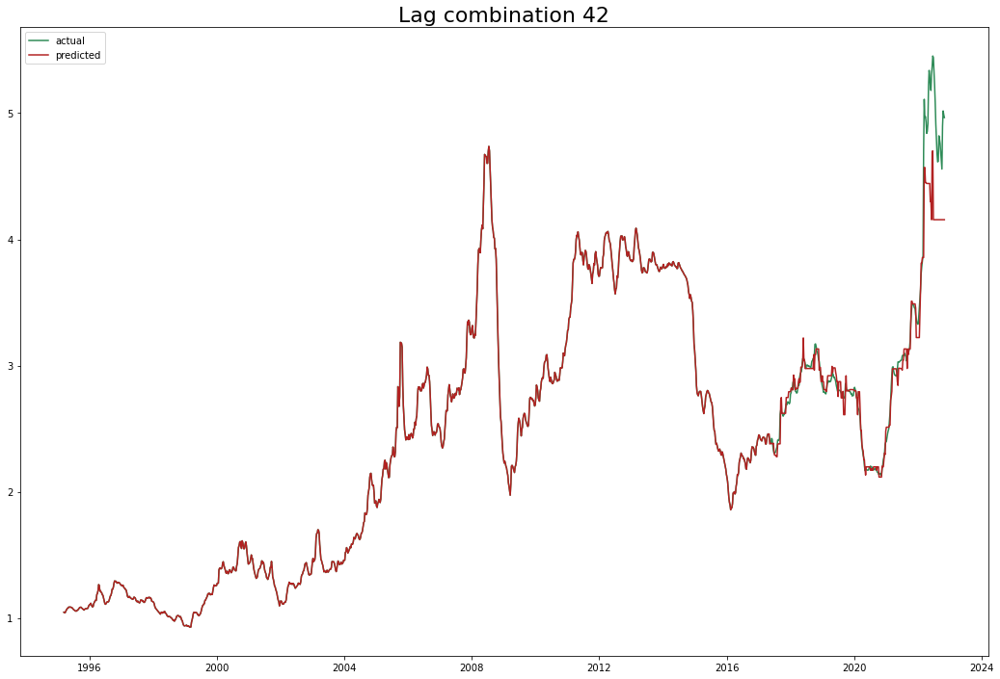

Test data rmse: 0.2664183935404361 Total rmse: 0.1190220109275553
Test data mape: 0.03142348826116294 Total mape: 0.006271631752747694
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.568) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.175) neg_root_mean_squared_error: (t

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.532) total time=   0.0s
[CV 2/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.577) r2: (test=-0.546) total time=   0.0s
[CV 3/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.163) neg_root_mean_squared_error: (test=-0.831) r2: (test=-0.557) total time=   0.0s
[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.044) neg_root_mean_squared_error: (test=-0.207) r2: (test=0.772) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.077) r2: (test=0.987) total time=   0.0s
{'max_features': 'auto'}


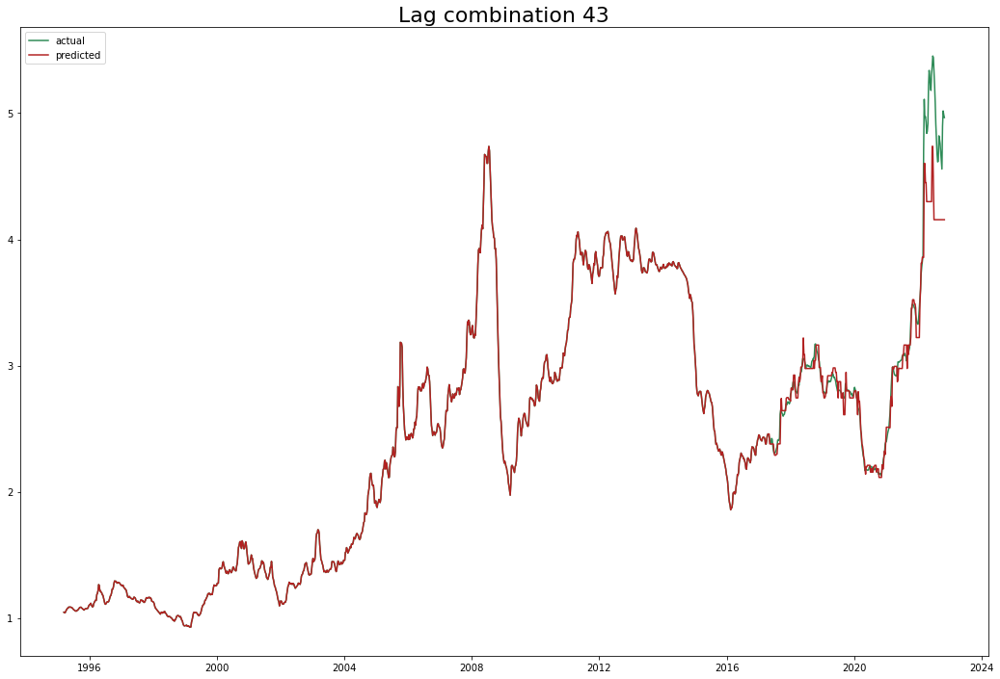

Test data rmse: 0.2673215721124404 Total rmse: 0.11942550457691667
Test data mape: 0.032157861981986606 Total mape: 0.006418201144013961
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.067) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.473) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.175) neg_root_mean_squa

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.578) r2: (test=-0.548) total time=   0.0s
[CV 3/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.161) neg_root_mean_squared_error: (test=-0.830) r2: (test=-0.554) total time=   0.0s
[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.146) r2: (test=0.886) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.990) total time=   0.0s
{'max_features': None}


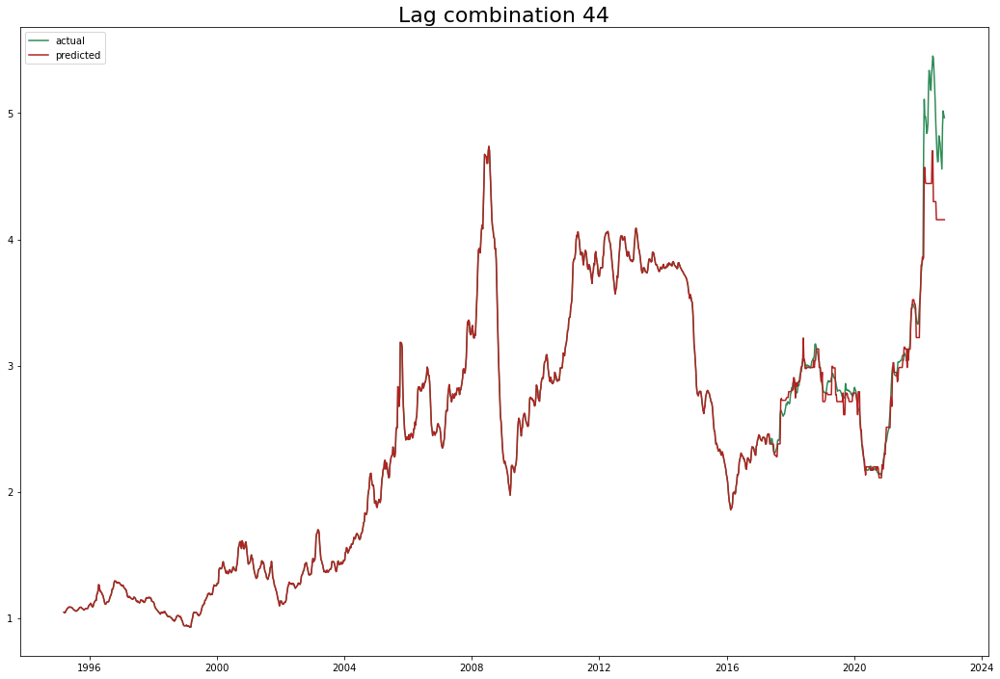

Test data rmse: 0.25174522090796486 Total rmse: 0.11246679343601662
Test data mape: 0.03309444190596113 Total mape: 0.006605127698487041
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.553) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.172) neg_roo

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.133) r2: (test=0.906) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.069) r2: (test=0.990) total time=   0.0s
{'max_features': None}


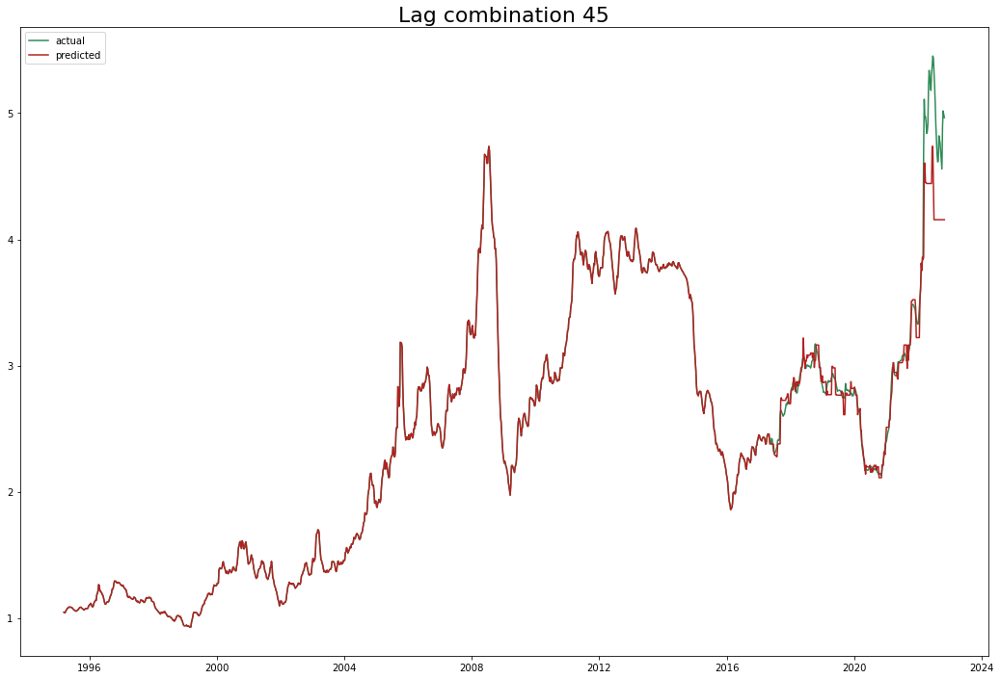

Test data rmse: 0.2550253595777836 Total rmse: 0.11393219038333291
Test data mape: 0.03284496216409288 Total mape: 0.006555335483893796
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.549) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.17

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.172) neg_root_mean_squared_error: (test=-0.577) r2: (test=-0.546) total time=   0.0s
[CV 3/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.139) neg_root_mean_squared_error: (test=-0.753) r2: (test=-0.277) total time=   0.0s
[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.044) neg_root_mean_squared_error: (test=-0.205) r2: (test=0.775) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.076) r2: (test=0.988) total time=   0.0s
{'max_features': 'auto'}


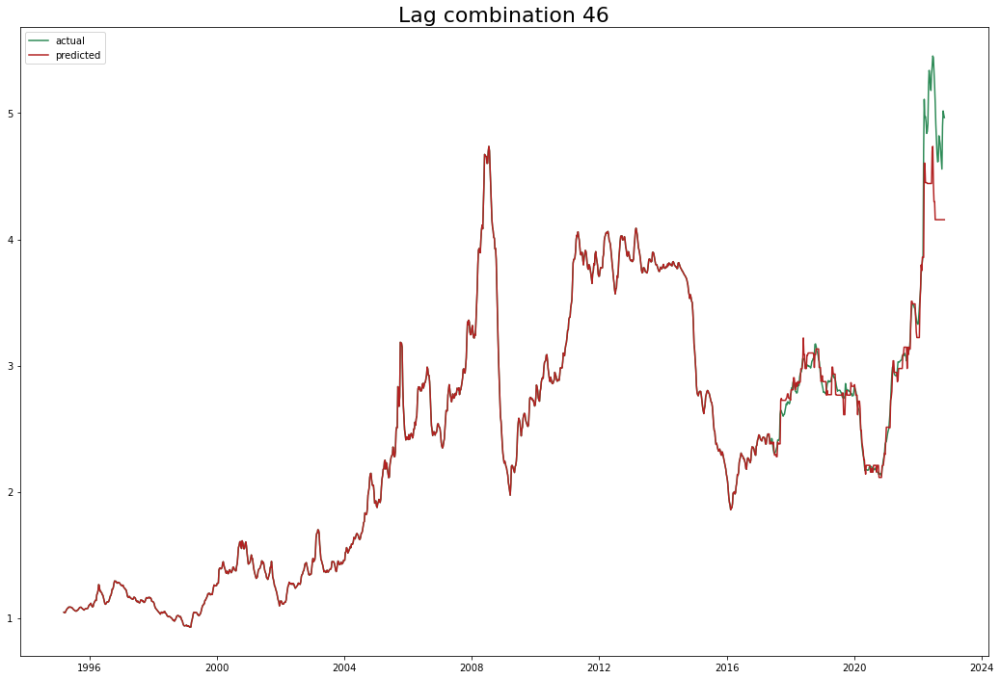

Test data rmse: 0.25111542139245685 Total rmse: 0.11218543146314072
Test data mape: 0.032931750301181326 Total mape: 0.006572657024767998
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.538) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percentage_error

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.047) neg_root_mean_squared_error: (test=-0.213) r2: (test=0.758) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.077) r2: (test=0.987) total time=   0.0s
{'max_features': None}


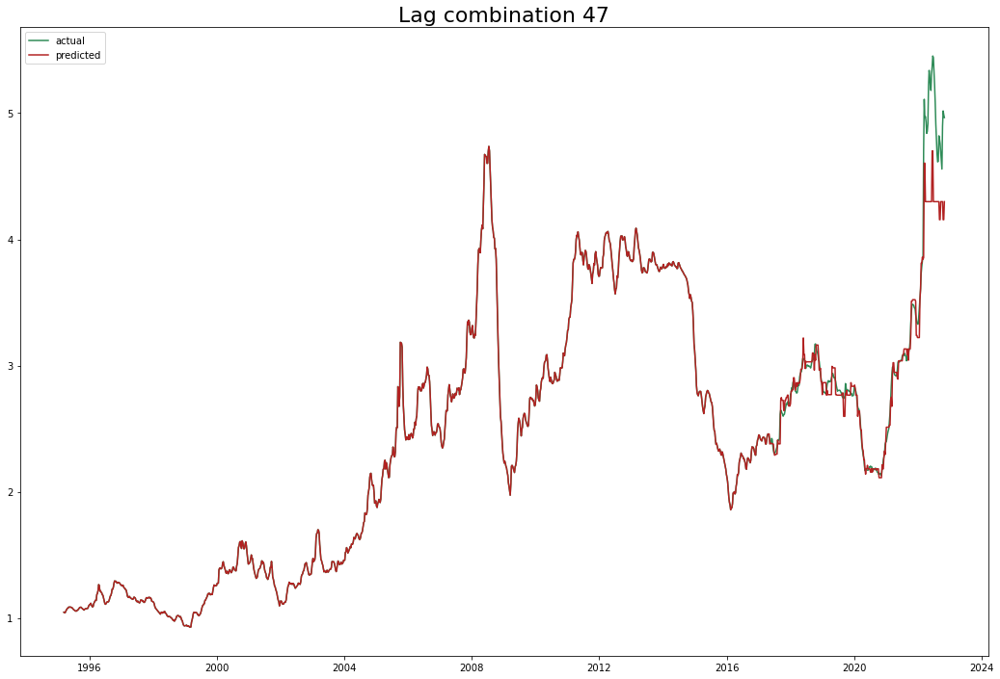

Test data rmse: 0.2561611092435557 Total rmse: 0.11443958481407808
Test data mape: 0.031242721755535423 Total mape: 0.006235553614410397
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.542) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_absolute_percen

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.546) total time=   0.0s
[CV 2/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.174) neg_root_mean_squared_error: (test=-0.578) r2: (test=-0.550) total time=   0.0s
[CV 3/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.138) neg_root_mean_squared_error: (test=-0.756) r2: (test=-0.288) total time=   0.0s
[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.045) neg_root_mean_squared_error: (test=-0.206) r2: (test=0.774) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.069) r2: (test=0.990) total time=   0.0s
{'max_features': 'auto'}


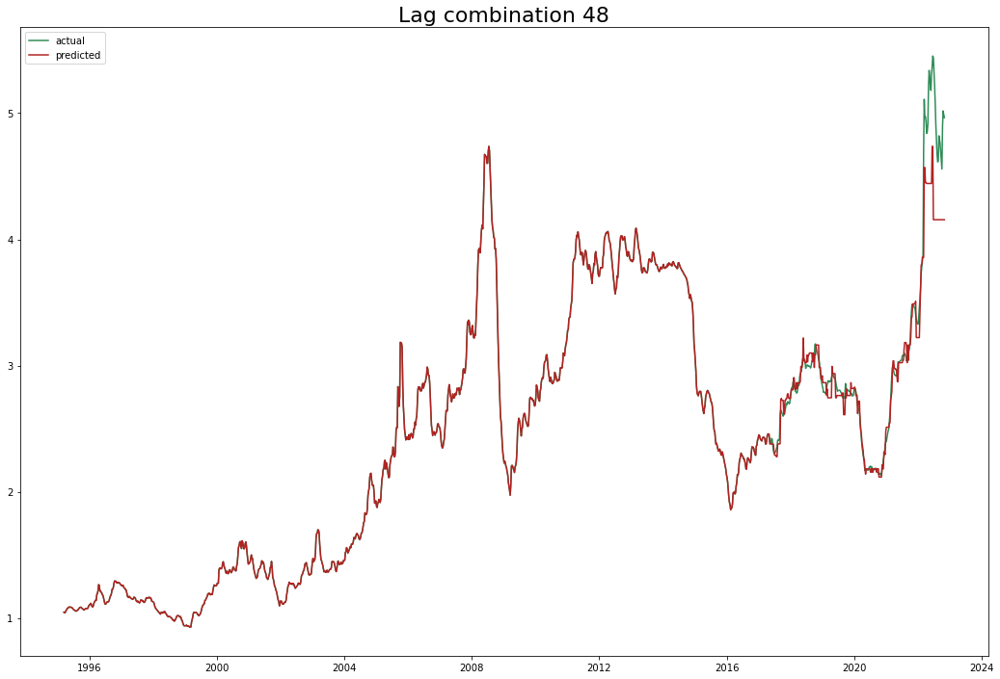

Test data rmse: 0.2599450529545727 Total rmse: 0.11613005589506056
Test data mape: 0.032663955080684516 Total mape: 0.006519209330032669
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.481) total time=   0.0s
[CV 2/5] END max_features=auto; neg_mean_abso

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.170) neg_root_mean_squared_error: (test=-0.576) r2: (test=-0.539) total time=   0.0s
[CV 3/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.134) neg_root_mean_squared_error: (test=-0.746) r2: (test=-0.254) total time=   0.0s
[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.157) r2: (test=0.869) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.077) r2: (test=0.987) total time=   0.0s
{'max_features': None}


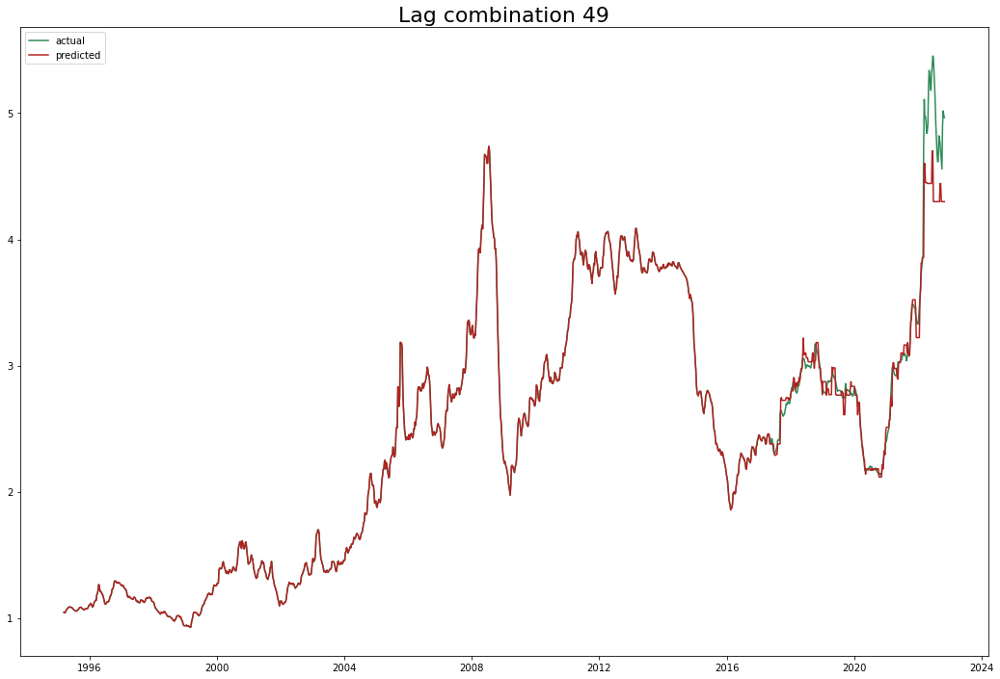

Test data rmse: 0.23341183947168478 Total rmse: 0.1042763832445492
Test data mape: 0.03035086661720115 Total mape: 0.006057553420480894
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag', '51w_lag']
Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV 1/5] END max_features=auto; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.530) total time=   0.0s
[CV 2/5] END max_features=auto; neg

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.068) neg_root_mean_squared_error: (test=-0.130) r2: (test=0.442) total time=   0.0s
[CV 2/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.180) neg_root_mean_squared_error: (test=-0.596) r2: (test=-0.648) total time=   0.0s
[CV 3/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.132) neg_root_mean_squared_error: (test=-0.744) r2: (test=-0.249) total time=   0.0s
[CV 4/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.139) r2: (test=0.898) total time=   0.0s
[CV 5/5] END max_features=None; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.073) r2: (test=0.989) total time=   0.0s
{'max_features': None}


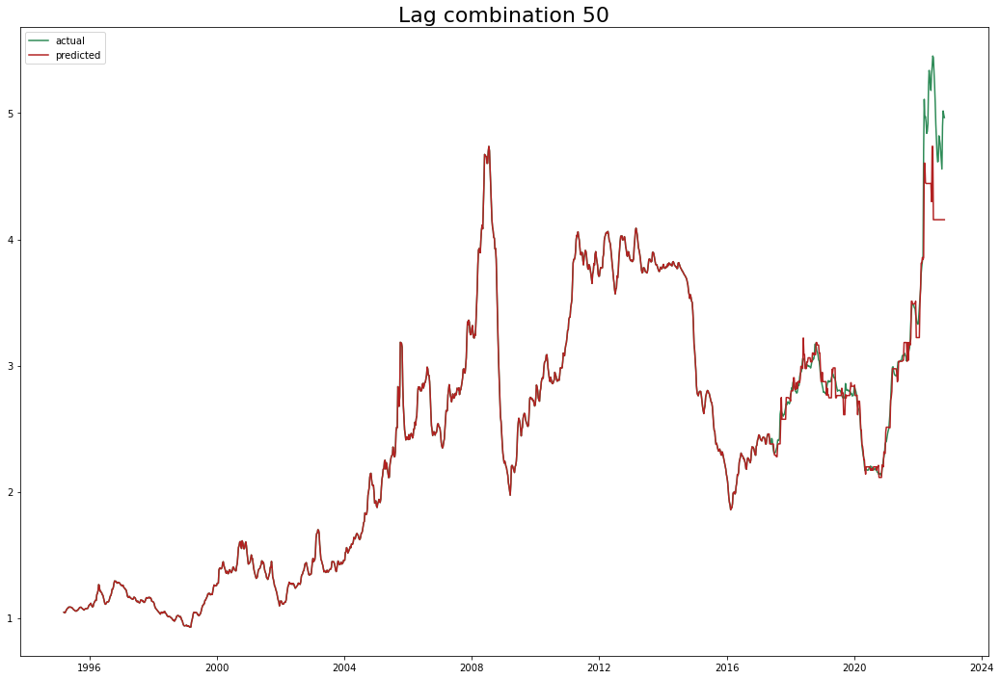

Test data rmse: 0.2613427998391726 Total rmse: 0.11675449718367435
Test data mape: 0.03310690307615408 Total mape: 0.0066076147511658885


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


In [784]:
from sklearn.tree import DecisionTreeRegressor

dec_tree = DecisionTreeRegressor()
tree_params = {'max_features':['auto','sqrt',None]}
tree_grid_list, summary_data = test_mdl(df1.columns[3:-1],dec_tree,tree_params,'DecisionTreeRegressor')

### GradientBoostingRegressor

--------------------------
Next model: 
Lags choosen:  ['1w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.611) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.145) neg_root_mean_squared_error: (test=-0.520) r2: (test=-0.254) total time=   0.0s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.081) neg_root_mean_squared_error: (test=-0.488) r2: (test=0.464) total time=   0.0s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.101) r2: (test=0.946) total time=   0.0s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (

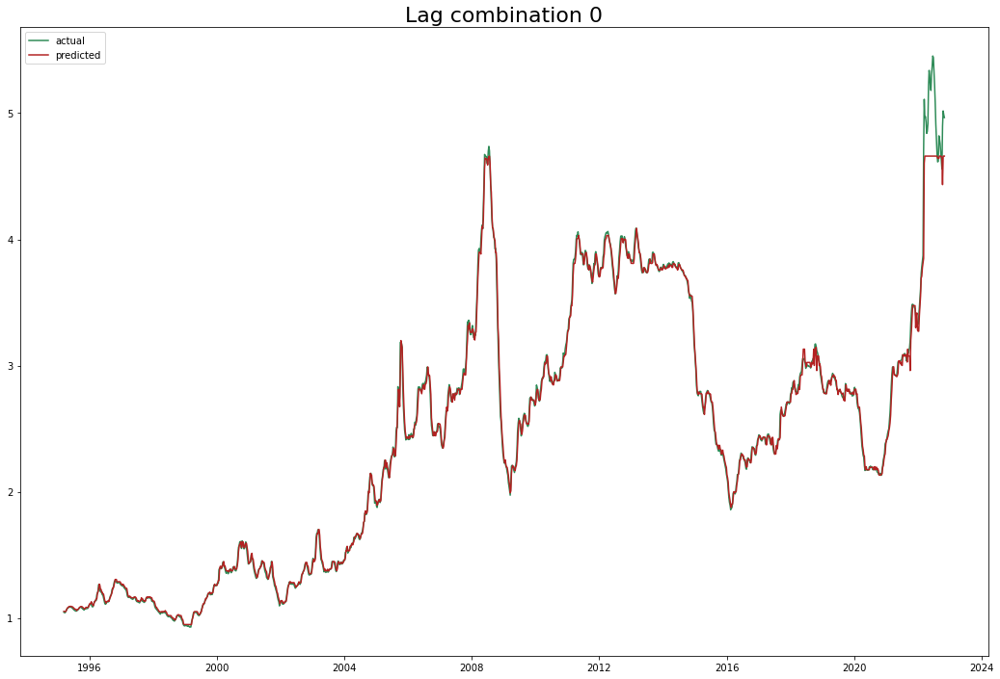

Test data rmse: 0.16074754079911682 Total rmse: 0.07761424858250088
Test data mape: 0.01829370867934267 Total mape: 0.011752409785194325
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.052) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.610) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.536) r2: (test=-0.332) total time=   0.0s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.082) neg_root_mean_squared_error: (test=-0.490) r2: (test=0.459) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.088) r2: (test=0.959) total time=   0.0s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.996) total time=   0.0s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.051) neg_root_mean_squared_error: (test=-0.108) r2: (test=0.617) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.150) neg_root_mean_squared_error: (test=-0.533) r2: (test=-0.319) total time=   0.0s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.082) neg_root_mean_squared_error: (test=-0.485) r2: (test=0.468) total time=   0.0s
[CV 4/5] END learning_rate=0.05, m

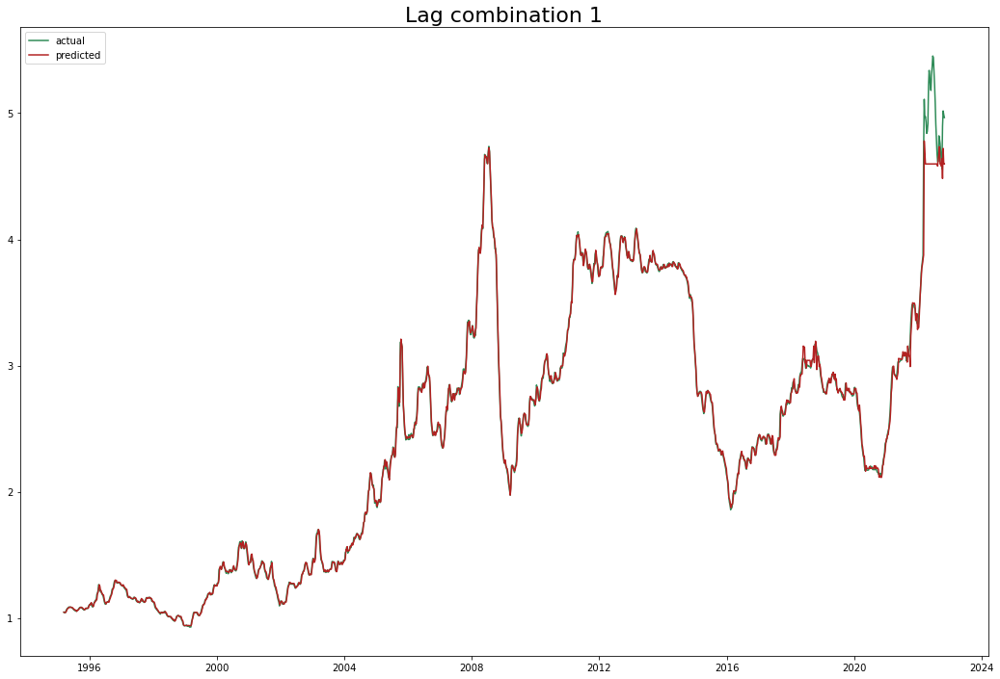

Test data rmse: 0.17024878516619946 Total rmse: 0.07817760760609713
Test data mape: 0.018289906817590955 Total mape: 0.009124747052610505
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.054) neg_root_mean_squared_error: (test=-0.112) r2: (test=0.588) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.153) neg_root_mean_squared_error: (test=-0.540) r2: (test=-0.352) total time=   0.0s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.496) r2: (test=0.445) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.083) r2: (test=0.963) total time=   0.0s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.996) total time=   0.0s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.053) neg_root_mean_squared_error: (test=-0.110) r2: (test=0.598) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.536) r2: (test=-0.331) total time=   0.0s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.080) neg_root_mean_squared_error: (test=-0.491) r2: (test=0.455) total time=   0.0s
[CV 4/5] END learning_rate=0.05, m

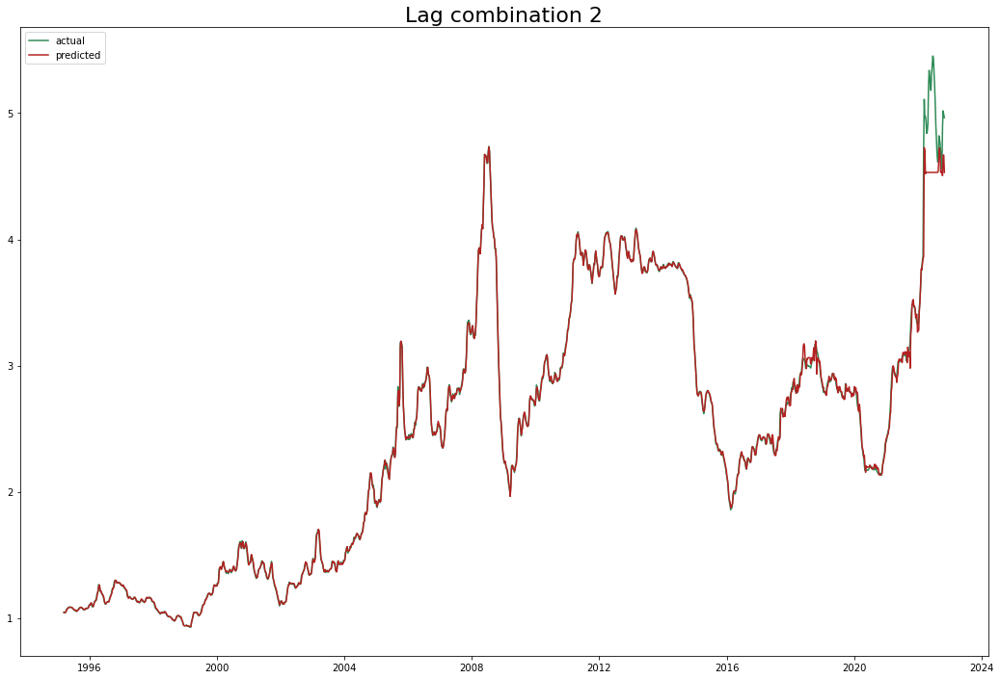

Test data rmse: 0.18640477547677284 Total rmse: 0.08405984607959259
Test data mape: 0.020133746700315473 Total mape: 0.007813704177968162
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.560) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.537) r2: (test=-0.335) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.082) neg_root_mean_squared_error: (test=-0.511) r2: (test=0.411) total time=   0.0s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.975) total time=   0.0s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.996) total time=   0.0s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.564) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.150) neg_root_mean_squared_error: (test=-0.535) r2: (test=-0.325) total time=   0.0s
[CV 3/5] END learning_rate=0.05, m

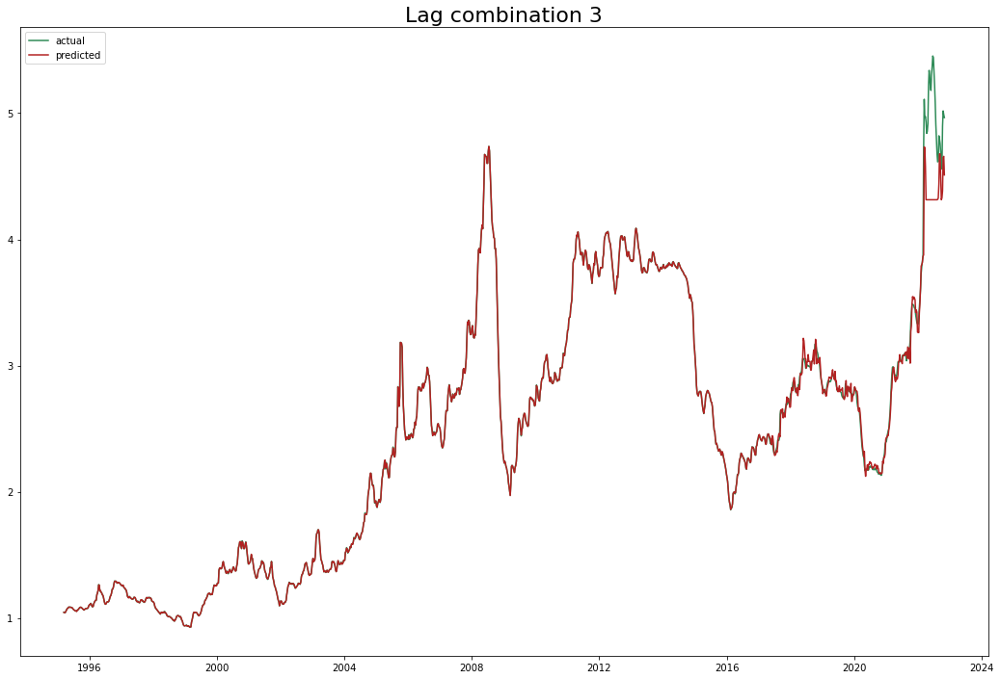

Test data rmse: 0.23825106191058426 Total rmse: 0.10646730562902917
Test data mape: 0.025012696545353857 Total mape: 0.005877370483553358
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.115) r2: (test=0.566) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.536) r2: (test=-0.331) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.090) neg_root_mean_squared_error: (test=-0.562) r2: (test=0.287) total time=   0.0s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.976) total time=   0.0s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.041) r2: (test=0.996) total time=   0.1s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.572) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.150) neg_root_mean_squared_error: (test=-0.532) r2: (test=-0.310) total time=   0.0s
[CV 3/5] END learning_rate=0.05, m

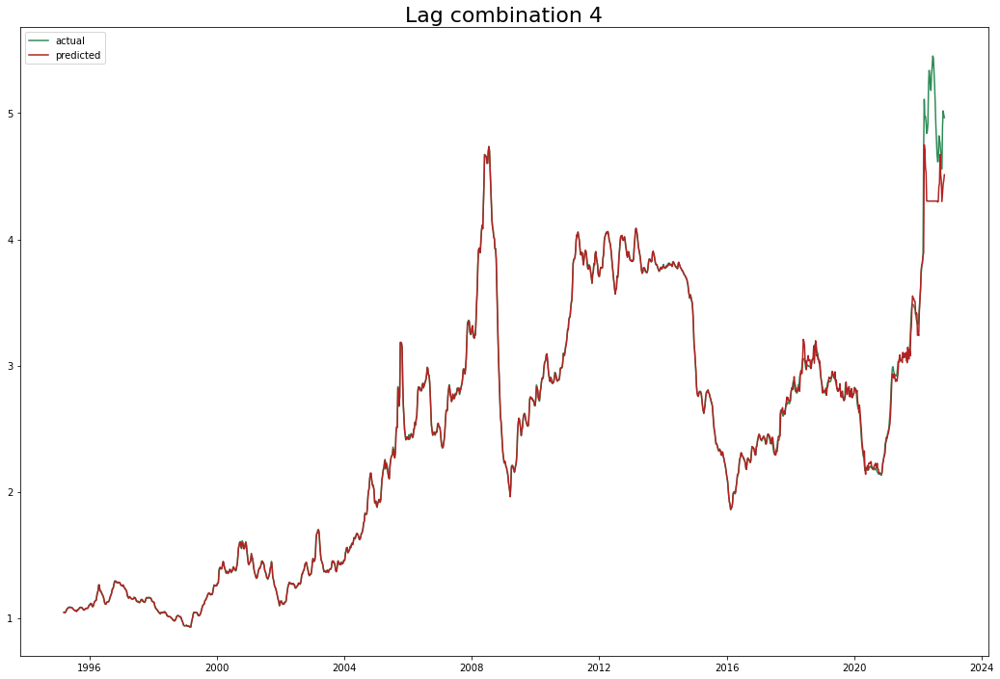

Test data rmse: 0.24192983369447674 Total rmse: 0.1082550355541417
Test data mape: 0.025025638550781243 Total mape: 0.007173478130656706
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.056) neg_root_mean_squared_error: (test=-0.114) r2: (test=0.568) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.151) neg_root_mean_squared_error: (test=-0.535) r2: (test=-0.328) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.088) neg_root_mean_squared_error: (test=-0.554) r2: (test=0.307) total time=   0.0s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.976) total time=   0.0s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.996) total time=   0.1s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.055) neg_root_mean_squared_error: (test=-0.113) r2: (test=0.577) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.149) neg_root_mean_squared_error: (test=-0.530) r2: (test=-0.304) total time=   0.0s
[CV 3/5] END learning_rate=0.05, m

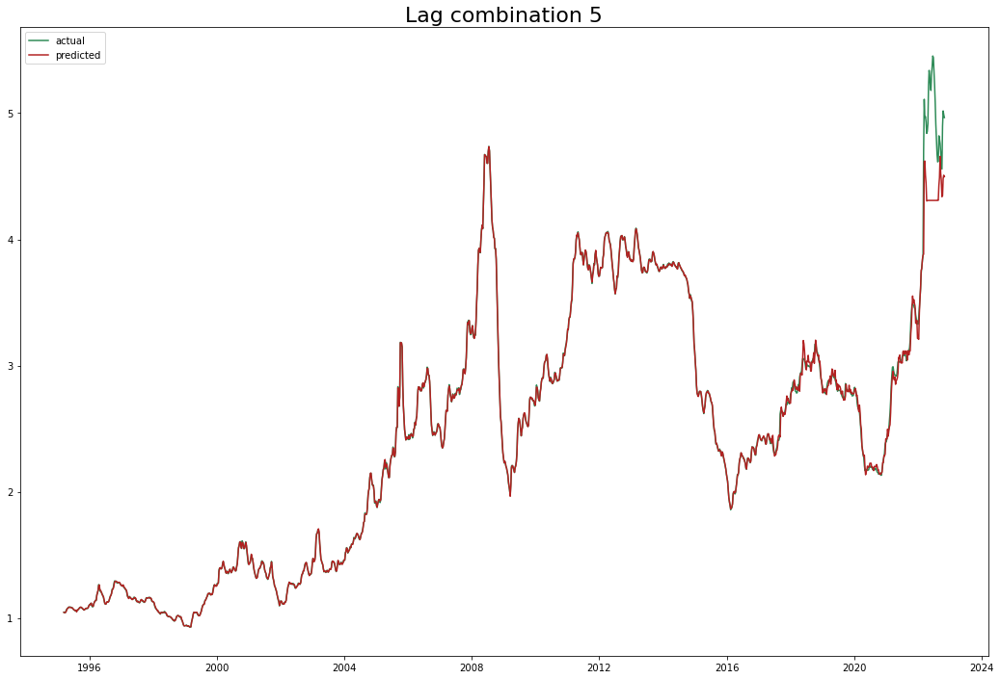

Test data rmse: 0.24188544150528224 Total rmse: 0.10819745411708767
Test data mape: 0.02476102859818468 Total mape: 0.006871470060982
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.551) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.155) neg_root_mean_squared_error: (test=-0.546) r2: (test=-0.382) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.086) neg_root_mean_squared_error: (test=-0.518) r2: (test=0.395) total time=   0.0s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.091) r2: (test=0.956) total time=   0.1s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.996) total time=   0.1s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.558) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.154) neg_root_mean_squared_error: (test=-0.544) r2: (test=-0.373) total time=   0.1s
[CV 3/5] END learning_rate=0.05, m

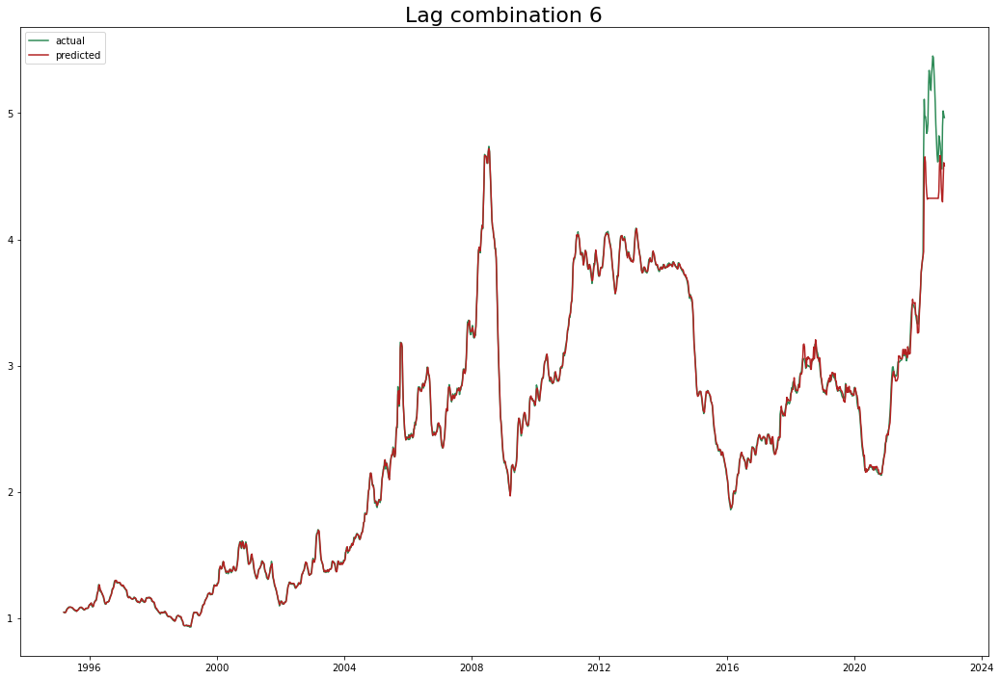

Test data rmse: 0.2361971184563663 Total rmse: 0.10644874841745504
Test data mape: 0.02367295806398905 Total mape: 0.009137939466984471
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.554) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.157) neg_root_mean_squared_error: (test=-0.554) r2: (test=-0.422) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.089) neg_root_mean_squared_error: (test=-0.524) r2: (test=0.381) total time=   0.0s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.091) r2: (test=0.956) total time=   0.1s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.996) total time=   0.1s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.560) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.157) neg_root_mean_squared_error: (test=-0.552) r2: (test=-0.415) total time=   0.1s
[CV 3/5] END learning_rate=0.05, m

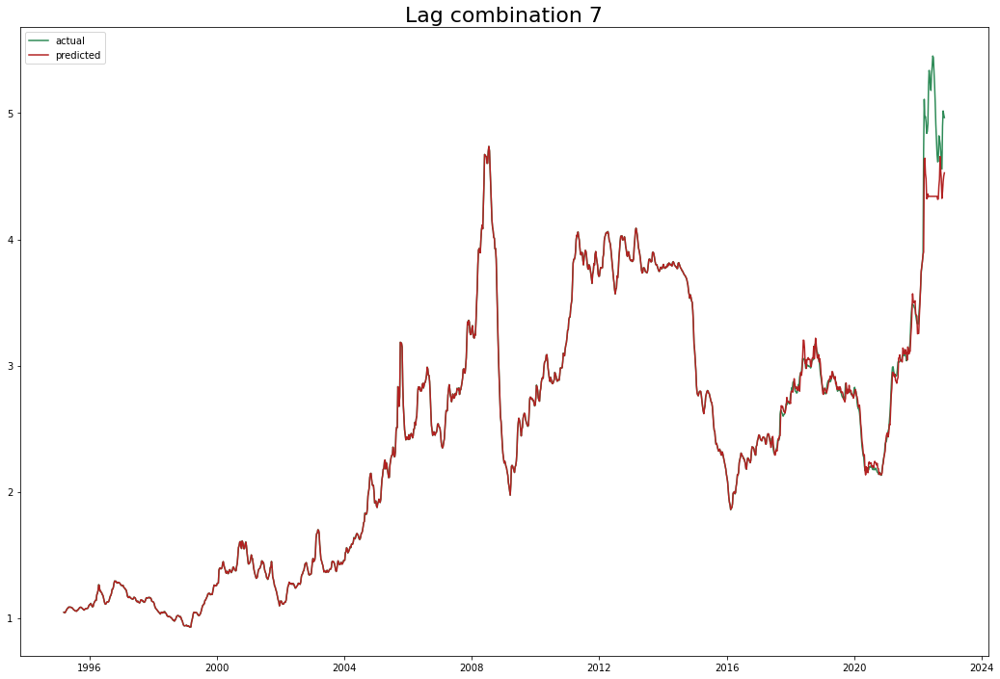

Test data rmse: 0.23445726752477059 Total rmse: 0.10475292565325466
Test data mape: 0.02501238102115065 Total mape: 0.005520415333135695
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.542) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.157) neg_root_mean_squared_error: (test=-0.553) r2: (test=-0.419) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.081) neg_root_mean_squared_error: (test=-0.505) r2: (test=0.426) total time=   0.0s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.098) r2: (test=0.949) total time=   0.1s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.996) total time=   0.2s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.548) total time=   0.0s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.157) neg_root_mean_squared_error: (test=-0.552) r2: (test=-0.415) total time=   0.1s
[CV 3/5] END learning_rate=0.05, m

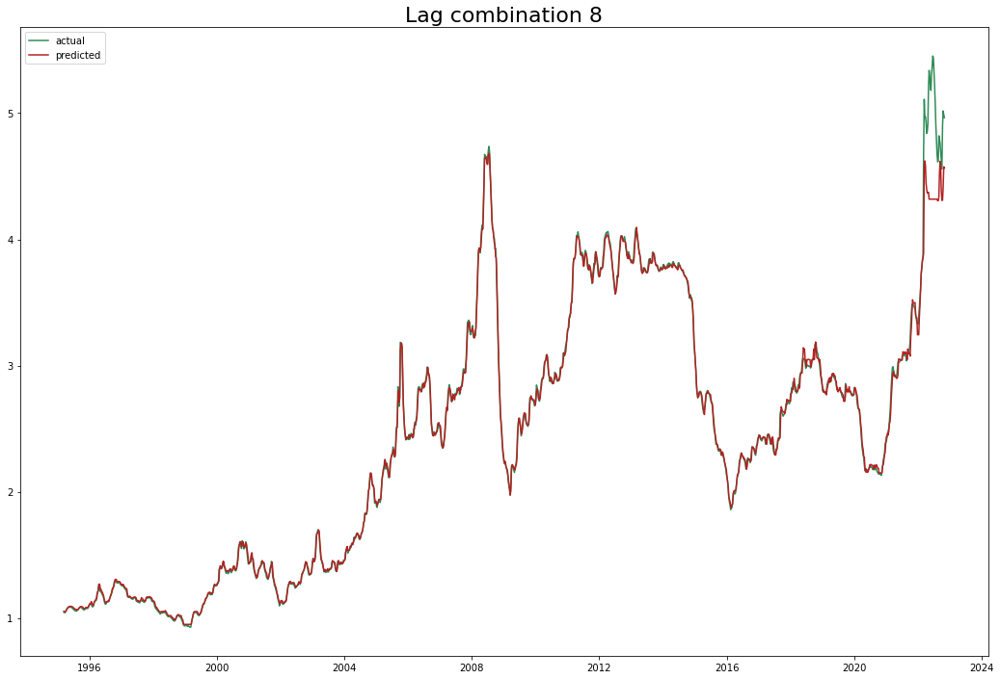

Test data rmse: 0.2377740977917418 Total rmse: 0.10793365103832916
Test data mape: 0.023528786333303617 Total mape: 0.010824159005689886
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.543) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.158) neg_root_mean_squared_error: (test=-0.555) r2: (test=-0.426) total time=   0.0s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.081) neg_root_mean_squared_error: (test=-0.509) r2: (test=0.416) total time=   0.1s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.100) r2: (test=0.947) total time=   0.1s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.996) total time=   0.2s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.548) total time=   0.0s
[CV 2/5] END learning_rate=0.05, m

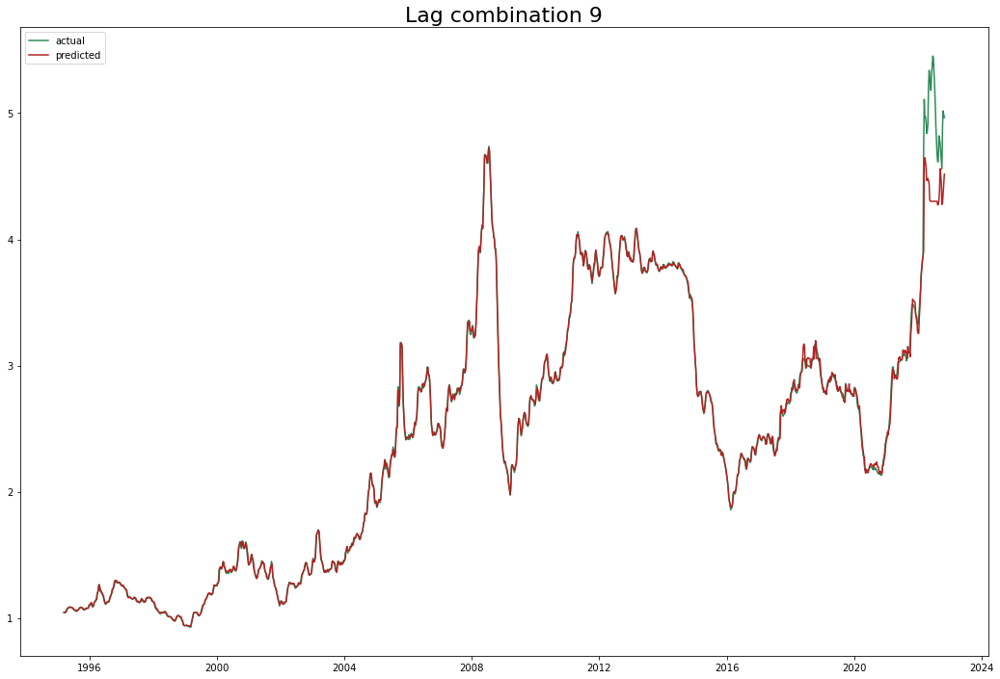

Test data rmse: 0.23753125491639263 Total rmse: 0.10690181137443366
Test data mape: 0.02415215118635887 Total mape: 0.009051053220224845
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.543) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.157) neg_root_mean_squared_error: (test=-0.553) r2: (test=-0.419) total time=   0.0s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.079) neg_root_mean_squared_error: (test=-0.510) r2: (test=0.414) total time=   0.1s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.098) r2: (test=0.948) total time=   0.2s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.996) total time=   0.2s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.550) total time=   0.0s
[CV 2/5] END learning_rate=0.05, m

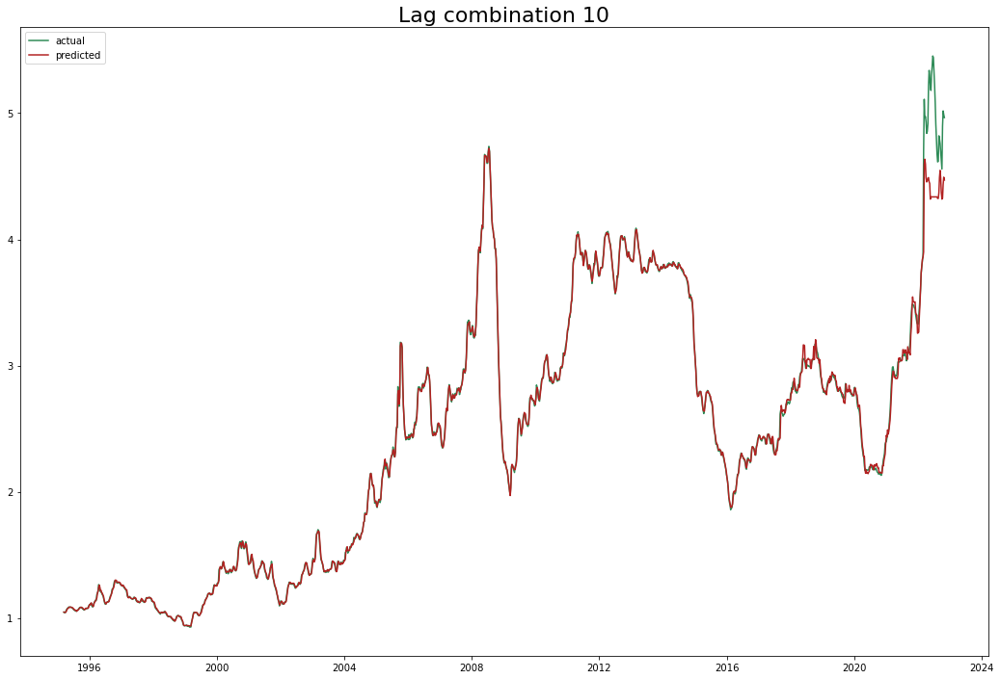

Test data rmse: 0.22892736236511277 Total rmse: 0.10306603664308144
Test data mape: 0.023832032274781114 Total mape: 0.008909003975901473
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.548) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.158) neg_root_mean_squared_error: (test=-0.556) r2: (test=-0.432) total time=   0.0s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.083) neg_root_mean_squared_error: (test=-0.515) r2: (test=0.401) total time=   0.1s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.105) r2: (test=0.942) total time=   0.2s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.996) total time=   0.2s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.556) total time=   0.0s
[CV 2/5] END learning_rate=0.05, m

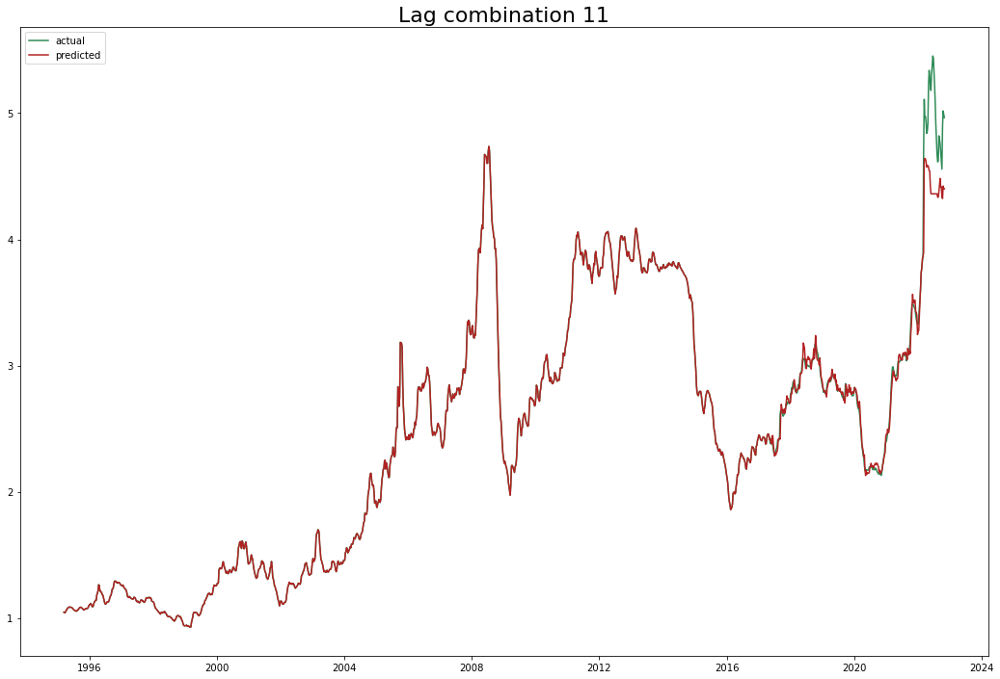

Test data rmse: 0.2201517829054173 Total rmse: 0.09835808002802761
Test data mape: 0.02370227725571868 Total mape: 0.005133942531724308
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.546) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.154) neg_root_mean_squared_error: (test=-0.544) r2: (test=-0.373) total time=   0.0s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.084) neg_root_mean_squared_error: (test=-0.519) r2: (test=0.393) total time=   0.1s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.088) r2: (test=0.958) total time=   0.2s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.046) r2: (test=0.995) total time=   0.2s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.553) total time=   0.0s
[CV 2/5] END learning_rate=0.05, m

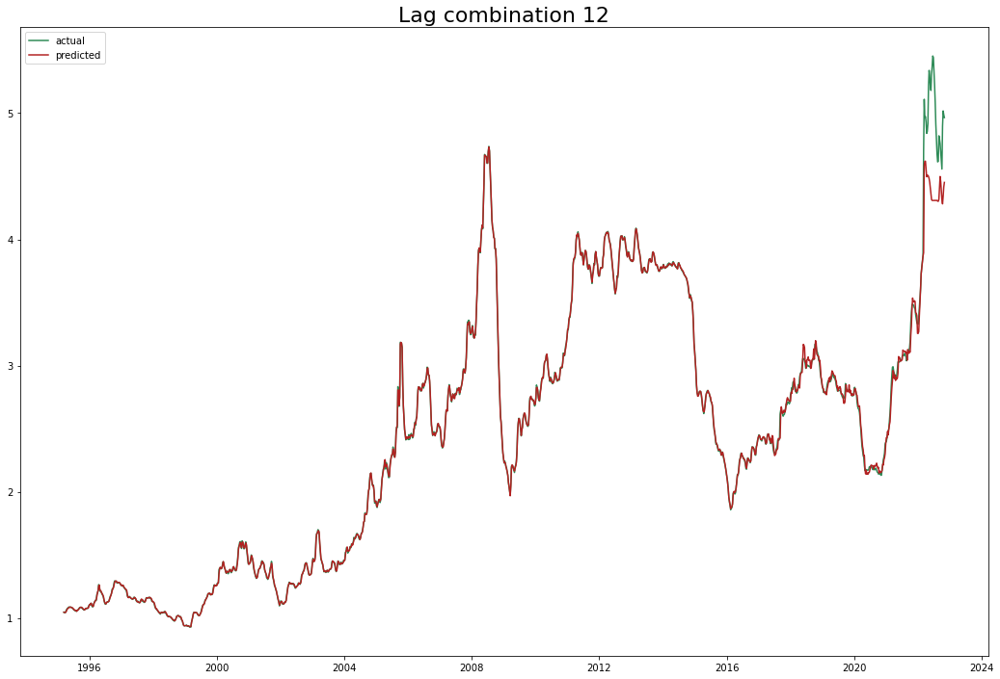

Test data rmse: 0.23273331151793436 Total rmse: 0.1042468488432439
Test data mape: 0.02390848869632057 Total mape: 0.007406106254850014
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.527) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.571) r2: (test=-0.513) total time=   0.0s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.092) neg_root_mean_squared_error: (test=-0.516) r2: (test=0.400) total time=   0.1s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.977) total time=   0.2s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.045) r2: (test=0.996) total time=   0.3s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.536) total time=   0.1s
[CV 2/5] END learning_rate=0.05, m

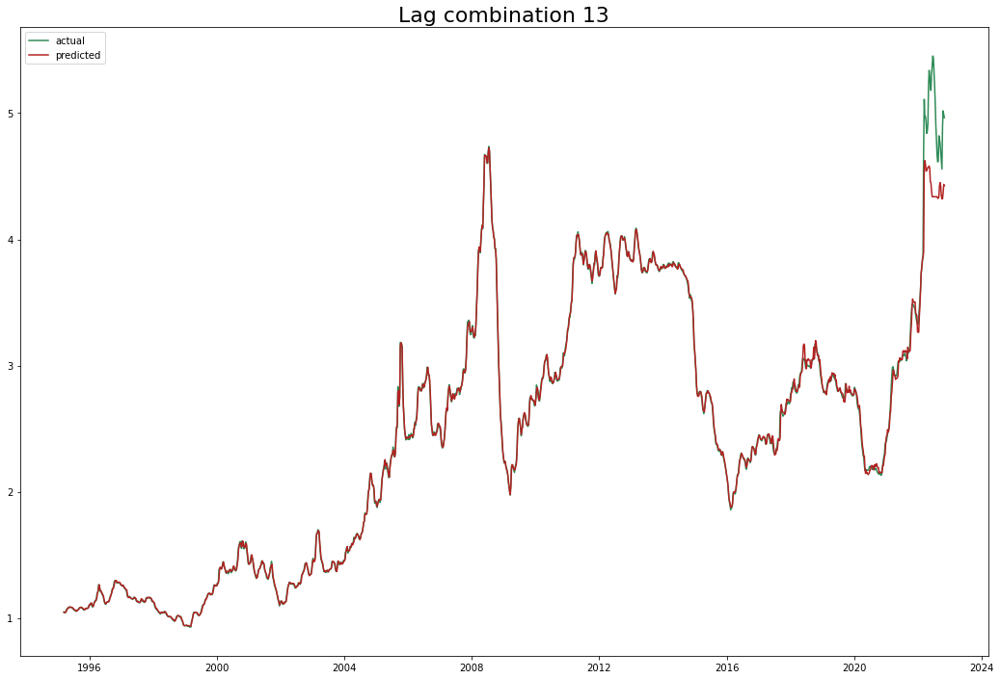

Test data rmse: 0.22216582833017778 Total rmse: 0.10002266094736996
Test data mape: 0.02317456727385734 Total mape: 0.00862745027628455
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.530) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.165) neg_root_mean_squared_error: (test=-0.570) r2: (test=-0.508) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.092) neg_root_mean_squared_error: (test=-0.520) r2: (test=0.390) total time=   0.1s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.064) r2: (test=0.978) total time=   0.2s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   0.3s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.531) total time=   0.1s
[CV 2/5] END learning_rate=0.05, m

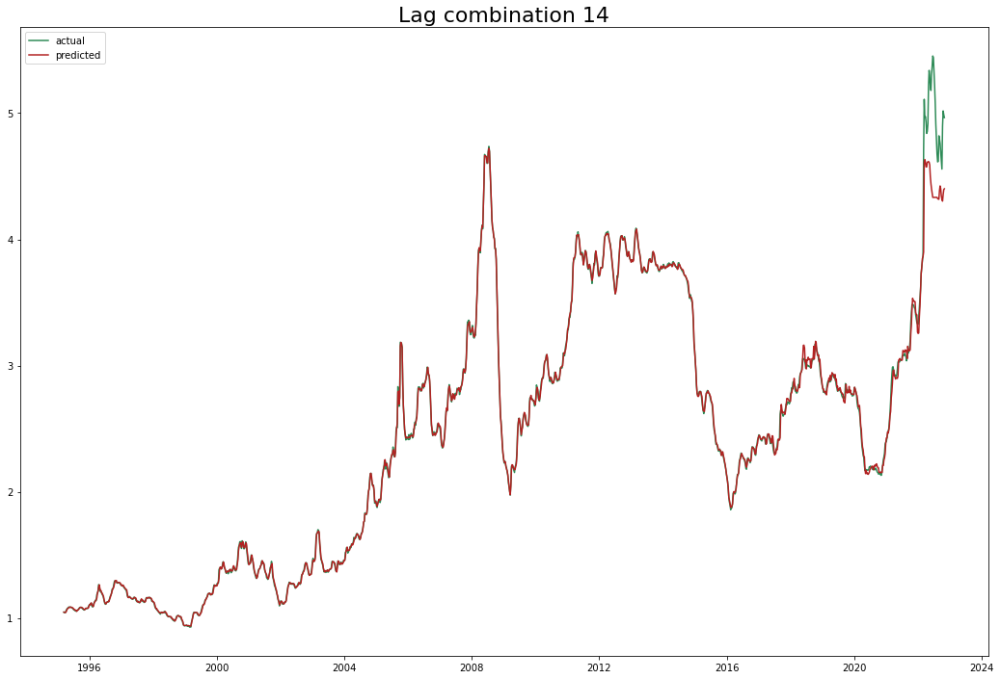

Test data rmse: 0.220993999340675 Total rmse: 0.0994779052296934
Test data mape: 0.023100683071028767 Total mape: 0.008602629262646143
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.529) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.166) neg_root_mean_squared_error: (test=-0.575) r2: (test=-0.532) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.092) neg_root_mean_squared_error: (test=-0.515) r2: (test=0.401) total time=   0.1s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.980) total time=   0.2s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.3s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.536) total time=   0.1s
[CV 2/5] END learning_rate=0.05, m

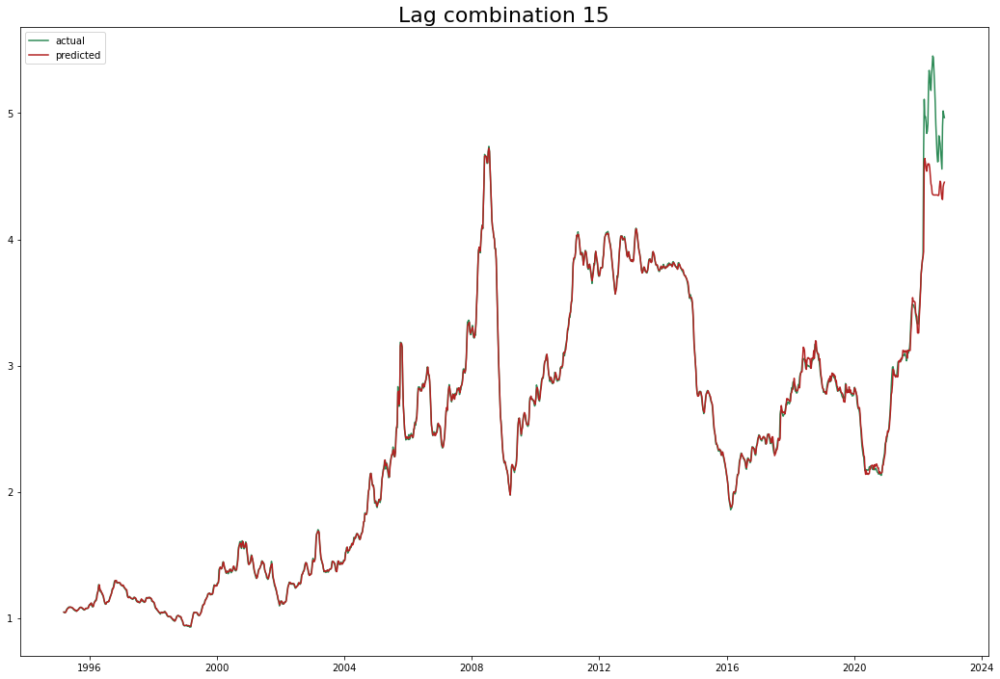

Test data rmse: 0.21675352749508428 Total rmse: 0.09756625584374676
Test data mape: 0.022590125276498372 Total mape: 0.008422593815663054
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.524) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.168) neg_root_mean_squared_error: (test=-0.578) r2: (test=-0.548) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.093) neg_root_mean_squared_error: (test=-0.521) r2: (test=0.388) total time=   0.2s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.980) total time=   0.3s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.4s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.529) total time=   0.1s
[CV 2/5] END learning_rate=0.05, m

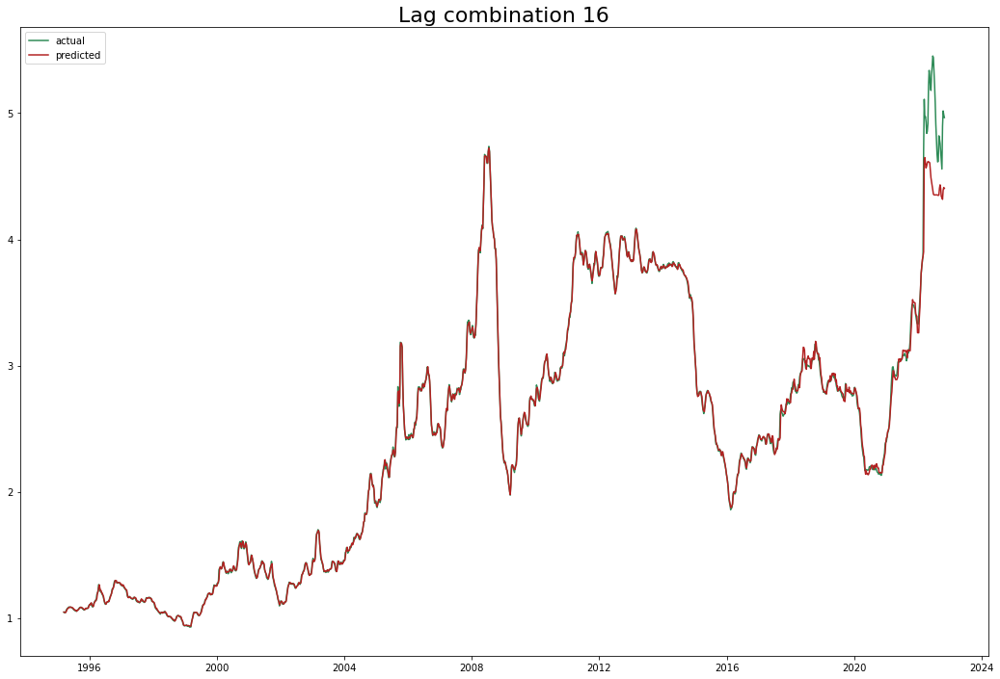

Test data rmse: 0.21355815213978827 Total rmse: 0.09611950523488899
Test data mape: 0.022607339567487603 Total mape: 0.008364887850632281
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.527) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.168) neg_root_mean_squared_error: (test=-0.576) r2: (test=-0.539) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.093) neg_root_mean_squared_error: (test=-0.522) r2: (test=0.386) total time=   0.2s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.978) total time=   0.3s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   0.4s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.535) total time=   0.1s
[CV 2/5] END learning_rate=0.05, m

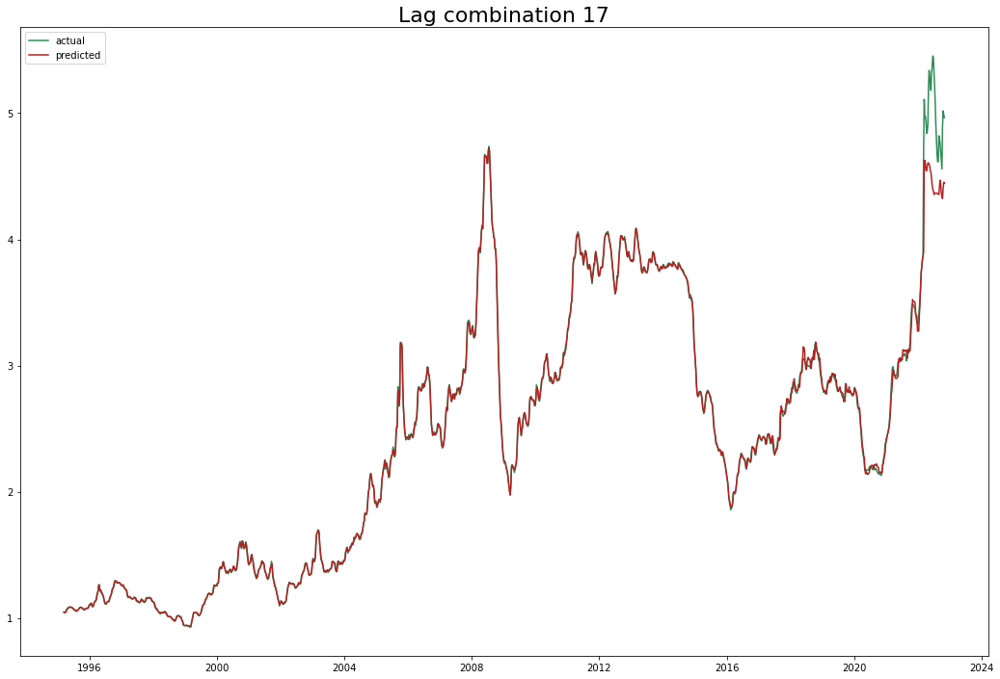

Test data rmse: 0.21099708965334651 Total rmse: 0.09498969584430426
Test data mape: 0.022295291027909045 Total mape: 0.008253368969150536
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.523) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.171) neg_root_mean_squared_error: (test=-0.584) r2: (test=-0.580) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.093) neg_root_mean_squared_error: (test=-0.516) r2: (test=0.399) total time=   0.2s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.979) total time=   0.3s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.4s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.534) total time=   0.1s
[CV 2/5] END learning_rate=0.05, m

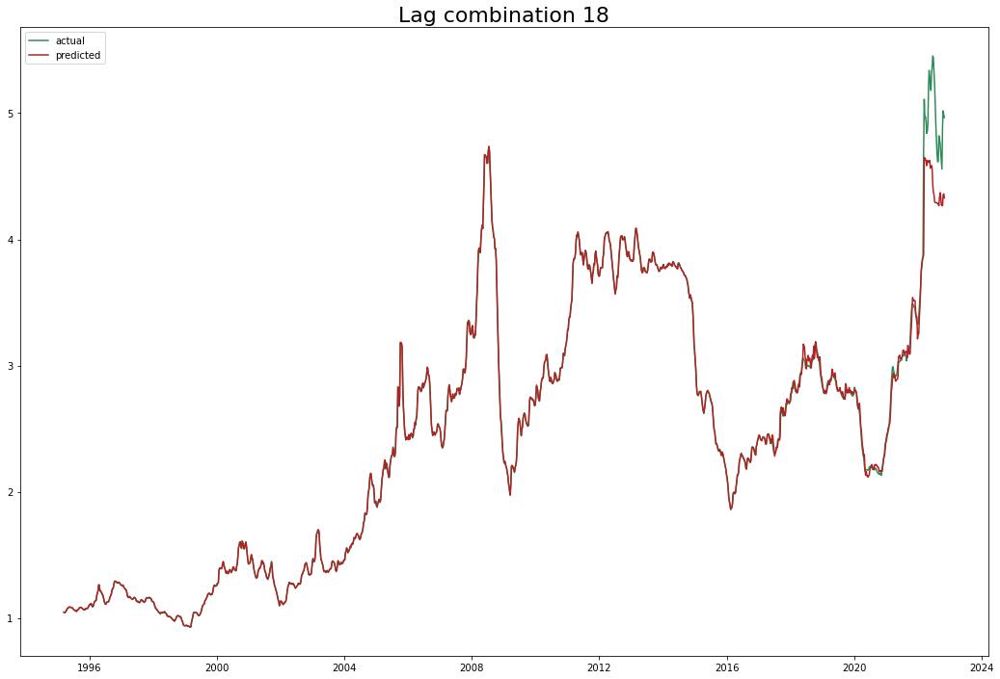

Test data rmse: 0.21596409530335697 Total rmse: 0.09655302934292605
Test data mape: 0.02366170633752242 Total mape: 0.006084811259101218
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.513) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.170) neg_root_mean_squared_error: (test=-0.581) r2: (test=-0.567) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.093) neg_root_mean_squared_error: (test=-0.528) r2: (test=0.372) total time=   0.2s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.980) total time=   0.3s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   0.4s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.523) total time=   0.1s
[CV 2/5] END learning_rate=0.05, m

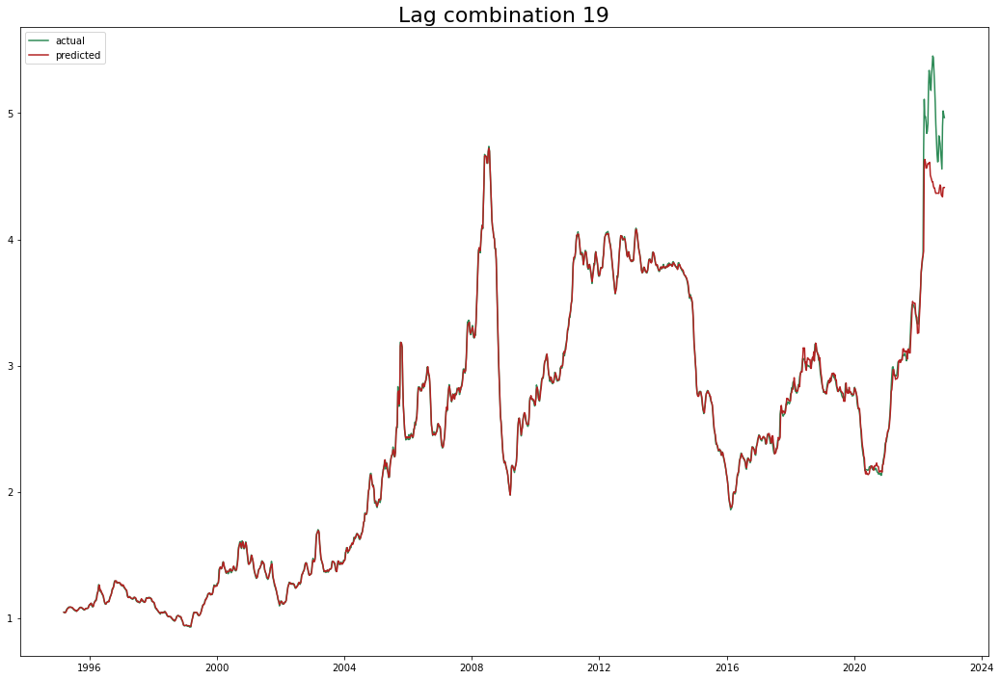

Test data rmse: 0.2082621864391386 Total rmse: 0.0937371133841023
Test data mape: 0.022155494348462045 Total mape: 0.00808976531069989
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.533) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.170) neg_root_mean_squared_error: (test=-0.584) r2: (test=-0.581) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.110) neg_root_mean_squared_error: (test=-0.675) r2: (test=-0.028) total time=   0.2s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.060) r2: (test=0.981) total time=   0.3s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.4s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.542) total time=   0.1s
[CV 2/5] END learning_rate=0.05, 

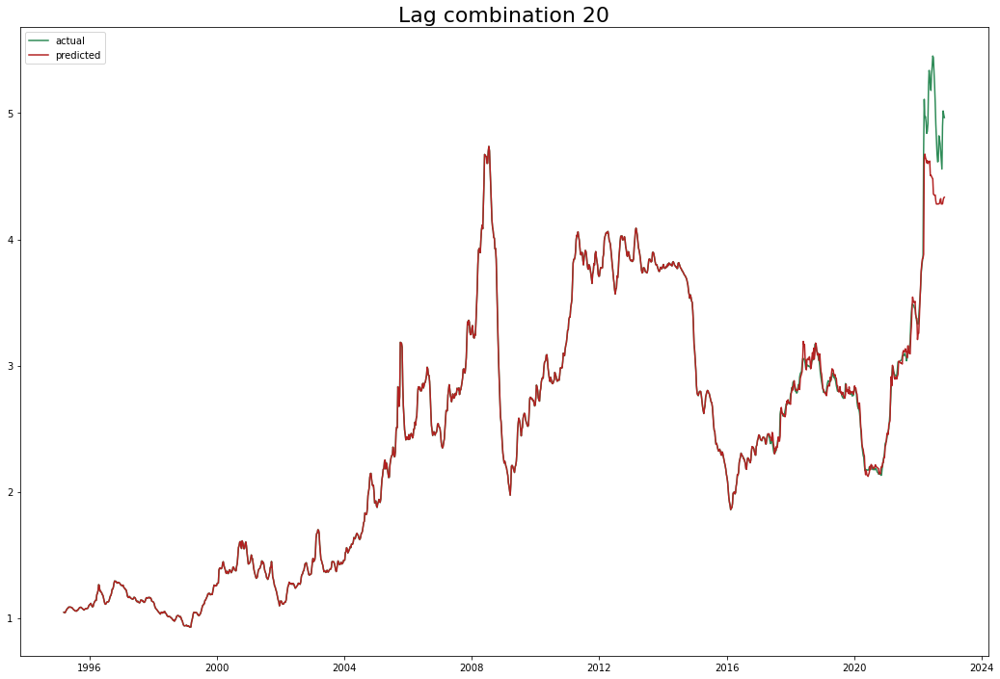

Test data rmse: 0.21855318951966668 Total rmse: 0.09764244535193878
Test data mape: 0.02412868092318085 Total mape: 0.005146447340300432
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.533) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.170) neg_root_mean_squared_error: (test=-0.582) r2: (test=-0.573) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.102) neg_root_mean_squared_error: (test=-0.651) r2: (test=0.046) total time=   0.2s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.060) r2: (test=0.981) total time=   0.3s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.5s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.547) total time=   0.1s
[CV 2/5] END learning_rate=0.05, m

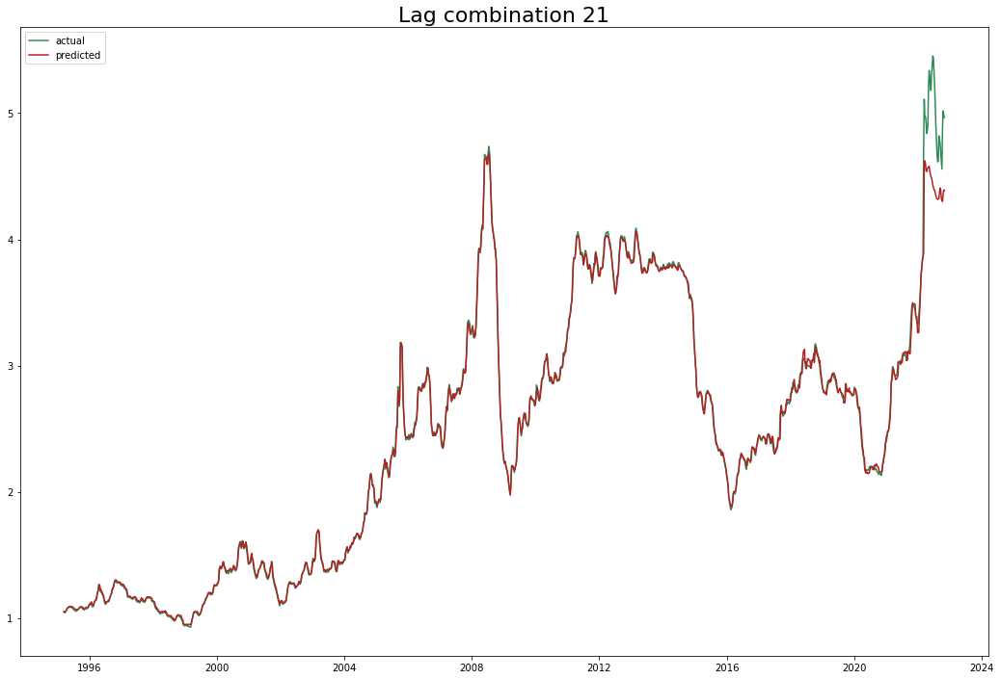

Test data rmse: 0.21438324045337237 Total rmse: 0.09737470932015992
Test data mape: 0.022250159614173065 Total mape: 0.010157186111466739
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.544) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.172) neg_root_mean_squared_error: (test=-0.586) r2: (test=-0.595) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.108) neg_root_mean_squared_error: (test=-0.666) r2: (test=-0.001) total time=   0.2s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.060) r2: (test=0.980) total time=   0.3s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.4s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.547) total time=   0.1s
[CV 2/5] END learning_rate=0.05, 

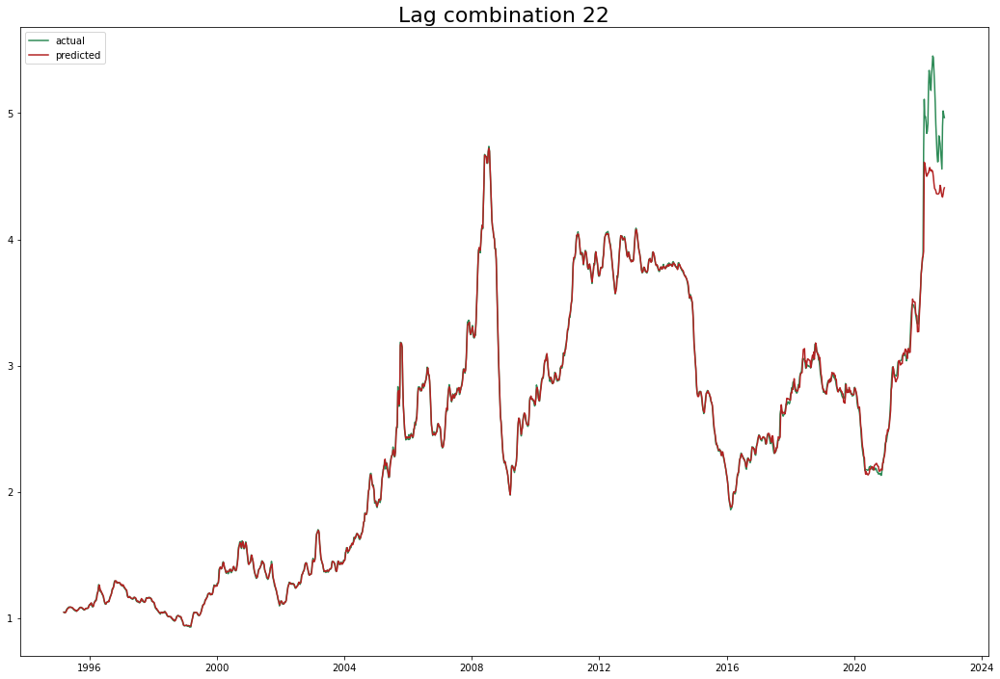

Test data rmse: 0.2067004300818042 Total rmse: 0.09297386628179738
Test data mape: 0.0224951801950472 Total mape: 0.008081090646277793
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.542) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.589) r2: (test=-0.608) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.110) neg_root_mean_squared_error: (test=-0.670) r2: (test=-0.012) total time=   0.2s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.979) total time=   0.3s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.995) total time=   0.4s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.542) total time=   0.1s
[CV 2/5] END learning_rate=0.05, 

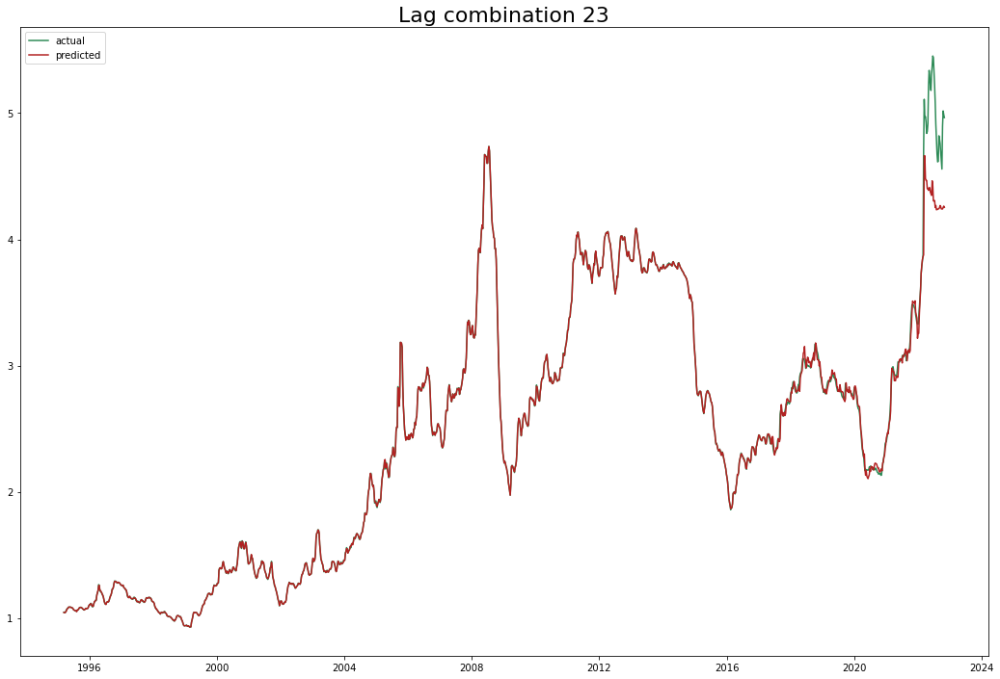

Test data rmse: 0.2454492999004483 Total rmse: 0.10970226848810535
Test data mape: 0.02541899917287025 Total mape: 0.00628890765425281
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.546) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.174) neg_root_mean_squared_error: (test=-0.590) r2: (test=-0.614) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.103) neg_root_mean_squared_error: (test=-0.649) r2: (test=0.051) total time=   0.2s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.979) total time=   0.3s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.4s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.057) neg_root_mean_squared_error: (test=-0.116) r2: (test=0.557) total time=   0.1s
[CV 2/5] END learning_rate=0.05, m

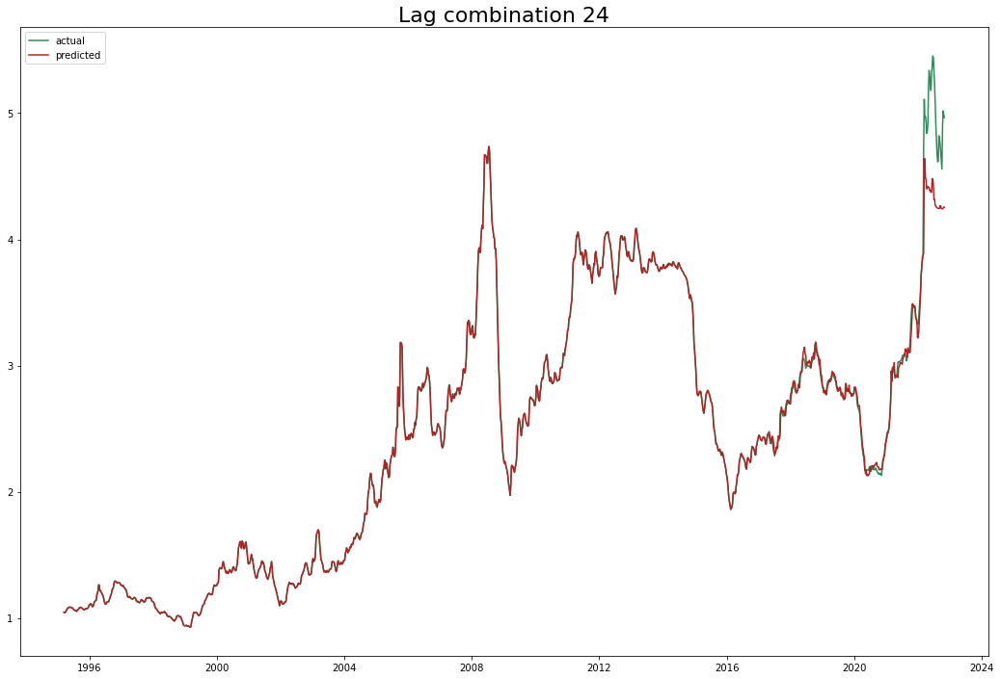

Test data rmse: 0.2419069796769299 Total rmse: 0.10811374461277702
Test data mape: 0.025531976916992924 Total mape: 0.006233142103606843
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.550) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.177) neg_root_mean_squared_error: (test=-0.597) r2: (test=-0.653) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.111) neg_root_mean_squared_error: (test=-0.675) r2: (test=-0.027) total time=   0.2s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.064) r2: (test=0.978) total time=   0.3s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.995) total time=   0.5s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.552) total time=   0.1s
[CV 2/5] END learning_rate=0.05, 

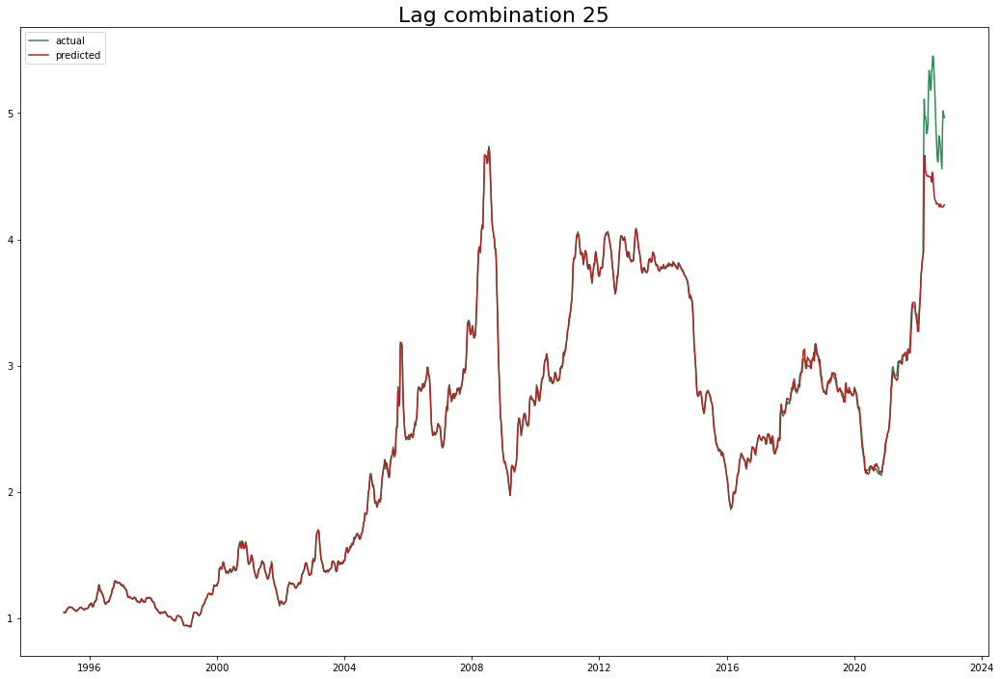

Test data rmse: 0.2263123575713371 Total rmse: 0.10168625064308953
Test data mape: 0.02352405903714309 Total mape: 0.008241809698400425
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.543) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.175) neg_root_mean_squared_error: (test=-0.591) r2: (test=-0.617) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.115) neg_root_mean_squared_error: (test=-0.687) r2: (test=-0.064) total time=   0.2s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.977) total time=   0.4s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.051) r2: (test=0.994) total time=   0.5s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.547) total time=   0.1s
[CV 2/5] END learning_rate=0.05, 

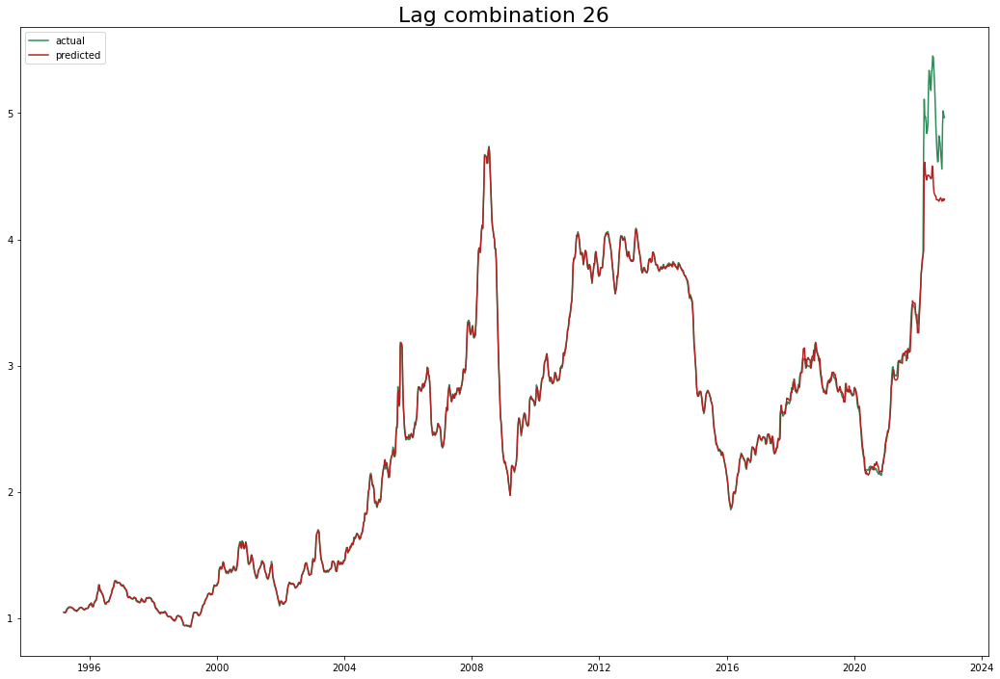

Test data rmse: 0.21994474415687412 Total rmse: 0.09883288611490496
Test data mape: 0.0234579243859632 Total mape: 0.008210037130434548
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.060) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.534) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.587) r2: (test=-0.600) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.109) neg_root_mean_squared_error: (test=-0.669) r2: (test=-0.011) total time=   0.3s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.976) total time=   0.4s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.052) r2: (test=0.994) total time=   0.5s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.118) r2: (test=0.539) total time=   0.1s
[CV 2/5] END learning_rate=0.05, 

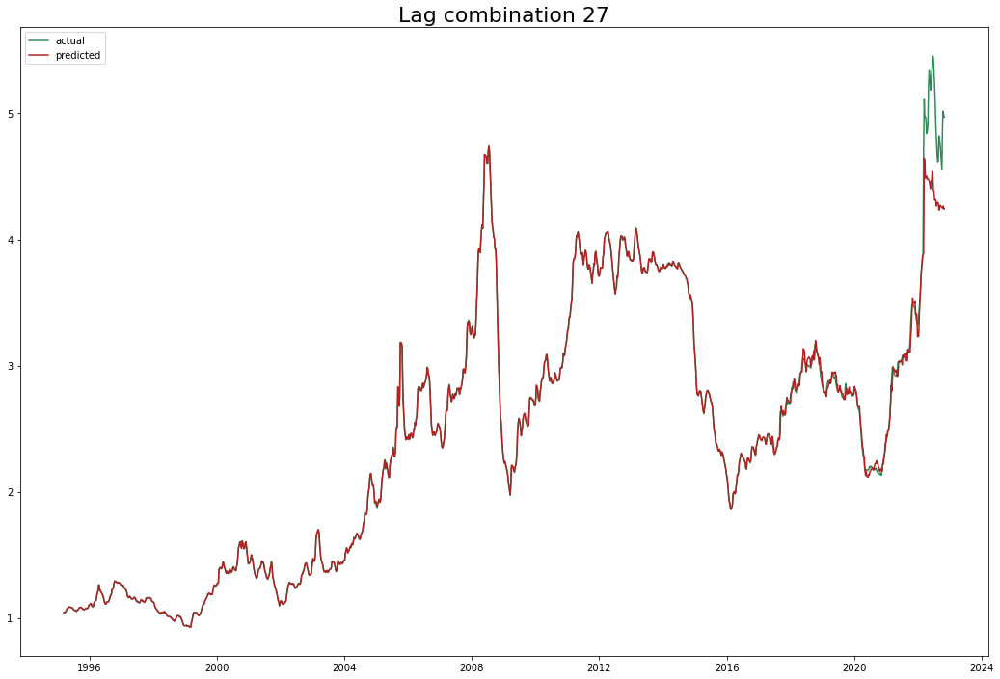

Test data rmse: 0.23291508494238064 Total rmse: 0.10410248113988207
Test data mape: 0.024974085784011738 Total mape: 0.006143549618840543
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.059) neg_root_mean_squared_error: (test=-0.119) r2: (test=0.537) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.174) neg_root_mean_squared_error: (test=-0.591) r2: (test=-0.621) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.106) neg_root_mean_squared_error: (test=-0.663) r2: (test=0.009) total time=   0.3s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.979) total time=   0.4s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.995) total time=   0.5s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.058) neg_root_mean_squared_error: (test=-0.117) r2: (test=0.549) total time=   0.1s
[CV 2/5] END learning_rate=0.05, m

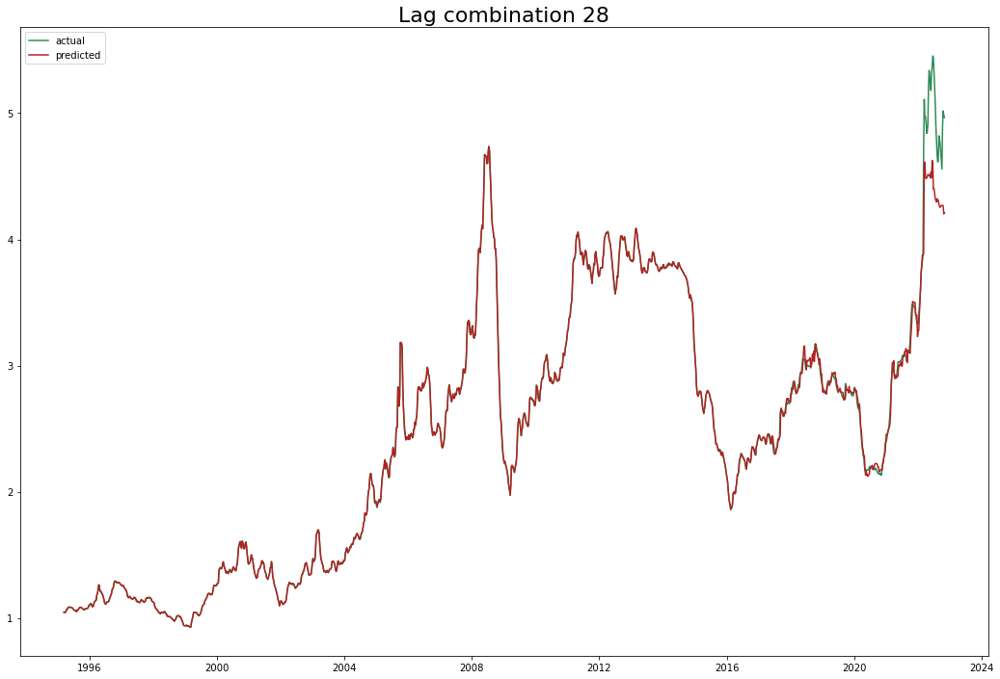

Test data rmse: 0.2250142841551747 Total rmse: 0.10057972859145069
Test data mape: 0.024483911508690035 Total mape: 0.006131884202045617
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.522) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.587) r2: (test=-0.600) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.111) neg_root_mean_squared_error: (test=-0.678) r2: (test=-0.036) total time=   0.3s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.977) total time=   0.4s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.051) r2: (test=0.994) total time=   0.5s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.061) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.522) total time=   0.1s
[CV 2/5] END learning_rate=0.05, 

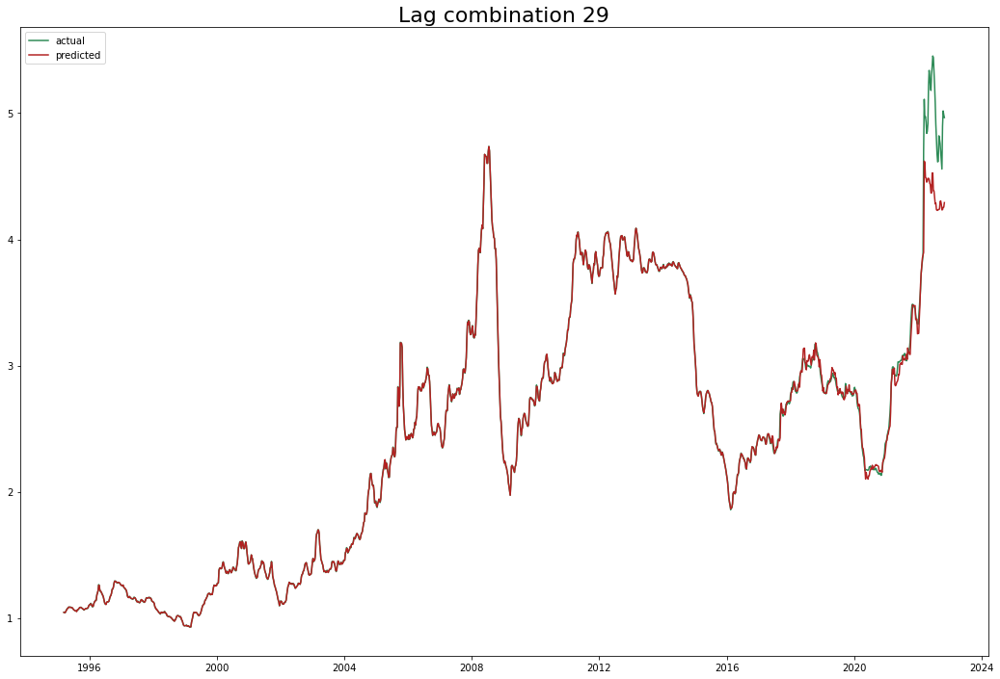

Test data rmse: 0.2360254588436788 Total rmse: 0.1054910323089384
Test data mape: 0.02592209640866726 Total mape: 0.00632264571077373
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.497) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.175) neg_root_mean_squared_error: (test=-0.592) r2: (test=-0.627) total time=   0.1s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.106) neg_root_mean_squared_error: (test=-0.662) r2: (test=0.010) total time=   0.3s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.975) total time=   0.4s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.995) total time=   0.6s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.491) total time=   0.1s
[CV 2/5] END learning_rate=0.05, m

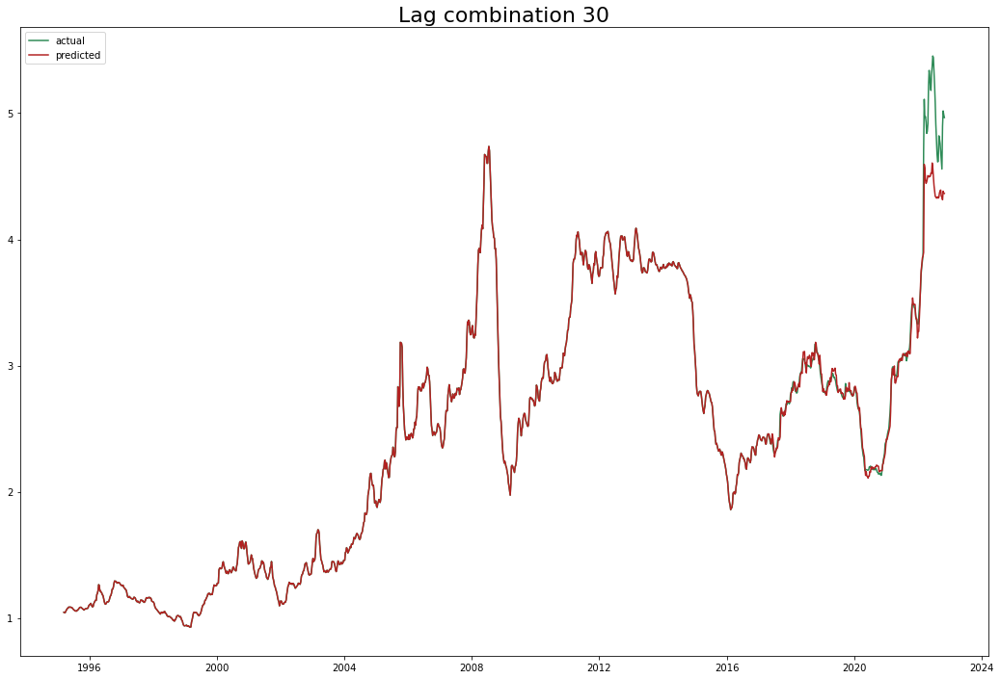

Test data rmse: 0.21492976527738458 Total rmse: 0.09602191450211232
Test data mape: 0.024029603630094126 Total mape: 0.005052207041106315
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.495) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.589) r2: (test=-0.611) total time=   0.2s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.112) neg_root_mean_squared_error: (test=-0.680) r2: (test=-0.043) total time=   0.3s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.070) r2: (test=0.974) total time=   0.4s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.995) total time=   0.6s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.504) total time=   0.2s
[CV 2/5] END learning_rate=0.05, 

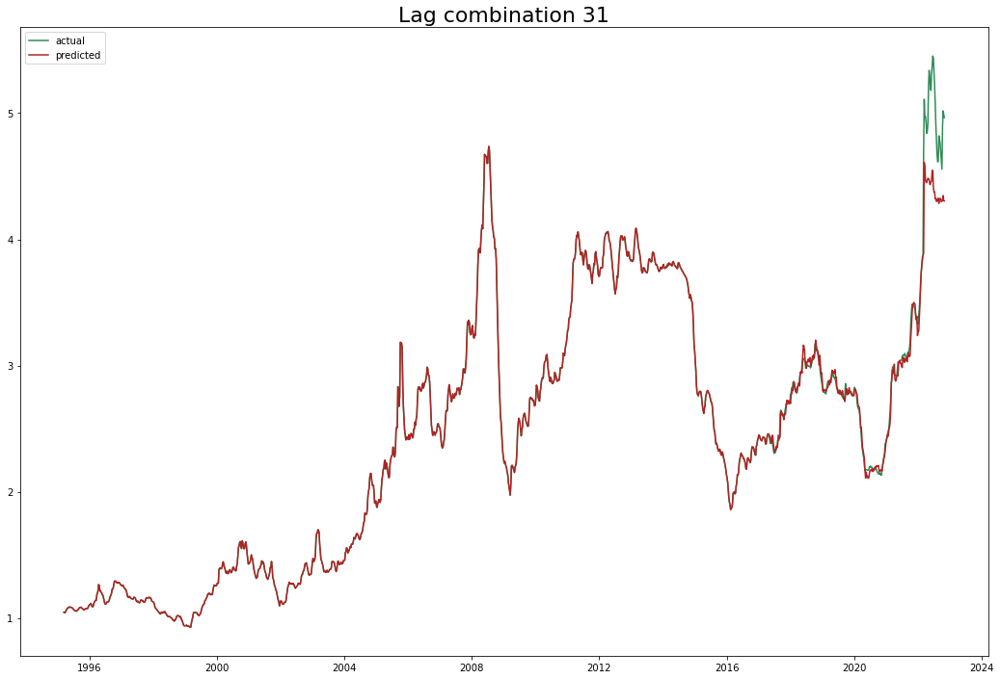

Test data rmse: 0.2261055895001693 Total rmse: 0.10101453547437755
Test data mape: 0.02470451806188379 Total mape: 0.005192095134844965
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.496) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.174) neg_root_mean_squared_error: (test=-0.592) r2: (test=-0.627) total time=   0.2s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.112) neg_root_mean_squared_error: (test=-0.681) r2: (test=-0.044) total time=   0.3s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.090) r2: (test=0.956) total time=   0.4s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.995) total time=   0.6s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.120) r2: (test=0.522) total time=   0.2s
[CV 2/5] END learning_rate=0.05, 

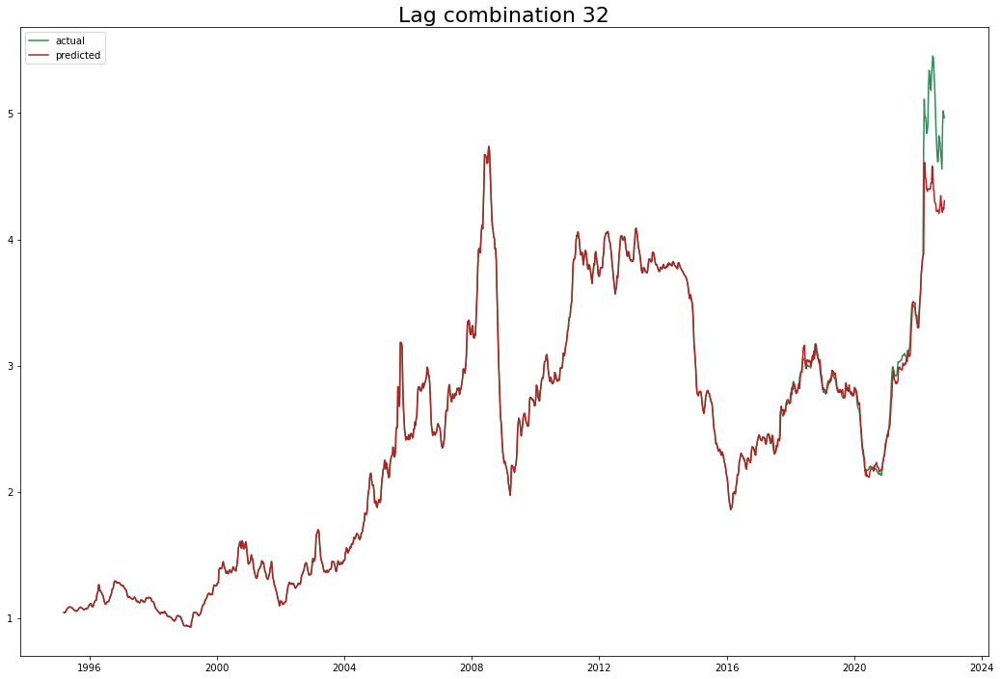

Test data rmse: 0.23922016564181856 Total rmse: 0.10687341843109241
Test data mape: 0.026575027552341327 Total mape: 0.005567559668523581
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.509) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.174) neg_root_mean_squared_error: (test=-0.591) r2: (test=-0.621) total time=   0.2s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.111) neg_root_mean_squared_error: (test=-0.677) r2: (test=-0.034) total time=   0.3s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.074) r2: (test=0.971) total time=   0.5s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.052) r2: (test=0.994) total time=   0.6s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.121) r2: (test=0.514) total time=   0.2s
[CV 2/5] END learning_rate=0.05, 

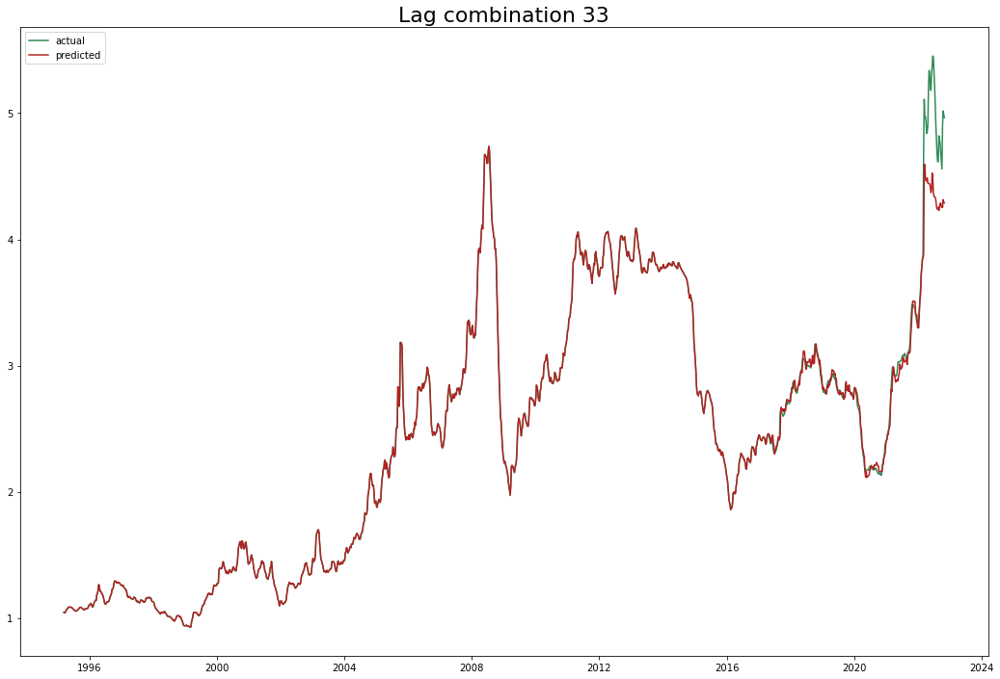

Test data rmse: 0.2363093350601512 Total rmse: 0.10557320145642773
Test data mape: 0.025921948548116858 Total mape: 0.0054454167685457034
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.498) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.174) neg_root_mean_squared_error: (test=-0.591) r2: (test=-0.622) total time=   0.2s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.108) neg_root_mean_squared_error: (test=-0.670) r2: (test=-0.011) total time=   0.3s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.076) r2: (test=0.970) total time=   0.5s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.051) r2: (test=0.995) total time=   0.6s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.496) total time=   0.2s
[CV 2/5] END learning_rate=0.05, 

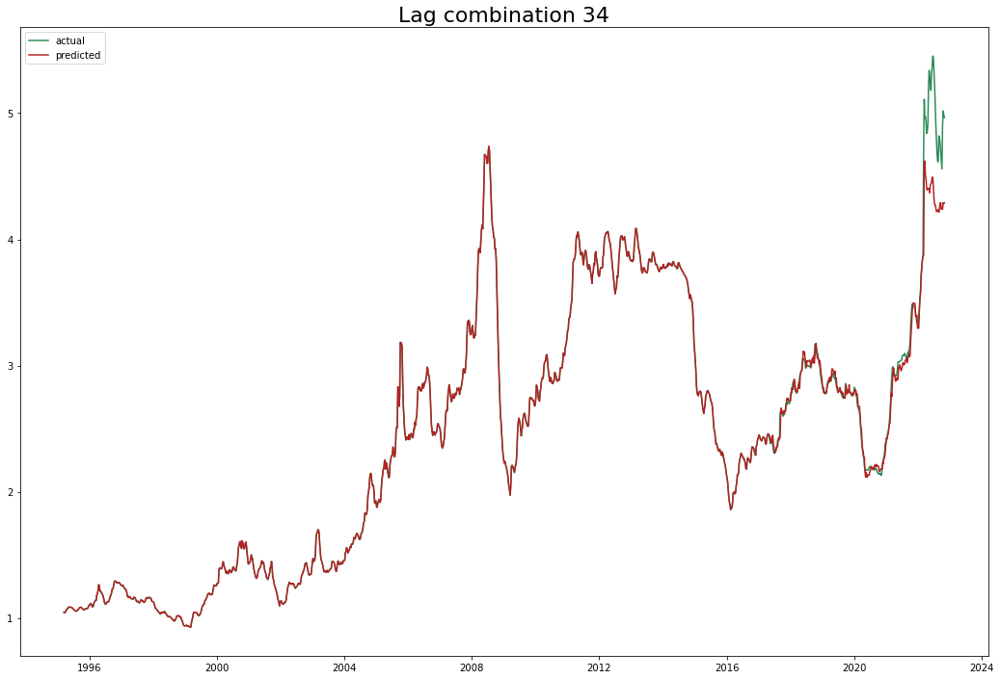

Test data rmse: 0.240856792142226 Total rmse: 0.10760433514620456
Test data mape: 0.0260461173102896 Total mape: 0.005443992646745108
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.491) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.172) neg_root_mean_squared_error: (test=-0.586) r2: (test=-0.590) total time=   0.2s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.106) neg_root_mean_squared_error: (test=-0.661) r2: (test=0.015) total time=   0.3s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.091) r2: (test=0.956) total time=   0.5s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.7s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.492) total time=   0.2s
[CV 2/5] END learning_rate=0.05, m

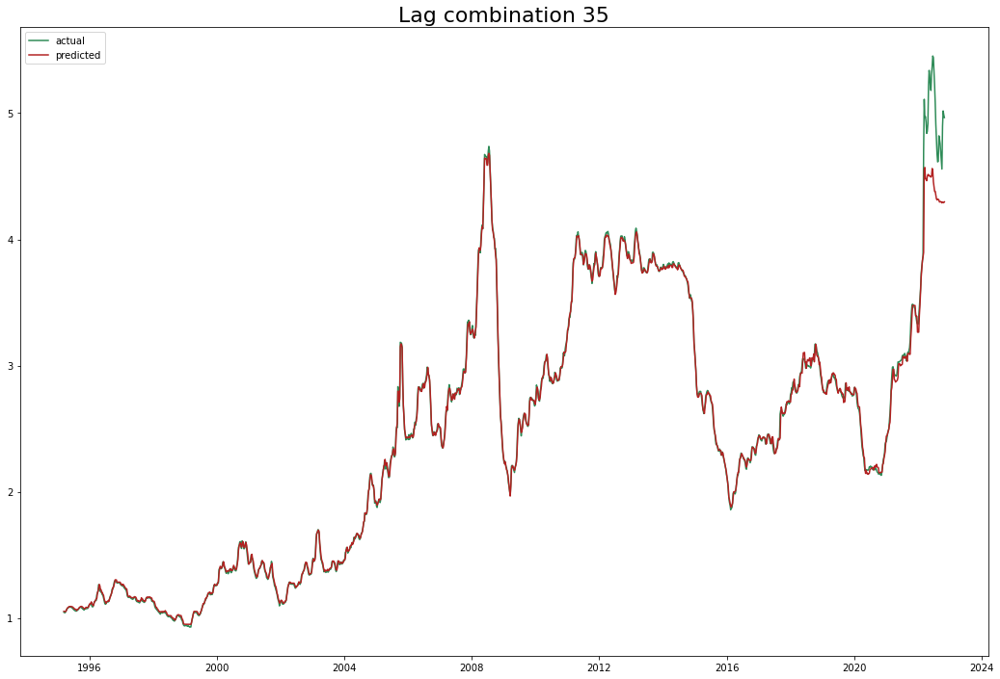

Test data rmse: 0.22072917079611798 Total rmse: 0.09995856683783318
Test data mape: 0.023310234851720818 Total mape: 0.010126544851041329
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.503) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.588) r2: (test=-0.603) total time=   0.2s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.128) neg_root_mean_squared_error: (test=-0.734) r2: (test=-0.214) total time=   0.4s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.955) total time=   0.5s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.052) r2: (test=0.994) total time=   0.7s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.493) total time=   0.2s
[CV 2/5] END learning_rate=0.05, 

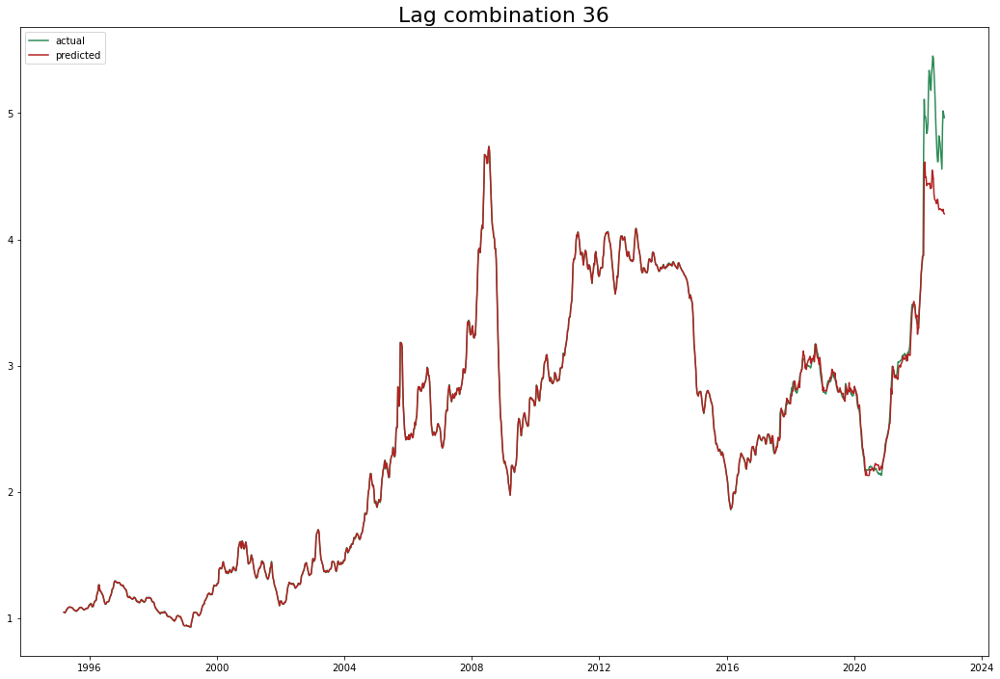

Test data rmse: 0.23644913859405026 Total rmse: 0.1056815061244143
Test data mape: 0.025265475314548487 Total mape: 0.0062529456210188026
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.476) total time=   0.1s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.589) r2: (test=-0.610) total time=   0.2s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.145) neg_root_mean_squared_error: (test=-0.791) r2: (test=-0.410) total time=   0.4s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.019) neg_root_mean_squared_error: (test=-0.086) r2: (test=0.961) total time=   0.6s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.995) total time=   0.7s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.498) total time=   0.2s
[CV 2/5] END learning_rate=0.05, 

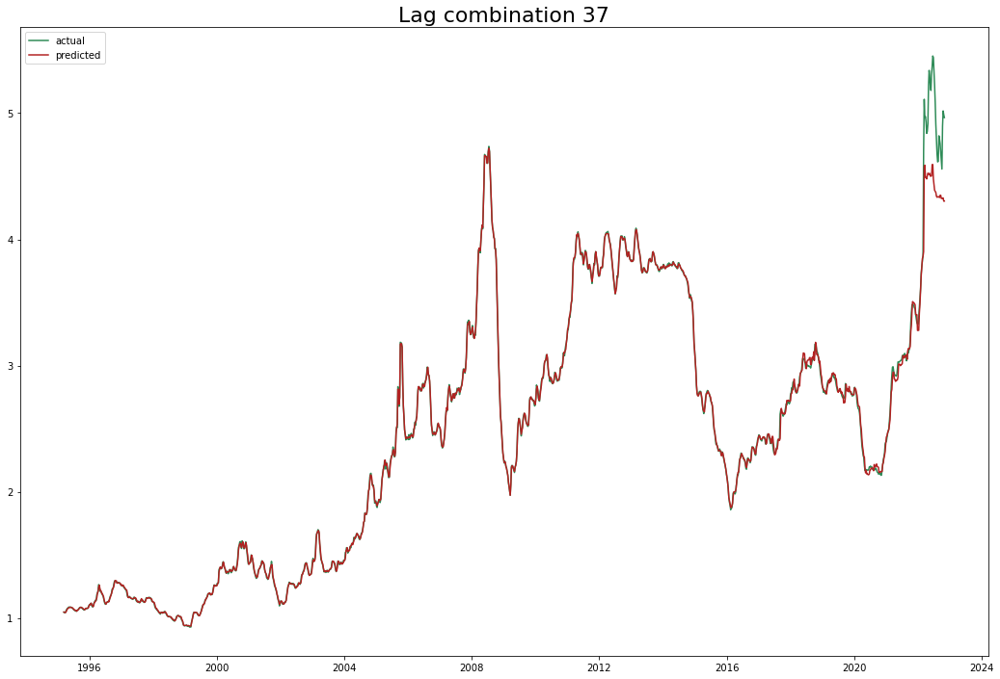

Test data rmse: 0.21439332930394558 Total rmse: 0.09629338163539342
Test data mape: 0.02266396198296817 Total mape: 0.007892060706521013
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.492) total time=   0.1s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.174) neg_root_mean_squared_error: (test=-0.591) r2: (test=-0.621) total time=   0.2s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.144) neg_root_mean_squared_error: (test=-0.788) r2: (test=-0.400) total time=   0.4s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.083) r2: (test=0.963) total time=   0.5s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.7s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.505) total time=   0.2s
[CV 2/5] END learning_rate=0.05, 

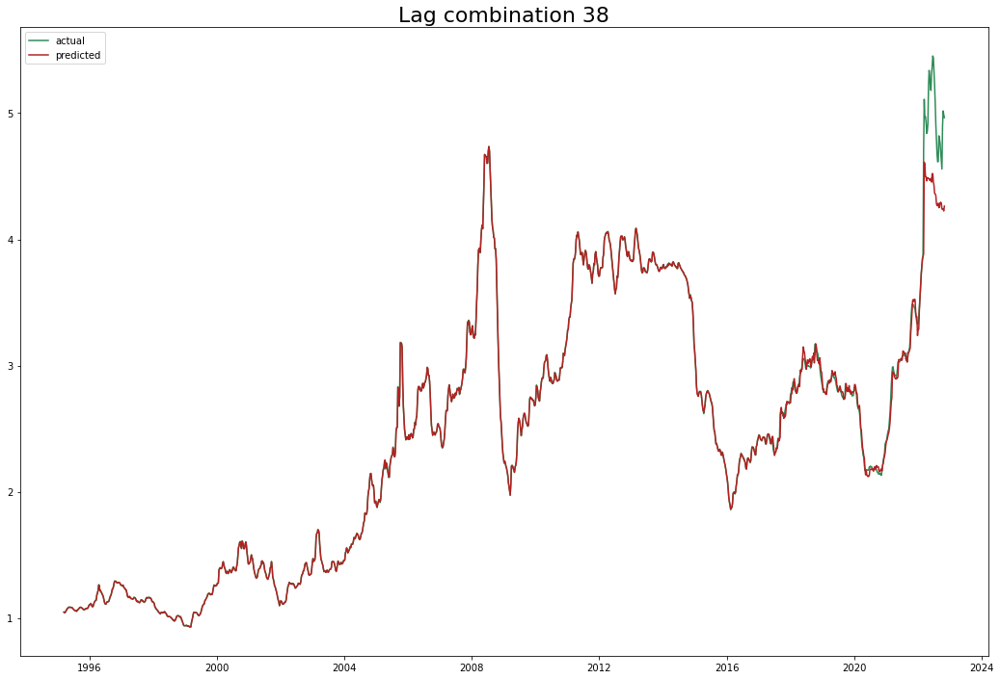

Test data rmse: 0.22821770324100754 Total rmse: 0.10200227076226057
Test data mape: 0.02461228803904382 Total mape: 0.006026139435400917
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.481) total time=   0.1s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.588) r2: (test=-0.602) total time=   0.2s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.144) neg_root_mean_squared_error: (test=-0.786) r2: (test=-0.394) total time=   0.4s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.954) total time=   0.6s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.8s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.495) total time=   0.2s
[CV 2/5] END learning_rate=0.05, 

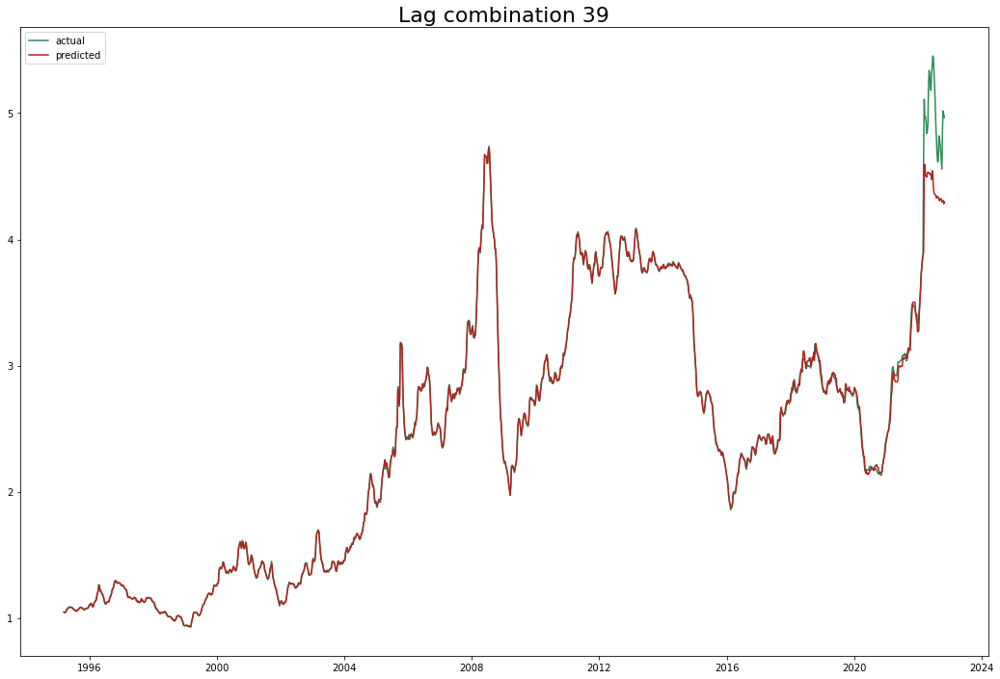

Test data rmse: 0.22010575246466593 Total rmse: 0.09882897250015035
Test data mape: 0.02323573339733482 Total mape: 0.007979031777759282
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.500) total time=   0.1s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.589) r2: (test=-0.608) total time=   0.2s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.796) r2: (test=-0.429) total time=   0.4s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.081) r2: (test=0.965) total time=   0.6s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.052) r2: (test=0.994) total time=   0.8s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.487) total time=   0.2s
[CV 2/5] END learning_rate=0.05, 

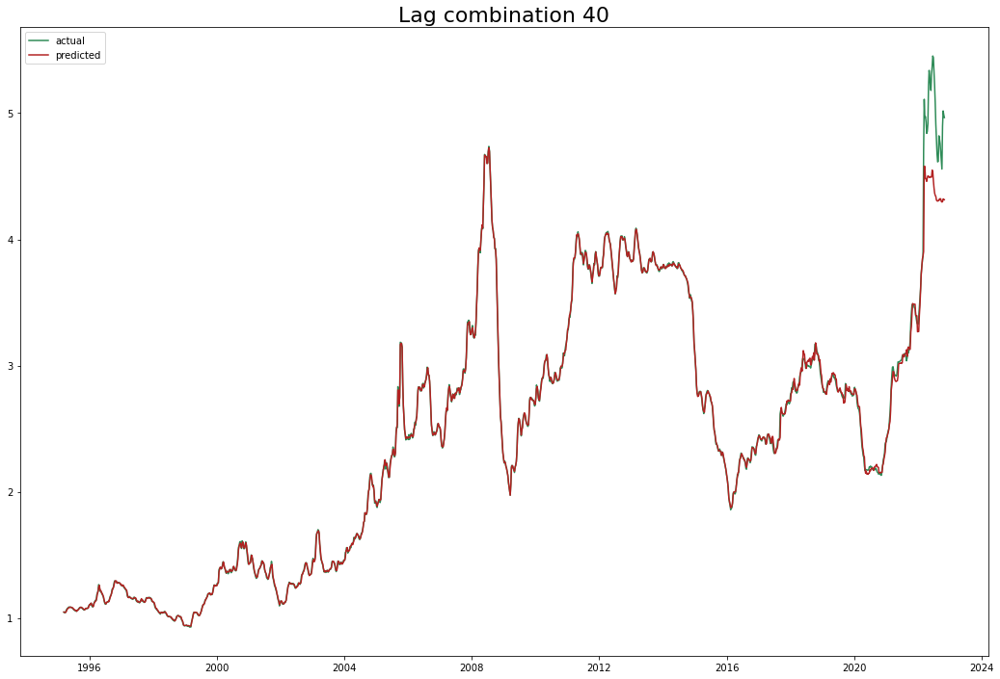

Test data rmse: 0.22058474801327177 Total rmse: 0.0990385885090676
Test data mape: 0.023016393050379922 Total mape: 0.007941053607221976
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.488) total time=   0.1s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.588) r2: (test=-0.603) total time=   0.2s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.144) neg_root_mean_squared_error: (test=-0.788) r2: (test=-0.400) total time=   0.4s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.079) r2: (test=0.966) total time=   0.6s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.052) r2: (test=0.994) total time=   0.8s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.504) total time=   0.2s
[CV 2/5] END learning_rate=0.05, 

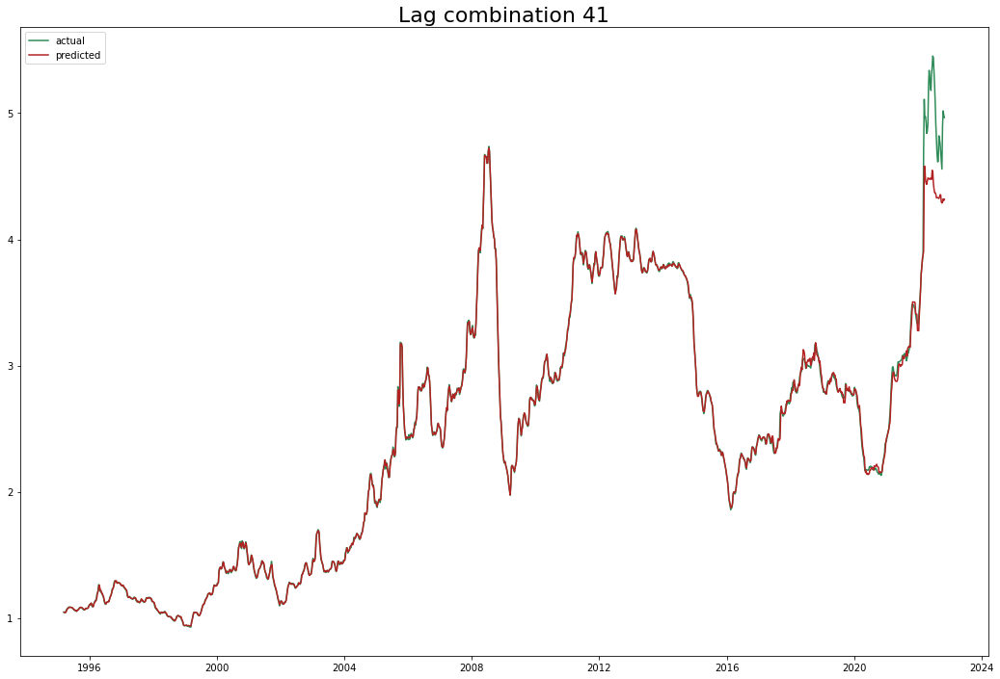

Test data rmse: 0.22139182930479623 Total rmse: 0.09938024691845546
Test data mape: 0.02327853796875477 Total mape: 0.007948728229589017
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.481) total time=   0.1s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.174) neg_root_mean_squared_error: (test=-0.590) r2: (test=-0.613) total time=   0.2s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.145) neg_root_mean_squared_error: (test=-0.789) r2: (test=-0.406) total time=   0.4s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.090) r2: (test=0.957) total time=   0.6s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.995) total time=   0.8s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.124) r2: (test=0.492) total time=   0.2s
[CV 2/5] END learning_rate=0.05, 

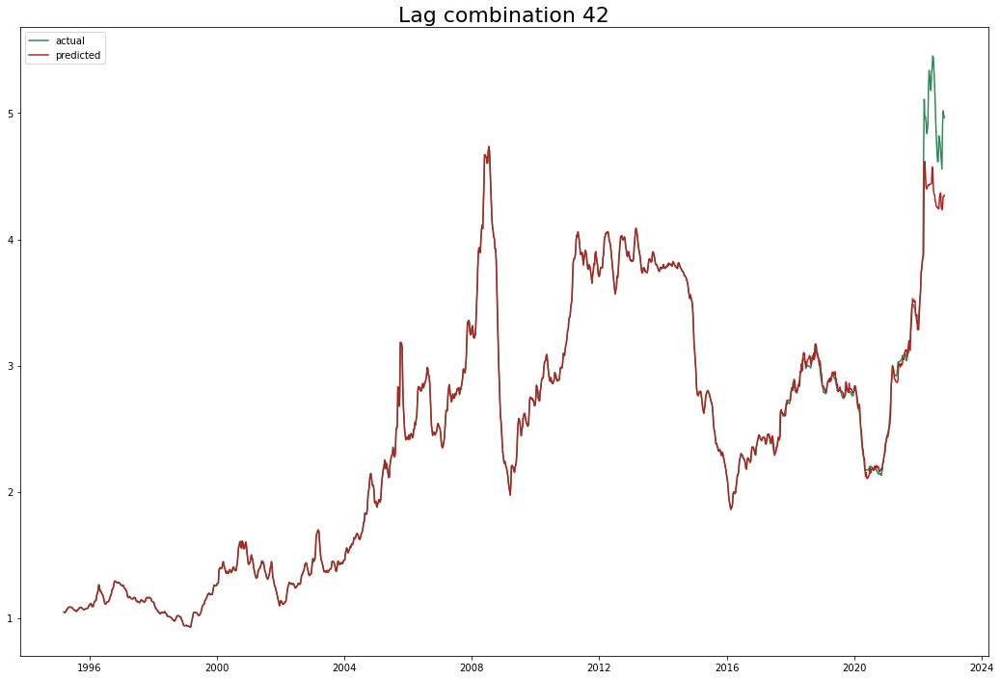

Test data rmse: 0.23070791891102496 Total rmse: 0.10311714968458235
Test data mape: 0.02511143037725883 Total mape: 0.006186011121404107
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.123) r2: (test=0.502) total time=   0.1s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.174) neg_root_mean_squared_error: (test=-0.593) r2: (test=-0.629) total time=   0.2s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.146) neg_root_mean_squared_error: (test=-0.793) r2: (test=-0.417) total time=   0.4s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.094) r2: (test=0.953) total time=   0.6s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   0.8s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.469) total time=   0.2s
[CV 2/5] END learning_rate=0.05, 

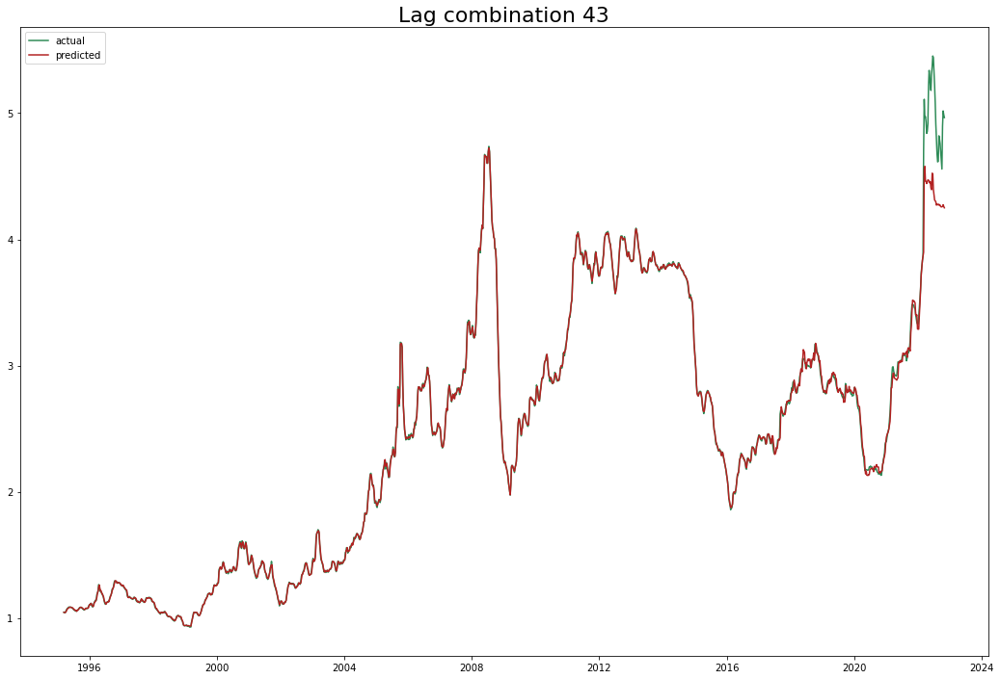

Test data rmse: 0.23434305617225606 Total rmse: 0.10512234263249048
Test data mape: 0.024143540528821946 Total mape: 0.008068622360697185
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.482) total time=   0.1s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.589) r2: (test=-0.608) total time=   0.3s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.144) neg_root_mean_squared_error: (test=-0.792) r2: (test=-0.415) total time=   0.4s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.095) r2: (test=0.952) total time=   0.6s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.051) r2: (test=0.994) total time=   0.8s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.489) total time=   0.2s
[CV 2/5] END learning_rate=0.05, 

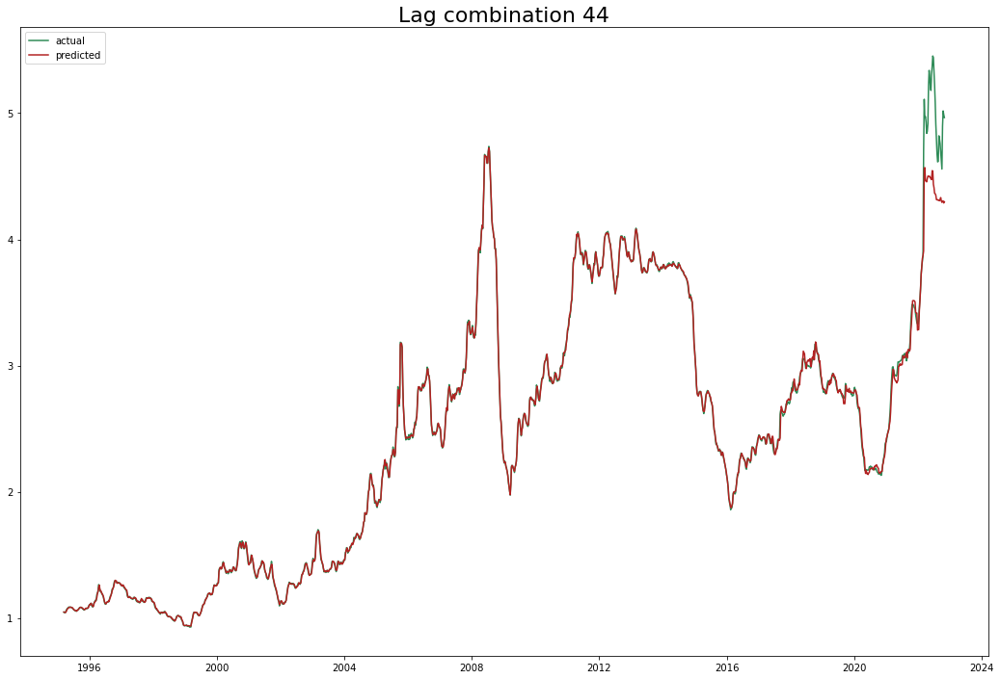

Test data rmse: 0.222162062060492 Total rmse: 0.09974350097049799
Test data mape: 0.023274982273525882 Total mape: 0.007980068164428354
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.126) r2: (test=0.479) total time=   0.1s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.587) r2: (test=-0.600) total time=   0.3s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.141) neg_root_mean_squared_error: (test=-0.767) r2: (test=-0.327) total time=   0.5s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.094) r2: (test=0.953) total time=   0.7s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.050) r2: (test=0.995) total time=   0.9s
[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=200; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.481) total time=   0.3s
[CV 2/5] END learning_rate=0.05, 

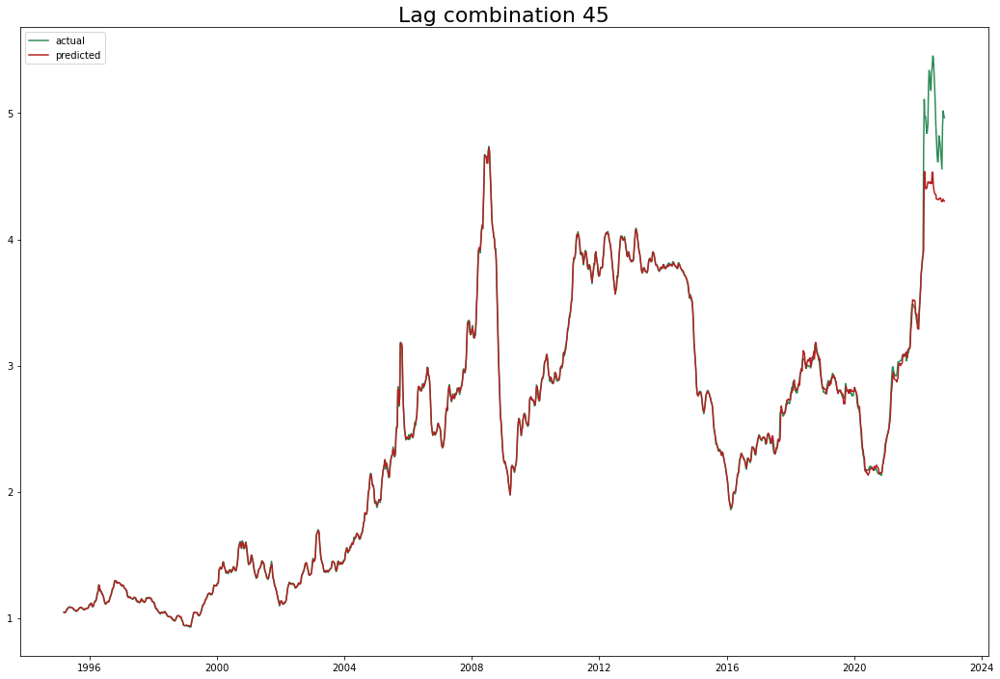

Test data rmse: 0.22745364918663202 Total rmse: 0.10207606629146528
Test data mape: 0.023588755289704676 Total mape: 0.007977089486151919
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.482) total time=   0.1s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.174) neg_root_mean_squared_error: (test=-0.589) r2: (test=-0.609) total time=   0.3s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.146) neg_root_mean_squared_error: (test=-0.780) r2: (test=-0.373) total time=   0.5s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.097) r2: (test=0.950) total time=   0.7s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.9s
[CV 1/5] END learning_rate=0.05, 

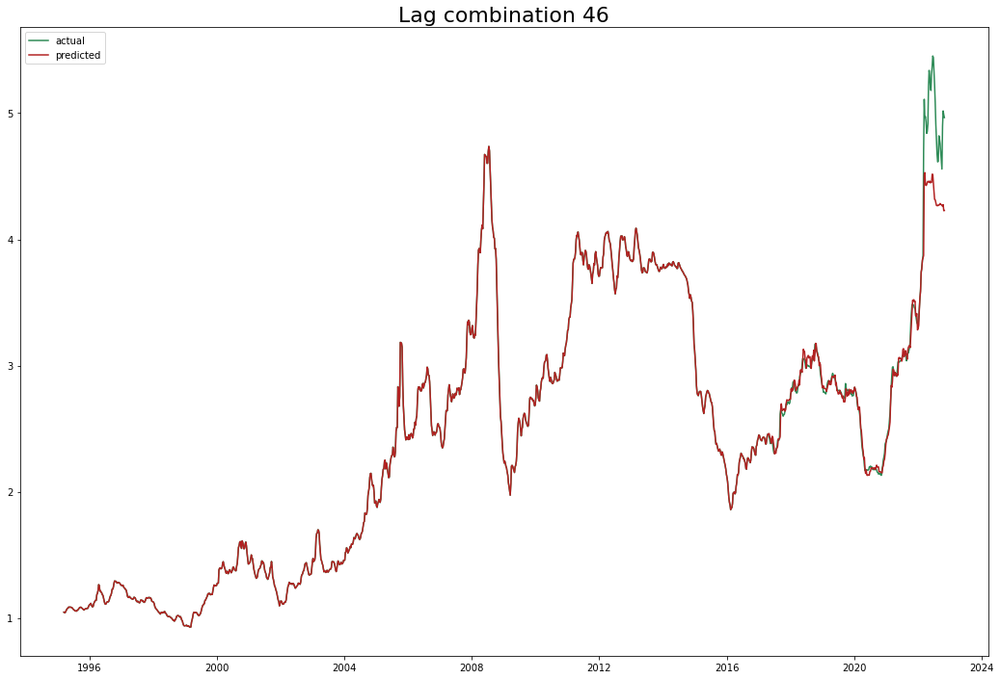

Test data rmse: 0.23454395892700122 Total rmse: 0.10478515148733089
Test data mape: 0.025076931023530185 Total mape: 0.005306919642248282
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.065) neg_root_mean_squared_error: (test=-0.127) r2: (test=0.470) total time=   0.1s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.171) neg_root_mean_squared_error: (test=-0.582) r2: (test=-0.570) total time=   0.3s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.148) neg_root_mean_squared_error: (test=-0.781) r2: (test=-0.374) total time=   0.5s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.954) total time=   0.7s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   0.9s
[CV 1/5] END learning_rate=0.05, 

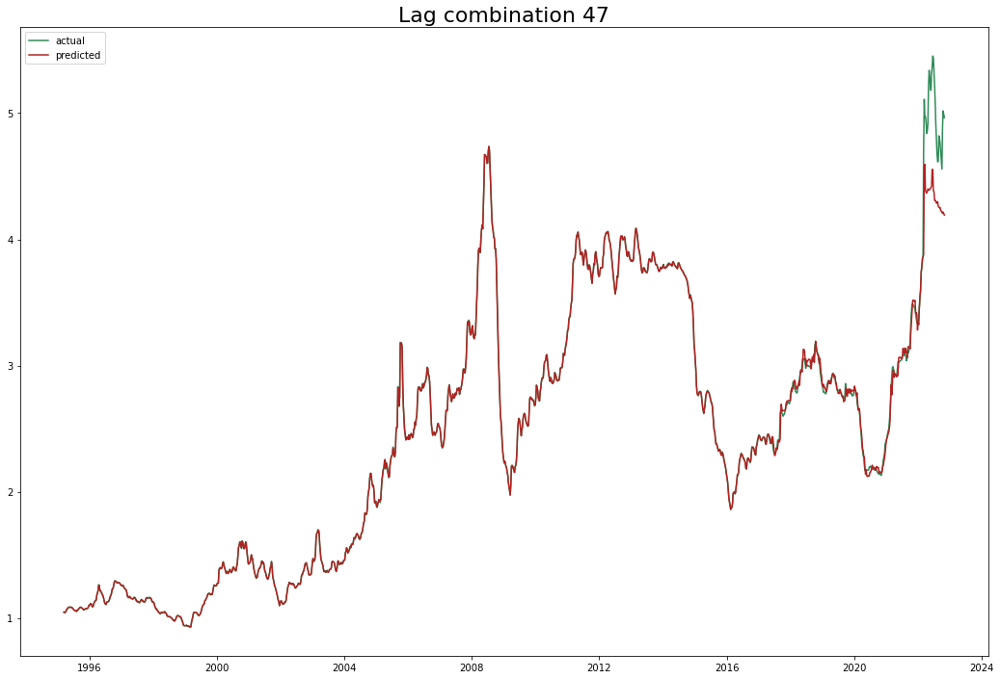

Test data rmse: 0.24237581904143538 Total rmse: 0.10832944006233677
Test data mape: 0.025514307381118942 Total mape: 0.006322275012257674
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.064) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.484) total time=   0.1s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.585) r2: (test=-0.586) total time=   0.3s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.149) neg_root_mean_squared_error: (test=-0.782) r2: (test=-0.379) total time=   0.5s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.099) r2: (test=0.947) total time=   0.7s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.047) r2: (test=0.995) total time=   1.0s
[CV 1/5] END learning_rate=0.05, 

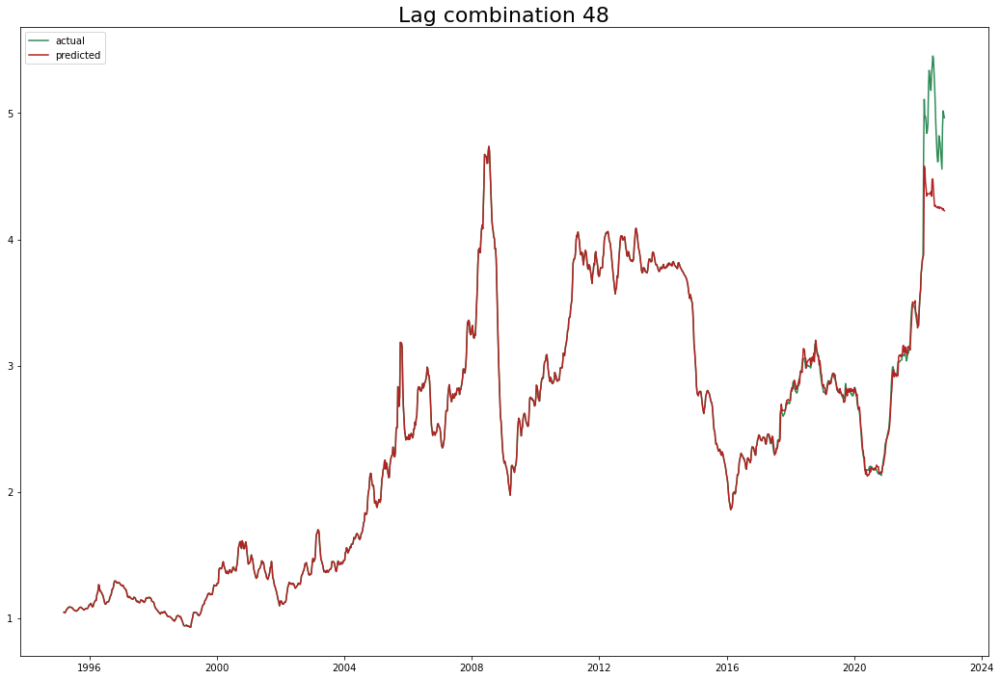

Test data rmse: 0.24834649989634525 Total rmse: 0.1109509085888721
Test data mape: 0.026070777475924546 Total mape: 0.00548693383864001
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.062) neg_root_mean_squared_error: (test=-0.122) r2: (test=0.507) total time=   0.1s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.173) neg_root_mean_squared_error: (test=-0.585) r2: (test=-0.588) total time=   0.3s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.782) r2: (test=-0.378) total time=   0.6s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.099) r2: (test=0.948) total time=   0.8s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.049) r2: (test=0.995) total time=   1.1s
[CV 1/5] END learning_rate=0.05, 

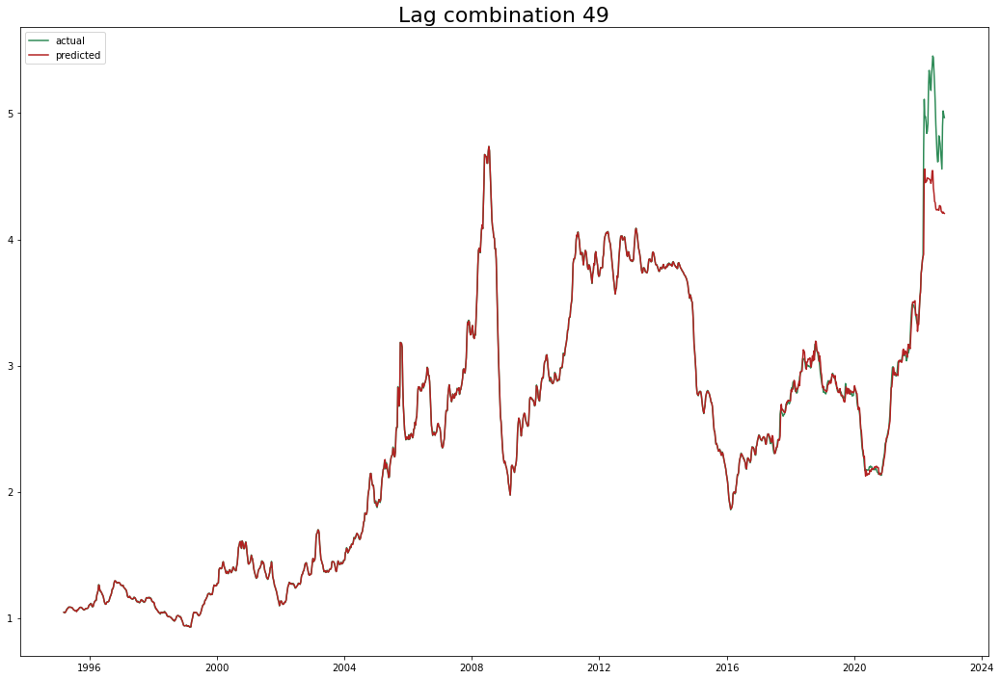

Test data rmse: 0.23610182538984467 Total rmse: 0.10552313262213778
Test data mape: 0.02420014801621462 Total mape: 0.005970012377262754
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag', '51w_lag']
Fitting 5 folds for each of 6 candidates, totalling 30 fits


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


[CV 1/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.063) neg_root_mean_squared_error: (test=-0.125) r2: (test=0.481) total time=   0.1s
[CV 2/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.169) neg_root_mean_squared_error: (test=-0.576) r2: (test=-0.538) total time=   0.3s
[CV 3/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.148) neg_root_mean_squared_error: (test=-0.785) r2: (test=-0.388) total time=   0.6s
[CV 4/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.101) r2: (test=0.946) total time=   0.8s
[CV 5/5] END learning_rate=0.05, max_depth=5, n_estimators=100; neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.048) r2: (test=0.995) total time=   1.0s
[CV 1/5] END learning_rate=0.05, 

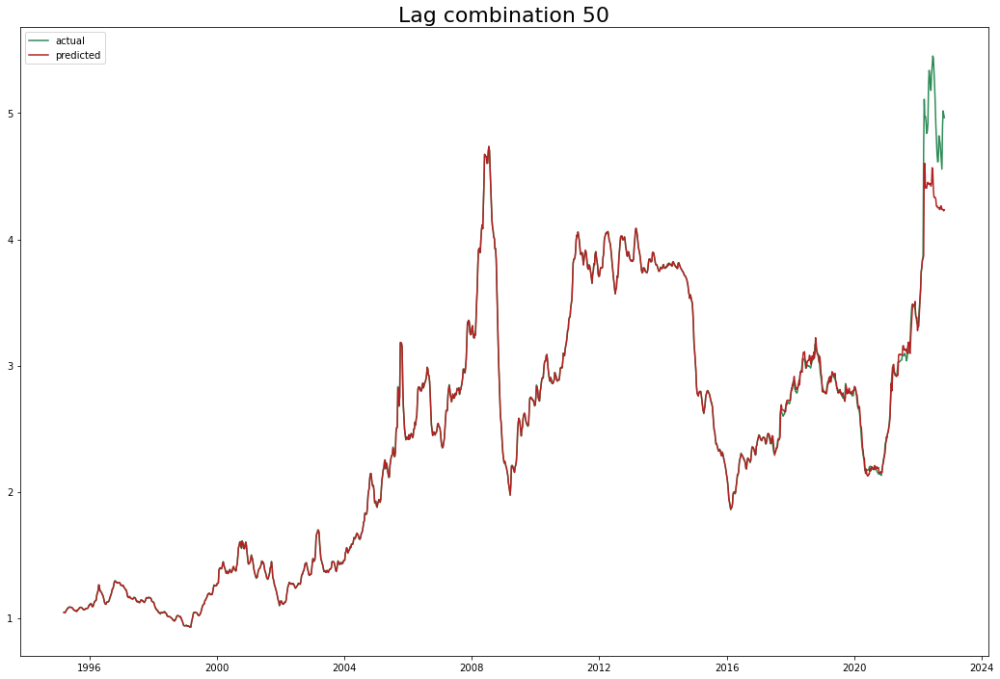

Test data rmse: 0.23716814166093095 Total rmse: 0.10600834010713447
Test data mape: 0.025069056124220737 Total mape: 0.006269957892954105


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


In [785]:
from sklearn.ensemble import GradientBoostingRegressor

gbr = GradientBoostingRegressor()
gbr_params ={'learning_rate':[0.05,0.1,0.3],'n_estimators':[100,200],'max_depth':[5]}
gbr_grid_list, summary_data = test_mdl(df1.columns[3:-1],gbr,gbr_params,'GradientBoostingRegressor')

### Tree-based models performance

I have decided to include tree-based regressors in my project, but unfortunately due to the fact that most recently we have experienced the highest diesel prices per gallon ever, those models perform worse than expected because they are unable to predict higher values than values in the training set. In this case in order to get as accurate results as possible we could include the highest known values possible in the training set by changing the data splitting method to random with shuffling, shrink the test size to the size that the peak value would be still in training set or use only the data for the last 2 years and add to it white noise. 

### Lasso, Ridge, LinearRegression

--------------------------
Next model: 
Lags choosen:  ['1w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.022) r2: (test=0.984) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.070) r2: (test=0.989) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.991) total time=   0.0s
[CV 5/5] END  neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.034) r2: (test=0.998) total time=   0.0s
{}


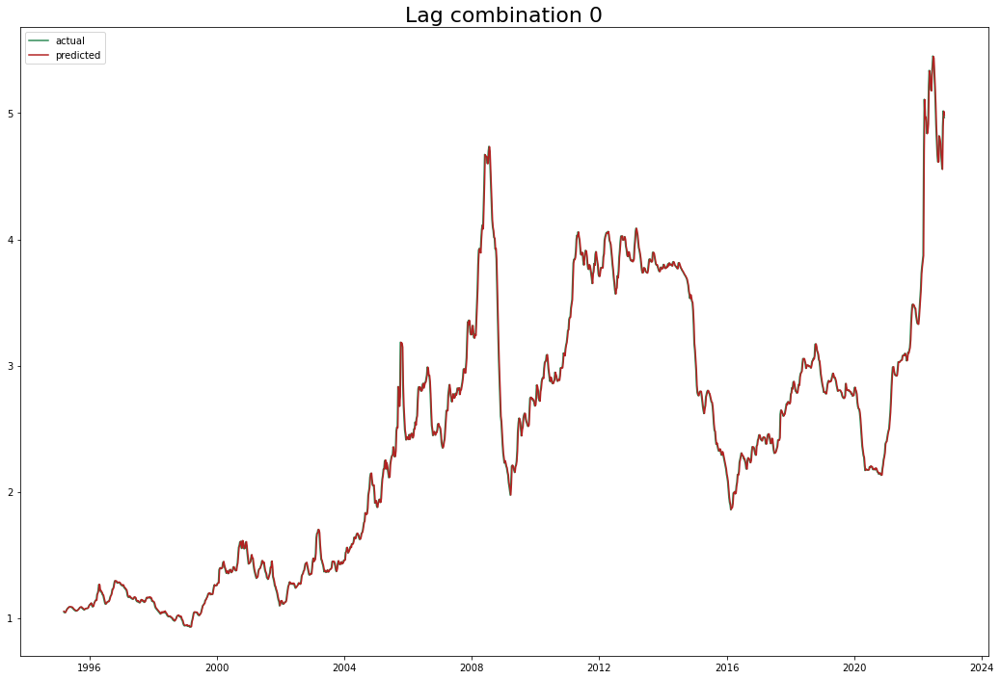

Test data rmse: 0.07542857259515079 Total rmse: 0.052006469975288565
Test data mape: 0.010433859379028715 Total mape: 0.011366196895859203
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.020) r2: (test=0.987) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.985) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.993) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.036) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_mean_absolute_percentage_error: (test=-0.007) neg_root_mean_squared_error: (test=-0.026) r2: (test=0.999) total time=   0.0s
{}


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


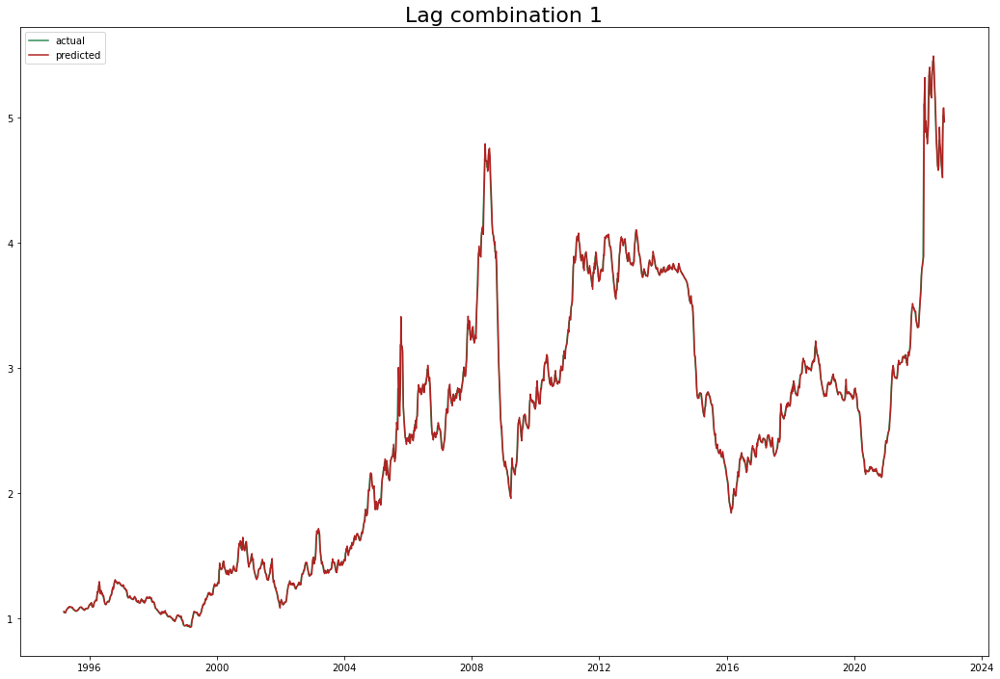

Test data rmse: 0.06891257565818382 Total rmse: 0.0456808318152518
Test data mape: 0.008645436076765288 Total mape: 0.009704395131835386
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.020) r2: (test=0.987) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.992) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.036) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_mean_absolute_percentage_error: (test=-0.007) neg_root_mean_squared_error: (test=-0.026) r2: (test=0.999) total time=   0.0s
{}


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


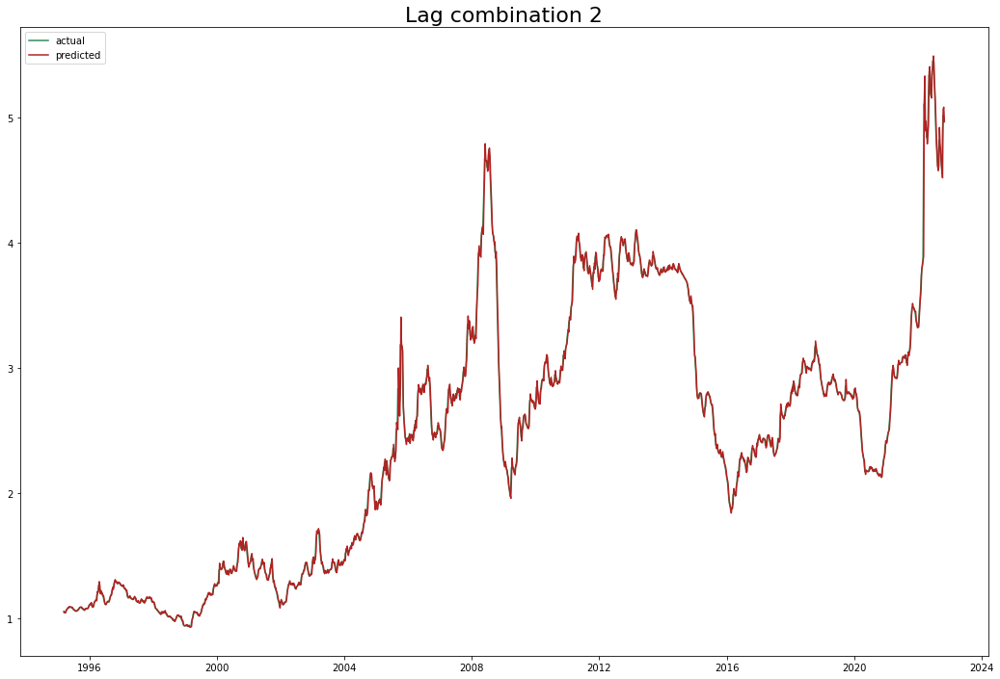

Test data rmse: 0.06914833099713599 Total rmse: 0.045746141786829043
Test data mape: 0.008646462007420095 Total mape: 0.009706992145302558
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.020) r2: (test=0.987) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.057) r2: (test=0.985) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.057) r2: (test=0.993) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_mean_absolute_percentage_error: (test=-0.007) neg_root_mean_squared_error: (test=-0.026) r2: (test=0.999) total time

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


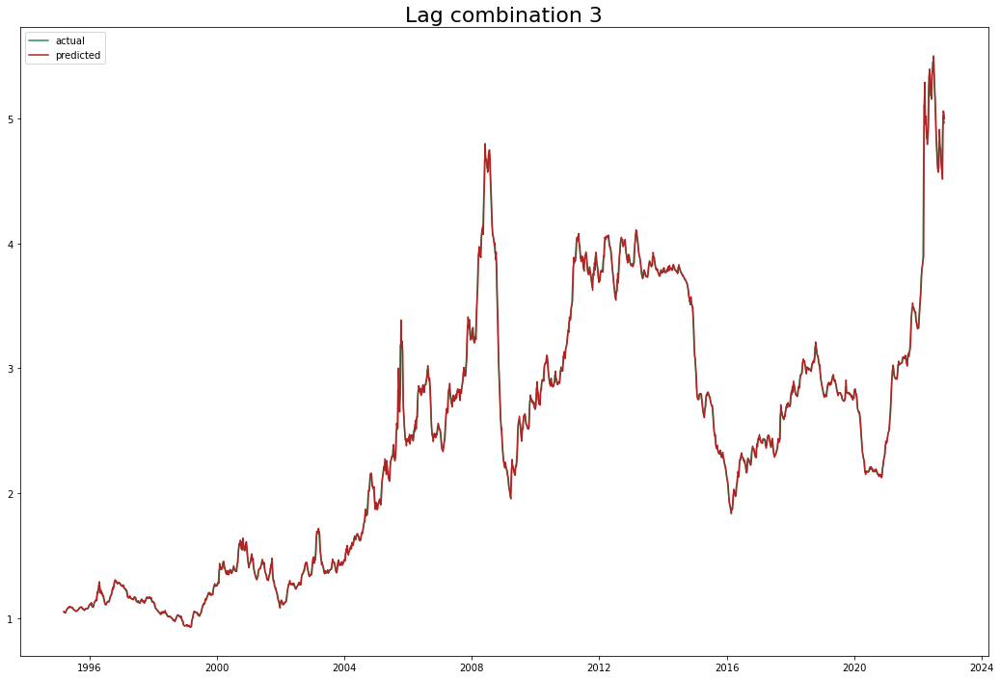

Test data rmse: 0.06864008550312921 Total rmse: 0.045454151961901584
Test data mape: 0.008727658311499744 Total mape: 0.009737222492521068
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.020) r2: (test=0.987) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.057) r2: (test=0.985) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.057) r2: (test=0.993) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_mean_absolute_percentage_error: (test=-0.007) neg_root_mean_squared_error: (test=-0.026) r2: (test=0.999) 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


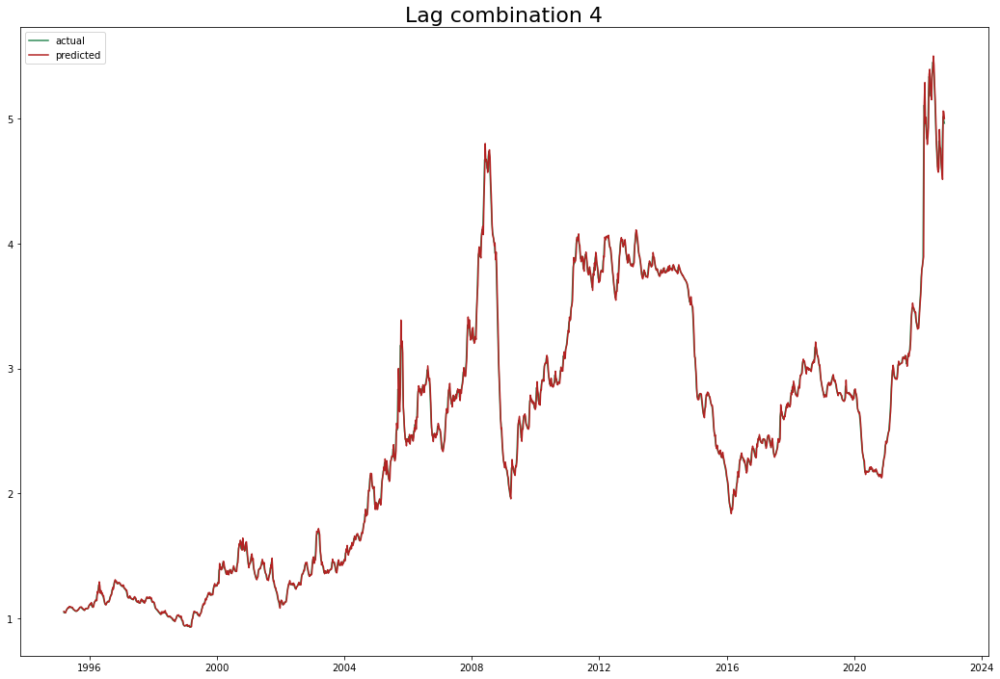

Test data rmse: 0.06866027763771528 Total rmse: 0.04545770852386983
Test data mape: 0.00871983964500974 Total mape: 0.009731347103487662
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.020) r2: (test=0.987) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.057) r2: (test=0.985) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.992) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_mean_absolute_percentage_error: (test=-0.007) neg_root_mean_squared_error: (test=-0.026) r2: (test

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


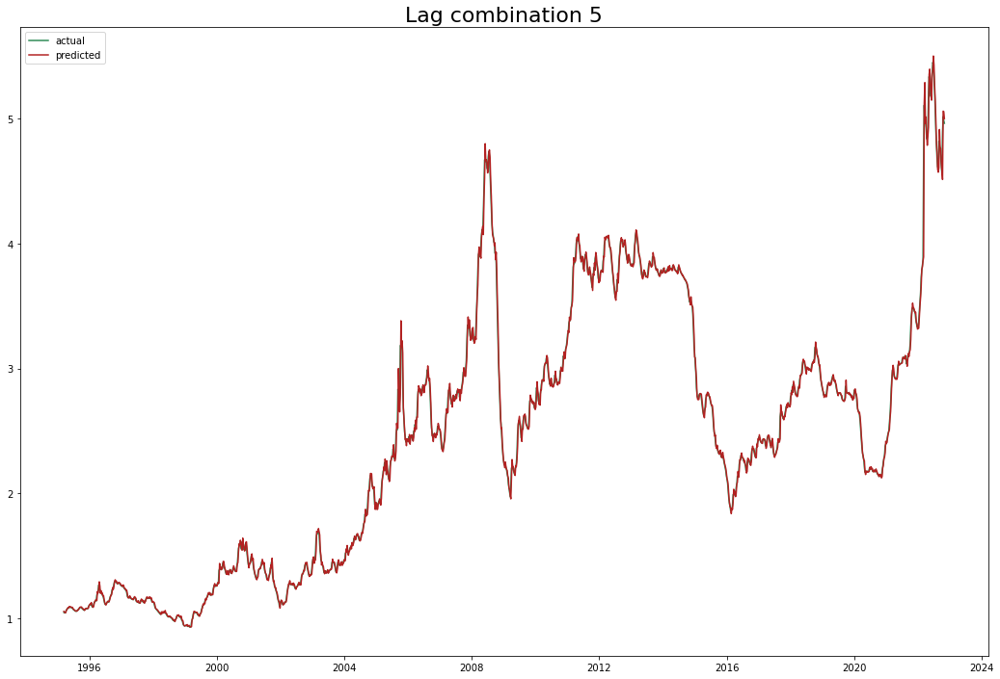

Test data rmse: 0.06872015786001637 Total rmse: 0.04547357330933978
Test data mape: 0.008720395257882407 Total mape: 0.009734391351088808
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.020) r2: (test=0.987) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.985) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.992) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_mean_absolute_percentage_error: (test=-0.007) neg_root_mean_squared_error: (test=-0.026

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


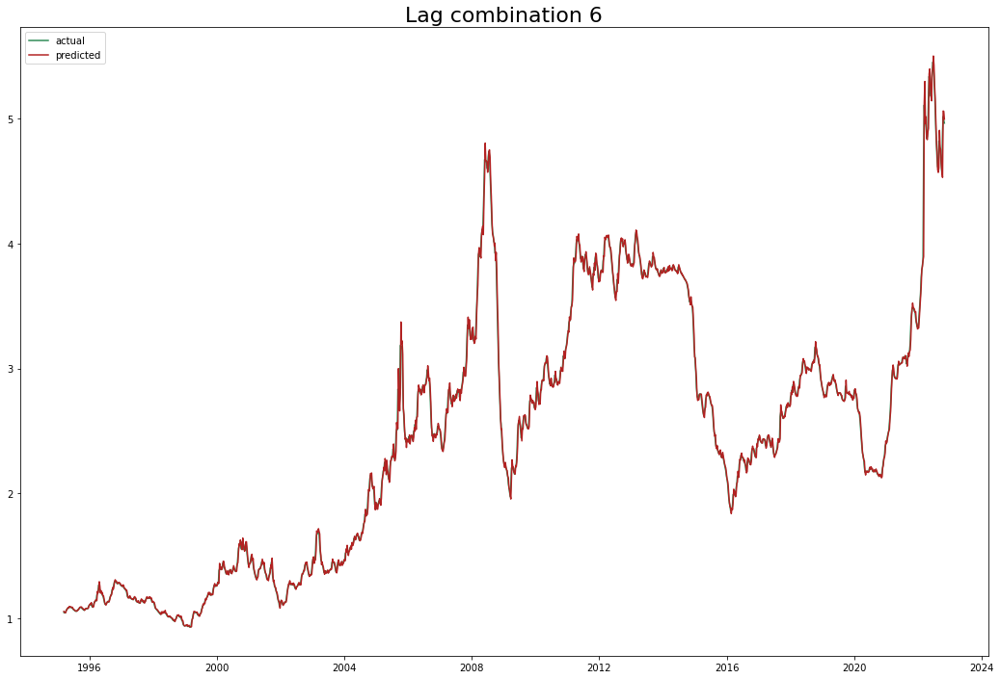

Test data rmse: 0.06839185349210286 Total rmse: 0.04531002395301229
Test data mape: 0.008655965931584004 Total mape: 0.009735792008725513
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.020) r2: (test=0.987) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.992) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_mean_absolute_percentage_error: (test=-0.007) neg_root_mean_squared_error: (t

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


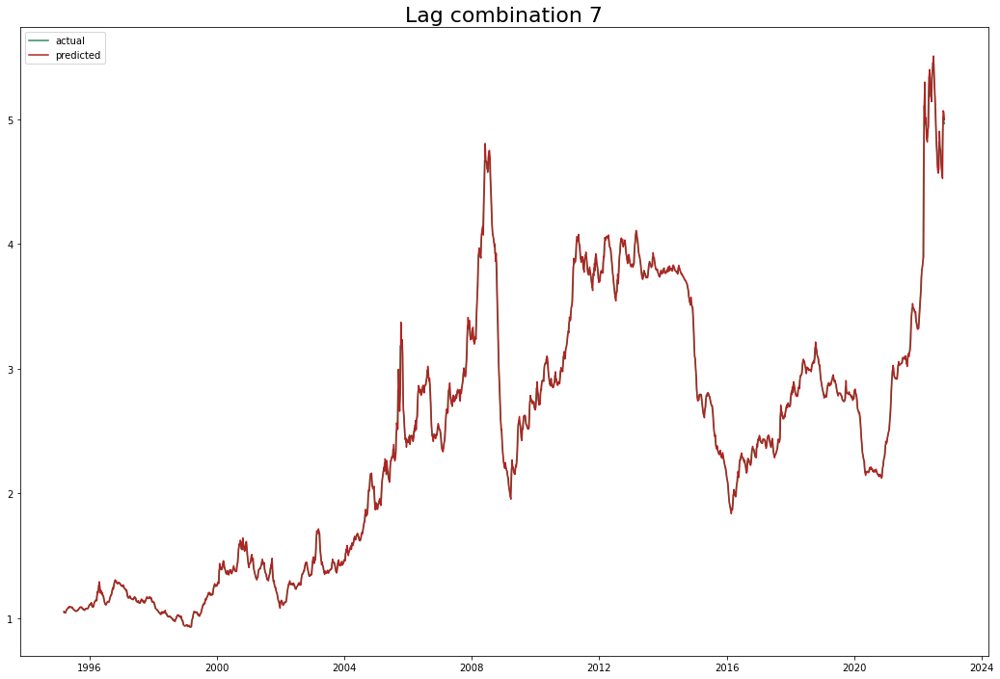

Test data rmse: 0.0681847807238687 Total rmse: 0.045229867680996086
Test data mape: 0.008596101595180669 Total mape: 0.009741020096955667
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.010) neg_root_mean_squared_error: (test=-0.020) r2: (test=0.987) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.992) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_mean_absolute_percentage_error: (test=-0.007) neg_root_mean_squared

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


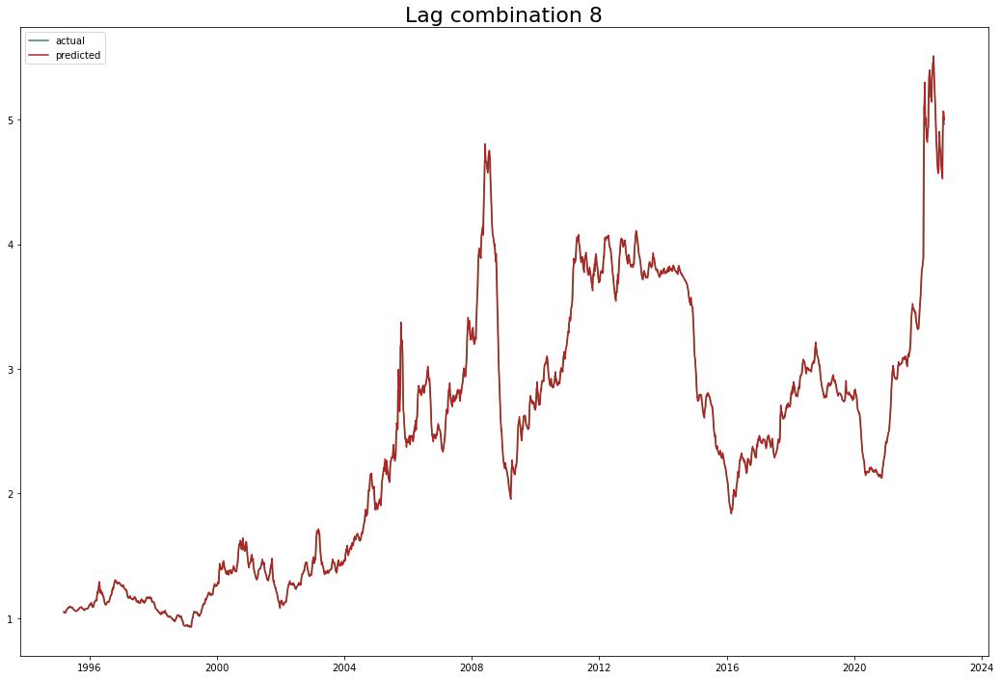

Test data rmse: 0.06812814403783088 Total rmse: 0.045211305429363226
Test data mape: 0.00859885307143396 Total mape: 0.009737339938198525
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.021) r2: (test=0.985) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.014) neg_root_mean_squared_error: (test=-0.060) r2: (test=0.992) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_mean_absolute_percentage_error: (test=-0.007) neg_root_m

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


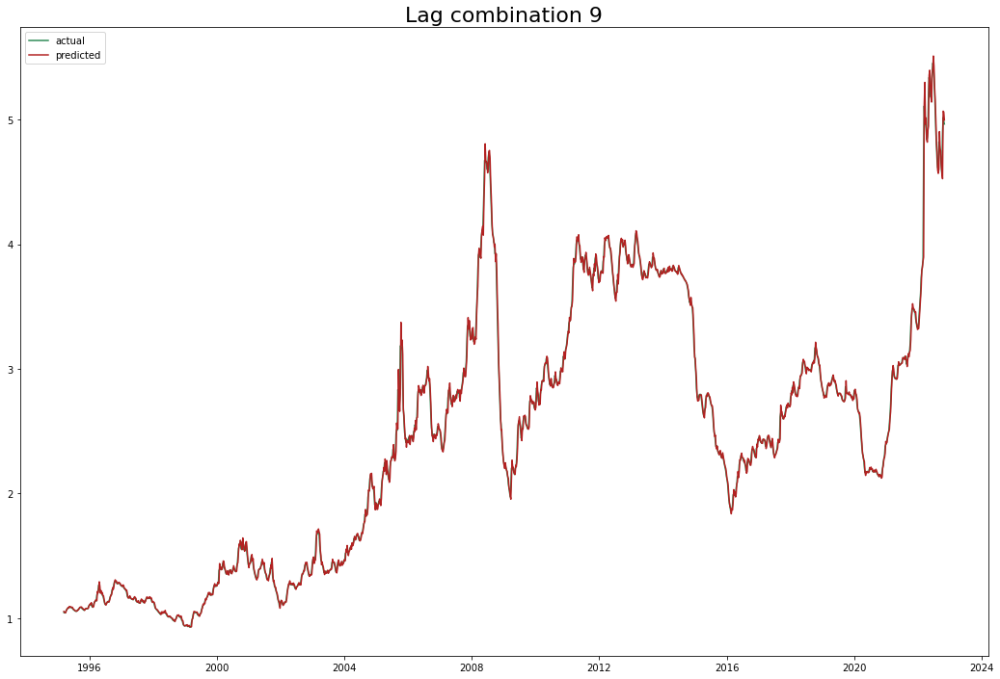

Test data rmse: 0.06810828662713117 Total rmse: 0.04520528950494775
Test data mape: 0.008596779934076879 Total mape: 0.009735616257032492
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.021) r2: (test=0.985) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.992) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_mean_absolute_percentage_error: (test=-0.007)

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


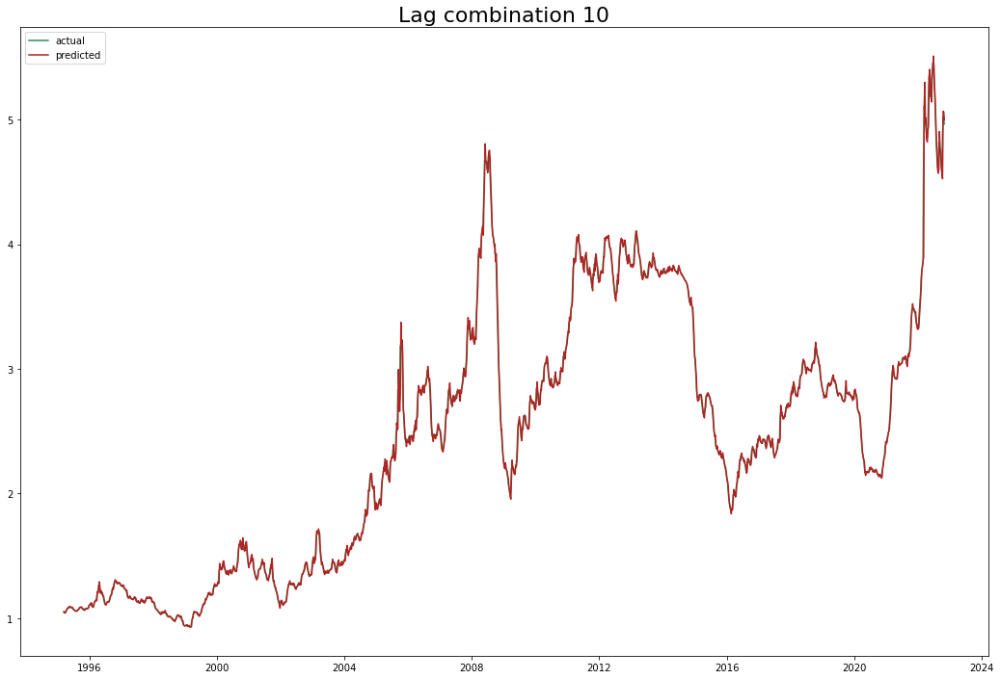

Test data rmse: 0.06815774926271564 Total rmse: 0.045218593191691074
Test data mape: 0.008605153969519032 Total mape: 0.00973755849898703
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.011) neg_root_mean_squared_error: (test=-0.022) r2: (test=0.985) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.991) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_mean_absolute_percentage_error: (t

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


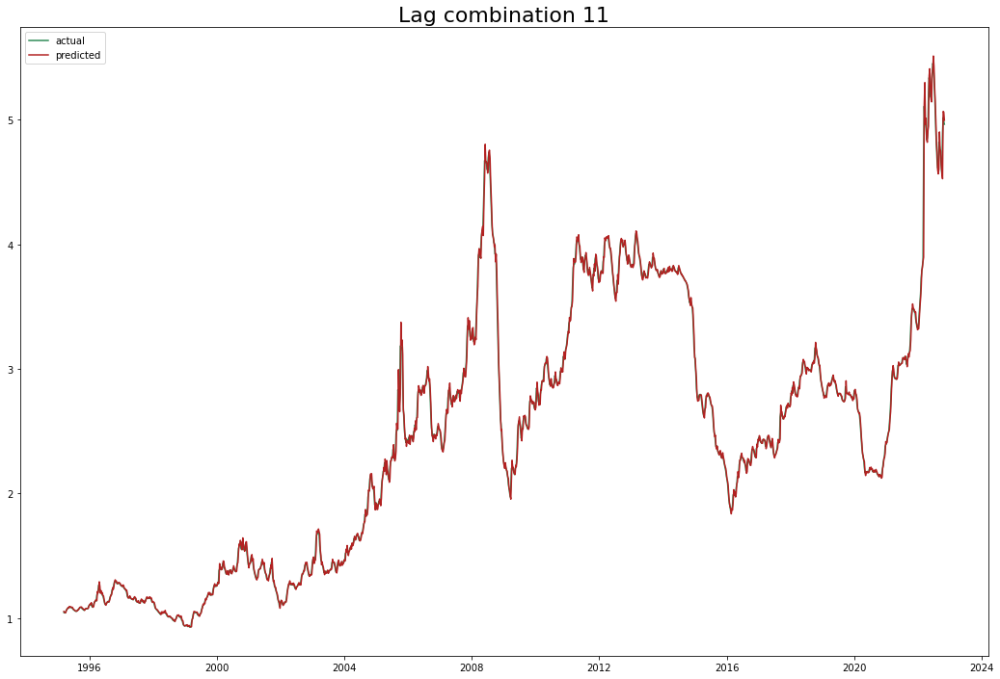

Test data rmse: 0.0680699618127574 Total rmse: 0.045187703600508035
Test data mape: 0.008602148992363277 Total mape: 0.009733330117576737
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.022) r2: (test=0.984) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.991) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_mean_absolute_percentag

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


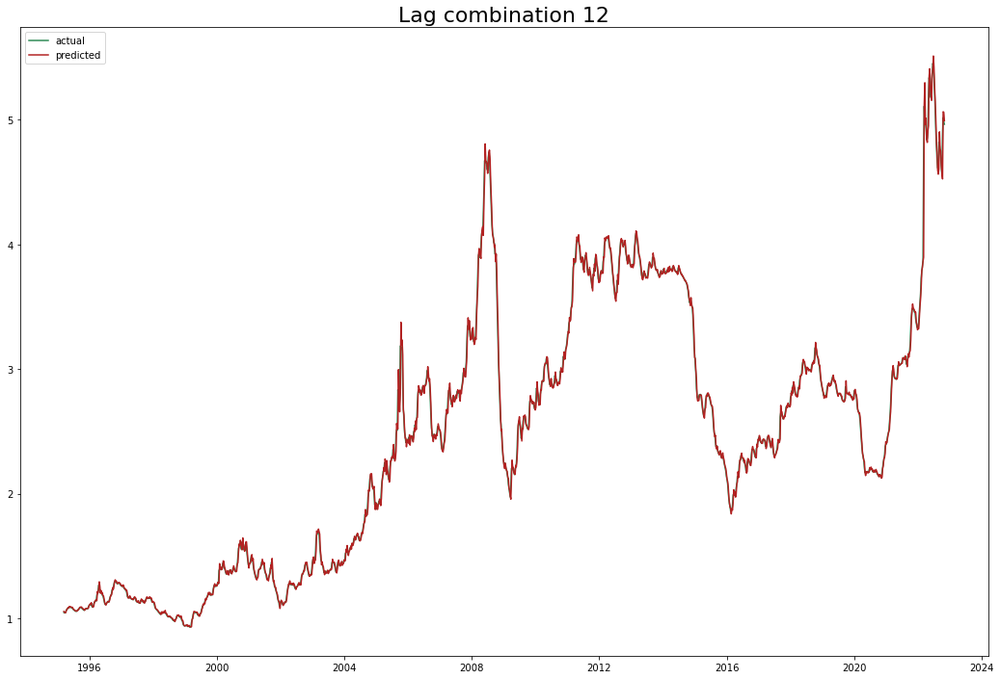

Test data rmse: 0.06788775033810102 Total rmse: 0.04512467855886088
Test data mape: 0.008568033768631253 Total mape: 0.009736958670642512
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.022) r2: (test=0.984) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.991) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_mean_absolut

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


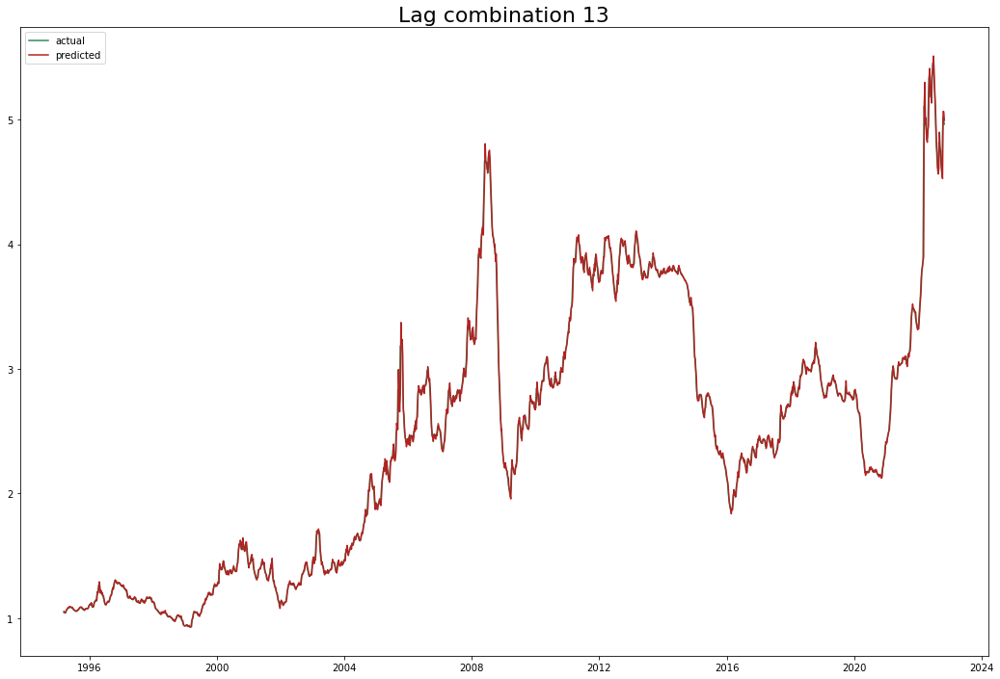

Test data rmse: 0.06799974919034052 Total rmse: 0.045141403304720495
Test data mape: 0.008607542398572303 Total mape: 0.009755846460170754
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.022) r2: (test=0.984) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.058) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.991) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] END  neg_

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


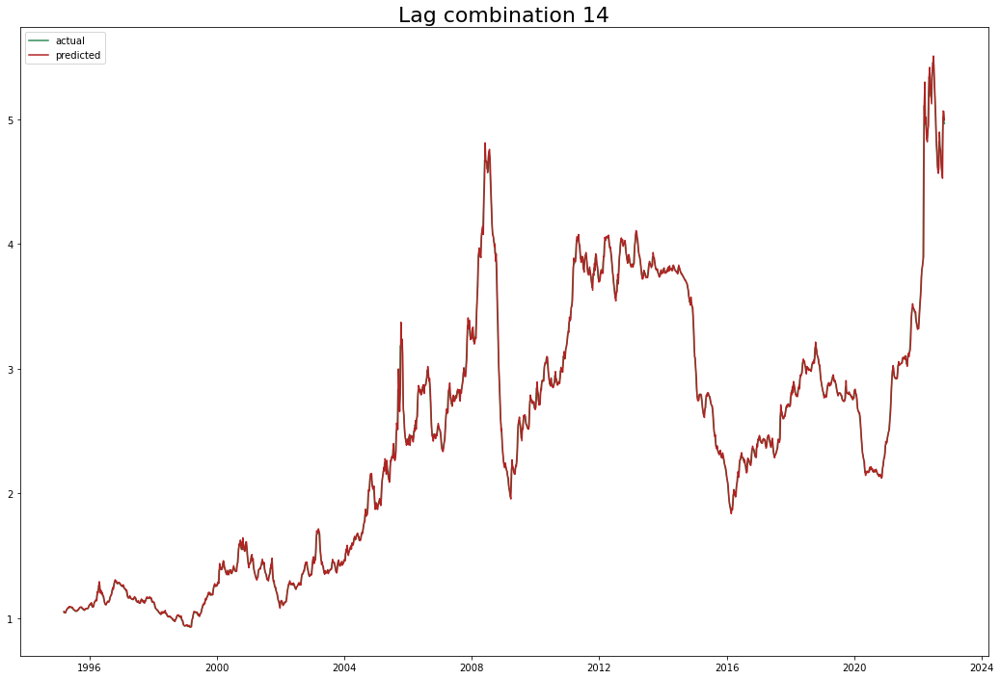

Test data rmse: 0.06804683517175791 Total rmse: 0.0451430766053642
Test data mape: 0.008597203638000227 Total mape: 0.009745225938873356
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.022) r2: (test=0.983) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.064) r2: (test=0.991) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0s
[CV 5/5] 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


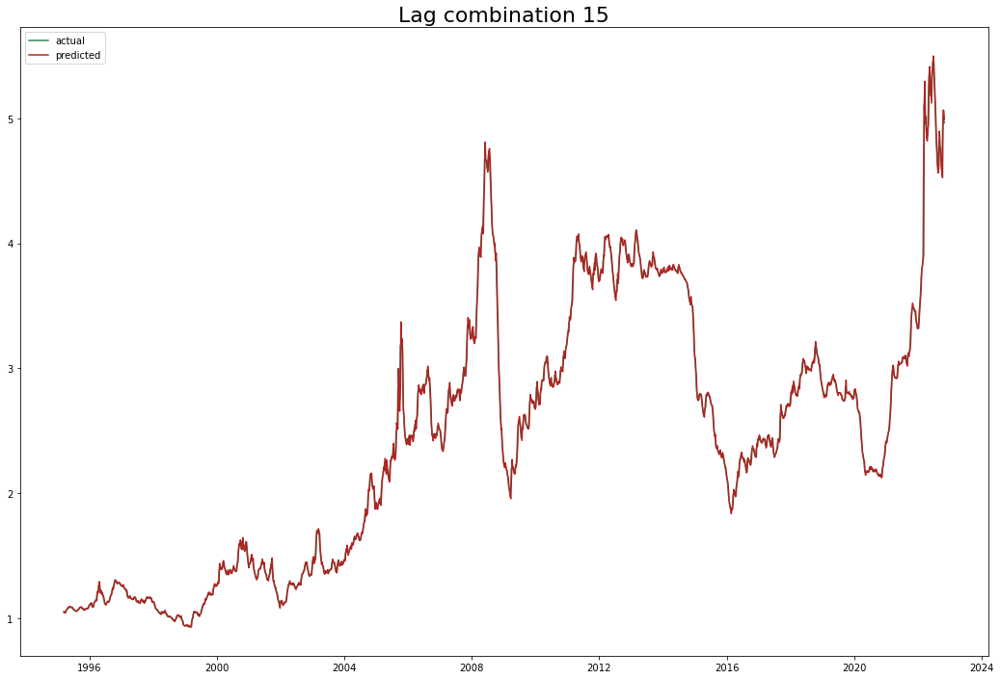

Test data rmse: 0.0680901133916224 Total rmse: 0.045153283139203367
Test data mape: 0.008617062335682935 Total mape: 0.00975131579158324
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.983) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.991) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total time=   0.0

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


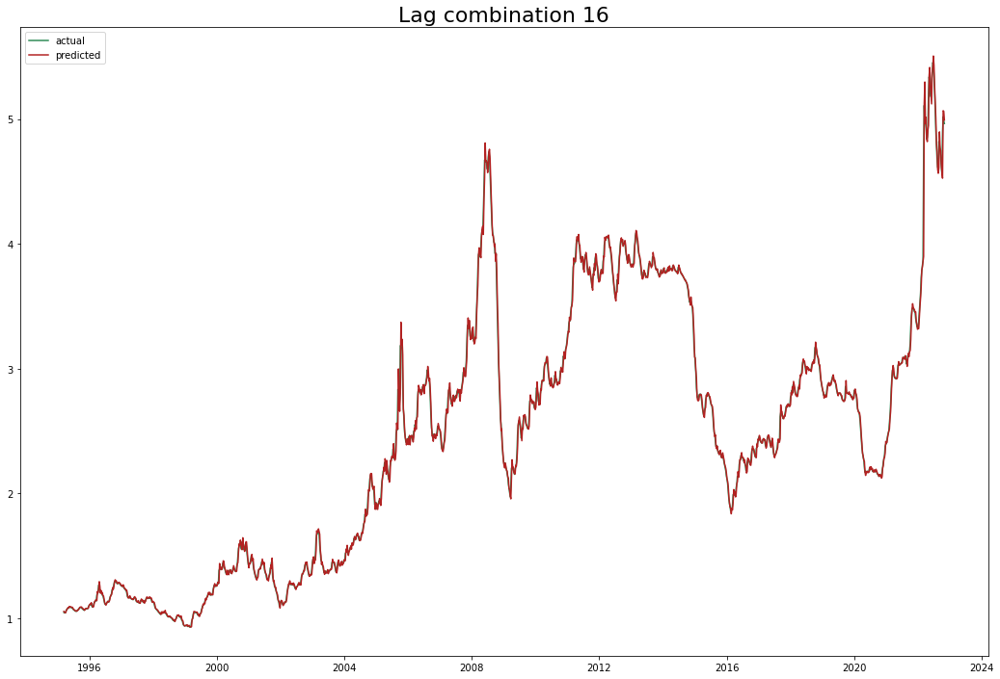

Test data rmse: 0.06809434548407461 Total rmse: 0.04515312158189529
Test data mape: 0.008616622641447304 Total mape: 0.009756280668867353
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.983) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.990) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=0.993) total

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


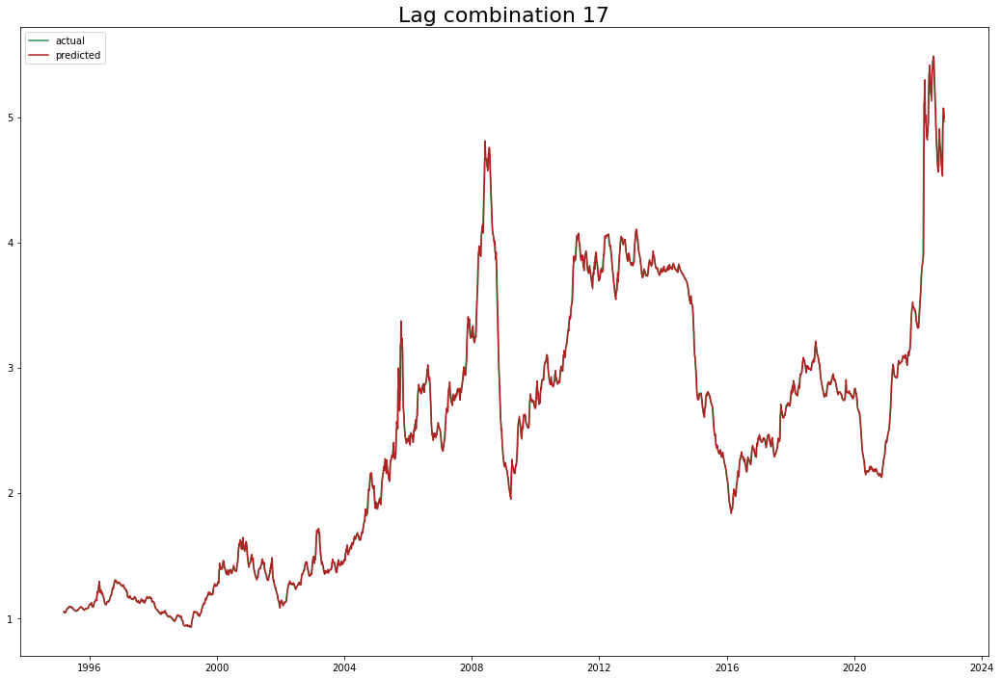

Test data rmse: 0.06812506932258379 Total rmse: 0.045129774966920035
Test data mape: 0.008670580157492926 Total mape: 0.009750131330613358
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.983) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.065) r2: (test=0.990) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037) r2: (test=

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


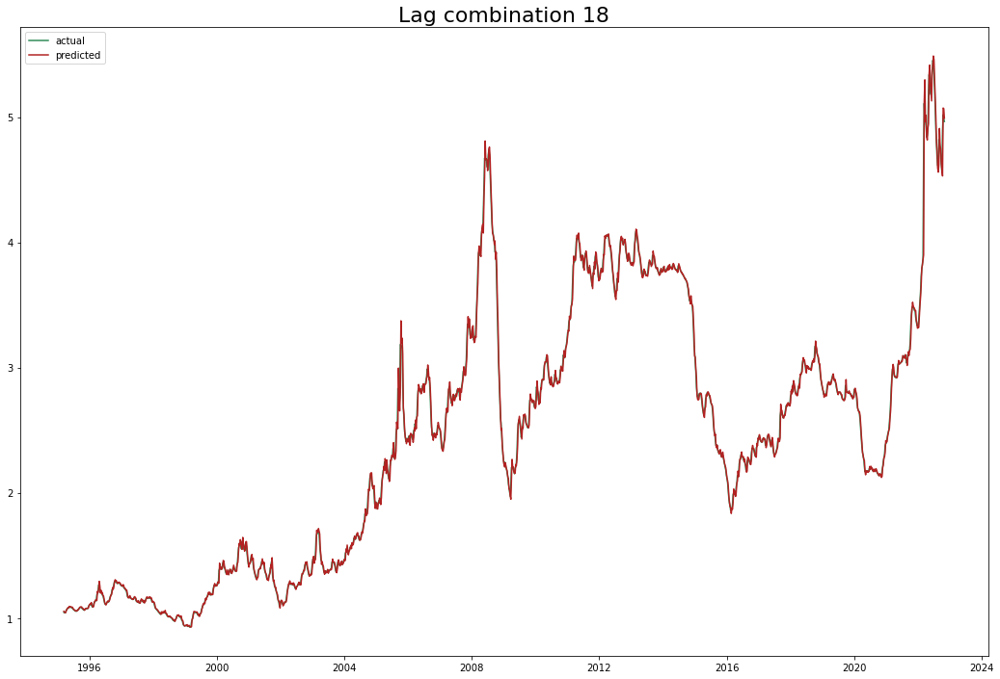

Test data rmse: 0.06816772860355261 Total rmse: 0.045138845760630555
Test data mape: 0.008697247382139665 Total mape: 0.009747770238770832
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.983) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.066) r2: (test=0.990) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (test=-0.037)

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


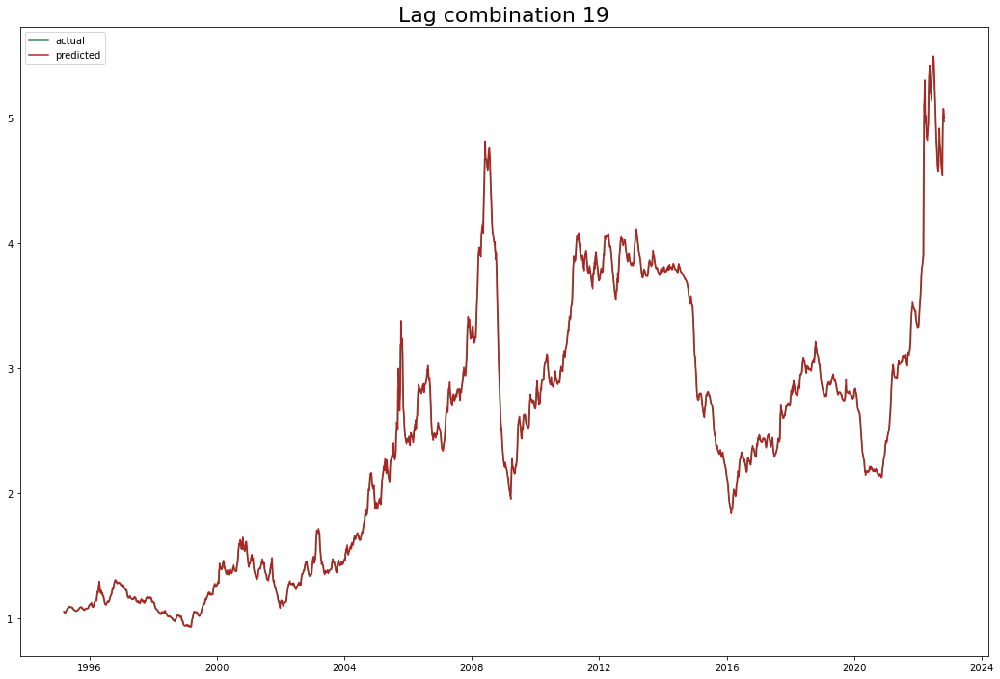

Test data rmse: 0.06812468375420533 Total rmse: 0.045110020159019416
Test data mape: 0.008677737440800354 Total mape: 0.009744775947915302
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.990) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared_error: (t

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


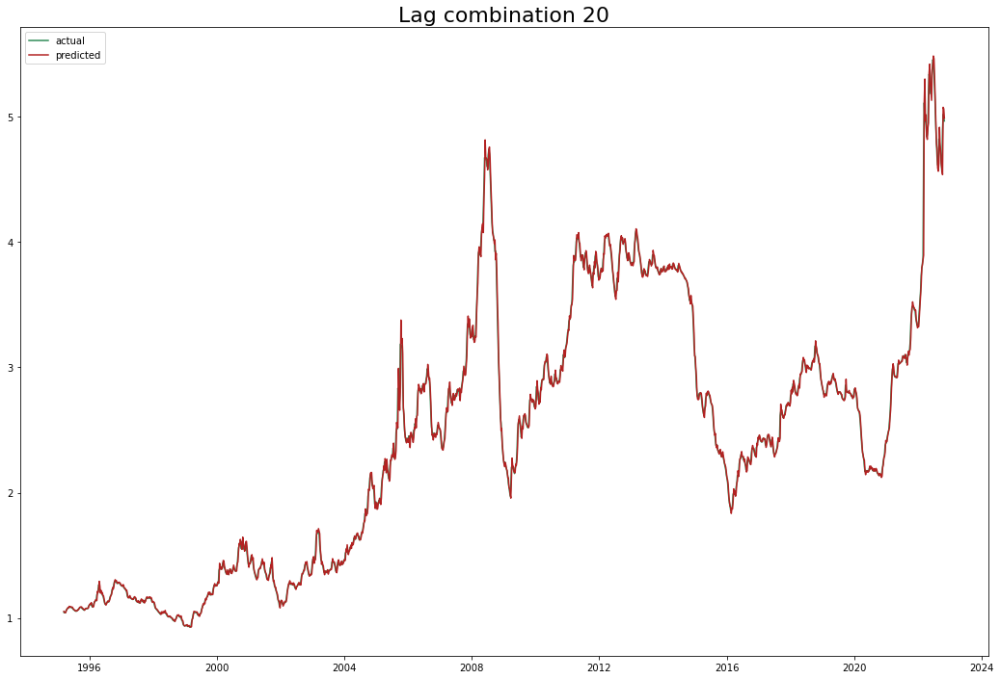

Test data rmse: 0.06814222394307727 Total rmse: 0.04507121067624067
Test data mape: 0.008702943649081977 Total mape: 0.009783378890186148
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.015) neg_root_mean_squared_error: (test=-0.059) r2: (test=0.984) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.990) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squared

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


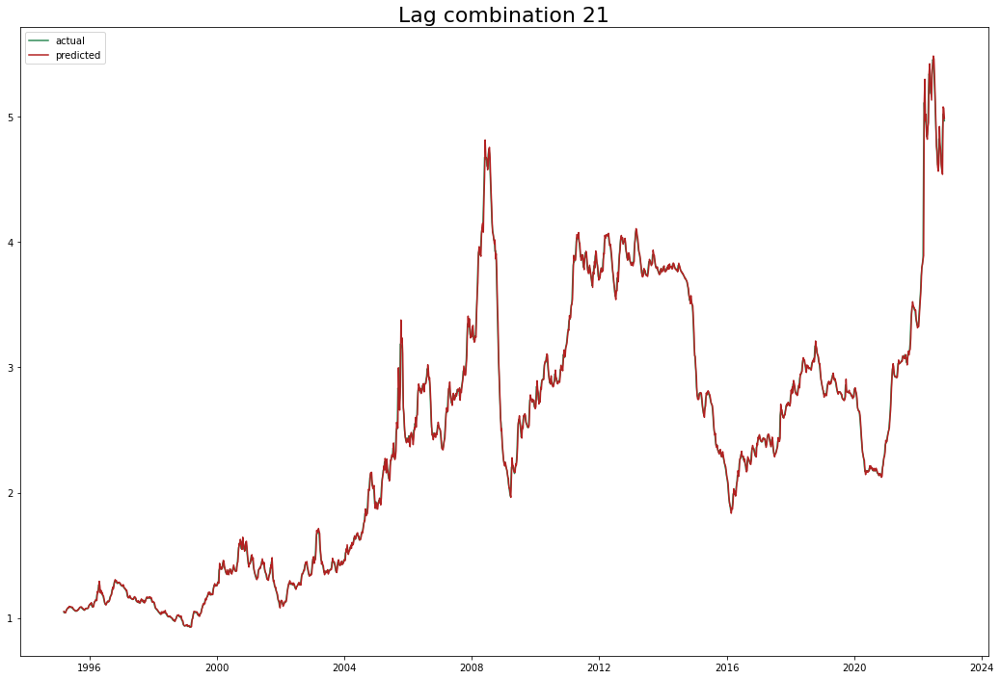

Test data rmse: 0.06835773226359575 Total rmse: 0.045113922966278135
Test data mape: 0.008759378166847208 Total mape: 0.00981066542390655
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.024) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.060) r2: (test=0.983) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.990) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008) neg_root_m

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


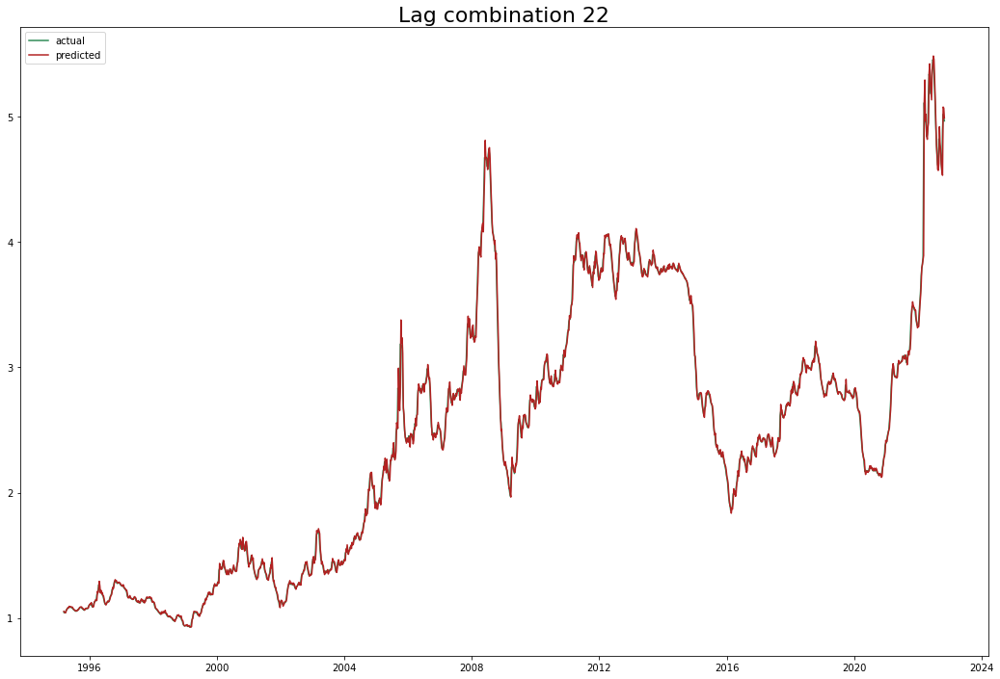

Test data rmse: 0.06828479313685454 Total rmse: 0.045066785611409324
Test data mape: 0.00872958224974485 Total mape: 0.009816472010605272
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.983) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.990) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (test=-0.008)

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


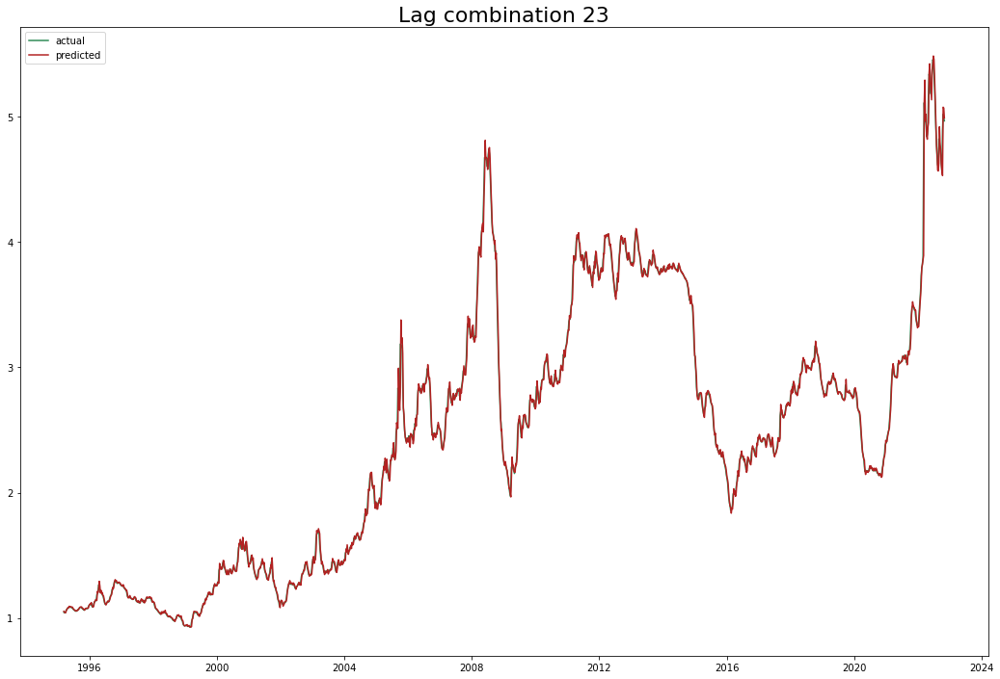

Test data rmse: 0.06829572958404093 Total rmse: 0.04506898093000708
Test data mape: 0.008733829111280178 Total mape: 0.009813163612658682
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.024) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.983) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.990) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage_error: (t

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


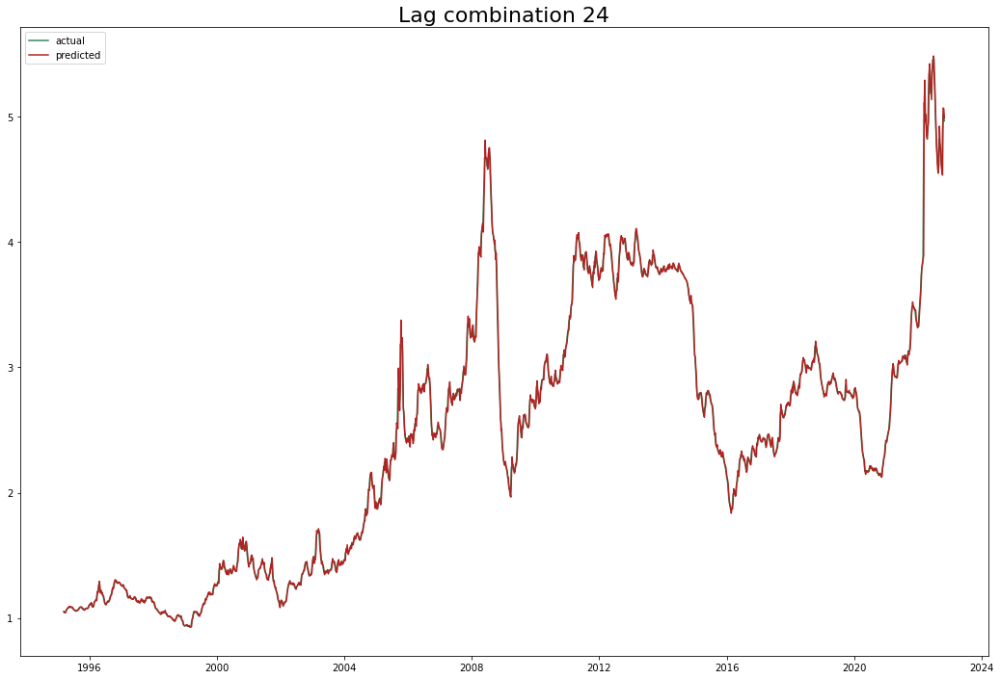

Test data rmse: 0.0683336107852054 Total rmse: 0.04506986120729526
Test data mape: 0.008746611510020576 Total mape: 0.009822441258698487
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.983) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.990) total time=   0.0s
[CV 4/5] END  neg_mean_absolute_percentage

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


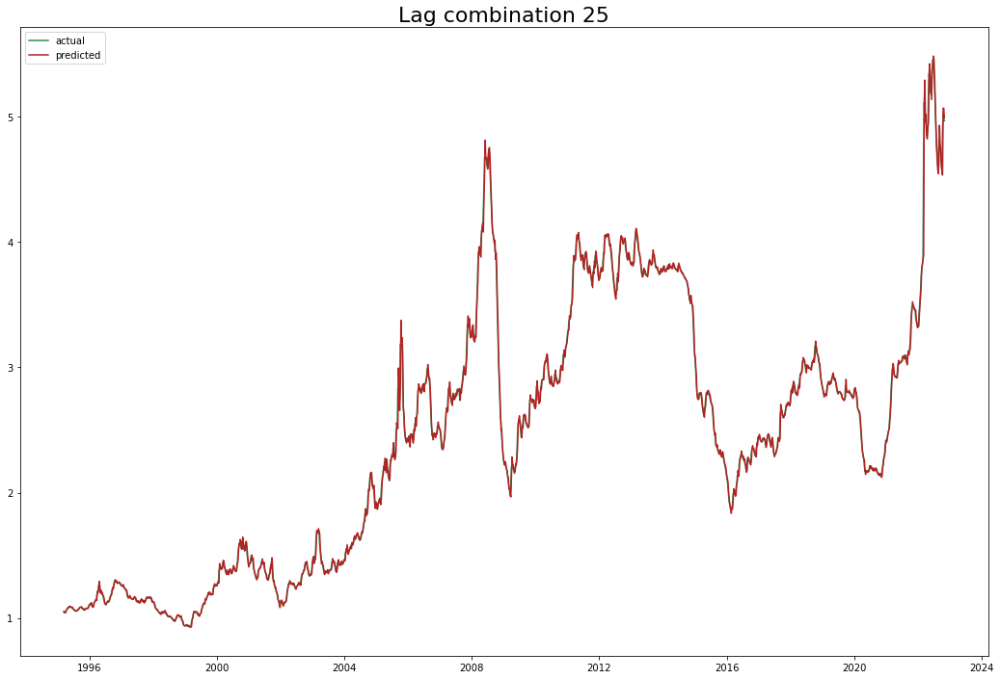

Test data rmse: 0.0683440002743602 Total rmse: 0.045071202632679816
Test data mape: 0.008744798000106165 Total mape: 0.00982072105326865
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.983) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.990) total time=   0.0s
[CV 4/5] END  neg_mean_absolute

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


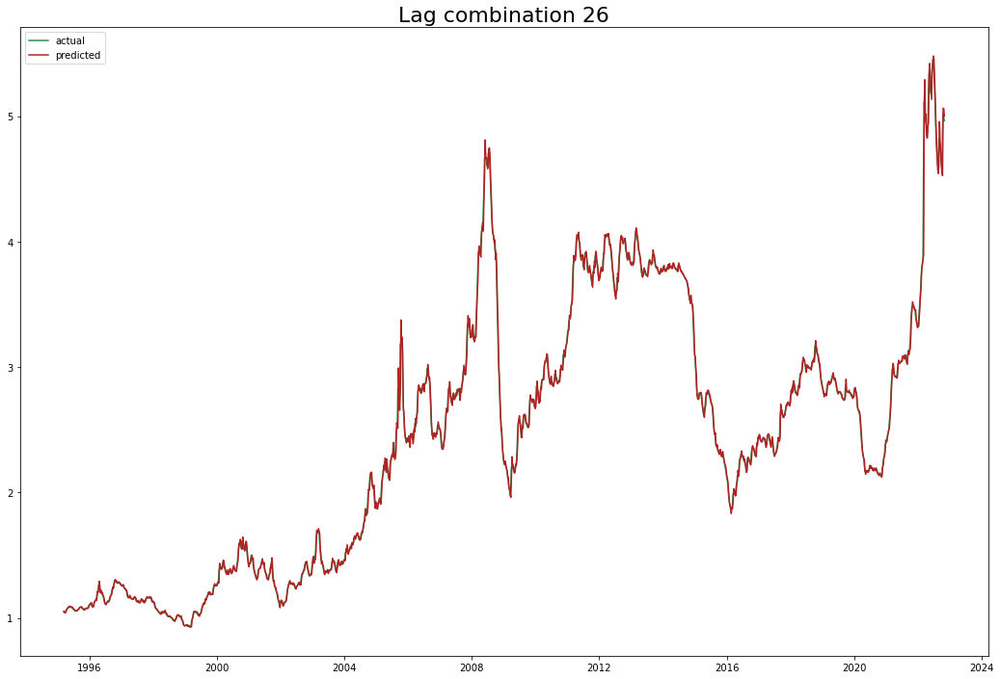

Test data rmse: 0.0688016092280278 Total rmse: 0.04518299137548545
Test data mape: 0.008809245462490041 Total mape: 0.00981304739798675
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.983) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.990) total time=   0.0s
[CV 4/5] END  neg_mea

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


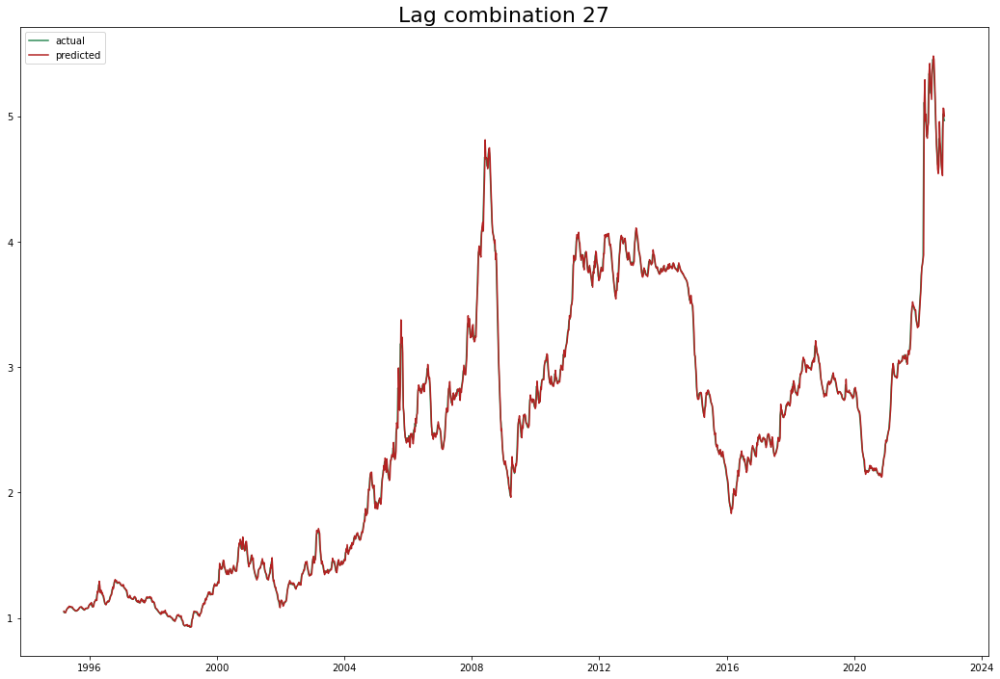

Test data rmse: 0.06879648193595811 Total rmse: 0.045181402524941496
Test data mape: 0.008809723744872334 Total mape: 0.009814098120597121
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.983) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.990) total time=   0.0s
[CV 4/5

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


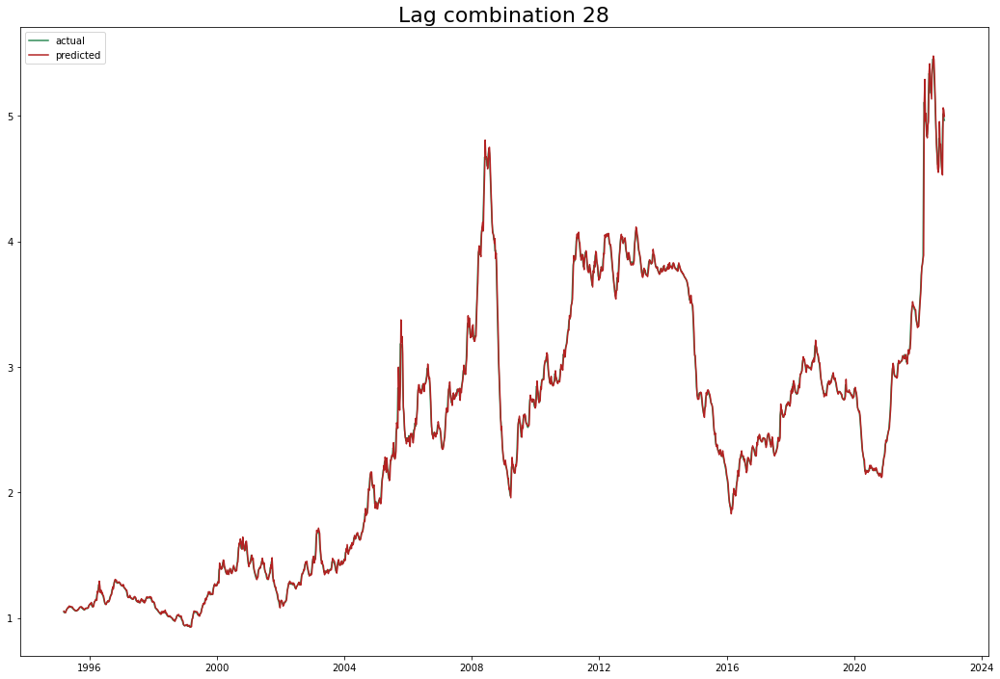

Test data rmse: 0.0689112114490559 Total rmse: 0.04513718533894002
Test data mape: 0.008819067445364223 Total mape: 0.009849767429393754
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.982) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.067) r2: (test=0.990) total time=   0.0

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


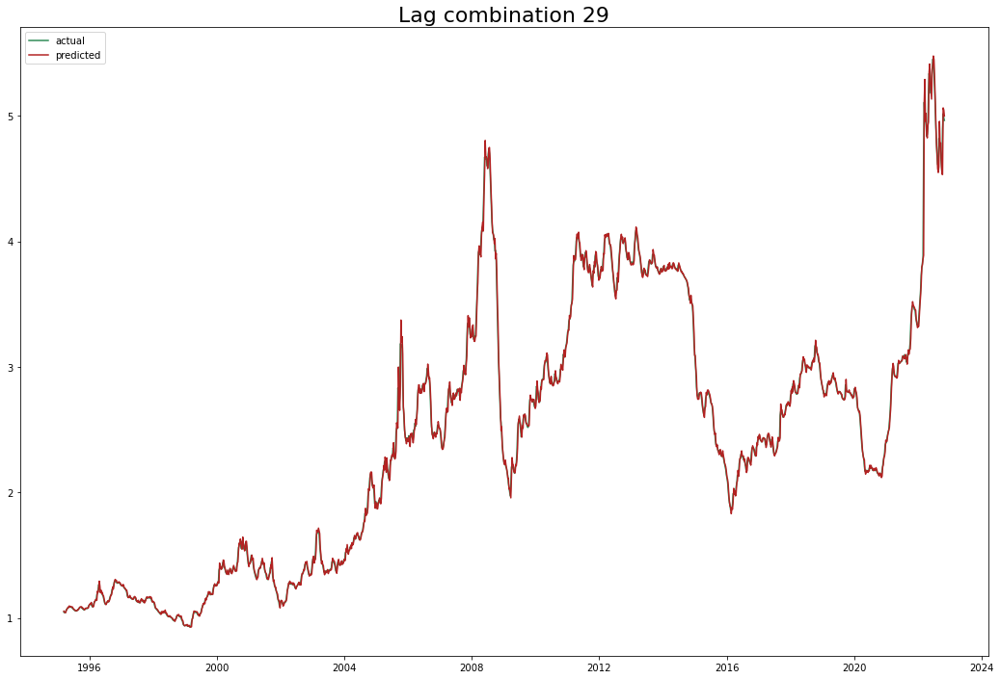

Test data rmse: 0.06898148045286778 Total rmse: 0.0451505297475586
Test data mape: 0.008840300240425432 Total mape: 0.009858298343376483
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.982) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.068) r2: (test=0.990) total 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


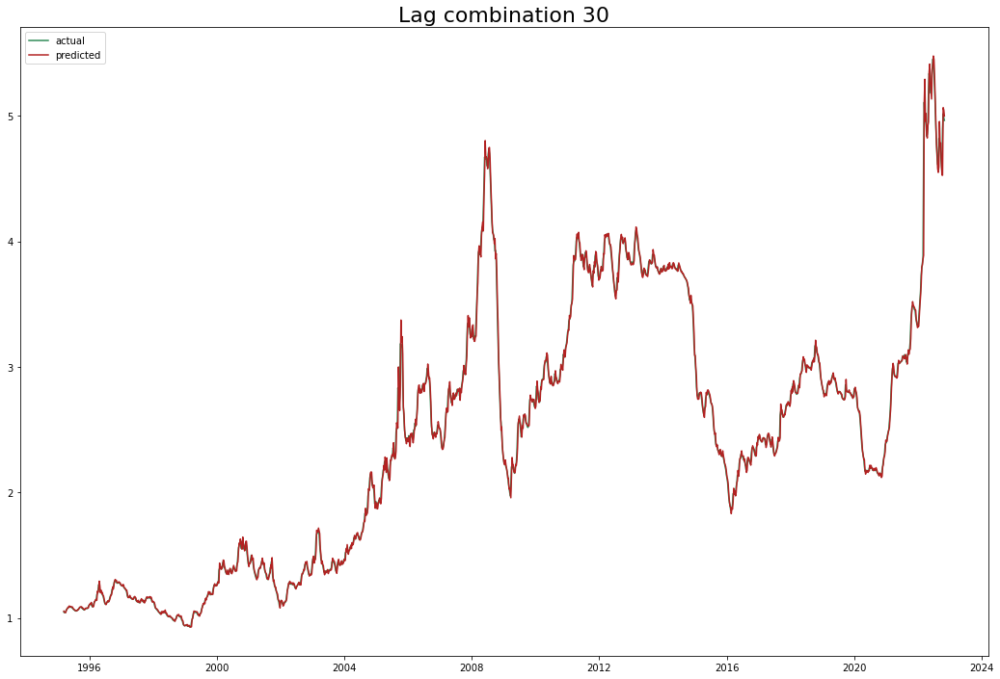

Test data rmse: 0.06912261681550368 Total rmse: 0.045191491353148504
Test data mape: 0.008856731575014858 Total mape: 0.009855625869478118
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.024) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.982) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.069) r2: (test=

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


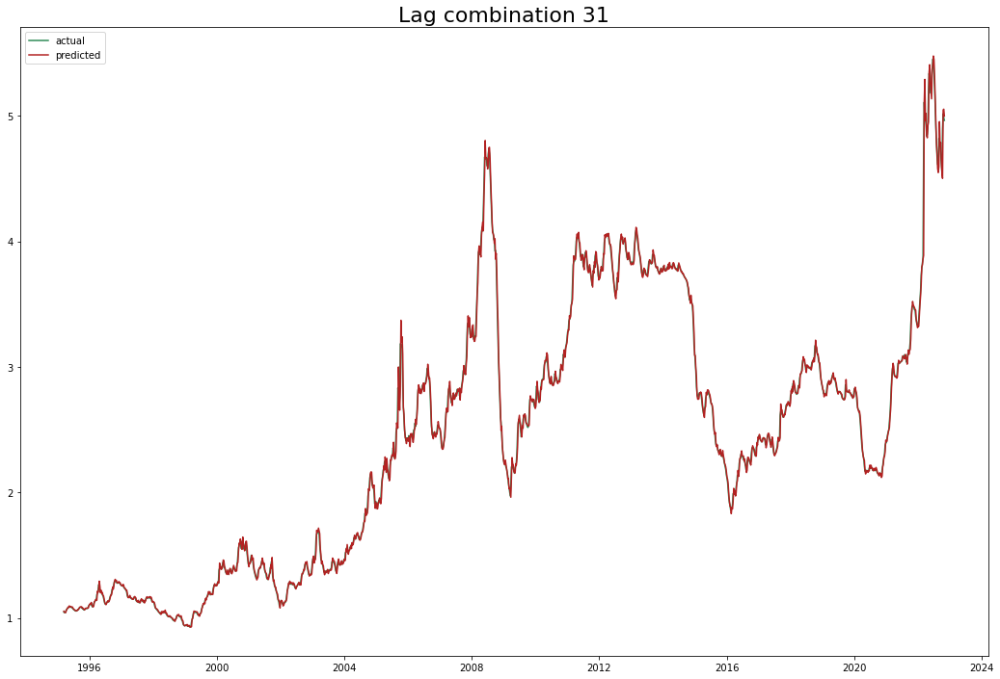

Test data rmse: 0.06955919654483768 Total rmse: 0.045306691727617705
Test data mape: 0.008852401866190933 Total mape: 0.009839411960326162
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.982) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.069)

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


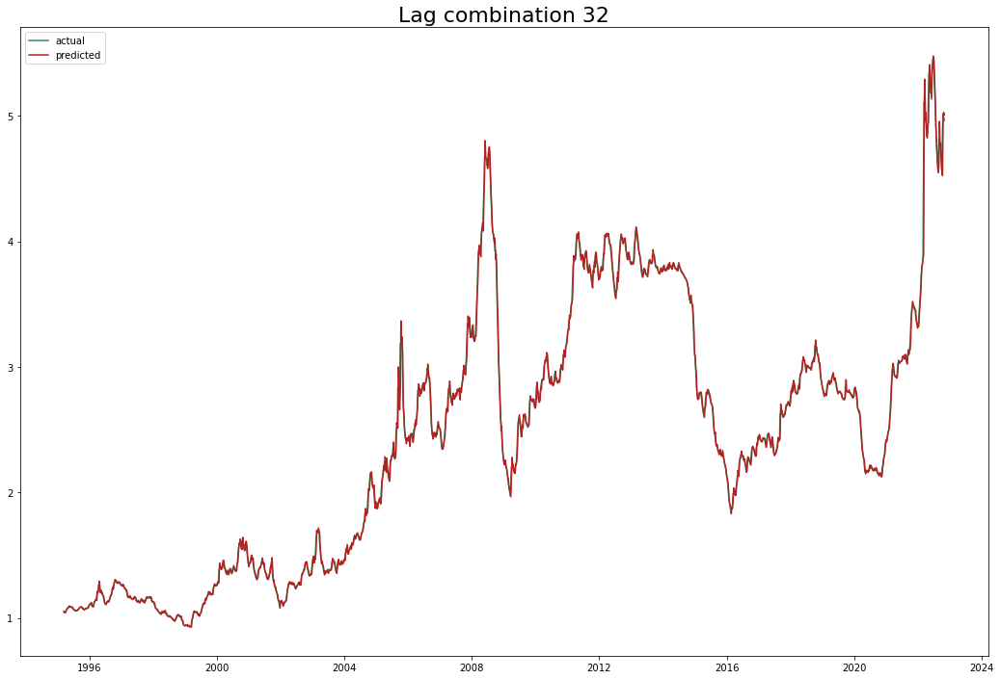

Test data rmse: 0.0691818196755617 Total rmse: 0.04515243043696909
Test data mape: 0.008842591326474972 Total mape: 0.009859664822391095
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.982) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (tes

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


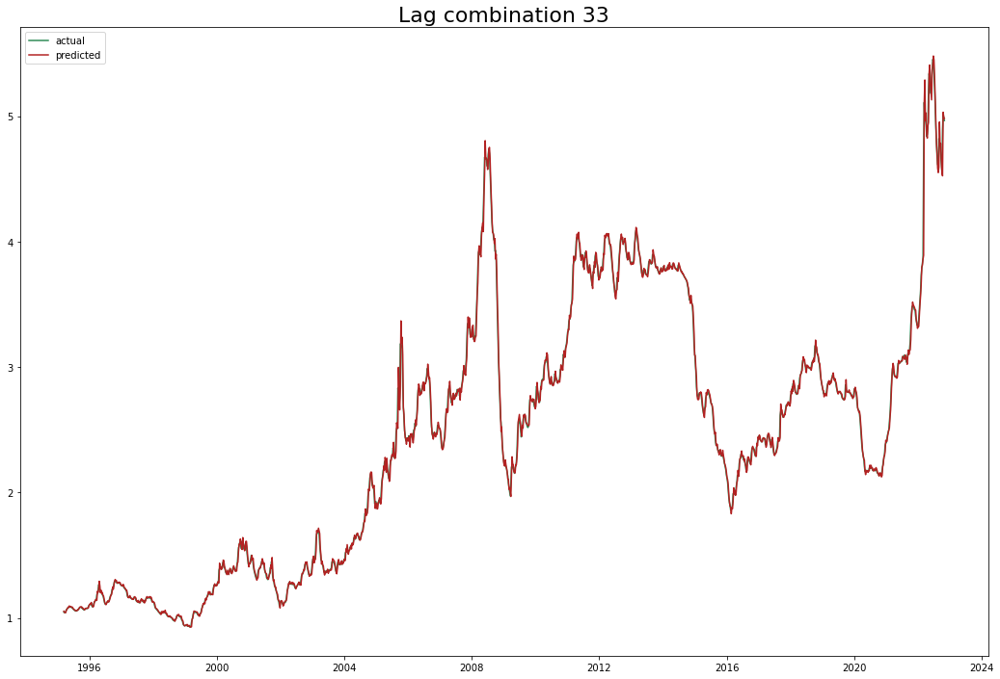

Test data rmse: 0.06900906739678571 Total rmse: 0.045063940516621846
Test data mape: 0.008799222665483023 Total mape: 0.009828886456886635
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.982) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_square

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


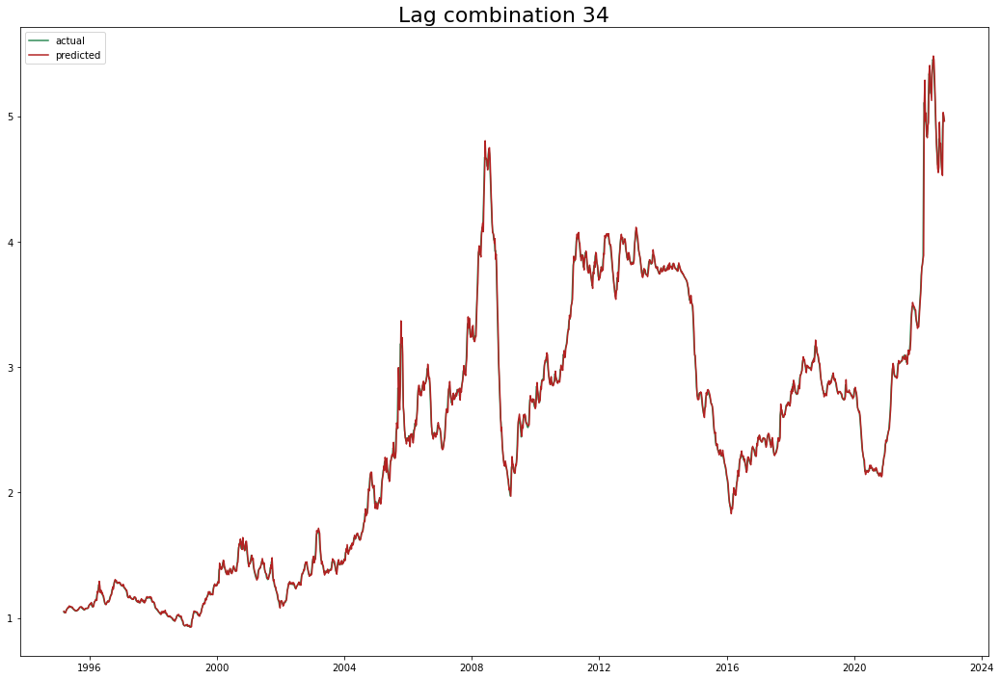

Test data rmse: 0.06897843547445386 Total rmse: 0.04504088815965429
Test data mape: 0.008809745021216623 Total mape: 0.009824450323945239
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.024) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.982) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_m

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


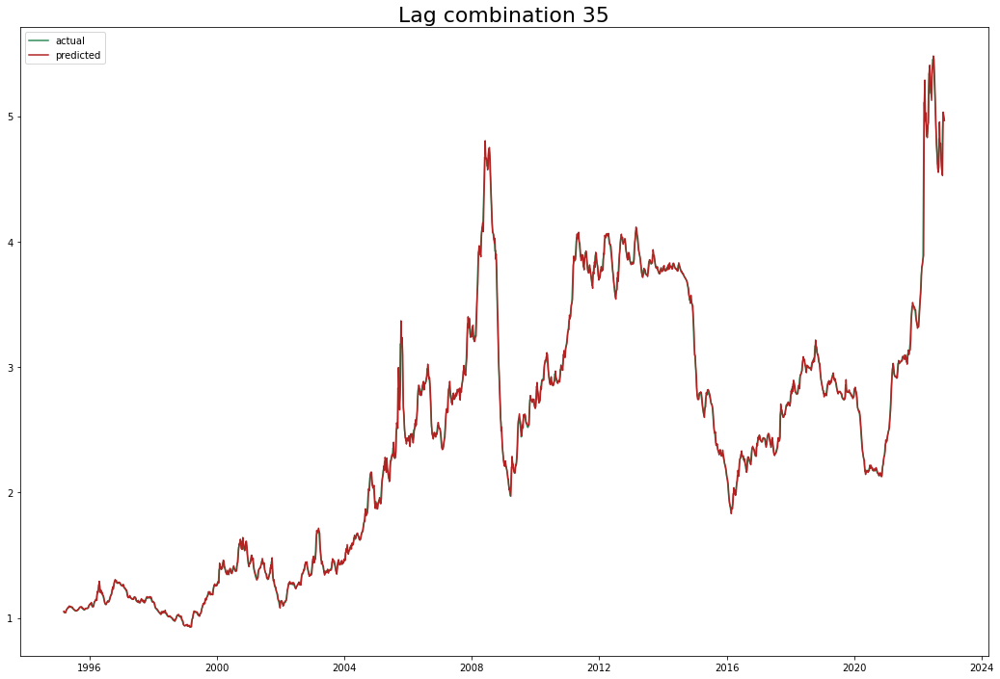

Test data rmse: 0.06902088389468679 Total rmse: 0.04505149314216941
Test data mape: 0.008813001737574785 Total mape: 0.009823601154078066
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.024) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.982) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (test=-0.017)

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


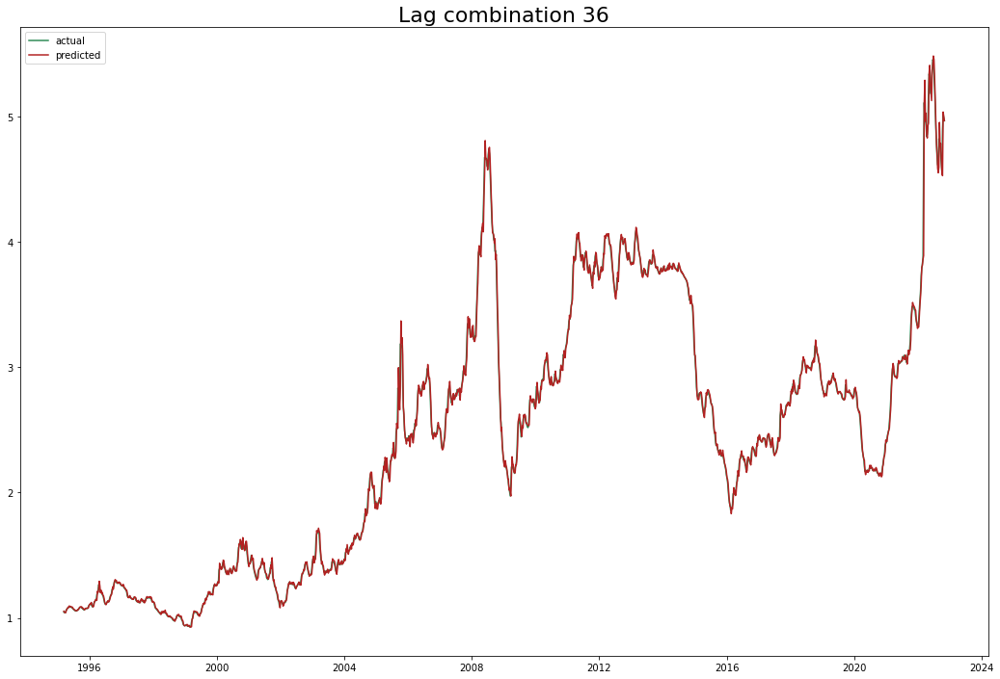

Test data rmse: 0.0691333027603142 Total rmse: 0.04507250046832122
Test data mape: 0.008850498422061417 Total mape: 0.009838576762061613
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.982) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage_error: (te

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


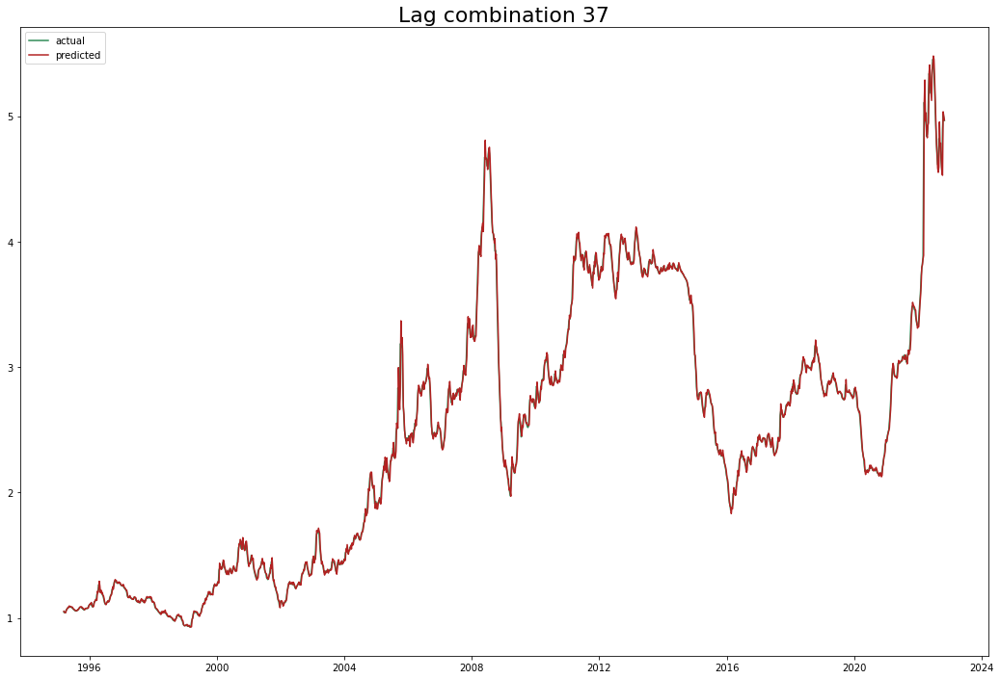

Test data rmse: 0.06911136203872928 Total rmse: 0.04505976302432414
Test data mape: 0.00884249831280249 Total mape: 0.009827859578010856
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.982) total time=   0.0s
[CV 3/5] END  neg_mean_absolute_percentage

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


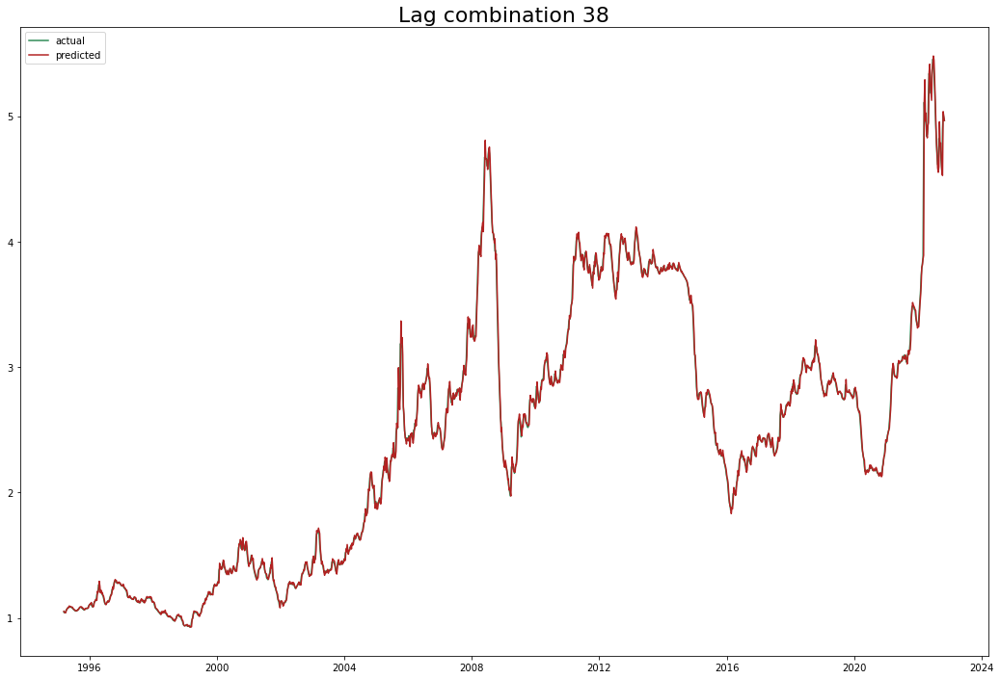

Test data rmse: 0.06909664757988614 Total rmse: 0.04503212343774527
Test data mape: 0.008840057039686652 Total mape: 0.009826384845565448
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.982) total time=   0.0s
[CV 3/5] END  neg_mean_absolut

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


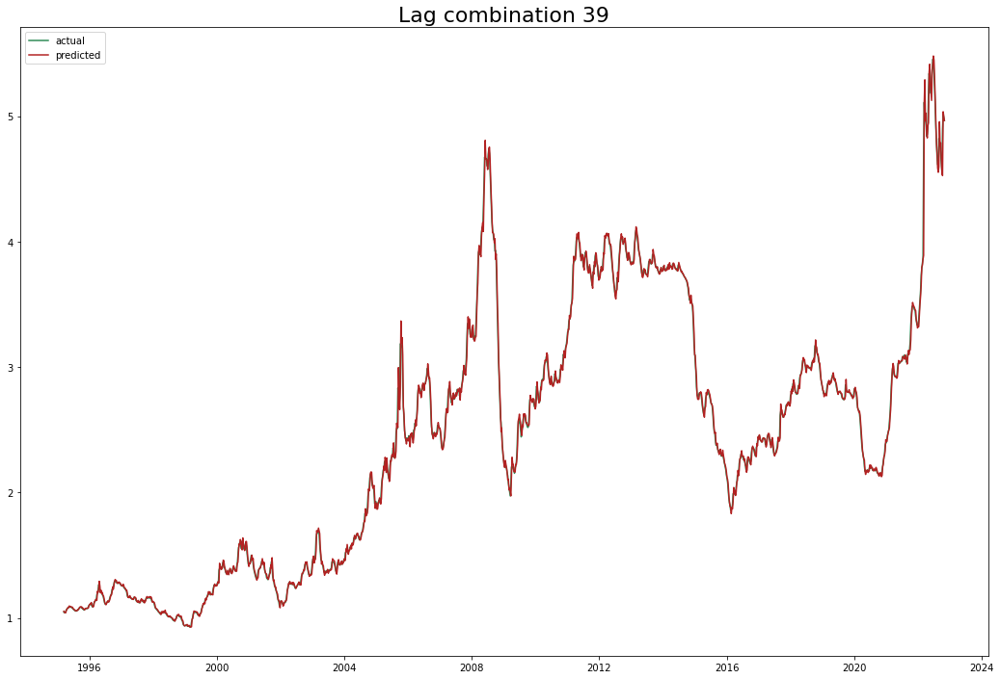

Test data rmse: 0.0691291931412309 Total rmse: 0.045038705714953456
Test data mape: 0.008845537838588194 Total mape: 0.009827048438441453
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.982) total time=   0.0s
[CV 3/5] END  neg_m

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


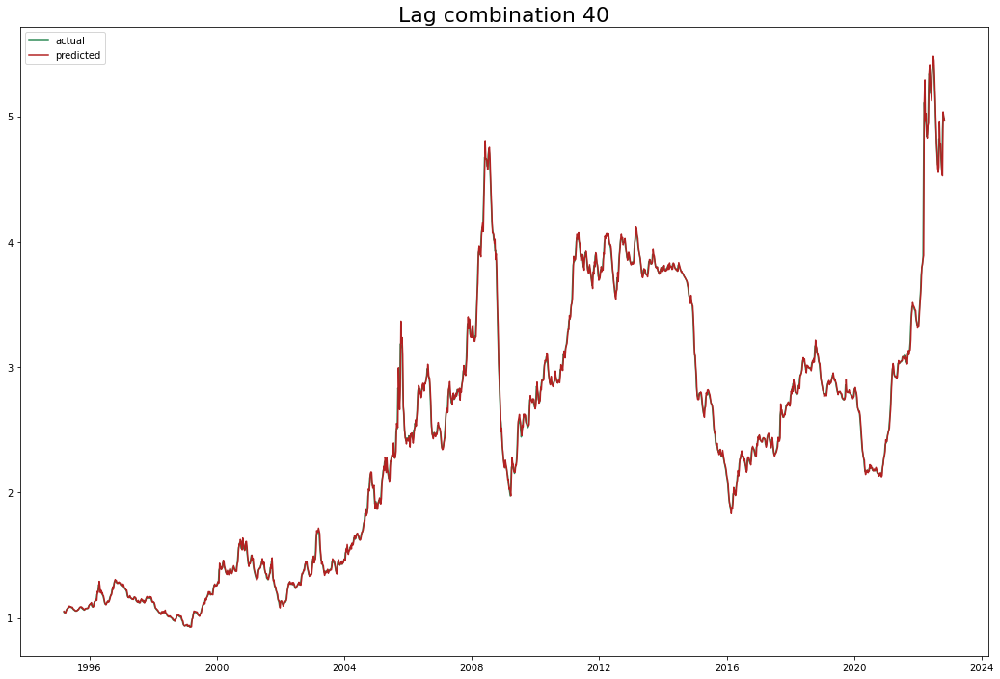

Test data rmse: 0.06918629620904433 Total rmse: 0.045048762952994204
Test data mape: 0.008863012698070855 Total mape: 0.009816210841680736
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.024) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.017) neg_root_mean_squared_error: (test=-0.062) r2: (test=0.982) total time=   0.0s
[CV 3/5

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


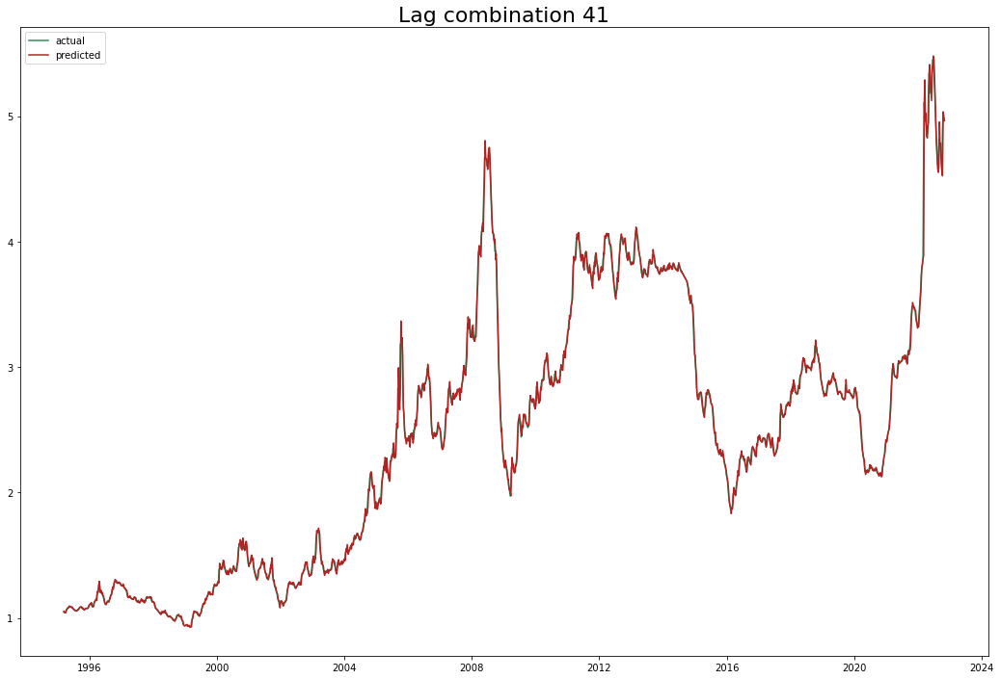

Test data rmse: 0.0691831735252167 Total rmse: 0.0450477944275543
Test data mape: 0.008862035642361444 Total mape: 0.00981610971973495
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.982) total time=   0.0s


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


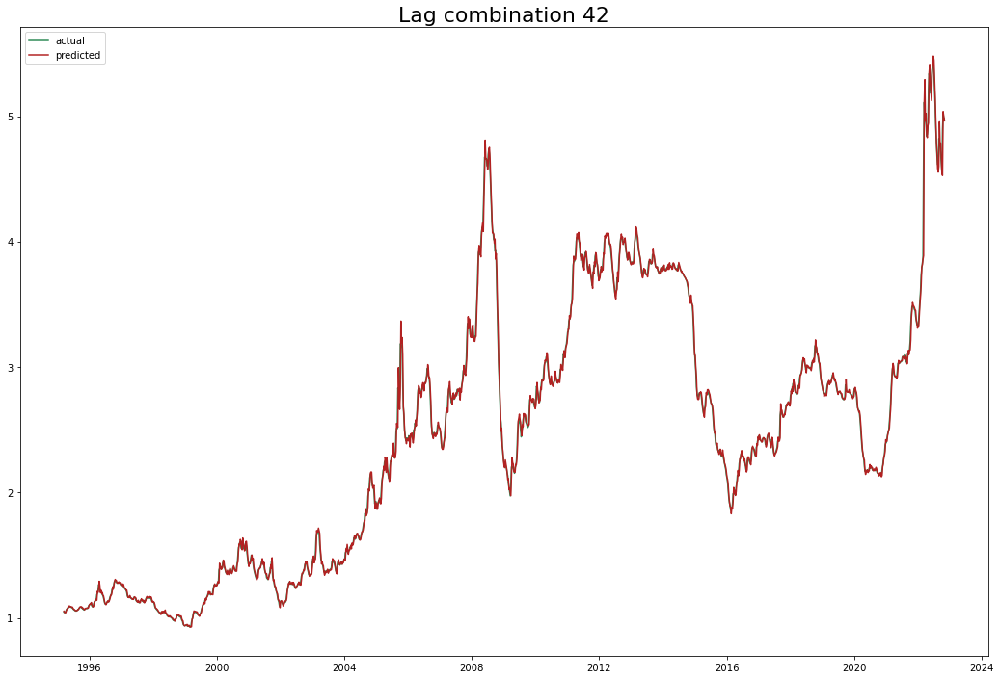

Test data rmse: 0.06922230649176513 Total rmse: 0.04504867217257019
Test data mape: 0.008837450850120564 Total mape: 0.00983115603659178
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.023) r2: (test=0.982) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.063) r2: (test=0.982) total 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


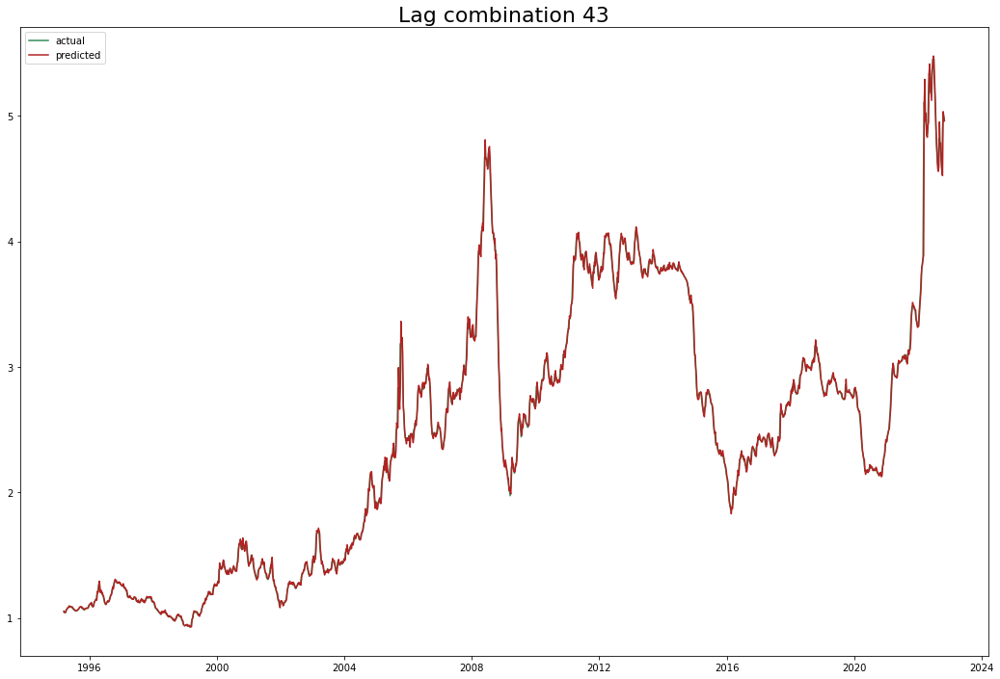

Test data rmse: 0.06922533051370931 Total rmse: 0.04500429897948582
Test data mape: 0.008825628066853365 Total mape: 0.009824364539902531
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.012) neg_root_mean_squared_error: (test=-0.024) r2: (test=0.981) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.063) r2: (test=0

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


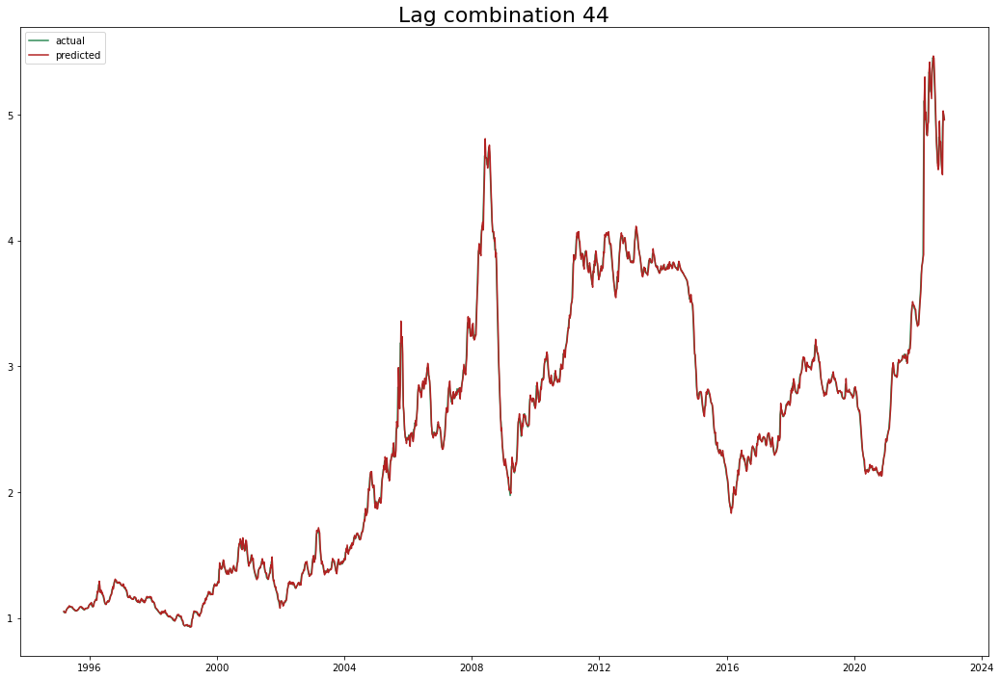

Test data rmse: 0.06941228337972702 Total rmse: 0.044975591584299646
Test data mape: 0.00888804454218003 Total mape: 0.009840358315205406
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.025) r2: (test=0.980) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (test=-0.063) 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


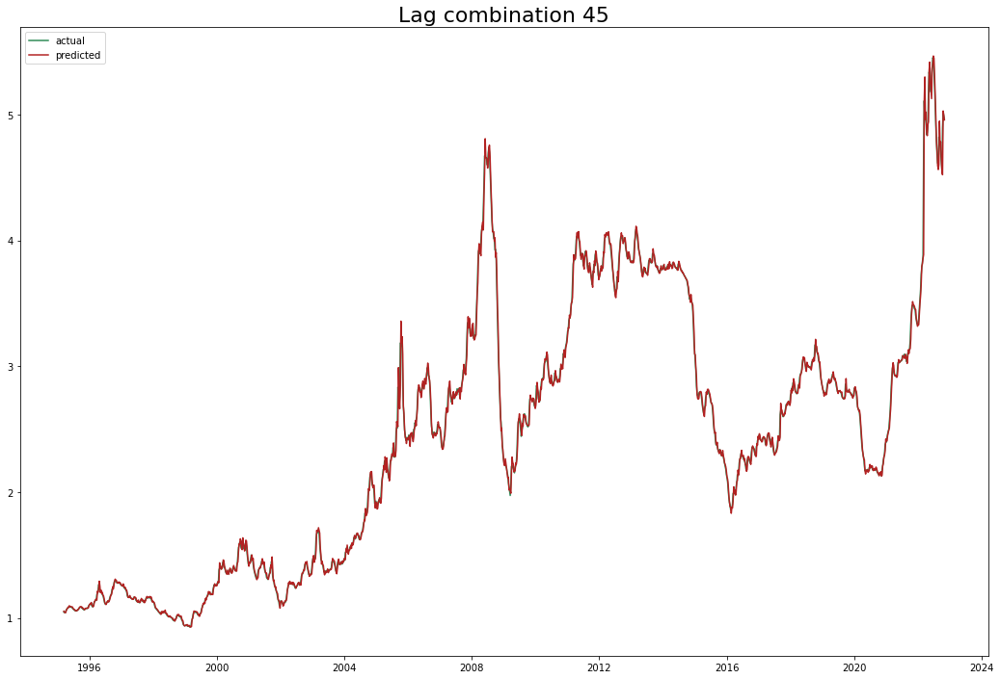

Test data rmse: 0.06940432353289215 Total rmse: 0.044972776393586024
Test data mape: 0.008886241000188234 Total mape: 0.009837132527671774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.025) r2: (test=0.980) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared_error: (t

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


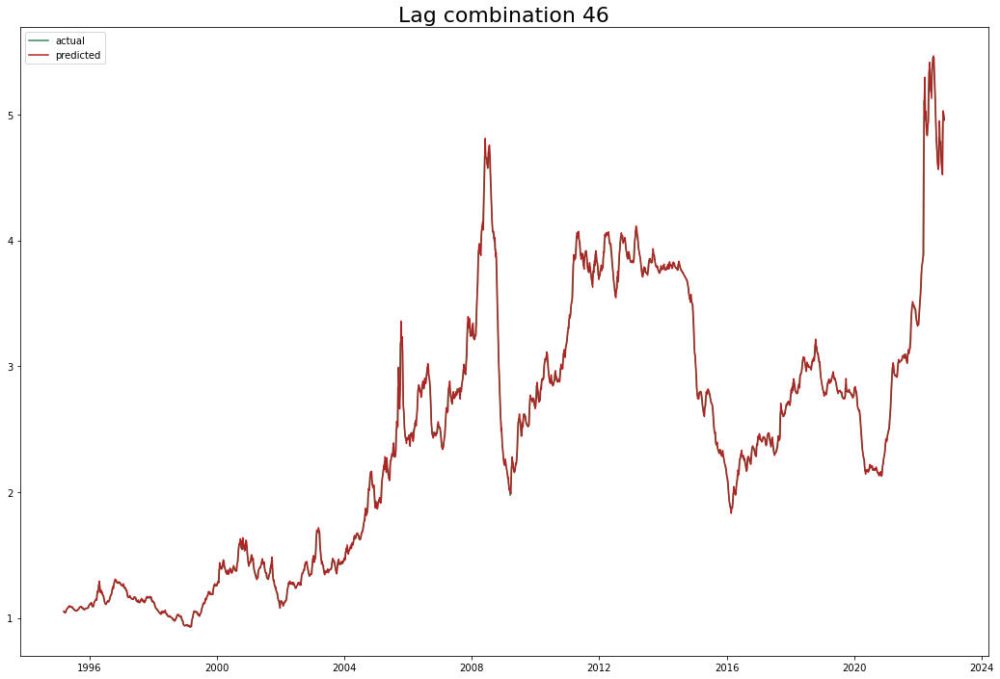

Test data rmse: 0.06929544896769166 Total rmse: 0.04492977833616593
Test data mape: 0.008885691305964243 Total mape: 0.009850852304592744
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.025) r2: (test=0.980) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_mean_squared

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


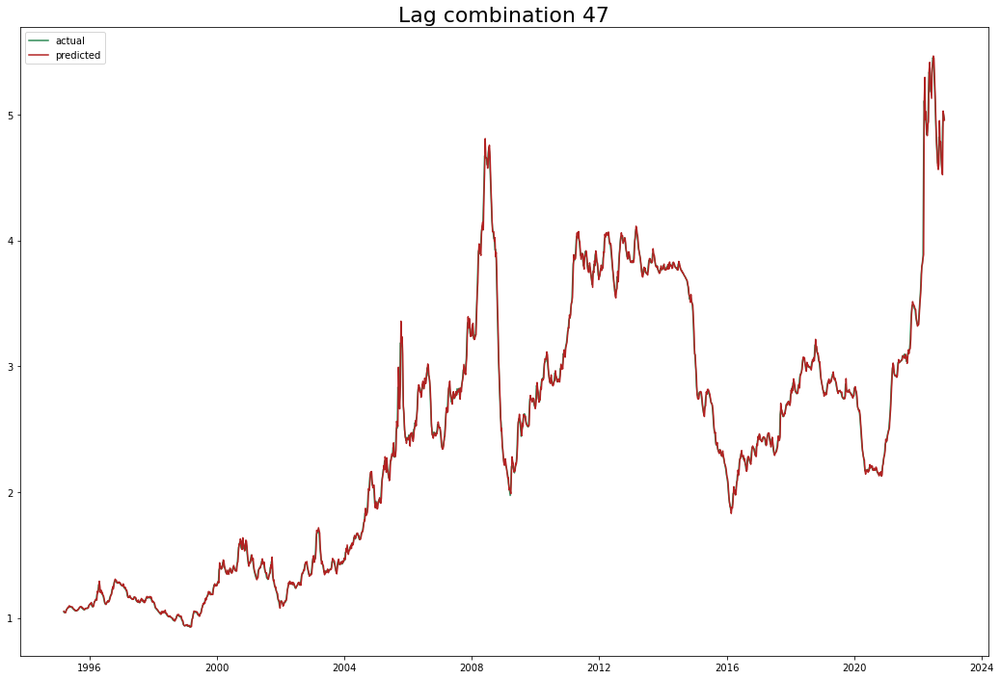

Test data rmse: 0.06927611122506135 Total rmse: 0.044918604174349654
Test data mape: 0.008886664701636007 Total mape: 0.00984296425737838
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.025) r2: (test=0.980) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018) neg_root_m

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


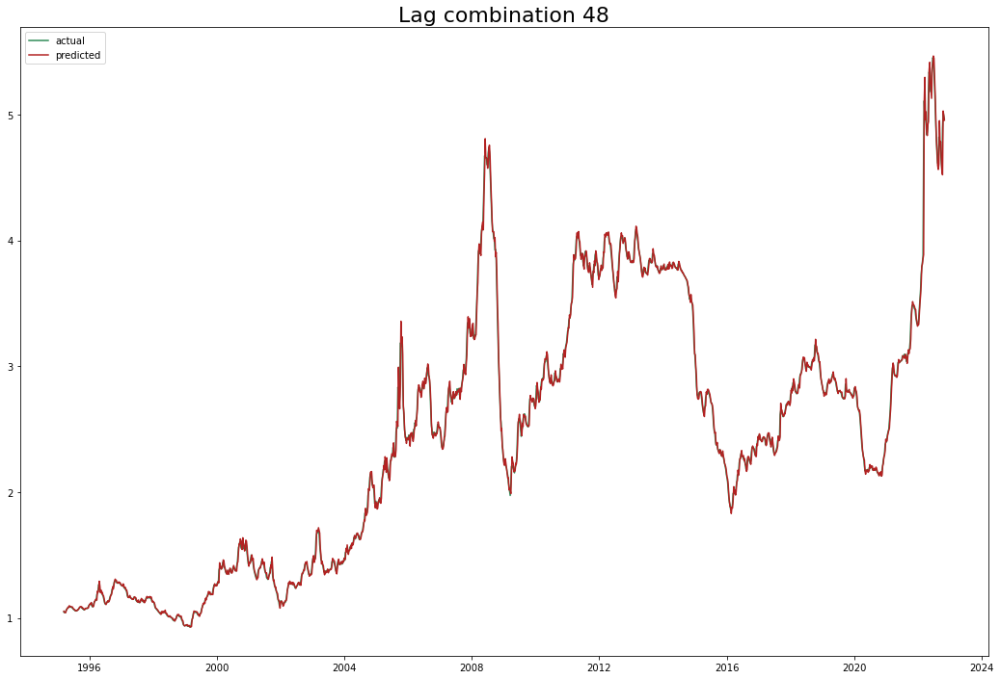

Test data rmse: 0.06929299801643489 Total rmse: 0.044923151664979476
Test data mape: 0.008887181594433571 Total mape: 0.009843161047781357
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.025) r2: (test=0.980) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (test=-0.018

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


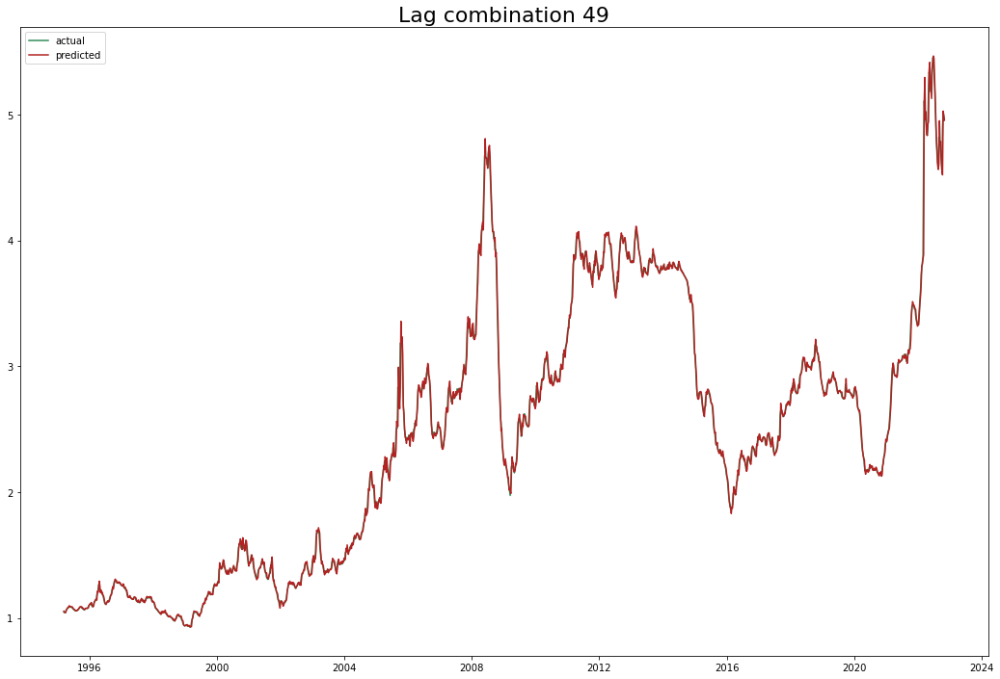

Test data rmse: 0.06933080057201493 Total rmse: 0.04493303390683995
Test data mape: 0.008901623092160256 Total mape: 0.009848307547055695
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag', '51w_lag']
Fitting 5 folds for each of 1 candidates, totalling 5 fits
[CV 1/5] END  neg_mean_absolute_percentage_error: (test=-0.013) neg_root_mean_squared_error: (test=-0.025) r2: (test=0.980) total time=   0.0s
[CV 2/5] END  neg_mean_absolute_percentage_error: (t

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


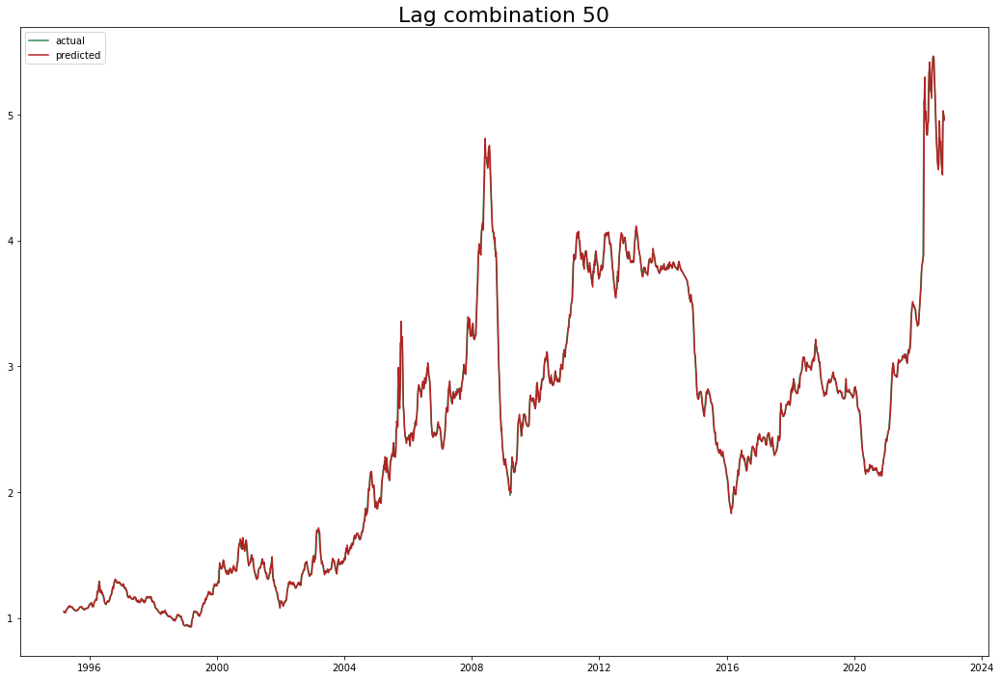

Test data rmse: 0.06947008886009952 Total rmse: 0.044959484223829095
Test data mape: 0.008889466725107415 Total mape: 0.009853698774558668
--------------------------
Next model: 
Lags choosen:  ['1w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837) r2: (test=-17.003) total time=   0.0s
[CV 5/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.207) neg_root_

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


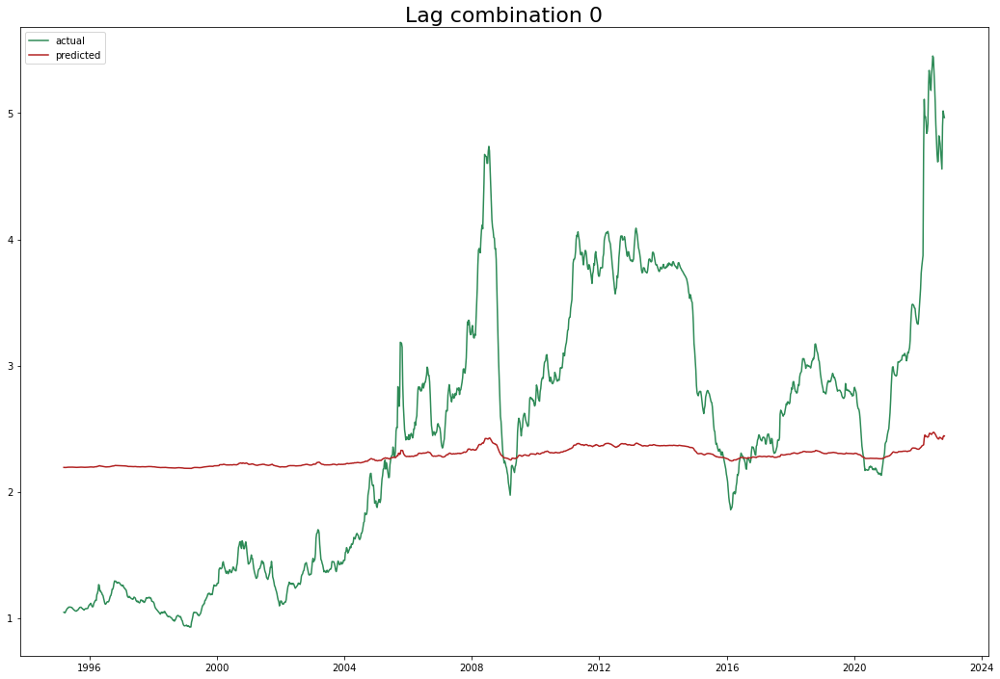

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837) r2: (test=-17.003) total time=   0.0s
[CV 5/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.207) neg_r

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


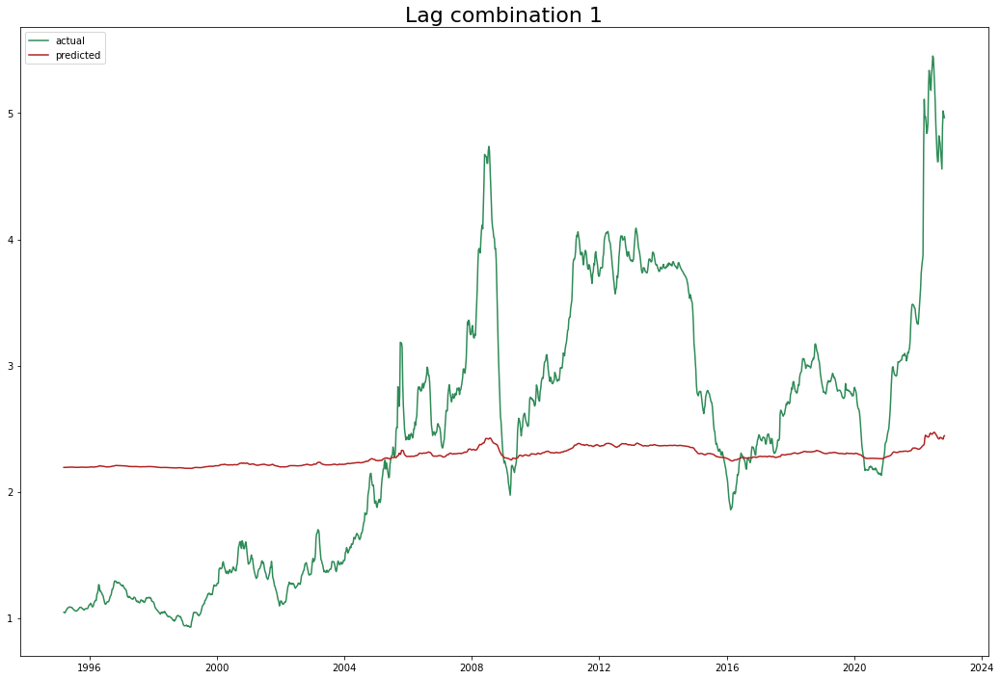

Test data rmse: 1.0469987893267994 Total rmse: 0.9843834579522248
Test data mape: 0.2089534267471926 Total mape: 0.4143121713944113
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837) r2: (test=-17.003) total time=   0.0s
[CV 5/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.2

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


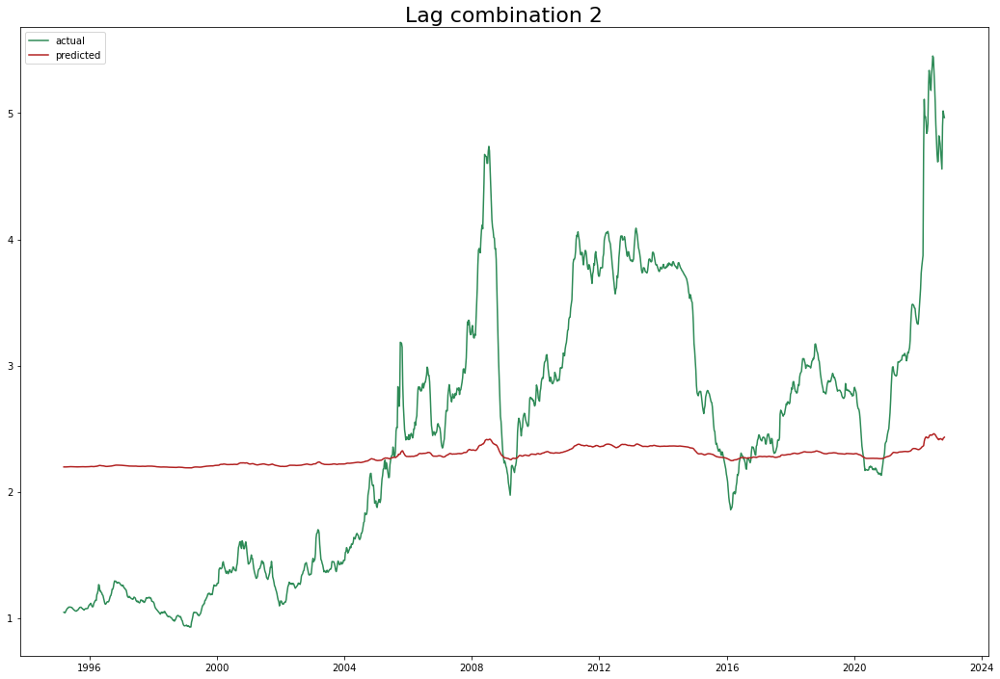

Test data rmse: 1.050126953251995 Total rmse: 0.9875576373259612
Test data mape: 0.20960008200332 Total mape: 0.41568011154241236
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837) r2: (test=-17.003) total time=   0.0s
[CV 5/5] END selection=cyclic; neg_mean_absolute_percentage_error: (t

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


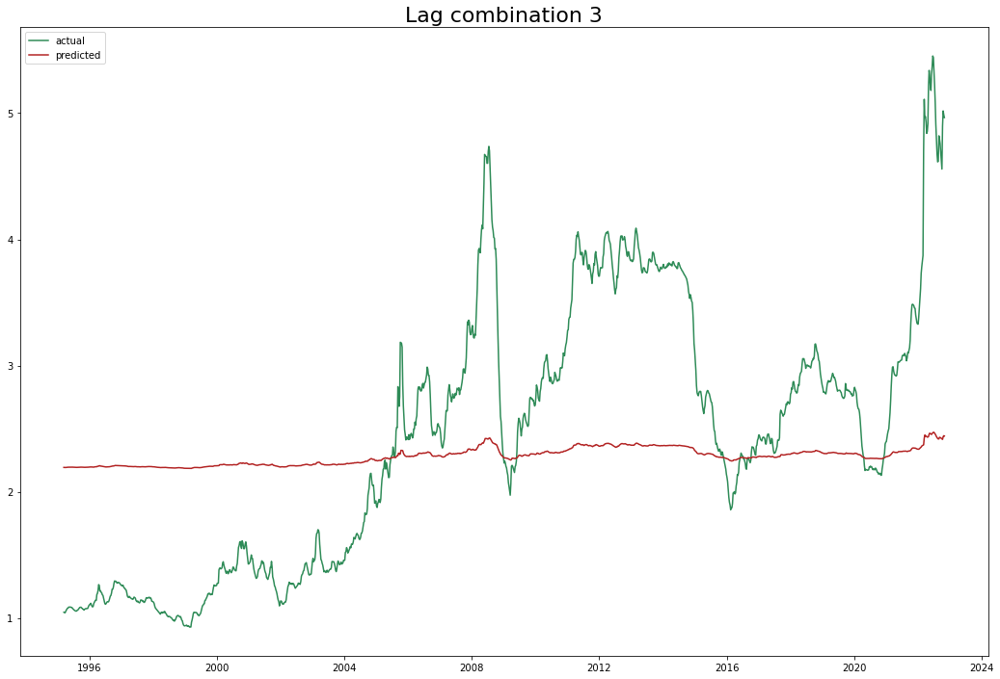

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837) r2: (test=-17.003) total time=   0.0s
[CV 5/5] END selection=cyclic; neg_mean_absolute_percent

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


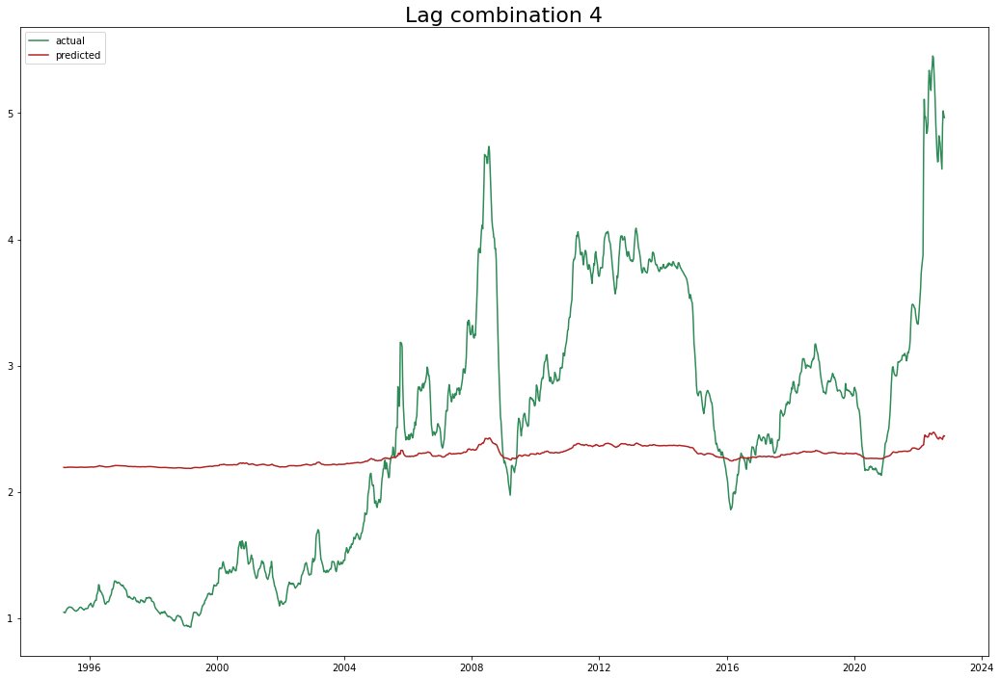

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837) r2: (test=-17.003) total time=   0.0s
[CV 5/5] END selection=cyclic; neg_mean_absolu

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


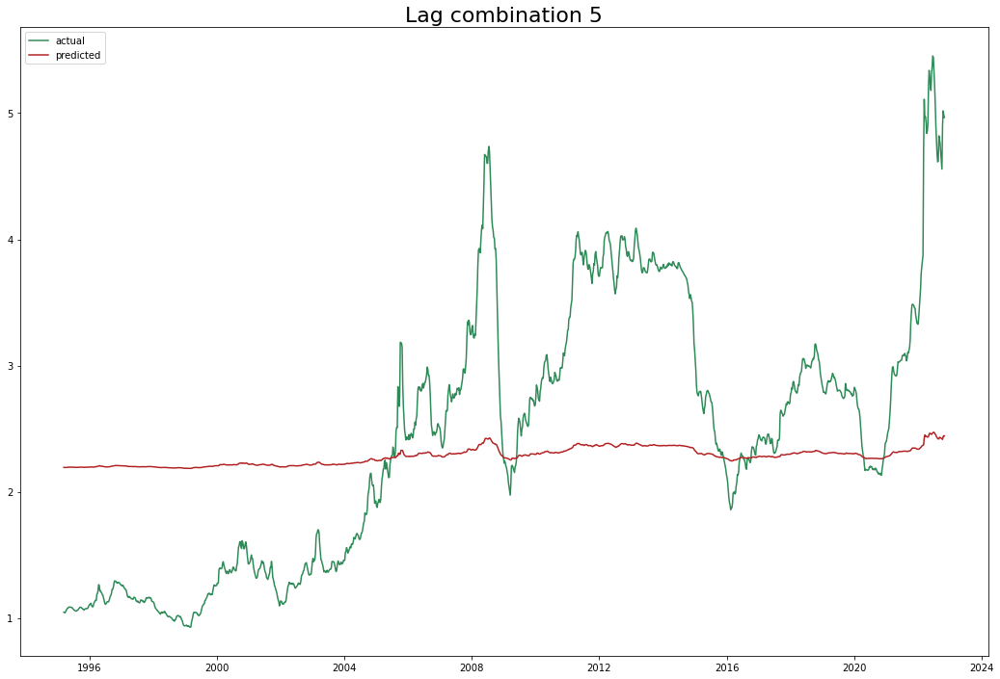

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837) r2: (test=-17.003) total time=   0.0s
[CV 5/5] END selection=cyclic; neg_m

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


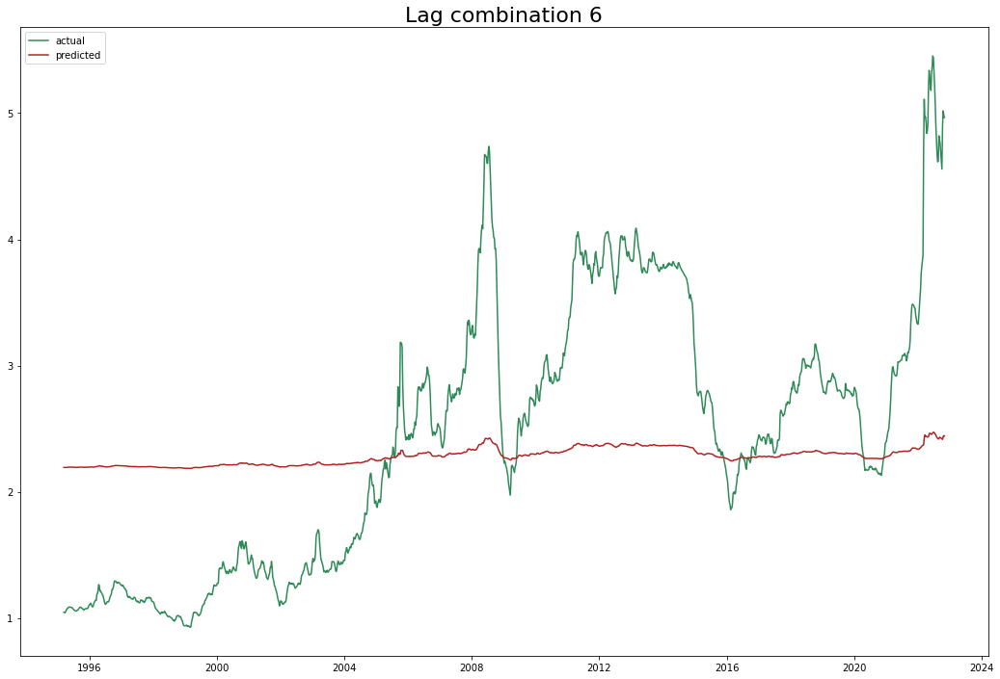

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837) r2: (test=-17.003) total time=   0.0s
[CV 5/5] END selection=cyc

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


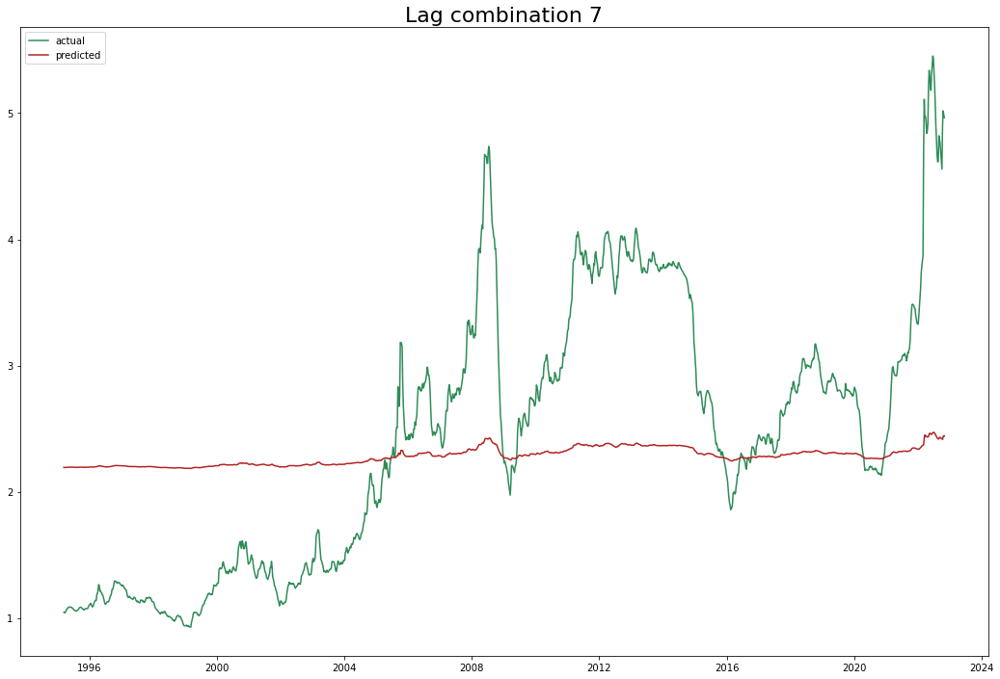

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837) r2: (test=-17.003) total time=   0.0s
[CV 5/5] END sel

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


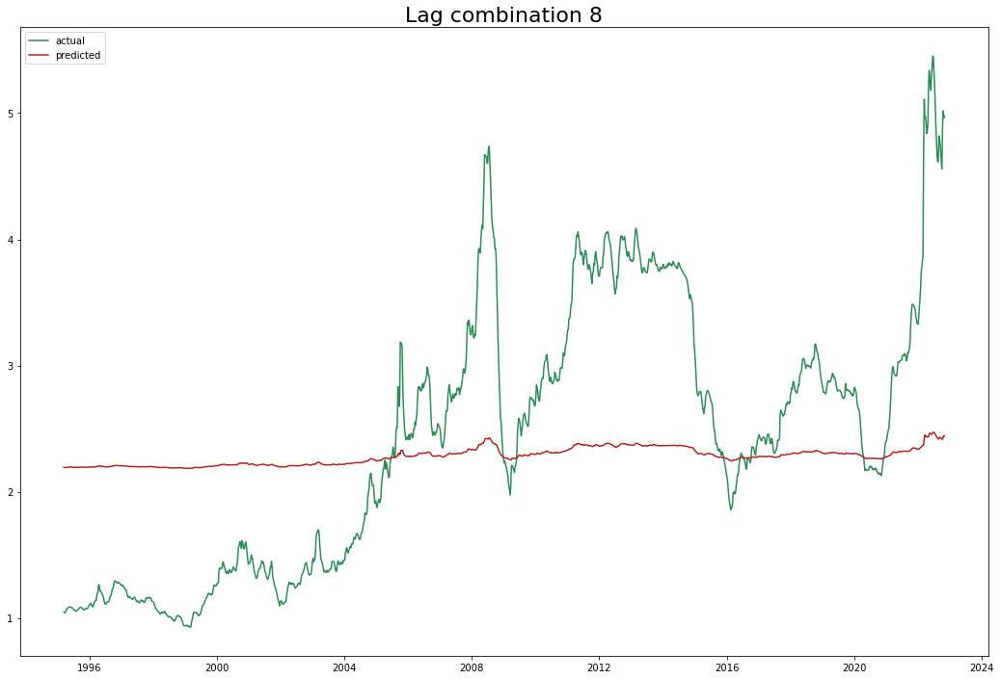

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837) r2: (test=-17.003) total time=   0.0s
[CV 5

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


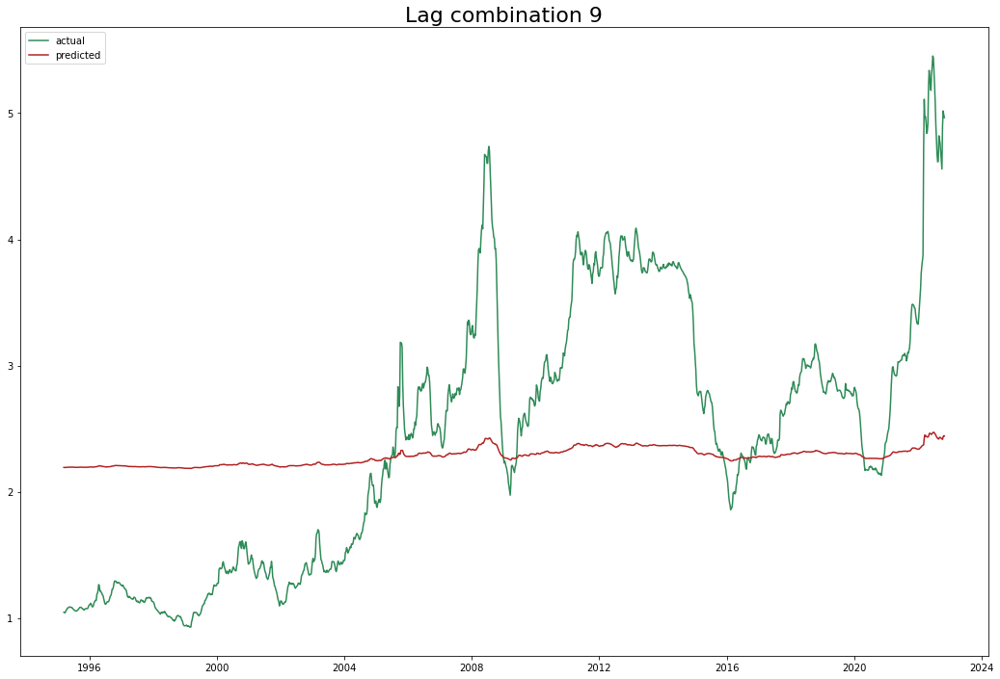

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837) r2: (test=-17.003) total time=  

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


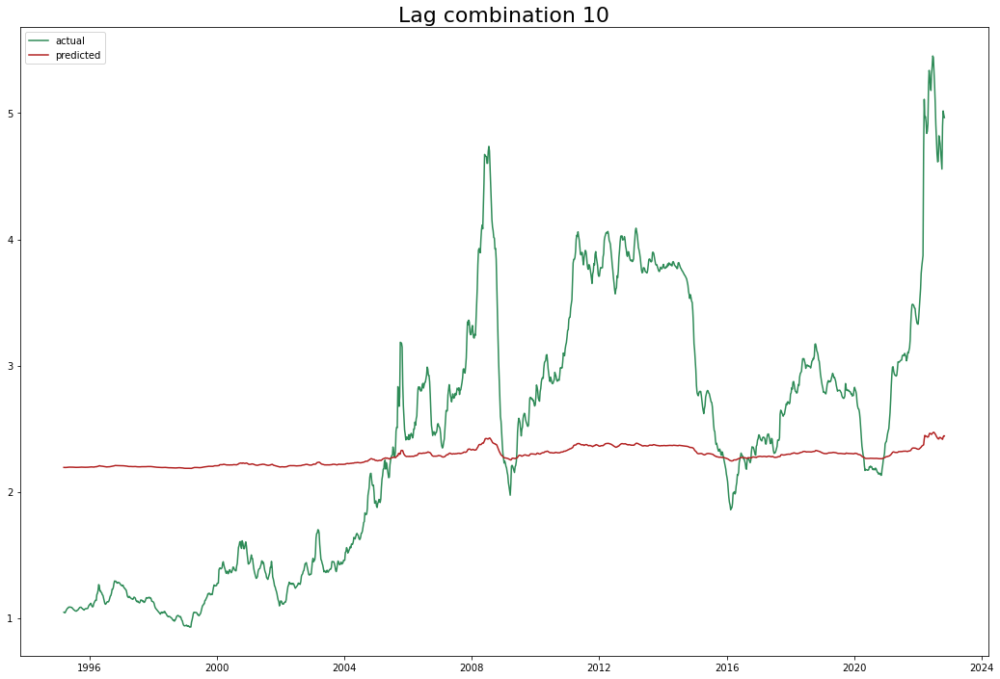

Test data rmse: 1.0462613173990087 Total rmse: 0.9841838992007177
Test data mape: 0.20884985817286214 Total mape: 0.4142997239170216
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837) r2: (test=-17.003) to

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


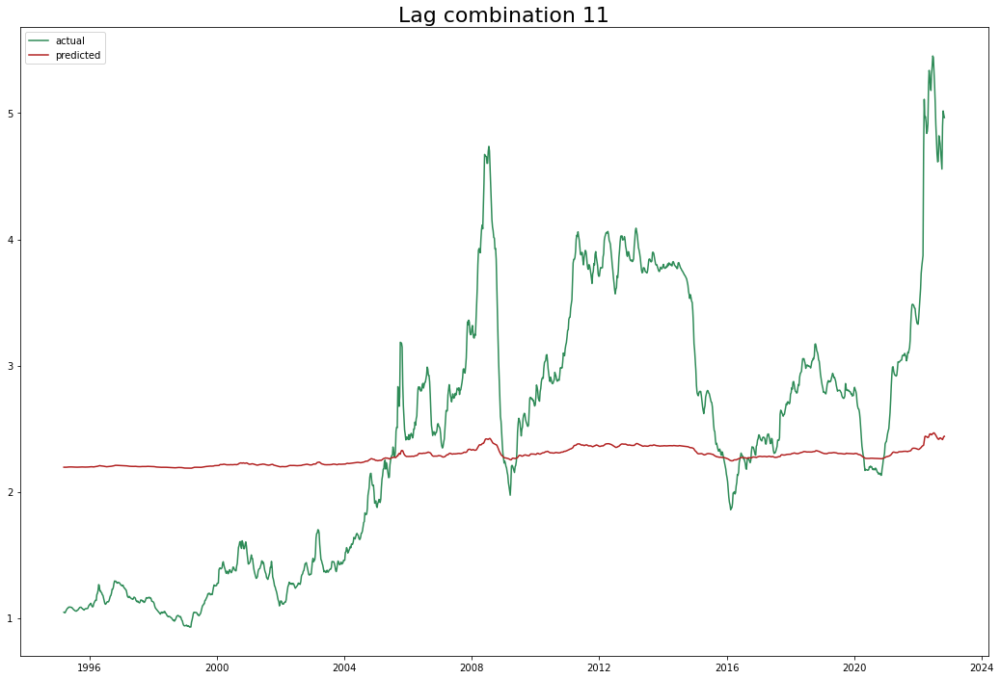

Test data rmse: 1.0479399680850439 Total rmse: 0.9856211147627361
Test data mape: 0.2091722761552048 Total mape: 0.41488406235264613
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837) r2: (test=

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


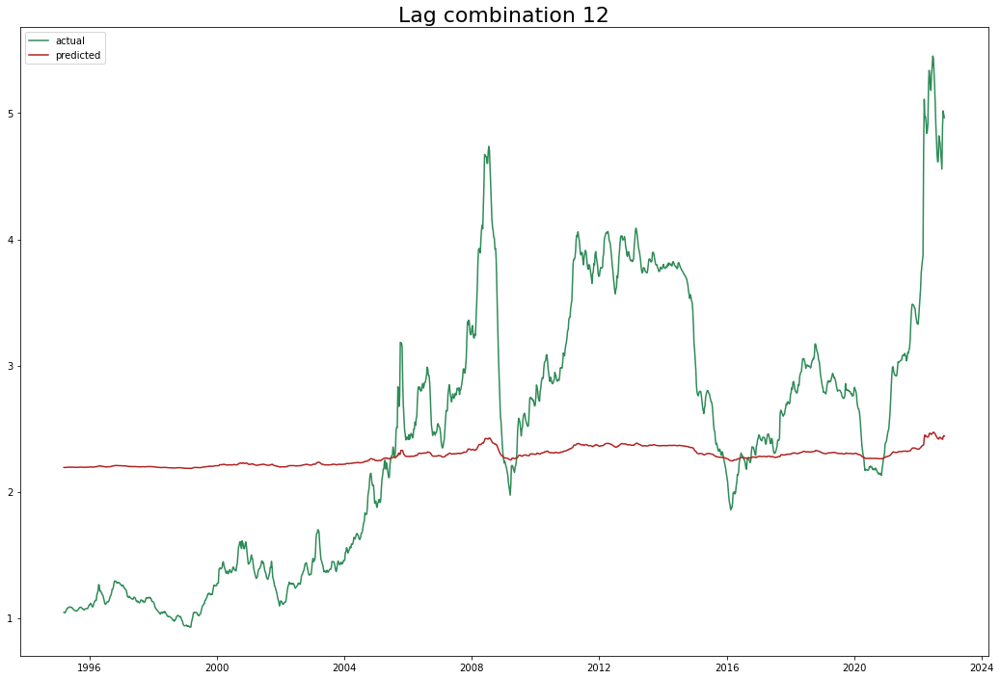

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (test=-1.837)

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


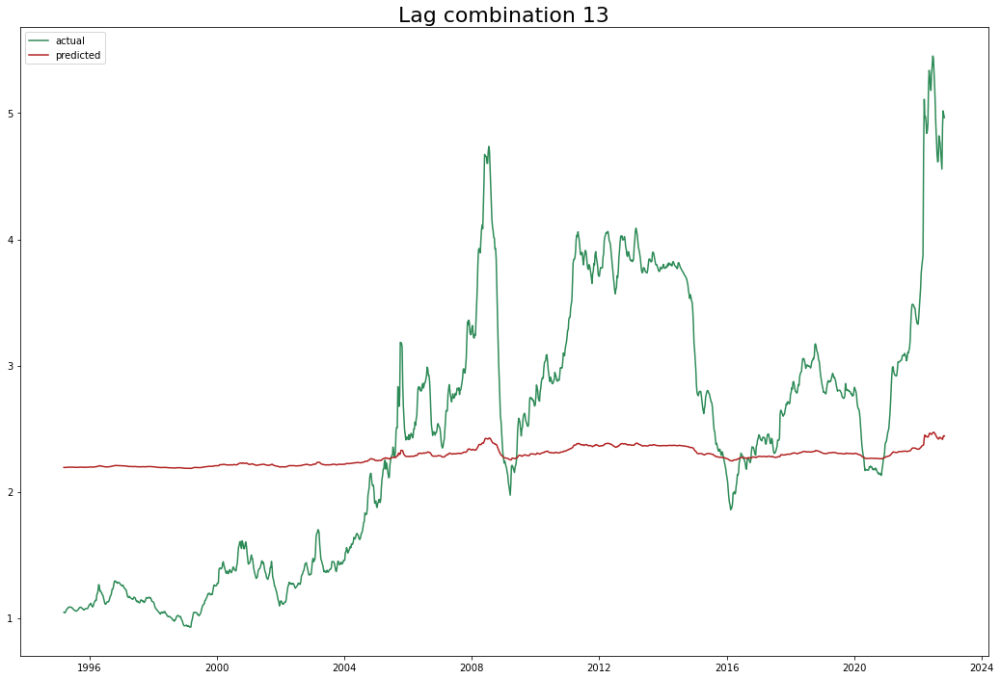

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_squared_error: (t

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


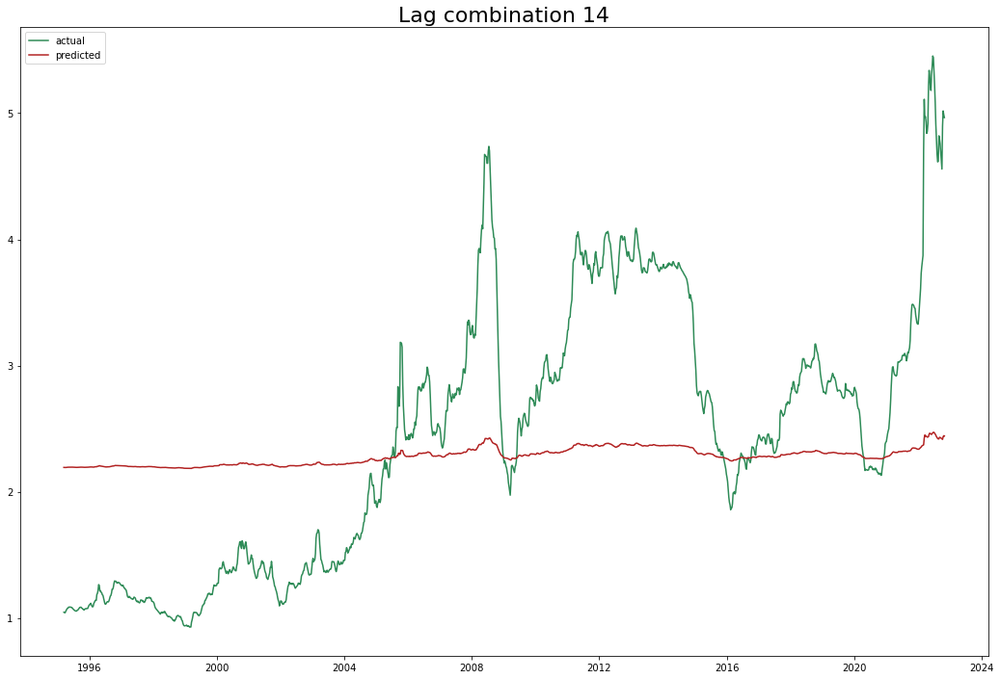

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_mean_square

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


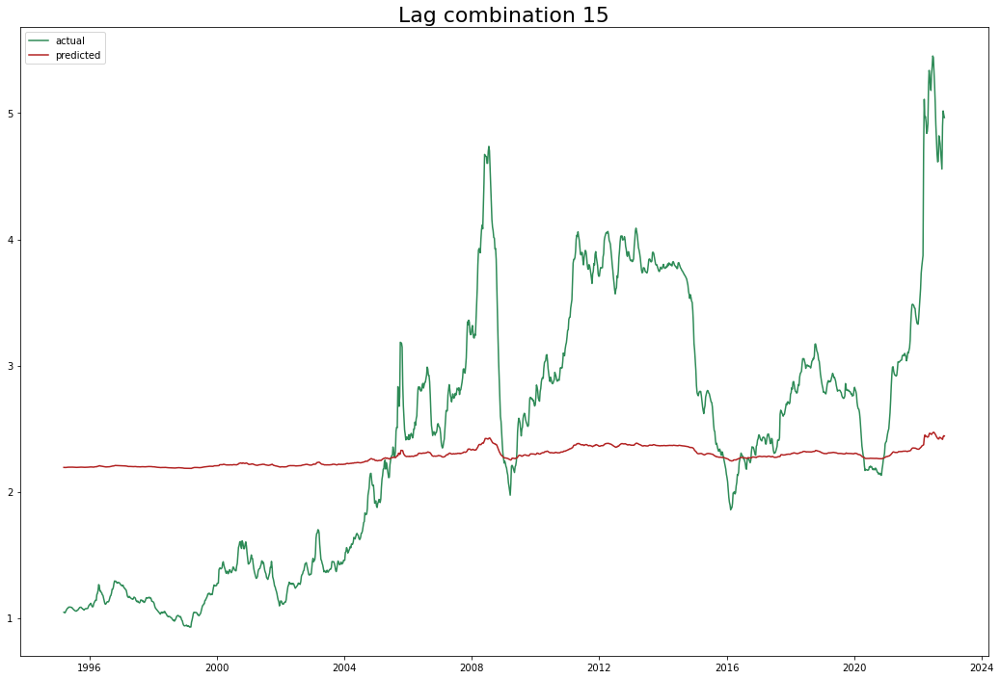

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491) neg_root_

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


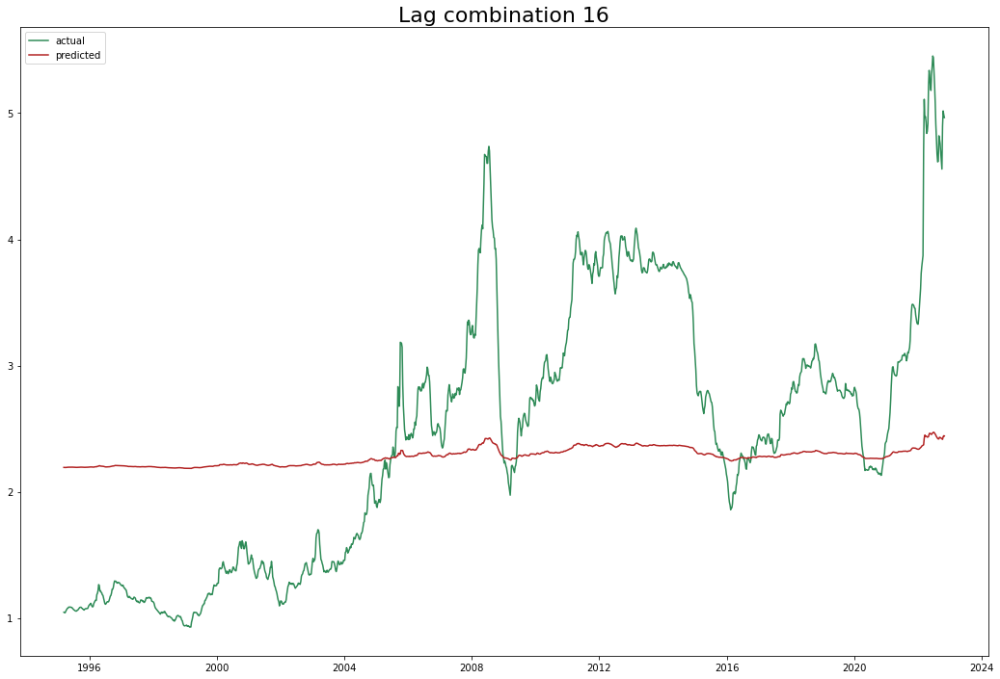

Test data rmse: 1.0461572935461478 Total rmse: 0.9841560042940949
Test data mape: 0.20883583775789794 Total mape: 0.414298177102517
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.491)

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


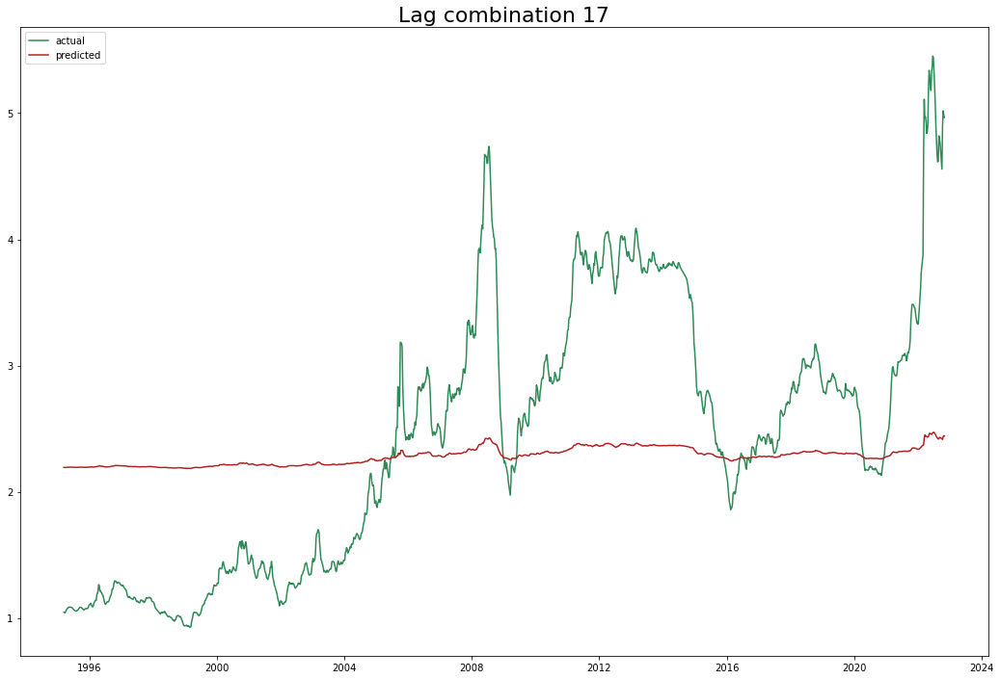

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percentage_error: (

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


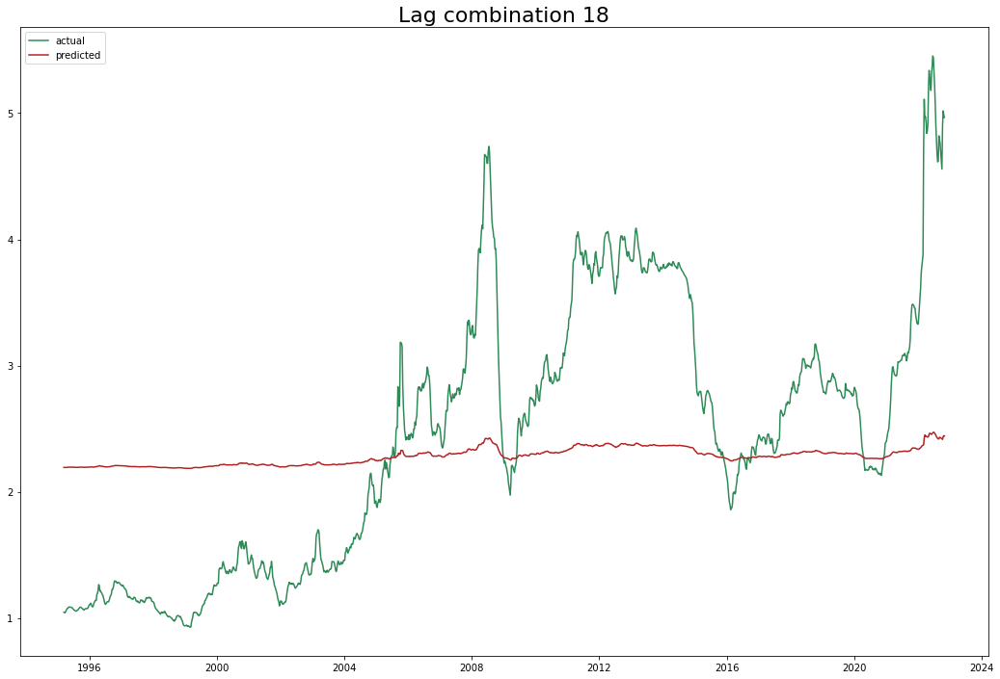

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolute_percenta

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


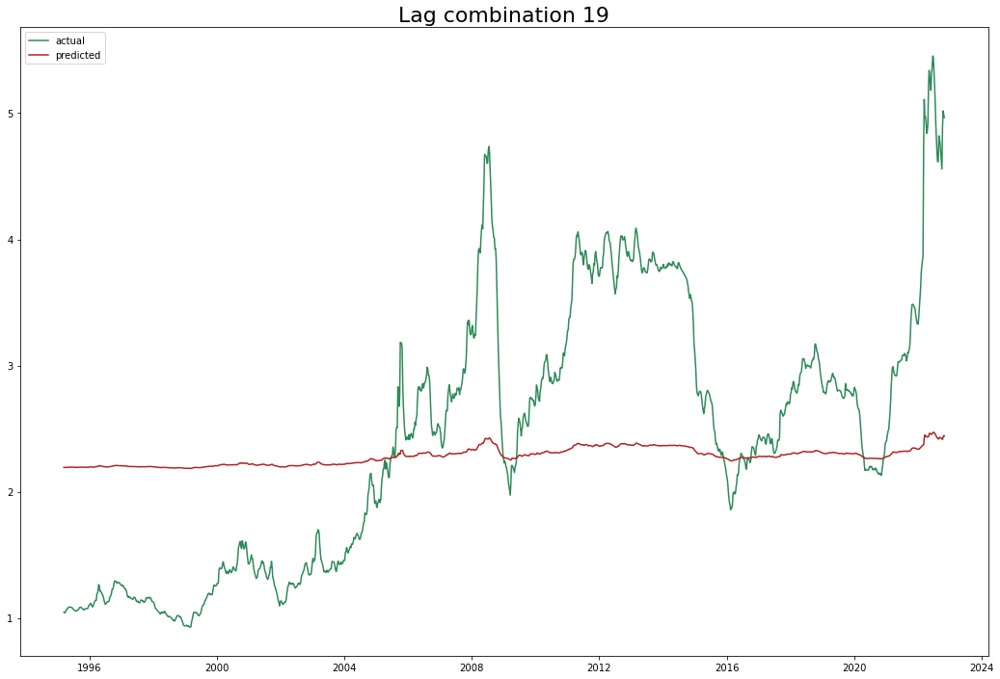

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_mean_absolu

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


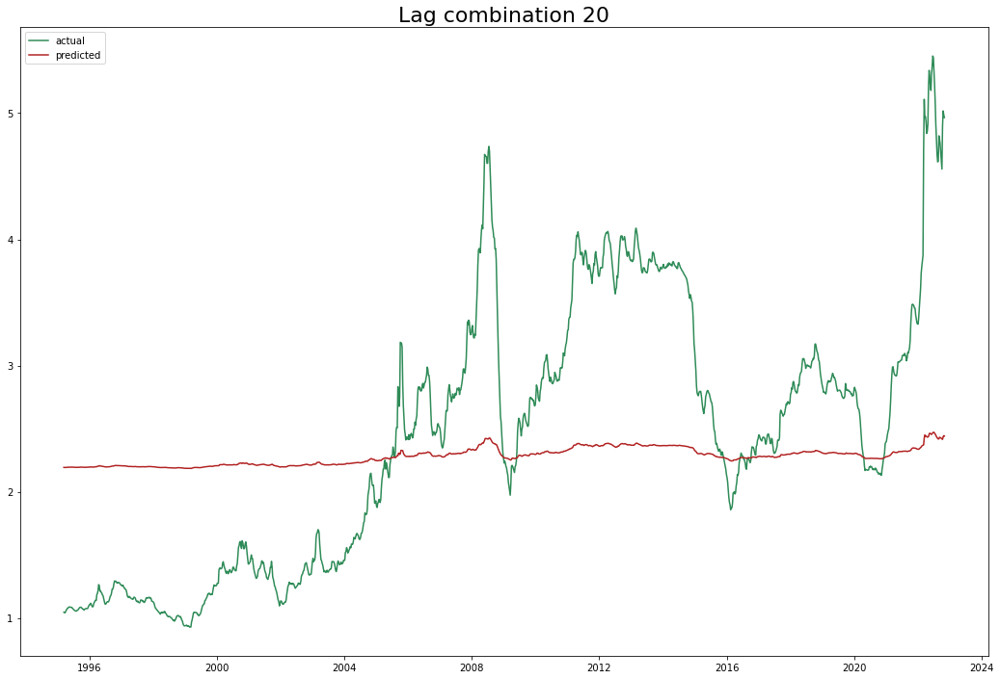

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=cyclic; neg_

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


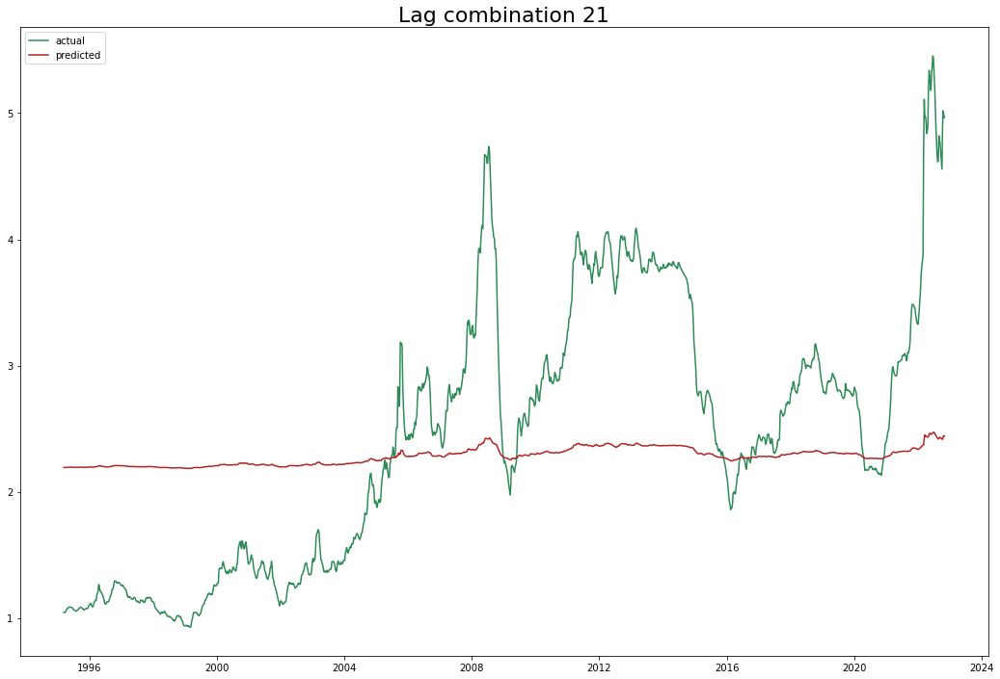

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END selection=c

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


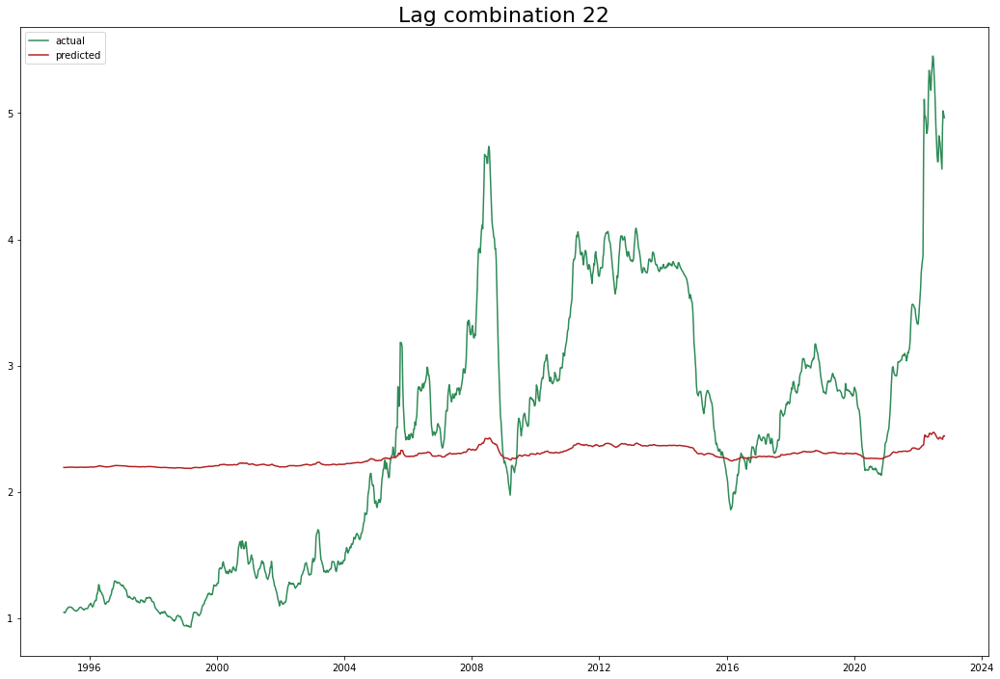

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[CV 4/5] END 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


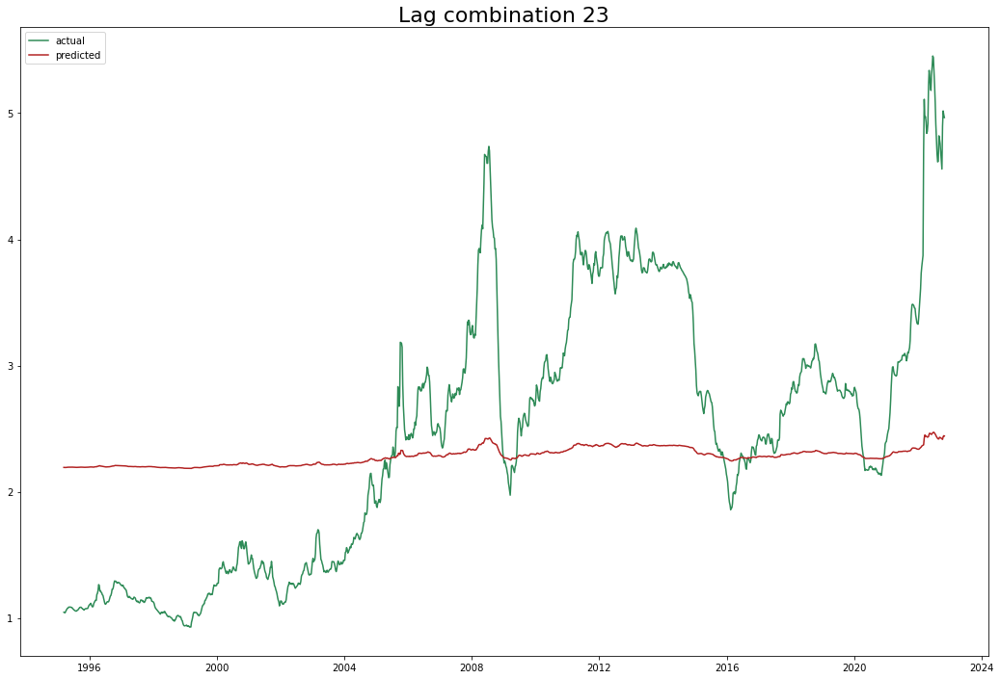

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time=   0.0s
[C

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


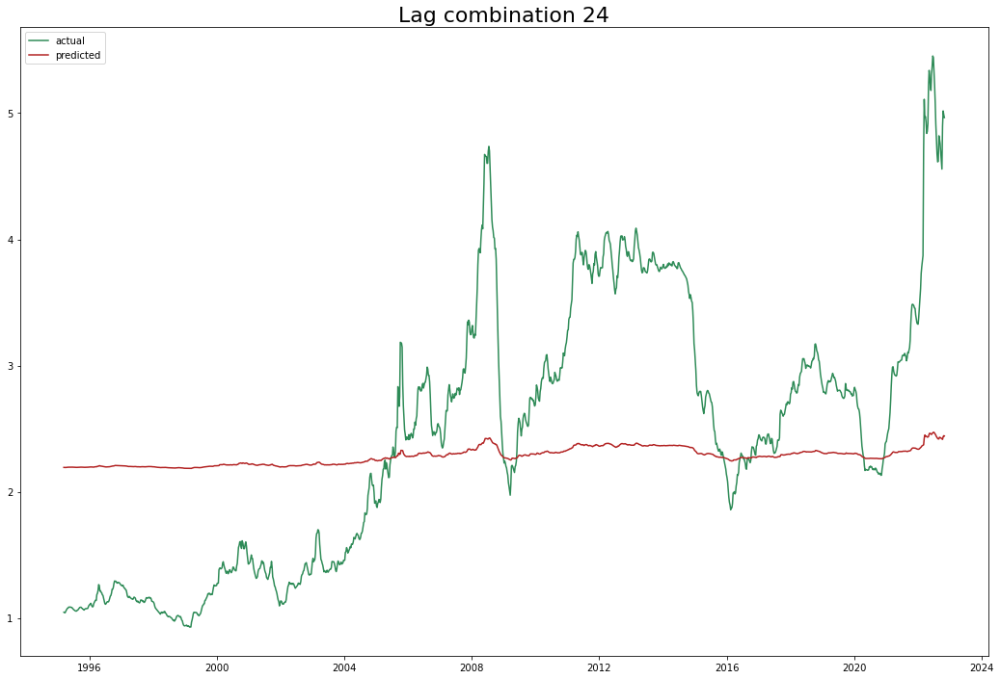

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) total time

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


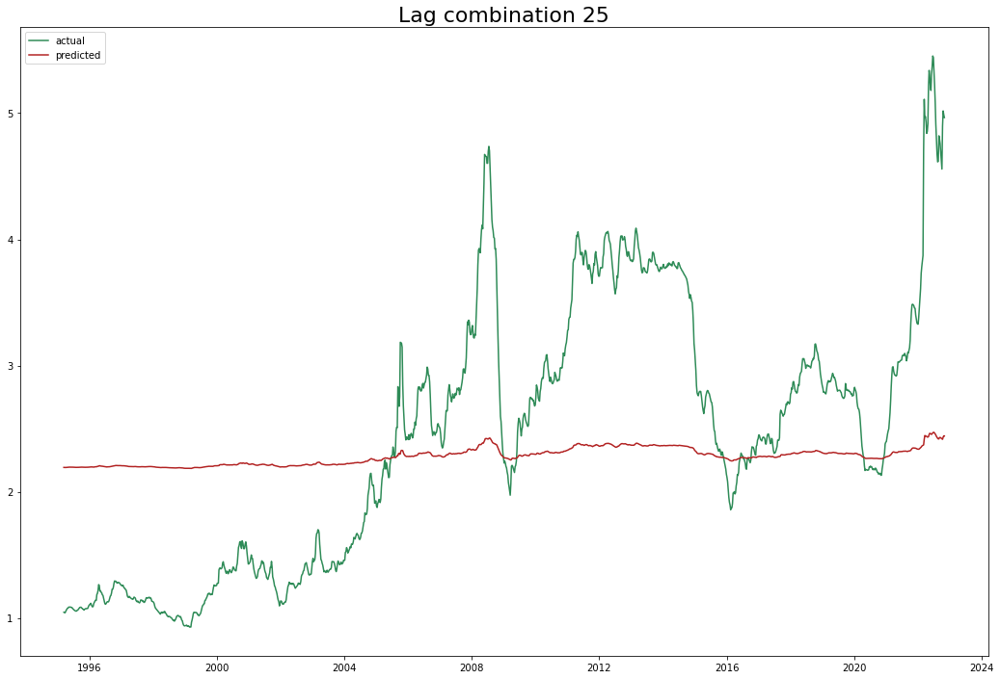

Test data rmse: 1.046292210626866 Total rmse: 0.9841921957644997
Test data mape: 0.2088542314099098 Total mape: 0.41430024951824407
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (test=-5.319) 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


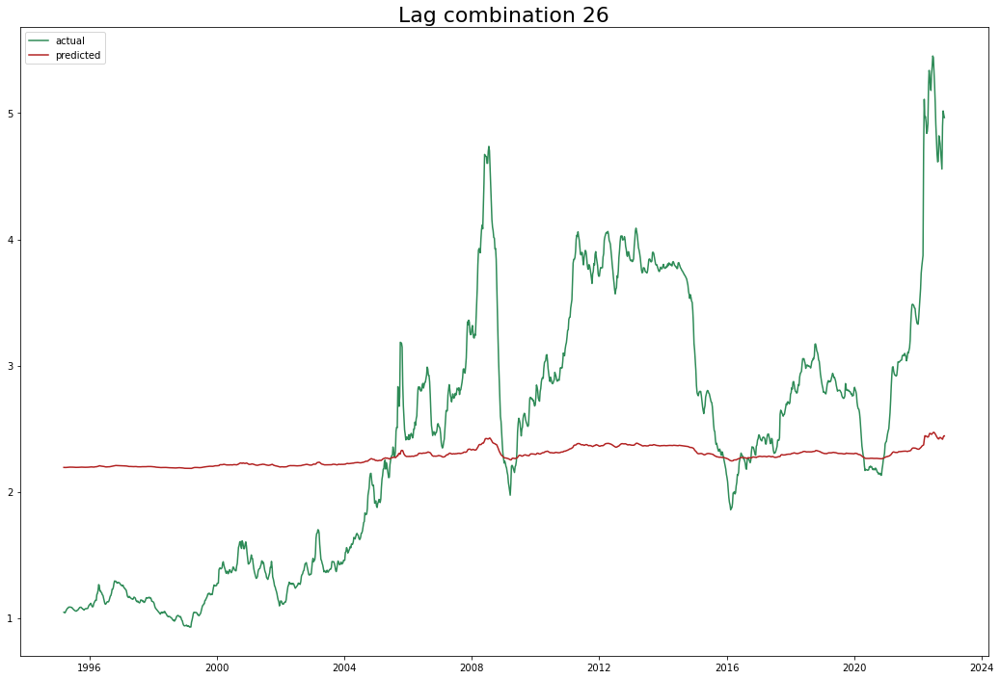

Test data rmse: 1.0463805204348755 Total rmse: 0.984215942744838
Test data mape: 0.20886671555637124 Total mape: 0.4143017499360282
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.674) r2: (te

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


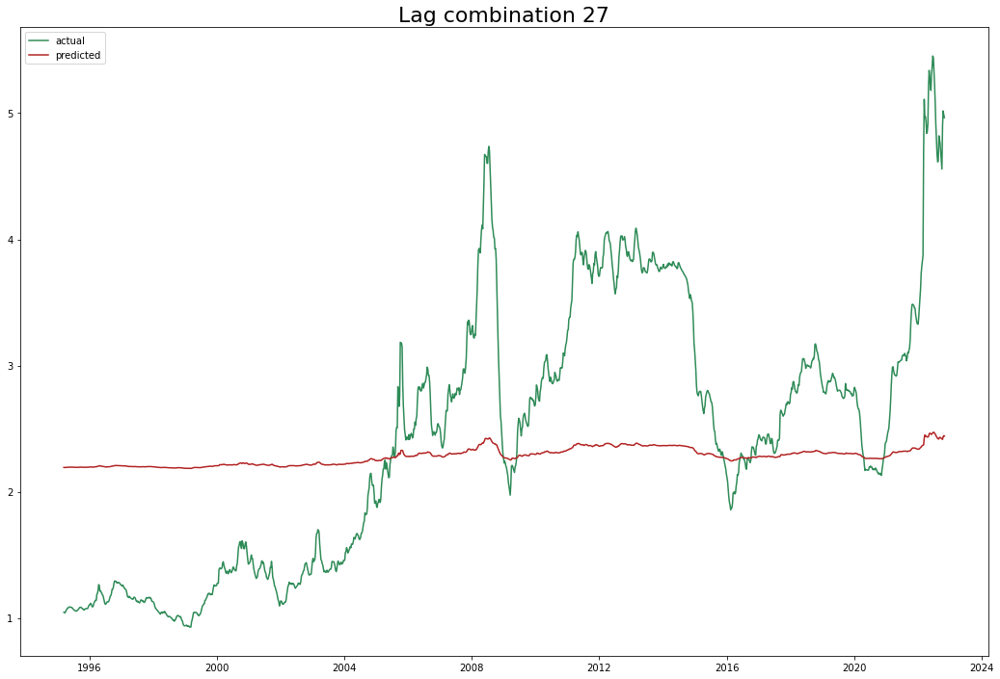

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error: (test=-1.

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


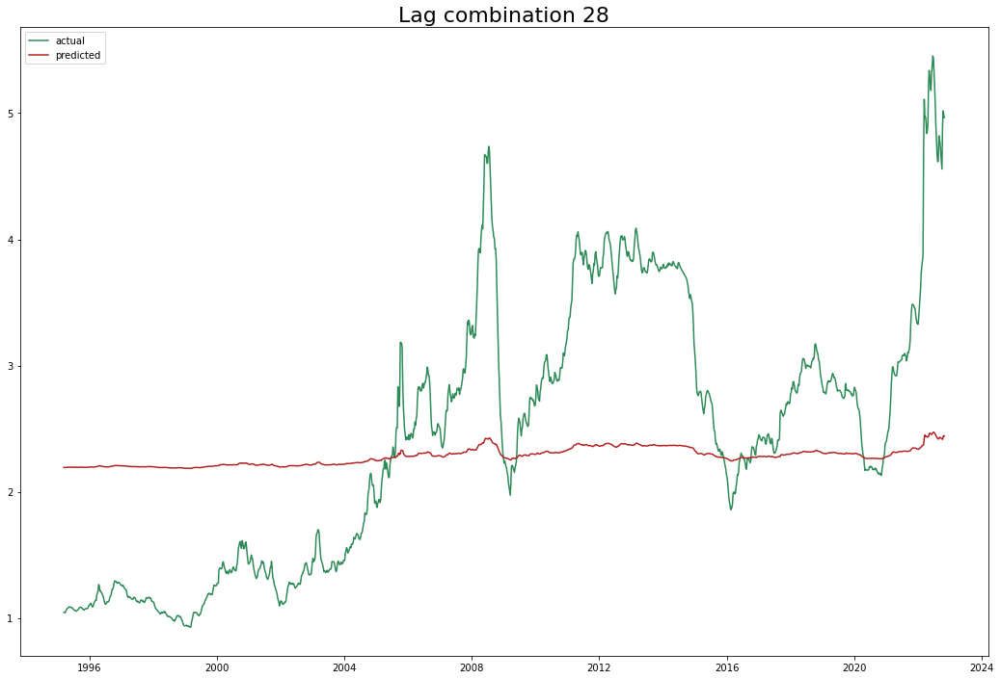

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_squared_error

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


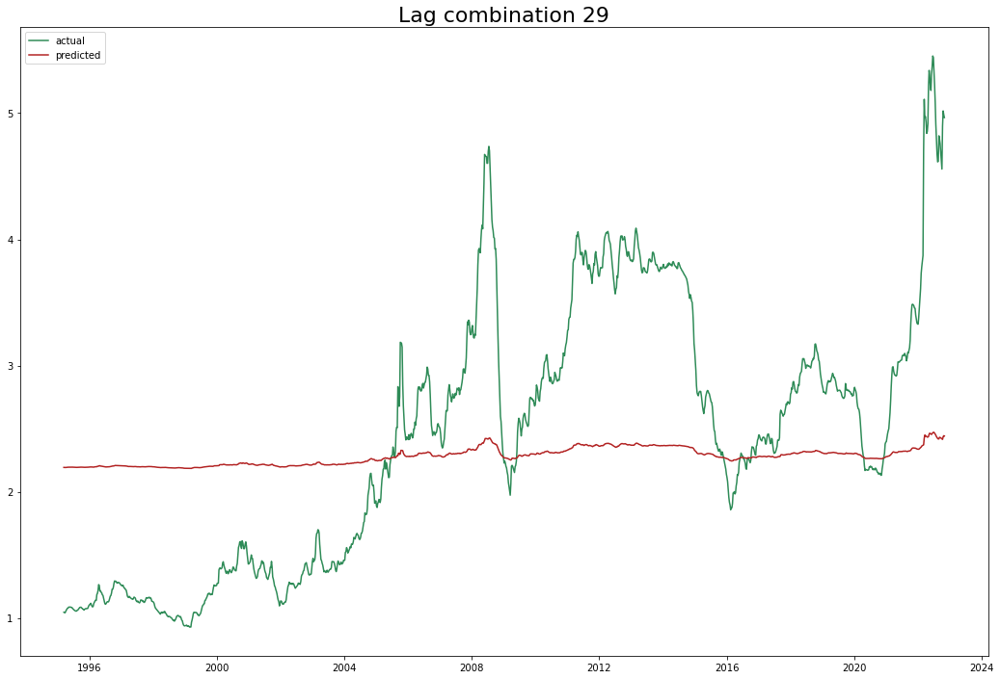

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_root_mean_sq

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


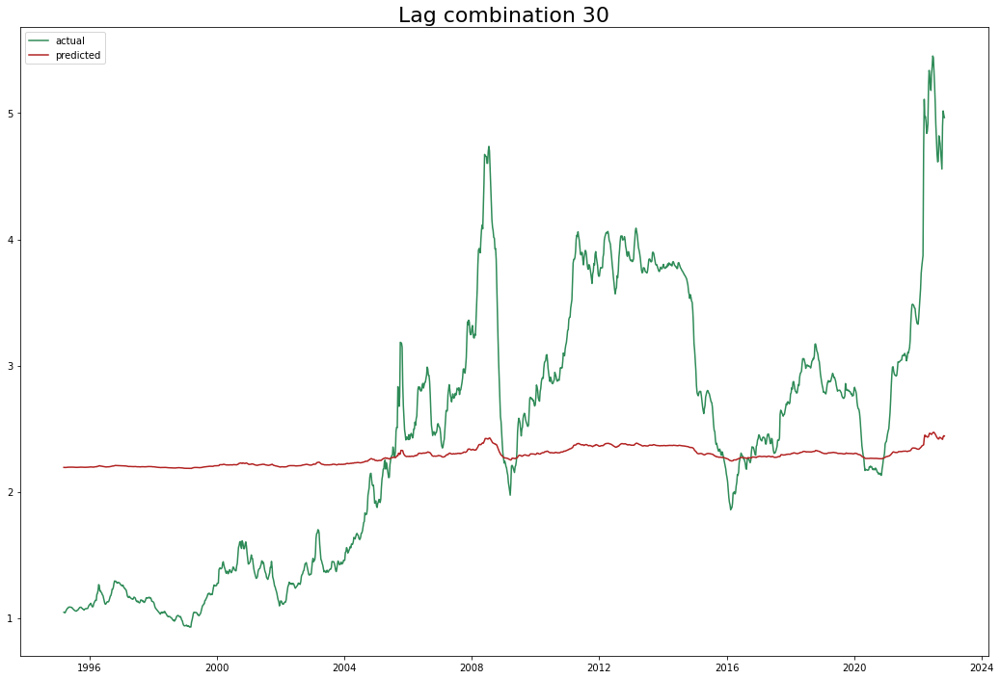

Test data rmse: 1.0461528415169914 Total rmse: 0.9841547031124414
Test data mape: 0.20883526859571716 Total mape: 0.41429804688755323
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.500) neg_

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


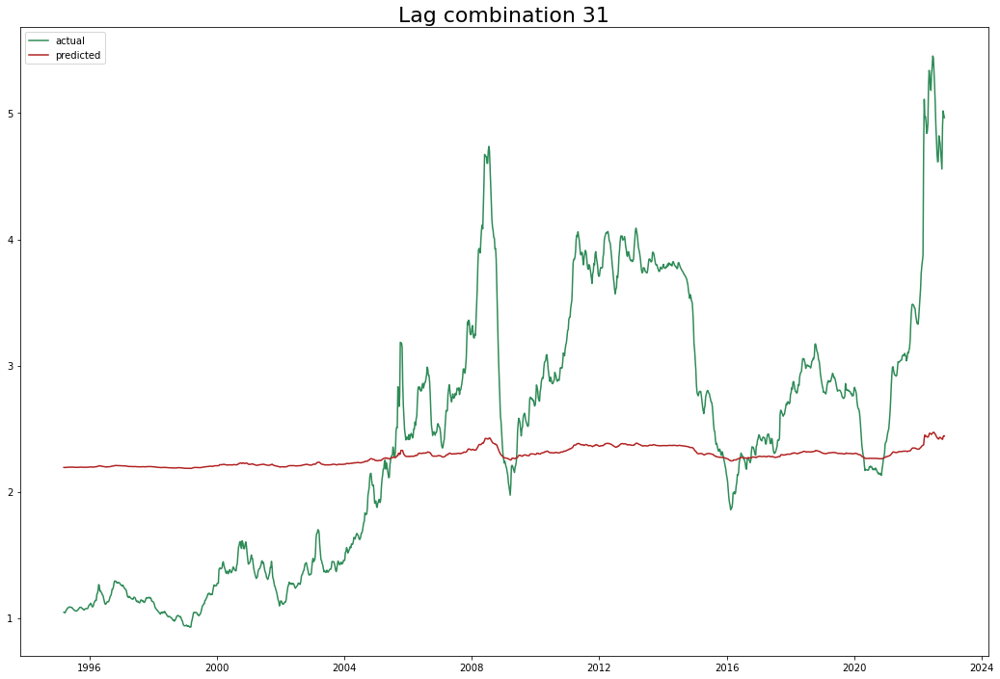

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


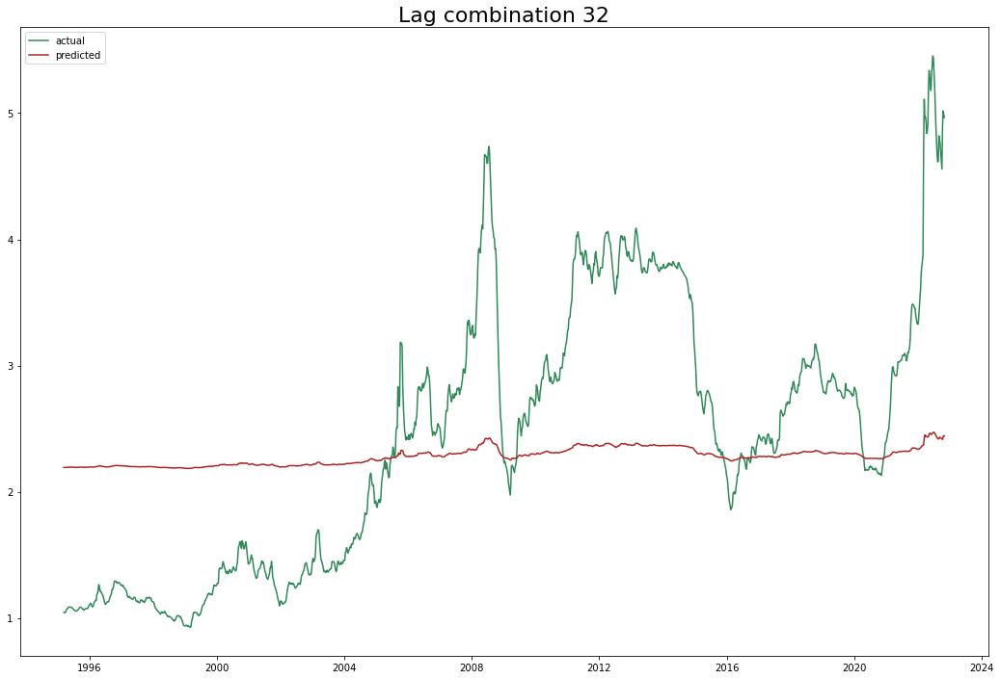

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_percentage_erro

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


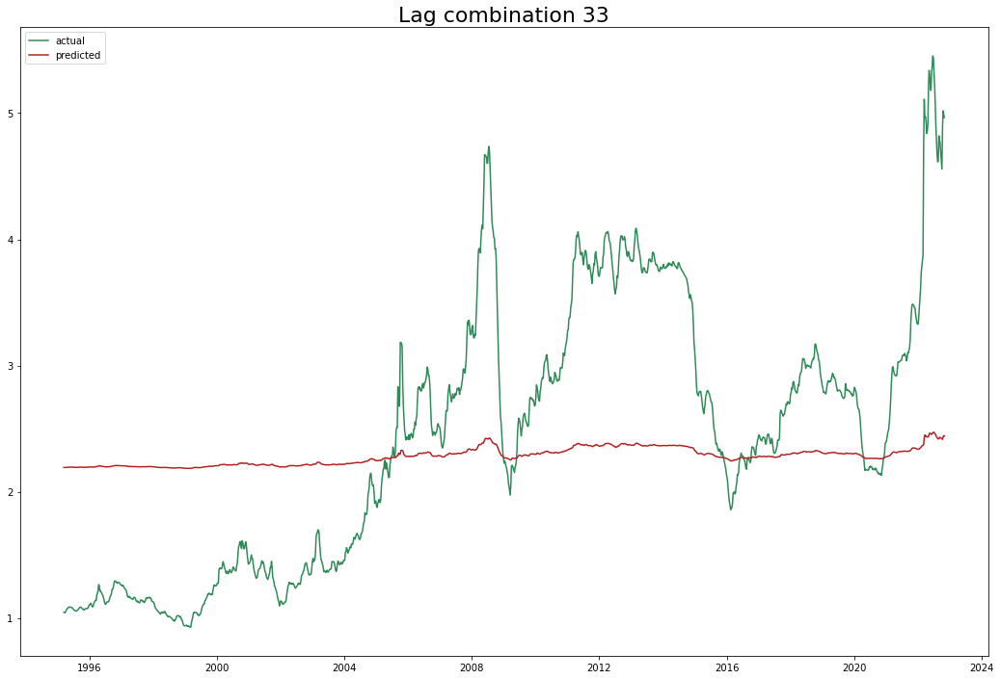

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_absolute_perc

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


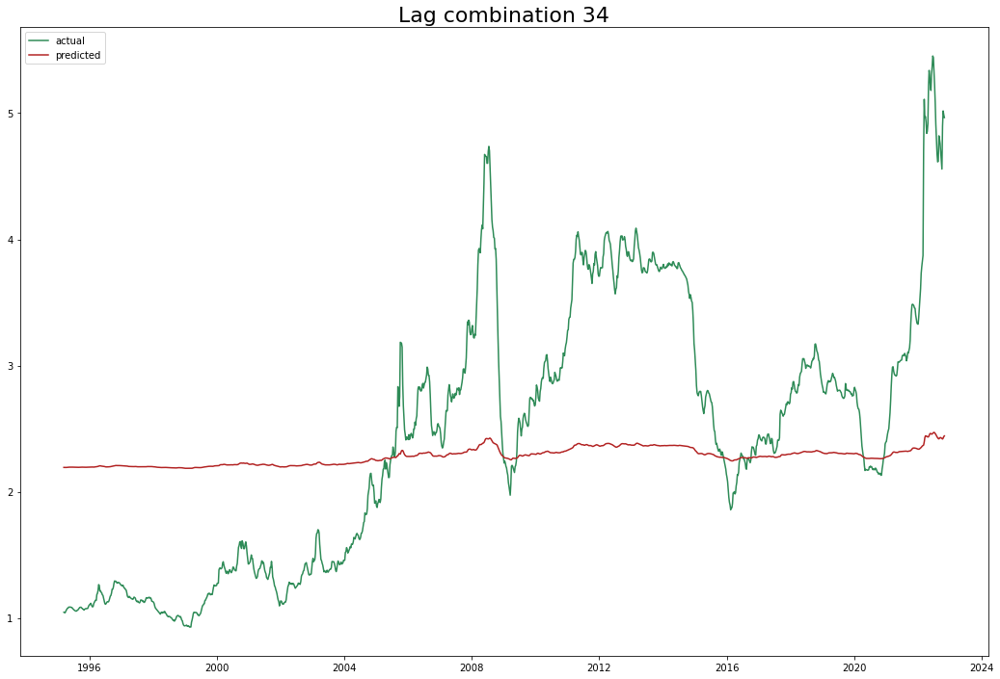

Test data rmse: 1.0467912121591687 Total rmse: 0.9843243758240073
Test data mape: 0.20892529896690293 Total mape: 0.41430672915882005
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; neg_mean_a

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


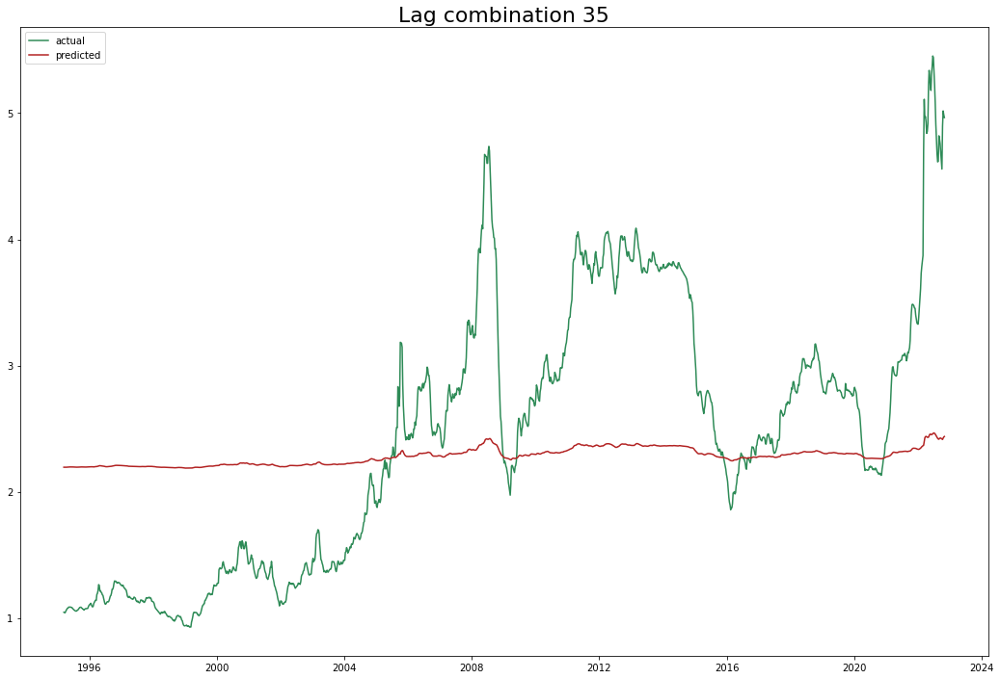

Test data rmse: 1.048127703191869 Total rmse: 0.9856775294601285
Test data mape: 0.20920069571387073 Total mape: 0.41488967785969333
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selection=cyclic; 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


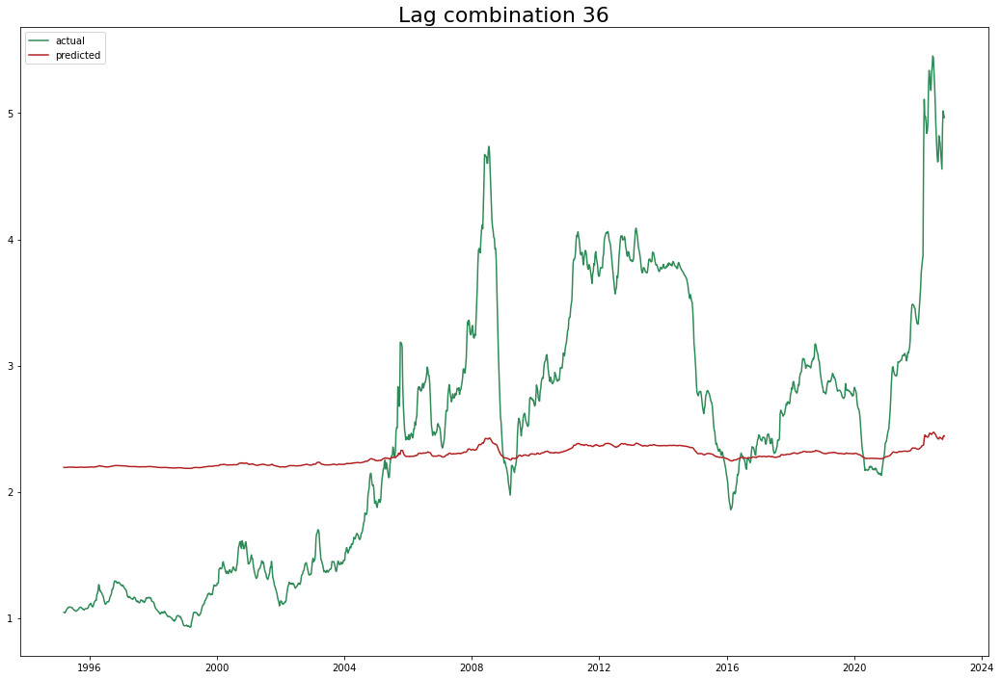

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] END selecti

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


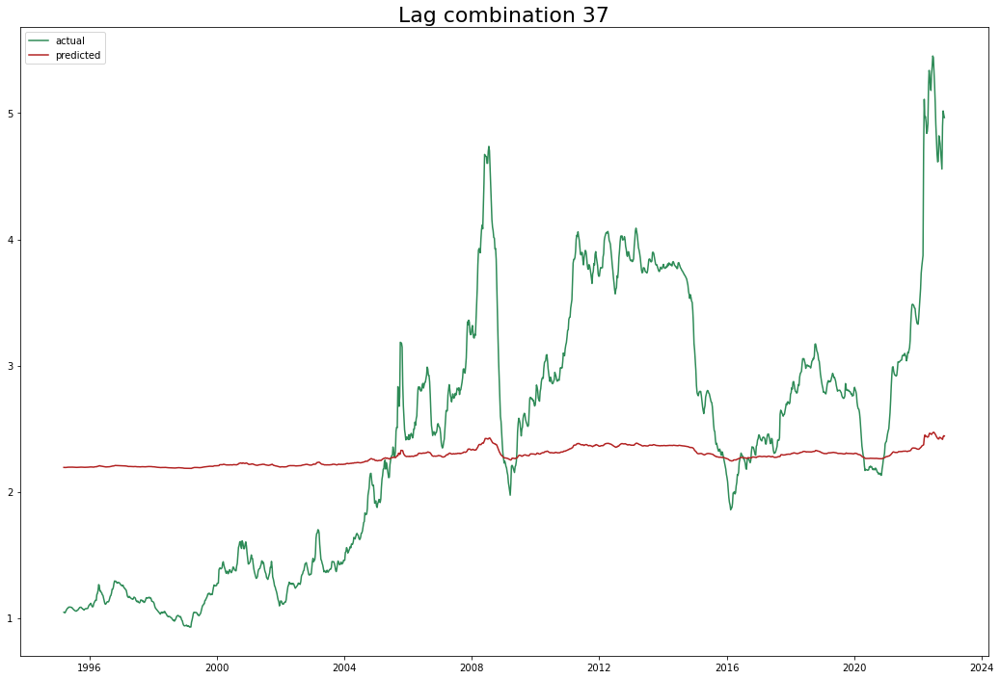

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0s
[CV 3/5] 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


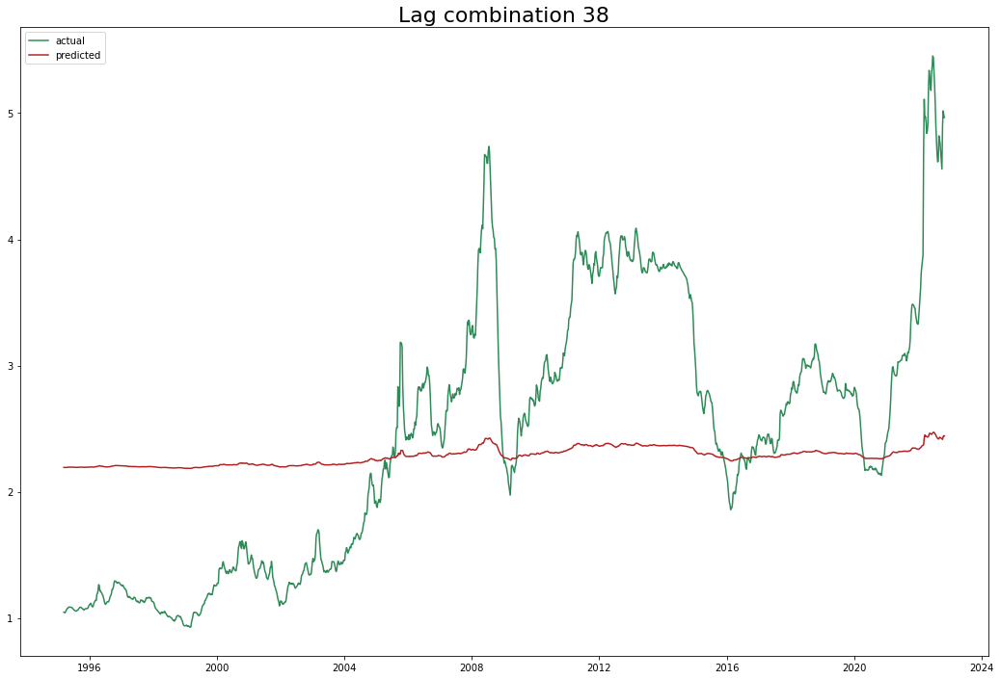

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total time=   0.0

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


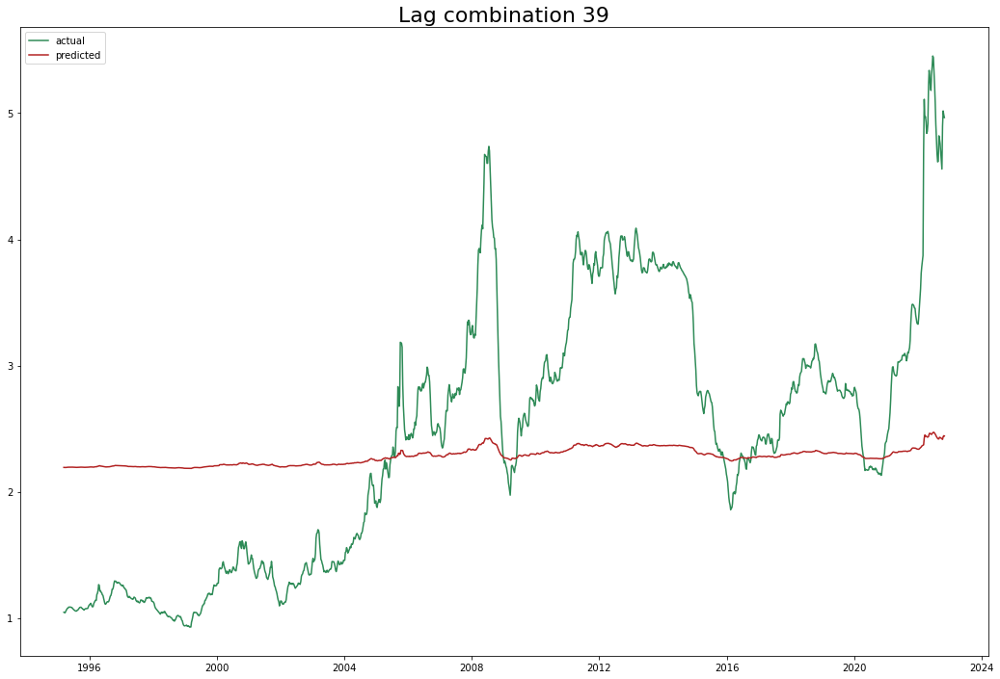

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.989) total 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


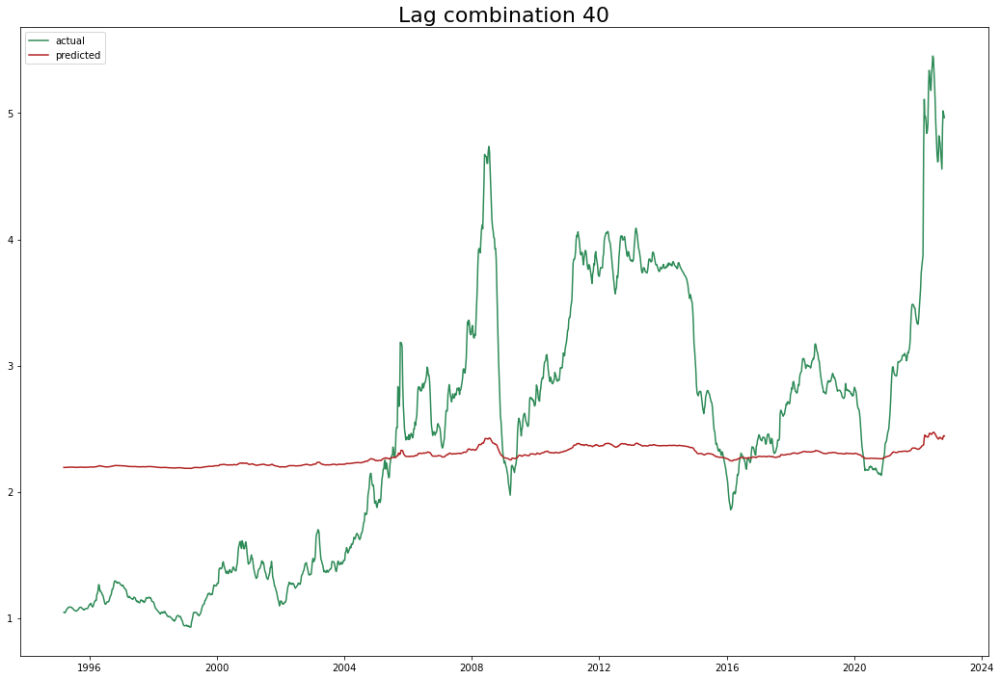

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2: (test=-1.

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


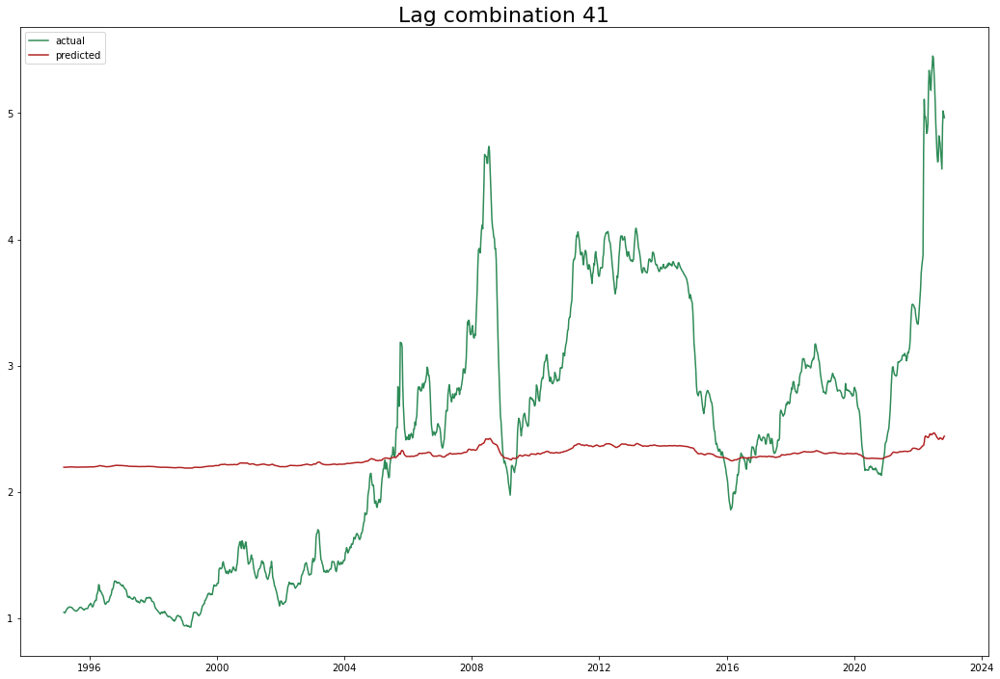

Test data rmse: 1.0481617555274374 Total rmse: 0.9856988069742214
Test data mape: 0.20920501277865347 Total mape: 0.4148978368914731
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (test=-0.803) r2

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


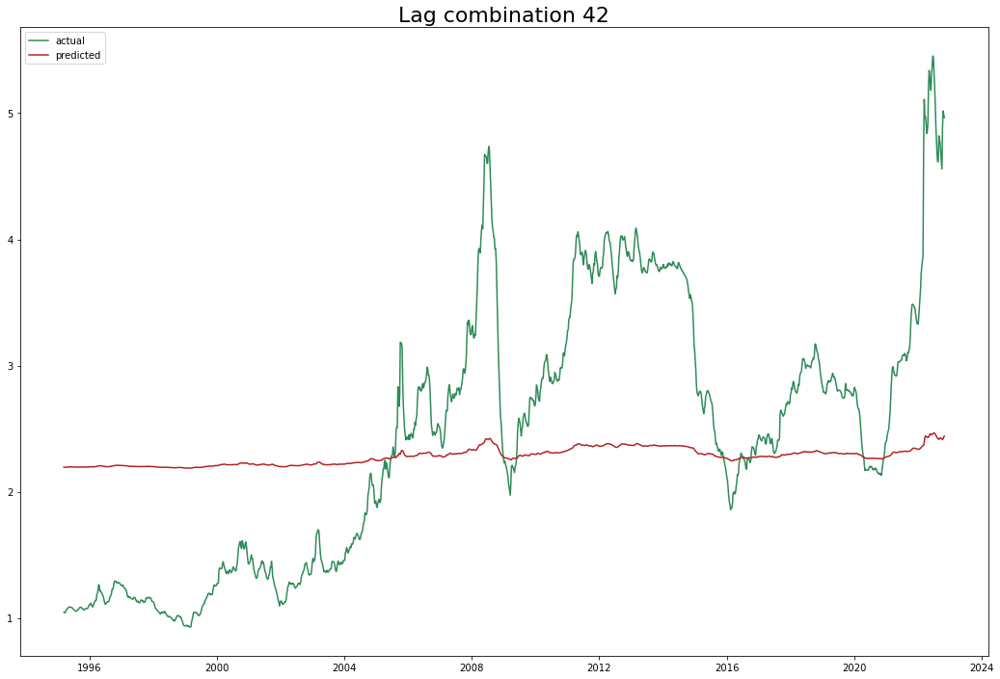

Test data rmse: 1.0481348790045064 Total rmse: 0.9856893840955736
Test data mape: 0.20920105244568588 Total mape: 0.41489617050824584
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_error: (tes

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


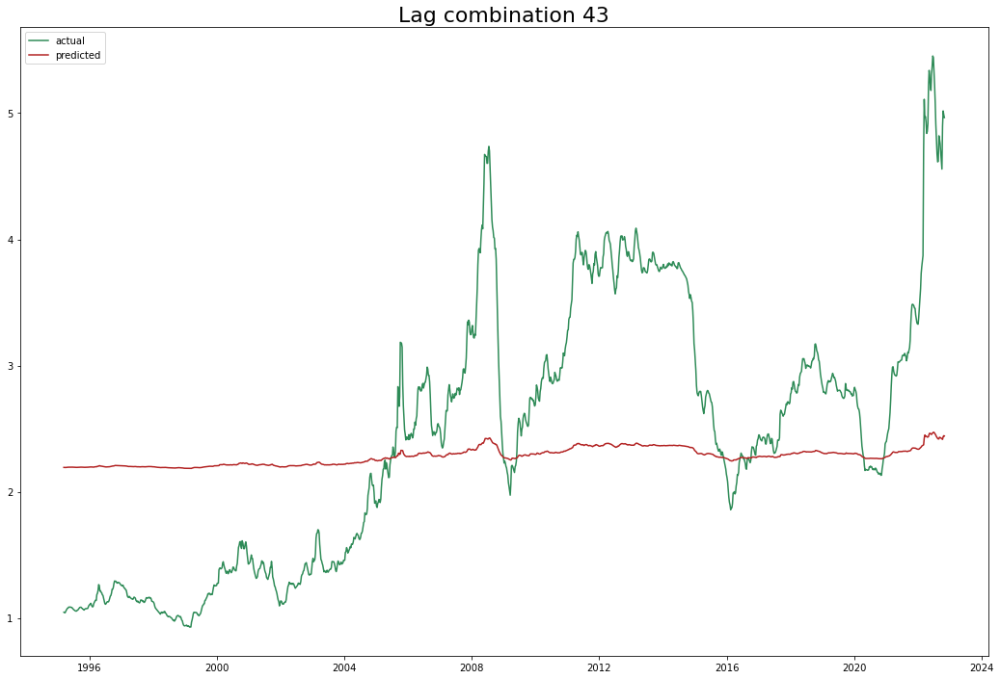

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mean_squared_e

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


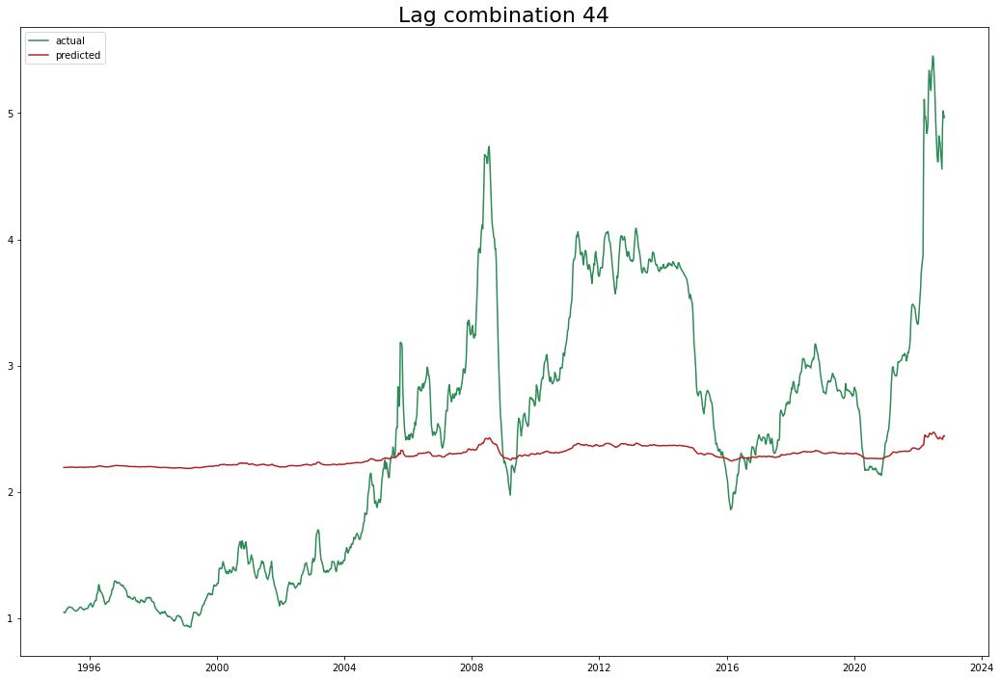

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) neg_root_mea

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


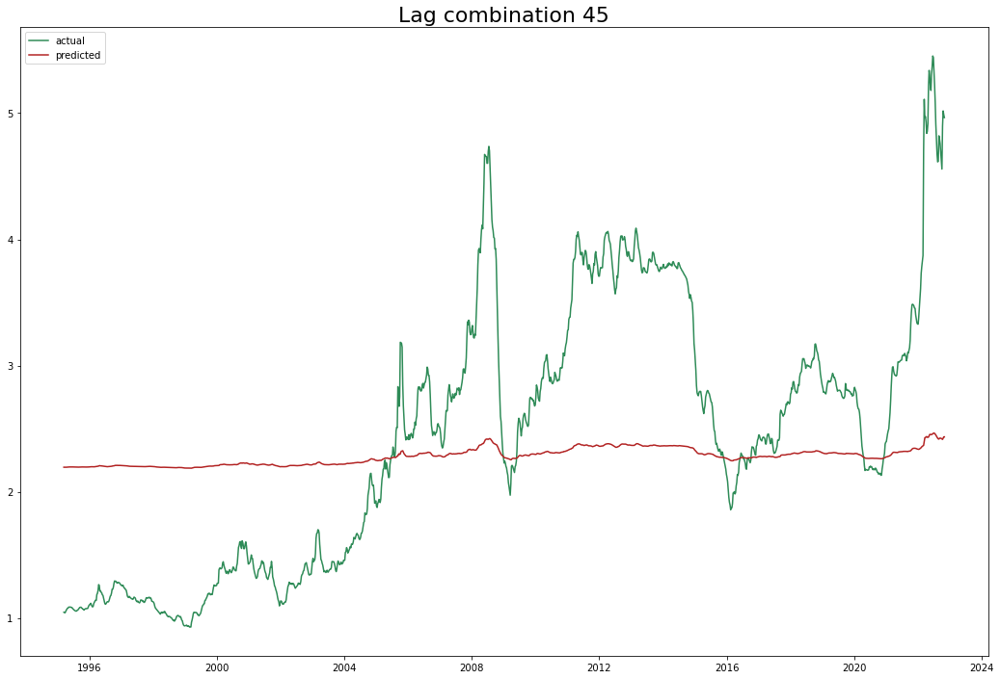

Test data rmse: 1.048236021589039 Total rmse: 0.9857073484457305
Test data mape: 0.20922076989691388 Total mape: 0.41489020770576895
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.317) n

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


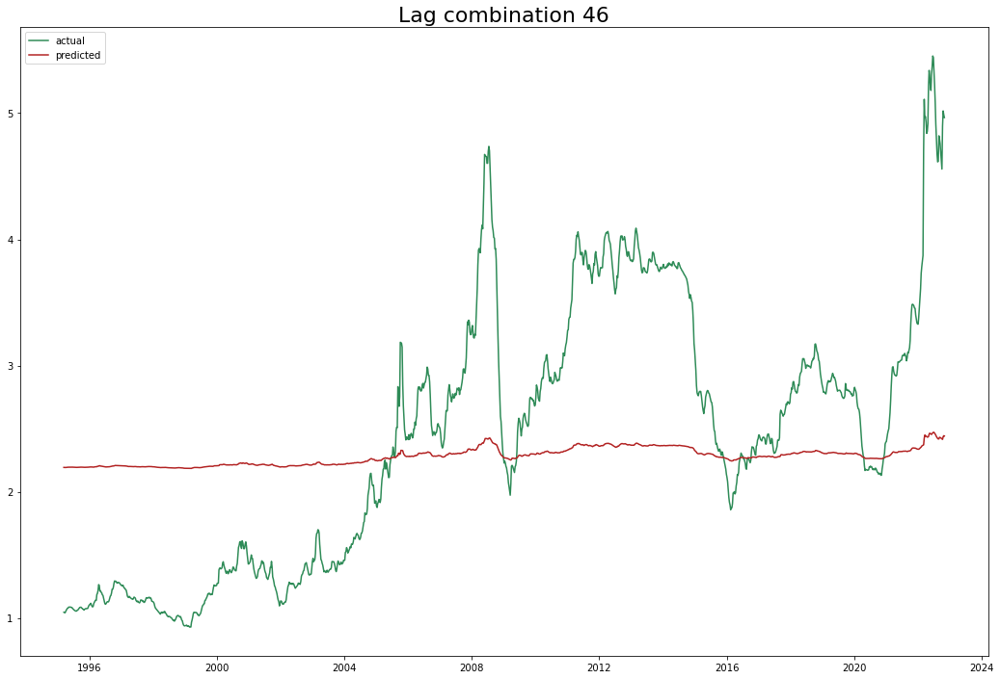

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_error: (tes

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


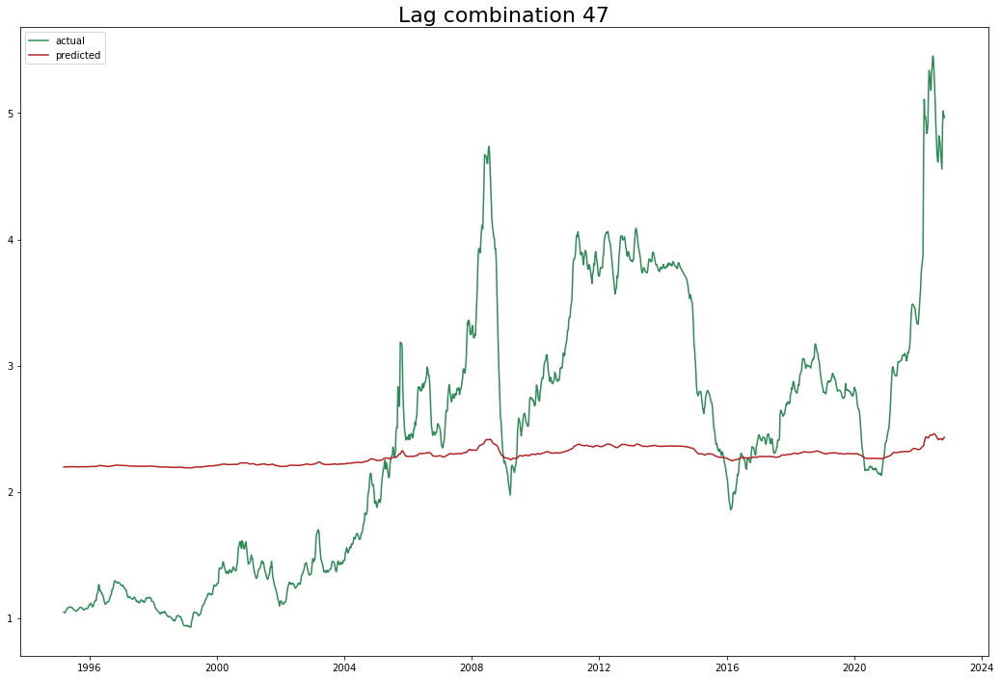

Test data rmse: 1.050364388089926 Total rmse: 0.9876482077651367
Test data mape: 0.20963624977918338 Total mape: 0.41569869540598015
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_percentage_

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


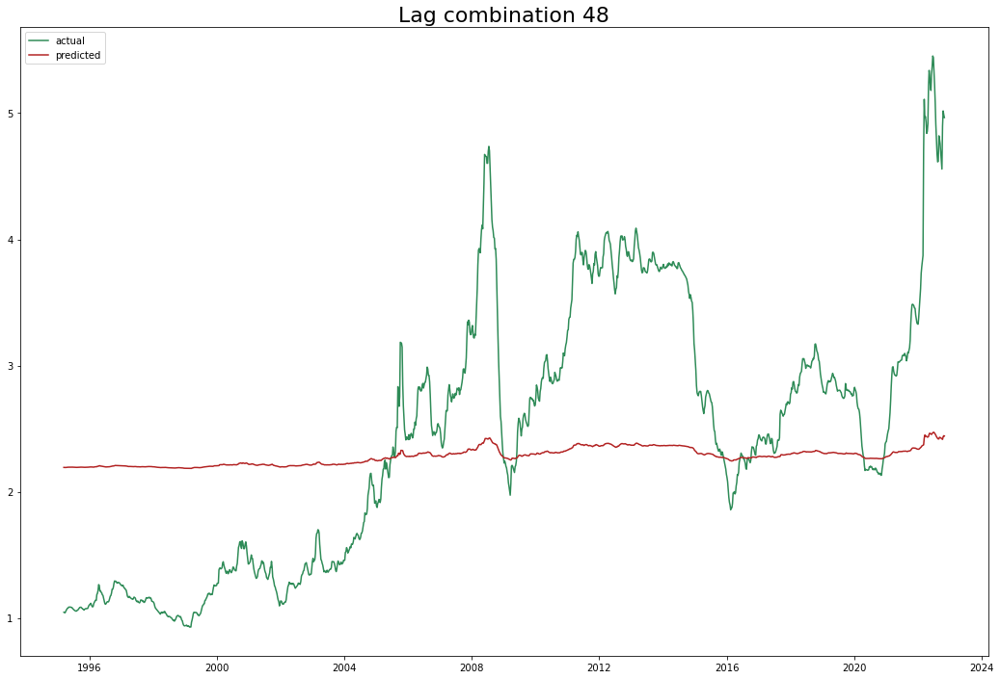

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mean_absolute_

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


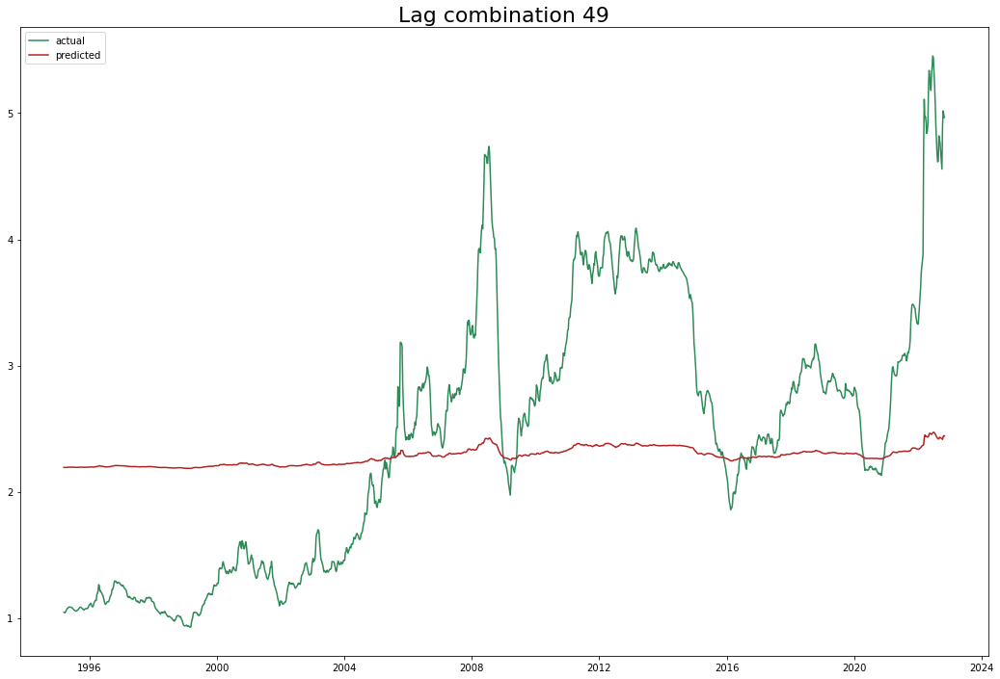

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag', '51w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END selection=cyclic; neg_mean_absolute_percentage_error: (test=-0.147) neg_root_mean_squared_error: (test=-0.232) r2: (test=-0.778) total time=   0.0s
[CV 2/5] END selection=cyclic; neg_mea

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


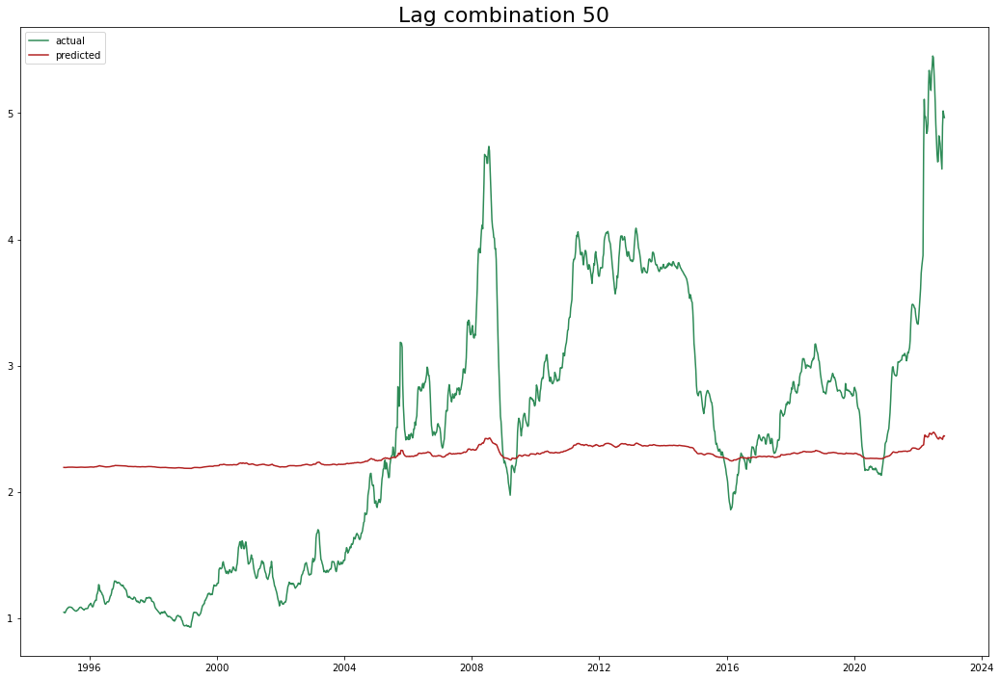

Test data rmse: 1.0461432882028505 Total rmse: 0.9841522535230186
Test data mape: 0.2088339554871024 Total mape: 0.41429799847335774
--------------------------
Next model: 
Lags choosen:  ['1w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.067) neg_root_mean_squared_error: (test=-0.107) r2: (test=0.625) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.037) neg_root_mean_squared_error: (test=-0.104) r2: (test=0.950) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.016) neg_root_mean_squared_error: (test=-0.070) r2: (test=0.989) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.990) total time=   0.0s
[CV 5/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.033) r2

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

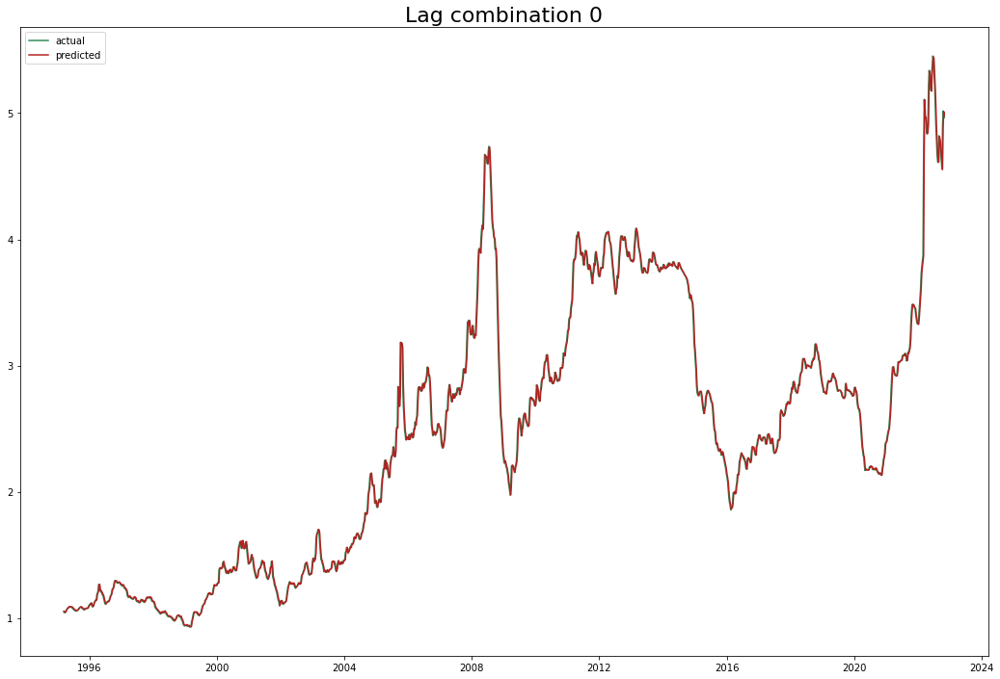

Test data rmse: 0.07554750365210572 Total rmse: 0.05204627880376389
Test data mape: 0.01042259311117227 Total mape: 0.01141147130595665
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.045) neg_root_mean_squared_error: (test=-0.073) r2: (test=0.822) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.029) neg_root_mean_squared_error: (test=-0.089) r2: (test=0.964) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.084) r2: (test=0.984) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (te

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

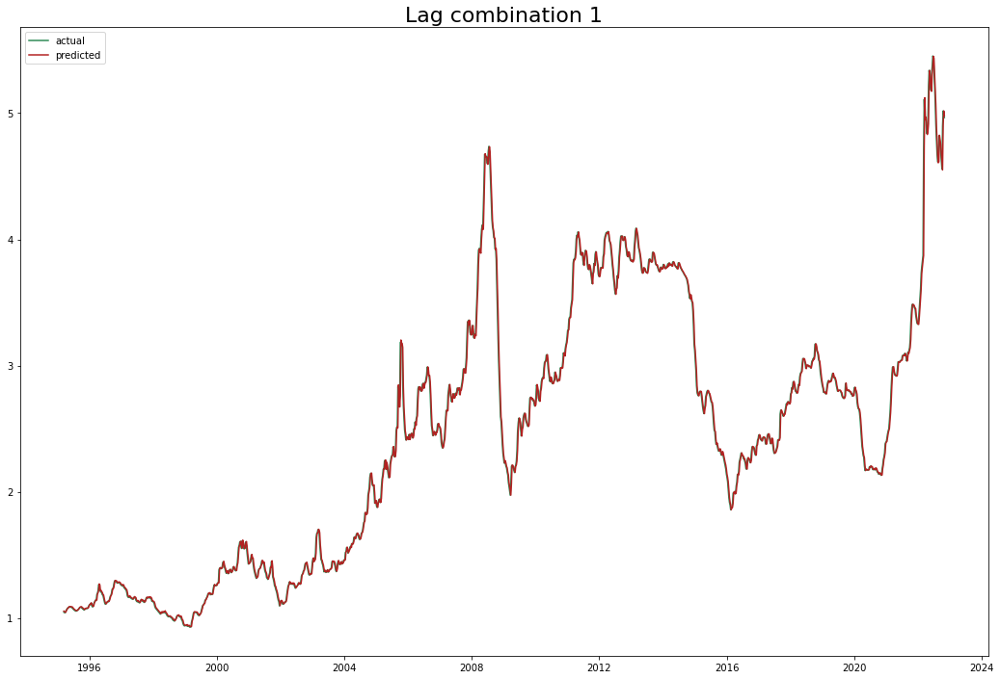

Test data rmse: 0.07421396046660156 Total rmse: 0.050982862889181094
Test data mape: 0.010176279538661225 Total mape: 0.011151896812710338
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.036) neg_root_mean_squared_error: (test=-0.061) r2: (test=0.878) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.029) neg_root_mean_squared_error: (test=-0.089) r2: (test=0.963) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.089) r2: (test=0.982) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.991) total time=   0.0s
[CV 5/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.008) neg_root_mean_squar

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

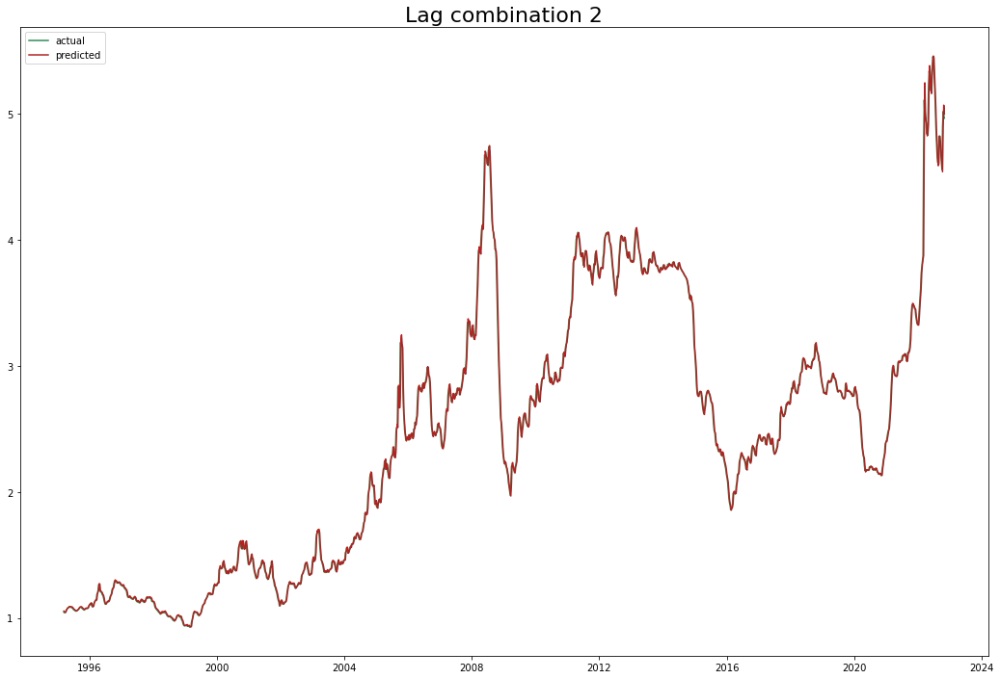

Test data rmse: 0.0750013975391575 Total rmse: 0.05039934368402542
Test data mape: 0.010113248523247473 Total mape: 0.010926840621810513
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.056) r2: (test=0.897) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.091) r2: (test=0.961) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.087) r2: (test=0.983) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.042) r2: (test=0.990) total time=   0.0s
[CV 5/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.008) neg_root_me

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

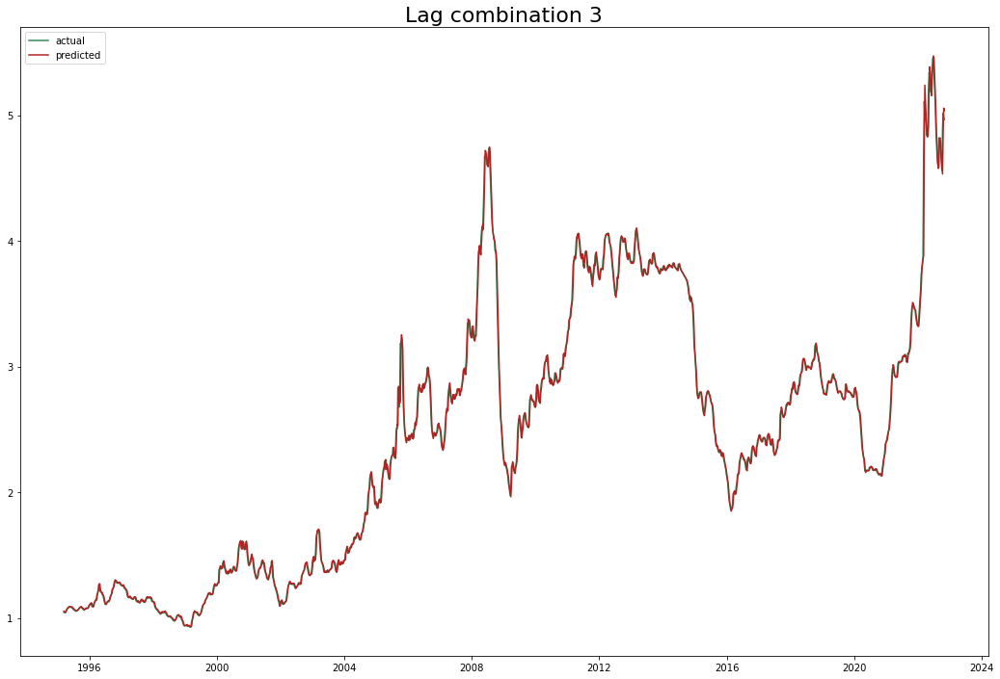

Test data rmse: 0.07618615393709115 Total rmse: 0.05065639880893147
Test data mape: 0.010355256719494166 Total mape: 0.011038166220705215
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.903) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.961) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.086) r2: (test=0.983) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.008) 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

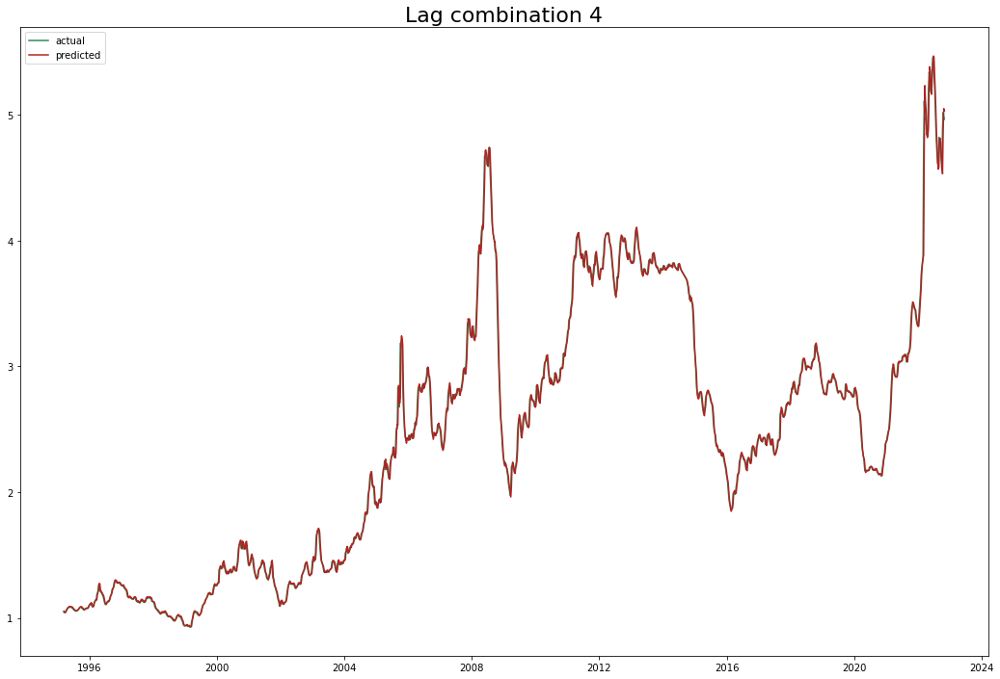

Test data rmse: 0.07645510424228849 Total rmse: 0.050793897438107846
Test data mape: 0.010454073488846147 Total mape: 0.011131520230341712
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.905) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.086) r2: (test=0.983) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END solver=auto; neg_mean_absolute_percentage_error: (te

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

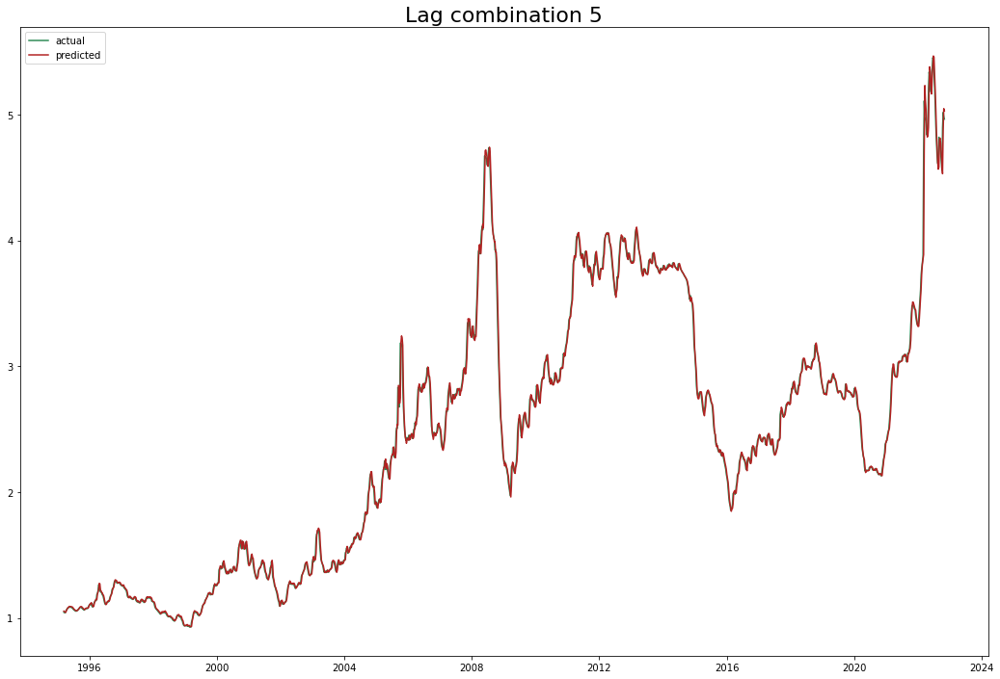

Test data rmse: 0.07644406099939566 Total rmse: 0.05080170464472004
Test data mape: 0.010455465107219834 Total mape: 0.011135567409894244
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.906) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.020) neg_root_mean_squared_error: (test=-0.087) r2: (test=0.983) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END solver=auto; neg_mean_absolute_percentage_e

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

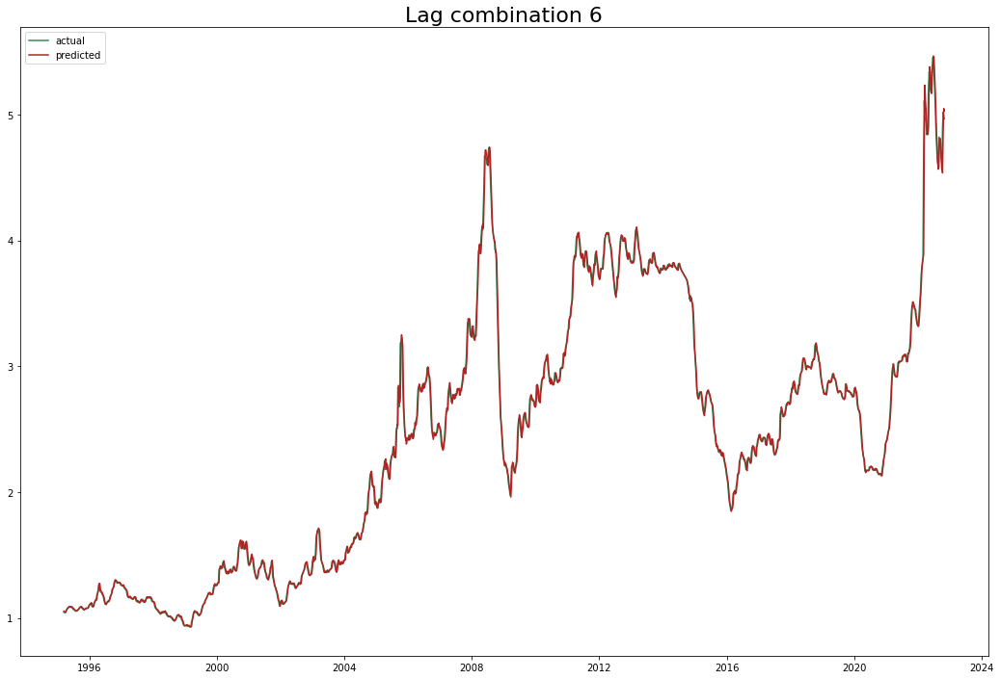

Test data rmse: 0.07624265123579763 Total rmse: 0.05072585449876196
Test data mape: 0.010426620151139564 Total mape: 0.011127163035099988
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.906) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.087) r2: (test=0.983) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END solver=auto; neg_mean_absolute_pe

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

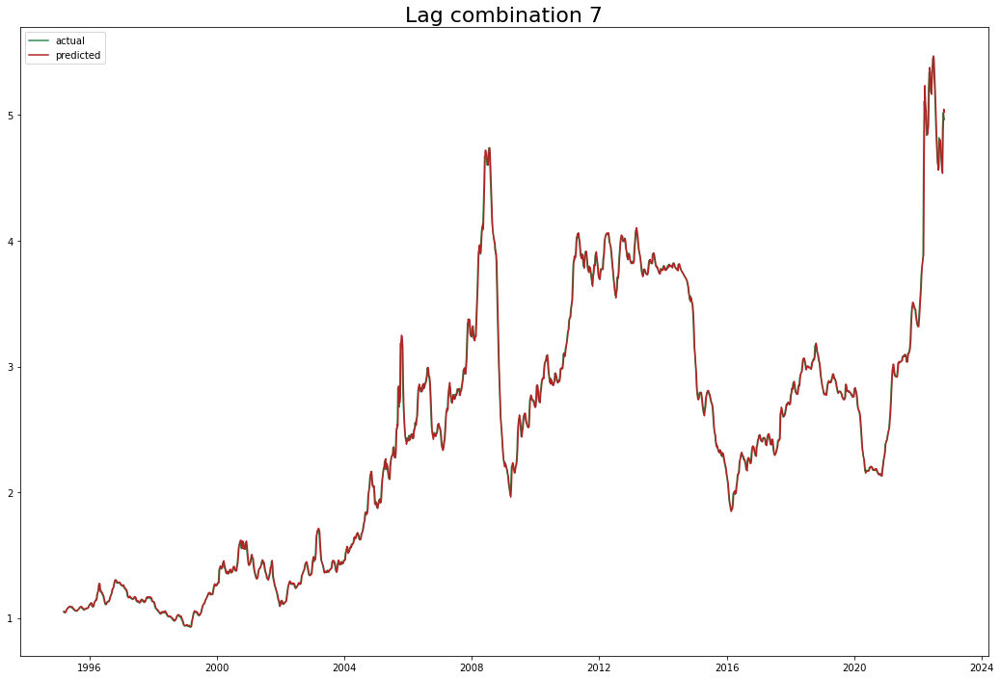

Test data rmse: 0.07578782522038191 Total rmse: 0.050544573194396085
Test data mape: 0.010374250187345918 Total mape: 0.011116514892761635
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.906) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.088) r2: (test=0.982) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END solver=auto; neg_mean_

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

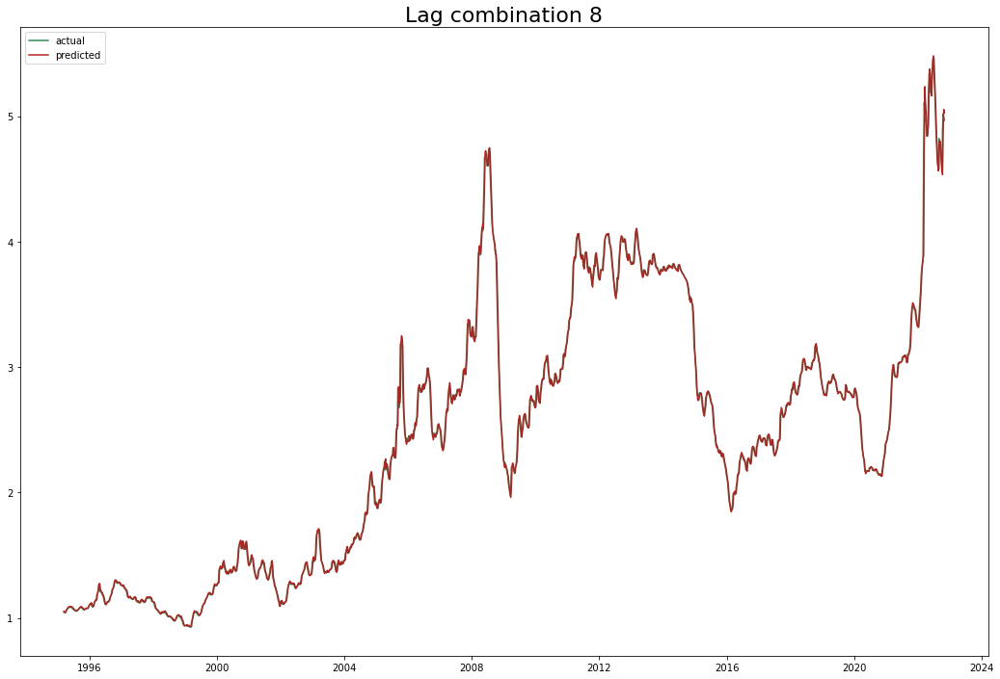

Test data rmse: 0.07548148056515354 Total rmse: 0.05044576150181988
Test data mape: 0.01035889284329332 Total mape: 0.011118154658332095
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.021) neg_root_mean_squared_error: (test=-0.090) r2: (test=0.982) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END solver=auto; 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

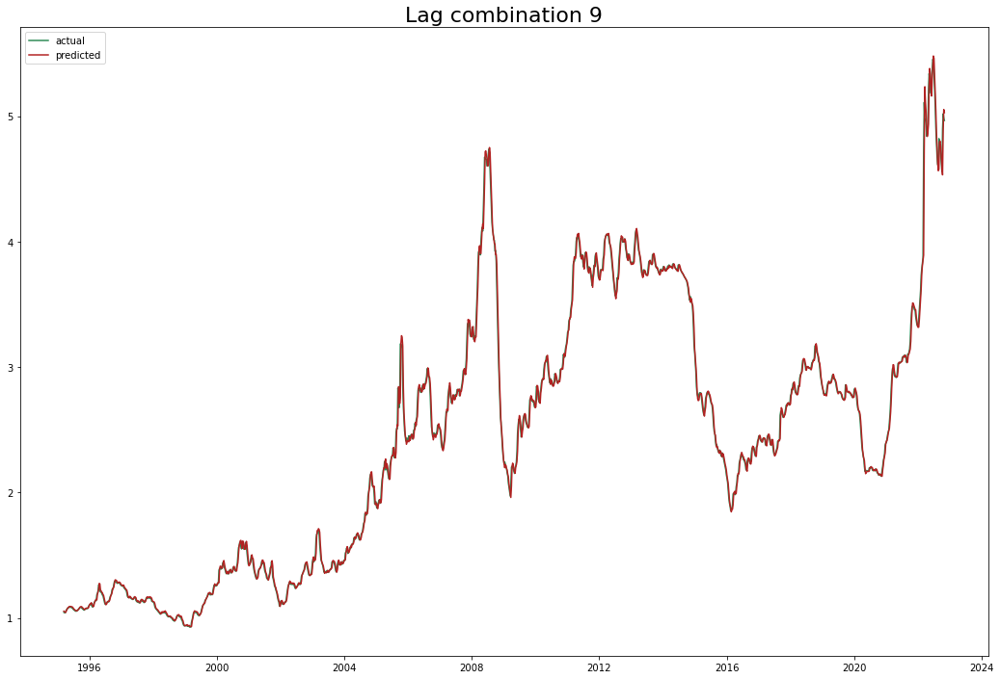

Test data rmse: 0.07553837921492669 Total rmse: 0.05046688624266075
Test data mape: 0.01036569357874978 Total mape: 0.011127869082492881
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.022) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.981) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.043) r2: (test=0.990) total time=   0.0s
[CV 5/5] END so

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

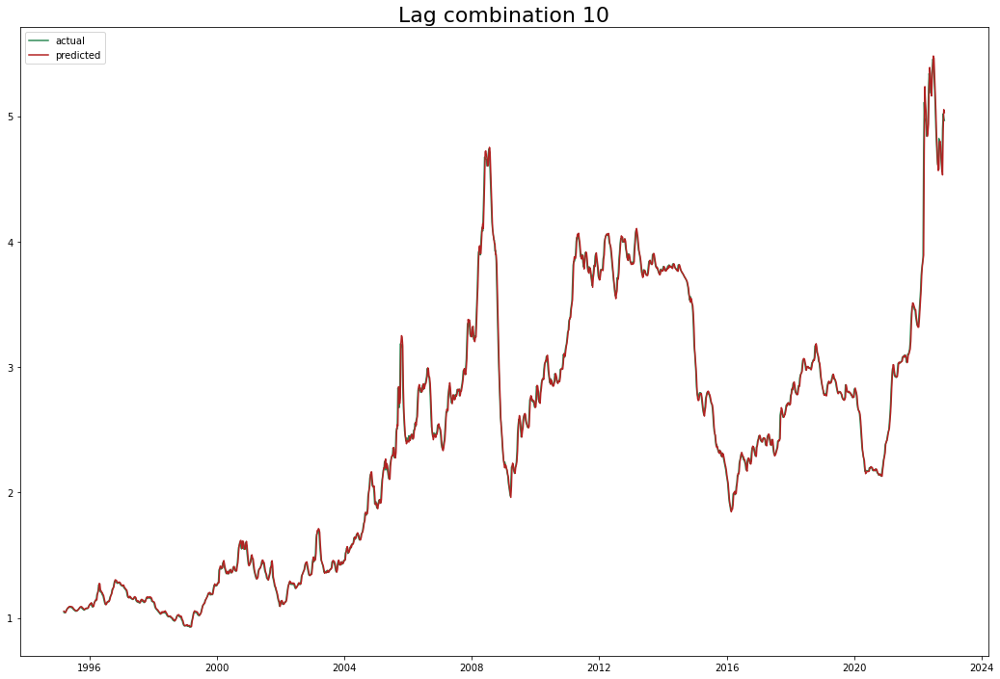

Test data rmse: 0.0756447842095971 Total rmse: 0.05049953987884998
Test data mape: 0.010381626518859797 Total mape: 0.011134630499944795
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.023) neg_root_mean_squared_error: (test=-0.094) r2: (test=0.980) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time=   0.0s
[CV 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

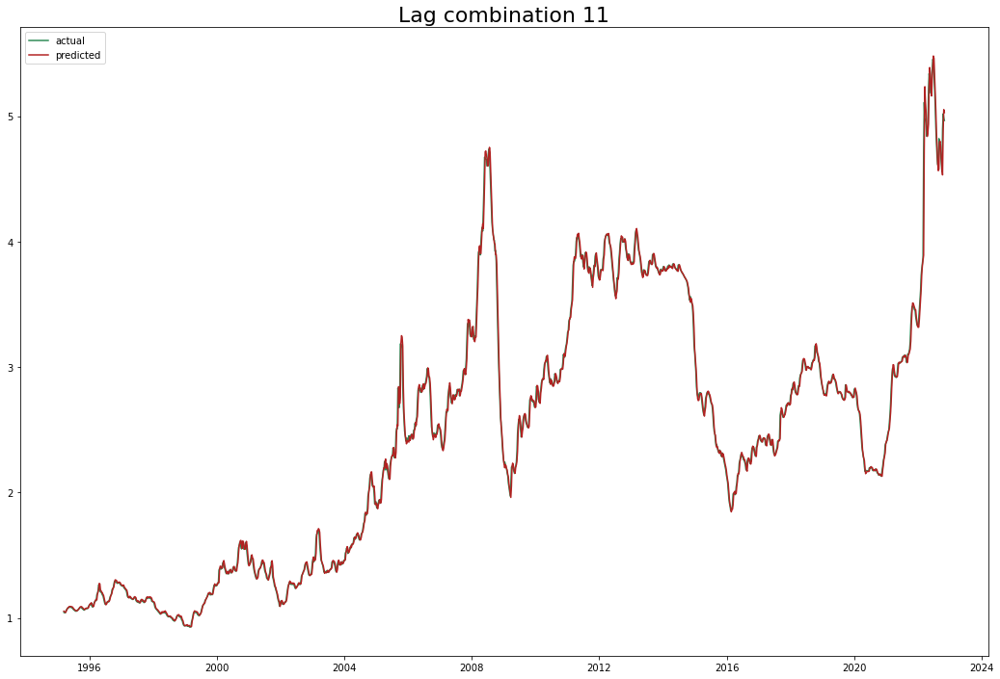

Test data rmse: 0.07560498968282016 Total rmse: 0.050486360848313414
Test data mape: 0.010377086621755741 Total mape: 0.011133881922903004
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.023) neg_root_mean_squared_error: (test=-0.096) r2: (test=0.979) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) total time

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

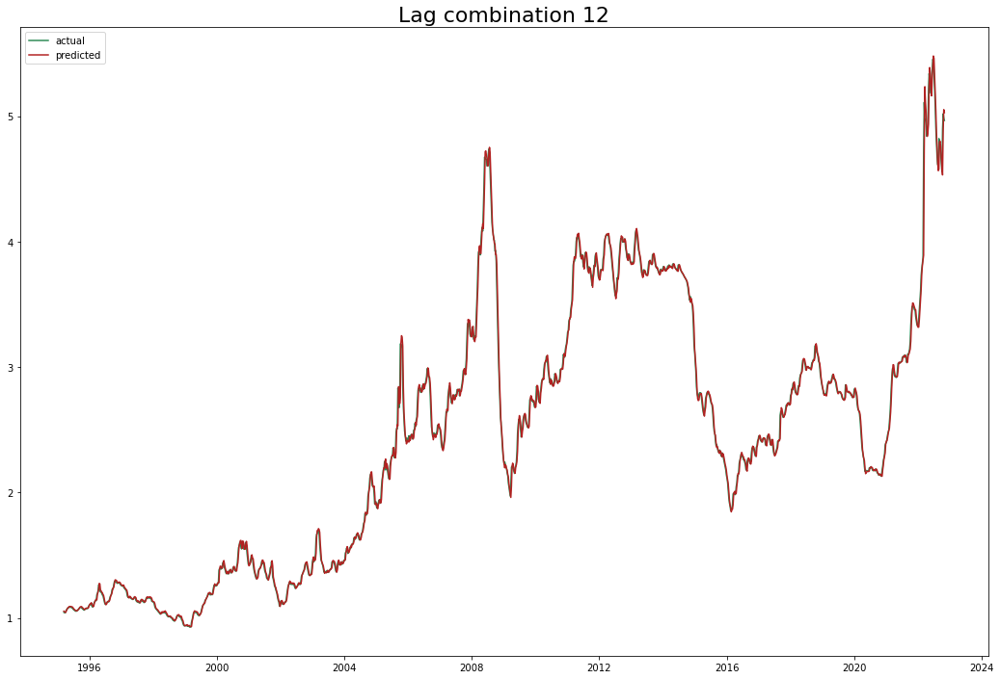

Test data rmse: 0.07560733092252295 Total rmse: 0.05048644122466044
Test data mape: 0.010376851102069547 Total mape: 0.011134347171991636
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.098) r2: (test=0.978) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.044) r2: (test=0.990) 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

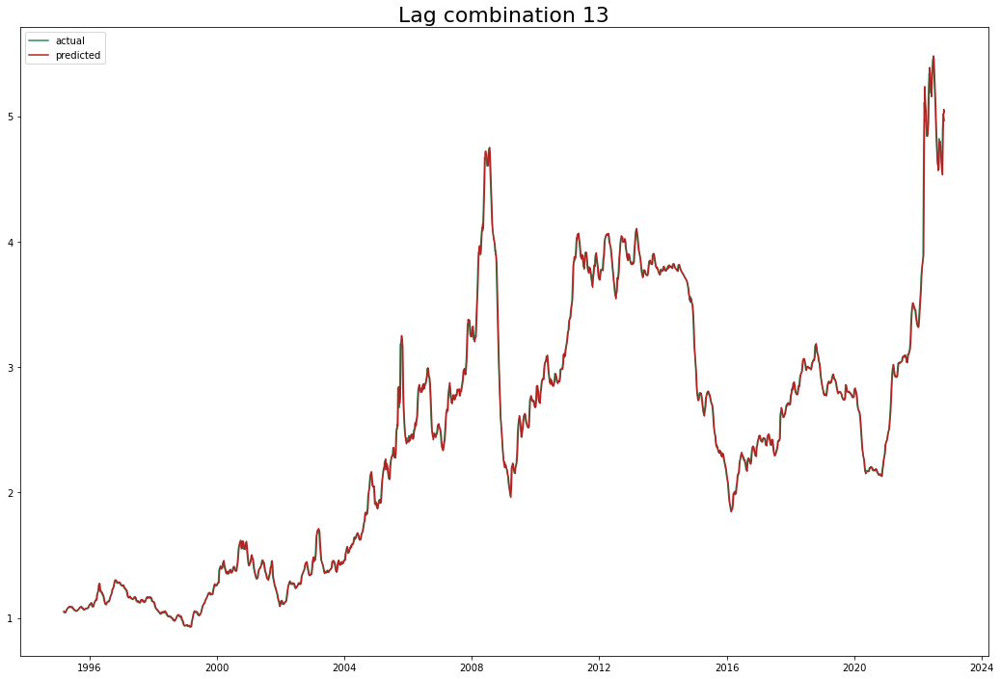

Test data rmse: 0.07564977810133353 Total rmse: 0.05049640793463477
Test data mape: 0.010384799790755204 Total mape: 0.011135548042806627
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.099) r2: (test=0.978) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.044) r2: (t

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

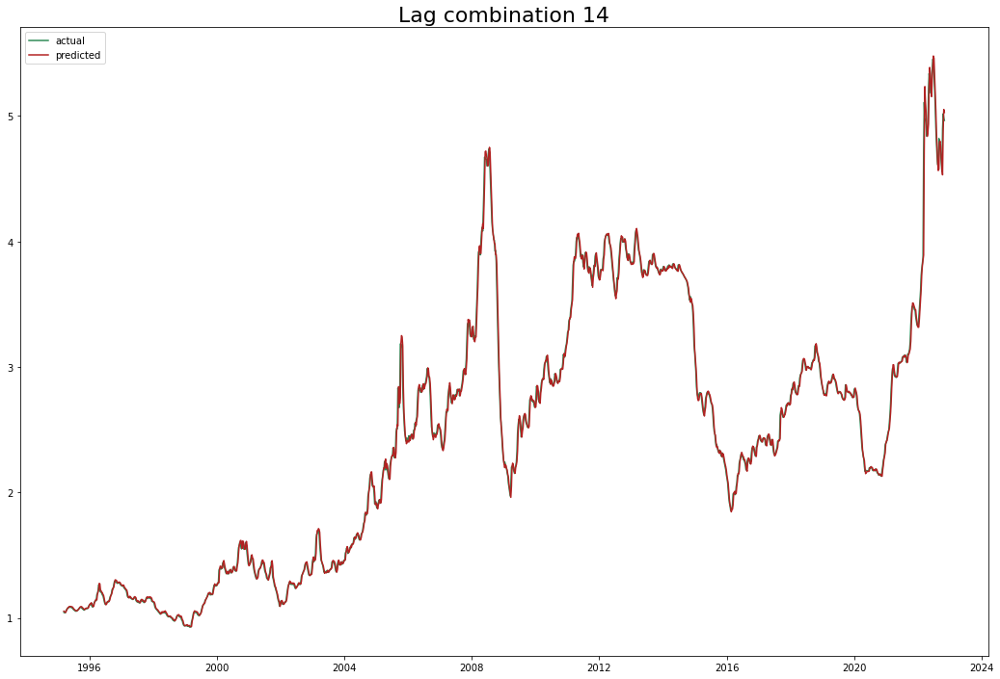

Test data rmse: 0.07564358187401653 Total rmse: 0.05049414815073966
Test data mape: 0.010383596910779752 Total mape: 0.011134375305923355
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.961) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.100) r2: (test=0.978) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error: (test=-0.

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

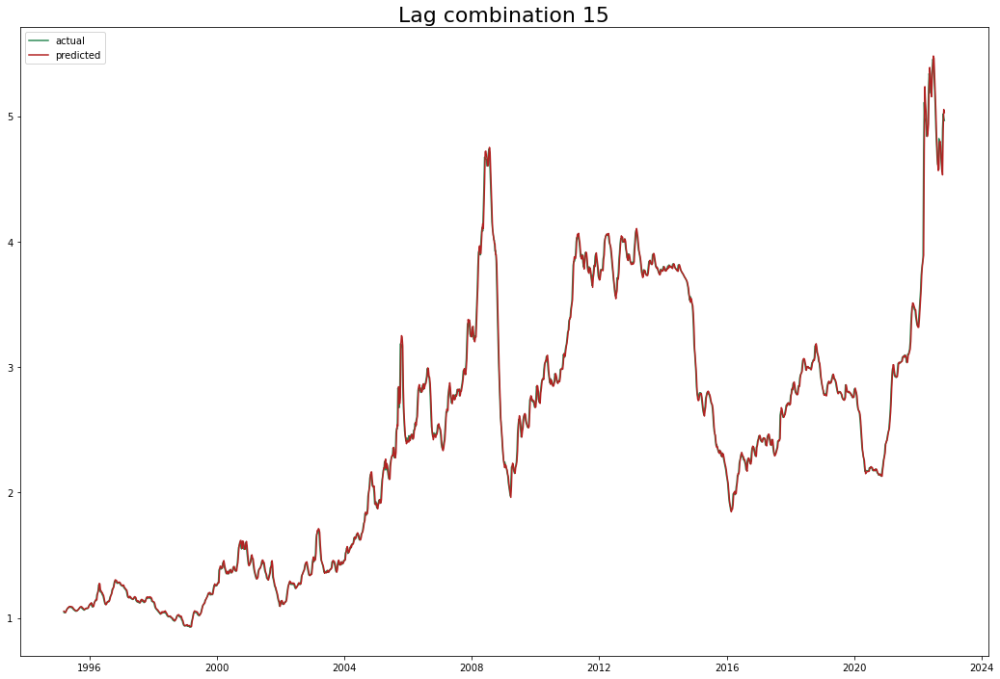

Test data rmse: 0.07563804585351346 Total rmse: 0.05049242600726958
Test data mape: 0.010382218937703216 Total mape: 0.011133632624124621
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.961) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.024) neg_root_mean_squared_error: (test=-0.101) r2: (test=0.977) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_squared_error

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

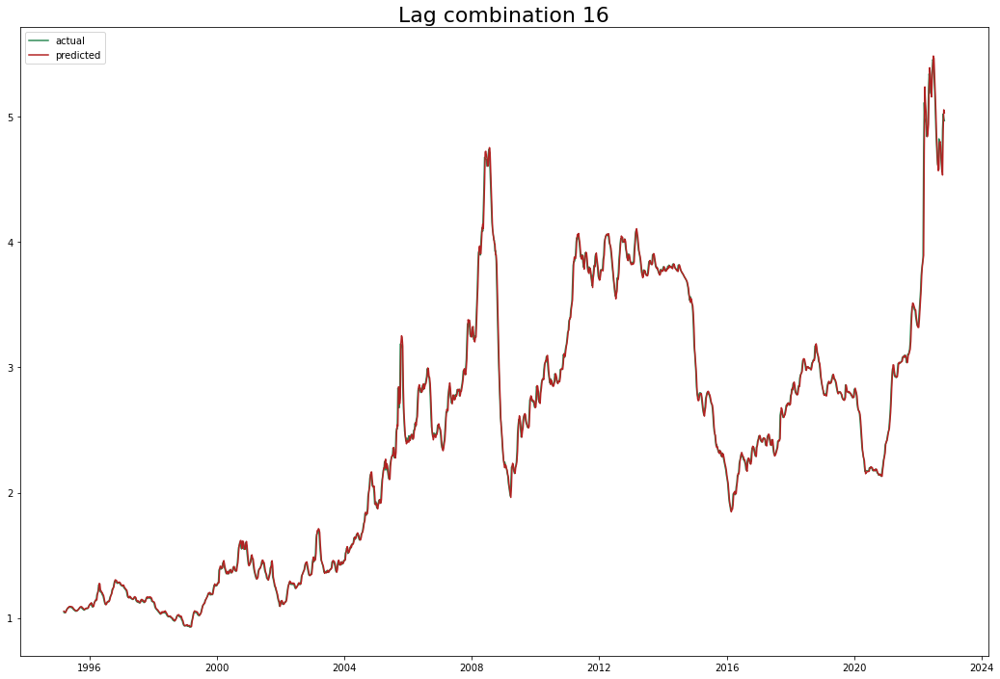

Test data rmse: 0.07563213416693328 Total rmse: 0.050490511365142335
Test data mape: 0.010379267868164257 Total mape: 0.01113269193530304
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.961) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.025) neg_root_mean_squared_error: (test=-0.102) r2: (test=0.977) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_root_mean_sq

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

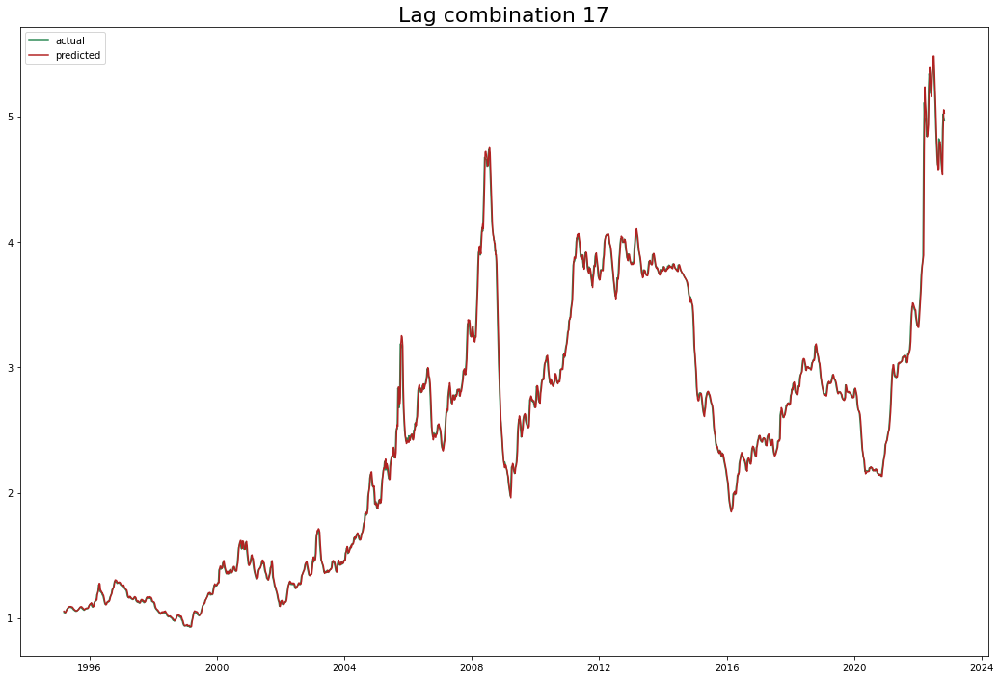

Test data rmse: 0.07562875986522259 Total rmse: 0.05046911878506873
Test data mape: 0.010376101617994533 Total mape: 0.011124413953507297
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.961) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.025) neg_root_mean_squared_error: (test=-0.103) r2: (test=0.976) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.009) neg_r

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

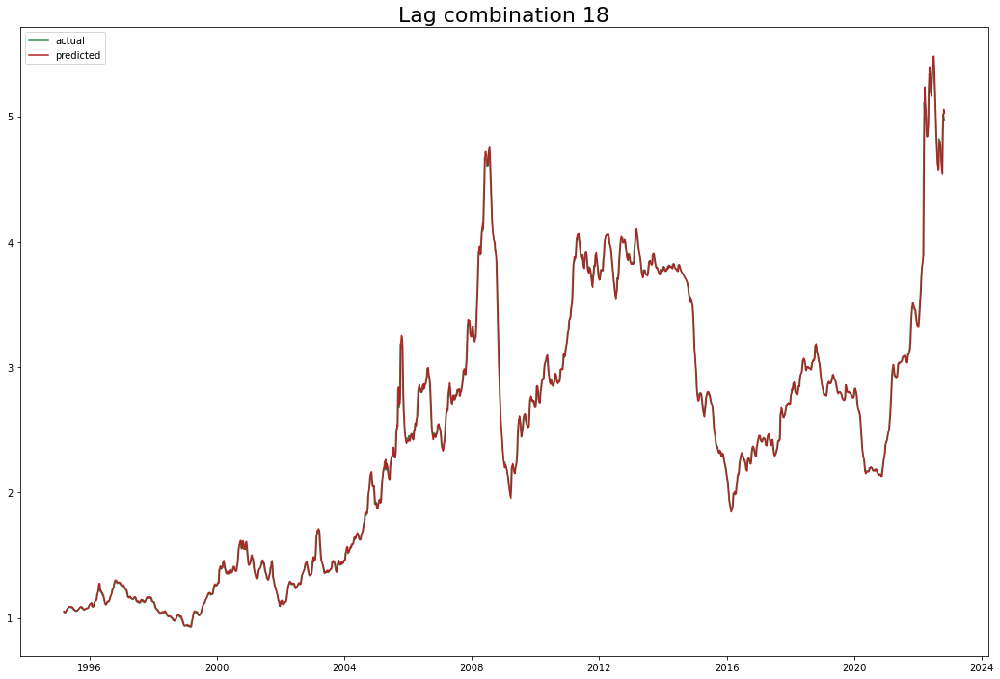

Test data rmse: 0.07573489791297124 Total rmse: 0.05048166561477576
Test data mape: 0.0104061891275622 Total mape: 0.011114284642308054
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.961) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.025) neg_root_mean_squared_error: (test=-0.104) r2: (test=0.976) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.0

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

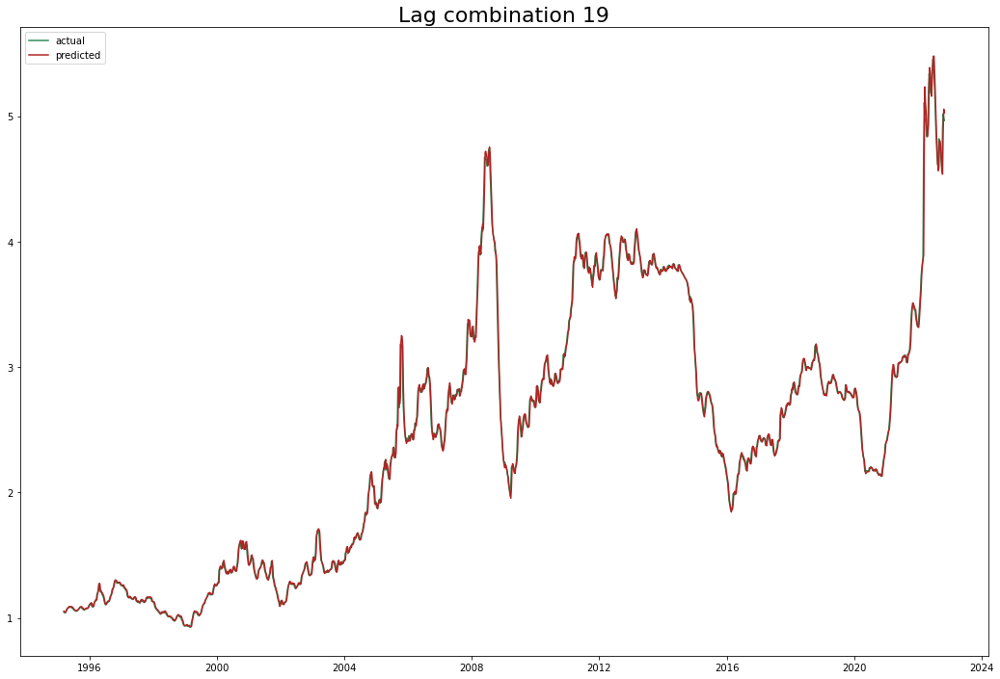

Test data rmse: 0.07574486935988888 Total rmse: 0.0504859180061976
Test data mape: 0.010408148859919485 Total mape: 0.011114842213789373
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.961) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squared_error: (test=-0.106) r2: (test=0.974) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_percentage_error

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

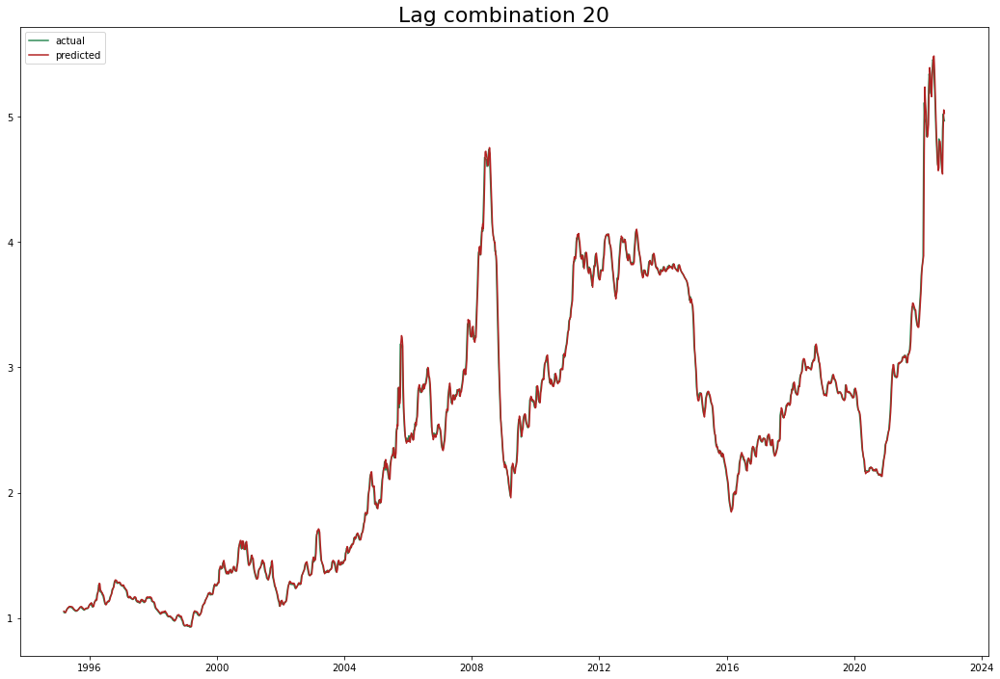

Test data rmse: 0.07563167714537905 Total rmse: 0.05040333931506886
Test data mape: 0.01040045824253004 Total mape: 0.011122106096238437
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.108) r2: (test=0.974) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_absolute_perce

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

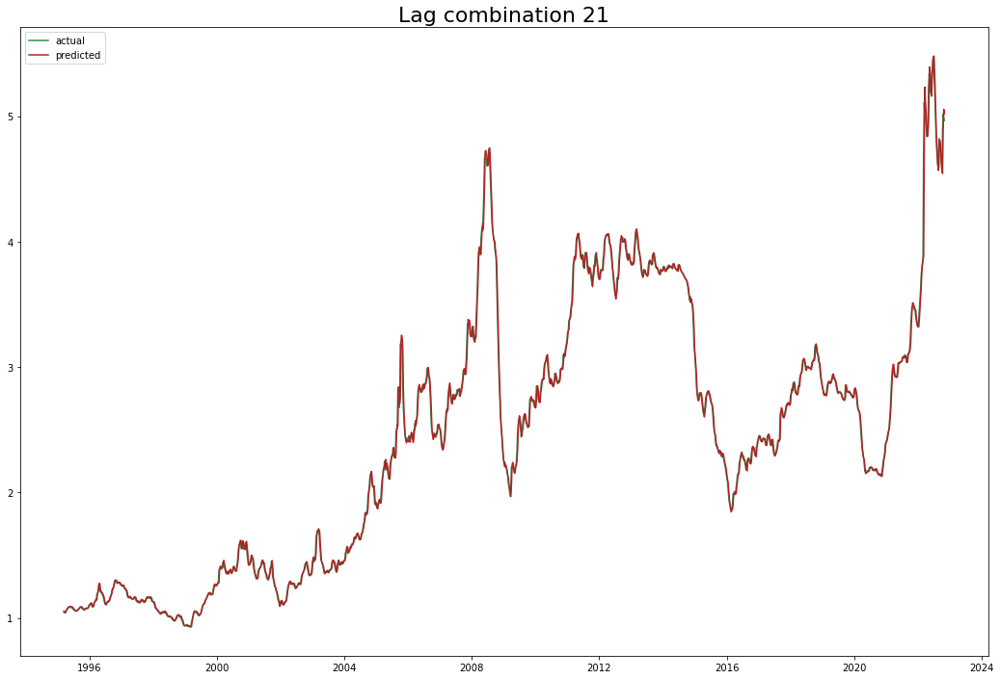

Test data rmse: 0.07580348771879646 Total rmse: 0.0504043166108158
Test data mape: 0.010438680976955198 Total mape: 0.011168040861729548
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.973) total time=   0.0s
[CV 4/5] END solver=auto; neg_mean_abs

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

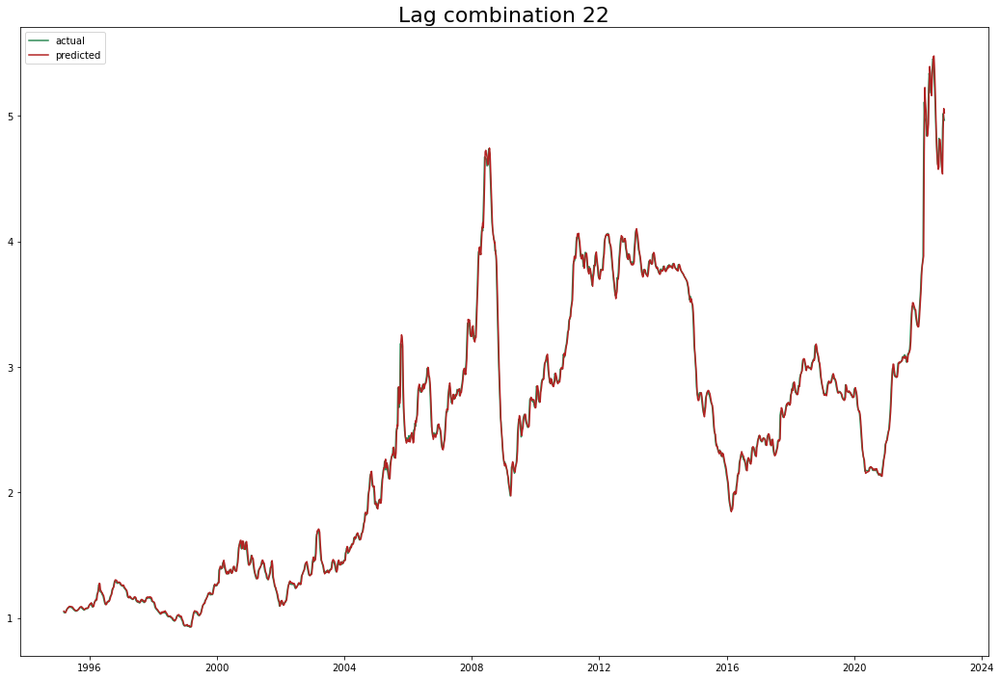

Test data rmse: 0.07605502750926155 Total rmse: 0.050445563439977414
Test data mape: 0.010499552907359716 Total mape: 0.011200031390290095
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.092) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.973) total time=   0.0s
[CV 4/5] END solver=auto;

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

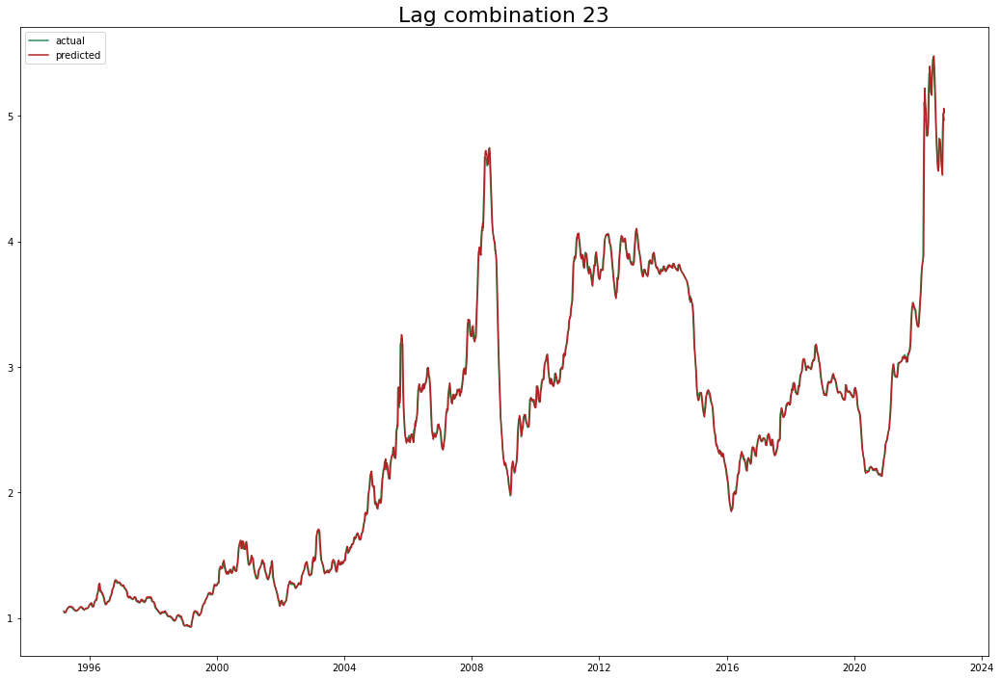

Test data rmse: 0.0762141136526093 Total rmse: 0.05049241348289483
Test data mape: 0.010546905294483967 Total mape: 0.011223387711773548
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.109) r2: (test=0.973) total time=   0.0s
[CV 4/5] END sol

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

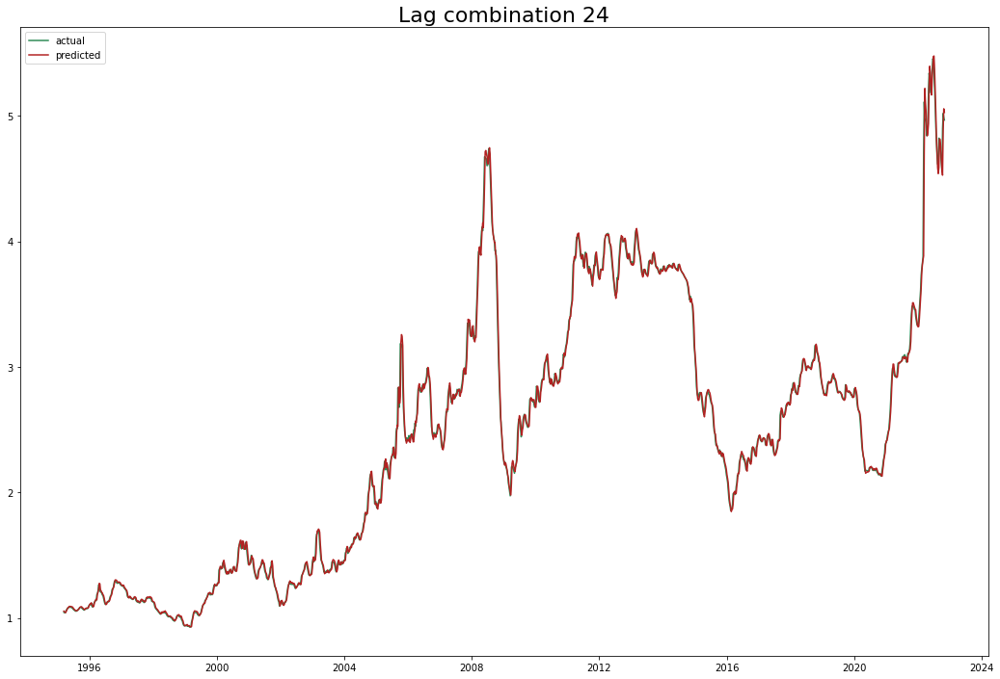

Test data rmse: 0.07632423432612097 Total rmse: 0.050526054873069326
Test data mape: 0.01058565285825699 Total mape: 0.011245996759375473
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.030) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.027) neg_root_mean_squared_error: (test=-0.108) r2: (test=0.973) total time=   0.0s
[CV 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

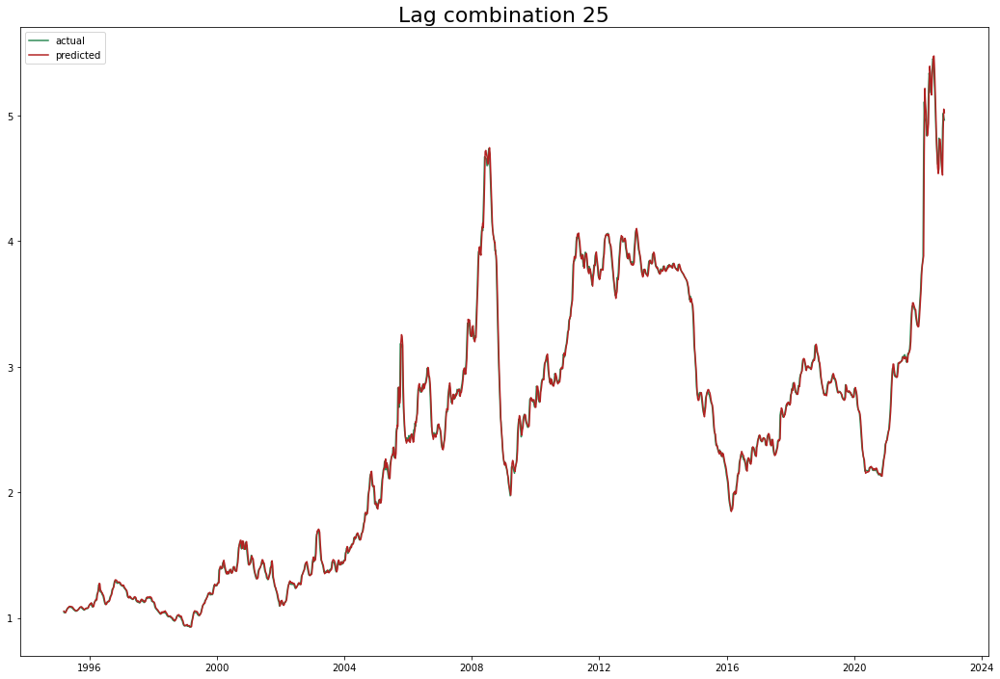

Test data rmse: 0.07635123516542311 Total rmse: 0.05053731590216828
Test data mape: 0.010584321133621045 Total mape: 0.011252127059102581
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squared_error: (test=-0.108) r2: (test=0.974) total time= 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

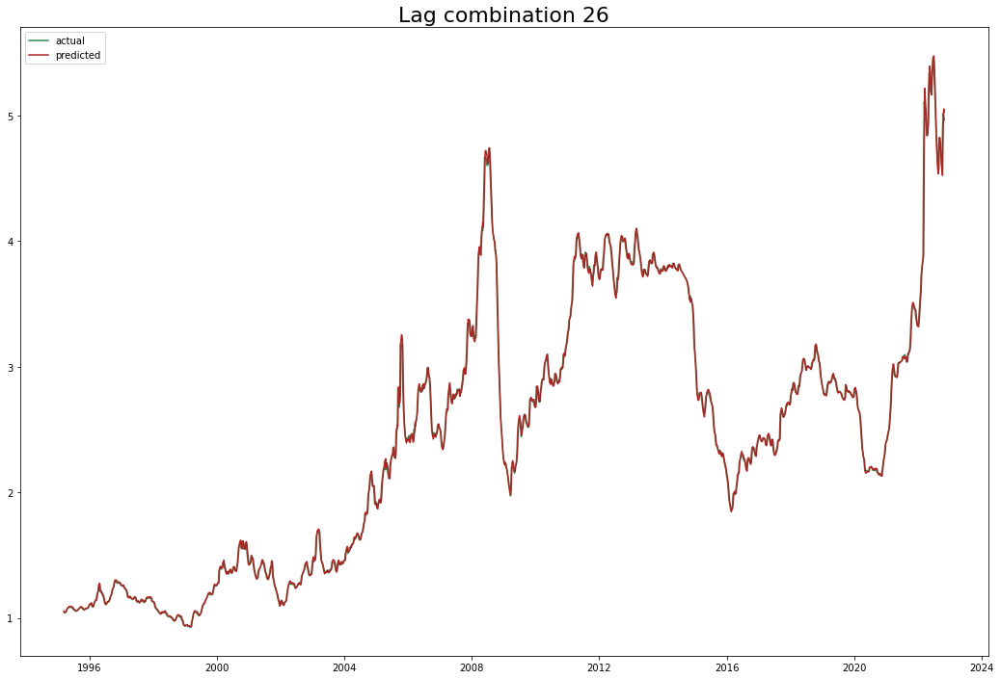

Test data rmse: 0.07648804558502997 Total rmse: 0.050557936461258356
Test data mape: 0.010617932791330026 Total mape: 0.011250843568497678
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squared_error: (test=-0.107) r2: (test=0.974) 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

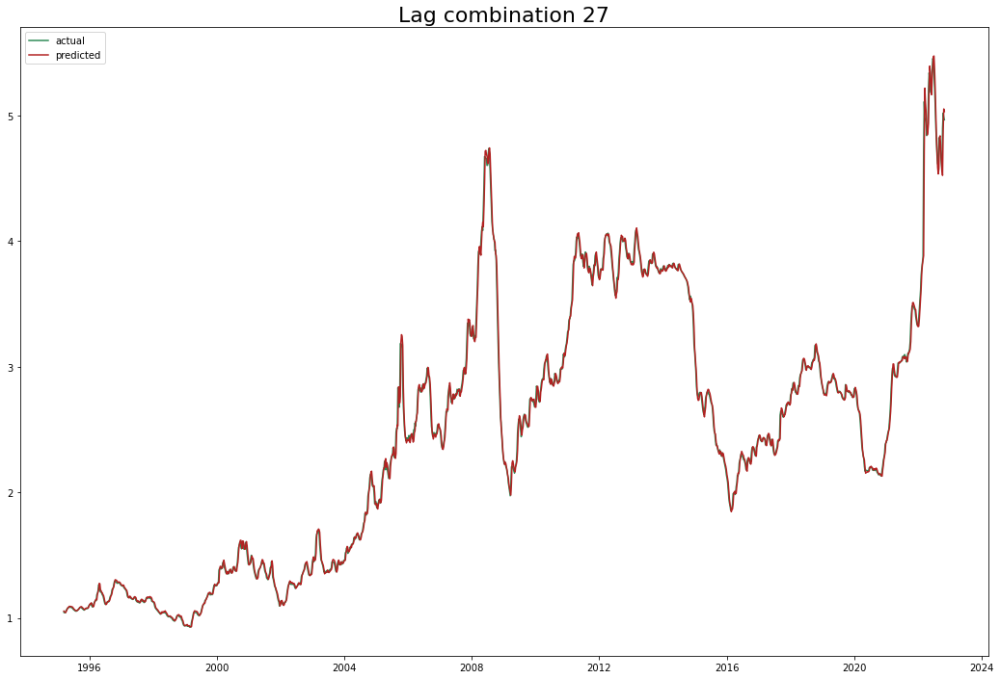

Test data rmse: 0.07660786354984285 Total rmse: 0.050585732487424116
Test data mape: 0.010644846572512372 Total mape: 0.01125612873821963
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squared_error: (test=-0.106) r2: (te

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

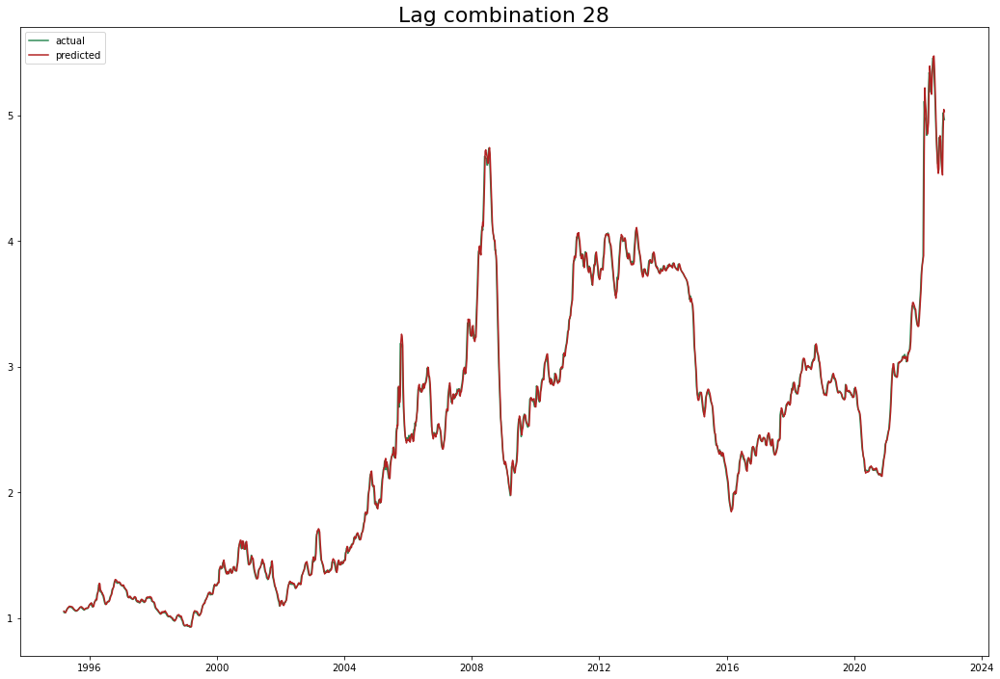

Test data rmse: 0.07673582000621024 Total rmse: 0.05058060337064214
Test data mape: 0.010676085883492305 Total mape: 0.011278563057840798
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squared_error: (test=-0.1

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

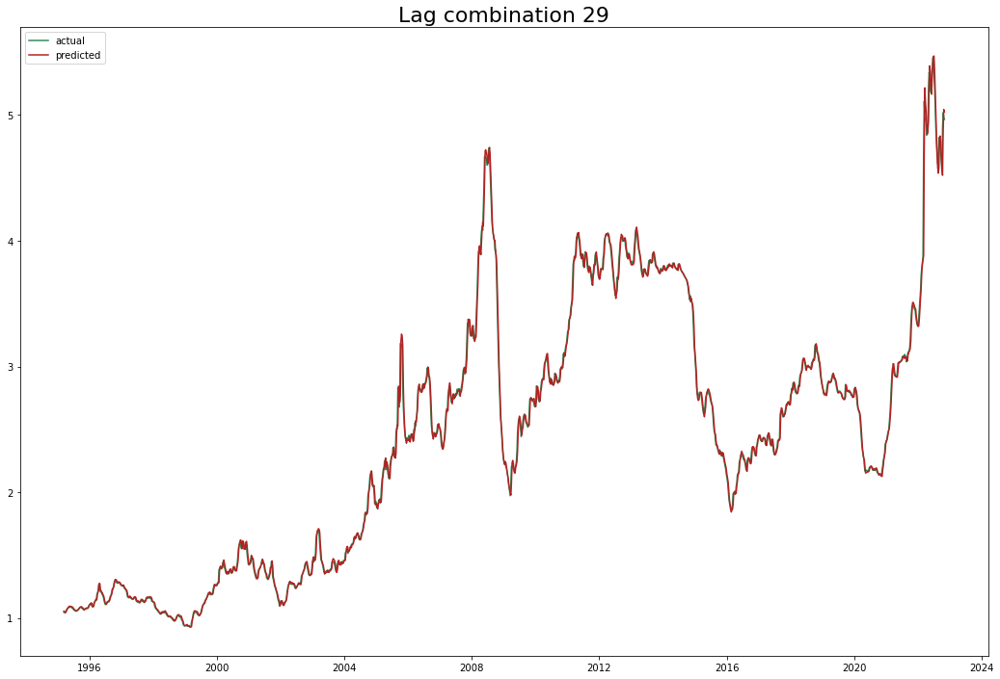

Test data rmse: 0.07677771020874344 Total rmse: 0.05059418460988302
Test data mape: 0.010696147266607526 Total mape: 0.011294230411351337
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.908) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squared_error:

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

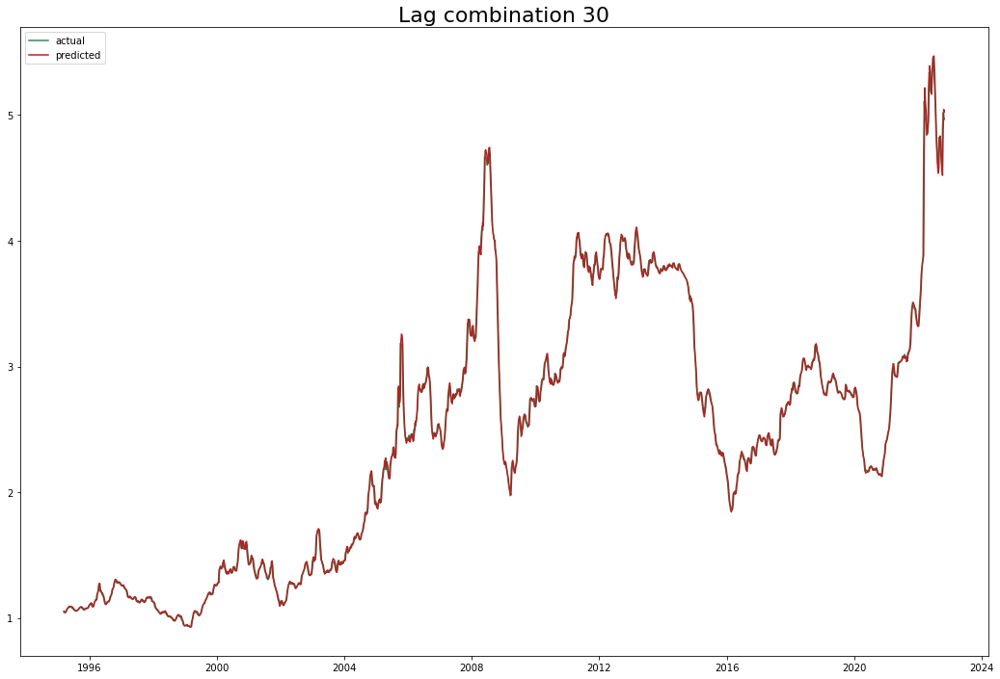

Test data rmse: 0.07678335905016737 Total rmse: 0.05059534062854843
Test data mape: 0.010696064714417412 Total mape: 0.011293826601596973
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.026) neg_root_mean_squ

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

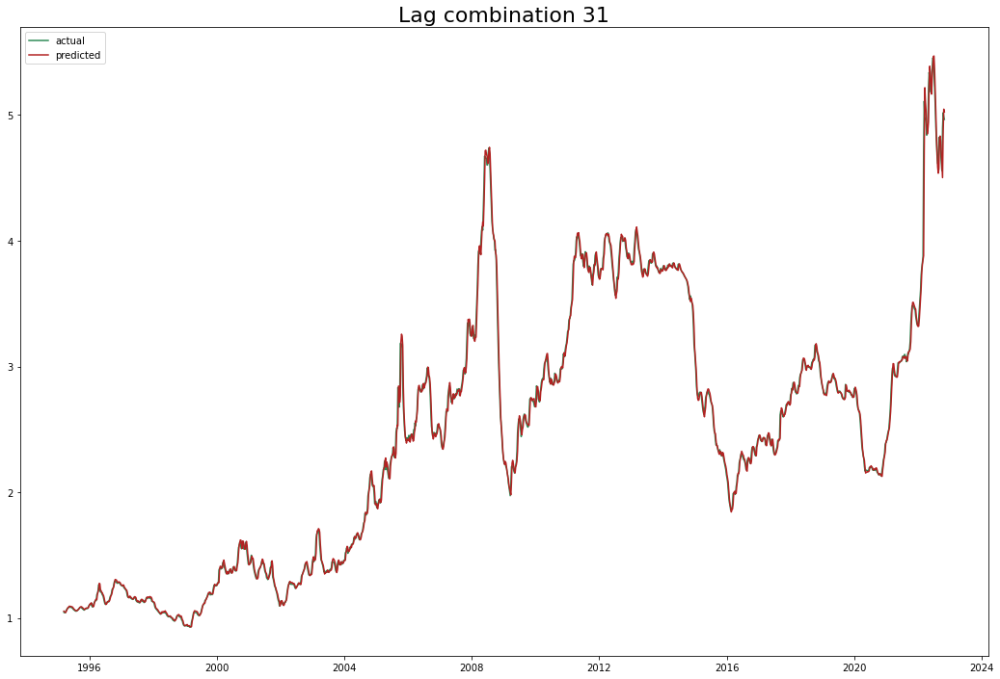

Test data rmse: 0.07722854301486733 Total rmse: 0.05070908473544153
Test data mape: 0.01071775023422284 Total mape: 0.011288370467485835
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.026) neg_roo

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

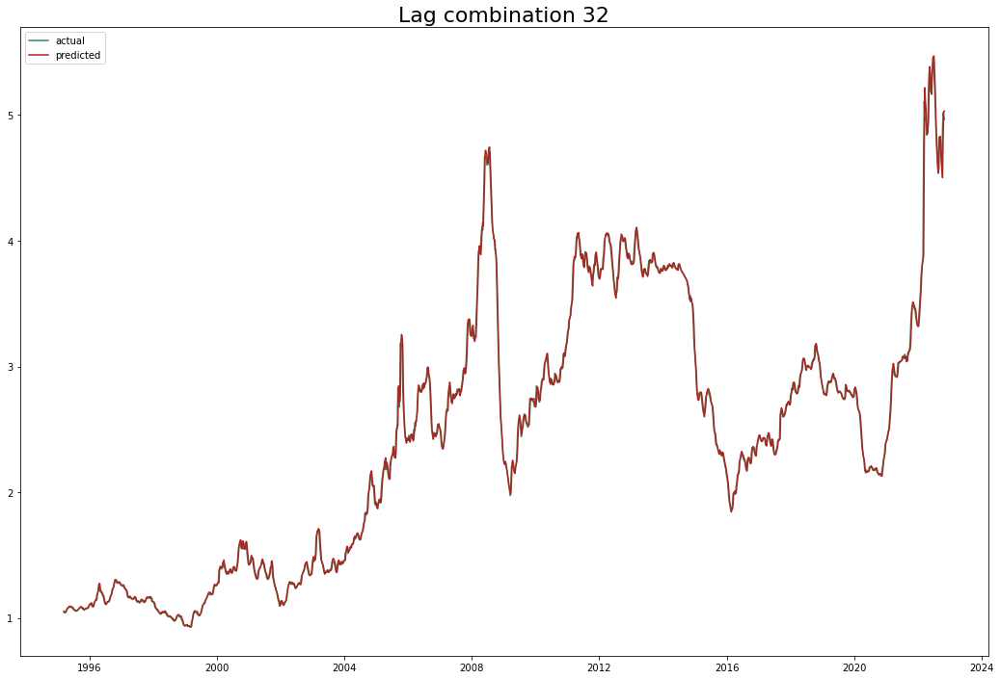

Test data rmse: 0.07758603189242769 Total rmse: 0.0507717958150614
Test data mape: 0.010761550082234637 Total mape: 0.011294255796213824
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.031) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.0

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

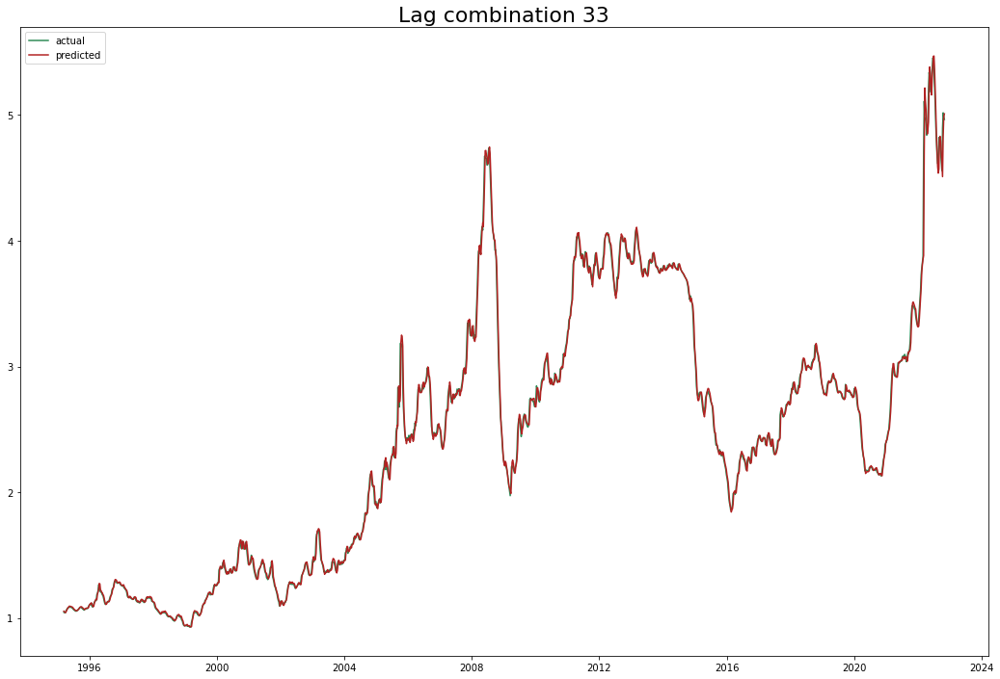

Test data rmse: 0.07748462085457876 Total rmse: 0.050684155290619544
Test data mape: 0.010778110928690968 Total mape: 0.011282791318723208
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.093) r2: (test=0.960) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_percentage_erro

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

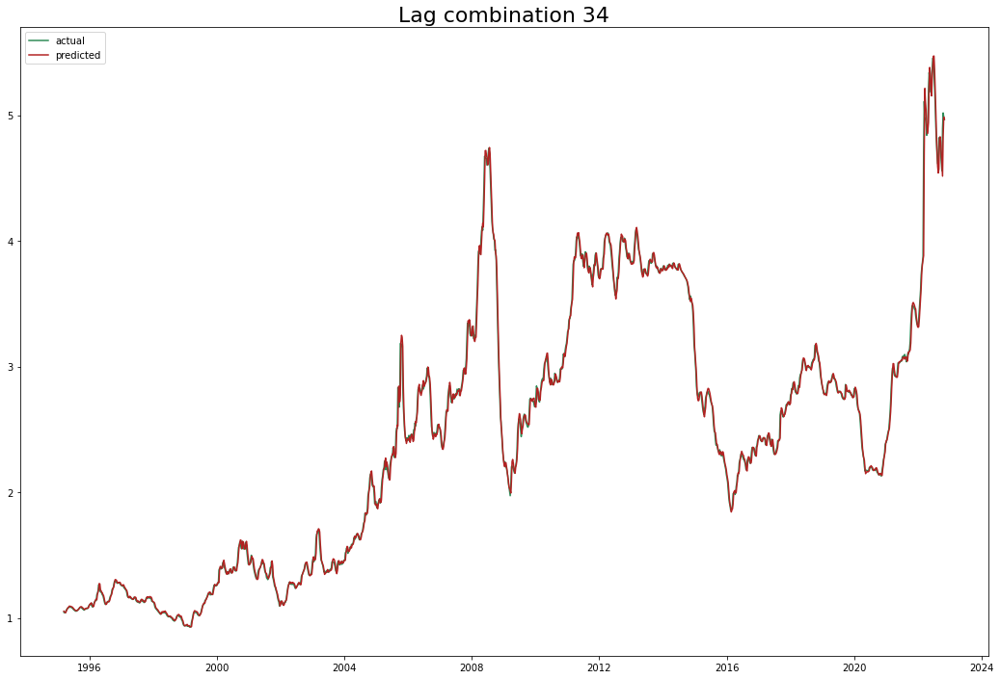

Test data rmse: 0.07742173466752825 Total rmse: 0.05064099014628026
Test data mape: 0.010791977037978313 Total mape: 0.011280525750353057
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.094) r2: (test=0.959) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_absolute_perce

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

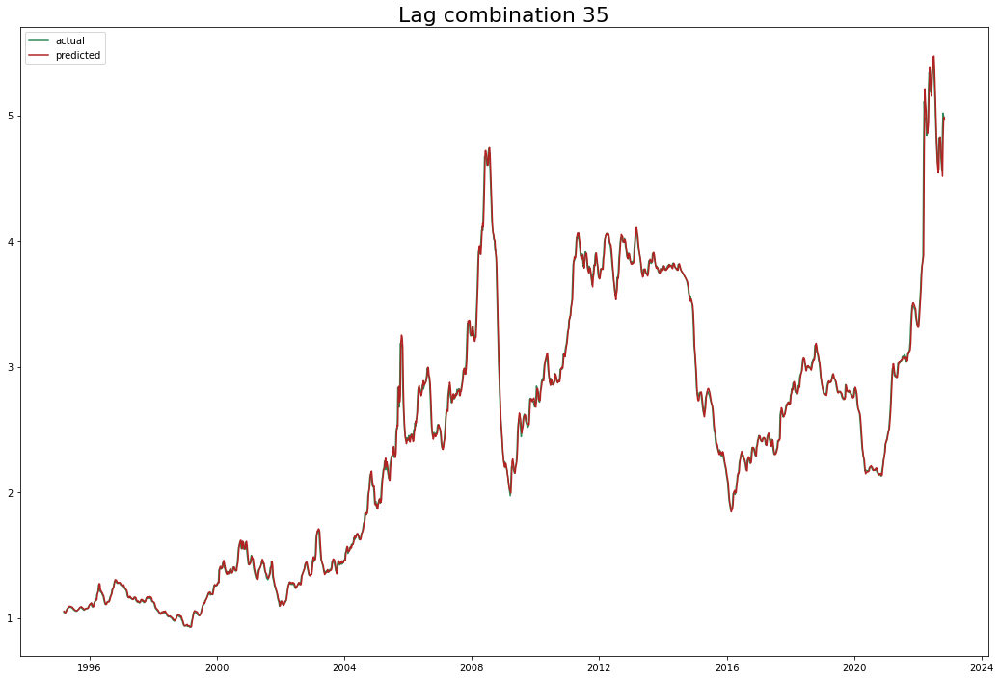

Test data rmse: 0.07751066844942457 Total rmse: 0.05067127256451764
Test data mape: 0.010802120929001928 Total mape: 0.011275832831925642
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.032) neg_root_mean_squared_error: (test=-0.094) r2: (test=0.959) total time=   0.0s
[CV 3/5] END solver=auto; neg_mean_abs

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

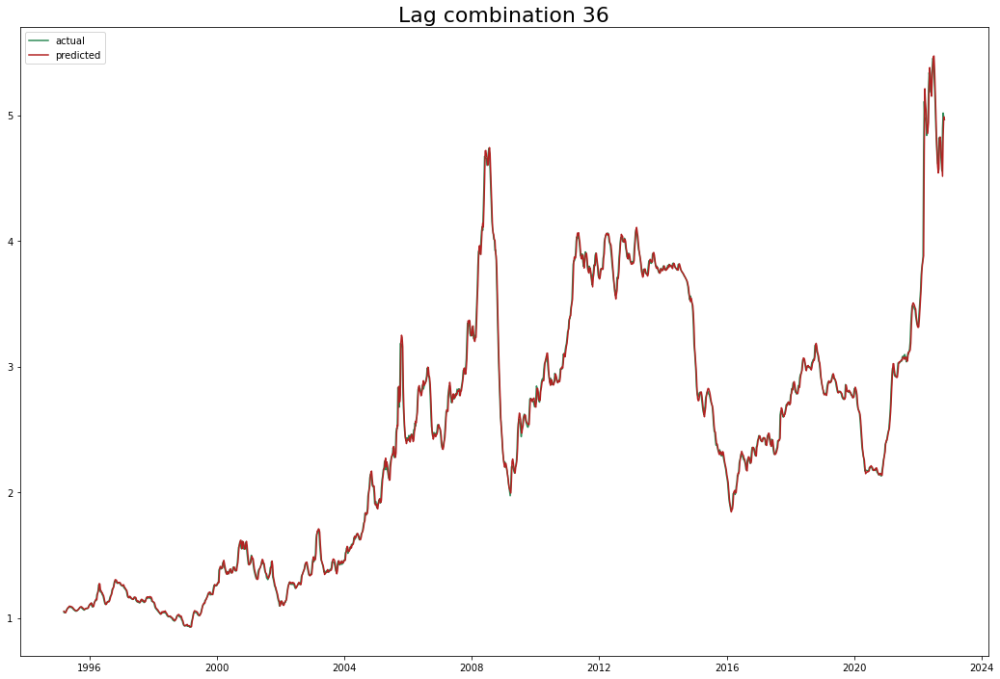

Test data rmse: 0.07751050522271573 Total rmse: 0.05067085403629035
Test data mape: 0.010802115523807743 Total mape: 0.011275852187637206
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.095) r2: (test=0.958) total time=   0.0s
[CV 3/5] END solver=auto; n

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

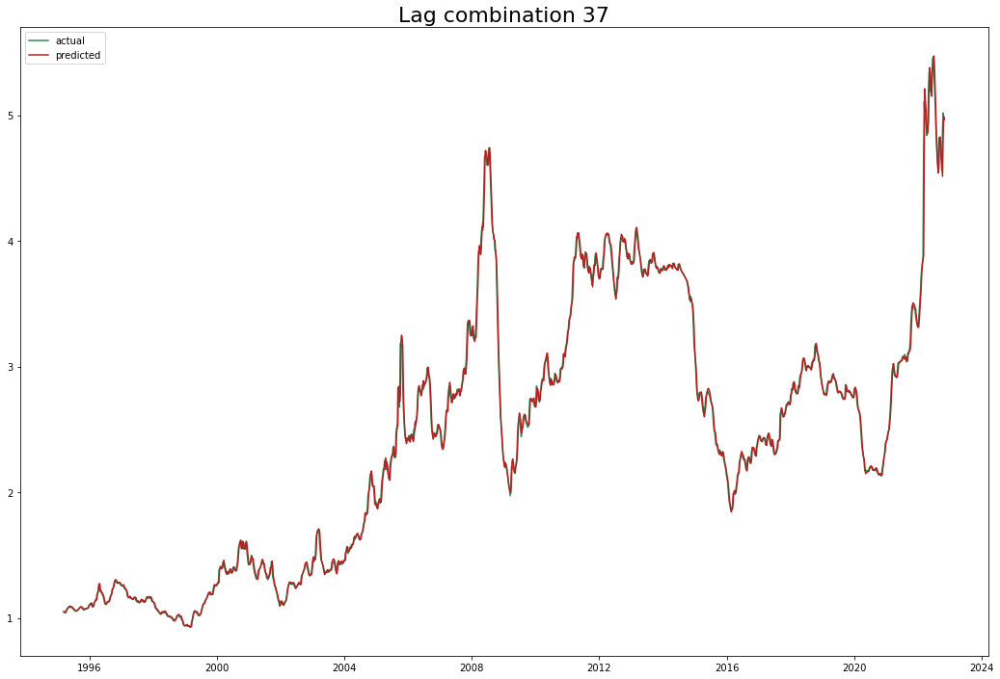

Test data rmse: 0.07751087733444029 Total rmse: 0.050670953060565356
Test data mape: 0.010802233500331885 Total mape: 0.011275939287149914
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.095) r2: (test=0.958) total time=   0.0s
[CV 3/5] END so

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

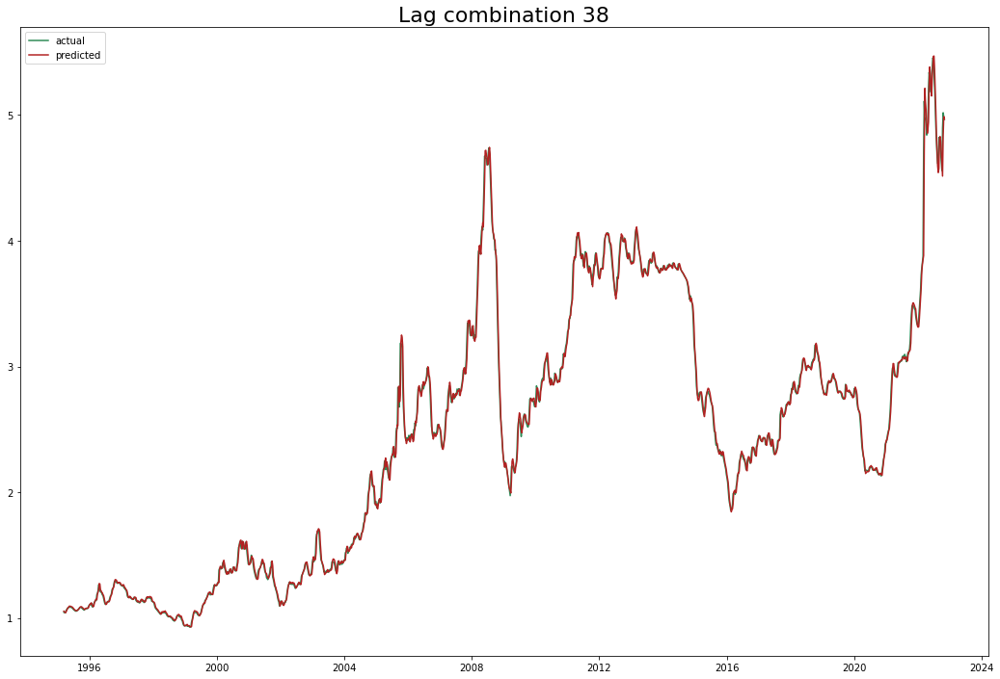

Test data rmse: 0.0774679674297333 Total rmse: 0.050641340728684064
Test data mape: 0.01079130535628341 Total mape: 0.011268817618766618
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.907) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.095) r2: (test=0.958) total time=   0.0s
[CV 3/

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

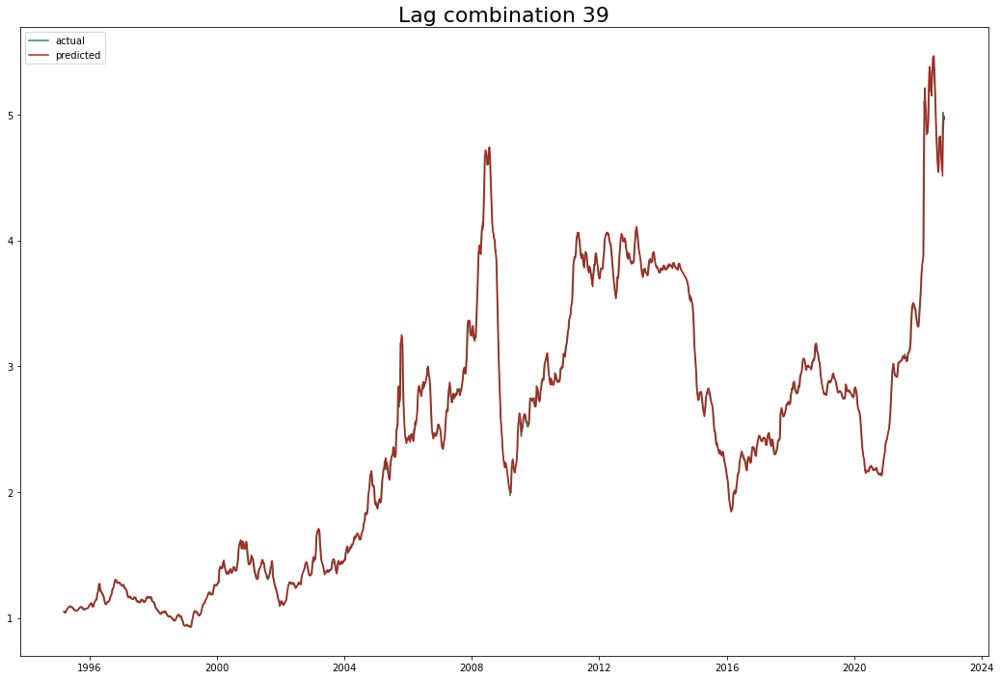

Test data rmse: 0.07750812464148583 Total rmse: 0.050635629980281795
Test data mape: 0.010792430758911864 Total mape: 0.01127101429956497
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.906) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.096) r2: (test=0.958) total time=  

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

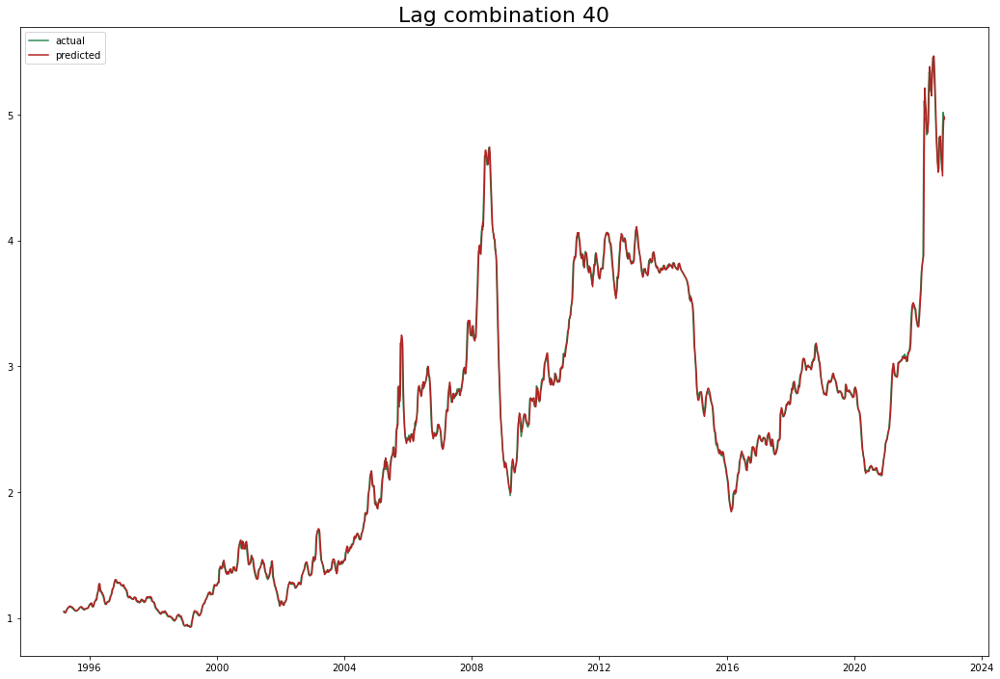

Test data rmse: 0.07750807844645627 Total rmse: 0.05063826032815573
Test data mape: 0.01079230122634396 Total mape: 0.011274537594903506
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.053) r2: (test=0.906) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.096) r2: (test=0.957) tot

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

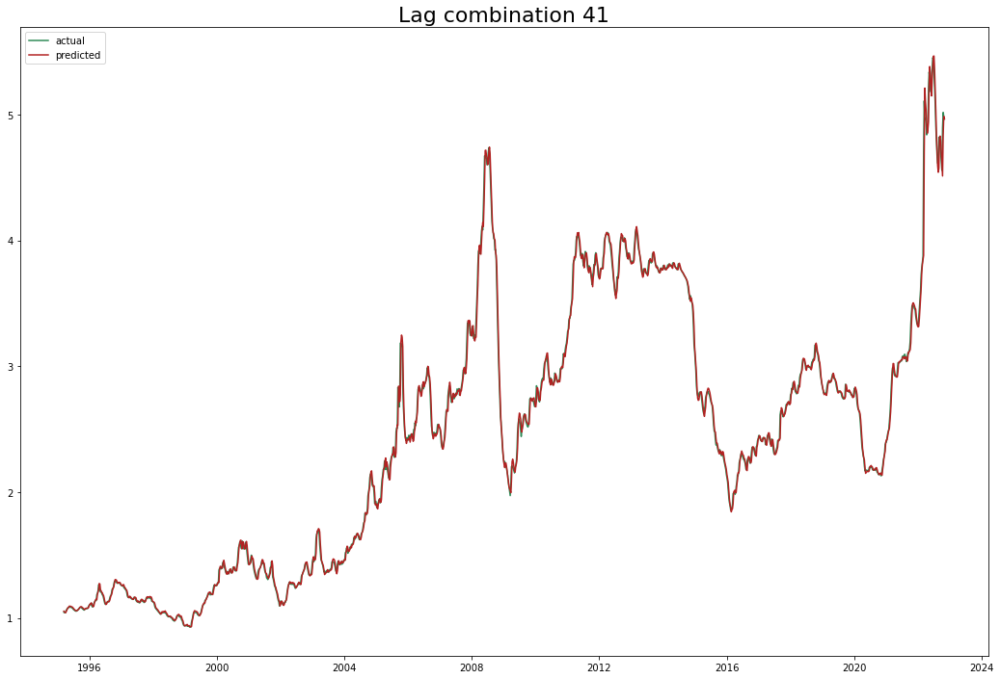

Test data rmse: 0.07751456780201556 Total rmse: 0.050639554278564244
Test data mape: 0.010794009546231319 Total mape: 0.011274766019531594
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.905) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.096) r2: (te

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

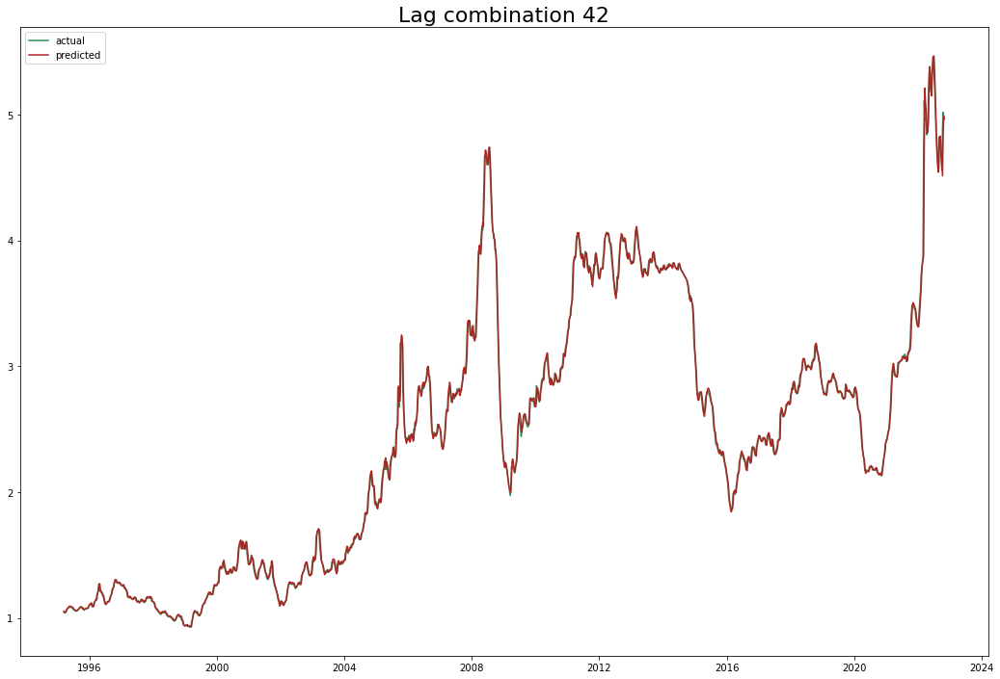

Test data rmse: 0.07749058108352944 Total rmse: 0.05062790289711257
Test data mape: 0.010773538369933293 Total mape: 0.011271805769621604
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.905) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.09

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

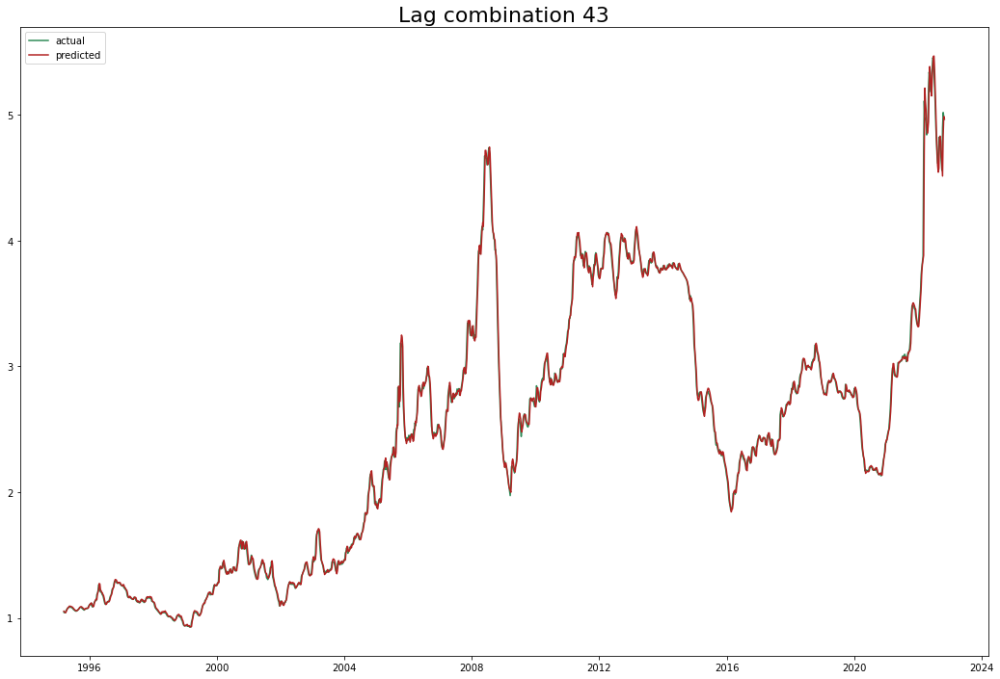

Test data rmse: 0.07748733634016357 Total rmse: 0.05061494692233835
Test data mape: 0.010783787192075537 Total mape: 0.011264192675222974
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.905) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

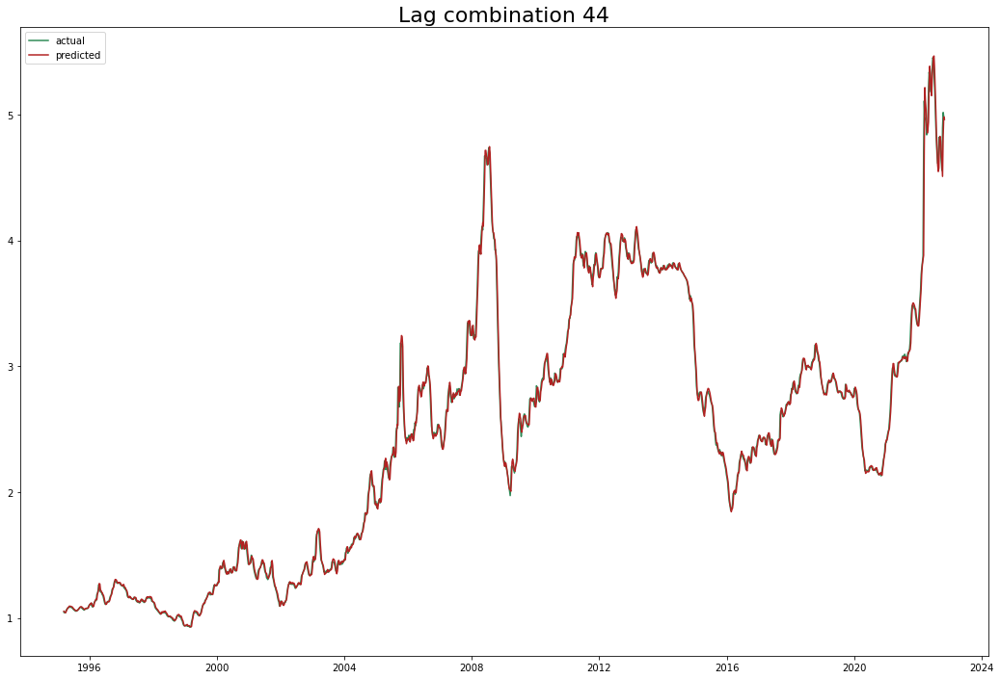

Test data rmse: 0.07758988473556815 Total rmse: 0.0505455851752037
Test data mape: 0.010806891896259286 Total mape: 0.01122508482874906
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.904) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.034) neg_root_mean_square

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

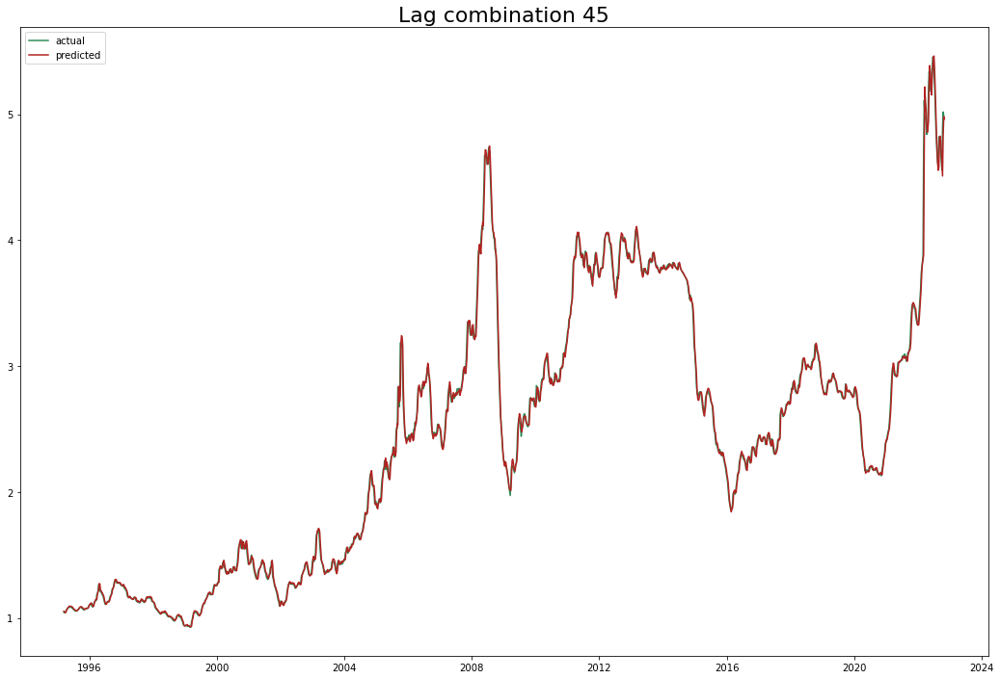

Test data rmse: 0.07768113027922573 Total rmse: 0.05055392796421844
Test data mape: 0.010856117116859491 Total mape: 0.011235597349026539
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.904) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.034) neg_roo

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

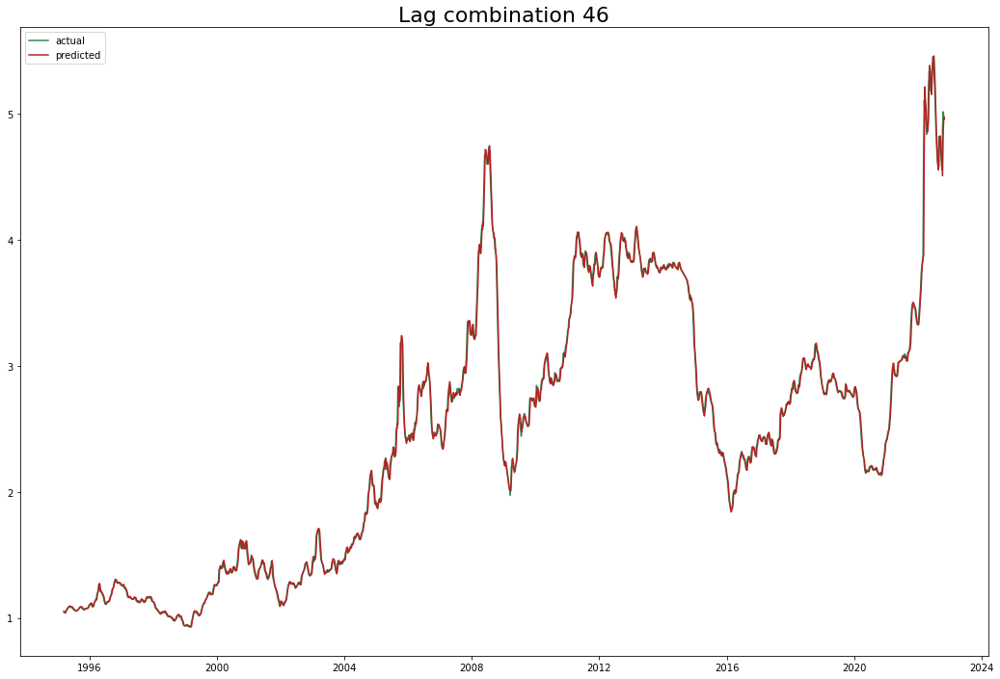

Test data rmse: 0.0776436165010302 Total rmse: 0.050543829609285114
Test data mape: 0.01086565449394127 Total mape: 0.011248226240763225
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.903) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.03

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

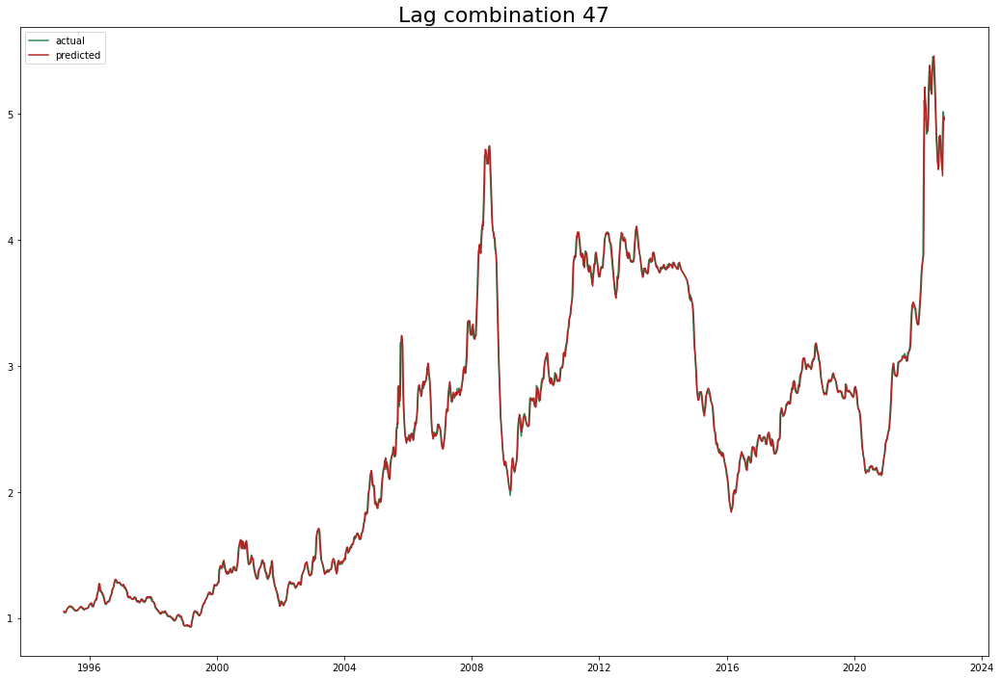

Test data rmse: 0.07758597756930392 Total rmse: 0.05052312093433139
Test data mape: 0.010869930190612153 Total mape: 0.01125452105972511
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.903) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percentage_error: 

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

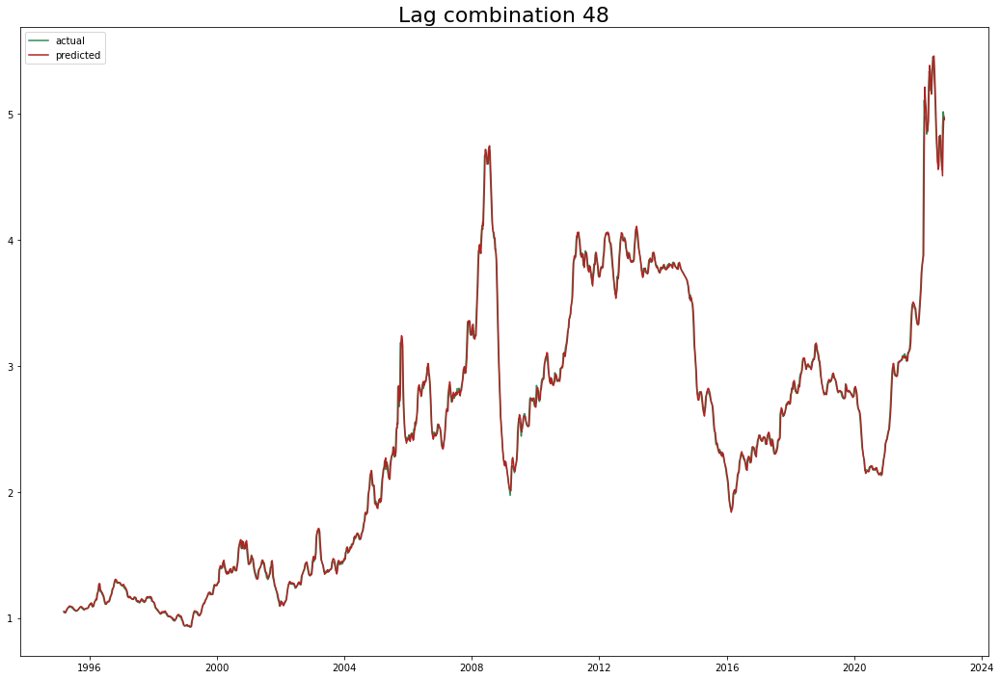

Test data rmse: 0.07760093276841734 Total rmse: 0.05052964596932016
Test data mape: 0.010881311317069518 Total mape: 0.011263071530975057
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.903) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolute_percen

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

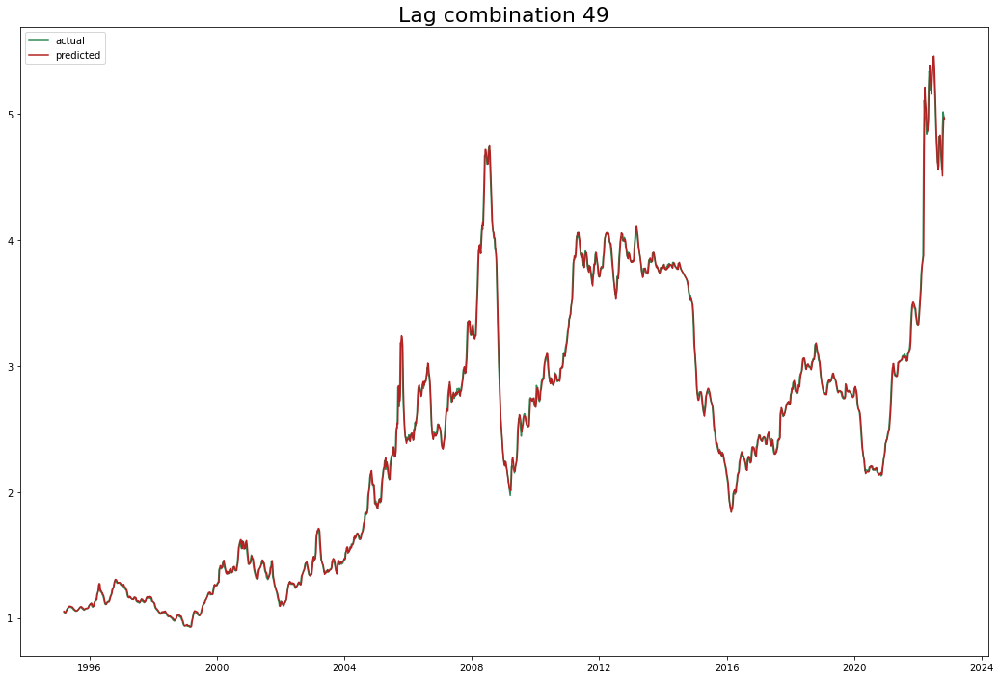

Test data rmse: 0.07763704022862607 Total rmse: 0.05054116871967293
Test data mape: 0.0108892571429581 Total mape: 0.011264904152978246
--------------------------
Next model: 
Lags choosen:  ['1w_lag', '2w_lag', '3w_lag', '4w_lag', '5w_lag', '6w_lag', '7w_lag', '8w_lag', '9w_lag', '10w_lag', '11w_lag', '12w_lag', '13w_lag', '14w_lag', '15w_lag', '16w_lag', '17w_lag', '18w_lag', '19w_lag', '20w_lag', '21w_lag', '22w_lag', '23w_lag', '24w_lag', '25w_lag', '26w_lag', '27w_lag', '28w_lag', '29w_lag', '30w_lag', '31w_lag', '32w_lag', '33w_lag', '34w_lag', '35w_lag', '36w_lag', '37w_lag', '38w_lag', '39w_lag', '40w_lag', '41w_lag', '42w_lag', '43w_lag', '44w_lag', '45w_lag', '46w_lag', '47w_lag', '48w_lag', '49w_lag', '50w_lag', '51w_lag']
Fitting 5 folds for each of 2 candidates, totalling 10 fits
[CV 1/5] END solver=auto; neg_mean_absolute_percentage_error: (test=-0.033) neg_root_mean_squared_error: (test=-0.054) r2: (test=0.902) total time=   0.0s
[CV 2/5] END solver=auto; neg_mean_absolu

C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)
C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
5 fits failed out of a total of 10.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Tymoteusz\anaconda3\lib\site-packages\sklearn\model_

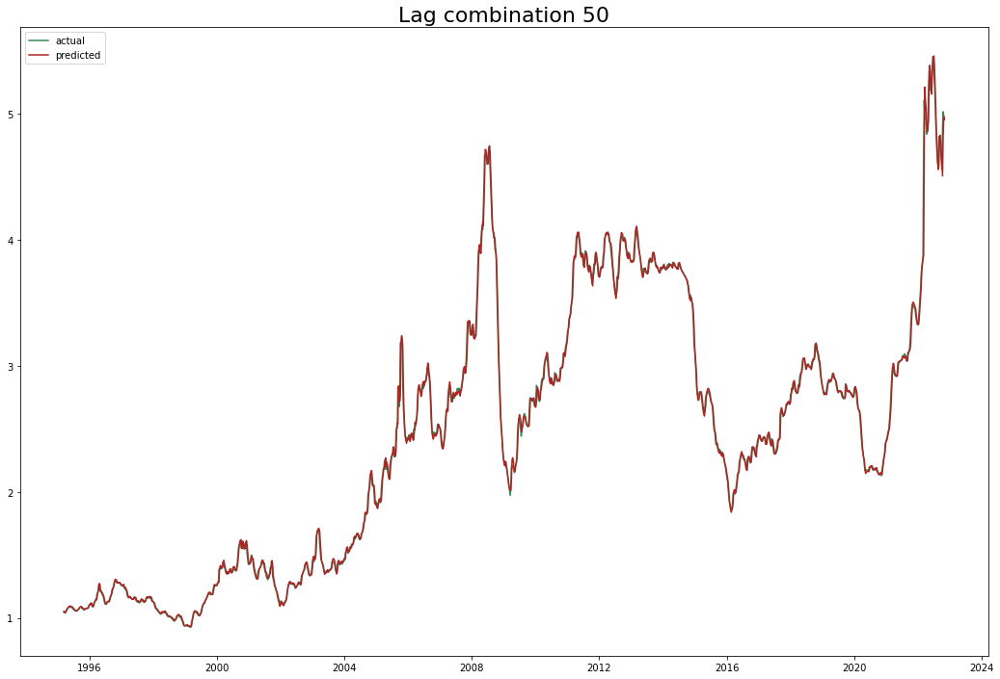

Test data rmse: 0.07763122511075175 Total rmse: 0.050534320243202535
Test data mape: 0.010878392507622323 Total mape: 0.011264171130292662


C:\Users\Tymoteusz\AppData\Local\Temp\ipykernel_16592\2705742939.py:15: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  smr = summary_data.append({'Model': model_name, 'mape test': mape_test, 'rmse test': rmse_test, 'mape total': mape_total, 'rmse total': rmse_total, 'lags used': len(list_options[i])},ignore_index=True)


In [786]:
from sklearn.linear_model import Lasso, Ridge, LinearRegression
linear = LinearRegression()
lasso = Lasso()
ridge = Ridge()
linear_params = {}
lasso_params = {'selection': ['cyclic','random']}
ridge_params = {'solver':['auto','lbfgs']}

gbr_grid_list, summary_data = test_mdl(df1.columns[3:-1],linear,linear_params,'LinearRegression')
gbr_grid_list, summary_data = test_mdl(df1.columns[3:-1],lasso,lasso_params,'Lasso')
gbr_grid_list, summary_data = test_mdl(df1.columns[3:-1],ridge,ridge_params,'Ridge')

## Model evaluation

Using the pre-created dataframe with scores of each model we will be able to choose the best performing model.

In [787]:
summary_data

,Model,mape test,rmse test,mape total,rmse total,lags used,lags_used
0,MLPRegressor,0.025323,0.151321,0.024538,0.099733,51,NaN
1,SVR,0.011712,0.075271,0.013535,0.051529,51,NaN
2,autoARIMA,0.008528,0.058584,NaN,NaN,NaN,NaN
3,ARIMA 1 1 2,0.008635,0.05826,NaN,NaN,NaN,NaN
4,RandomForestRegressor,0.021412,0.211381,0.007717,0.095628,51,NaN
5,DecisionTreeRegressor,0.033107,0.261343,0.006608,0.116754,51,NaN
6,GradientBoostingRegressor,0.025069,0.237168,0.00627,0.106008,51,NaN
7,LinearRegression,0.008889,0.06947,0.009854,0.044959,51,NaN
8,Lasso,0.208834,1.046143,0.414298,0.984152,51,NaN
9,Ridge,0.010878,0.077631,0.011264,0.050534,51,NaN


In [788]:
summary_data = summary_data.sort_values(by=['mape test'], ascending=True)
summary_data.head(9)
# Table contains results sorted by mape

,Model,mape test,rmse test,mape total,rmse total,lags used,lags_used
2,autoARIMA,0.008528,0.058584,NaN,NaN,NaN,NaN
3,ARIMA 1 1 2,0.008635,0.05826,NaN,NaN,NaN,NaN
7,LinearRegression,0.008889,0.06947,0.009854,0.044959,51,NaN
9,Ridge,0.010878,0.077631,0.011264,0.050534,51,NaN
1,SVR,0.011712,0.075271,0.013535,0.051529,51,NaN
4,RandomForestRegressor,0.021412,0.211381,0.007717,0.095628,51,NaN
6,GradientBoostingRegressor,0.025069,0.237168,0.00627,0.106008,51,NaN
0,MLPRegressor,0.025323,0.151321,0.024538,0.099733,51,NaN
5,DecisionTreeRegressor,0.033107,0.261343,0.006608,0.116754,51,NaN


In [790]:
summary_data.drop(columns='lags_used',inplace=True)
summary_data['lags used'] = summary_data['lags used'].fillna(51)

In [791]:
summary_data.head(10)

,Model,mape test,rmse test,mape total,rmse total,lags used
2,autoARIMA,0.008528,0.058584,NaN,NaN,51
3,ARIMA 1 1 2,0.008635,0.05826,NaN,NaN,51
7,LinearRegression,0.008889,0.06947,0.009854,0.044959,51
9,Ridge,0.010878,0.077631,0.011264,0.050534,51
1,SVR,0.011712,0.075271,0.013535,0.051529,51
4,RandomForestRegressor,0.021412,0.211381,0.007717,0.095628,51
6,GradientBoostingRegressor,0.025069,0.237168,0.00627,0.106008,51
0,MLPRegressor,0.025323,0.151321,0.024538,0.099733,51
5,DecisionTreeRegressor,0.033107,0.261343,0.006608,0.116754,51
8,Lasso,0.208834,1.046143,0.414298,0.984152,51


As visible above model with the best forecasting performance was ARIMA.

## SUMMARY

I have implemented and tested 9 different models - SVR, MLPRegressor, ARIMA, DecisionTreeRegressor, GradientBoostingRegressor, RandomForestRegressor, Lasso, Ridge and LinearRegression.
The best performance was achieved using simple LinearRegression and ARIMA. Around 0.008 MAPE on the test data is a pretty good score. MAPE is better by 0.3% than baseline model, which indicates that the model has predictive value and can be used in decision making. The RMSE difference in the test and and training is mainly due to the fact that average prices in the test set are higher than in the training set.